In [190]:
import pandas as pd
import numpy as np

import tensorflow as tf
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
sess = tf.Session(config = config)

import keras
from keras import models
from keras import layers
from keras.utils.np_utils import to_categorical
from keras.preprocessing import sequence
from keras.models import Sequential, Model, load_model
from keras.layers import Concatenate, Dense, LSTM, Input, concatenate, Dropout
from sklearn.cross_validation import train_test_split
from keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.preprocessing import normalize 
import matplotlib.pyplot as plt
import os
from keras import backend as K
#from sklearn.model_selectio import StratifiedKFold
from sklearn.cross_validation import StratifiedKFold
import sklearn
print(sklearn.__version__)
print(keras.__version__)
print()

0.19.1
2.2.0



In [191]:
reDirect = False
FOLDER = 'BETA'
if not os.path.exists(FOLDER):
    os.mkdir(FOLDER)
MODEL_PATH = FOLDER + '/model.h5'
FIG_PATH = FOLDER + '/Confusion_Matrix.png'
FIG_PATH_N = FOLDER + '/Confusion_Matrix_Norm.png'

LABEL2DIG = {'chat':0, 'voip':1, 'trap2p':2, 'stream':3, 'file_trans':4, 'email':5}
DIG2LABEL = {v: k for k, v in LABEL2DIG.items()}

In [192]:
import sys
if(reDirect):
    old_stdout = sys.stdout
    sys.stdout = open( FOLDER + '/log', 'w')

data = pd.read_csv('data/train.csv')
print(data.columns)
y_train = data.label.values
X_train = data.drop(['label'], axis = 1).values

In [193]:
X_train = np.load('data/X_train.npy')
y_train = np.load('data/y_train.npy')
X_train = X_train.astype('float64')
#y_train = y_train
print('X_train:', np.shape(X_train))
print('y_train:', np.shape(y_train))

maxsize = 0
print('-'*20)
for cat in np.unique(y_train):
    size = np.shape(np.where(y_train==cat))[1]
    print(cat+": "+str(np.shape(np.where(y_train==cat))[1]))
    if(size > maxsize):
        maxsize = size
print('-'*20)

X_train = normalize(X_train, norm='l2', axis=1, copy=True, return_norm=False)
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.15, random_state=42,stratify=y_train)

total = np.shape(y_test)[0]
print('testing')
print('-'*20)
for cat in np.unique(y_test):
    size = np.shape(np.where(y_test==cat))[1]
    print(cat+": "+str(np.shape(np.where(y_test==cat))[1])+", "+str(size/total))
print('-'*20)

maxsize = 0
total = np.shape(y_train)[0]
print('training')
print('-'*20)
for cat in np.unique(y_train):
    size = np.shape(np.where(y_train==cat))[1]
    print(cat+": "+str(np.shape(np.where(y_train==cat))[1])+", "+str(size/total))
    if(size > maxsize):
        maxsize = size
print('-'*20)


X_train: (172262, 822)
y_train: (172262,)
--------------------
chat: 7922
email: 5243
file_trans: 39426
stream: 4779
trap2p: 1069
voip: 113823
--------------------
testing
--------------------
chat: 1188, 0.04597523219814242
email: 787, 0.030456656346749225
file_trans: 5914, 0.22886996904024767
stream: 717, 0.02774767801857585
trap2p: 160, 0.006191950464396285
voip: 17074, 0.6607585139318886
--------------------
training
--------------------
chat: 6734, 0.045990356640395566
email: 4456, 0.030432585267241262
file_trans: 33512, 0.22887271038505141
stream: 4062, 0.02774173279971589
trap2p: 909, 0.006208083484722241
voip: 96749, 0.6607545314228737
--------------------


#### sampling

x = X_train[1:2]
y = y_train[1:2]
#print(np.shape(y))
for cat in np.unique(y_train):
    print('processing cat:'+cat)
    size = np.shape(np.where(y_train==cat))[1]
    ind = np.argwhere(y_train==cat)
    #print(ind)
    ind = ind[:,0]
    #print(np.shape(ind))
    x_arr = X_train[ind]
    y_arr = y_train[ind]
    #print(np.shape(y_arr))
    #print(np.shape(x_arr))
    
    for i in range(int(maxsize/size)):
        #print(i)
        x = np.concatenate((x, x_arr), axis = 0)
        y = np.concatenate((y, y_arr), axis = 0)
        


print('-'*20)
for cat in np.unique(y):
    size = np.shape(np.where(y==cat))[1]
    print(cat+": "+str(np.shape(np.where(y==cat))[1]))
print('-'*20)

y_train = y
X_train = x

In [194]:
y_train = [LABEL2DIG[label] for label in y_train]
y_test = [LABEL2DIG[label] for label in y_test]

In [195]:
y = y_train
y_train = to_categorical(y_train, num_classes = 6)
y_test = to_categorical(y_test, num_classes = 6)

In [196]:
dim = np.shape(X_train)[1]
print(dim)

822


In [197]:
def get_model():
    model = Sequential()
    model.add(Dense(512, input_shape=(dim,),activation = 'relu'))
    model.add(Dropout(0.5))
    model.add(Dense(128, activation = 'relu'))
    model.add(Dropout(0.3))
    #model.add(Dense(512,activation = 'relu'))
    #model.add(Dropout(0.3))
    #model.add(Dense(1024,activation = 'relu'))
    #model.add(Dropout(0.5))
    model.add(Dense(512, activation = 'relu'))
    model.add(Dropout(0.3))
    model.add(Dense(6,activation = 'softmax'))
    return model

In [198]:
#model.summary()

In [199]:
#skf = StratifiedKFold(y, n_folds=10, shuffle = True)
#for i, (train_split, val_split) in enumerate(skf):
#    K.clear_session()
#    X, y, X_val, y_val = X_train[train_split], y_train[train_split], X_train[val_split], y_train[val_split]

X, y, X_val, y_val = X_train, y_train, X_test, y_test
earlystopping = EarlyStopping(monitor='val_loss', patience = 1e5, verbose=1, mode='auto')
checkpoint = ModelCheckpoint(filepath=MODEL_PATH, 
                                     verbose=1,
                                     save_best_only=True,
                                     monitor='val_loss',
                                     mode='auto' )
    
model = get_model()
model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['acc'])
history = model.fit(X, 
                    y, 
                    epochs = 100000, 
                    batch_size = 128, 
                    shuffle = True,
                    validation_data=(X_val, y_val),
                    callbacks=[checkpoint, earlystopping])

Train on 146422 samples, validate on 25840 samples
Epoch 1/100000
146422/146422 [==============================] - 7s 50us/step - loss: 0.9177 - acc: 0.6634 - val_loss: 0.8842 - val_acc: 0.6594

Epoch 00001: val_loss improved from inf to 0.88421, saving model to BETA/model.h5
Epoch 2/100000
146422/146422 [==============================] - 4s 29us/step - loss: 0.8820 - acc: 0.6660 - val_loss: 0.8595 - val_acc: 0.6721

Epoch 00002: val_loss improved from 0.88421 to 0.85950, saving model to BETA/model.h5
Epoch 3/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8559 - acc: 0.6719 - val_loss: 0.8281 - val_acc: 0.6795

Epoch 00003: val_loss improved from 0.85950 to 0.82814, saving model to BETA/model.h5
Epoch 4/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8390 - acc: 0.6779 - val_loss: 0.8164 - val_acc: 0.6842

Epoch 00004: val_loss improved from 0.82814 to 0.81644, saving model to BETA/model.h5
Epoch 5/100000
146422/146422 [===


Epoch 00039: val_loss did not improve from 0.76990
Epoch 40/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7929 - acc: 0.6965 - val_loss: 0.7723 - val_acc: 0.7034

Epoch 00040: val_loss did not improve from 0.76990
Epoch 41/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.6959 - val_loss: 0.7688 - val_acc: 0.7027

Epoch 00041: val_loss improved from 0.76990 to 0.76883, saving model to BETA/model.h5
Epoch 42/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7903 - acc: 0.6970 - val_loss: 0.7689 - val_acc: 0.7034

Epoch 00042: val_loss did not improve from 0.76883
Epoch 43/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7876 - acc: 0.6973 - val_loss: 0.7765 - val_acc: 0.6979

Epoch 00043: val_loss did not improve from 0.76883
Epoch 44/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7875 - acc: 0.6976 - val_loss: 0.7683 - v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7879 - acc: 0.6997 - val_loss: 0.7687 - val_acc: 0.7047

Epoch 00080: val_loss did not improve from 0.76388
Epoch 81/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7837 - acc: 0.7001 - val_loss: 0.7692 - val_acc: 0.7044

Epoch 00081: val_loss did not improve from 0.76388
Epoch 82/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7002 - val_loss: 0.7650 - val_acc: 0.7053

Epoch 00082: val_loss did not improve from 0.76388
Epoch 83/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7839 - acc: 0.6996 - val_loss: 0.7867 - val_acc: 0.6988

Epoch 00083: val_loss did not improve from 0.76388
Epoch 84/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7856 - acc: 0.7003 - val_loss: 0.7861 - val_acc: 0.7002

Epoch 00084: val_loss did not improve from 0.76388
Epoch 85/100000
146422/146422 [=====

146422/146422 [==============================] - 3s 19us/step - loss: 0.7883 - acc: 0.7003 - val_loss: 0.7950 - val_acc: 0.7025

Epoch 00121: val_loss did not improve from 0.76100
Epoch 122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7026 - val_loss: 0.7706 - val_acc: 0.7022

Epoch 00122: val_loss did not improve from 0.76100
Epoch 123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7797 - acc: 0.7025 - val_loss: 0.7622 - val_acc: 0.7082

Epoch 00123: val_loss did not improve from 0.76100
Epoch 124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7761 - acc: 0.7031 - val_loss: 0.7834 - val_acc: 0.7013

Epoch 00124: val_loss did not improve from 0.76100
Epoch 125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7030 - val_loss: 0.7634 - val_acc: 0.7074

Epoch 00125: val_loss did not improve from 0.76100
Epoch 126/100000
146422/146422 [

146422/146422 [==============================] - 3s 19us/step - loss: 0.7676 - acc: 0.7059 - val_loss: 0.7587 - val_acc: 0.7101

Epoch 00162: val_loss improved from 0.75991 to 0.75873, saving model to BETA/model.h5
Epoch 163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7726 - acc: 0.7047 - val_loss: 0.7617 - val_acc: 0.7092

Epoch 00163: val_loss did not improve from 0.75873
Epoch 164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7698 - acc: 0.7053 - val_loss: 0.7613 - val_acc: 0.7093

Epoch 00164: val_loss did not improve from 0.75873
Epoch 165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7707 - acc: 0.7054 - val_loss: 0.7596 - val_acc: 0.7093

Epoch 00165: val_loss did not improve from 0.75873
Epoch 166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7057 - val_loss: 0.7593 - val_acc: 0.7098

Epoch 00166: val_loss did not improve from 0.758

146422/146422 [==============================] - 3s 19us/step - loss: 0.7674 - acc: 0.7060 - val_loss: 0.7646 - val_acc: 0.7099

Epoch 00203: val_loss did not improve from 0.75744
Epoch 204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7066 - val_loss: 0.7630 - val_acc: 0.7091

Epoch 00204: val_loss did not improve from 0.75744
Epoch 205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7629 - acc: 0.7077 - val_loss: 0.7582 - val_acc: 0.7102

Epoch 00205: val_loss did not improve from 0.75744
Epoch 206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7624 - acc: 0.7077 - val_loss: 0.7619 - val_acc: 0.7089

Epoch 00206: val_loss did not improve from 0.75744
Epoch 207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7648 - acc: 0.7069 - val_loss: 0.7660 - val_acc: 0.7102

Epoch 00207: val_loss did not improve from 0.75744
Epoch 208/100000
146422/146422 [

146422/146422 [==============================] - 3s 19us/step - loss: 0.7589 - acc: 0.7087 - val_loss: 0.7582 - val_acc: 0.7110

Epoch 00244: val_loss did not improve from 0.75599
Epoch 245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7079 - val_loss: 0.7590 - val_acc: 0.7101

Epoch 00245: val_loss did not improve from 0.75599
Epoch 246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7551 - acc: 0.7097 - val_loss: 0.7575 - val_acc: 0.7103

Epoch 00246: val_loss did not improve from 0.75599
Epoch 247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7576 - acc: 0.7090 - val_loss: 0.7582 - val_acc: 0.7104

Epoch 00247: val_loss did not improve from 0.75599
Epoch 248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7599 - acc: 0.7086 - val_loss: 0.7581 - val_acc: 0.7085

Epoch 00248: val_loss did not improve from 0.75599
Epoch 249/100000
146422/146422 [


Epoch 00285: val_loss did not improve from 0.75599
Epoch 286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7592 - acc: 0.7094 - val_loss: 0.7582 - val_acc: 0.7113

Epoch 00286: val_loss did not improve from 0.75599
Epoch 287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7093 - val_loss: 0.7583 - val_acc: 0.7109

Epoch 00287: val_loss did not improve from 0.75599
Epoch 288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7095 - val_loss: 0.7591 - val_acc: 0.7111

Epoch 00288: val_loss did not improve from 0.75599
Epoch 289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7516 - acc: 0.7111 - val_loss: 0.7593 - val_acc: 0.7107

Epoch 00289: val_loss did not improve from 0.75599
Epoch 290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7599 - acc: 0.7088 - val_loss: 0.7592 - val_acc: 0.7104

Epoch 00290: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7107 - val_loss: 0.7579 - val_acc: 0.7110

Epoch 00327: val_loss did not improve from 0.75573
Epoch 328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7112 - val_loss: 0.7588 - val_acc: 0.7110

Epoch 00328: val_loss did not improve from 0.75573
Epoch 329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7110 - val_loss: 0.7603 - val_acc: 0.7099

Epoch 00329: val_loss did not improve from 0.75573
Epoch 330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7113 - val_loss: 0.7580 - val_acc: 0.7110

Epoch 00330: val_loss did not improve from 0.75573
Epoch 331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7115 - val_loss: 0.7587 - val_acc: 0.7110

Epoch 00331: val_loss did not improve from 0.75573
Epoch 332/100000
146422/146422 [


Epoch 00368: val_loss did not improve from 0.75573
Epoch 369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7507 - acc: 0.7119 - val_loss: 0.7600 - val_acc: 0.7107

Epoch 00369: val_loss did not improve from 0.75573
Epoch 370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7513 - acc: 0.7115 - val_loss: 0.7581 - val_acc: 0.7108

Epoch 00370: val_loss did not improve from 0.75573
Epoch 371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7116 - val_loss: 0.7578 - val_acc: 0.7116

Epoch 00371: val_loss did not improve from 0.75573
Epoch 372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7111 - val_loss: 0.7605 - val_acc: 0.7087

Epoch 00372: val_loss did not improve from 0.75573
Epoch 373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7495 - acc: 0.7120 - val_loss: 0.7579 - val_acc: 0.7111

Epoch 00373: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7122 - val_loss: 0.7583 - val_acc: 0.7113

Epoch 00410: val_loss did not improve from 0.75573
Epoch 411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7116 - val_loss: 0.7583 - val_acc: 0.7110

Epoch 00411: val_loss did not improve from 0.75573
Epoch 412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7487 - acc: 0.7122 - val_loss: 0.7592 - val_acc: 0.7108

Epoch 00412: val_loss did not improve from 0.75573
Epoch 413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7481 - acc: 0.7124 - val_loss: 0.7586 - val_acc: 0.7110

Epoch 00413: val_loss did not improve from 0.75573
Epoch 414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7491 - acc: 0.7122 - val_loss: 0.7594 - val_acc: 0.7113

Epoch 00414: val_loss did not improve from 0.75573
Epoch 415/100000
146422/146422 [

146422/146422 [==============================] - 3s 19us/step - loss: 0.7506 - acc: 0.7121 - val_loss: 0.7593 - val_acc: 0.7125

Epoch 00451: val_loss did not improve from 0.75560
Epoch 452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7492 - acc: 0.7126 - val_loss: 0.7573 - val_acc: 0.7122

Epoch 00452: val_loss did not improve from 0.75560
Epoch 453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7494 - acc: 0.7123 - val_loss: 0.7574 - val_acc: 0.7112

Epoch 00453: val_loss did not improve from 0.75560
Epoch 454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7476 - acc: 0.7133 - val_loss: 0.7573 - val_acc: 0.7117

Epoch 00454: val_loss did not improve from 0.75560
Epoch 455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7469 - acc: 0.7130 - val_loss: 0.7577 - val_acc: 0.7118

Epoch 00455: val_loss did not improve from 0.75560
Epoch 456/100000
146422/146422 [


Epoch 00492: val_loss did not improve from 0.75560
Epoch 493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7131 - val_loss: 0.7592 - val_acc: 0.7108

Epoch 00493: val_loss did not improve from 0.75560
Epoch 494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7134 - val_loss: 0.7580 - val_acc: 0.7116

Epoch 00494: val_loss did not improve from 0.75560
Epoch 495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7464 - acc: 0.7130 - val_loss: 0.7578 - val_acc: 0.7118

Epoch 00495: val_loss did not improve from 0.75560
Epoch 496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7480 - acc: 0.7127 - val_loss: 0.7580 - val_acc: 0.7110

Epoch 00496: val_loss did not improve from 0.75560
Epoch 497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7446 - acc: 0.7137 - val_loss: 0.7569 - val_acc: 0.7118

Epoch 00497: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7134 - val_loss: 0.7572 - val_acc: 0.7118

Epoch 00534: val_loss did not improve from 0.75560
Epoch 535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7437 - acc: 0.7137 - val_loss: 0.7607 - val_acc: 0.7116

Epoch 00535: val_loss did not improve from 0.75560
Epoch 536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7460 - acc: 0.7135 - val_loss: 0.7582 - val_acc: 0.7114

Epoch 00536: val_loss did not improve from 0.75560
Epoch 537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7455 - acc: 0.7137 - val_loss: 0.7583 - val_acc: 0.7123

Epoch 00537: val_loss did not improve from 0.75560
Epoch 538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7135 - val_loss: 0.7571 - val_acc: 0.7116

Epoch 00538: val_loss did not improve from 0.75560
Epoch 539/100000
146422/146422 [


Epoch 00575: val_loss did not improve from 0.75560
Epoch 576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7422 - acc: 0.7140 - val_loss: 0.7599 - val_acc: 0.7113

Epoch 00576: val_loss did not improve from 0.75560
Epoch 577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7141 - val_loss: 0.7582 - val_acc: 0.7115

Epoch 00577: val_loss did not improve from 0.75560
Epoch 578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7439 - acc: 0.7138 - val_loss: 0.7580 - val_acc: 0.7114

Epoch 00578: val_loss did not improve from 0.75560
Epoch 579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7142 - val_loss: 0.7568 - val_acc: 0.7120

Epoch 00579: val_loss did not improve from 0.75560
Epoch 580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7135 - val_loss: 0.7583 - val_acc: 0.7103

Epoch 00580: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7144 - val_loss: 0.7593 - val_acc: 0.7115

Epoch 00617: val_loss did not improve from 0.75560
Epoch 618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7150 - val_loss: 0.7589 - val_acc: 0.7108

Epoch 00618: val_loss did not improve from 0.75560
Epoch 619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7145 - val_loss: 0.7601 - val_acc: 0.7107

Epoch 00619: val_loss did not improve from 0.75560
Epoch 620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7148 - val_loss: 0.7594 - val_acc: 0.7114

Epoch 00620: val_loss did not improve from 0.75560
Epoch 621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7426 - acc: 0.7141 - val_loss: 0.7581 - val_acc: 0.7118

Epoch 00621: val_loss did not improve from 0.75560
Epoch 622/100000
146422/146422 [


Epoch 00658: val_loss did not improve from 0.75560
Epoch 659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7388 - acc: 0.7153 - val_loss: 0.7602 - val_acc: 0.7113

Epoch 00659: val_loss did not improve from 0.75560
Epoch 660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7412 - acc: 0.7150 - val_loss: 0.7599 - val_acc: 0.7113

Epoch 00660: val_loss did not improve from 0.75560
Epoch 661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7416 - acc: 0.7147 - val_loss: 0.7597 - val_acc: 0.7119

Epoch 00661: val_loss did not improve from 0.75560
Epoch 662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7414 - acc: 0.7145 - val_loss: 0.7595 - val_acc: 0.7113

Epoch 00662: val_loss did not improve from 0.75560
Epoch 663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7421 - acc: 0.7145 - val_loss: 0.7591 - val_acc: 0.7113

Epoch 00663: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7432 - acc: 0.7144 - val_loss: 0.7600 - val_acc: 0.7118

Epoch 00700: val_loss did not improve from 0.75560
Epoch 701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7144 - val_loss: 0.7587 - val_acc: 0.7120

Epoch 00701: val_loss did not improve from 0.75560
Epoch 702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7435 - acc: 0.7138 - val_loss: 0.7598 - val_acc: 0.7116

Epoch 00702: val_loss did not improve from 0.75560
Epoch 703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7437 - acc: 0.7143 - val_loss: 0.7586 - val_acc: 0.7118

Epoch 00703: val_loss did not improve from 0.75560
Epoch 704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7140 - val_loss: 0.7622 - val_acc: 0.7117

Epoch 00704: val_loss did not improve from 0.75560
Epoch 705/100000
146422/146422 [


Epoch 00741: val_loss did not improve from 0.75560
Epoch 742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7414 - acc: 0.7149 - val_loss: 0.7603 - val_acc: 0.7114

Epoch 00742: val_loss did not improve from 0.75560
Epoch 743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7149 - val_loss: 0.7600 - val_acc: 0.7117

Epoch 00743: val_loss did not improve from 0.75560
Epoch 744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7400 - acc: 0.7151 - val_loss: 0.7618 - val_acc: 0.7106

Epoch 00744: val_loss did not improve from 0.75560
Epoch 745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7441 - acc: 0.7140 - val_loss: 0.7619 - val_acc: 0.7115

Epoch 00745: val_loss did not improve from 0.75560
Epoch 746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7151 - val_loss: 0.7613 - val_acc: 0.7113

Epoch 00746: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7428 - acc: 0.7147 - val_loss: 0.7606 - val_acc: 0.7113

Epoch 00783: val_loss did not improve from 0.75560
Epoch 784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7153 - val_loss: 0.7615 - val_acc: 0.7114

Epoch 00784: val_loss did not improve from 0.75560
Epoch 785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7412 - acc: 0.7145 - val_loss: 0.7607 - val_acc: 0.7115

Epoch 00785: val_loss did not improve from 0.75560
Epoch 786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7144 - val_loss: 0.7618 - val_acc: 0.7125

Epoch 00786: val_loss did not improve from 0.75560
Epoch 787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7146 - val_loss: 0.7602 - val_acc: 0.7109

Epoch 00787: val_loss did not improve from 0.75560
Epoch 788/100000
146422/146422 [


Epoch 00824: val_loss did not improve from 0.75560
Epoch 825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7390 - acc: 0.7160 - val_loss: 0.7594 - val_acc: 0.7120

Epoch 00825: val_loss did not improve from 0.75560
Epoch 826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7411 - acc: 0.7152 - val_loss: 0.7581 - val_acc: 0.7128

Epoch 00826: val_loss did not improve from 0.75560
Epoch 827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7463 - acc: 0.7138 - val_loss: 0.7607 - val_acc: 0.7120

Epoch 00827: val_loss did not improve from 0.75560
Epoch 828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7407 - acc: 0.7153 - val_loss: 0.7605 - val_acc: 0.7120

Epoch 00828: val_loss did not improve from 0.75560
Epoch 829/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7386 - acc: 0.7156 - val_loss: 0.7603 - val_acc: 0.7125

Epoch 00829: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7419 - acc: 0.7148 - val_loss: 0.7624 - val_acc: 0.7116

Epoch 00866: val_loss did not improve from 0.75560
Epoch 867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7151 - val_loss: 0.7638 - val_acc: 0.7116

Epoch 00867: val_loss did not improve from 0.75560
Epoch 868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7404 - acc: 0.7148 - val_loss: 0.7603 - val_acc: 0.7120

Epoch 00868: val_loss did not improve from 0.75560
Epoch 869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7395 - acc: 0.7156 - val_loss: 0.7594 - val_acc: 0.7130

Epoch 00869: val_loss did not improve from 0.75560
Epoch 870/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7394 - acc: 0.7159 - val_loss: 0.7598 - val_acc: 0.7120

Epoch 00870: val_loss did not improve from 0.75560
Epoch 871/100000
146422/146422 [


Epoch 00907: val_loss did not improve from 0.75560
Epoch 908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7158 - val_loss: 0.7621 - val_acc: 0.7110

Epoch 00908: val_loss did not improve from 0.75560
Epoch 909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7403 - acc: 0.7147 - val_loss: 0.7648 - val_acc: 0.7108

Epoch 00909: val_loss did not improve from 0.75560
Epoch 910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7408 - acc: 0.7150 - val_loss: 0.7616 - val_acc: 0.7116

Epoch 00910: val_loss did not improve from 0.75560
Epoch 911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7157 - val_loss: 0.7615 - val_acc: 0.7127

Epoch 00911: val_loss did not improve from 0.75560
Epoch 912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7401 - acc: 0.7155 - val_loss: 0.7634 - val_acc: 0.7116

Epoch 00912: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7421 - acc: 0.7153 - val_loss: 0.7609 - val_acc: 0.7114

Epoch 00949: val_loss did not improve from 0.75560
Epoch 950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7157 - val_loss: 0.7629 - val_acc: 0.7129

Epoch 00950: val_loss did not improve from 0.75560
Epoch 951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7386 - acc: 0.7152 - val_loss: 0.7626 - val_acc: 0.7115

Epoch 00951: val_loss did not improve from 0.75560
Epoch 952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7394 - acc: 0.7154 - val_loss: 0.7628 - val_acc: 0.7119

Epoch 00952: val_loss did not improve from 0.75560
Epoch 953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7407 - acc: 0.7157 - val_loss: 0.7614 - val_acc: 0.7128

Epoch 00953: val_loss did not improve from 0.75560
Epoch 954/100000
146422/146422 [


Epoch 00990: val_loss did not improve from 0.75560
Epoch 991/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7154 - val_loss: 0.7627 - val_acc: 0.7113

Epoch 00991: val_loss did not improve from 0.75560
Epoch 992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7394 - acc: 0.7155 - val_loss: 0.7634 - val_acc: 0.7123

Epoch 00992: val_loss did not improve from 0.75560
Epoch 993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7400 - acc: 0.7153 - val_loss: 0.7618 - val_acc: 0.7120

Epoch 00993: val_loss did not improve from 0.75560
Epoch 994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7160 - val_loss: 0.7610 - val_acc: 0.7120

Epoch 00994: val_loss did not improve from 0.75560
Epoch 995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7165 - val_loss: 0.7659 - val_acc: 0.7119

Epoch 00995: v

146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7159 - val_loss: 0.7619 - val_acc: 0.7132

Epoch 01032: val_loss did not improve from 0.75560
Epoch 1033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7161 - val_loss: 0.7625 - val_acc: 0.7125

Epoch 01033: val_loss did not improve from 0.75560
Epoch 1034/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7404 - acc: 0.7155 - val_loss: 0.7634 - val_acc: 0.7123

Epoch 01034: val_loss did not improve from 0.75560
Epoch 1035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7159 - val_loss: 0.7609 - val_acc: 0.7123

Epoch 01035: val_loss did not improve from 0.75560
Epoch 1036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7161 - val_loss: 0.7640 - val_acc: 0.7125

Epoch 01036: val_loss did not improve from 0.75560
Epoch 1037/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7395 - acc: 0.7156 - val_loss: 0.7641 - val_acc: 0.7118

Epoch 01073: val_loss did not improve from 0.75560
Epoch 1074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7158 - val_loss: 0.7702 - val_acc: 0.7116

Epoch 01074: val_loss did not improve from 0.75560
Epoch 1075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7157 - val_loss: 0.7647 - val_acc: 0.7115

Epoch 01075: val_loss did not improve from 0.75560
Epoch 1076/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7381 - acc: 0.7163 - val_loss: 0.7630 - val_acc: 0.7127

Epoch 01076: val_loss did not improve from 0.75560
Epoch 1077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7396 - acc: 0.7157 - val_loss: 0.7667 - val_acc: 0.7108

Epoch 01077: val_loss did not improve from 0.75560
Epoch 1078/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7146 - val_loss: 0.7654 - val_acc: 0.7115

Epoch 01114: val_loss did not improve from 0.75560
Epoch 1115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7160 - val_loss: 0.7658 - val_acc: 0.7116

Epoch 01115: val_loss did not improve from 0.75560
Epoch 1116/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7406 - acc: 0.7157 - val_loss: 0.7656 - val_acc: 0.7115

Epoch 01116: val_loss did not improve from 0.75560
Epoch 1117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7158 - val_loss: 0.7649 - val_acc: 0.7114

Epoch 01117: val_loss did not improve from 0.75560
Epoch 1118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7158 - val_loss: 0.7634 - val_acc: 0.7101

Epoch 01118: val_loss did not improve from 0.75560
Epoch 1119/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7160 - val_loss: 0.7648 - val_acc: 0.7124

Epoch 01155: val_loss did not improve from 0.75560
Epoch 1156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7375 - acc: 0.7160 - val_loss: 0.7685 - val_acc: 0.7112

Epoch 01156: val_loss did not improve from 0.75560
Epoch 1157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7163 - val_loss: 0.7626 - val_acc: 0.7123

Epoch 01157: val_loss did not improve from 0.75560
Epoch 1158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7165 - val_loss: 0.7649 - val_acc: 0.7123

Epoch 01158: val_loss did not improve from 0.75560
Epoch 1159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7390 - acc: 0.7158 - val_loss: 0.7627 - val_acc: 0.7120

Epoch 01159: val_loss did not improve from 0.75560
Epoch 1160/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7162 - val_loss: 0.7654 - val_acc: 0.7127

Epoch 01196: val_loss did not improve from 0.75560
Epoch 1197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7163 - val_loss: 0.7685 - val_acc: 0.7103

Epoch 01197: val_loss did not improve from 0.75560
Epoch 1198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7164 - val_loss: 0.7663 - val_acc: 0.7122

Epoch 01198: val_loss did not improve from 0.75560
Epoch 1199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7390 - acc: 0.7159 - val_loss: 0.7636 - val_acc: 0.7126

Epoch 01199: val_loss did not improve from 0.75560
Epoch 1200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7170 - val_loss: 0.7653 - val_acc: 0.7122

Epoch 01200: val_loss did not improve from 0.75560
Epoch 1201/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7166 - val_loss: 0.7614 - val_acc: 0.7120

Epoch 01237: val_loss did not improve from 0.75560
Epoch 1238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7381 - acc: 0.7162 - val_loss: 0.7634 - val_acc: 0.7129

Epoch 01238: val_loss did not improve from 0.75560
Epoch 1239/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7390 - acc: 0.7156 - val_loss: 0.7638 - val_acc: 0.7124

Epoch 01239: val_loss did not improve from 0.75560
Epoch 1240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7168 - val_loss: 0.7637 - val_acc: 0.7120

Epoch 01240: val_loss did not improve from 0.75560
Epoch 1241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7151 - val_loss: 0.7646 - val_acc: 0.7116

Epoch 01241: val_loss did not improve from 0.75560
Epoch 1242/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7162 - val_loss: 0.7647 - val_acc: 0.7128

Epoch 01278: val_loss did not improve from 0.75560
Epoch 1279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7374 - acc: 0.7163 - val_loss: 0.7673 - val_acc: 0.7126

Epoch 01279: val_loss did not improve from 0.75560
Epoch 1280/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7169 - val_loss: 0.7662 - val_acc: 0.7100

Epoch 01280: val_loss did not improve from 0.75560
Epoch 1281/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7166 - val_loss: 0.7632 - val_acc: 0.7128

Epoch 01281: val_loss did not improve from 0.75560
Epoch 1282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7164 - val_loss: 0.7661 - val_acc: 0.7124

Epoch 01282: val_loss did not improve from 0.75560
Epoch 1283/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7168 - val_loss: 0.7643 - val_acc: 0.7126

Epoch 01319: val_loss did not improve from 0.75560
Epoch 1320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7167 - val_loss: 0.7645 - val_acc: 0.7125

Epoch 01320: val_loss did not improve from 0.75560
Epoch 1321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7167 - val_loss: 0.7647 - val_acc: 0.7108

Epoch 01321: val_loss did not improve from 0.75560
Epoch 1322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7162 - val_loss: 0.7659 - val_acc: 0.7119

Epoch 01322: val_loss did not improve from 0.75560
Epoch 1323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7164 - val_loss: 0.7669 - val_acc: 0.7113

Epoch 01323: val_loss did not improve from 0.75560
Epoch 1324/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7175 - val_loss: 0.7699 - val_acc: 0.7106

Epoch 01360: val_loss did not improve from 0.75560
Epoch 1361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7161 - val_loss: 0.7682 - val_acc: 0.7120

Epoch 01361: val_loss did not improve from 0.75560
Epoch 1362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7164 - val_loss: 0.7672 - val_acc: 0.7118

Epoch 01362: val_loss did not improve from 0.75560
Epoch 1363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7166 - val_loss: 0.7669 - val_acc: 0.7116

Epoch 01363: val_loss did not improve from 0.75560
Epoch 1364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7157 - val_loss: 0.7643 - val_acc: 0.7113

Epoch 01364: val_loss did not improve from 0.75560
Epoch 1365/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7162 - val_loss: 0.7637 - val_acc: 0.7125

Epoch 01401: val_loss did not improve from 0.75560
Epoch 1402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7164 - val_loss: 0.7659 - val_acc: 0.7126

Epoch 01402: val_loss did not improve from 0.75560
Epoch 1403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7156 - val_loss: 0.7658 - val_acc: 0.7131

Epoch 01403: val_loss did not improve from 0.75560
Epoch 1404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7168 - val_loss: 0.7662 - val_acc: 0.7117

Epoch 01404: val_loss did not improve from 0.75560
Epoch 1405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7171 - val_loss: 0.7652 - val_acc: 0.7110

Epoch 01405: val_loss did not improve from 0.75560
Epoch 1406/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7166 - val_loss: 0.7622 - val_acc: 0.7123

Epoch 01442: val_loss did not improve from 0.75560
Epoch 1443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7379 - acc: 0.7164 - val_loss: 0.7631 - val_acc: 0.7121

Epoch 01443: val_loss did not improve from 0.75560
Epoch 1444/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7166 - val_loss: 0.7652 - val_acc: 0.7108

Epoch 01444: val_loss did not improve from 0.75560
Epoch 1445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7156 - val_loss: 0.7671 - val_acc: 0.7118

Epoch 01445: val_loss did not improve from 0.75560
Epoch 1446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7168 - val_loss: 0.7658 - val_acc: 0.7124

Epoch 01446: val_loss did not improve from 0.75560
Epoch 1447/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7172 - val_loss: 0.7662 - val_acc: 0.7121

Epoch 01483: val_loss did not improve from 0.75560
Epoch 1484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7374 - acc: 0.7164 - val_loss: 0.7666 - val_acc: 0.7122

Epoch 01484: val_loss did not improve from 0.75560
Epoch 1485/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7378 - acc: 0.7163 - val_loss: 0.7720 - val_acc: 0.7118

Epoch 01485: val_loss did not improve from 0.75560
Epoch 1486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7164 - val_loss: 0.7659 - val_acc: 0.7122

Epoch 01486: val_loss did not improve from 0.75560
Epoch 1487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7168 - val_loss: 0.7645 - val_acc: 0.7115

Epoch 01487: val_loss did not improve from 0.75560
Epoch 1488/100000
146422/146

146422/146422 [==============================] - 3s 20us/step - loss: 0.7352 - acc: 0.7168 - val_loss: 0.7658 - val_acc: 0.7127

Epoch 01524: val_loss did not improve from 0.75560
Epoch 1525/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7363 - acc: 0.7166 - val_loss: 0.7662 - val_acc: 0.7131

Epoch 01525: val_loss did not improve from 0.75560
Epoch 1526/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7343 - acc: 0.7174 - val_loss: 0.7679 - val_acc: 0.7123

Epoch 01526: val_loss did not improve from 0.75560
Epoch 1527/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7363 - acc: 0.7167 - val_loss: 0.7691 - val_acc: 0.7121

Epoch 01527: val_loss did not improve from 0.75560
Epoch 1528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7164 - val_loss: 0.7674 - val_acc: 0.7130

Epoch 01528: val_loss did not improve from 0.75560
Epoch 1529/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7170 - val_loss: 0.7709 - val_acc: 0.7115

Epoch 01565: val_loss did not improve from 0.75560
Epoch 1566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7169 - val_loss: 0.7684 - val_acc: 0.7113

Epoch 01566: val_loss did not improve from 0.75560
Epoch 1567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7386 - acc: 0.7160 - val_loss: 0.7689 - val_acc: 0.7114

Epoch 01567: val_loss did not improve from 0.75560
Epoch 1568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7173 - val_loss: 0.7696 - val_acc: 0.7124

Epoch 01568: val_loss did not improve from 0.75560
Epoch 1569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7375 - acc: 0.7166 - val_loss: 0.7665 - val_acc: 0.7116

Epoch 01569: val_loss did not improve from 0.75560
Epoch 1570/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7168 - val_loss: 0.7706 - val_acc: 0.7117

Epoch 01606: val_loss did not improve from 0.75560
Epoch 1607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7167 - val_loss: 0.7686 - val_acc: 0.7116

Epoch 01607: val_loss did not improve from 0.75560
Epoch 1608/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7170 - val_loss: 0.7674 - val_acc: 0.7128

Epoch 01608: val_loss did not improve from 0.75560
Epoch 1609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7167 - val_loss: 0.7698 - val_acc: 0.7113

Epoch 01609: val_loss did not improve from 0.75560
Epoch 1610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7173 - val_loss: 0.7694 - val_acc: 0.7130

Epoch 01610: val_loss did not improve from 0.75560
Epoch 1611/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7171 - val_loss: 0.7719 - val_acc: 0.7117

Epoch 01647: val_loss did not improve from 0.75560
Epoch 1648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7167 - val_loss: 0.7685 - val_acc: 0.7125

Epoch 01648: val_loss did not improve from 0.75560
Epoch 1649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7169 - val_loss: 0.7689 - val_acc: 0.7120

Epoch 01649: val_loss did not improve from 0.75560
Epoch 1650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7176 - val_loss: 0.7693 - val_acc: 0.7125

Epoch 01650: val_loss did not improve from 0.75560
Epoch 1651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7166 - val_loss: 0.7708 - val_acc: 0.7126

Epoch 01651: val_loss did not improve from 0.75560
Epoch 1652/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7375 - acc: 0.7172 - val_loss: 0.7664 - val_acc: 0.7128

Epoch 01688: val_loss did not improve from 0.75560
Epoch 1689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7180 - val_loss: 0.7672 - val_acc: 0.7127

Epoch 01689: val_loss did not improve from 0.75560
Epoch 1690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7175 - val_loss: 0.7675 - val_acc: 0.7120

Epoch 01690: val_loss did not improve from 0.75560
Epoch 1691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7170 - val_loss: 0.7691 - val_acc: 0.7123

Epoch 01691: val_loss did not improve from 0.75560
Epoch 1692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7169 - val_loss: 0.7678 - val_acc: 0.7118

Epoch 01692: val_loss did not improve from 0.75560
Epoch 1693/100000
146422/146

146422/146422 [==============================] - 3s 20us/step - loss: 0.7347 - acc: 0.7173 - val_loss: 0.7673 - val_acc: 0.7120

Epoch 01729: val_loss did not improve from 0.75560
Epoch 1730/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7363 - acc: 0.7165 - val_loss: 0.7684 - val_acc: 0.7124

Epoch 01730: val_loss did not improve from 0.75560
Epoch 1731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7170 - val_loss: 0.7671 - val_acc: 0.7123

Epoch 01731: val_loss did not improve from 0.75560
Epoch 1732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7162 - val_loss: 0.7689 - val_acc: 0.7123

Epoch 01732: val_loss did not improve from 0.75560
Epoch 1733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7168 - val_loss: 0.7680 - val_acc: 0.7116

Epoch 01733: val_loss did not improve from 0.75560
Epoch 1734/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7169 - val_loss: 0.7697 - val_acc: 0.7117

Epoch 01770: val_loss did not improve from 0.75560
Epoch 1771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7168 - val_loss: 0.7680 - val_acc: 0.7114

Epoch 01771: val_loss did not improve from 0.75560
Epoch 1772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7167 - val_loss: 0.7660 - val_acc: 0.7122

Epoch 01772: val_loss did not improve from 0.75560
Epoch 1773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7385 - acc: 0.7164 - val_loss: 0.7705 - val_acc: 0.7119

Epoch 01773: val_loss did not improve from 0.75560
Epoch 1774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7166 - val_loss: 0.7690 - val_acc: 0.7122

Epoch 01774: val_loss did not improve from 0.75560
Epoch 1775/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7174 - val_loss: 0.7731 - val_acc: 0.7110

Epoch 01811: val_loss did not improve from 0.75560
Epoch 1812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7178 - val_loss: 0.7697 - val_acc: 0.7129

Epoch 01812: val_loss did not improve from 0.75560
Epoch 1813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7166 - val_loss: 0.7691 - val_acc: 0.7124

Epoch 01813: val_loss did not improve from 0.75560
Epoch 1814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7164 - val_loss: 0.7647 - val_acc: 0.7130

Epoch 01814: val_loss did not improve from 0.75560
Epoch 1815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7394 - acc: 0.7165 - val_loss: 0.7661 - val_acc: 0.7108

Epoch 01815: val_loss did not improve from 0.75560
Epoch 1816/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7363 - acc: 0.7172 - val_loss: 0.7689 - val_acc: 0.7122

Epoch 01852: val_loss did not improve from 0.75560
Epoch 1853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7169 - val_loss: 0.7688 - val_acc: 0.7103

Epoch 01853: val_loss did not improve from 0.75560
Epoch 1854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7167 - val_loss: 0.7671 - val_acc: 0.7115

Epoch 01854: val_loss did not improve from 0.75560
Epoch 1855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7331 - acc: 0.7177 - val_loss: 0.7683 - val_acc: 0.7123

Epoch 01855: val_loss did not improve from 0.75560
Epoch 1856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7169 - val_loss: 0.7690 - val_acc: 0.7122

Epoch 01856: val_loss did not improve from 0.75560
Epoch 1857/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7171 - val_loss: 0.7692 - val_acc: 0.7119

Epoch 01893: val_loss did not improve from 0.75560
Epoch 1894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7328 - acc: 0.7177 - val_loss: 0.7672 - val_acc: 0.7122

Epoch 01894: val_loss did not improve from 0.75560
Epoch 1895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7175 - val_loss: 0.7705 - val_acc: 0.7120

Epoch 01895: val_loss did not improve from 0.75560
Epoch 1896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7170 - val_loss: 0.7674 - val_acc: 0.7124

Epoch 01896: val_loss did not improve from 0.75560
Epoch 1897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7332 - acc: 0.7173 - val_loss: 0.7697 - val_acc: 0.7120

Epoch 01897: val_loss did not improve from 0.75560
Epoch 1898/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7171 - val_loss: 0.7691 - val_acc: 0.7126

Epoch 01934: val_loss did not improve from 0.75560
Epoch 1935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7346 - acc: 0.7172 - val_loss: 0.7691 - val_acc: 0.7119

Epoch 01935: val_loss did not improve from 0.75560
Epoch 1936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7175 - val_loss: 0.7692 - val_acc: 0.7121

Epoch 01936: val_loss did not improve from 0.75560
Epoch 1937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7363 - acc: 0.7169 - val_loss: 0.7714 - val_acc: 0.7123

Epoch 01937: val_loss did not improve from 0.75560
Epoch 1938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7170 - val_loss: 0.7687 - val_acc: 0.7124

Epoch 01938: val_loss did not improve from 0.75560
Epoch 1939/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7339 - acc: 0.7176 - val_loss: 0.7708 - val_acc: 0.7128

Epoch 01975: val_loss did not improve from 0.75560
Epoch 1976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7176 - val_loss: 0.7697 - val_acc: 0.7134

Epoch 01976: val_loss did not improve from 0.75560
Epoch 1977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7168 - val_loss: 0.7706 - val_acc: 0.7130

Epoch 01977: val_loss did not improve from 0.75560
Epoch 1978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7177 - val_loss: 0.7699 - val_acc: 0.7120

Epoch 01978: val_loss did not improve from 0.75560
Epoch 1979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7176 - val_loss: 0.7683 - val_acc: 0.7126

Epoch 01979: val_loss did not improve from 0.75560
Epoch 1980/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7178 - val_loss: 0.7715 - val_acc: 0.7112

Epoch 02016: val_loss did not improve from 0.75560
Epoch 2017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7172 - val_loss: 0.7695 - val_acc: 0.7114

Epoch 02017: val_loss did not improve from 0.75560
Epoch 2018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7173 - val_loss: 0.7698 - val_acc: 0.7101

Epoch 02018: val_loss did not improve from 0.75560
Epoch 2019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7171 - val_loss: 0.7696 - val_acc: 0.7120

Epoch 02019: val_loss did not improve from 0.75560
Epoch 2020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7180 - val_loss: 0.7712 - val_acc: 0.7111

Epoch 02020: val_loss did not improve from 0.75560
Epoch 2021/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7174 - val_loss: 0.7706 - val_acc: 0.7123

Epoch 02057: val_loss did not improve from 0.75560
Epoch 2058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7170 - val_loss: 0.7696 - val_acc: 0.7120

Epoch 02058: val_loss did not improve from 0.75560
Epoch 2059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7167 - val_loss: 0.7698 - val_acc: 0.7123

Epoch 02059: val_loss did not improve from 0.75560
Epoch 2060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7167 - val_loss: 0.7689 - val_acc: 0.7130

Epoch 02060: val_loss did not improve from 0.75560
Epoch 2061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7170 - val_loss: 0.7701 - val_acc: 0.7133

Epoch 02061: val_loss did not improve from 0.75560
Epoch 2062/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7174 - val_loss: 0.7706 - val_acc: 0.7125

Epoch 02098: val_loss did not improve from 0.75560
Epoch 2099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7174 - val_loss: 0.7687 - val_acc: 0.7122

Epoch 02099: val_loss did not improve from 0.75560
Epoch 2100/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7177 - val_loss: 0.7684 - val_acc: 0.7127

Epoch 02100: val_loss did not improve from 0.75560
Epoch 2101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7174 - val_loss: 0.7691 - val_acc: 0.7127

Epoch 02101: val_loss did not improve from 0.75560
Epoch 2102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7175 - val_loss: 0.7708 - val_acc: 0.7115

Epoch 02102: val_loss did not improve from 0.75560
Epoch 2103/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7173 - val_loss: 0.7703 - val_acc: 0.7123

Epoch 02139: val_loss did not improve from 0.75560
Epoch 2140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7172 - val_loss: 0.7684 - val_acc: 0.7128

Epoch 02140: val_loss did not improve from 0.75560
Epoch 2141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7335 - acc: 0.7177 - val_loss: 0.7701 - val_acc: 0.7113

Epoch 02141: val_loss did not improve from 0.75560
Epoch 2142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7339 - acc: 0.7177 - val_loss: 0.7722 - val_acc: 0.7125

Epoch 02142: val_loss did not improve from 0.75560
Epoch 2143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7171 - val_loss: 0.7718 - val_acc: 0.7122

Epoch 02143: val_loss did not improve from 0.75560
Epoch 2144/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7345 - acc: 0.7175 - val_loss: 0.7711 - val_acc: 0.7109

Epoch 02180: val_loss did not improve from 0.75560
Epoch 2181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7176 - val_loss: 0.7689 - val_acc: 0.7125

Epoch 02181: val_loss did not improve from 0.75560
Epoch 2182/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7174 - val_loss: 0.7694 - val_acc: 0.7122

Epoch 02182: val_loss did not improve from 0.75560
Epoch 2183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7173 - val_loss: 0.7687 - val_acc: 0.7121

Epoch 02183: val_loss did not improve from 0.75560
Epoch 2184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7173 - val_loss: 0.7737 - val_acc: 0.7132

Epoch 02184: val_loss did not improve from 0.75560
Epoch 2185/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7173 - val_loss: 0.7748 - val_acc: 0.7125

Epoch 02221: val_loss did not improve from 0.75560
Epoch 2222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7171 - val_loss: 0.7724 - val_acc: 0.7130

Epoch 02222: val_loss did not improve from 0.75560
Epoch 2223/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7174 - val_loss: 0.7700 - val_acc: 0.7125

Epoch 02223: val_loss did not improve from 0.75560
Epoch 2224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7173 - val_loss: 0.7717 - val_acc: 0.7128

Epoch 02224: val_loss did not improve from 0.75560
Epoch 2225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7382 - acc: 0.7170 - val_loss: 0.7718 - val_acc: 0.7123

Epoch 02225: val_loss did not improve from 0.75560
Epoch 2226/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7164 - val_loss: 0.7701 - val_acc: 0.7130

Epoch 02262: val_loss did not improve from 0.75560
Epoch 2263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7170 - val_loss: 0.7714 - val_acc: 0.7109

Epoch 02263: val_loss did not improve from 0.75560
Epoch 2264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7170 - val_loss: 0.7704 - val_acc: 0.7125

Epoch 02264: val_loss did not improve from 0.75560
Epoch 2265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7174 - val_loss: 0.7725 - val_acc: 0.7122

Epoch 02265: val_loss did not improve from 0.75560
Epoch 2266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7335 - acc: 0.7176 - val_loss: 0.7721 - val_acc: 0.7122

Epoch 02266: val_loss did not improve from 0.75560
Epoch 2267/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7174 - val_loss: 0.7756 - val_acc: 0.7120

Epoch 02303: val_loss did not improve from 0.75560
Epoch 2304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7176 - val_loss: 0.7727 - val_acc: 0.7123

Epoch 02304: val_loss did not improve from 0.75560
Epoch 2305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7171 - val_loss: 0.7743 - val_acc: 0.7119

Epoch 02305: val_loss did not improve from 0.75560
Epoch 2306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7181 - val_loss: 0.7715 - val_acc: 0.7128

Epoch 02306: val_loss did not improve from 0.75560
Epoch 2307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7181 - val_loss: 0.7729 - val_acc: 0.7125

Epoch 02307: val_loss did not improve from 0.75560
Epoch 2308/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7175 - val_loss: 0.7704 - val_acc: 0.7126

Epoch 02344: val_loss did not improve from 0.75560
Epoch 2345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7176 - val_loss: 0.7691 - val_acc: 0.7124

Epoch 02345: val_loss did not improve from 0.75560
Epoch 2346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7176 - val_loss: 0.7702 - val_acc: 0.7117

Epoch 02346: val_loss did not improve from 0.75560
Epoch 2347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7169 - val_loss: 0.7742 - val_acc: 0.7124

Epoch 02347: val_loss did not improve from 0.75560
Epoch 2348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7171 - val_loss: 0.7732 - val_acc: 0.7102

Epoch 02348: val_loss did not improve from 0.75560
Epoch 2349/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7172 - val_loss: 0.7751 - val_acc: 0.7127

Epoch 02385: val_loss did not improve from 0.75560
Epoch 2386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7174 - val_loss: 0.7718 - val_acc: 0.7126

Epoch 02386: val_loss did not improve from 0.75560
Epoch 2387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7326 - acc: 0.7183 - val_loss: 0.7744 - val_acc: 0.7127

Epoch 02387: val_loss did not improve from 0.75560
Epoch 2388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7336 - acc: 0.7178 - val_loss: 0.7777 - val_acc: 0.7118

Epoch 02388: val_loss did not improve from 0.75560
Epoch 2389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7320 - acc: 0.7183 - val_loss: 0.7724 - val_acc: 0.7127

Epoch 02389: val_loss did not improve from 0.75560
Epoch 2390/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7172 - val_loss: 0.7707 - val_acc: 0.7126

Epoch 02426: val_loss did not improve from 0.75560
Epoch 2427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7173 - val_loss: 0.7744 - val_acc: 0.7119

Epoch 02427: val_loss did not improve from 0.75560
Epoch 2428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7388 - acc: 0.7170 - val_loss: 0.7774 - val_acc: 0.7119

Epoch 02428: val_loss did not improve from 0.75560
Epoch 2429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7169 - val_loss: 0.7707 - val_acc: 0.7123

Epoch 02429: val_loss did not improve from 0.75560
Epoch 2430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7328 - acc: 0.7179 - val_loss: 0.7707 - val_acc: 0.7113

Epoch 02430: val_loss did not improve from 0.75560
Epoch 2431/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7173 - val_loss: 0.7733 - val_acc: 0.7130

Epoch 02467: val_loss did not improve from 0.75560
Epoch 2468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7179 - val_loss: 0.7717 - val_acc: 0.7109

Epoch 02468: val_loss did not improve from 0.75560
Epoch 2469/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7170 - val_loss: 0.7731 - val_acc: 0.7120

Epoch 02469: val_loss did not improve from 0.75560
Epoch 2470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7175 - val_loss: 0.7708 - val_acc: 0.7121

Epoch 02470: val_loss did not improve from 0.75560
Epoch 2471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7170 - val_loss: 0.7725 - val_acc: 0.7127

Epoch 02471: val_loss did not improve from 0.75560
Epoch 2472/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7332 - acc: 0.7178 - val_loss: 0.7760 - val_acc: 0.7128

Epoch 02508: val_loss did not improve from 0.75560
Epoch 2509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7326 - acc: 0.7183 - val_loss: 0.7736 - val_acc: 0.7118

Epoch 02509: val_loss did not improve from 0.75560
Epoch 2510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7182 - val_loss: 0.7741 - val_acc: 0.7119

Epoch 02510: val_loss did not improve from 0.75560
Epoch 2511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7346 - acc: 0.7176 - val_loss: 0.7730 - val_acc: 0.7120

Epoch 02511: val_loss did not improve from 0.75560
Epoch 2512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7333 - acc: 0.7177 - val_loss: 0.7741 - val_acc: 0.7124

Epoch 02512: val_loss did not improve from 0.75560
Epoch 2513/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7176 - val_loss: 0.7700 - val_acc: 0.7123

Epoch 02549: val_loss did not improve from 0.75560
Epoch 2550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7180 - val_loss: 0.7743 - val_acc: 0.7125

Epoch 02550: val_loss did not improve from 0.75560
Epoch 2551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7180 - val_loss: 0.7754 - val_acc: 0.7115

Epoch 02551: val_loss did not improve from 0.75560
Epoch 2552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7177 - val_loss: 0.7712 - val_acc: 0.7119

Epoch 02552: val_loss did not improve from 0.75560
Epoch 2553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7179 - val_loss: 0.7742 - val_acc: 0.7123

Epoch 02553: val_loss did not improve from 0.75560
Epoch 2554/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7180 - val_loss: 0.7750 - val_acc: 0.7126

Epoch 02590: val_loss did not improve from 0.75560
Epoch 2591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7178 - val_loss: 0.7730 - val_acc: 0.7130

Epoch 02591: val_loss did not improve from 0.75560
Epoch 2592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7171 - val_loss: 0.7715 - val_acc: 0.7123

Epoch 02592: val_loss did not improve from 0.75560
Epoch 2593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7170 - val_loss: 0.7707 - val_acc: 0.7116

Epoch 02593: val_loss did not improve from 0.75560
Epoch 2594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7173 - val_loss: 0.7744 - val_acc: 0.7115

Epoch 02594: val_loss did not improve from 0.75560
Epoch 2595/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7325 - acc: 0.7181 - val_loss: 0.7744 - val_acc: 0.7125

Epoch 02631: val_loss did not improve from 0.75560
Epoch 2632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7179 - val_loss: 0.7754 - val_acc: 0.7124

Epoch 02632: val_loss did not improve from 0.75560
Epoch 2633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7174 - val_loss: 0.7742 - val_acc: 0.7120

Epoch 02633: val_loss did not improve from 0.75560
Epoch 2634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7173 - val_loss: 0.7739 - val_acc: 0.7115

Epoch 02634: val_loss did not improve from 0.75560
Epoch 2635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7346 - acc: 0.7180 - val_loss: 0.7732 - val_acc: 0.7123

Epoch 02635: val_loss did not improve from 0.75560
Epoch 2636/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7182 - val_loss: 0.7730 - val_acc: 0.7127

Epoch 02672: val_loss did not improve from 0.75560
Epoch 2673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7173 - val_loss: 0.7717 - val_acc: 0.7129

Epoch 02673: val_loss did not improve from 0.75560
Epoch 2674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7177 - val_loss: 0.7746 - val_acc: 0.7133

Epoch 02674: val_loss did not improve from 0.75560
Epoch 2675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7175 - val_loss: 0.7709 - val_acc: 0.7125

Epoch 02675: val_loss did not improve from 0.75560
Epoch 2676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7167 - val_loss: 0.7747 - val_acc: 0.7127

Epoch 02676: val_loss did not improve from 0.75560
Epoch 2677/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7173 - val_loss: 0.7719 - val_acc: 0.7115

Epoch 02713: val_loss did not improve from 0.75560
Epoch 2714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7332 - acc: 0.7178 - val_loss: 0.7735 - val_acc: 0.7134

Epoch 02714: val_loss did not improve from 0.75560
Epoch 2715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7180 - val_loss: 0.7735 - val_acc: 0.7125

Epoch 02715: val_loss did not improve from 0.75560
Epoch 2716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7176 - val_loss: 0.7729 - val_acc: 0.7115

Epoch 02716: val_loss did not improve from 0.75560
Epoch 2717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7178 - val_loss: 0.7700 - val_acc: 0.7118

Epoch 02717: val_loss did not improve from 0.75560
Epoch 2718/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7185 - val_loss: 0.7737 - val_acc: 0.7119

Epoch 02754: val_loss did not improve from 0.75560
Epoch 2755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7382 - acc: 0.7172 - val_loss: 0.7743 - val_acc: 0.7123

Epoch 02755: val_loss did not improve from 0.75560
Epoch 2756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7175 - val_loss: 0.7758 - val_acc: 0.7119

Epoch 02756: val_loss did not improve from 0.75560
Epoch 2757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7176 - val_loss: 0.7732 - val_acc: 0.7125

Epoch 02757: val_loss did not improve from 0.75560
Epoch 2758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7183 - val_loss: 0.7753 - val_acc: 0.7130

Epoch 02758: val_loss did not improve from 0.75560
Epoch 2759/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7172 - val_loss: 0.7743 - val_acc: 0.7126

Epoch 02795: val_loss did not improve from 0.75560
Epoch 2796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7174 - val_loss: 0.7751 - val_acc: 0.7123

Epoch 02796: val_loss did not improve from 0.75560
Epoch 2797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7345 - acc: 0.7180 - val_loss: 0.7752 - val_acc: 0.7113

Epoch 02797: val_loss did not improve from 0.75560
Epoch 2798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7321 - acc: 0.7183 - val_loss: 0.7768 - val_acc: 0.7111

Epoch 02798: val_loss did not improve from 0.75560
Epoch 2799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7179 - val_loss: 0.7759 - val_acc: 0.7120

Epoch 02799: val_loss did not improve from 0.75560
Epoch 2800/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7168 - val_loss: 0.7726 - val_acc: 0.7125

Epoch 02836: val_loss did not improve from 0.75560
Epoch 2837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7172 - val_loss: 0.7762 - val_acc: 0.7129

Epoch 02837: val_loss did not improve from 0.75560
Epoch 2838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7177 - val_loss: 0.7744 - val_acc: 0.7120

Epoch 02838: val_loss did not improve from 0.75560
Epoch 2839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7330 - acc: 0.7188 - val_loss: 0.7726 - val_acc: 0.7125

Epoch 02839: val_loss did not improve from 0.75560
Epoch 2840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7177 - val_loss: 0.7751 - val_acc: 0.7128

Epoch 02840: val_loss did not improve from 0.75560
Epoch 2841/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7329 - acc: 0.7183 - val_loss: 0.7744 - val_acc: 0.7125

Epoch 02877: val_loss did not improve from 0.75560
Epoch 2878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7179 - val_loss: 0.7811 - val_acc: 0.7132

Epoch 02878: val_loss did not improve from 0.75560
Epoch 2879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7172 - val_loss: 0.7766 - val_acc: 0.7122

Epoch 02879: val_loss did not improve from 0.75560
Epoch 2880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7180 - val_loss: 0.7742 - val_acc: 0.7123

Epoch 02880: val_loss did not improve from 0.75560
Epoch 2881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7172 - val_loss: 0.7791 - val_acc: 0.7119

Epoch 02881: val_loss did not improve from 0.75560
Epoch 2882/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7177 - val_loss: 0.7757 - val_acc: 0.7123

Epoch 02918: val_loss did not improve from 0.75560
Epoch 2919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7180 - val_loss: 0.7732 - val_acc: 0.7128

Epoch 02919: val_loss did not improve from 0.75560
Epoch 2920/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7323 - acc: 0.7184 - val_loss: 0.7785 - val_acc: 0.7113

Epoch 02920: val_loss did not improve from 0.75560
Epoch 2921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7172 - val_loss: 0.7757 - val_acc: 0.7123

Epoch 02921: val_loss did not improve from 0.75560
Epoch 2922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7325 - acc: 0.7187 - val_loss: 0.7729 - val_acc: 0.7128

Epoch 02922: val_loss did not improve from 0.75560
Epoch 2923/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7174 - val_loss: 0.7768 - val_acc: 0.7130

Epoch 02959: val_loss did not improve from 0.75560
Epoch 2960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7345 - acc: 0.7179 - val_loss: 0.7764 - val_acc: 0.7130

Epoch 02960: val_loss did not improve from 0.75560
Epoch 2961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7184 - val_loss: 0.7777 - val_acc: 0.7125

Epoch 02961: val_loss did not improve from 0.75560
Epoch 2962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7385 - acc: 0.7170 - val_loss: 0.7746 - val_acc: 0.7124

Epoch 02962: val_loss did not improve from 0.75560
Epoch 2963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7176 - val_loss: 0.7750 - val_acc: 0.7117

Epoch 02963: val_loss did not improve from 0.75560
Epoch 2964/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7179 - val_loss: 0.7782 - val_acc: 0.7120

Epoch 03000: val_loss did not improve from 0.75560
Epoch 3001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7176 - val_loss: 0.7726 - val_acc: 0.7123

Epoch 03001: val_loss did not improve from 0.75560
Epoch 3002/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7363 - acc: 0.7172 - val_loss: 0.7746 - val_acc: 0.7123

Epoch 03002: val_loss did not improve from 0.75560
Epoch 3003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7183 - val_loss: 0.7720 - val_acc: 0.7122

Epoch 03003: val_loss did not improve from 0.75560
Epoch 3004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7176 - val_loss: 0.7732 - val_acc: 0.7124

Epoch 03004: val_loss did not improve from 0.75560
Epoch 3005/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7336 - acc: 0.7179 - val_loss: 0.7769 - val_acc: 0.7126

Epoch 03041: val_loss did not improve from 0.75560
Epoch 3042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7176 - val_loss: 0.7741 - val_acc: 0.7121

Epoch 03042: val_loss did not improve from 0.75560
Epoch 3043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7171 - val_loss: 0.7761 - val_acc: 0.7123

Epoch 03043: val_loss did not improve from 0.75560
Epoch 3044/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7345 - acc: 0.7184 - val_loss: 0.7738 - val_acc: 0.7115

Epoch 03044: val_loss did not improve from 0.75560
Epoch 3045/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7333 - acc: 0.7183 - val_loss: 0.7766 - val_acc: 0.7124

Epoch 03045: val_loss did not improve from 0.75560
Epoch 3046/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7336 - acc: 0.7181 - val_loss: 0.7750 - val_acc: 0.7125

Epoch 03082: val_loss did not improve from 0.75560
Epoch 3083/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7168 - val_loss: 0.7791 - val_acc: 0.7121

Epoch 03083: val_loss did not improve from 0.75560
Epoch 3084/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7171 - val_loss: 0.7769 - val_acc: 0.7123

Epoch 03084: val_loss did not improve from 0.75560
Epoch 3085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7176 - val_loss: 0.7753 - val_acc: 0.7121

Epoch 03085: val_loss did not improve from 0.75560
Epoch 3086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7176 - val_loss: 0.7745 - val_acc: 0.7126

Epoch 03086: val_loss did not improve from 0.75560
Epoch 3087/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7336 - acc: 0.7178 - val_loss: 0.7750 - val_acc: 0.7127

Epoch 03123: val_loss did not improve from 0.75560
Epoch 3124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7179 - val_loss: 0.7752 - val_acc: 0.7105

Epoch 03124: val_loss did not improve from 0.75560
Epoch 3125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7174 - val_loss: 0.7742 - val_acc: 0.7103

Epoch 03125: val_loss did not improve from 0.75560
Epoch 3126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7174 - val_loss: 0.7749 - val_acc: 0.7125

Epoch 03126: val_loss did not improve from 0.75560
Epoch 3127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7336 - acc: 0.7181 - val_loss: 0.7783 - val_acc: 0.7123

Epoch 03127: val_loss did not improve from 0.75560
Epoch 3128/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7178 - val_loss: 0.7759 - val_acc: 0.7118

Epoch 03164: val_loss did not improve from 0.75560
Epoch 3165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7420 - acc: 0.7160 - val_loss: 0.7761 - val_acc: 0.7114

Epoch 03165: val_loss did not improve from 0.75560
Epoch 3166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7179 - val_loss: 0.7764 - val_acc: 0.7114

Epoch 03166: val_loss did not improve from 0.75560
Epoch 3167/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7185 - val_loss: 0.7790 - val_acc: 0.7118

Epoch 03167: val_loss did not improve from 0.75560
Epoch 3168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7179 - val_loss: 0.7763 - val_acc: 0.7121

Epoch 03168: val_loss did not improve from 0.75560
Epoch 3169/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7336 - acc: 0.7188 - val_loss: 0.7757 - val_acc: 0.7121

Epoch 03205: val_loss did not improve from 0.75560
Epoch 3206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7177 - val_loss: 0.7776 - val_acc: 0.7117

Epoch 03206: val_loss did not improve from 0.75560
Epoch 3207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7331 - acc: 0.7186 - val_loss: 0.7764 - val_acc: 0.7128

Epoch 03207: val_loss did not improve from 0.75560
Epoch 3208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7312 - acc: 0.7189 - val_loss: 0.7765 - val_acc: 0.7122

Epoch 03208: val_loss did not improve from 0.75560
Epoch 3209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7182 - val_loss: 0.7738 - val_acc: 0.7097

Epoch 03209: val_loss did not improve from 0.75560
Epoch 3210/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7184 - val_loss: 0.7804 - val_acc: 0.7127

Epoch 03246: val_loss did not improve from 0.75560
Epoch 3247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7184 - val_loss: 0.7737 - val_acc: 0.7120

Epoch 03247: val_loss did not improve from 0.75560
Epoch 3248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7178 - val_loss: 0.7808 - val_acc: 0.7121

Epoch 03248: val_loss did not improve from 0.75560
Epoch 3249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7321 - acc: 0.7187 - val_loss: 0.7777 - val_acc: 0.7121

Epoch 03249: val_loss did not improve from 0.75560
Epoch 3250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7339 - acc: 0.7181 - val_loss: 0.7731 - val_acc: 0.7125

Epoch 03250: val_loss did not improve from 0.75560
Epoch 3251/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7186 - val_loss: 0.7775 - val_acc: 0.7130

Epoch 03287: val_loss did not improve from 0.75560
Epoch 3288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7179 - val_loss: 0.7747 - val_acc: 0.7116

Epoch 03288: val_loss did not improve from 0.75560
Epoch 3289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7175 - val_loss: 0.7737 - val_acc: 0.7116

Epoch 03289: val_loss did not improve from 0.75560
Epoch 3290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7180 - val_loss: 0.7760 - val_acc: 0.7128

Epoch 03290: val_loss did not improve from 0.75560
Epoch 3291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7336 - acc: 0.7183 - val_loss: 0.7762 - val_acc: 0.7122

Epoch 03291: val_loss did not improve from 0.75560
Epoch 3292/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7183 - val_loss: 0.7756 - val_acc: 0.7119

Epoch 03328: val_loss did not improve from 0.75560
Epoch 3329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7179 - val_loss: 0.7734 - val_acc: 0.7128

Epoch 03329: val_loss did not improve from 0.75560
Epoch 3330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7176 - val_loss: 0.7771 - val_acc: 0.7101

Epoch 03330: val_loss did not improve from 0.75560
Epoch 3331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7339 - acc: 0.7183 - val_loss: 0.7819 - val_acc: 0.7099

Epoch 03331: val_loss did not improve from 0.75560
Epoch 3332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7177 - val_loss: 0.7762 - val_acc: 0.7106

Epoch 03332: val_loss did not improve from 0.75560
Epoch 3333/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7180 - val_loss: 0.7741 - val_acc: 0.7115

Epoch 03369: val_loss did not improve from 0.75560
Epoch 3370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7181 - val_loss: 0.7751 - val_acc: 0.7113

Epoch 03370: val_loss did not improve from 0.75560
Epoch 3371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7180 - val_loss: 0.7774 - val_acc: 0.7110

Epoch 03371: val_loss did not improve from 0.75560
Epoch 3372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7335 - acc: 0.7182 - val_loss: 0.7767 - val_acc: 0.7127

Epoch 03372: val_loss did not improve from 0.75560
Epoch 3373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7374 - acc: 0.7174 - val_loss: 0.7755 - val_acc: 0.7111

Epoch 03373: val_loss did not improve from 0.75560
Epoch 3374/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7333 - acc: 0.7186 - val_loss: 0.7762 - val_acc: 0.7118

Epoch 03410: val_loss did not improve from 0.75560
Epoch 3411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7181 - val_loss: 0.7752 - val_acc: 0.7127

Epoch 03411: val_loss did not improve from 0.75560
Epoch 3412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7184 - val_loss: 0.7749 - val_acc: 0.7122

Epoch 03412: val_loss did not improve from 0.75560
Epoch 3413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7319 - acc: 0.7188 - val_loss: 0.7761 - val_acc: 0.7126

Epoch 03413: val_loss did not improve from 0.75560
Epoch 3414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7179 - val_loss: 0.7785 - val_acc: 0.7105

Epoch 03414: val_loss did not improve from 0.75560
Epoch 3415/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7182 - val_loss: 0.7792 - val_acc: 0.7127

Epoch 03451: val_loss did not improve from 0.75560
Epoch 3452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7182 - val_loss: 0.7776 - val_acc: 0.7125

Epoch 03452: val_loss did not improve from 0.75560
Epoch 3453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7180 - val_loss: 0.7766 - val_acc: 0.7109

Epoch 03453: val_loss did not improve from 0.75560
Epoch 3454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7324 - acc: 0.7187 - val_loss: 0.7772 - val_acc: 0.7120

Epoch 03454: val_loss did not improve from 0.75560
Epoch 3455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7177 - val_loss: 0.7787 - val_acc: 0.7120

Epoch 03455: val_loss did not improve from 0.75560
Epoch 3456/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7179 - val_loss: 0.7763 - val_acc: 0.7128

Epoch 03492: val_loss did not improve from 0.75560
Epoch 3493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7318 - acc: 0.7190 - val_loss: 0.7787 - val_acc: 0.7127

Epoch 03493: val_loss did not improve from 0.75560
Epoch 3494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7186 - val_loss: 0.7795 - val_acc: 0.7109

Epoch 03494: val_loss did not improve from 0.75560
Epoch 3495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7333 - acc: 0.7185 - val_loss: 0.7752 - val_acc: 0.7123

Epoch 03495: val_loss did not improve from 0.75560
Epoch 3496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7186 - val_loss: 0.7758 - val_acc: 0.7118

Epoch 03496: val_loss did not improve from 0.75560
Epoch 3497/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7186 - val_loss: 0.7767 - val_acc: 0.7126

Epoch 03533: val_loss did not improve from 0.75560
Epoch 3534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7177 - val_loss: 0.7753 - val_acc: 0.7114

Epoch 03534: val_loss did not improve from 0.75560
Epoch 3535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7179 - val_loss: 0.7772 - val_acc: 0.7125

Epoch 03535: val_loss did not improve from 0.75560
Epoch 3536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7184 - val_loss: 0.7765 - val_acc: 0.7118

Epoch 03536: val_loss did not improve from 0.75560
Epoch 3537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7182 - val_loss: 0.7815 - val_acc: 0.7098

Epoch 03537: val_loss did not improve from 0.75560
Epoch 3538/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7187 - val_loss: 0.7801 - val_acc: 0.7118

Epoch 03574: val_loss did not improve from 0.75560
Epoch 3575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7186 - val_loss: 0.7803 - val_acc: 0.7111

Epoch 03575: val_loss did not improve from 0.75560
Epoch 3576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7322 - acc: 0.7186 - val_loss: 0.7762 - val_acc: 0.7112

Epoch 03576: val_loss did not improve from 0.75560
Epoch 3577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7176 - val_loss: 0.7770 - val_acc: 0.7116

Epoch 03577: val_loss did not improve from 0.75560
Epoch 3578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7317 - acc: 0.7190 - val_loss: 0.7795 - val_acc: 0.7112

Epoch 03578: val_loss did not improve from 0.75560
Epoch 3579/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7179 - val_loss: 0.7753 - val_acc: 0.7108

Epoch 03615: val_loss did not improve from 0.75560
Epoch 3616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7178 - val_loss: 0.7732 - val_acc: 0.7120

Epoch 03616: val_loss did not improve from 0.75560
Epoch 3617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7180 - val_loss: 0.7764 - val_acc: 0.7117

Epoch 03617: val_loss did not improve from 0.75560
Epoch 3618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7379 - acc: 0.7175 - val_loss: 0.7772 - val_acc: 0.7114

Epoch 03618: val_loss did not improve from 0.75560
Epoch 3619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7188 - val_loss: 0.7765 - val_acc: 0.7122

Epoch 03619: val_loss did not improve from 0.75560
Epoch 3620/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7176 - val_loss: 0.7792 - val_acc: 0.7117

Epoch 03656: val_loss did not improve from 0.75560
Epoch 3657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7177 - val_loss: 0.7770 - val_acc: 0.7113

Epoch 03657: val_loss did not improve from 0.75560
Epoch 3658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7180 - val_loss: 0.7756 - val_acc: 0.7115

Epoch 03658: val_loss did not improve from 0.75560
Epoch 3659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7178 - val_loss: 0.7782 - val_acc: 0.7118

Epoch 03659: val_loss did not improve from 0.75560
Epoch 3660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7181 - val_loss: 0.7796 - val_acc: 0.7116

Epoch 03660: val_loss did not improve from 0.75560
Epoch 3661/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7381 - acc: 0.7173 - val_loss: 0.7739 - val_acc: 0.7118

Epoch 03697: val_loss did not improve from 0.75560
Epoch 3698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7327 - acc: 0.7183 - val_loss: 0.7779 - val_acc: 0.7129

Epoch 03698: val_loss did not improve from 0.75560
Epoch 3699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7335 - acc: 0.7189 - val_loss: 0.7769 - val_acc: 0.7115

Epoch 03699: val_loss did not improve from 0.75560
Epoch 3700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7181 - val_loss: 0.7750 - val_acc: 0.7121

Epoch 03700: val_loss did not improve from 0.75560
Epoch 3701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7177 - val_loss: 0.7773 - val_acc: 0.7114

Epoch 03701: val_loss did not improve from 0.75560
Epoch 3702/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7177 - val_loss: 0.7780 - val_acc: 0.7111

Epoch 03738: val_loss did not improve from 0.75560
Epoch 3739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7179 - val_loss: 0.7807 - val_acc: 0.7127

Epoch 03739: val_loss did not improve from 0.75560
Epoch 3740/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7183 - val_loss: 0.7753 - val_acc: 0.7124

Epoch 03740: val_loss did not improve from 0.75560
Epoch 3741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7345 - acc: 0.7180 - val_loss: 0.7762 - val_acc: 0.7120

Epoch 03741: val_loss did not improve from 0.75560
Epoch 3742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7183 - val_loss: 0.7823 - val_acc: 0.7118

Epoch 03742: val_loss did not improve from 0.75560
Epoch 3743/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7175 - val_loss: 0.7783 - val_acc: 0.7127

Epoch 03779: val_loss did not improve from 0.75560
Epoch 3780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7390 - acc: 0.7172 - val_loss: 0.7843 - val_acc: 0.7128

Epoch 03780: val_loss did not improve from 0.75560
Epoch 3781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7336 - acc: 0.7184 - val_loss: 0.7794 - val_acc: 0.7114

Epoch 03781: val_loss did not improve from 0.75560
Epoch 3782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7183 - val_loss: 0.7764 - val_acc: 0.7115

Epoch 03782: val_loss did not improve from 0.75560
Epoch 3783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7181 - val_loss: 0.7799 - val_acc: 0.7116

Epoch 03783: val_loss did not improve from 0.75560
Epoch 3784/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7181 - val_loss: 0.7758 - val_acc: 0.7115

Epoch 03820: val_loss did not improve from 0.75560
Epoch 3821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7324 - acc: 0.7190 - val_loss: 0.7734 - val_acc: 0.7129

Epoch 03821: val_loss did not improve from 0.75560
Epoch 3822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7182 - val_loss: 0.7759 - val_acc: 0.7114

Epoch 03822: val_loss did not improve from 0.75560
Epoch 3823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7185 - val_loss: 0.7798 - val_acc: 0.7117

Epoch 03823: val_loss did not improve from 0.75560
Epoch 3824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7178 - val_loss: 0.7769 - val_acc: 0.7124

Epoch 03824: val_loss did not improve from 0.75560
Epoch 3825/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7187 - val_loss: 0.7746 - val_acc: 0.7121

Epoch 03861: val_loss did not improve from 0.75560
Epoch 3862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7184 - val_loss: 0.7756 - val_acc: 0.7122

Epoch 03862: val_loss did not improve from 0.75560
Epoch 3863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7184 - val_loss: 0.7784 - val_acc: 0.7124

Epoch 03863: val_loss did not improve from 0.75560
Epoch 3864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7186 - val_loss: 0.7755 - val_acc: 0.7118

Epoch 03864: val_loss did not improve from 0.75560
Epoch 3865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7183 - val_loss: 0.7755 - val_acc: 0.7130

Epoch 03865: val_loss did not improve from 0.75560
Epoch 3866/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7181 - val_loss: 0.7765 - val_acc: 0.7117

Epoch 03902: val_loss did not improve from 0.75560
Epoch 3903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7328 - acc: 0.7188 - val_loss: 0.7790 - val_acc: 0.7122

Epoch 03903: val_loss did not improve from 0.75560
Epoch 3904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7174 - val_loss: 0.7733 - val_acc: 0.7121

Epoch 03904: val_loss did not improve from 0.75560
Epoch 3905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7185 - val_loss: 0.7770 - val_acc: 0.7118

Epoch 03905: val_loss did not improve from 0.75560
Epoch 3906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7173 - val_loss: 0.7758 - val_acc: 0.7130

Epoch 03906: val_loss did not improve from 0.75560
Epoch 3907/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7183 - val_loss: 0.7752 - val_acc: 0.7110

Epoch 03943: val_loss did not improve from 0.75560
Epoch 3944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7374 - acc: 0.7172 - val_loss: 0.7790 - val_acc: 0.7118

Epoch 03944: val_loss did not improve from 0.75560
Epoch 3945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7177 - val_loss: 0.7789 - val_acc: 0.7122

Epoch 03945: val_loss did not improve from 0.75560
Epoch 3946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7327 - acc: 0.7186 - val_loss: 0.7800 - val_acc: 0.7119

Epoch 03946: val_loss did not improve from 0.75560
Epoch 3947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7182 - val_loss: 0.7790 - val_acc: 0.7106

Epoch 03947: val_loss did not improve from 0.75560
Epoch 3948/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7329 - acc: 0.7184 - val_loss: 0.7807 - val_acc: 0.7115

Epoch 03984: val_loss did not improve from 0.75560
Epoch 3985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7331 - acc: 0.7187 - val_loss: 0.7807 - val_acc: 0.7118

Epoch 03985: val_loss did not improve from 0.75560
Epoch 3986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7184 - val_loss: 0.7793 - val_acc: 0.7121

Epoch 03986: val_loss did not improve from 0.75560
Epoch 3987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7183 - val_loss: 0.7780 - val_acc: 0.7121

Epoch 03987: val_loss did not improve from 0.75560
Epoch 3988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7183 - val_loss: 0.7768 - val_acc: 0.7123

Epoch 03988: val_loss did not improve from 0.75560
Epoch 3989/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7388 - acc: 0.7173 - val_loss: 0.7781 - val_acc: 0.7120

Epoch 04025: val_loss did not improve from 0.75560
Epoch 4026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7182 - val_loss: 0.7783 - val_acc: 0.7120

Epoch 04026: val_loss did not improve from 0.75560
Epoch 4027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7180 - val_loss: 0.7792 - val_acc: 0.7120

Epoch 04027: val_loss did not improve from 0.75560
Epoch 4028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7179 - val_loss: 0.7767 - val_acc: 0.7115

Epoch 04028: val_loss did not improve from 0.75560
Epoch 4029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7186 - val_loss: 0.7793 - val_acc: 0.7119

Epoch 04029: val_loss did not improve from 0.75560
Epoch 4030/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7180 - val_loss: 0.7756 - val_acc: 0.7122

Epoch 04066: val_loss did not improve from 0.75560
Epoch 4067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7186 - val_loss: 0.7779 - val_acc: 0.7130

Epoch 04067: val_loss did not improve from 0.75560
Epoch 4068/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7182 - val_loss: 0.7765 - val_acc: 0.7127

Epoch 04068: val_loss did not improve from 0.75560
Epoch 4069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7184 - val_loss: 0.7799 - val_acc: 0.7127

Epoch 04069: val_loss did not improve from 0.75560
Epoch 4070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7187 - val_loss: 0.7840 - val_acc: 0.7112

Epoch 04070: val_loss did not improve from 0.75560
Epoch 4071/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7328 - acc: 0.7185 - val_loss: 0.7786 - val_acc: 0.7124

Epoch 04107: val_loss did not improve from 0.75560
Epoch 4108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7188 - val_loss: 0.7780 - val_acc: 0.7130

Epoch 04108: val_loss did not improve from 0.75560
Epoch 4109/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7322 - acc: 0.7194 - val_loss: 0.7825 - val_acc: 0.7123

Epoch 04109: val_loss did not improve from 0.75560
Epoch 4110/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7317 - acc: 0.7191 - val_loss: 0.7764 - val_acc: 0.7117

Epoch 04110: val_loss did not improve from 0.75560
Epoch 4111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7184 - val_loss: 0.7778 - val_acc: 0.7125

Epoch 04111: val_loss did not improve from 0.75560
Epoch 4112/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7190 - val_loss: 0.7748 - val_acc: 0.7123

Epoch 04148: val_loss did not improve from 0.75560
Epoch 4149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7183 - val_loss: 0.7761 - val_acc: 0.7115

Epoch 04149: val_loss did not improve from 0.75560
Epoch 4150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7345 - acc: 0.7185 - val_loss: 0.7800 - val_acc: 0.7130

Epoch 04150: val_loss did not improve from 0.75560
Epoch 4151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7180 - val_loss: 0.7776 - val_acc: 0.7104

Epoch 04151: val_loss did not improve from 0.75560
Epoch 4152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7177 - val_loss: 0.7756 - val_acc: 0.7118

Epoch 04152: val_loss did not improve from 0.75560
Epoch 4153/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7184 - val_loss: 0.7782 - val_acc: 0.7118

Epoch 04189: val_loss did not improve from 0.75560
Epoch 4190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7184 - val_loss: 0.7822 - val_acc: 0.7118

Epoch 04190: val_loss did not improve from 0.75560
Epoch 4191/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7321 - acc: 0.7185 - val_loss: 0.7784 - val_acc: 0.7128

Epoch 04191: val_loss did not improve from 0.75560
Epoch 4192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7180 - val_loss: 0.7812 - val_acc: 0.7121

Epoch 04192: val_loss did not improve from 0.75560
Epoch 4193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7335 - acc: 0.7189 - val_loss: 0.7813 - val_acc: 0.7115

Epoch 04193: val_loss did not improve from 0.75560
Epoch 4194/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7378 - acc: 0.7175 - val_loss: 0.7807 - val_acc: 0.7117

Epoch 04230: val_loss did not improve from 0.75560
Epoch 4231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7184 - val_loss: 0.7812 - val_acc: 0.7112

Epoch 04231: val_loss did not improve from 0.75560
Epoch 4232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7177 - val_loss: 0.7786 - val_acc: 0.7119

Epoch 04232: val_loss did not improve from 0.75560
Epoch 4233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7179 - val_loss: 0.7804 - val_acc: 0.7118

Epoch 04233: val_loss did not improve from 0.75560
Epoch 4234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7180 - val_loss: 0.7792 - val_acc: 0.7115

Epoch 04234: val_loss did not improve from 0.75560
Epoch 4235/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7183 - val_loss: 0.7773 - val_acc: 0.7124

Epoch 04271: val_loss did not improve from 0.75560
Epoch 4272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7183 - val_loss: 0.7797 - val_acc: 0.7122

Epoch 04272: val_loss did not improve from 0.75560
Epoch 4273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7180 - val_loss: 0.7780 - val_acc: 0.7122

Epoch 04273: val_loss did not improve from 0.75560
Epoch 4274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7333 - acc: 0.7188 - val_loss: 0.7803 - val_acc: 0.7123

Epoch 04274: val_loss did not improve from 0.75560
Epoch 4275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7326 - acc: 0.7190 - val_loss: 0.7778 - val_acc: 0.7098

Epoch 04275: val_loss did not improve from 0.75560
Epoch 4276/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7325 - acc: 0.7189 - val_loss: 0.7832 - val_acc: 0.7115

Epoch 04312: val_loss did not improve from 0.75560
Epoch 4313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7186 - val_loss: 0.7789 - val_acc: 0.7116

Epoch 04313: val_loss did not improve from 0.75560
Epoch 4314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7177 - val_loss: 0.7795 - val_acc: 0.7122

Epoch 04314: val_loss did not improve from 0.75560
Epoch 4315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7182 - val_loss: 0.7810 - val_acc: 0.7126

Epoch 04315: val_loss did not improve from 0.75560
Epoch 4316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7176 - val_loss: 0.7774 - val_acc: 0.7124

Epoch 04316: val_loss did not improve from 0.75560
Epoch 4317/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7328 - acc: 0.7182 - val_loss: 0.7822 - val_acc: 0.7122

Epoch 04353: val_loss did not improve from 0.75560
Epoch 4354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7187 - val_loss: 0.7812 - val_acc: 0.7115

Epoch 04354: val_loss did not improve from 0.75560
Epoch 4355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7349 - acc: 0.7188 - val_loss: 0.7793 - val_acc: 0.7114

Epoch 04355: val_loss did not improve from 0.75560
Epoch 4356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7325 - acc: 0.7189 - val_loss: 0.7787 - val_acc: 0.7118

Epoch 04356: val_loss did not improve from 0.75560
Epoch 4357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7189 - val_loss: 0.7782 - val_acc: 0.7125

Epoch 04357: val_loss did not improve from 0.75560
Epoch 4358/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7339 - acc: 0.7182 - val_loss: 0.7808 - val_acc: 0.7117

Epoch 04394: val_loss did not improve from 0.75560
Epoch 4395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7185 - val_loss: 0.7806 - val_acc: 0.7118

Epoch 04395: val_loss did not improve from 0.75560
Epoch 4396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7315 - acc: 0.7193 - val_loss: 0.7795 - val_acc: 0.7126

Epoch 04396: val_loss did not improve from 0.75560
Epoch 4397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7183 - val_loss: 0.7820 - val_acc: 0.7117

Epoch 04397: val_loss did not improve from 0.75560
Epoch 4398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7189 - val_loss: 0.7780 - val_acc: 0.7113

Epoch 04398: val_loss did not improve from 0.75560
Epoch 4399/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7339 - acc: 0.7187 - val_loss: 0.7811 - val_acc: 0.7120

Epoch 04435: val_loss did not improve from 0.75560
Epoch 4436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7177 - val_loss: 0.7835 - val_acc: 0.7106

Epoch 04436: val_loss did not improve from 0.75560
Epoch 4437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7327 - acc: 0.7187 - val_loss: 0.7790 - val_acc: 0.7112

Epoch 04437: val_loss did not improve from 0.75560
Epoch 4438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7306 - acc: 0.7194 - val_loss: 0.7829 - val_acc: 0.7117

Epoch 04438: val_loss did not improve from 0.75560
Epoch 4439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7177 - val_loss: 0.7822 - val_acc: 0.7116

Epoch 04439: val_loss did not improve from 0.75560
Epoch 4440/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7188 - val_loss: 0.7803 - val_acc: 0.7126

Epoch 04476: val_loss did not improve from 0.75560
Epoch 4477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7192 - val_loss: 0.7811 - val_acc: 0.7128

Epoch 04477: val_loss did not improve from 0.75560
Epoch 4478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7181 - val_loss: 0.7758 - val_acc: 0.7125

Epoch 04478: val_loss did not improve from 0.75560
Epoch 4479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7183 - val_loss: 0.7799 - val_acc: 0.7119

Epoch 04479: val_loss did not improve from 0.75560
Epoch 4480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7333 - acc: 0.7188 - val_loss: 0.7812 - val_acc: 0.7131

Epoch 04480: val_loss did not improve from 0.75560
Epoch 4481/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7185 - val_loss: 0.7790 - val_acc: 0.7123

Epoch 04517: val_loss did not improve from 0.75560
Epoch 4518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7329 - acc: 0.7192 - val_loss: 0.7799 - val_acc: 0.7127

Epoch 04518: val_loss did not improve from 0.75560
Epoch 4519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7183 - val_loss: 0.7810 - val_acc: 0.7119

Epoch 04519: val_loss did not improve from 0.75560
Epoch 4520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7352 - acc: 0.7182 - val_loss: 0.7805 - val_acc: 0.7118

Epoch 04520: val_loss did not improve from 0.75560
Epoch 4521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7188 - val_loss: 0.7827 - val_acc: 0.7122

Epoch 04521: val_loss did not improve from 0.75560
Epoch 4522/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7176 - val_loss: 0.7816 - val_acc: 0.7125

Epoch 04558: val_loss did not improve from 0.75560
Epoch 4559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7325 - acc: 0.7192 - val_loss: 0.7817 - val_acc: 0.7122

Epoch 04559: val_loss did not improve from 0.75560
Epoch 4560/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7184 - val_loss: 0.7802 - val_acc: 0.7130

Epoch 04560: val_loss did not improve from 0.75560
Epoch 4561/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7184 - val_loss: 0.7837 - val_acc: 0.7131

Epoch 04561: val_loss did not improve from 0.75560
Epoch 4562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7330 - acc: 0.7190 - val_loss: 0.7789 - val_acc: 0.7117

Epoch 04562: val_loss did not improve from 0.75560
Epoch 4563/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7187 - val_loss: 0.7824 - val_acc: 0.7128

Epoch 04599: val_loss did not improve from 0.75560
Epoch 4600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7327 - acc: 0.7191 - val_loss: 0.7787 - val_acc: 0.7116

Epoch 04600: val_loss did not improve from 0.75560
Epoch 4601/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7176 - val_loss: 0.7827 - val_acc: 0.7111

Epoch 04601: val_loss did not improve from 0.75560
Epoch 4602/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7186 - val_loss: 0.7831 - val_acc: 0.7119

Epoch 04602: val_loss did not improve from 0.75560
Epoch 4603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7186 - val_loss: 0.7807 - val_acc: 0.7114

Epoch 04603: val_loss did not improve from 0.75560
Epoch 4604/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7325 - acc: 0.7195 - val_loss: 0.7814 - val_acc: 0.7116

Epoch 04640: val_loss did not improve from 0.75560
Epoch 4641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7379 - acc: 0.7181 - val_loss: 0.7780 - val_acc: 0.7120

Epoch 04641: val_loss did not improve from 0.75560
Epoch 4642/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7386 - acc: 0.7179 - val_loss: 0.7796 - val_acc: 0.7111

Epoch 04642: val_loss did not improve from 0.75560
Epoch 4643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7182 - val_loss: 0.7816 - val_acc: 0.7119

Epoch 04643: val_loss did not improve from 0.75560
Epoch 4644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7346 - acc: 0.7187 - val_loss: 0.7828 - val_acc: 0.7122

Epoch 04644: val_loss did not improve from 0.75560
Epoch 4645/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7178 - val_loss: 0.7794 - val_acc: 0.7128

Epoch 04681: val_loss did not improve from 0.75560
Epoch 4682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7332 - acc: 0.7191 - val_loss: 0.7849 - val_acc: 0.7117

Epoch 04682: val_loss did not improve from 0.75560
Epoch 4683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7186 - val_loss: 0.7798 - val_acc: 0.7112

Epoch 04683: val_loss did not improve from 0.75560
Epoch 4684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7179 - val_loss: 0.7772 - val_acc: 0.7118

Epoch 04684: val_loss did not improve from 0.75560
Epoch 4685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7171 - val_loss: 0.7804 - val_acc: 0.7120

Epoch 04685: val_loss did not improve from 0.75560
Epoch 4686/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7189 - val_loss: 0.7814 - val_acc: 0.7122

Epoch 04722: val_loss did not improve from 0.75560
Epoch 4723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7180 - val_loss: 0.7833 - val_acc: 0.7123

Epoch 04723: val_loss did not improve from 0.75560
Epoch 4724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7183 - val_loss: 0.7809 - val_acc: 0.7119

Epoch 04724: val_loss did not improve from 0.75560
Epoch 4725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7178 - val_loss: 0.7799 - val_acc: 0.7114

Epoch 04725: val_loss did not improve from 0.75560
Epoch 4726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7182 - val_loss: 0.7804 - val_acc: 0.7120

Epoch 04726: val_loss did not improve from 0.75560
Epoch 4727/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7179 - val_loss: 0.7772 - val_acc: 0.7123

Epoch 04763: val_loss did not improve from 0.75560
Epoch 4764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7187 - val_loss: 0.7838 - val_acc: 0.7117

Epoch 04764: val_loss did not improve from 0.75560
Epoch 4765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7345 - acc: 0.7185 - val_loss: 0.7827 - val_acc: 0.7120

Epoch 04765: val_loss did not improve from 0.75560
Epoch 4766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7178 - val_loss: 0.7839 - val_acc: 0.7108

Epoch 04766: val_loss did not improve from 0.75560
Epoch 4767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7188 - val_loss: 0.7804 - val_acc: 0.7120

Epoch 04767: val_loss did not improve from 0.75560
Epoch 4768/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7396 - acc: 0.7173 - val_loss: 0.7764 - val_acc: 0.7115

Epoch 04804: val_loss did not improve from 0.75560
Epoch 4805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7189 - val_loss: 0.7793 - val_acc: 0.7114

Epoch 04805: val_loss did not improve from 0.75560
Epoch 4806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7176 - val_loss: 0.7808 - val_acc: 0.7130

Epoch 04806: val_loss did not improve from 0.75560
Epoch 4807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7346 - acc: 0.7189 - val_loss: 0.7792 - val_acc: 0.7123

Epoch 04807: val_loss did not improve from 0.75560
Epoch 4808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7185 - val_loss: 0.7810 - val_acc: 0.7122

Epoch 04808: val_loss did not improve from 0.75560
Epoch 4809/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7188 - val_loss: 0.7828 - val_acc: 0.7110

Epoch 04845: val_loss did not improve from 0.75560
Epoch 4846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7346 - acc: 0.7180 - val_loss: 0.7834 - val_acc: 0.7123

Epoch 04846: val_loss did not improve from 0.75560
Epoch 4847/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7338 - acc: 0.7181 - val_loss: 0.7856 - val_acc: 0.7118

Epoch 04847: val_loss did not improve from 0.75560
Epoch 4848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7181 - val_loss: 0.7804 - val_acc: 0.7124

Epoch 04848: val_loss did not improve from 0.75560
Epoch 4849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7188 - val_loss: 0.7839 - val_acc: 0.7100

Epoch 04849: val_loss did not improve from 0.75560
Epoch 4850/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7329 - acc: 0.7195 - val_loss: 0.7794 - val_acc: 0.7110

Epoch 04886: val_loss did not improve from 0.75560
Epoch 4887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7341 - acc: 0.7183 - val_loss: 0.7824 - val_acc: 0.7124

Epoch 04887: val_loss did not improve from 0.75560
Epoch 4888/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7184 - val_loss: 0.7795 - val_acc: 0.7117

Epoch 04888: val_loss did not improve from 0.75560
Epoch 4889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7186 - val_loss: 0.7775 - val_acc: 0.7123

Epoch 04889: val_loss did not improve from 0.75560
Epoch 4890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7186 - val_loss: 0.7804 - val_acc: 0.7127

Epoch 04890: val_loss did not improve from 0.75560
Epoch 4891/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7187 - val_loss: 0.7817 - val_acc: 0.7124

Epoch 04927: val_loss did not improve from 0.75560
Epoch 4928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7335 - acc: 0.7192 - val_loss: 0.7818 - val_acc: 0.7123

Epoch 04928: val_loss did not improve from 0.75560
Epoch 4929/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7190 - val_loss: 0.7840 - val_acc: 0.7120

Epoch 04929: val_loss did not improve from 0.75560
Epoch 4930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7339 - acc: 0.7191 - val_loss: 0.7861 - val_acc: 0.7113

Epoch 04930: val_loss did not improve from 0.75560
Epoch 4931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7191 - val_loss: 0.7876 - val_acc: 0.7120

Epoch 04931: val_loss did not improve from 0.75560
Epoch 4932/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7340 - acc: 0.7184 - val_loss: 0.7836 - val_acc: 0.7127

Epoch 04968: val_loss did not improve from 0.75560
Epoch 4969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7176 - val_loss: 0.7852 - val_acc: 0.7115

Epoch 04969: val_loss did not improve from 0.75560
Epoch 4970/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7346 - acc: 0.7192 - val_loss: 0.7868 - val_acc: 0.7119

Epoch 04970: val_loss did not improve from 0.75560
Epoch 4971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7179 - val_loss: 0.7887 - val_acc: 0.7108

Epoch 04971: val_loss did not improve from 0.75560
Epoch 4972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7183 - val_loss: 0.7864 - val_acc: 0.7125

Epoch 04972: val_loss did not improve from 0.75560
Epoch 4973/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7183 - val_loss: 0.7840 - val_acc: 0.7124

Epoch 05009: val_loss did not improve from 0.75560
Epoch 5010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7183 - val_loss: 0.7841 - val_acc: 0.7122

Epoch 05010: val_loss did not improve from 0.75560
Epoch 5011/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7363 - acc: 0.7180 - val_loss: 0.7814 - val_acc: 0.7124

Epoch 05011: val_loss did not improve from 0.75560
Epoch 5012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7185 - val_loss: 0.7829 - val_acc: 0.7121

Epoch 05012: val_loss did not improve from 0.75560
Epoch 5013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7327 - acc: 0.7192 - val_loss: 0.7864 - val_acc: 0.7119

Epoch 05013: val_loss did not improve from 0.75560
Epoch 5014/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7181 - val_loss: 0.7803 - val_acc: 0.7120

Epoch 05050: val_loss did not improve from 0.75560
Epoch 5051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7180 - val_loss: 0.7814 - val_acc: 0.7129

Epoch 05051: val_loss did not improve from 0.75560
Epoch 5052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7180 - val_loss: 0.7833 - val_acc: 0.7119

Epoch 05052: val_loss did not improve from 0.75560
Epoch 5053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7181 - val_loss: 0.7815 - val_acc: 0.7125

Epoch 05053: val_loss did not improve from 0.75560
Epoch 5054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7177 - val_loss: 0.7832 - val_acc: 0.7121

Epoch 05054: val_loss did not improve from 0.75560
Epoch 5055/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7181 - val_loss: 0.7809 - val_acc: 0.7122

Epoch 05091: val_loss did not improve from 0.75560
Epoch 5092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7186 - val_loss: 0.7837 - val_acc: 0.7119

Epoch 05092: val_loss did not improve from 0.75560
Epoch 5093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7188 - val_loss: 0.7847 - val_acc: 0.7118

Epoch 05093: val_loss did not improve from 0.75560
Epoch 5094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7182 - val_loss: 0.7854 - val_acc: 0.7120

Epoch 05094: val_loss did not improve from 0.75560
Epoch 5095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7180 - val_loss: 0.7880 - val_acc: 0.7127

Epoch 05095: val_loss did not improve from 0.75560
Epoch 5096/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7184 - val_loss: 0.7860 - val_acc: 0.7109

Epoch 05132: val_loss did not improve from 0.75560
Epoch 5133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7342 - acc: 0.7184 - val_loss: 0.7851 - val_acc: 0.7118

Epoch 05133: val_loss did not improve from 0.75560
Epoch 5134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7375 - acc: 0.7186 - val_loss: 0.7826 - val_acc: 0.7116

Epoch 05134: val_loss did not improve from 0.75560
Epoch 5135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7359 - acc: 0.7182 - val_loss: 0.7862 - val_acc: 0.7111

Epoch 05135: val_loss did not improve from 0.75560
Epoch 5136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7334 - acc: 0.7186 - val_loss: 0.7840 - val_acc: 0.7118

Epoch 05136: val_loss did not improve from 0.75560
Epoch 5137/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7188 - val_loss: 0.7816 - val_acc: 0.7128

Epoch 05173: val_loss did not improve from 0.75560
Epoch 5174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7385 - acc: 0.7180 - val_loss: 0.7827 - val_acc: 0.7108

Epoch 05174: val_loss did not improve from 0.75560
Epoch 5175/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7398 - acc: 0.7178 - val_loss: 0.7873 - val_acc: 0.7102

Epoch 05175: val_loss did not improve from 0.75560
Epoch 5176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7184 - val_loss: 0.7835 - val_acc: 0.7126

Epoch 05176: val_loss did not improve from 0.75560
Epoch 5177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7416 - acc: 0.7172 - val_loss: 0.7851 - val_acc: 0.7114

Epoch 05177: val_loss did not improve from 0.75560
Epoch 5178/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7379 - acc: 0.7180 - val_loss: 0.7852 - val_acc: 0.7116

Epoch 05214: val_loss did not improve from 0.75560
Epoch 5215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7175 - val_loss: 0.7882 - val_acc: 0.7118

Epoch 05215: val_loss did not improve from 0.75560
Epoch 5216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7161 - val_loss: 0.7833 - val_acc: 0.7115

Epoch 05216: val_loss did not improve from 0.75560
Epoch 5217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7178 - val_loss: 0.7854 - val_acc: 0.7118

Epoch 05217: val_loss did not improve from 0.75560
Epoch 5218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7183 - val_loss: 0.7870 - val_acc: 0.7121

Epoch 05218: val_loss did not improve from 0.75560
Epoch 5219/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7182 - val_loss: 0.7865 - val_acc: 0.7121

Epoch 05255: val_loss did not improve from 0.75560
Epoch 5256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7184 - val_loss: 0.7828 - val_acc: 0.7125

Epoch 05256: val_loss did not improve from 0.75560
Epoch 5257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7181 - val_loss: 0.7858 - val_acc: 0.7125

Epoch 05257: val_loss did not improve from 0.75560
Epoch 5258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7346 - acc: 0.7193 - val_loss: 0.7848 - val_acc: 0.7121

Epoch 05258: val_loss did not improve from 0.75560
Epoch 5259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7178 - val_loss: 0.7880 - val_acc: 0.7113

Epoch 05259: val_loss did not improve from 0.75560
Epoch 5260/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7186 - val_loss: 0.7845 - val_acc: 0.7125

Epoch 05296: val_loss did not improve from 0.75560
Epoch 5297/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7189 - val_loss: 0.7866 - val_acc: 0.7116

Epoch 05297: val_loss did not improve from 0.75560
Epoch 5298/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7184 - val_loss: 0.7881 - val_acc: 0.7111

Epoch 05298: val_loss did not improve from 0.75560
Epoch 5299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7179 - val_loss: 0.7865 - val_acc: 0.7112

Epoch 05299: val_loss did not improve from 0.75560
Epoch 5300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7173 - val_loss: 0.7849 - val_acc: 0.7123

Epoch 05300: val_loss did not improve from 0.75560
Epoch 5301/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7184 - val_loss: 0.7898 - val_acc: 0.7122

Epoch 05337: val_loss did not improve from 0.75560
Epoch 5338/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7184 - val_loss: 0.7882 - val_acc: 0.7117

Epoch 05338: val_loss did not improve from 0.75560
Epoch 5339/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7181 - val_loss: 0.7850 - val_acc: 0.7118

Epoch 05339: val_loss did not improve from 0.75560
Epoch 5340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7185 - val_loss: 0.7863 - val_acc: 0.7122

Epoch 05340: val_loss did not improve from 0.75560
Epoch 5341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7177 - val_loss: 0.7884 - val_acc: 0.7115

Epoch 05341: val_loss did not improve from 0.75560
Epoch 5342/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7354 - acc: 0.7184 - val_loss: 0.7845 - val_acc: 0.7120

Epoch 05378: val_loss did not improve from 0.75560
Epoch 5379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7186 - val_loss: 0.7869 - val_acc: 0.7115

Epoch 05379: val_loss did not improve from 0.75560
Epoch 5380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7343 - acc: 0.7187 - val_loss: 0.7849 - val_acc: 0.7127

Epoch 05380: val_loss did not improve from 0.75560
Epoch 5381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7188 - val_loss: 0.7861 - val_acc: 0.7103

Epoch 05381: val_loss did not improve from 0.75560
Epoch 5382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7179 - val_loss: 0.7840 - val_acc: 0.7112

Epoch 05382: val_loss did not improve from 0.75560
Epoch 5383/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7347 - acc: 0.7185 - val_loss: 0.7867 - val_acc: 0.7118

Epoch 05419: val_loss did not improve from 0.75560
Epoch 5420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7332 - acc: 0.7186 - val_loss: 0.7856 - val_acc: 0.7125

Epoch 05420: val_loss did not improve from 0.75560
Epoch 5421/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7183 - val_loss: 0.7879 - val_acc: 0.7127

Epoch 05421: val_loss did not improve from 0.75560
Epoch 5422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7187 - val_loss: 0.7861 - val_acc: 0.7124

Epoch 05422: val_loss did not improve from 0.75560
Epoch 5423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7367 - acc: 0.7184 - val_loss: 0.7817 - val_acc: 0.7117

Epoch 05423: val_loss did not improve from 0.75560
Epoch 5424/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7187 - val_loss: 0.7856 - val_acc: 0.7118

Epoch 05460: val_loss did not improve from 0.75560
Epoch 5461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7378 - acc: 0.7178 - val_loss: 0.7847 - val_acc: 0.7122

Epoch 05461: val_loss did not improve from 0.75560
Epoch 5462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7185 - val_loss: 0.7894 - val_acc: 0.7118

Epoch 05462: val_loss did not improve from 0.75560
Epoch 5463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7184 - val_loss: 0.7836 - val_acc: 0.7125

Epoch 05463: val_loss did not improve from 0.75560
Epoch 5464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7374 - acc: 0.7188 - val_loss: 0.7825 - val_acc: 0.7117

Epoch 05464: val_loss did not improve from 0.75560
Epoch 5465/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7189 - val_loss: 0.7850 - val_acc: 0.7124

Epoch 05501: val_loss did not improve from 0.75560
Epoch 5502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7177 - val_loss: 0.7844 - val_acc: 0.7119

Epoch 05502: val_loss did not improve from 0.75560
Epoch 5503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7394 - acc: 0.7178 - val_loss: 0.7832 - val_acc: 0.7125

Epoch 05503: val_loss did not improve from 0.75560
Epoch 5504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7180 - val_loss: 0.7878 - val_acc: 0.7113

Epoch 05504: val_loss did not improve from 0.75560
Epoch 5505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7186 - val_loss: 0.7879 - val_acc: 0.7087

Epoch 05505: val_loss did not improve from 0.75560
Epoch 5506/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7171 - val_loss: 0.7856 - val_acc: 0.7116

Epoch 05542: val_loss did not improve from 0.75560
Epoch 5543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7180 - val_loss: 0.7857 - val_acc: 0.7103

Epoch 05543: val_loss did not improve from 0.75560
Epoch 5544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7190 - val_loss: 0.7900 - val_acc: 0.7119

Epoch 05544: val_loss did not improve from 0.75560
Epoch 5545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7184 - val_loss: 0.7893 - val_acc: 0.7120

Epoch 05545: val_loss did not improve from 0.75560
Epoch 5546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7375 - acc: 0.7190 - val_loss: 0.7882 - val_acc: 0.7106

Epoch 05546: val_loss did not improve from 0.75560
Epoch 5547/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7325 - acc: 0.7191 - val_loss: 0.7850 - val_acc: 0.7118

Epoch 05583: val_loss did not improve from 0.75560
Epoch 5584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7182 - val_loss: 0.7857 - val_acc: 0.7111

Epoch 05584: val_loss did not improve from 0.75560
Epoch 5585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7182 - val_loss: 0.7850 - val_acc: 0.7101

Epoch 05585: val_loss did not improve from 0.75560
Epoch 5586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7364 - acc: 0.7187 - val_loss: 0.7906 - val_acc: 0.7115

Epoch 05586: val_loss did not improve from 0.75560
Epoch 5587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7182 - val_loss: 0.7821 - val_acc: 0.7120

Epoch 05587: val_loss did not improve from 0.75560
Epoch 5588/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7185 - val_loss: 0.7891 - val_acc: 0.7116

Epoch 05624: val_loss did not improve from 0.75560
Epoch 5625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7184 - val_loss: 0.7859 - val_acc: 0.7119

Epoch 05625: val_loss did not improve from 0.75560
Epoch 5626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7351 - acc: 0.7190 - val_loss: 0.7836 - val_acc: 0.7123

Epoch 05626: val_loss did not improve from 0.75560
Epoch 5627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7183 - val_loss: 0.7832 - val_acc: 0.7117

Epoch 05627: val_loss did not improve from 0.75560
Epoch 5628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7186 - val_loss: 0.7840 - val_acc: 0.7122

Epoch 05628: val_loss did not improve from 0.75560
Epoch 5629/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7381 - acc: 0.7183 - val_loss: 0.7874 - val_acc: 0.7116

Epoch 05665: val_loss did not improve from 0.75560
Epoch 5666/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7172 - val_loss: 0.7869 - val_acc: 0.7133

Epoch 05666: val_loss did not improve from 0.75560
Epoch 5667/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7186 - val_loss: 0.7896 - val_acc: 0.7120

Epoch 05667: val_loss did not improve from 0.75560
Epoch 5668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7358 - acc: 0.7191 - val_loss: 0.7875 - val_acc: 0.7120

Epoch 05668: val_loss did not improve from 0.75560
Epoch 5669/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7375 - acc: 0.7182 - val_loss: 0.7887 - val_acc: 0.7109

Epoch 05669: val_loss did not improve from 0.75560
Epoch 5670/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7186 - val_loss: 0.7846 - val_acc: 0.7122

Epoch 05706: val_loss did not improve from 0.75560
Epoch 5707/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7378 - acc: 0.7188 - val_loss: 0.7874 - val_acc: 0.7116

Epoch 05707: val_loss did not improve from 0.75560
Epoch 5708/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7187 - val_loss: 0.7877 - val_acc: 0.7104

Epoch 05708: val_loss did not improve from 0.75560
Epoch 5709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7175 - val_loss: 0.7920 - val_acc: 0.7115

Epoch 05709: val_loss did not improve from 0.75560
Epoch 5710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7185 - val_loss: 0.7865 - val_acc: 0.7122

Epoch 05710: val_loss did not improve from 0.75560
Epoch 5711/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7393 - acc: 0.7180 - val_loss: 0.7896 - val_acc: 0.7112

Epoch 05747: val_loss did not improve from 0.75560
Epoch 5748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7189 - val_loss: 0.7837 - val_acc: 0.7112

Epoch 05748: val_loss did not improve from 0.75560
Epoch 5749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7344 - acc: 0.7189 - val_loss: 0.7875 - val_acc: 0.7117

Epoch 05749: val_loss did not improve from 0.75560
Epoch 5750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7353 - acc: 0.7189 - val_loss: 0.7921 - val_acc: 0.7116

Epoch 05750: val_loss did not improve from 0.75560
Epoch 5751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7181 - val_loss: 0.7880 - val_acc: 0.7116

Epoch 05751: val_loss did not improve from 0.75560
Epoch 5752/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7186 - val_loss: 0.7907 - val_acc: 0.7127

Epoch 05788: val_loss did not improve from 0.75560
Epoch 5789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7185 - val_loss: 0.7866 - val_acc: 0.7113

Epoch 05789: val_loss did not improve from 0.75560
Epoch 5790/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7182 - val_loss: 0.7861 - val_acc: 0.7110

Epoch 05790: val_loss did not improve from 0.75560
Epoch 5791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7189 - val_loss: 0.7888 - val_acc: 0.7099

Epoch 05791: val_loss did not improve from 0.75560
Epoch 5792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7186 - val_loss: 0.7847 - val_acc: 0.7117

Epoch 05792: val_loss did not improve from 0.75560
Epoch 5793/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7180 - val_loss: 0.7848 - val_acc: 0.7110

Epoch 05829: val_loss did not improve from 0.75560
Epoch 5830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7395 - acc: 0.7177 - val_loss: 0.7867 - val_acc: 0.7109

Epoch 05830: val_loss did not improve from 0.75560
Epoch 5831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7175 - val_loss: 0.7895 - val_acc: 0.7110

Epoch 05831: val_loss did not improve from 0.75560
Epoch 5832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7184 - val_loss: 0.7873 - val_acc: 0.7128

Epoch 05832: val_loss did not improve from 0.75560
Epoch 5833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7401 - acc: 0.7177 - val_loss: 0.7878 - val_acc: 0.7109

Epoch 05833: val_loss did not improve from 0.75560
Epoch 5834/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7179 - val_loss: 0.7871 - val_acc: 0.7118

Epoch 05870: val_loss did not improve from 0.75560
Epoch 5871/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7393 - acc: 0.7182 - val_loss: 0.7898 - val_acc: 0.7125

Epoch 05871: val_loss did not improve from 0.75560
Epoch 5872/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7398 - acc: 0.7184 - val_loss: 0.7881 - val_acc: 0.7118

Epoch 05872: val_loss did not improve from 0.75560
Epoch 5873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7181 - val_loss: 0.7870 - val_acc: 0.7116

Epoch 05873: val_loss did not improve from 0.75560
Epoch 5874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7381 - acc: 0.7187 - val_loss: 0.7887 - val_acc: 0.7113

Epoch 05874: val_loss did not improve from 0.75560
Epoch 5875/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7379 - acc: 0.7178 - val_loss: 0.7913 - val_acc: 0.7112

Epoch 05911: val_loss did not improve from 0.75560
Epoch 5912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7373 - acc: 0.7193 - val_loss: 0.7881 - val_acc: 0.7120

Epoch 05912: val_loss did not improve from 0.75560
Epoch 5913/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7398 - acc: 0.7184 - val_loss: 0.7883 - val_acc: 0.7123

Epoch 05913: val_loss did not improve from 0.75560
Epoch 5914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7391 - acc: 0.7177 - val_loss: 0.7827 - val_acc: 0.7116

Epoch 05914: val_loss did not improve from 0.75560
Epoch 5915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7370 - acc: 0.7183 - val_loss: 0.7891 - val_acc: 0.7118

Epoch 05915: val_loss did not improve from 0.75560
Epoch 5916/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7177 - val_loss: 0.7841 - val_acc: 0.7121

Epoch 05952: val_loss did not improve from 0.75560
Epoch 5953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7337 - acc: 0.7194 - val_loss: 0.7903 - val_acc: 0.7122

Epoch 05953: val_loss did not improve from 0.75560
Epoch 5954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7381 - acc: 0.7180 - val_loss: 0.7847 - val_acc: 0.7123

Epoch 05954: val_loss did not improve from 0.75560
Epoch 5955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7184 - val_loss: 0.7856 - val_acc: 0.7129

Epoch 05955: val_loss did not improve from 0.75560
Epoch 5956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7185 - val_loss: 0.7899 - val_acc: 0.7124

Epoch 05956: val_loss did not improve from 0.75560
Epoch 5957/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7194 - val_loss: 0.7917 - val_acc: 0.7115

Epoch 05993: val_loss did not improve from 0.75560
Epoch 5994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7185 - val_loss: 0.7908 - val_acc: 0.7100

Epoch 05994: val_loss did not improve from 0.75560
Epoch 5995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7190 - val_loss: 0.7878 - val_acc: 0.7122

Epoch 05995: val_loss did not improve from 0.75560
Epoch 5996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7375 - acc: 0.7186 - val_loss: 0.7866 - val_acc: 0.7124

Epoch 05996: val_loss did not improve from 0.75560
Epoch 5997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7360 - acc: 0.7187 - val_loss: 0.7888 - val_acc: 0.7120

Epoch 05997: val_loss did not improve from 0.75560
Epoch 5998/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7184 - val_loss: 0.7883 - val_acc: 0.7124

Epoch 06034: val_loss did not improve from 0.75560
Epoch 6035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7366 - acc: 0.7177 - val_loss: 0.7875 - val_acc: 0.7111

Epoch 06035: val_loss did not improve from 0.75560
Epoch 6036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7382 - acc: 0.7181 - val_loss: 0.7875 - val_acc: 0.7113

Epoch 06036: val_loss did not improve from 0.75560
Epoch 6037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7362 - acc: 0.7187 - val_loss: 0.7839 - val_acc: 0.7120

Epoch 06037: val_loss did not improve from 0.75560
Epoch 6038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7191 - val_loss: 0.7855 - val_acc: 0.7129

Epoch 06038: val_loss did not improve from 0.75560
Epoch 6039/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7190 - val_loss: 0.7933 - val_acc: 0.7122

Epoch 06075: val_loss did not improve from 0.75560
Epoch 6076/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7422 - acc: 0.7174 - val_loss: 0.7900 - val_acc: 0.7113

Epoch 06076: val_loss did not improve from 0.75560
Epoch 6077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7181 - val_loss: 0.7865 - val_acc: 0.7120

Epoch 06077: val_loss did not improve from 0.75560
Epoch 6078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7345 - acc: 0.7189 - val_loss: 0.7886 - val_acc: 0.7127

Epoch 06078: val_loss did not improve from 0.75560
Epoch 6079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7184 - val_loss: 0.7925 - val_acc: 0.7109

Epoch 06079: val_loss did not improve from 0.75560
Epoch 6080/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7184 - val_loss: 0.7894 - val_acc: 0.7123

Epoch 06116: val_loss did not improve from 0.75560
Epoch 6117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7388 - acc: 0.7181 - val_loss: 0.7870 - val_acc: 0.7117

Epoch 06117: val_loss did not improve from 0.75560
Epoch 6118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7391 - acc: 0.7186 - val_loss: 0.7854 - val_acc: 0.7116

Epoch 06118: val_loss did not improve from 0.75560
Epoch 6119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7396 - acc: 0.7179 - val_loss: 0.7906 - val_acc: 0.7119

Epoch 06119: val_loss did not improve from 0.75560
Epoch 6120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7394 - acc: 0.7177 - val_loss: 0.7987 - val_acc: 0.7108

Epoch 06120: val_loss did not improve from 0.75560
Epoch 6121/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7378 - acc: 0.7182 - val_loss: 0.7895 - val_acc: 0.7120

Epoch 06157: val_loss did not improve from 0.75560
Epoch 6158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7178 - val_loss: 0.7929 - val_acc: 0.7114

Epoch 06158: val_loss did not improve from 0.75560
Epoch 6159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7429 - acc: 0.7175 - val_loss: 0.7871 - val_acc: 0.7103

Epoch 06159: val_loss did not improve from 0.75560
Epoch 6160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7418 - acc: 0.7173 - val_loss: 0.7900 - val_acc: 0.7125

Epoch 06160: val_loss did not improve from 0.75560
Epoch 6161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7398 - acc: 0.7176 - val_loss: 0.7912 - val_acc: 0.7119

Epoch 06161: val_loss did not improve from 0.75560
Epoch 6162/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7391 - acc: 0.7179 - val_loss: 0.7882 - val_acc: 0.7115

Epoch 06198: val_loss did not improve from 0.75560
Epoch 6199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7379 - acc: 0.7186 - val_loss: 0.7923 - val_acc: 0.7113

Epoch 06199: val_loss did not improve from 0.75560
Epoch 6200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7183 - val_loss: 0.7879 - val_acc: 0.7114

Epoch 06200: val_loss did not improve from 0.75560
Epoch 6201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7177 - val_loss: 0.7868 - val_acc: 0.7117

Epoch 06201: val_loss did not improve from 0.75560
Epoch 6202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7397 - acc: 0.7185 - val_loss: 0.7891 - val_acc: 0.7118

Epoch 06202: val_loss did not improve from 0.75560
Epoch 6203/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7396 - acc: 0.7181 - val_loss: 0.7902 - val_acc: 0.7112

Epoch 06239: val_loss did not improve from 0.75560
Epoch 6240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7372 - acc: 0.7189 - val_loss: 0.7909 - val_acc: 0.7102

Epoch 06240: val_loss did not improve from 0.75560
Epoch 6241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7365 - acc: 0.7185 - val_loss: 0.7896 - val_acc: 0.7113

Epoch 06241: val_loss did not improve from 0.75560
Epoch 6242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7436 - acc: 0.7176 - val_loss: 0.7887 - val_acc: 0.7118

Epoch 06242: val_loss did not improve from 0.75560
Epoch 6243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7184 - val_loss: 0.7934 - val_acc: 0.7121

Epoch 06243: val_loss did not improve from 0.75560
Epoch 6244/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7412 - acc: 0.7178 - val_loss: 0.7893 - val_acc: 0.7114

Epoch 06280: val_loss did not improve from 0.75560
Epoch 6281/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7378 - acc: 0.7183 - val_loss: 0.7879 - val_acc: 0.7116

Epoch 06281: val_loss did not improve from 0.75560
Epoch 6282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7179 - val_loss: 0.7910 - val_acc: 0.7110

Epoch 06282: val_loss did not improve from 0.75560
Epoch 6283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7395 - acc: 0.7177 - val_loss: 0.7895 - val_acc: 0.7125

Epoch 06283: val_loss did not improve from 0.75560
Epoch 6284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7407 - acc: 0.7176 - val_loss: 0.7892 - val_acc: 0.7114

Epoch 06284: val_loss did not improve from 0.75560
Epoch 6285/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7182 - val_loss: 0.7908 - val_acc: 0.7127

Epoch 06321: val_loss did not improve from 0.75560
Epoch 6322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7390 - acc: 0.7177 - val_loss: 0.7865 - val_acc: 0.7111

Epoch 06322: val_loss did not improve from 0.75560
Epoch 6323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7186 - val_loss: 0.7855 - val_acc: 0.7125

Epoch 06323: val_loss did not improve from 0.75560
Epoch 6324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7391 - acc: 0.7182 - val_loss: 0.7915 - val_acc: 0.7122

Epoch 06324: val_loss did not improve from 0.75560
Epoch 6325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7374 - acc: 0.7179 - val_loss: 0.7921 - val_acc: 0.7118

Epoch 06325: val_loss did not improve from 0.75560
Epoch 6326/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7394 - acc: 0.7184 - val_loss: 0.7902 - val_acc: 0.7112

Epoch 06362: val_loss did not improve from 0.75560
Epoch 6363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7390 - acc: 0.7184 - val_loss: 0.7875 - val_acc: 0.7115

Epoch 06363: val_loss did not improve from 0.75560
Epoch 6364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7188 - val_loss: 0.7895 - val_acc: 0.7118

Epoch 06364: val_loss did not improve from 0.75560
Epoch 6365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7395 - acc: 0.7178 - val_loss: 0.7900 - val_acc: 0.7116

Epoch 06365: val_loss did not improve from 0.75560
Epoch 6366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7185 - val_loss: 0.7918 - val_acc: 0.7125

Epoch 06366: val_loss did not improve from 0.75560
Epoch 6367/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7388 - acc: 0.7184 - val_loss: 0.7877 - val_acc: 0.7122

Epoch 06403: val_loss did not improve from 0.75560
Epoch 6404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7363 - acc: 0.7192 - val_loss: 0.7912 - val_acc: 0.7115

Epoch 06404: val_loss did not improve from 0.75560
Epoch 6405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7350 - acc: 0.7183 - val_loss: 0.7882 - val_acc: 0.7125

Epoch 06405: val_loss did not improve from 0.75560
Epoch 6406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7189 - val_loss: 0.7873 - val_acc: 0.7110

Epoch 06406: val_loss did not improve from 0.75560
Epoch 6407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7385 - acc: 0.7182 - val_loss: 0.7876 - val_acc: 0.7123

Epoch 06407: val_loss did not improve from 0.75560
Epoch 6408/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7348 - acc: 0.7188 - val_loss: 0.7899 - val_acc: 0.7120

Epoch 06444: val_loss did not improve from 0.75560
Epoch 6445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7391 - acc: 0.7186 - val_loss: 0.7905 - val_acc: 0.7123

Epoch 06445: val_loss did not improve from 0.75560
Epoch 6446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7176 - val_loss: 0.7887 - val_acc: 0.7109

Epoch 06446: val_loss did not improve from 0.75560
Epoch 6447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7177 - val_loss: 0.7919 - val_acc: 0.7113

Epoch 06447: val_loss did not improve from 0.75560
Epoch 6448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7179 - val_loss: 0.7906 - val_acc: 0.7117

Epoch 06448: val_loss did not improve from 0.75560
Epoch 6449/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7184 - val_loss: 0.7872 - val_acc: 0.7111

Epoch 06485: val_loss did not improve from 0.75560
Epoch 6486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7187 - val_loss: 0.7942 - val_acc: 0.7114

Epoch 06486: val_loss did not improve from 0.75560
Epoch 6487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7177 - val_loss: 0.7861 - val_acc: 0.7123

Epoch 06487: val_loss did not improve from 0.75560
Epoch 6488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7178 - val_loss: 0.7909 - val_acc: 0.7117

Epoch 06488: val_loss did not improve from 0.75560
Epoch 6489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7181 - val_loss: 0.7860 - val_acc: 0.7109

Epoch 06489: val_loss did not improve from 0.75560
Epoch 6490/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7177 - val_loss: 0.7932 - val_acc: 0.7115

Epoch 06526: val_loss did not improve from 0.75560
Epoch 6527/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7446 - acc: 0.7165 - val_loss: 0.7924 - val_acc: 0.7121

Epoch 06527: val_loss did not improve from 0.75560
Epoch 6528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7397 - acc: 0.7187 - val_loss: 0.7949 - val_acc: 0.7112

Epoch 06528: val_loss did not improve from 0.75560
Epoch 6529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7185 - val_loss: 0.7880 - val_acc: 0.7125

Epoch 06529: val_loss did not improve from 0.75560
Epoch 6530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7397 - acc: 0.7184 - val_loss: 0.7879 - val_acc: 0.7123

Epoch 06530: val_loss did not improve from 0.75560
Epoch 6531/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7398 - acc: 0.7178 - val_loss: 0.7918 - val_acc: 0.7121

Epoch 06567: val_loss did not improve from 0.75560
Epoch 6568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7406 - acc: 0.7177 - val_loss: 0.7920 - val_acc: 0.7113

Epoch 06568: val_loss did not improve from 0.75560
Epoch 6569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7188 - val_loss: 0.7886 - val_acc: 0.7113

Epoch 06569: val_loss did not improve from 0.75560
Epoch 6570/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7167 - val_loss: 0.7888 - val_acc: 0.7120

Epoch 06570: val_loss did not improve from 0.75560
Epoch 6571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7391 - acc: 0.7183 - val_loss: 0.7908 - val_acc: 0.7122

Epoch 06571: val_loss did not improve from 0.75560
Epoch 6572/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7361 - acc: 0.7192 - val_loss: 0.7846 - val_acc: 0.7126

Epoch 06608: val_loss did not improve from 0.75560
Epoch 6609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7189 - val_loss: 0.7903 - val_acc: 0.7119

Epoch 06609: val_loss did not improve from 0.75560
Epoch 6610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7172 - val_loss: 0.7898 - val_acc: 0.7124

Epoch 06610: val_loss did not improve from 0.75560
Epoch 6611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7406 - acc: 0.7174 - val_loss: 0.7913 - val_acc: 0.7126

Epoch 06611: val_loss did not improve from 0.75560
Epoch 6612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7186 - val_loss: 0.7892 - val_acc: 0.7133

Epoch 06612: val_loss did not improve from 0.75560
Epoch 6613/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7375 - acc: 0.7194 - val_loss: 0.7910 - val_acc: 0.7120

Epoch 06649: val_loss did not improve from 0.75560
Epoch 6650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7413 - acc: 0.7177 - val_loss: 0.7941 - val_acc: 0.7122

Epoch 06650: val_loss did not improve from 0.75560
Epoch 6651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7396 - acc: 0.7183 - val_loss: 0.7946 - val_acc: 0.7116

Epoch 06651: val_loss did not improve from 0.75560
Epoch 6652/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7393 - acc: 0.7185 - val_loss: 0.7933 - val_acc: 0.7121

Epoch 06652: val_loss did not improve from 0.75560
Epoch 6653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7186 - val_loss: 0.7967 - val_acc: 0.7120

Epoch 06653: val_loss did not improve from 0.75560
Epoch 6654/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7189 - val_loss: 0.7880 - val_acc: 0.7126

Epoch 06690: val_loss did not improve from 0.75560
Epoch 6691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7428 - acc: 0.7172 - val_loss: 0.7909 - val_acc: 0.7118

Epoch 06691: val_loss did not improve from 0.75560
Epoch 6692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7178 - val_loss: 0.7953 - val_acc: 0.7122

Epoch 06692: val_loss did not improve from 0.75560
Epoch 6693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7420 - acc: 0.7177 - val_loss: 0.7869 - val_acc: 0.7113

Epoch 06693: val_loss did not improve from 0.75560
Epoch 6694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7177 - val_loss: 0.7916 - val_acc: 0.7120

Epoch 06694: val_loss did not improve from 0.75560
Epoch 6695/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7186 - val_loss: 0.7930 - val_acc: 0.7111

Epoch 06731: val_loss did not improve from 0.75560
Epoch 6732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7403 - acc: 0.7185 - val_loss: 0.7900 - val_acc: 0.7116

Epoch 06732: val_loss did not improve from 0.75560
Epoch 6733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7178 - val_loss: 0.7927 - val_acc: 0.7117

Epoch 06733: val_loss did not improve from 0.75560
Epoch 6734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7356 - acc: 0.7194 - val_loss: 0.7932 - val_acc: 0.7118

Epoch 06734: val_loss did not improve from 0.75560
Epoch 6735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7357 - acc: 0.7191 - val_loss: 0.7957 - val_acc: 0.7120

Epoch 06735: val_loss did not improve from 0.75560
Epoch 6736/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7188 - val_loss: 0.7952 - val_acc: 0.7117

Epoch 06772: val_loss did not improve from 0.75560
Epoch 6773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7355 - acc: 0.7193 - val_loss: 0.7989 - val_acc: 0.7126

Epoch 06773: val_loss did not improve from 0.75560
Epoch 6774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7388 - acc: 0.7184 - val_loss: 0.7906 - val_acc: 0.7123

Epoch 06774: val_loss did not improve from 0.75560
Epoch 6775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7368 - acc: 0.7189 - val_loss: 0.7912 - val_acc: 0.7126

Epoch 06775: val_loss did not improve from 0.75560
Epoch 6776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7171 - val_loss: 0.7960 - val_acc: 0.7116

Epoch 06776: val_loss did not improve from 0.75560
Epoch 6777/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7379 - acc: 0.7186 - val_loss: 0.7947 - val_acc: 0.7122

Epoch 06813: val_loss did not improve from 0.75560
Epoch 6814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7188 - val_loss: 0.7937 - val_acc: 0.7130

Epoch 06814: val_loss did not improve from 0.75560
Epoch 6815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7388 - acc: 0.7181 - val_loss: 0.7947 - val_acc: 0.7106

Epoch 06815: val_loss did not improve from 0.75560
Epoch 6816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7395 - acc: 0.7185 - val_loss: 0.7949 - val_acc: 0.7115

Epoch 06816: val_loss did not improve from 0.75560
Epoch 6817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7411 - acc: 0.7183 - val_loss: 0.8004 - val_acc: 0.7116

Epoch 06817: val_loss did not improve from 0.75560
Epoch 6818/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7184 - val_loss: 0.7928 - val_acc: 0.7118

Epoch 06854: val_loss did not improve from 0.75560
Epoch 6855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7383 - acc: 0.7188 - val_loss: 0.7943 - val_acc: 0.7121

Epoch 06855: val_loss did not improve from 0.75560
Epoch 6856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7184 - val_loss: 0.7903 - val_acc: 0.7127

Epoch 06856: val_loss did not improve from 0.75560
Epoch 6857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7185 - val_loss: 0.7942 - val_acc: 0.7125

Epoch 06857: val_loss did not improve from 0.75560
Epoch 6858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7182 - val_loss: 0.7931 - val_acc: 0.7122

Epoch 06858: val_loss did not improve from 0.75560
Epoch 6859/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7369 - acc: 0.7189 - val_loss: 0.7956 - val_acc: 0.7110

Epoch 06895: val_loss did not improve from 0.75560
Epoch 6896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7179 - val_loss: 0.7925 - val_acc: 0.7126

Epoch 06896: val_loss did not improve from 0.75560
Epoch 6897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7391 - acc: 0.7182 - val_loss: 0.7898 - val_acc: 0.7116

Epoch 06897: val_loss did not improve from 0.75560
Epoch 6898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7178 - val_loss: 0.7928 - val_acc: 0.7128

Epoch 06898: val_loss did not improve from 0.75560
Epoch 6899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7186 - val_loss: 0.7985 - val_acc: 0.7108

Epoch 06899: val_loss did not improve from 0.75560
Epoch 6900/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7436 - acc: 0.7177 - val_loss: 0.7930 - val_acc: 0.7129

Epoch 06936: val_loss did not improve from 0.75560
Epoch 6937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7432 - acc: 0.7172 - val_loss: 0.7906 - val_acc: 0.7123

Epoch 06937: val_loss did not improve from 0.75560
Epoch 6938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7176 - val_loss: 0.7930 - val_acc: 0.7121

Epoch 06938: val_loss did not improve from 0.75560
Epoch 6939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7187 - val_loss: 0.7918 - val_acc: 0.7119

Epoch 06939: val_loss did not improve from 0.75560
Epoch 6940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7188 - val_loss: 0.7943 - val_acc: 0.7118

Epoch 06940: val_loss did not improve from 0.75560
Epoch 6941/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7398 - acc: 0.7189 - val_loss: 0.7924 - val_acc: 0.7128

Epoch 06977: val_loss did not improve from 0.75560
Epoch 6978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7189 - val_loss: 0.7946 - val_acc: 0.7113

Epoch 06978: val_loss did not improve from 0.75560
Epoch 6979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7434 - acc: 0.7179 - val_loss: 0.7935 - val_acc: 0.7124

Epoch 06979: val_loss did not improve from 0.75560
Epoch 6980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7182 - val_loss: 0.7923 - val_acc: 0.7122

Epoch 06980: val_loss did not improve from 0.75560
Epoch 6981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7190 - val_loss: 0.7960 - val_acc: 0.7125

Epoch 06981: val_loss did not improve from 0.75560
Epoch 6982/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7395 - acc: 0.7185 - val_loss: 0.8055 - val_acc: 0.7116

Epoch 07018: val_loss did not improve from 0.75560
Epoch 7019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7386 - acc: 0.7186 - val_loss: 0.7942 - val_acc: 0.7115

Epoch 07019: val_loss did not improve from 0.75560
Epoch 7020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7176 - val_loss: 0.7913 - val_acc: 0.7120

Epoch 07020: val_loss did not improve from 0.75560
Epoch 7021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7185 - val_loss: 0.7989 - val_acc: 0.7122

Epoch 07021: val_loss did not improve from 0.75560
Epoch 7022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7388 - acc: 0.7180 - val_loss: 0.7927 - val_acc: 0.7114

Epoch 07022: val_loss did not improve from 0.75560
Epoch 7023/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7393 - acc: 0.7180 - val_loss: 0.7940 - val_acc: 0.7115

Epoch 07059: val_loss did not improve from 0.75560
Epoch 7060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7422 - acc: 0.7178 - val_loss: 0.7993 - val_acc: 0.7113

Epoch 07060: val_loss did not improve from 0.75560
Epoch 7061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7381 - acc: 0.7185 - val_loss: 0.7925 - val_acc: 0.7123

Epoch 07061: val_loss did not improve from 0.75560
Epoch 7062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7408 - acc: 0.7181 - val_loss: 0.7948 - val_acc: 0.7120

Epoch 07062: val_loss did not improve from 0.75560
Epoch 7063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7181 - val_loss: 0.7927 - val_acc: 0.7116

Epoch 07063: val_loss did not improve from 0.75560
Epoch 7064/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7411 - acc: 0.7184 - val_loss: 0.7894 - val_acc: 0.7120

Epoch 07100: val_loss did not improve from 0.75560
Epoch 7101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7412 - acc: 0.7182 - val_loss: 0.7921 - val_acc: 0.7124

Epoch 07101: val_loss did not improve from 0.75560
Epoch 7102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7183 - val_loss: 0.7915 - val_acc: 0.7114

Epoch 07102: val_loss did not improve from 0.75560
Epoch 7103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7404 - acc: 0.7184 - val_loss: 0.7941 - val_acc: 0.7130

Epoch 07103: val_loss did not improve from 0.75560
Epoch 7104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7185 - val_loss: 0.7989 - val_acc: 0.7118

Epoch 07104: val_loss did not improve from 0.75560
Epoch 7105/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7415 - acc: 0.7182 - val_loss: 0.7912 - val_acc: 0.7115

Epoch 07141: val_loss did not improve from 0.75560
Epoch 7142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7450 - acc: 0.7178 - val_loss: 0.7917 - val_acc: 0.7124

Epoch 07142: val_loss did not improve from 0.75560
Epoch 7143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7450 - acc: 0.7175 - val_loss: 0.7944 - val_acc: 0.7117

Epoch 07143: val_loss did not improve from 0.75560
Epoch 7144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7449 - acc: 0.7180 - val_loss: 0.7988 - val_acc: 0.7117

Epoch 07144: val_loss did not improve from 0.75560
Epoch 7145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7390 - acc: 0.7185 - val_loss: 0.7965 - val_acc: 0.7122

Epoch 07145: val_loss did not improve from 0.75560
Epoch 7146/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7185 - val_loss: 0.7942 - val_acc: 0.7117

Epoch 07182: val_loss did not improve from 0.75560
Epoch 7183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7178 - val_loss: 0.7910 - val_acc: 0.7128

Epoch 07183: val_loss did not improve from 0.75560
Epoch 7184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7428 - acc: 0.7180 - val_loss: 0.7920 - val_acc: 0.7112

Epoch 07184: val_loss did not improve from 0.75560
Epoch 7185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7430 - acc: 0.7174 - val_loss: 0.7915 - val_acc: 0.7115

Epoch 07185: val_loss did not improve from 0.75560
Epoch 7186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7178 - val_loss: 0.7945 - val_acc: 0.7107

Epoch 07186: val_loss did not improve from 0.75560
Epoch 7187/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7384 - acc: 0.7183 - val_loss: 0.7920 - val_acc: 0.7125

Epoch 07223: val_loss did not improve from 0.75560
Epoch 7224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7420 - acc: 0.7192 - val_loss: 0.7946 - val_acc: 0.7117

Epoch 07224: val_loss did not improve from 0.75560
Epoch 7225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7408 - acc: 0.7186 - val_loss: 0.7943 - val_acc: 0.7120

Epoch 07225: val_loss did not improve from 0.75560
Epoch 7226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7188 - val_loss: 0.7912 - val_acc: 0.7128

Epoch 07226: val_loss did not improve from 0.75560
Epoch 7227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7380 - acc: 0.7185 - val_loss: 0.7915 - val_acc: 0.7122

Epoch 07227: val_loss did not improve from 0.75560
Epoch 7228/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7426 - acc: 0.7178 - val_loss: 0.7918 - val_acc: 0.7123

Epoch 07264: val_loss did not improve from 0.75560
Epoch 7265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7188 - val_loss: 0.7962 - val_acc: 0.7126

Epoch 07265: val_loss did not improve from 0.75560
Epoch 7266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7174 - val_loss: 0.7960 - val_acc: 0.7119

Epoch 07266: val_loss did not improve from 0.75560
Epoch 7267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7175 - val_loss: 0.7895 - val_acc: 0.7113

Epoch 07267: val_loss did not improve from 0.75560
Epoch 7268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7178 - val_loss: 0.7961 - val_acc: 0.7123

Epoch 07268: val_loss did not improve from 0.75560
Epoch 7269/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7185 - val_loss: 0.7925 - val_acc: 0.7123

Epoch 07305: val_loss did not improve from 0.75560
Epoch 7306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7189 - val_loss: 0.7978 - val_acc: 0.7119

Epoch 07306: val_loss did not improve from 0.75560
Epoch 7307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7179 - val_loss: 0.8065 - val_acc: 0.7112

Epoch 07307: val_loss did not improve from 0.75560
Epoch 7308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7177 - val_loss: 0.7930 - val_acc: 0.7112

Epoch 07308: val_loss did not improve from 0.75560
Epoch 7309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7180 - val_loss: 0.7960 - val_acc: 0.7114

Epoch 07309: val_loss did not improve from 0.75560
Epoch 7310/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7419 - acc: 0.7177 - val_loss: 0.7967 - val_acc: 0.7120

Epoch 07346: val_loss did not improve from 0.75560
Epoch 7347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7176 - val_loss: 0.7983 - val_acc: 0.7118

Epoch 07347: val_loss did not improve from 0.75560
Epoch 7348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7170 - val_loss: 0.7885 - val_acc: 0.7118

Epoch 07348: val_loss did not improve from 0.75560
Epoch 7349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7472 - acc: 0.7171 - val_loss: 0.7917 - val_acc: 0.7125

Epoch 07349: val_loss did not improve from 0.75560
Epoch 7350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7449 - acc: 0.7168 - val_loss: 0.7919 - val_acc: 0.7113

Epoch 07350: val_loss did not improve from 0.75560
Epoch 7351/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7395 - acc: 0.7183 - val_loss: 0.7917 - val_acc: 0.7124

Epoch 07387: val_loss did not improve from 0.75560
Epoch 7388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7174 - val_loss: 0.7991 - val_acc: 0.7121

Epoch 07388: val_loss did not improve from 0.75560
Epoch 7389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7170 - val_loss: 0.7900 - val_acc: 0.7111

Epoch 07389: val_loss did not improve from 0.75560
Epoch 7390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7396 - acc: 0.7183 - val_loss: 0.7910 - val_acc: 0.7132

Epoch 07390: val_loss did not improve from 0.75560
Epoch 7391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7418 - acc: 0.7178 - val_loss: 0.7923 - val_acc: 0.7115

Epoch 07391: val_loss did not improve from 0.75560
Epoch 7392/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7400 - acc: 0.7184 - val_loss: 0.7963 - val_acc: 0.7128

Epoch 07428: val_loss did not improve from 0.75560
Epoch 7429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7187 - val_loss: 0.7960 - val_acc: 0.7115

Epoch 07429: val_loss did not improve from 0.75560
Epoch 7430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7419 - acc: 0.7175 - val_loss: 0.7908 - val_acc: 0.7123

Epoch 07430: val_loss did not improve from 0.75560
Epoch 7431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7424 - acc: 0.7182 - val_loss: 0.7907 - val_acc: 0.7129

Epoch 07431: val_loss did not improve from 0.75560
Epoch 7432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7426 - acc: 0.7184 - val_loss: 0.7985 - val_acc: 0.7122

Epoch 07432: val_loss did not improve from 0.75560
Epoch 7433/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7185 - val_loss: 0.7962 - val_acc: 0.7120

Epoch 07469: val_loss did not improve from 0.75560
Epoch 7470/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7396 - acc: 0.7189 - val_loss: 0.7945 - val_acc: 0.7116

Epoch 07470: val_loss did not improve from 0.75560
Epoch 7471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7175 - val_loss: 0.7965 - val_acc: 0.7110

Epoch 07471: val_loss did not improve from 0.75560
Epoch 7472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7424 - acc: 0.7177 - val_loss: 0.7988 - val_acc: 0.7119

Epoch 07472: val_loss did not improve from 0.75560
Epoch 7473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7179 - val_loss: 0.7964 - val_acc: 0.7130

Epoch 07473: val_loss did not improve from 0.75560
Epoch 7474/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7418 - acc: 0.7179 - val_loss: 0.7950 - val_acc: 0.7120

Epoch 07510: val_loss did not improve from 0.75560
Epoch 7511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7184 - val_loss: 0.7907 - val_acc: 0.7118

Epoch 07511: val_loss did not improve from 0.75560
Epoch 7512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7435 - acc: 0.7182 - val_loss: 0.7966 - val_acc: 0.7122

Epoch 07512: val_loss did not improve from 0.75560
Epoch 7513/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7430 - acc: 0.7179 - val_loss: 0.7943 - val_acc: 0.7117

Epoch 07513: val_loss did not improve from 0.75560
Epoch 7514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7185 - val_loss: 0.7906 - val_acc: 0.7127

Epoch 07514: val_loss did not improve from 0.75560
Epoch 7515/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7433 - acc: 0.7177 - val_loss: 0.7938 - val_acc: 0.7106

Epoch 07551: val_loss did not improve from 0.75560
Epoch 7552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7401 - acc: 0.7181 - val_loss: 0.7946 - val_acc: 0.7127

Epoch 07552: val_loss did not improve from 0.75560
Epoch 7553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7379 - acc: 0.7193 - val_loss: 0.7957 - val_acc: 0.7130

Epoch 07553: val_loss did not improve from 0.75560
Epoch 7554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7398 - acc: 0.7192 - val_loss: 0.7965 - val_acc: 0.7120

Epoch 07554: val_loss did not improve from 0.75560
Epoch 7555/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7408 - acc: 0.7190 - val_loss: 0.7960 - val_acc: 0.7121

Epoch 07555: val_loss did not improve from 0.75560
Epoch 7556/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7175 - val_loss: 0.7958 - val_acc: 0.7124

Epoch 07592: val_loss did not improve from 0.75560
Epoch 7593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7386 - acc: 0.7186 - val_loss: 0.7963 - val_acc: 0.7120

Epoch 07593: val_loss did not improve from 0.75560
Epoch 7594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7431 - acc: 0.7178 - val_loss: 0.7960 - val_acc: 0.7108

Epoch 07594: val_loss did not improve from 0.75560
Epoch 7595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7411 - acc: 0.7183 - val_loss: 0.7996 - val_acc: 0.7123

Epoch 07595: val_loss did not improve from 0.75560
Epoch 7596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7188 - val_loss: 0.7918 - val_acc: 0.7114

Epoch 07596: val_loss did not improve from 0.75560
Epoch 7597/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7389 - acc: 0.7185 - val_loss: 0.7970 - val_acc: 0.7117

Epoch 07633: val_loss did not improve from 0.75560
Epoch 7634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7183 - val_loss: 0.7943 - val_acc: 0.7113

Epoch 07634: val_loss did not improve from 0.75560
Epoch 7635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7460 - acc: 0.7175 - val_loss: 0.7989 - val_acc: 0.7115

Epoch 07635: val_loss did not improve from 0.75560
Epoch 7636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7173 - val_loss: 0.8023 - val_acc: 0.7104

Epoch 07636: val_loss did not improve from 0.75560
Epoch 7637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7412 - acc: 0.7179 - val_loss: 0.7940 - val_acc: 0.7116

Epoch 07637: val_loss did not improve from 0.75560
Epoch 7638/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7398 - acc: 0.7189 - val_loss: 0.7874 - val_acc: 0.7110

Epoch 07674: val_loss did not improve from 0.75560
Epoch 7675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7411 - acc: 0.7189 - val_loss: 0.7921 - val_acc: 0.7115

Epoch 07675: val_loss did not improve from 0.75560
Epoch 7676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7413 - acc: 0.7186 - val_loss: 0.7949 - val_acc: 0.7120

Epoch 07676: val_loss did not improve from 0.75560
Epoch 7677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7440 - acc: 0.7180 - val_loss: 0.7952 - val_acc: 0.7105

Epoch 07677: val_loss did not improve from 0.75560
Epoch 7678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7189 - val_loss: 0.7979 - val_acc: 0.7115

Epoch 07678: val_loss did not improve from 0.75560
Epoch 7679/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7426 - acc: 0.7183 - val_loss: 0.7918 - val_acc: 0.7119

Epoch 07715: val_loss did not improve from 0.75560
Epoch 7716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7185 - val_loss: 0.7975 - val_acc: 0.7124

Epoch 07716: val_loss did not improve from 0.75560
Epoch 7717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7184 - val_loss: 0.7944 - val_acc: 0.7120

Epoch 07717: val_loss did not improve from 0.75560
Epoch 7718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7377 - acc: 0.7187 - val_loss: 0.7916 - val_acc: 0.7119

Epoch 07718: val_loss did not improve from 0.75560
Epoch 7719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7186 - val_loss: 0.7922 - val_acc: 0.7122

Epoch 07719: val_loss did not improve from 0.75560
Epoch 7720/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7426 - acc: 0.7185 - val_loss: 0.7921 - val_acc: 0.7121

Epoch 07756: val_loss did not improve from 0.75560
Epoch 7757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7440 - acc: 0.7185 - val_loss: 0.7935 - val_acc: 0.7127

Epoch 07757: val_loss did not improve from 0.75560
Epoch 7758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7416 - acc: 0.7185 - val_loss: 0.7904 - val_acc: 0.7122

Epoch 07758: val_loss did not improve from 0.75560
Epoch 7759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7397 - acc: 0.7184 - val_loss: 0.7895 - val_acc: 0.7121

Epoch 07759: val_loss did not improve from 0.75560
Epoch 7760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7376 - acc: 0.7192 - val_loss: 0.7940 - val_acc: 0.7118

Epoch 07760: val_loss did not improve from 0.75560
Epoch 7761/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7419 - acc: 0.7179 - val_loss: 0.8007 - val_acc: 0.7112

Epoch 07797: val_loss did not improve from 0.75560
Epoch 7798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7407 - acc: 0.7181 - val_loss: 0.8011 - val_acc: 0.7115

Epoch 07798: val_loss did not improve from 0.75560
Epoch 7799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7432 - acc: 0.7176 - val_loss: 0.8052 - val_acc: 0.7120

Epoch 07799: val_loss did not improve from 0.75560
Epoch 7800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7418 - acc: 0.7178 - val_loss: 0.7921 - val_acc: 0.7121

Epoch 07800: val_loss did not improve from 0.75560
Epoch 7801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7415 - acc: 0.7189 - val_loss: 0.7938 - val_acc: 0.7118

Epoch 07801: val_loss did not improve from 0.75560
Epoch 7802/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7415 - acc: 0.7187 - val_loss: 0.8000 - val_acc: 0.7109

Epoch 07838: val_loss did not improve from 0.75560
Epoch 7839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7401 - acc: 0.7181 - val_loss: 0.8001 - val_acc: 0.7120

Epoch 07839: val_loss did not improve from 0.75560
Epoch 7840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7413 - acc: 0.7186 - val_loss: 0.7952 - val_acc: 0.7116

Epoch 07840: val_loss did not improve from 0.75560
Epoch 7841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7435 - acc: 0.7177 - val_loss: 0.7974 - val_acc: 0.7110

Epoch 07841: val_loss did not improve from 0.75560
Epoch 7842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7422 - acc: 0.7181 - val_loss: 0.7992 - val_acc: 0.7117

Epoch 07842: val_loss did not improve from 0.75560
Epoch 7843/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7393 - acc: 0.7193 - val_loss: 0.7997 - val_acc: 0.7127

Epoch 07879: val_loss did not improve from 0.75560
Epoch 7880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7182 - val_loss: 0.7960 - val_acc: 0.7125

Epoch 07880: val_loss did not improve from 0.75560
Epoch 7881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7183 - val_loss: 0.7948 - val_acc: 0.7123

Epoch 07881: val_loss did not improve from 0.75560
Epoch 7882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7403 - acc: 0.7187 - val_loss: 0.7984 - val_acc: 0.7122

Epoch 07882: val_loss did not improve from 0.75560
Epoch 7883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7453 - acc: 0.7172 - val_loss: 0.7979 - val_acc: 0.7125

Epoch 07883: val_loss did not improve from 0.75560
Epoch 7884/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7180 - val_loss: 0.8022 - val_acc: 0.7111

Epoch 07920: val_loss did not improve from 0.75560
Epoch 7921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7403 - acc: 0.7182 - val_loss: 0.7928 - val_acc: 0.7122

Epoch 07921: val_loss did not improve from 0.75560
Epoch 7922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7182 - val_loss: 0.7988 - val_acc: 0.7128

Epoch 07922: val_loss did not improve from 0.75560
Epoch 7923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7408 - acc: 0.7178 - val_loss: 0.7975 - val_acc: 0.7115

Epoch 07923: val_loss did not improve from 0.75560
Epoch 7924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7387 - acc: 0.7190 - val_loss: 0.7959 - val_acc: 0.7122

Epoch 07924: val_loss did not improve from 0.75560
Epoch 7925/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7393 - acc: 0.7184 - val_loss: 0.7989 - val_acc: 0.7111

Epoch 07961: val_loss did not improve from 0.75560
Epoch 7962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7416 - acc: 0.7184 - val_loss: 0.7964 - val_acc: 0.7118

Epoch 07962: val_loss did not improve from 0.75560
Epoch 7963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7434 - acc: 0.7172 - val_loss: 0.7936 - val_acc: 0.7124

Epoch 07963: val_loss did not improve from 0.75560
Epoch 7964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7413 - acc: 0.7177 - val_loss: 0.7970 - val_acc: 0.7120

Epoch 07964: val_loss did not improve from 0.75560
Epoch 7965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7371 - acc: 0.7190 - val_loss: 0.7964 - val_acc: 0.7121

Epoch 07965: val_loss did not improve from 0.75560
Epoch 7966/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7424 - acc: 0.7185 - val_loss: 0.7983 - val_acc: 0.7122

Epoch 08002: val_loss did not improve from 0.75560
Epoch 8003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7443 - acc: 0.7170 - val_loss: 0.7935 - val_acc: 0.7132

Epoch 08003: val_loss did not improve from 0.75560
Epoch 8004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7441 - acc: 0.7178 - val_loss: 0.7964 - val_acc: 0.7117

Epoch 08004: val_loss did not improve from 0.75560
Epoch 8005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7411 - acc: 0.7180 - val_loss: 0.7952 - val_acc: 0.7115

Epoch 08005: val_loss did not improve from 0.75560
Epoch 8006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7182 - val_loss: 0.7926 - val_acc: 0.7124

Epoch 08006: val_loss did not improve from 0.75560
Epoch 8007/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7435 - acc: 0.7178 - val_loss: 0.7946 - val_acc: 0.7123

Epoch 08043: val_loss did not improve from 0.75560
Epoch 8044/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7179 - val_loss: 0.7965 - val_acc: 0.7123

Epoch 08044: val_loss did not improve from 0.75560
Epoch 8045/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7185 - val_loss: 0.7954 - val_acc: 0.7121

Epoch 08045: val_loss did not improve from 0.75560
Epoch 8046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7406 - acc: 0.7190 - val_loss: 0.7910 - val_acc: 0.7118

Epoch 08046: val_loss did not improve from 0.75560
Epoch 8047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7178 - val_loss: 0.7967 - val_acc: 0.7119

Epoch 08047: val_loss did not improve from 0.75560
Epoch 8048/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7406 - acc: 0.7187 - val_loss: 0.7937 - val_acc: 0.7122

Epoch 08084: val_loss did not improve from 0.75560
Epoch 8085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7430 - acc: 0.7179 - val_loss: 0.7893 - val_acc: 0.7116

Epoch 08085: val_loss did not improve from 0.75560
Epoch 8086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7179 - val_loss: 0.7967 - val_acc: 0.7117

Epoch 08086: val_loss did not improve from 0.75560
Epoch 8087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7407 - acc: 0.7179 - val_loss: 0.7956 - val_acc: 0.7120

Epoch 08087: val_loss did not improve from 0.75560
Epoch 8088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7413 - acc: 0.7183 - val_loss: 0.7977 - val_acc: 0.7123

Epoch 08088: val_loss did not improve from 0.75560
Epoch 8089/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7433 - acc: 0.7179 - val_loss: 0.7979 - val_acc: 0.7120

Epoch 08125: val_loss did not improve from 0.75560
Epoch 8126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7424 - acc: 0.7185 - val_loss: 0.7954 - val_acc: 0.7122

Epoch 08126: val_loss did not improve from 0.75560
Epoch 8127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7420 - acc: 0.7183 - val_loss: 0.7932 - val_acc: 0.7118

Epoch 08127: val_loss did not improve from 0.75560
Epoch 8128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7419 - acc: 0.7180 - val_loss: 0.7974 - val_acc: 0.7129

Epoch 08128: val_loss did not improve from 0.75560
Epoch 8129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7432 - acc: 0.7181 - val_loss: 0.8001 - val_acc: 0.7121

Epoch 08129: val_loss did not improve from 0.75560
Epoch 8130/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7399 - acc: 0.7185 - val_loss: 0.7984 - val_acc: 0.7125

Epoch 08166: val_loss did not improve from 0.75560
Epoch 8167/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7409 - acc: 0.7181 - val_loss: 0.7988 - val_acc: 0.7124

Epoch 08167: val_loss did not improve from 0.75560
Epoch 8168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7397 - acc: 0.7187 - val_loss: 0.8017 - val_acc: 0.7115

Epoch 08168: val_loss did not improve from 0.75560
Epoch 8169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7187 - val_loss: 0.8000 - val_acc: 0.7127

Epoch 08169: val_loss did not improve from 0.75560
Epoch 8170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7386 - acc: 0.7187 - val_loss: 0.8034 - val_acc: 0.7123

Epoch 08170: val_loss did not improve from 0.75560
Epoch 8171/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7446 - acc: 0.7173 - val_loss: 0.7995 - val_acc: 0.7115

Epoch 08207: val_loss did not improve from 0.75560
Epoch 8208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7413 - acc: 0.7176 - val_loss: 0.8022 - val_acc: 0.7123

Epoch 08208: val_loss did not improve from 0.75560
Epoch 8209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7422 - acc: 0.7188 - val_loss: 0.7962 - val_acc: 0.7120

Epoch 08209: val_loss did not improve from 0.75560
Epoch 8210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7434 - acc: 0.7182 - val_loss: 0.8048 - val_acc: 0.7113

Epoch 08210: val_loss did not improve from 0.75560
Epoch 8211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7181 - val_loss: 0.8050 - val_acc: 0.7118

Epoch 08211: val_loss did not improve from 0.75560
Epoch 8212/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7187 - val_loss: 0.7970 - val_acc: 0.7123

Epoch 08248: val_loss did not improve from 0.75560
Epoch 8249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7400 - acc: 0.7182 - val_loss: 0.8007 - val_acc: 0.7119

Epoch 08249: val_loss did not improve from 0.75560
Epoch 8250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7424 - acc: 0.7181 - val_loss: 0.7991 - val_acc: 0.7087

Epoch 08250: val_loss did not improve from 0.75560
Epoch 8251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7170 - val_loss: 0.7959 - val_acc: 0.7107

Epoch 08251: val_loss did not improve from 0.75560
Epoch 8252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7443 - acc: 0.7183 - val_loss: 0.7985 - val_acc: 0.7118

Epoch 08252: val_loss did not improve from 0.75560
Epoch 8253/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7177 - val_loss: 0.7950 - val_acc: 0.7119

Epoch 08289: val_loss did not improve from 0.75560
Epoch 8290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7477 - acc: 0.7173 - val_loss: 0.7989 - val_acc: 0.7123

Epoch 08290: val_loss did not improve from 0.75560
Epoch 8291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7440 - acc: 0.7179 - val_loss: 0.7995 - val_acc: 0.7118

Epoch 08291: val_loss did not improve from 0.75560
Epoch 8292/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7428 - acc: 0.7190 - val_loss: 0.7947 - val_acc: 0.7113

Epoch 08292: val_loss did not improve from 0.75560
Epoch 8293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7469 - acc: 0.7179 - val_loss: 0.7939 - val_acc: 0.7113

Epoch 08293: val_loss did not improve from 0.75560
Epoch 8294/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7163 - val_loss: 0.7987 - val_acc: 0.7118

Epoch 08330: val_loss did not improve from 0.75560
Epoch 8331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7178 - val_loss: 0.7963 - val_acc: 0.7116

Epoch 08331: val_loss did not improve from 0.75560
Epoch 8332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7170 - val_loss: 0.7905 - val_acc: 0.7112

Epoch 08332: val_loss did not improve from 0.75560
Epoch 8333/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7186 - val_loss: 0.7990 - val_acc: 0.7111

Epoch 08333: val_loss did not improve from 0.75560
Epoch 8334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7189 - val_loss: 0.7930 - val_acc: 0.7106

Epoch 08334: val_loss did not improve from 0.75560
Epoch 8335/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7403 - acc: 0.7185 - val_loss: 0.8001 - val_acc: 0.7117

Epoch 08371: val_loss did not improve from 0.75560
Epoch 8372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7433 - acc: 0.7186 - val_loss: 0.8008 - val_acc: 0.7116

Epoch 08372: val_loss did not improve from 0.75560
Epoch 8373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7420 - acc: 0.7180 - val_loss: 0.7931 - val_acc: 0.7114

Epoch 08373: val_loss did not improve from 0.75560
Epoch 8374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7413 - acc: 0.7185 - val_loss: 0.7903 - val_acc: 0.7120

Epoch 08374: val_loss did not improve from 0.75560
Epoch 8375/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7190 - val_loss: 0.8010 - val_acc: 0.7113

Epoch 08375: val_loss did not improve from 0.75560
Epoch 8376/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7486 - acc: 0.7174 - val_loss: 0.7960 - val_acc: 0.7123

Epoch 08412: val_loss did not improve from 0.75560
Epoch 8413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7187 - val_loss: 0.7984 - val_acc: 0.7119

Epoch 08413: val_loss did not improve from 0.75560
Epoch 8414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7412 - acc: 0.7186 - val_loss: 0.7950 - val_acc: 0.7124

Epoch 08414: val_loss did not improve from 0.75560
Epoch 8415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7452 - acc: 0.7179 - val_loss: 0.8013 - val_acc: 0.7115

Epoch 08415: val_loss did not improve from 0.75560
Epoch 8416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7164 - val_loss: 0.7989 - val_acc: 0.7119

Epoch 08416: val_loss did not improve from 0.75560
Epoch 8417/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7453 - acc: 0.7180 - val_loss: 0.7943 - val_acc: 0.7123

Epoch 08453: val_loss did not improve from 0.75560
Epoch 8454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7431 - acc: 0.7176 - val_loss: 0.7955 - val_acc: 0.7125

Epoch 08454: val_loss did not improve from 0.75560
Epoch 8455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7453 - acc: 0.7172 - val_loss: 0.7973 - val_acc: 0.7125

Epoch 08455: val_loss did not improve from 0.75560
Epoch 8456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7441 - acc: 0.7187 - val_loss: 0.7979 - val_acc: 0.7118

Epoch 08456: val_loss did not improve from 0.75560
Epoch 8457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7435 - acc: 0.7186 - val_loss: 0.8005 - val_acc: 0.7123

Epoch 08457: val_loss did not improve from 0.75560
Epoch 8458/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7180 - val_loss: 0.7951 - val_acc: 0.7127

Epoch 08494: val_loss did not improve from 0.75560
Epoch 8495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7392 - acc: 0.7186 - val_loss: 0.7967 - val_acc: 0.7111

Epoch 08495: val_loss did not improve from 0.75560
Epoch 8496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7406 - acc: 0.7184 - val_loss: 0.7997 - val_acc: 0.7123

Epoch 08496: val_loss did not improve from 0.75560
Epoch 8497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7179 - val_loss: 0.8067 - val_acc: 0.7123

Epoch 08497: val_loss did not improve from 0.75560
Epoch 8498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7174 - val_loss: 0.8011 - val_acc: 0.7111

Epoch 08498: val_loss did not improve from 0.75560
Epoch 8499/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7479 - acc: 0.7171 - val_loss: 0.8013 - val_acc: 0.7110

Epoch 08535: val_loss did not improve from 0.75560
Epoch 8536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7431 - acc: 0.7182 - val_loss: 0.7961 - val_acc: 0.7115

Epoch 08536: val_loss did not improve from 0.75560
Epoch 8537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7434 - acc: 0.7181 - val_loss: 0.8014 - val_acc: 0.7114

Epoch 08537: val_loss did not improve from 0.75560
Epoch 8538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7447 - acc: 0.7180 - val_loss: 0.8082 - val_acc: 0.7122

Epoch 08538: val_loss did not improve from 0.75560
Epoch 8539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7183 - val_loss: 0.8001 - val_acc: 0.7120

Epoch 08539: val_loss did not improve from 0.75560
Epoch 8540/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7429 - acc: 0.7187 - val_loss: 0.7976 - val_acc: 0.7121

Epoch 08576: val_loss did not improve from 0.75560
Epoch 8577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7174 - val_loss: 0.7958 - val_acc: 0.7121

Epoch 08577: val_loss did not improve from 0.75560
Epoch 8578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7183 - val_loss: 0.7975 - val_acc: 0.7126

Epoch 08578: val_loss did not improve from 0.75560
Epoch 8579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7449 - acc: 0.7181 - val_loss: 0.7973 - val_acc: 0.7125

Epoch 08579: val_loss did not improve from 0.75560
Epoch 8580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7182 - val_loss: 0.8009 - val_acc: 0.7118

Epoch 08580: val_loss did not improve from 0.75560
Epoch 8581/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7182 - val_loss: 0.7974 - val_acc: 0.7109

Epoch 08617: val_loss did not improve from 0.75560
Epoch 8618/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7423 - acc: 0.7183 - val_loss: 0.8006 - val_acc: 0.7118

Epoch 08618: val_loss did not improve from 0.75560
Epoch 8619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7413 - acc: 0.7180 - val_loss: 0.7984 - val_acc: 0.7126

Epoch 08619: val_loss did not improve from 0.75560
Epoch 8620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7191 - val_loss: 0.7952 - val_acc: 0.7125

Epoch 08620: val_loss did not improve from 0.75560
Epoch 8621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7168 - val_loss: 0.7991 - val_acc: 0.7072

Epoch 08621: val_loss did not improve from 0.75560
Epoch 8622/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7181 - val_loss: 0.8025 - val_acc: 0.7122

Epoch 08658: val_loss did not improve from 0.75560
Epoch 8659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7429 - acc: 0.7182 - val_loss: 0.8024 - val_acc: 0.7116

Epoch 08659: val_loss did not improve from 0.75560
Epoch 8660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7457 - acc: 0.7179 - val_loss: 0.7986 - val_acc: 0.7120

Epoch 08660: val_loss did not improve from 0.75560
Epoch 8661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7422 - acc: 0.7182 - val_loss: 0.8013 - val_acc: 0.7126

Epoch 08661: val_loss did not improve from 0.75560
Epoch 8662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7433 - acc: 0.7186 - val_loss: 0.7968 - val_acc: 0.7122

Epoch 08662: val_loss did not improve from 0.75560
Epoch 8663/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7412 - acc: 0.7187 - val_loss: 0.8011 - val_acc: 0.7122

Epoch 08699: val_loss did not improve from 0.75560
Epoch 8700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7177 - val_loss: 0.8038 - val_acc: 0.7120

Epoch 08700: val_loss did not improve from 0.75560
Epoch 8701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7416 - acc: 0.7188 - val_loss: 0.7990 - val_acc: 0.7122

Epoch 08701: val_loss did not improve from 0.75560
Epoch 8702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7449 - acc: 0.7179 - val_loss: 0.8020 - val_acc: 0.7121

Epoch 08702: val_loss did not improve from 0.75560
Epoch 8703/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7490 - acc: 0.7167 - val_loss: 0.7965 - val_acc: 0.7119

Epoch 08703: val_loss did not improve from 0.75560
Epoch 8704/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7454 - acc: 0.7175 - val_loss: 0.7993 - val_acc: 0.7121

Epoch 08740: val_loss did not improve from 0.75560
Epoch 8741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7460 - acc: 0.7181 - val_loss: 0.7987 - val_acc: 0.7119

Epoch 08741: val_loss did not improve from 0.75560
Epoch 8742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7478 - acc: 0.7178 - val_loss: 0.8011 - val_acc: 0.7119

Epoch 08742: val_loss did not improve from 0.75560
Epoch 8743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7464 - acc: 0.7171 - val_loss: 0.7958 - val_acc: 0.7113

Epoch 08743: val_loss did not improve from 0.75560
Epoch 8744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7178 - val_loss: 0.7961 - val_acc: 0.7127

Epoch 08744: val_loss did not improve from 0.75560
Epoch 8745/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7418 - acc: 0.7184 - val_loss: 0.8032 - val_acc: 0.7123

Epoch 08781: val_loss did not improve from 0.75560
Epoch 8782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7179 - val_loss: 0.7963 - val_acc: 0.7118

Epoch 08782: val_loss did not improve from 0.75560
Epoch 8783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7174 - val_loss: 0.8016 - val_acc: 0.7117

Epoch 08783: val_loss did not improve from 0.75560
Epoch 8784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7411 - acc: 0.7187 - val_loss: 0.8027 - val_acc: 0.7115

Epoch 08784: val_loss did not improve from 0.75560
Epoch 8785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7408 - acc: 0.7186 - val_loss: 0.8021 - val_acc: 0.7127

Epoch 08785: val_loss did not improve from 0.75560
Epoch 8786/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7431 - acc: 0.7178 - val_loss: 0.8041 - val_acc: 0.7110

Epoch 08822: val_loss did not improve from 0.75560
Epoch 8823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7432 - acc: 0.7180 - val_loss: 0.7993 - val_acc: 0.7125

Epoch 08823: val_loss did not improve from 0.75560
Epoch 8824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7182 - val_loss: 0.8023 - val_acc: 0.7116

Epoch 08824: val_loss did not improve from 0.75560
Epoch 8825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7439 - acc: 0.7179 - val_loss: 0.8055 - val_acc: 0.7120

Epoch 08825: val_loss did not improve from 0.75560
Epoch 8826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7406 - acc: 0.7183 - val_loss: 0.8049 - val_acc: 0.7122

Epoch 08826: val_loss did not improve from 0.75560
Epoch 8827/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7412 - acc: 0.7185 - val_loss: 0.8010 - val_acc: 0.7119

Epoch 08863: val_loss did not improve from 0.75560
Epoch 8864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7430 - acc: 0.7182 - val_loss: 0.8002 - val_acc: 0.7119

Epoch 08864: val_loss did not improve from 0.75560
Epoch 8865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7444 - acc: 0.7185 - val_loss: 0.8031 - val_acc: 0.7106

Epoch 08865: val_loss did not improve from 0.75560
Epoch 8866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7452 - acc: 0.7177 - val_loss: 0.7994 - val_acc: 0.7114

Epoch 08866: val_loss did not improve from 0.75560
Epoch 8867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7410 - acc: 0.7184 - val_loss: 0.8030 - val_acc: 0.7125

Epoch 08867: val_loss did not improve from 0.75560
Epoch 8868/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7178 - val_loss: 0.7977 - val_acc: 0.7113

Epoch 08904: val_loss did not improve from 0.75560
Epoch 8905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7457 - acc: 0.7174 - val_loss: 0.8000 - val_acc: 0.7113

Epoch 08905: val_loss did not improve from 0.75560
Epoch 8906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7469 - acc: 0.7176 - val_loss: 0.8022 - val_acc: 0.7110

Epoch 08906: val_loss did not improve from 0.75560
Epoch 8907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7424 - acc: 0.7182 - val_loss: 0.8003 - val_acc: 0.7122

Epoch 08907: val_loss did not improve from 0.75560
Epoch 8908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7447 - acc: 0.7181 - val_loss: 0.8005 - val_acc: 0.7116

Epoch 08908: val_loss did not improve from 0.75560
Epoch 8909/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7463 - acc: 0.7178 - val_loss: 0.7990 - val_acc: 0.7121

Epoch 08945: val_loss did not improve from 0.75560
Epoch 8946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7182 - val_loss: 0.8024 - val_acc: 0.7121

Epoch 08946: val_loss did not improve from 0.75560
Epoch 8947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7431 - acc: 0.7175 - val_loss: 0.7967 - val_acc: 0.7125

Epoch 08947: val_loss did not improve from 0.75560
Epoch 8948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7454 - acc: 0.7174 - val_loss: 0.8017 - val_acc: 0.7125

Epoch 08948: val_loss did not improve from 0.75560
Epoch 8949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7458 - acc: 0.7170 - val_loss: 0.8013 - val_acc: 0.7105

Epoch 08949: val_loss did not improve from 0.75560
Epoch 8950/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7174 - val_loss: 0.7978 - val_acc: 0.7122

Epoch 08986: val_loss did not improve from 0.75560
Epoch 8987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7421 - acc: 0.7181 - val_loss: 0.7988 - val_acc: 0.7125

Epoch 08987: val_loss did not improve from 0.75560
Epoch 8988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7173 - val_loss: 0.7974 - val_acc: 0.7112

Epoch 08988: val_loss did not improve from 0.75560
Epoch 8989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7402 - acc: 0.7181 - val_loss: 0.8006 - val_acc: 0.7120

Epoch 08989: val_loss did not improve from 0.75560
Epoch 8990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7450 - acc: 0.7181 - val_loss: 0.7992 - val_acc: 0.7122

Epoch 08990: val_loss did not improve from 0.75560
Epoch 8991/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7179 - val_loss: 0.8001 - val_acc: 0.7116

Epoch 09027: val_loss did not improve from 0.75560
Epoch 9028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7435 - acc: 0.7178 - val_loss: 0.8069 - val_acc: 0.7114

Epoch 09028: val_loss did not improve from 0.75560
Epoch 9029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7452 - acc: 0.7176 - val_loss: 0.8015 - val_acc: 0.7112

Epoch 09029: val_loss did not improve from 0.75560
Epoch 9030/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7405 - acc: 0.7190 - val_loss: 0.7990 - val_acc: 0.7120

Epoch 09030: val_loss did not improve from 0.75560
Epoch 9031/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7182 - val_loss: 0.8057 - val_acc: 0.7121

Epoch 09031: val_loss did not improve from 0.75560
Epoch 9032/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7429 - acc: 0.7186 - val_loss: 0.8016 - val_acc: 0.7110

Epoch 09068: val_loss did not improve from 0.75560
Epoch 9069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7176 - val_loss: 0.8046 - val_acc: 0.7117

Epoch 09069: val_loss did not improve from 0.75560
Epoch 9070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7449 - acc: 0.7177 - val_loss: 0.8030 - val_acc: 0.7117

Epoch 09070: val_loss did not improve from 0.75560
Epoch 9071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7436 - acc: 0.7181 - val_loss: 0.8016 - val_acc: 0.7115

Epoch 09071: val_loss did not improve from 0.75560
Epoch 9072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7430 - acc: 0.7182 - val_loss: 0.8018 - val_acc: 0.7116

Epoch 09072: val_loss did not improve from 0.75560
Epoch 9073/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7439 - acc: 0.7181 - val_loss: 0.8029 - val_acc: 0.7128

Epoch 09109: val_loss did not improve from 0.75560
Epoch 9110/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7188 - val_loss: 0.8033 - val_acc: 0.7116

Epoch 09110: val_loss did not improve from 0.75560
Epoch 9111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7456 - acc: 0.7176 - val_loss: 0.8054 - val_acc: 0.7116

Epoch 09111: val_loss did not improve from 0.75560
Epoch 9112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7443 - acc: 0.7179 - val_loss: 0.8062 - val_acc: 0.7110

Epoch 09112: val_loss did not improve from 0.75560
Epoch 9113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7166 - val_loss: 0.8026 - val_acc: 0.7113

Epoch 09113: val_loss did not improve from 0.75560
Epoch 9114/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7443 - acc: 0.7184 - val_loss: 0.8033 - val_acc: 0.7114

Epoch 09150: val_loss did not improve from 0.75560
Epoch 9151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7180 - val_loss: 0.8001 - val_acc: 0.7118

Epoch 09151: val_loss did not improve from 0.75560
Epoch 9152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7187 - val_loss: 0.7996 - val_acc: 0.7122

Epoch 09152: val_loss did not improve from 0.75560
Epoch 9153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7435 - acc: 0.7177 - val_loss: 0.7976 - val_acc: 0.7120

Epoch 09153: val_loss did not improve from 0.75560
Epoch 9154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7444 - acc: 0.7182 - val_loss: 0.7913 - val_acc: 0.7121

Epoch 09154: val_loss did not improve from 0.75560
Epoch 9155/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7429 - acc: 0.7187 - val_loss: 0.8011 - val_acc: 0.7115

Epoch 09191: val_loss did not improve from 0.75560
Epoch 9192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7189 - val_loss: 0.7997 - val_acc: 0.7114

Epoch 09192: val_loss did not improve from 0.75560
Epoch 9193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7450 - acc: 0.7187 - val_loss: 0.8011 - val_acc: 0.7126

Epoch 09193: val_loss did not improve from 0.75560
Epoch 9194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7182 - val_loss: 0.8032 - val_acc: 0.7109

Epoch 09194: val_loss did not improve from 0.75560
Epoch 9195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7480 - acc: 0.7180 - val_loss: 0.7996 - val_acc: 0.7110

Epoch 09195: val_loss did not improve from 0.75560
Epoch 9196/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7417 - acc: 0.7185 - val_loss: 0.8053 - val_acc: 0.7119

Epoch 09232: val_loss did not improve from 0.75560
Epoch 9233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7440 - acc: 0.7176 - val_loss: 0.8012 - val_acc: 0.7119

Epoch 09233: val_loss did not improve from 0.75560
Epoch 9234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7180 - val_loss: 0.8010 - val_acc: 0.7118

Epoch 09234: val_loss did not improve from 0.75560
Epoch 9235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7187 - val_loss: 0.7982 - val_acc: 0.7127

Epoch 09235: val_loss did not improve from 0.75560
Epoch 9236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7174 - val_loss: 0.8029 - val_acc: 0.7115

Epoch 09236: val_loss did not improve from 0.75560
Epoch 9237/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7177 - val_loss: 0.8044 - val_acc: 0.7119

Epoch 09273: val_loss did not improve from 0.75560
Epoch 9274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7184 - val_loss: 0.8019 - val_acc: 0.7115

Epoch 09274: val_loss did not improve from 0.75560
Epoch 9275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7449 - acc: 0.7177 - val_loss: 0.7999 - val_acc: 0.7117

Epoch 09275: val_loss did not improve from 0.75560
Epoch 9276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7452 - acc: 0.7179 - val_loss: 0.8038 - val_acc: 0.7099

Epoch 09276: val_loss did not improve from 0.75560
Epoch 9277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7170 - val_loss: 0.8059 - val_acc: 0.7104

Epoch 09277: val_loss did not improve from 0.75560
Epoch 9278/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7457 - acc: 0.7176 - val_loss: 0.7955 - val_acc: 0.7112

Epoch 09314: val_loss did not improve from 0.75560
Epoch 9315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7454 - acc: 0.7177 - val_loss: 0.7991 - val_acc: 0.7116

Epoch 09315: val_loss did not improve from 0.75560
Epoch 9316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7440 - acc: 0.7186 - val_loss: 0.8030 - val_acc: 0.7118

Epoch 09316: val_loss did not improve from 0.75560
Epoch 9317/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7175 - val_loss: 0.8028 - val_acc: 0.7116

Epoch 09317: val_loss did not improve from 0.75560
Epoch 9318/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7175 - val_loss: 0.8026 - val_acc: 0.7112

Epoch 09318: val_loss did not improve from 0.75560
Epoch 9319/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7422 - acc: 0.7184 - val_loss: 0.7994 - val_acc: 0.7120

Epoch 09355: val_loss did not improve from 0.75560
Epoch 9356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7182 - val_loss: 0.8066 - val_acc: 0.7119

Epoch 09356: val_loss did not improve from 0.75560
Epoch 9357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7181 - val_loss: 0.7982 - val_acc: 0.7125

Epoch 09357: val_loss did not improve from 0.75560
Epoch 9358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7474 - acc: 0.7175 - val_loss: 0.8007 - val_acc: 0.7113

Epoch 09358: val_loss did not improve from 0.75560
Epoch 9359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7474 - acc: 0.7169 - val_loss: 0.7980 - val_acc: 0.7123

Epoch 09359: val_loss did not improve from 0.75560
Epoch 9360/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7482 - acc: 0.7177 - val_loss: 0.8007 - val_acc: 0.7115

Epoch 09396: val_loss did not improve from 0.75560
Epoch 9397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7179 - val_loss: 0.8020 - val_acc: 0.7117

Epoch 09397: val_loss did not improve from 0.75560
Epoch 9398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7444 - acc: 0.7179 - val_loss: 0.7997 - val_acc: 0.7113

Epoch 09398: val_loss did not improve from 0.75560
Epoch 9399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7435 - acc: 0.7181 - val_loss: 0.8023 - val_acc: 0.7115

Epoch 09399: val_loss did not improve from 0.75560
Epoch 9400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7171 - val_loss: 0.7990 - val_acc: 0.7119

Epoch 09400: val_loss did not improve from 0.75560
Epoch 9401/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7181 - val_loss: 0.8013 - val_acc: 0.7106

Epoch 09437: val_loss did not improve from 0.75560
Epoch 9438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7178 - val_loss: 0.8006 - val_acc: 0.7122

Epoch 09438: val_loss did not improve from 0.75560
Epoch 9439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7174 - val_loss: 0.8007 - val_acc: 0.7120

Epoch 09439: val_loss did not improve from 0.75560
Epoch 9440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7453 - acc: 0.7178 - val_loss: 0.8026 - val_acc: 0.7117

Epoch 09440: val_loss did not improve from 0.75560
Epoch 9441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7486 - acc: 0.7173 - val_loss: 0.8021 - val_acc: 0.7122

Epoch 09441: val_loss did not improve from 0.75560
Epoch 9442/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7444 - acc: 0.7183 - val_loss: 0.8021 - val_acc: 0.7112

Epoch 09478: val_loss did not improve from 0.75560
Epoch 9479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7428 - acc: 0.7186 - val_loss: 0.8024 - val_acc: 0.7111

Epoch 09479: val_loss did not improve from 0.75560
Epoch 9480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7169 - val_loss: 0.8000 - val_acc: 0.7110

Epoch 09480: val_loss did not improve from 0.75560
Epoch 9481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7169 - val_loss: 0.7996 - val_acc: 0.7126

Epoch 09481: val_loss did not improve from 0.75560
Epoch 9482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7429 - acc: 0.7179 - val_loss: 0.7998 - val_acc: 0.7121

Epoch 09482: val_loss did not improve from 0.75560
Epoch 9483/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7460 - acc: 0.7183 - val_loss: 0.8017 - val_acc: 0.7122

Epoch 09519: val_loss did not improve from 0.75560
Epoch 9520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7430 - acc: 0.7179 - val_loss: 0.8059 - val_acc: 0.7108

Epoch 09520: val_loss did not improve from 0.75560
Epoch 9521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7480 - acc: 0.7173 - val_loss: 0.8005 - val_acc: 0.7105

Epoch 09521: val_loss did not improve from 0.75560
Epoch 9522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7474 - acc: 0.7176 - val_loss: 0.8021 - val_acc: 0.7125

Epoch 09522: val_loss did not improve from 0.75560
Epoch 9523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7455 - acc: 0.7180 - val_loss: 0.8044 - val_acc: 0.7114

Epoch 09523: val_loss did not improve from 0.75560
Epoch 9524/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7478 - acc: 0.7180 - val_loss: 0.7993 - val_acc: 0.7108

Epoch 09560: val_loss did not improve from 0.75560
Epoch 9561/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7175 - val_loss: 0.8018 - val_acc: 0.7124

Epoch 09561: val_loss did not improve from 0.75560
Epoch 9562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7437 - acc: 0.7184 - val_loss: 0.8011 - val_acc: 0.7113

Epoch 09562: val_loss did not improve from 0.75560
Epoch 9563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7176 - val_loss: 0.8000 - val_acc: 0.7107

Epoch 09563: val_loss did not improve from 0.75560
Epoch 9564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7473 - acc: 0.7178 - val_loss: 0.8010 - val_acc: 0.7114

Epoch 09564: val_loss did not improve from 0.75560
Epoch 9565/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7182 - val_loss: 0.8026 - val_acc: 0.7114

Epoch 09601: val_loss did not improve from 0.75560
Epoch 9602/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7473 - acc: 0.7175 - val_loss: 0.8045 - val_acc: 0.7112

Epoch 09602: val_loss did not improve from 0.75560
Epoch 9603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7167 - val_loss: 0.8014 - val_acc: 0.7117

Epoch 09603: val_loss did not improve from 0.75560
Epoch 9604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7453 - acc: 0.7180 - val_loss: 0.8053 - val_acc: 0.7125

Epoch 09604: val_loss did not improve from 0.75560
Epoch 9605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7181 - val_loss: 0.8027 - val_acc: 0.7107

Epoch 09605: val_loss did not improve from 0.75560
Epoch 9606/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7177 - val_loss: 0.8015 - val_acc: 0.7117

Epoch 09642: val_loss did not improve from 0.75560
Epoch 9643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7415 - acc: 0.7187 - val_loss: 0.8052 - val_acc: 0.7118

Epoch 09643: val_loss did not improve from 0.75560
Epoch 9644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7483 - acc: 0.7174 - val_loss: 0.8029 - val_acc: 0.7117

Epoch 09644: val_loss did not improve from 0.75560
Epoch 9645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7447 - acc: 0.7181 - val_loss: 0.8013 - val_acc: 0.7118

Epoch 09645: val_loss did not improve from 0.75560
Epoch 9646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7178 - val_loss: 0.7992 - val_acc: 0.7106

Epoch 09646: val_loss did not improve from 0.75560
Epoch 9647/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7181 - val_loss: 0.8053 - val_acc: 0.7120

Epoch 09683: val_loss did not improve from 0.75560
Epoch 9684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7183 - val_loss: 0.8044 - val_acc: 0.7118

Epoch 09684: val_loss did not improve from 0.75560
Epoch 9685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7436 - acc: 0.7181 - val_loss: 0.8095 - val_acc: 0.7118

Epoch 09685: val_loss did not improve from 0.75560
Epoch 9686/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7452 - acc: 0.7183 - val_loss: 0.8089 - val_acc: 0.7123

Epoch 09686: val_loss did not improve from 0.75560
Epoch 9687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7475 - acc: 0.7168 - val_loss: 0.8159 - val_acc: 0.7113

Epoch 09687: val_loss did not improve from 0.75560
Epoch 9688/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7437 - acc: 0.7183 - val_loss: 0.8038 - val_acc: 0.7118

Epoch 09724: val_loss did not improve from 0.75560
Epoch 9725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7454 - acc: 0.7183 - val_loss: 0.8099 - val_acc: 0.7112

Epoch 09725: val_loss did not improve from 0.75560
Epoch 9726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7437 - acc: 0.7185 - val_loss: 0.8021 - val_acc: 0.7115

Epoch 09726: val_loss did not improve from 0.75560
Epoch 9727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7497 - acc: 0.7176 - val_loss: 0.8040 - val_acc: 0.7122

Epoch 09727: val_loss did not improve from 0.75560
Epoch 9728/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7499 - acc: 0.7175 - val_loss: 0.8065 - val_acc: 0.7120

Epoch 09728: val_loss did not improve from 0.75560
Epoch 9729/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7463 - acc: 0.7182 - val_loss: 0.8065 - val_acc: 0.7114

Epoch 09765: val_loss did not improve from 0.75560
Epoch 9766/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7486 - acc: 0.7168 - val_loss: 0.8064 - val_acc: 0.7116

Epoch 09766: val_loss did not improve from 0.75560
Epoch 9767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7167 - val_loss: 0.8014 - val_acc: 0.7114

Epoch 09767: val_loss did not improve from 0.75560
Epoch 9768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7513 - acc: 0.7171 - val_loss: 0.8017 - val_acc: 0.7121

Epoch 09768: val_loss did not improve from 0.75560
Epoch 9769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7178 - val_loss: 0.8046 - val_acc: 0.7125

Epoch 09769: val_loss did not improve from 0.75560
Epoch 9770/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7173 - val_loss: 0.8090 - val_acc: 0.7119

Epoch 09806: val_loss did not improve from 0.75560
Epoch 9807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7473 - acc: 0.7179 - val_loss: 0.8058 - val_acc: 0.7118

Epoch 09807: val_loss did not improve from 0.75560
Epoch 9808/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7456 - acc: 0.7180 - val_loss: 0.8056 - val_acc: 0.7119

Epoch 09808: val_loss did not improve from 0.75560
Epoch 9809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7484 - acc: 0.7172 - val_loss: 0.8026 - val_acc: 0.7122

Epoch 09809: val_loss did not improve from 0.75560
Epoch 9810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7458 - acc: 0.7183 - val_loss: 0.7990 - val_acc: 0.7121

Epoch 09810: val_loss did not improve from 0.75560
Epoch 9811/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7477 - acc: 0.7174 - val_loss: 0.8045 - val_acc: 0.7110

Epoch 09847: val_loss did not improve from 0.75560
Epoch 9848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7177 - val_loss: 0.8051 - val_acc: 0.7116

Epoch 09848: val_loss did not improve from 0.75560
Epoch 9849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7479 - acc: 0.7177 - val_loss: 0.8022 - val_acc: 0.7115

Epoch 09849: val_loss did not improve from 0.75560
Epoch 9850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7482 - acc: 0.7175 - val_loss: 0.8099 - val_acc: 0.7116

Epoch 09850: val_loss did not improve from 0.75560
Epoch 9851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7489 - acc: 0.7173 - val_loss: 0.8029 - val_acc: 0.7103

Epoch 09851: val_loss did not improve from 0.75560
Epoch 9852/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7462 - acc: 0.7179 - val_loss: 0.8060 - val_acc: 0.7109

Epoch 09888: val_loss did not improve from 0.75560
Epoch 9889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7174 - val_loss: 0.8085 - val_acc: 0.7106

Epoch 09889: val_loss did not improve from 0.75560
Epoch 9890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7173 - val_loss: 0.8102 - val_acc: 0.7105

Epoch 09890: val_loss did not improve from 0.75560
Epoch 9891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7434 - acc: 0.7187 - val_loss: 0.8048 - val_acc: 0.7115

Epoch 09891: val_loss did not improve from 0.75560
Epoch 9892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7386 - acc: 0.7194 - val_loss: 0.8061 - val_acc: 0.7121

Epoch 09892: val_loss did not improve from 0.75560
Epoch 9893/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7182 - val_loss: 0.7979 - val_acc: 0.7124

Epoch 09929: val_loss did not improve from 0.75560
Epoch 9930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7182 - val_loss: 0.8064 - val_acc: 0.7109

Epoch 09930: val_loss did not improve from 0.75560
Epoch 9931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7472 - acc: 0.7178 - val_loss: 0.8029 - val_acc: 0.7112

Epoch 09931: val_loss did not improve from 0.75560
Epoch 9932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7472 - acc: 0.7173 - val_loss: 0.8024 - val_acc: 0.7121

Epoch 09932: val_loss did not improve from 0.75560
Epoch 9933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7182 - val_loss: 0.7999 - val_acc: 0.7109

Epoch 09933: val_loss did not improve from 0.75560
Epoch 9934/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7491 - acc: 0.7179 - val_loss: 0.8057 - val_acc: 0.7117

Epoch 09970: val_loss did not improve from 0.75560
Epoch 9971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7178 - val_loss: 0.8019 - val_acc: 0.7110

Epoch 09971: val_loss did not improve from 0.75560
Epoch 9972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7480 - acc: 0.7172 - val_loss: 0.8019 - val_acc: 0.7116

Epoch 09972: val_loss did not improve from 0.75560
Epoch 9973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7436 - acc: 0.7188 - val_loss: 0.8055 - val_acc: 0.7123

Epoch 09973: val_loss did not improve from 0.75560
Epoch 9974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7179 - val_loss: 0.8050 - val_acc: 0.7123

Epoch 09974: val_loss did not improve from 0.75560
Epoch 9975/100000
146422/146

146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7173 - val_loss: 0.8009 - val_acc: 0.7107

Epoch 10011: val_loss did not improve from 0.75560
Epoch 10012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7481 - acc: 0.7176 - val_loss: 0.8057 - val_acc: 0.7111

Epoch 10012: val_loss did not improve from 0.75560
Epoch 10013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7452 - acc: 0.7186 - val_loss: 0.8049 - val_acc: 0.7112

Epoch 10013: val_loss did not improve from 0.75560
Epoch 10014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7440 - acc: 0.7182 - val_loss: 0.8040 - val_acc: 0.7108

Epoch 10014: val_loss did not improve from 0.75560
Epoch 10015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7175 - val_loss: 0.8079 - val_acc: 0.7105

Epoch 10015: val_loss did not improve from 0.75560
Epoch 10016/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7428 - acc: 0.7188 - val_loss: 0.8048 - val_acc: 0.7103

Epoch 10052: val_loss did not improve from 0.75560
Epoch 10053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7182 - val_loss: 0.8093 - val_acc: 0.7115

Epoch 10053: val_loss did not improve from 0.75560
Epoch 10054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7163 - val_loss: 0.8018 - val_acc: 0.7113

Epoch 10054: val_loss did not improve from 0.75560
Epoch 10055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7460 - acc: 0.7179 - val_loss: 0.8067 - val_acc: 0.7114

Epoch 10055: val_loss did not improve from 0.75560
Epoch 10056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7440 - acc: 0.7186 - val_loss: 0.8094 - val_acc: 0.7111

Epoch 10056: val_loss did not improve from 0.75560
Epoch 10057/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7179 - val_loss: 0.8062 - val_acc: 0.7121

Epoch 10093: val_loss did not improve from 0.75560
Epoch 10094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7171 - val_loss: 0.8046 - val_acc: 0.7102

Epoch 10094: val_loss did not improve from 0.75560
Epoch 10095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7185 - val_loss: 0.8009 - val_acc: 0.7115

Epoch 10095: val_loss did not improve from 0.75560
Epoch 10096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7182 - val_loss: 0.8046 - val_acc: 0.7122

Epoch 10096: val_loss did not improve from 0.75560
Epoch 10097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7456 - acc: 0.7182 - val_loss: 0.8057 - val_acc: 0.7121

Epoch 10097: val_loss did not improve from 0.75560
Epoch 10098/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7488 - acc: 0.7178 - val_loss: 0.8022 - val_acc: 0.7119

Epoch 10134: val_loss did not improve from 0.75560
Epoch 10135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7179 - val_loss: 0.8073 - val_acc: 0.7121

Epoch 10135: val_loss did not improve from 0.75560
Epoch 10136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7454 - acc: 0.7180 - val_loss: 0.8052 - val_acc: 0.7123

Epoch 10136: val_loss did not improve from 0.75560
Epoch 10137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7180 - val_loss: 0.8039 - val_acc: 0.7119

Epoch 10137: val_loss did not improve from 0.75560
Epoch 10138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7480 - acc: 0.7179 - val_loss: 0.8005 - val_acc: 0.7114

Epoch 10138: val_loss did not improve from 0.75560
Epoch 10139/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7178 - val_loss: 0.8126 - val_acc: 0.7111

Epoch 10175: val_loss did not improve from 0.75560
Epoch 10176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7434 - acc: 0.7187 - val_loss: 0.8087 - val_acc: 0.7108

Epoch 10176: val_loss did not improve from 0.75560
Epoch 10177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7423 - acc: 0.7192 - val_loss: 0.8091 - val_acc: 0.7120

Epoch 10177: val_loss did not improve from 0.75560
Epoch 10178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7474 - acc: 0.7177 - val_loss: 0.8120 - val_acc: 0.7112

Epoch 10178: val_loss did not improve from 0.75560
Epoch 10179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7469 - acc: 0.7179 - val_loss: 0.8063 - val_acc: 0.7110

Epoch 10179: val_loss did not improve from 0.75560
Epoch 10180/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7419 - acc: 0.7190 - val_loss: 0.8063 - val_acc: 0.7110

Epoch 10216: val_loss did not improve from 0.75560
Epoch 10217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7476 - acc: 0.7174 - val_loss: 0.8085 - val_acc: 0.7112

Epoch 10217: val_loss did not improve from 0.75560
Epoch 10218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7450 - acc: 0.7181 - val_loss: 0.8064 - val_acc: 0.7123

Epoch 10218: val_loss did not improve from 0.75560
Epoch 10219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7175 - val_loss: 0.7992 - val_acc: 0.7113

Epoch 10219: val_loss did not improve from 0.75560
Epoch 10220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7478 - acc: 0.7174 - val_loss: 0.8080 - val_acc: 0.7116

Epoch 10220: val_loss did not improve from 0.75560
Epoch 10221/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7456 - acc: 0.7182 - val_loss: 0.8045 - val_acc: 0.7113

Epoch 10257: val_loss did not improve from 0.75560
Epoch 10258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7462 - acc: 0.7183 - val_loss: 0.8091 - val_acc: 0.7120

Epoch 10258: val_loss did not improve from 0.75560
Epoch 10259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7187 - val_loss: 0.8088 - val_acc: 0.7107

Epoch 10259: val_loss did not improve from 0.75560
Epoch 10260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7184 - val_loss: 0.8077 - val_acc: 0.7120

Epoch 10260: val_loss did not improve from 0.75560
Epoch 10261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7462 - acc: 0.7181 - val_loss: 0.8116 - val_acc: 0.7116

Epoch 10261: val_loss did not improve from 0.75560
Epoch 10262/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7444 - acc: 0.7184 - val_loss: 0.8086 - val_acc: 0.7120

Epoch 10298: val_loss did not improve from 0.75560
Epoch 10299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7492 - acc: 0.7176 - val_loss: 0.8011 - val_acc: 0.7109

Epoch 10299: val_loss did not improve from 0.75560
Epoch 10300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7513 - acc: 0.7173 - val_loss: 0.8122 - val_acc: 0.7112

Epoch 10300: val_loss did not improve from 0.75560
Epoch 10301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7489 - acc: 0.7182 - val_loss: 0.8056 - val_acc: 0.7122

Epoch 10301: val_loss did not improve from 0.75560
Epoch 10302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7462 - acc: 0.7184 - val_loss: 0.8101 - val_acc: 0.7116

Epoch 10302: val_loss did not improve from 0.75560
Epoch 10303/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7185 - val_loss: 0.8021 - val_acc: 0.7122

Epoch 10339: val_loss did not improve from 0.75560
Epoch 10340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7445 - acc: 0.7190 - val_loss: 0.8022 - val_acc: 0.7119

Epoch 10340: val_loss did not improve from 0.75560
Epoch 10341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7482 - acc: 0.7173 - val_loss: 0.8053 - val_acc: 0.7108

Epoch 10341: val_loss did not improve from 0.75560
Epoch 10342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7500 - acc: 0.7171 - val_loss: 0.7980 - val_acc: 0.7116

Epoch 10342: val_loss did not improve from 0.75560
Epoch 10343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7534 - acc: 0.7163 - val_loss: 0.8061 - val_acc: 0.7104

Epoch 10343: val_loss did not improve from 0.75560
Epoch 10344/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7450 - acc: 0.7184 - val_loss: 0.8071 - val_acc: 0.7112

Epoch 10380: val_loss did not improve from 0.75560
Epoch 10381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7174 - val_loss: 0.8110 - val_acc: 0.7112

Epoch 10381: val_loss did not improve from 0.75560
Epoch 10382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7180 - val_loss: 0.8041 - val_acc: 0.7116

Epoch 10382: val_loss did not improve from 0.75560
Epoch 10383/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7486 - acc: 0.7178 - val_loss: 0.8045 - val_acc: 0.7120

Epoch 10383: val_loss did not improve from 0.75560
Epoch 10384/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7171 - val_loss: 0.8089 - val_acc: 0.7114

Epoch 10384: val_loss did not improve from 0.75560
Epoch 10385/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7185 - val_loss: 0.8036 - val_acc: 0.7116

Epoch 10421: val_loss did not improve from 0.75560
Epoch 10422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7481 - acc: 0.7174 - val_loss: 0.8032 - val_acc: 0.7122

Epoch 10422: val_loss did not improve from 0.75560
Epoch 10423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7181 - val_loss: 0.8072 - val_acc: 0.7116

Epoch 10423: val_loss did not improve from 0.75560
Epoch 10424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7483 - acc: 0.7175 - val_loss: 0.8056 - val_acc: 0.7114

Epoch 10424: val_loss did not improve from 0.75560
Epoch 10425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7187 - val_loss: 0.8025 - val_acc: 0.7123

Epoch 10425: val_loss did not improve from 0.75560
Epoch 10426/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7173 - val_loss: 0.8041 - val_acc: 0.7116

Epoch 10462: val_loss did not improve from 0.75560
Epoch 10463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7177 - val_loss: 0.8086 - val_acc: 0.7116

Epoch 10463: val_loss did not improve from 0.75560
Epoch 10464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7472 - acc: 0.7188 - val_loss: 0.8052 - val_acc: 0.7113

Epoch 10464: val_loss did not improve from 0.75560
Epoch 10465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7182 - val_loss: 0.8028 - val_acc: 0.7104

Epoch 10465: val_loss did not improve from 0.75560
Epoch 10466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7534 - acc: 0.7171 - val_loss: 0.7991 - val_acc: 0.7118

Epoch 10466: val_loss did not improve from 0.75560
Epoch 10467/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7449 - acc: 0.7185 - val_loss: 0.8052 - val_acc: 0.7116

Epoch 10503: val_loss did not improve from 0.75560
Epoch 10504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7464 - acc: 0.7183 - val_loss: 0.8009 - val_acc: 0.7113

Epoch 10504: val_loss did not improve from 0.75560
Epoch 10505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7173 - val_loss: 0.8020 - val_acc: 0.7108

Epoch 10505: val_loss did not improve from 0.75560
Epoch 10506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7175 - val_loss: 0.7994 - val_acc: 0.7104

Epoch 10506: val_loss did not improve from 0.75560
Epoch 10507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7182 - val_loss: 0.8070 - val_acc: 0.7106

Epoch 10507: val_loss did not improve from 0.75560
Epoch 10508/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7455 - acc: 0.7182 - val_loss: 0.8028 - val_acc: 0.7116

Epoch 10544: val_loss did not improve from 0.75560
Epoch 10545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7425 - acc: 0.7189 - val_loss: 0.8080 - val_acc: 0.7123

Epoch 10545: val_loss did not improve from 0.75560
Epoch 10546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7178 - val_loss: 0.8070 - val_acc: 0.7123

Epoch 10546: val_loss did not improve from 0.75560
Epoch 10547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7175 - val_loss: 0.8081 - val_acc: 0.7128

Epoch 10547: val_loss did not improve from 0.75560
Epoch 10548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7491 - acc: 0.7157 - val_loss: 0.8044 - val_acc: 0.7115

Epoch 10548: val_loss did not improve from 0.75560
Epoch 10549/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7170 - val_loss: 0.8032 - val_acc: 0.7110

Epoch 10585: val_loss did not improve from 0.75560
Epoch 10586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7484 - acc: 0.7169 - val_loss: 0.8056 - val_acc: 0.7110

Epoch 10586: val_loss did not improve from 0.75560
Epoch 10587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7183 - val_loss: 0.8060 - val_acc: 0.7111

Epoch 10587: val_loss did not improve from 0.75560
Epoch 10588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7447 - acc: 0.7181 - val_loss: 0.8052 - val_acc: 0.7107

Epoch 10588: val_loss did not improve from 0.75560
Epoch 10589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7500 - acc: 0.7167 - val_loss: 0.8082 - val_acc: 0.7112

Epoch 10589: val_loss did not improve from 0.75560
Epoch 10590/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7557 - acc: 0.7165 - val_loss: 0.8129 - val_acc: 0.7104

Epoch 10626: val_loss did not improve from 0.75560
Epoch 10627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7179 - val_loss: 0.8115 - val_acc: 0.7117

Epoch 10627: val_loss did not improve from 0.75560
Epoch 10628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7454 - acc: 0.7183 - val_loss: 0.8054 - val_acc: 0.7106

Epoch 10628: val_loss did not improve from 0.75560
Epoch 10629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7451 - acc: 0.7181 - val_loss: 0.8045 - val_acc: 0.7116

Epoch 10629: val_loss did not improve from 0.75560
Epoch 10630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7462 - acc: 0.7178 - val_loss: 0.8073 - val_acc: 0.7110

Epoch 10630: val_loss did not improve from 0.75560
Epoch 10631/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7473 - acc: 0.7177 - val_loss: 0.8091 - val_acc: 0.7117

Epoch 10667: val_loss did not improve from 0.75560
Epoch 10668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7492 - acc: 0.7171 - val_loss: 0.8130 - val_acc: 0.7101

Epoch 10668: val_loss did not improve from 0.75560
Epoch 10669/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7177 - val_loss: 0.8149 - val_acc: 0.7113

Epoch 10669: val_loss did not improve from 0.75560
Epoch 10670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7187 - val_loss: 0.8110 - val_acc: 0.7118

Epoch 10670: val_loss did not improve from 0.75560
Epoch 10671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7480 - acc: 0.7185 - val_loss: 0.8228 - val_acc: 0.7096

Epoch 10671: val_loss did not improve from 0.75560
Epoch 10672/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7477 - acc: 0.7178 - val_loss: 0.8125 - val_acc: 0.7109

Epoch 10708: val_loss did not improve from 0.75560
Epoch 10709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7183 - val_loss: 0.8073 - val_acc: 0.7103

Epoch 10709: val_loss did not improve from 0.75560
Epoch 10710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7159 - val_loss: 0.8066 - val_acc: 0.7117

Epoch 10710: val_loss did not improve from 0.75560
Epoch 10711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7547 - acc: 0.7169 - val_loss: 0.8087 - val_acc: 0.7115

Epoch 10711: val_loss did not improve from 0.75560
Epoch 10712/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7178 - val_loss: 0.8075 - val_acc: 0.7121

Epoch 10712: val_loss did not improve from 0.75560
Epoch 10713/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7436 - acc: 0.7186 - val_loss: 0.8079 - val_acc: 0.7113

Epoch 10749: val_loss did not improve from 0.75560
Epoch 10750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7456 - acc: 0.7183 - val_loss: 0.8067 - val_acc: 0.7109

Epoch 10750: val_loss did not improve from 0.75560
Epoch 10751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7463 - acc: 0.7187 - val_loss: 0.8156 - val_acc: 0.7111

Epoch 10751: val_loss did not improve from 0.75560
Epoch 10752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7183 - val_loss: 0.8063 - val_acc: 0.7120

Epoch 10752: val_loss did not improve from 0.75560
Epoch 10753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7168 - val_loss: 0.8049 - val_acc: 0.7108

Epoch 10753: val_loss did not improve from 0.75560
Epoch 10754/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7179 - val_loss: 0.8065 - val_acc: 0.7116

Epoch 10790: val_loss did not improve from 0.75560
Epoch 10791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7167 - val_loss: 0.8069 - val_acc: 0.7105

Epoch 10791: val_loss did not improve from 0.75560
Epoch 10792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7169 - val_loss: 0.8096 - val_acc: 0.7109

Epoch 10792: val_loss did not improve from 0.75560
Epoch 10793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7495 - acc: 0.7181 - val_loss: 0.8064 - val_acc: 0.7118

Epoch 10793: val_loss did not improve from 0.75560
Epoch 10794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7475 - acc: 0.7186 - val_loss: 0.8154 - val_acc: 0.7115

Epoch 10794: val_loss did not improve from 0.75560
Epoch 10795/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7185 - val_loss: 0.8049 - val_acc: 0.7116

Epoch 10831: val_loss did not improve from 0.75560
Epoch 10832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7432 - acc: 0.7191 - val_loss: 0.8059 - val_acc: 0.7115

Epoch 10832: val_loss did not improve from 0.75560
Epoch 10833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7446 - acc: 0.7186 - val_loss: 0.8119 - val_acc: 0.7117

Epoch 10833: val_loss did not improve from 0.75560
Epoch 10834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7458 - acc: 0.7187 - val_loss: 0.8040 - val_acc: 0.7122

Epoch 10834: val_loss did not improve from 0.75560
Epoch 10835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7477 - acc: 0.7183 - val_loss: 0.8081 - val_acc: 0.7116

Epoch 10835: val_loss did not improve from 0.75560
Epoch 10836/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7180 - val_loss: 0.8081 - val_acc: 0.7110

Epoch 10872: val_loss did not improve from 0.75560
Epoch 10873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7462 - acc: 0.7184 - val_loss: 0.8113 - val_acc: 0.7106

Epoch 10873: val_loss did not improve from 0.75560
Epoch 10874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7176 - val_loss: 0.8084 - val_acc: 0.7103

Epoch 10874: val_loss did not improve from 0.75560
Epoch 10875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7186 - val_loss: 0.8071 - val_acc: 0.7108

Epoch 10875: val_loss did not improve from 0.75560
Epoch 10876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7187 - val_loss: 0.8109 - val_acc: 0.7110

Epoch 10876: val_loss did not improve from 0.75560
Epoch 10877/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7477 - acc: 0.7183 - val_loss: 0.8059 - val_acc: 0.7112

Epoch 10913: val_loss did not improve from 0.75560
Epoch 10914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7182 - val_loss: 0.8079 - val_acc: 0.7107

Epoch 10914: val_loss did not improve from 0.75560
Epoch 10915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7479 - acc: 0.7181 - val_loss: 0.8095 - val_acc: 0.7114

Epoch 10915: val_loss did not improve from 0.75560
Epoch 10916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7180 - val_loss: 0.8077 - val_acc: 0.7110

Epoch 10916: val_loss did not improve from 0.75560
Epoch 10917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7176 - val_loss: 0.8102 - val_acc: 0.7116

Epoch 10917: val_loss did not improve from 0.75560
Epoch 10918/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7455 - acc: 0.7184 - val_loss: 0.8101 - val_acc: 0.7108

Epoch 10954: val_loss did not improve from 0.75560
Epoch 10955/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7454 - acc: 0.7182 - val_loss: 0.8040 - val_acc: 0.7114

Epoch 10955: val_loss did not improve from 0.75560
Epoch 10956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7483 - acc: 0.7185 - val_loss: 0.8076 - val_acc: 0.7104

Epoch 10956: val_loss did not improve from 0.75560
Epoch 10957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7460 - acc: 0.7183 - val_loss: 0.8079 - val_acc: 0.7123

Epoch 10957: val_loss did not improve from 0.75560
Epoch 10958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7481 - acc: 0.7183 - val_loss: 0.8042 - val_acc: 0.7116

Epoch 10958: val_loss did not improve from 0.75560
Epoch 10959/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7178 - val_loss: 0.8115 - val_acc: 0.7112

Epoch 10995: val_loss did not improve from 0.75560
Epoch 10996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7173 - val_loss: 0.8054 - val_acc: 0.7111

Epoch 10996: val_loss did not improve from 0.75560
Epoch 10997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7175 - val_loss: 0.8037 - val_acc: 0.7112

Epoch 10997: val_loss did not improve from 0.75560
Epoch 10998/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7484 - acc: 0.7177 - val_loss: 0.8208 - val_acc: 0.7109

Epoch 10998: val_loss did not improve from 0.75560
Epoch 10999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7181 - val_loss: 0.8079 - val_acc: 0.7123

Epoch 10999: val_loss did not improve from 0.75560
Epoch 11000/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7491 - acc: 0.7179 - val_loss: 0.8080 - val_acc: 0.7118

Epoch 11036: val_loss did not improve from 0.75560
Epoch 11037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7464 - acc: 0.7182 - val_loss: 0.8099 - val_acc: 0.7114

Epoch 11037: val_loss did not improve from 0.75560
Epoch 11038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7496 - acc: 0.7174 - val_loss: 0.8085 - val_acc: 0.7123

Epoch 11038: val_loss did not improve from 0.75560
Epoch 11039/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7473 - acc: 0.7187 - val_loss: 0.8099 - val_acc: 0.7122

Epoch 11039: val_loss did not improve from 0.75560
Epoch 11040/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7484 - acc: 0.7179 - val_loss: 0.8140 - val_acc: 0.7119

Epoch 11040: val_loss did not improve from 0.75560
Epoch 11041/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7181 - val_loss: 0.8092 - val_acc: 0.7104

Epoch 11077: val_loss did not improve from 0.75560
Epoch 11078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7181 - val_loss: 0.8077 - val_acc: 0.7102

Epoch 11078: val_loss did not improve from 0.75560
Epoch 11079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7166 - val_loss: 0.8096 - val_acc: 0.7116

Epoch 11079: val_loss did not improve from 0.75560
Epoch 11080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7464 - acc: 0.7186 - val_loss: 0.8014 - val_acc: 0.7120

Epoch 11080: val_loss did not improve from 0.75560
Epoch 11081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7454 - acc: 0.7189 - val_loss: 0.8079 - val_acc: 0.7108

Epoch 11081: val_loss did not improve from 0.75560
Epoch 11082/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7569 - acc: 0.7168 - val_loss: 0.8074 - val_acc: 0.7116

Epoch 11118: val_loss did not improve from 0.75560
Epoch 11119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7497 - acc: 0.7178 - val_loss: 0.8097 - val_acc: 0.7125

Epoch 11119: val_loss did not improve from 0.75560
Epoch 11120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7463 - acc: 0.7183 - val_loss: 0.8136 - val_acc: 0.7106

Epoch 11120: val_loss did not improve from 0.75560
Epoch 11121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7175 - val_loss: 0.8123 - val_acc: 0.7112

Epoch 11121: val_loss did not improve from 0.75560
Epoch 11122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7173 - val_loss: 0.8132 - val_acc: 0.7105

Epoch 11122: val_loss did not improve from 0.75560
Epoch 11123/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7499 - acc: 0.7174 - val_loss: 0.8085 - val_acc: 0.7108

Epoch 11159: val_loss did not improve from 0.75560
Epoch 11160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7480 - acc: 0.7176 - val_loss: 0.8087 - val_acc: 0.7109

Epoch 11160: val_loss did not improve from 0.75560
Epoch 11161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7456 - acc: 0.7184 - val_loss: 0.8045 - val_acc: 0.7118

Epoch 11161: val_loss did not improve from 0.75560
Epoch 11162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7422 - acc: 0.7192 - val_loss: 0.8107 - val_acc: 0.7119

Epoch 11162: val_loss did not improve from 0.75560
Epoch 11163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7173 - val_loss: 0.8104 - val_acc: 0.7115

Epoch 11163: val_loss did not improve from 0.75560
Epoch 11164/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7432 - acc: 0.7185 - val_loss: 0.8085 - val_acc: 0.7113

Epoch 11200: val_loss did not improve from 0.75560
Epoch 11201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7506 - acc: 0.7179 - val_loss: 0.8109 - val_acc: 0.7111

Epoch 11201: val_loss did not improve from 0.75560
Epoch 11202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7186 - val_loss: 0.8066 - val_acc: 0.7113

Epoch 11202: val_loss did not improve from 0.75560
Epoch 11203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7428 - acc: 0.7192 - val_loss: 0.8072 - val_acc: 0.7109

Epoch 11203: val_loss did not improve from 0.75560
Epoch 11204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7175 - val_loss: 0.8100 - val_acc: 0.7103

Epoch 11204: val_loss did not improve from 0.75560
Epoch 11205/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7185 - val_loss: 0.8158 - val_acc: 0.7111

Epoch 11241: val_loss did not improve from 0.75560
Epoch 11242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7177 - val_loss: 0.8097 - val_acc: 0.7107

Epoch 11242: val_loss did not improve from 0.75560
Epoch 11243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7455 - acc: 0.7189 - val_loss: 0.8170 - val_acc: 0.7102

Epoch 11243: val_loss did not improve from 0.75560
Epoch 11244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7187 - val_loss: 0.8160 - val_acc: 0.7109

Epoch 11244: val_loss did not improve from 0.75560
Epoch 11245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7427 - acc: 0.7194 - val_loss: 0.8100 - val_acc: 0.7117

Epoch 11245: val_loss did not improve from 0.75560
Epoch 11246/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7506 - acc: 0.7177 - val_loss: 0.8055 - val_acc: 0.7119

Epoch 11282: val_loss did not improve from 0.75560
Epoch 11283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7491 - acc: 0.7186 - val_loss: 0.8076 - val_acc: 0.7117

Epoch 11283: val_loss did not improve from 0.75560
Epoch 11284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7177 - val_loss: 0.8140 - val_acc: 0.7111

Epoch 11284: val_loss did not improve from 0.75560
Epoch 11285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7175 - val_loss: 0.8065 - val_acc: 0.7116

Epoch 11285: val_loss did not improve from 0.75560
Epoch 11286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7476 - acc: 0.7179 - val_loss: 0.8170 - val_acc: 0.7110

Epoch 11286: val_loss did not improve from 0.75560
Epoch 11287/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7507 - acc: 0.7186 - val_loss: 0.8137 - val_acc: 0.7109

Epoch 11323: val_loss did not improve from 0.75560
Epoch 11324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7189 - val_loss: 0.8118 - val_acc: 0.7111

Epoch 11324: val_loss did not improve from 0.75560
Epoch 11325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7443 - acc: 0.7186 - val_loss: 0.8096 - val_acc: 0.7110

Epoch 11325: val_loss did not improve from 0.75560
Epoch 11326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7499 - acc: 0.7182 - val_loss: 0.8155 - val_acc: 0.7108

Epoch 11326: val_loss did not improve from 0.75560
Epoch 11327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7168 - val_loss: 0.8142 - val_acc: 0.7120

Epoch 11327: val_loss did not improve from 0.75560
Epoch 11328/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7186 - val_loss: 0.8117 - val_acc: 0.7105

Epoch 11364: val_loss did not improve from 0.75560
Epoch 11365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7488 - acc: 0.7184 - val_loss: 0.8151 - val_acc: 0.7107

Epoch 11365: val_loss did not improve from 0.75560
Epoch 11366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7476 - acc: 0.7177 - val_loss: 0.8096 - val_acc: 0.7120

Epoch 11366: val_loss did not improve from 0.75560
Epoch 11367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7179 - val_loss: 0.8104 - val_acc: 0.7123

Epoch 11367: val_loss did not improve from 0.75560
Epoch 11368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7497 - acc: 0.7174 - val_loss: 0.8115 - val_acc: 0.7113

Epoch 11368: val_loss did not improve from 0.75560
Epoch 11369/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7477 - acc: 0.7188 - val_loss: 0.8087 - val_acc: 0.7118

Epoch 11405: val_loss did not improve from 0.75560
Epoch 11406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7456 - acc: 0.7187 - val_loss: 0.8117 - val_acc: 0.7108

Epoch 11406: val_loss did not improve from 0.75560
Epoch 11407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7444 - acc: 0.7186 - val_loss: 0.8093 - val_acc: 0.7115

Epoch 11407: val_loss did not improve from 0.75560
Epoch 11408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7463 - acc: 0.7179 - val_loss: 0.8083 - val_acc: 0.7113

Epoch 11408: val_loss did not improve from 0.75560
Epoch 11409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7176 - val_loss: 0.8080 - val_acc: 0.7120

Epoch 11409: val_loss did not improve from 0.75560
Epoch 11410/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7488 - acc: 0.7183 - val_loss: 0.8127 - val_acc: 0.7114

Epoch 11446: val_loss did not improve from 0.75560
Epoch 11447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7523 - acc: 0.7172 - val_loss: 0.8060 - val_acc: 0.7102

Epoch 11447: val_loss did not improve from 0.75560
Epoch 11448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7179 - val_loss: 0.8109 - val_acc: 0.7112

Epoch 11448: val_loss did not improve from 0.75560
Epoch 11449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7431 - acc: 0.7191 - val_loss: 0.8129 - val_acc: 0.7119

Epoch 11449: val_loss did not improve from 0.75560
Epoch 11450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7438 - acc: 0.7193 - val_loss: 0.8138 - val_acc: 0.7097

Epoch 11450: val_loss did not improve from 0.75560
Epoch 11451/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7180 - val_loss: 0.8124 - val_acc: 0.7104

Epoch 11487: val_loss did not improve from 0.75560
Epoch 11488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7189 - val_loss: 0.8147 - val_acc: 0.7115

Epoch 11488: val_loss did not improve from 0.75560
Epoch 11489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7471 - acc: 0.7186 - val_loss: 0.8124 - val_acc: 0.7113

Epoch 11489: val_loss did not improve from 0.75560
Epoch 11490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7459 - acc: 0.7180 - val_loss: 0.8094 - val_acc: 0.7111

Epoch 11490: val_loss did not improve from 0.75560
Epoch 11491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7501 - acc: 0.7181 - val_loss: 0.8081 - val_acc: 0.7110

Epoch 11491: val_loss did not improve from 0.75560
Epoch 11492/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7462 - acc: 0.7174 - val_loss: 0.8054 - val_acc: 0.7112

Epoch 11528: val_loss did not improve from 0.75560
Epoch 11529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7460 - acc: 0.7182 - val_loss: 0.8137 - val_acc: 0.7109

Epoch 11529: val_loss did not improve from 0.75560
Epoch 11530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7440 - acc: 0.7188 - val_loss: 0.8127 - val_acc: 0.7115

Epoch 11530: val_loss did not improve from 0.75560
Epoch 11531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7458 - acc: 0.7188 - val_loss: 0.8099 - val_acc: 0.7111

Epoch 11531: val_loss did not improve from 0.75560
Epoch 11532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7496 - acc: 0.7177 - val_loss: 0.8096 - val_acc: 0.7112

Epoch 11532: val_loss did not improve from 0.75560
Epoch 11533/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7504 - acc: 0.7176 - val_loss: 0.8101 - val_acc: 0.7105

Epoch 11569: val_loss did not improve from 0.75560
Epoch 11570/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7179 - val_loss: 0.8087 - val_acc: 0.7114

Epoch 11570: val_loss did not improve from 0.75560
Epoch 11571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7486 - acc: 0.7181 - val_loss: 0.8085 - val_acc: 0.7117

Epoch 11571: val_loss did not improve from 0.75560
Epoch 11572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7474 - acc: 0.7184 - val_loss: 0.8099 - val_acc: 0.7119

Epoch 11572: val_loss did not improve from 0.75560
Epoch 11573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7481 - acc: 0.7186 - val_loss: 0.8095 - val_acc: 0.7107

Epoch 11573: val_loss did not improve from 0.75560
Epoch 11574/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7173 - val_loss: 0.8086 - val_acc: 0.7117

Epoch 11610: val_loss did not improve from 0.75560
Epoch 11611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7183 - val_loss: 0.8094 - val_acc: 0.7110

Epoch 11611: val_loss did not improve from 0.75560
Epoch 11612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7166 - val_loss: 0.8114 - val_acc: 0.7104

Epoch 11612: val_loss did not improve from 0.75560
Epoch 11613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7183 - val_loss: 0.8036 - val_acc: 0.7112

Epoch 11613: val_loss did not improve from 0.75560
Epoch 11614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7482 - acc: 0.7179 - val_loss: 0.8082 - val_acc: 0.7112

Epoch 11614: val_loss did not improve from 0.75560
Epoch 11615/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7477 - acc: 0.7185 - val_loss: 0.8126 - val_acc: 0.7113

Epoch 11651: val_loss did not improve from 0.75560
Epoch 11652/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7497 - acc: 0.7179 - val_loss: 0.8120 - val_acc: 0.7107

Epoch 11652: val_loss did not improve from 0.75560
Epoch 11653/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7499 - acc: 0.7175 - val_loss: 0.8104 - val_acc: 0.7113

Epoch 11653: val_loss did not improve from 0.75560
Epoch 11654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7497 - acc: 0.7176 - val_loss: 0.8090 - val_acc: 0.7108

Epoch 11654: val_loss did not improve from 0.75560
Epoch 11655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7178 - val_loss: 0.8108 - val_acc: 0.7106

Epoch 11655: val_loss did not improve from 0.75560
Epoch 11656/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7482 - acc: 0.7185 - val_loss: 0.8117 - val_acc: 0.7099

Epoch 11692: val_loss did not improve from 0.75560
Epoch 11693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7479 - acc: 0.7183 - val_loss: 0.8112 - val_acc: 0.7111

Epoch 11693: val_loss did not improve from 0.75560
Epoch 11694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7479 - acc: 0.7177 - val_loss: 0.8197 - val_acc: 0.7102

Epoch 11694: val_loss did not improve from 0.75560
Epoch 11695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7481 - acc: 0.7178 - val_loss: 0.8127 - val_acc: 0.7111

Epoch 11695: val_loss did not improve from 0.75560
Epoch 11696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7483 - acc: 0.7180 - val_loss: 0.8038 - val_acc: 0.7120

Epoch 11696: val_loss did not improve from 0.75560
Epoch 11697/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7478 - acc: 0.7178 - val_loss: 0.8123 - val_acc: 0.7121

Epoch 11733: val_loss did not improve from 0.75560
Epoch 11734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7180 - val_loss: 0.8151 - val_acc: 0.7111

Epoch 11734: val_loss did not improve from 0.75560
Epoch 11735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7183 - val_loss: 0.8175 - val_acc: 0.7110

Epoch 11735: val_loss did not improve from 0.75560
Epoch 11736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7179 - val_loss: 0.8081 - val_acc: 0.7110

Epoch 11736: val_loss did not improve from 0.75560
Epoch 11737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7473 - acc: 0.7183 - val_loss: 0.8113 - val_acc: 0.7107

Epoch 11737: val_loss did not improve from 0.75560
Epoch 11738/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7178 - val_loss: 0.8166 - val_acc: 0.7114

Epoch 11774: val_loss did not improve from 0.75560
Epoch 11775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7523 - acc: 0.7170 - val_loss: 0.8174 - val_acc: 0.7112

Epoch 11775: val_loss did not improve from 0.75560
Epoch 11776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7186 - val_loss: 0.8116 - val_acc: 0.7110

Epoch 11776: val_loss did not improve from 0.75560
Epoch 11777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7494 - acc: 0.7187 - val_loss: 0.8057 - val_acc: 0.7116

Epoch 11777: val_loss did not improve from 0.75560
Epoch 11778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7183 - val_loss: 0.8123 - val_acc: 0.7098

Epoch 11778: val_loss did not improve from 0.75560
Epoch 11779/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7177 - val_loss: 0.8183 - val_acc: 0.7107

Epoch 11815: val_loss did not improve from 0.75560
Epoch 11816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7173 - val_loss: 0.8161 - val_acc: 0.7117

Epoch 11816: val_loss did not improve from 0.75560
Epoch 11817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7473 - acc: 0.7180 - val_loss: 0.8099 - val_acc: 0.7113

Epoch 11817: val_loss did not improve from 0.75560
Epoch 11818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7181 - val_loss: 0.8085 - val_acc: 0.7103

Epoch 11818: val_loss did not improve from 0.75560
Epoch 11819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7552 - acc: 0.7164 - val_loss: 0.8092 - val_acc: 0.7101

Epoch 11819: val_loss did not improve from 0.75560
Epoch 11820/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7461 - acc: 0.7181 - val_loss: 0.8126 - val_acc: 0.7115

Epoch 11856: val_loss did not improve from 0.75560
Epoch 11857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7176 - val_loss: 0.8156 - val_acc: 0.7105

Epoch 11857: val_loss did not improve from 0.75560
Epoch 11858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7177 - val_loss: 0.8159 - val_acc: 0.7116

Epoch 11858: val_loss did not improve from 0.75560
Epoch 11859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7442 - acc: 0.7185 - val_loss: 0.8180 - val_acc: 0.7120

Epoch 11859: val_loss did not improve from 0.75560
Epoch 11860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7185 - val_loss: 0.8132 - val_acc: 0.7116

Epoch 11860: val_loss did not improve from 0.75560
Epoch 11861/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7175 - val_loss: 0.8114 - val_acc: 0.7109

Epoch 11897: val_loss did not improve from 0.75560
Epoch 11898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7514 - acc: 0.7182 - val_loss: 0.8108 - val_acc: 0.7116

Epoch 11898: val_loss did not improve from 0.75560
Epoch 11899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7499 - acc: 0.7177 - val_loss: 0.8114 - val_acc: 0.7116

Epoch 11899: val_loss did not improve from 0.75560
Epoch 11900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7178 - val_loss: 0.8094 - val_acc: 0.7128

Epoch 11900: val_loss did not improve from 0.75560
Epoch 11901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7487 - acc: 0.7177 - val_loss: 0.8155 - val_acc: 0.7113

Epoch 11901: val_loss did not improve from 0.75560
Epoch 11902/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7516 - acc: 0.7183 - val_loss: 0.8214 - val_acc: 0.7110

Epoch 11938: val_loss did not improve from 0.75560
Epoch 11939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7179 - val_loss: 0.8164 - val_acc: 0.7105

Epoch 11939: val_loss did not improve from 0.75560
Epoch 11940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7182 - val_loss: 0.8161 - val_acc: 0.7117

Epoch 11940: val_loss did not improve from 0.75560
Epoch 11941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7450 - acc: 0.7190 - val_loss: 0.8141 - val_acc: 0.7108

Epoch 11941: val_loss did not improve from 0.75560
Epoch 11942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7181 - val_loss: 0.8157 - val_acc: 0.7110

Epoch 11942: val_loss did not improve from 0.75560
Epoch 11943/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7592 - acc: 0.7158 - val_loss: 0.8086 - val_acc: 0.7113

Epoch 11979: val_loss did not improve from 0.75560
Epoch 11980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7446 - acc: 0.7187 - val_loss: 0.8115 - val_acc: 0.7114

Epoch 11980: val_loss did not improve from 0.75560
Epoch 11981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7458 - acc: 0.7184 - val_loss: 0.8075 - val_acc: 0.7115

Epoch 11981: val_loss did not improve from 0.75560
Epoch 11982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7543 - acc: 0.7170 - val_loss: 0.8096 - val_acc: 0.7118

Epoch 11982: val_loss did not improve from 0.75560
Epoch 11983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7453 - acc: 0.7187 - val_loss: 0.8128 - val_acc: 0.7114

Epoch 11983: val_loss did not improve from 0.75560
Epoch 11984/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7475 - acc: 0.7182 - val_loss: 0.8138 - val_acc: 0.7118

Epoch 12020: val_loss did not improve from 0.75560
Epoch 12021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7492 - acc: 0.7182 - val_loss: 0.8086 - val_acc: 0.7123

Epoch 12021: val_loss did not improve from 0.75560
Epoch 12022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7511 - acc: 0.7179 - val_loss: 0.8233 - val_acc: 0.7119

Epoch 12022: val_loss did not improve from 0.75560
Epoch 12023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7181 - val_loss: 0.8142 - val_acc: 0.7116

Epoch 12023: val_loss did not improve from 0.75560
Epoch 12024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7182 - val_loss: 0.8162 - val_acc: 0.7117

Epoch 12024: val_loss did not improve from 0.75560
Epoch 12025/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7486 - acc: 0.7187 - val_loss: 0.8264 - val_acc: 0.7111

Epoch 12061: val_loss did not improve from 0.75560
Epoch 12062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7496 - acc: 0.7181 - val_loss: 0.8144 - val_acc: 0.7113

Epoch 12062: val_loss did not improve from 0.75560
Epoch 12063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7181 - val_loss: 0.8124 - val_acc: 0.7104

Epoch 12063: val_loss did not improve from 0.75560
Epoch 12064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7182 - val_loss: 0.8135 - val_acc: 0.7099

Epoch 12064: val_loss did not improve from 0.75560
Epoch 12065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7531 - acc: 0.7176 - val_loss: 0.8043 - val_acc: 0.7122

Epoch 12065: val_loss did not improve from 0.75560
Epoch 12066/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7464 - acc: 0.7185 - val_loss: 0.8131 - val_acc: 0.7112

Epoch 12102: val_loss did not improve from 0.75560
Epoch 12103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7477 - acc: 0.7184 - val_loss: 0.8218 - val_acc: 0.7115

Epoch 12103: val_loss did not improve from 0.75560
Epoch 12104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7477 - acc: 0.7182 - val_loss: 0.8105 - val_acc: 0.7120

Epoch 12104: val_loss did not improve from 0.75560
Epoch 12105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7448 - acc: 0.7188 - val_loss: 0.8150 - val_acc: 0.7112

Epoch 12105: val_loss did not improve from 0.75560
Epoch 12106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7181 - val_loss: 0.8189 - val_acc: 0.7100

Epoch 12106: val_loss did not improve from 0.75560
Epoch 12107/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7176 - val_loss: 0.8105 - val_acc: 0.7101

Epoch 12143: val_loss did not improve from 0.75560
Epoch 12144/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7478 - acc: 0.7182 - val_loss: 0.8127 - val_acc: 0.7112

Epoch 12144: val_loss did not improve from 0.75560
Epoch 12145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7175 - val_loss: 0.8112 - val_acc: 0.7113

Epoch 12145: val_loss did not improve from 0.75560
Epoch 12146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7181 - val_loss: 0.8144 - val_acc: 0.7112

Epoch 12146: val_loss did not improve from 0.75560
Epoch 12147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7176 - val_loss: 0.8119 - val_acc: 0.7118

Epoch 12147: val_loss did not improve from 0.75560
Epoch 12148/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7553 - acc: 0.7164 - val_loss: 0.8190 - val_acc: 0.7110

Epoch 12184: val_loss did not improve from 0.75560
Epoch 12185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7507 - acc: 0.7178 - val_loss: 0.8178 - val_acc: 0.7122

Epoch 12185: val_loss did not improve from 0.75560
Epoch 12186/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7499 - acc: 0.7181 - val_loss: 0.8185 - val_acc: 0.7115

Epoch 12186: val_loss did not improve from 0.75560
Epoch 12187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7172 - val_loss: 0.8169 - val_acc: 0.7107

Epoch 12187: val_loss did not improve from 0.75560
Epoch 12188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7177 - val_loss: 0.8229 - val_acc: 0.7115

Epoch 12188: val_loss did not improve from 0.75560
Epoch 12189/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7177 - val_loss: 0.8098 - val_acc: 0.7115

Epoch 12225: val_loss did not improve from 0.75560
Epoch 12226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7179 - val_loss: 0.8128 - val_acc: 0.7118

Epoch 12226: val_loss did not improve from 0.75560
Epoch 12227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7173 - val_loss: 0.8172 - val_acc: 0.7114

Epoch 12227: val_loss did not improve from 0.75560
Epoch 12228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7500 - acc: 0.7183 - val_loss: 0.8104 - val_acc: 0.7113

Epoch 12228: val_loss did not improve from 0.75560
Epoch 12229/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7505 - acc: 0.7175 - val_loss: 0.8094 - val_acc: 0.7118

Epoch 12229: val_loss did not improve from 0.75560
Epoch 12230/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7478 - acc: 0.7178 - val_loss: 0.8139 - val_acc: 0.7118

Epoch 12266: val_loss did not improve from 0.75560
Epoch 12267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7501 - acc: 0.7184 - val_loss: 0.8123 - val_acc: 0.7123

Epoch 12267: val_loss did not improve from 0.75560
Epoch 12268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7473 - acc: 0.7188 - val_loss: 0.8119 - val_acc: 0.7118

Epoch 12268: val_loss did not improve from 0.75560
Epoch 12269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7183 - val_loss: 0.8070 - val_acc: 0.7108

Epoch 12269: val_loss did not improve from 0.75560
Epoch 12270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7477 - acc: 0.7186 - val_loss: 0.8163 - val_acc: 0.7114

Epoch 12270: val_loss did not improve from 0.75560
Epoch 12271/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7501 - acc: 0.7176 - val_loss: 0.8131 - val_acc: 0.7114

Epoch 12307: val_loss did not improve from 0.75560
Epoch 12308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7456 - acc: 0.7187 - val_loss: 0.8138 - val_acc: 0.7113

Epoch 12308: val_loss did not improve from 0.75560
Epoch 12309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7179 - val_loss: 0.8207 - val_acc: 0.7107

Epoch 12309: val_loss did not improve from 0.75560
Epoch 12310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7467 - acc: 0.7191 - val_loss: 0.8103 - val_acc: 0.7110

Epoch 12310: val_loss did not improve from 0.75560
Epoch 12311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7494 - acc: 0.7182 - val_loss: 0.8134 - val_acc: 0.7113

Epoch 12311: val_loss did not improve from 0.75560
Epoch 12312/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7465 - acc: 0.7193 - val_loss: 0.8055 - val_acc: 0.7109

Epoch 12348: val_loss did not improve from 0.75560
Epoch 12349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7531 - acc: 0.7165 - val_loss: 0.8087 - val_acc: 0.7104

Epoch 12349: val_loss did not improve from 0.75560
Epoch 12350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7503 - acc: 0.7174 - val_loss: 0.8163 - val_acc: 0.7116

Epoch 12350: val_loss did not improve from 0.75560
Epoch 12351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7182 - val_loss: 0.8094 - val_acc: 0.7103

Epoch 12351: val_loss did not improve from 0.75560
Epoch 12352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7180 - val_loss: 0.8077 - val_acc: 0.7113

Epoch 12352: val_loss did not improve from 0.75560
Epoch 12353/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7514 - acc: 0.7176 - val_loss: 0.8172 - val_acc: 0.7119

Epoch 12389: val_loss did not improve from 0.75560
Epoch 12390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7179 - val_loss: 0.8176 - val_acc: 0.7115

Epoch 12390: val_loss did not improve from 0.75560
Epoch 12391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7500 - acc: 0.7177 - val_loss: 0.8128 - val_acc: 0.7119

Epoch 12391: val_loss did not improve from 0.75560
Epoch 12392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7185 - val_loss: 0.8126 - val_acc: 0.7106

Epoch 12392: val_loss did not improve from 0.75560
Epoch 12393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7456 - acc: 0.7186 - val_loss: 0.8114 - val_acc: 0.7117

Epoch 12393: val_loss did not improve from 0.75560
Epoch 12394/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7179 - val_loss: 0.8118 - val_acc: 0.7107

Epoch 12430: val_loss did not improve from 0.75560
Epoch 12431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7176 - val_loss: 0.8202 - val_acc: 0.7105

Epoch 12431: val_loss did not improve from 0.75560
Epoch 12432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7539 - acc: 0.7168 - val_loss: 0.8124 - val_acc: 0.7092

Epoch 12432: val_loss did not improve from 0.75560
Epoch 12433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7516 - acc: 0.7179 - val_loss: 0.8133 - val_acc: 0.7105

Epoch 12433: val_loss did not improve from 0.75560
Epoch 12434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7495 - acc: 0.7189 - val_loss: 0.8154 - val_acc: 0.7116

Epoch 12434: val_loss did not improve from 0.75560
Epoch 12435/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7504 - acc: 0.7177 - val_loss: 0.8143 - val_acc: 0.7113

Epoch 12471: val_loss did not improve from 0.75560
Epoch 12472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7178 - val_loss: 0.8184 - val_acc: 0.7105

Epoch 12472: val_loss did not improve from 0.75560
Epoch 12473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7489 - acc: 0.7180 - val_loss: 0.8144 - val_acc: 0.7108

Epoch 12473: val_loss did not improve from 0.75560
Epoch 12474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7177 - val_loss: 0.8136 - val_acc: 0.7110

Epoch 12474: val_loss did not improve from 0.75560
Epoch 12475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7177 - val_loss: 0.8222 - val_acc: 0.7103

Epoch 12475: val_loss did not improve from 0.75560
Epoch 12476/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7457 - acc: 0.7189 - val_loss: 0.8126 - val_acc: 0.7117

Epoch 12512: val_loss did not improve from 0.75560
Epoch 12513/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7488 - acc: 0.7184 - val_loss: 0.8172 - val_acc: 0.7116

Epoch 12513: val_loss did not improve from 0.75560
Epoch 12514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7174 - val_loss: 0.8128 - val_acc: 0.7105

Epoch 12514: val_loss did not improve from 0.75560
Epoch 12515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7496 - acc: 0.7177 - val_loss: 0.8114 - val_acc: 0.7108

Epoch 12515: val_loss did not improve from 0.75560
Epoch 12516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7496 - acc: 0.7182 - val_loss: 0.8222 - val_acc: 0.7101

Epoch 12516: val_loss did not improve from 0.75560
Epoch 12517/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7186 - val_loss: 0.8161 - val_acc: 0.7112

Epoch 12553: val_loss did not improve from 0.75560
Epoch 12554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7468 - acc: 0.7185 - val_loss: 0.8106 - val_acc: 0.7111

Epoch 12554: val_loss did not improve from 0.75560
Epoch 12555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7174 - val_loss: 0.8134 - val_acc: 0.7110

Epoch 12555: val_loss did not improve from 0.75560
Epoch 12556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7562 - acc: 0.7167 - val_loss: 0.8166 - val_acc: 0.7108

Epoch 12556: val_loss did not improve from 0.75560
Epoch 12557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7178 - val_loss: 0.8087 - val_acc: 0.7110

Epoch 12557: val_loss did not improve from 0.75560
Epoch 12558/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7487 - acc: 0.7181 - val_loss: 0.8134 - val_acc: 0.7107

Epoch 12594: val_loss did not improve from 0.75560
Epoch 12595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7178 - val_loss: 0.8148 - val_acc: 0.7104

Epoch 12595: val_loss did not improve from 0.75560
Epoch 12596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7529 - acc: 0.7176 - val_loss: 0.8226 - val_acc: 0.7114

Epoch 12596: val_loss did not improve from 0.75560
Epoch 12597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7180 - val_loss: 0.8143 - val_acc: 0.7113

Epoch 12597: val_loss did not improve from 0.75560
Epoch 12598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7169 - val_loss: 0.8168 - val_acc: 0.7108

Epoch 12598: val_loss did not improve from 0.75560
Epoch 12599/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7537 - acc: 0.7173 - val_loss: 0.8093 - val_acc: 0.7104

Epoch 12635: val_loss did not improve from 0.75560
Epoch 12636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7175 - val_loss: 0.8189 - val_acc: 0.7118

Epoch 12636: val_loss did not improve from 0.75560
Epoch 12637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7511 - acc: 0.7181 - val_loss: 0.8106 - val_acc: 0.7116

Epoch 12637: val_loss did not improve from 0.75560
Epoch 12638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7184 - val_loss: 0.8122 - val_acc: 0.7101

Epoch 12638: val_loss did not improve from 0.75560
Epoch 12639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7453 - acc: 0.7189 - val_loss: 0.8091 - val_acc: 0.7115

Epoch 12639: val_loss did not improve from 0.75560
Epoch 12640/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7507 - acc: 0.7180 - val_loss: 0.8116 - val_acc: 0.7102

Epoch 12676: val_loss did not improve from 0.75560
Epoch 12677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7171 - val_loss: 0.8203 - val_acc: 0.7100

Epoch 12677: val_loss did not improve from 0.75560
Epoch 12678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7161 - val_loss: 0.8176 - val_acc: 0.7100

Epoch 12678: val_loss did not improve from 0.75560
Epoch 12679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7489 - acc: 0.7179 - val_loss: 0.8176 - val_acc: 0.7118

Epoch 12679: val_loss did not improve from 0.75560
Epoch 12680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7489 - acc: 0.7181 - val_loss: 0.8172 - val_acc: 0.7123

Epoch 12680: val_loss did not improve from 0.75560
Epoch 12681/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7581 - acc: 0.7166 - val_loss: 0.8093 - val_acc: 0.7106

Epoch 12717: val_loss did not improve from 0.75560
Epoch 12718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7171 - val_loss: 0.8034 - val_acc: 0.7100

Epoch 12718: val_loss did not improve from 0.75560
Epoch 12719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7173 - val_loss: 0.8086 - val_acc: 0.7106

Epoch 12719: val_loss did not improve from 0.75560
Epoch 12720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7178 - val_loss: 0.8102 - val_acc: 0.7112

Epoch 12720: val_loss did not improve from 0.75560
Epoch 12721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7181 - val_loss: 0.8082 - val_acc: 0.7114

Epoch 12721: val_loss did not improve from 0.75560
Epoch 12722/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7499 - acc: 0.7181 - val_loss: 0.8172 - val_acc: 0.7108

Epoch 12758: val_loss did not improve from 0.75560
Epoch 12759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7513 - acc: 0.7186 - val_loss: 0.8179 - val_acc: 0.7113

Epoch 12759: val_loss did not improve from 0.75560
Epoch 12760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7491 - acc: 0.7188 - val_loss: 0.8137 - val_acc: 0.7113

Epoch 12760: val_loss did not improve from 0.75560
Epoch 12761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7175 - val_loss: 0.8127 - val_acc: 0.7108

Epoch 12761: val_loss did not improve from 0.75560
Epoch 12762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7176 - val_loss: 0.8065 - val_acc: 0.7113

Epoch 12762: val_loss did not improve from 0.75560
Epoch 12763/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7492 - acc: 0.7180 - val_loss: 0.8175 - val_acc: 0.7110

Epoch 12799: val_loss did not improve from 0.75560
Epoch 12800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7531 - acc: 0.7182 - val_loss: 0.8114 - val_acc: 0.7120

Epoch 12800: val_loss did not improve from 0.75560
Epoch 12801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7176 - val_loss: 0.8128 - val_acc: 0.7112

Epoch 12801: val_loss did not improve from 0.75560
Epoch 12802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7483 - acc: 0.7190 - val_loss: 0.8130 - val_acc: 0.7113

Epoch 12802: val_loss did not improve from 0.75560
Epoch 12803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7478 - acc: 0.7188 - val_loss: 0.8148 - val_acc: 0.7112

Epoch 12803: val_loss did not improve from 0.75560
Epoch 12804/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7474 - acc: 0.7181 - val_loss: 0.8165 - val_acc: 0.7107

Epoch 12840: val_loss did not improve from 0.75560
Epoch 12841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7173 - val_loss: 0.8130 - val_acc: 0.7108

Epoch 12841: val_loss did not improve from 0.75560
Epoch 12842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7179 - val_loss: 0.8200 - val_acc: 0.7106

Epoch 12842: val_loss did not improve from 0.75560
Epoch 12843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7177 - val_loss: 0.8164 - val_acc: 0.7109

Epoch 12843: val_loss did not improve from 0.75560
Epoch 12844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7183 - val_loss: 0.8149 - val_acc: 0.7101

Epoch 12844: val_loss did not improve from 0.75560
Epoch 12845/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7495 - acc: 0.7176 - val_loss: 0.8130 - val_acc: 0.7118

Epoch 12881: val_loss did not improve from 0.75560
Epoch 12882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7182 - val_loss: 0.8095 - val_acc: 0.7103

Epoch 12882: val_loss did not improve from 0.75560
Epoch 12883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7503 - acc: 0.7182 - val_loss: 0.8173 - val_acc: 0.7116

Epoch 12883: val_loss did not improve from 0.75560
Epoch 12884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7497 - acc: 0.7185 - val_loss: 0.8158 - val_acc: 0.7123

Epoch 12884: val_loss did not improve from 0.75560
Epoch 12885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7183 - val_loss: 0.8140 - val_acc: 0.7120

Epoch 12885: val_loss did not improve from 0.75560
Epoch 12886/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7185 - val_loss: 0.8196 - val_acc: 0.7110

Epoch 12922: val_loss did not improve from 0.75560
Epoch 12923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7183 - val_loss: 0.8131 - val_acc: 0.7101

Epoch 12923: val_loss did not improve from 0.75560
Epoch 12924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7181 - val_loss: 0.8186 - val_acc: 0.7103

Epoch 12924: val_loss did not improve from 0.75560
Epoch 12925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7557 - acc: 0.7174 - val_loss: 0.8189 - val_acc: 0.7105

Epoch 12925: val_loss did not improve from 0.75560
Epoch 12926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7181 - val_loss: 0.8213 - val_acc: 0.7115

Epoch 12926: val_loss did not improve from 0.75560
Epoch 12927/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7179 - val_loss: 0.8130 - val_acc: 0.7115

Epoch 12963: val_loss did not improve from 0.75560
Epoch 12964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7181 - val_loss: 0.8064 - val_acc: 0.7111

Epoch 12964: val_loss did not improve from 0.75560
Epoch 12965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7179 - val_loss: 0.8092 - val_acc: 0.7117

Epoch 12965: val_loss did not improve from 0.75560
Epoch 12966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7173 - val_loss: 0.8178 - val_acc: 0.7101

Epoch 12966: val_loss did not improve from 0.75560
Epoch 12967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7170 - val_loss: 0.8113 - val_acc: 0.7123

Epoch 12967: val_loss did not improve from 0.75560
Epoch 12968/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7175 - val_loss: 0.8126 - val_acc: 0.7118

Epoch 13004: val_loss did not improve from 0.75560
Epoch 13005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7169 - val_loss: 0.8134 - val_acc: 0.7111

Epoch 13005: val_loss did not improve from 0.75560
Epoch 13006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7177 - val_loss: 0.8090 - val_acc: 0.7108

Epoch 13006: val_loss did not improve from 0.75560
Epoch 13007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7188 - val_loss: 0.8086 - val_acc: 0.7118

Epoch 13007: val_loss did not improve from 0.75560
Epoch 13008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7483 - acc: 0.7185 - val_loss: 0.8081 - val_acc: 0.7107

Epoch 13008: val_loss did not improve from 0.75560
Epoch 13009/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7488 - acc: 0.7183 - val_loss: 0.8138 - val_acc: 0.7105

Epoch 13045: val_loss did not improve from 0.75560
Epoch 13046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7187 - val_loss: 0.8134 - val_acc: 0.7114

Epoch 13046: val_loss did not improve from 0.75560
Epoch 13047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7180 - val_loss: 0.8123 - val_acc: 0.7110

Epoch 13047: val_loss did not improve from 0.75560
Epoch 13048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7474 - acc: 0.7182 - val_loss: 0.8173 - val_acc: 0.7105

Epoch 13048: val_loss did not improve from 0.75560
Epoch 13049/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7179 - val_loss: 0.8131 - val_acc: 0.7114

Epoch 13049: val_loss did not improve from 0.75560
Epoch 13050/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7176 - val_loss: 0.8162 - val_acc: 0.7118

Epoch 13086: val_loss did not improve from 0.75560
Epoch 13087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7176 - val_loss: 0.8190 - val_acc: 0.7111

Epoch 13087: val_loss did not improve from 0.75560
Epoch 13088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7553 - acc: 0.7170 - val_loss: 0.8143 - val_acc: 0.7098

Epoch 13088: val_loss did not improve from 0.75560
Epoch 13089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7176 - val_loss: 0.8151 - val_acc: 0.7106

Epoch 13089: val_loss did not improve from 0.75560
Epoch 13090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7476 - acc: 0.7183 - val_loss: 0.8119 - val_acc: 0.7109

Epoch 13090: val_loss did not improve from 0.75560
Epoch 13091/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7186 - val_loss: 0.8217 - val_acc: 0.7096

Epoch 13127: val_loss did not improve from 0.75560
Epoch 13128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7181 - val_loss: 0.8201 - val_acc: 0.7100

Epoch 13128: val_loss did not improve from 0.75560
Epoch 13129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7506 - acc: 0.7184 - val_loss: 0.8215 - val_acc: 0.7101

Epoch 13129: val_loss did not improve from 0.75560
Epoch 13130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7178 - val_loss: 0.8200 - val_acc: 0.7099

Epoch 13130: val_loss did not improve from 0.75560
Epoch 13131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7551 - acc: 0.7178 - val_loss: 0.8183 - val_acc: 0.7108

Epoch 13131: val_loss did not improve from 0.75560
Epoch 13132/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7557 - acc: 0.7168 - val_loss: 0.8129 - val_acc: 0.7106

Epoch 13168: val_loss did not improve from 0.75560
Epoch 13169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7507 - acc: 0.7175 - val_loss: 0.8142 - val_acc: 0.7110

Epoch 13169: val_loss did not improve from 0.75560
Epoch 13170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7173 - val_loss: 0.8153 - val_acc: 0.7111

Epoch 13170: val_loss did not improve from 0.75560
Epoch 13171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7504 - acc: 0.7183 - val_loss: 0.8173 - val_acc: 0.7110

Epoch 13171: val_loss did not improve from 0.75560
Epoch 13172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7506 - acc: 0.7183 - val_loss: 0.8137 - val_acc: 0.7109

Epoch 13172: val_loss did not improve from 0.75560
Epoch 13173/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7174 - val_loss: 0.8186 - val_acc: 0.7113

Epoch 13209: val_loss did not improve from 0.75560
Epoch 13210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7189 - val_loss: 0.8128 - val_acc: 0.7110

Epoch 13210: val_loss did not improve from 0.75560
Epoch 13211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7182 - val_loss: 0.8181 - val_acc: 0.7108

Epoch 13211: val_loss did not improve from 0.75560
Epoch 13212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7178 - val_loss: 0.8160 - val_acc: 0.7120

Epoch 13212: val_loss did not improve from 0.75560
Epoch 13213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7555 - acc: 0.7172 - val_loss: 0.8224 - val_acc: 0.7113

Epoch 13213: val_loss did not improve from 0.75560
Epoch 13214/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7548 - acc: 0.7174 - val_loss: 0.8148 - val_acc: 0.7109

Epoch 13250: val_loss did not improve from 0.75560
Epoch 13251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7546 - acc: 0.7173 - val_loss: 0.8182 - val_acc: 0.7115

Epoch 13251: val_loss did not improve from 0.75560
Epoch 13252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7183 - val_loss: 0.8244 - val_acc: 0.7109

Epoch 13252: val_loss did not improve from 0.75560
Epoch 13253/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7598 - acc: 0.7157 - val_loss: 0.8233 - val_acc: 0.7110

Epoch 13253: val_loss did not improve from 0.75560
Epoch 13254/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7177 - val_loss: 0.8241 - val_acc: 0.7107

Epoch 13254: val_loss did not improve from 0.75560
Epoch 13255/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7492 - acc: 0.7182 - val_loss: 0.8171 - val_acc: 0.7111

Epoch 13291: val_loss did not improve from 0.75560
Epoch 13292/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7180 - val_loss: 0.8136 - val_acc: 0.7114

Epoch 13292: val_loss did not improve from 0.75560
Epoch 13293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7491 - acc: 0.7183 - val_loss: 0.8137 - val_acc: 0.7110

Epoch 13293: val_loss did not improve from 0.75560
Epoch 13294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7504 - acc: 0.7177 - val_loss: 0.8122 - val_acc: 0.7113

Epoch 13294: val_loss did not improve from 0.75560
Epoch 13295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7560 - acc: 0.7165 - val_loss: 0.8109 - val_acc: 0.7095

Epoch 13295: val_loss did not improve from 0.75560
Epoch 13296/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7171 - val_loss: 0.8202 - val_acc: 0.7109

Epoch 13332: val_loss did not improve from 0.75560
Epoch 13333/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7534 - acc: 0.7178 - val_loss: 0.8102 - val_acc: 0.7110

Epoch 13333: val_loss did not improve from 0.75560
Epoch 13334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7181 - val_loss: 0.8247 - val_acc: 0.7111

Epoch 13334: val_loss did not improve from 0.75560
Epoch 13335/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7171 - val_loss: 0.8181 - val_acc: 0.7118

Epoch 13335: val_loss did not improve from 0.75560
Epoch 13336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7169 - val_loss: 0.8192 - val_acc: 0.7111

Epoch 13336: val_loss did not improve from 0.75560
Epoch 13337/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7181 - val_loss: 0.8202 - val_acc: 0.7118

Epoch 13373: val_loss did not improve from 0.75560
Epoch 13374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7182 - val_loss: 0.8180 - val_acc: 0.7097

Epoch 13374: val_loss did not improve from 0.75560
Epoch 13375/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7179 - val_loss: 0.8150 - val_acc: 0.7106

Epoch 13375: val_loss did not improve from 0.75560
Epoch 13376/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7505 - acc: 0.7180 - val_loss: 0.8232 - val_acc: 0.7115

Epoch 13376: val_loss did not improve from 0.75560
Epoch 13377/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7183 - val_loss: 0.8176 - val_acc: 0.7120

Epoch 13377: val_loss did not improve from 0.75560
Epoch 13378/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7523 - acc: 0.7184 - val_loss: 0.8192 - val_acc: 0.7099

Epoch 13414: val_loss did not improve from 0.75560
Epoch 13415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7175 - val_loss: 0.8152 - val_acc: 0.7114

Epoch 13415: val_loss did not improve from 0.75560
Epoch 13416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7183 - val_loss: 0.8142 - val_acc: 0.7108

Epoch 13416: val_loss did not improve from 0.75560
Epoch 13417/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7491 - acc: 0.7182 - val_loss: 0.8186 - val_acc: 0.7107

Epoch 13417: val_loss did not improve from 0.75560
Epoch 13418/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7501 - acc: 0.7182 - val_loss: 0.8204 - val_acc: 0.7102

Epoch 13418: val_loss did not improve from 0.75560
Epoch 13419/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7180 - val_loss: 0.8114 - val_acc: 0.7119

Epoch 13455: val_loss did not improve from 0.75560
Epoch 13456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7186 - val_loss: 0.8187 - val_acc: 0.7114

Epoch 13456: val_loss did not improve from 0.75560
Epoch 13457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7186 - val_loss: 0.8169 - val_acc: 0.7112

Epoch 13457: val_loss did not improve from 0.75560
Epoch 13458/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7182 - val_loss: 0.8109 - val_acc: 0.7113

Epoch 13458: val_loss did not improve from 0.75560
Epoch 13459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7182 - val_loss: 0.8160 - val_acc: 0.7102

Epoch 13459: val_loss did not improve from 0.75560
Epoch 13460/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7178 - val_loss: 0.8142 - val_acc: 0.7110

Epoch 13496: val_loss did not improve from 0.75560
Epoch 13497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7182 - val_loss: 0.8162 - val_acc: 0.7114

Epoch 13497: val_loss did not improve from 0.75560
Epoch 13498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7559 - acc: 0.7174 - val_loss: 0.8111 - val_acc: 0.7115

Epoch 13498: val_loss did not improve from 0.75560
Epoch 13499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7555 - acc: 0.7171 - val_loss: 0.8181 - val_acc: 0.7114

Epoch 13499: val_loss did not improve from 0.75560
Epoch 13500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7484 - acc: 0.7182 - val_loss: 0.8186 - val_acc: 0.7115

Epoch 13500: val_loss did not improve from 0.75560
Epoch 13501/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7177 - val_loss: 0.8121 - val_acc: 0.7122

Epoch 13537: val_loss did not improve from 0.75560
Epoch 13538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7466 - acc: 0.7190 - val_loss: 0.8150 - val_acc: 0.7103

Epoch 13538: val_loss did not improve from 0.75560
Epoch 13539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7497 - acc: 0.7188 - val_loss: 0.8172 - val_acc: 0.7113

Epoch 13539: val_loss did not improve from 0.75560
Epoch 13540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7494 - acc: 0.7179 - val_loss: 0.8156 - val_acc: 0.7115

Epoch 13540: val_loss did not improve from 0.75560
Epoch 13541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7171 - val_loss: 0.8144 - val_acc: 0.7120

Epoch 13541: val_loss did not improve from 0.75560
Epoch 13542/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7180 - val_loss: 0.8120 - val_acc: 0.7113

Epoch 13578: val_loss did not improve from 0.75560
Epoch 13579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7516 - acc: 0.7181 - val_loss: 0.8208 - val_acc: 0.7099

Epoch 13579: val_loss did not improve from 0.75560
Epoch 13580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7183 - val_loss: 0.8173 - val_acc: 0.7111

Epoch 13580: val_loss did not improve from 0.75560
Epoch 13581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7180 - val_loss: 0.8171 - val_acc: 0.7112

Epoch 13581: val_loss did not improve from 0.75560
Epoch 13582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7174 - val_loss: 0.8177 - val_acc: 0.7111

Epoch 13582: val_loss did not improve from 0.75560
Epoch 13583/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7501 - acc: 0.7179 - val_loss: 0.8188 - val_acc: 0.7110

Epoch 13619: val_loss did not improve from 0.75560
Epoch 13620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7177 - val_loss: 0.8140 - val_acc: 0.7112

Epoch 13620: val_loss did not improve from 0.75560
Epoch 13621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7500 - acc: 0.7184 - val_loss: 0.8170 - val_acc: 0.7110

Epoch 13621: val_loss did not improve from 0.75560
Epoch 13622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7481 - acc: 0.7188 - val_loss: 0.8169 - val_acc: 0.7115

Epoch 13622: val_loss did not improve from 0.75560
Epoch 13623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7553 - acc: 0.7176 - val_loss: 0.8190 - val_acc: 0.7112

Epoch 13623: val_loss did not improve from 0.75560
Epoch 13624/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7478 - acc: 0.7192 - val_loss: 0.8144 - val_acc: 0.7120

Epoch 13660: val_loss did not improve from 0.75560
Epoch 13661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7178 - val_loss: 0.8218 - val_acc: 0.7116

Epoch 13661: val_loss did not improve from 0.75560
Epoch 13662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7593 - acc: 0.7167 - val_loss: 0.8155 - val_acc: 0.7105

Epoch 13662: val_loss did not improve from 0.75560
Epoch 13663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7179 - val_loss: 0.8201 - val_acc: 0.7101

Epoch 13663: val_loss did not improve from 0.75560
Epoch 13664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7172 - val_loss: 0.8115 - val_acc: 0.7122

Epoch 13664: val_loss did not improve from 0.75560
Epoch 13665/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7181 - val_loss: 0.8159 - val_acc: 0.7110

Epoch 13701: val_loss did not improve from 0.75560
Epoch 13702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7188 - val_loss: 0.8165 - val_acc: 0.7117

Epoch 13702: val_loss did not improve from 0.75560
Epoch 13703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7497 - acc: 0.7186 - val_loss: 0.8095 - val_acc: 0.7109

Epoch 13703: val_loss did not improve from 0.75560
Epoch 13704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7170 - val_loss: 0.8208 - val_acc: 0.7107

Epoch 13704: val_loss did not improve from 0.75560
Epoch 13705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7171 - val_loss: 0.8180 - val_acc: 0.7103

Epoch 13705: val_loss did not improve from 0.75560
Epoch 13706/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7174 - val_loss: 0.8145 - val_acc: 0.7115

Epoch 13742: val_loss did not improve from 0.75560
Epoch 13743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7529 - acc: 0.7180 - val_loss: 0.8212 - val_acc: 0.7105

Epoch 13743: val_loss did not improve from 0.75560
Epoch 13744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7514 - acc: 0.7183 - val_loss: 0.8275 - val_acc: 0.7125

Epoch 13744: val_loss did not improve from 0.75560
Epoch 13745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7187 - val_loss: 0.8190 - val_acc: 0.7102

Epoch 13745: val_loss did not improve from 0.75560
Epoch 13746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7170 - val_loss: 0.8247 - val_acc: 0.7107

Epoch 13746: val_loss did not improve from 0.75560
Epoch 13747/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7175 - val_loss: 0.8169 - val_acc: 0.7119

Epoch 13783: val_loss did not improve from 0.75560
Epoch 13784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7500 - acc: 0.7181 - val_loss: 0.8134 - val_acc: 0.7114

Epoch 13784: val_loss did not improve from 0.75560
Epoch 13785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7492 - acc: 0.7188 - val_loss: 0.8160 - val_acc: 0.7115

Epoch 13785: val_loss did not improve from 0.75560
Epoch 13786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7507 - acc: 0.7178 - val_loss: 0.8093 - val_acc: 0.7116

Epoch 13786: val_loss did not improve from 0.75560
Epoch 13787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7177 - val_loss: 0.8151 - val_acc: 0.7116

Epoch 13787: val_loss did not improve from 0.75560
Epoch 13788/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7177 - val_loss: 0.8133 - val_acc: 0.7113

Epoch 13824: val_loss did not improve from 0.75560
Epoch 13825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7503 - acc: 0.7184 - val_loss: 0.8173 - val_acc: 0.7097

Epoch 13825: val_loss did not improve from 0.75560
Epoch 13826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7562 - acc: 0.7171 - val_loss: 0.8094 - val_acc: 0.7105

Epoch 13826: val_loss did not improve from 0.75560
Epoch 13827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7173 - val_loss: 0.8159 - val_acc: 0.7106

Epoch 13827: val_loss did not improve from 0.75560
Epoch 13828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7180 - val_loss: 0.8166 - val_acc: 0.7115

Epoch 13828: val_loss did not improve from 0.75560
Epoch 13829/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7171 - val_loss: 0.8223 - val_acc: 0.7110

Epoch 13865: val_loss did not improve from 0.75560
Epoch 13866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7182 - val_loss: 0.8153 - val_acc: 0.7118

Epoch 13866: val_loss did not improve from 0.75560
Epoch 13867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7484 - acc: 0.7186 - val_loss: 0.8246 - val_acc: 0.7113

Epoch 13867: val_loss did not improve from 0.75560
Epoch 13868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7181 - val_loss: 0.8225 - val_acc: 0.7103

Epoch 13868: val_loss did not improve from 0.75560
Epoch 13869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7177 - val_loss: 0.8226 - val_acc: 0.7117

Epoch 13869: val_loss did not improve from 0.75560
Epoch 13870/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7181 - val_loss: 0.8163 - val_acc: 0.7113

Epoch 13906: val_loss did not improve from 0.75560
Epoch 13907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7183 - val_loss: 0.8200 - val_acc: 0.7103

Epoch 13907: val_loss did not improve from 0.75560
Epoch 13908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7179 - val_loss: 0.8176 - val_acc: 0.7113

Epoch 13908: val_loss did not improve from 0.75560
Epoch 13909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7474 - acc: 0.7187 - val_loss: 0.8188 - val_acc: 0.7110

Epoch 13909: val_loss did not improve from 0.75560
Epoch 13910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7174 - val_loss: 0.8205 - val_acc: 0.7104

Epoch 13910: val_loss did not improve from 0.75560
Epoch 13911/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7180 - val_loss: 0.8121 - val_acc: 0.7112

Epoch 13947: val_loss did not improve from 0.75560
Epoch 13948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7178 - val_loss: 0.8157 - val_acc: 0.7127

Epoch 13948: val_loss did not improve from 0.75560
Epoch 13949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7496 - acc: 0.7181 - val_loss: 0.8139 - val_acc: 0.7105

Epoch 13949: val_loss did not improve from 0.75560
Epoch 13950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7488 - acc: 0.7182 - val_loss: 0.8129 - val_acc: 0.7109

Epoch 13950: val_loss did not improve from 0.75560
Epoch 13951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7539 - acc: 0.7175 - val_loss: 0.8171 - val_acc: 0.7107

Epoch 13951: val_loss did not improve from 0.75560
Epoch 13952/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7174 - val_loss: 0.8273 - val_acc: 0.7110

Epoch 13988: val_loss did not improve from 0.75560
Epoch 13989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7182 - val_loss: 0.8255 - val_acc: 0.7112

Epoch 13989: val_loss did not improve from 0.75560
Epoch 13990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7494 - acc: 0.7187 - val_loss: 0.8202 - val_acc: 0.7114

Epoch 13990: val_loss did not improve from 0.75560
Epoch 13991/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7187 - val_loss: 0.8236 - val_acc: 0.7115

Epoch 13991: val_loss did not improve from 0.75560
Epoch 13992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7180 - val_loss: 0.8232 - val_acc: 0.7106

Epoch 13992: val_loss did not improve from 0.75560
Epoch 13993/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7187 - val_loss: 0.8166 - val_acc: 0.7100

Epoch 14029: val_loss did not improve from 0.75560
Epoch 14030/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7539 - acc: 0.7179 - val_loss: 0.8164 - val_acc: 0.7119

Epoch 14030: val_loss did not improve from 0.75560
Epoch 14031/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7175 - val_loss: 0.8177 - val_acc: 0.7118

Epoch 14031: val_loss did not improve from 0.75560
Epoch 14032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7177 - val_loss: 0.8187 - val_acc: 0.7109

Epoch 14032: val_loss did not improve from 0.75560
Epoch 14033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7580 - acc: 0.7165 - val_loss: 0.8215 - val_acc: 0.7116

Epoch 14033: val_loss did not improve from 0.75560
Epoch 14034/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7178 - val_loss: 0.8149 - val_acc: 0.7111

Epoch 14070: val_loss did not improve from 0.75560
Epoch 14071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7175 - val_loss: 0.8151 - val_acc: 0.7105

Epoch 14071: val_loss did not improve from 0.75560
Epoch 14072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7484 - acc: 0.7184 - val_loss: 0.8177 - val_acc: 0.7110

Epoch 14072: val_loss did not improve from 0.75560
Epoch 14073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7483 - acc: 0.7188 - val_loss: 0.8207 - val_acc: 0.7104

Epoch 14073: val_loss did not improve from 0.75560
Epoch 14074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7484 - acc: 0.7184 - val_loss: 0.8200 - val_acc: 0.7116

Epoch 14074: val_loss did not improve from 0.75560
Epoch 14075/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7178 - val_loss: 0.8238 - val_acc: 0.7104

Epoch 14111: val_loss did not improve from 0.75560
Epoch 14112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7175 - val_loss: 0.8251 - val_acc: 0.7106

Epoch 14112: val_loss did not improve from 0.75560
Epoch 14113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7548 - acc: 0.7179 - val_loss: 0.8258 - val_acc: 0.7100

Epoch 14113: val_loss did not improve from 0.75560
Epoch 14114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7175 - val_loss: 0.8212 - val_acc: 0.7106

Epoch 14114: val_loss did not improve from 0.75560
Epoch 14115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7551 - acc: 0.7178 - val_loss: 0.8205 - val_acc: 0.7095

Epoch 14115: val_loss did not improve from 0.75560
Epoch 14116/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7555 - acc: 0.7162 - val_loss: 0.8220 - val_acc: 0.7118

Epoch 14152: val_loss did not improve from 0.75560
Epoch 14153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7568 - acc: 0.7171 - val_loss: 0.8220 - val_acc: 0.7125

Epoch 14153: val_loss did not improve from 0.75560
Epoch 14154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7181 - val_loss: 0.8254 - val_acc: 0.7104

Epoch 14154: val_loss did not improve from 0.75560
Epoch 14155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7537 - acc: 0.7174 - val_loss: 0.8221 - val_acc: 0.7109

Epoch 14155: val_loss did not improve from 0.75560
Epoch 14156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7503 - acc: 0.7181 - val_loss: 0.8224 - val_acc: 0.7101

Epoch 14156: val_loss did not improve from 0.75560
Epoch 14157/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7180 - val_loss: 0.8181 - val_acc: 0.7109

Epoch 14193: val_loss did not improve from 0.75560
Epoch 14194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7184 - val_loss: 0.8169 - val_acc: 0.7111

Epoch 14194: val_loss did not improve from 0.75560
Epoch 14195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7183 - val_loss: 0.8188 - val_acc: 0.7110

Epoch 14195: val_loss did not improve from 0.75560
Epoch 14196/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7183 - val_loss: 0.8171 - val_acc: 0.7116

Epoch 14196: val_loss did not improve from 0.75560
Epoch 14197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7185 - val_loss: 0.8174 - val_acc: 0.7114

Epoch 14197: val_loss did not improve from 0.75560
Epoch 14198/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7602 - acc: 0.7160 - val_loss: 0.8112 - val_acc: 0.7111

Epoch 14234: val_loss did not improve from 0.75560
Epoch 14235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7642 - acc: 0.7152 - val_loss: 0.8193 - val_acc: 0.7116

Epoch 14235: val_loss did not improve from 0.75560
Epoch 14236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7607 - acc: 0.7151 - val_loss: 0.8210 - val_acc: 0.7090

Epoch 14236: val_loss did not improve from 0.75560
Epoch 14237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7586 - acc: 0.7164 - val_loss: 0.8272 - val_acc: 0.7108

Epoch 14237: val_loss did not improve from 0.75560
Epoch 14238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7182 - val_loss: 0.8227 - val_acc: 0.7108

Epoch 14238: val_loss did not improve from 0.75560
Epoch 14239/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7181 - val_loss: 0.8259 - val_acc: 0.7113

Epoch 14275: val_loss did not improve from 0.75560
Epoch 14276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7178 - val_loss: 0.8240 - val_acc: 0.7105

Epoch 14276: val_loss did not improve from 0.75560
Epoch 14277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7499 - acc: 0.7177 - val_loss: 0.8245 - val_acc: 0.7110

Epoch 14277: val_loss did not improve from 0.75560
Epoch 14278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7494 - acc: 0.7188 - val_loss: 0.8184 - val_acc: 0.7116

Epoch 14278: val_loss did not improve from 0.75560
Epoch 14279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7513 - acc: 0.7179 - val_loss: 0.8250 - val_acc: 0.7103

Epoch 14279: val_loss did not improve from 0.75560
Epoch 14280/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7186 - val_loss: 0.8283 - val_acc: 0.7110

Epoch 14316: val_loss did not improve from 0.75560
Epoch 14317/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7546 - acc: 0.7177 - val_loss: 0.8214 - val_acc: 0.7111

Epoch 14317: val_loss did not improve from 0.75560
Epoch 14318/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7514 - acc: 0.7182 - val_loss: 0.8216 - val_acc: 0.7114

Epoch 14318: val_loss did not improve from 0.75560
Epoch 14319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7177 - val_loss: 0.8204 - val_acc: 0.7121

Epoch 14319: val_loss did not improve from 0.75560
Epoch 14320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7523 - acc: 0.7178 - val_loss: 0.8316 - val_acc: 0.7115

Epoch 14320: val_loss did not improve from 0.75560
Epoch 14321/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7622 - acc: 0.7151 - val_loss: 0.8127 - val_acc: 0.7115

Epoch 14357: val_loss did not improve from 0.75560
Epoch 14358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7158 - val_loss: 0.8180 - val_acc: 0.7121

Epoch 14358: val_loss did not improve from 0.75560
Epoch 14359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7569 - acc: 0.7173 - val_loss: 0.8253 - val_acc: 0.7120

Epoch 14359: val_loss did not improve from 0.75560
Epoch 14360/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7558 - acc: 0.7173 - val_loss: 0.8159 - val_acc: 0.7117

Epoch 14360: val_loss did not improve from 0.75560
Epoch 14361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7501 - acc: 0.7182 - val_loss: 0.8187 - val_acc: 0.7115

Epoch 14361: val_loss did not improve from 0.75560
Epoch 14362/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7500 - acc: 0.7188 - val_loss: 0.8147 - val_acc: 0.7103

Epoch 14398: val_loss did not improve from 0.75560
Epoch 14399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7500 - acc: 0.7189 - val_loss: 0.8176 - val_acc: 0.7117

Epoch 14399: val_loss did not improve from 0.75560
Epoch 14400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7176 - val_loss: 0.8127 - val_acc: 0.7111

Epoch 14400: val_loss did not improve from 0.75560
Epoch 14401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7182 - val_loss: 0.8226 - val_acc: 0.7110

Epoch 14401: val_loss did not improve from 0.75560
Epoch 14402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7181 - val_loss: 0.8194 - val_acc: 0.7116

Epoch 14402: val_loss did not improve from 0.75560
Epoch 14403/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7183 - val_loss: 0.8219 - val_acc: 0.7116

Epoch 14439: val_loss did not improve from 0.75560
Epoch 14440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7187 - val_loss: 0.8190 - val_acc: 0.7108

Epoch 14440: val_loss did not improve from 0.75560
Epoch 14441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7511 - acc: 0.7184 - val_loss: 0.8184 - val_acc: 0.7103

Epoch 14441: val_loss did not improve from 0.75560
Epoch 14442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7483 - acc: 0.7190 - val_loss: 0.8231 - val_acc: 0.7105

Epoch 14442: val_loss did not improve from 0.75560
Epoch 14443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7564 - acc: 0.7180 - val_loss: 0.8200 - val_acc: 0.7114

Epoch 14443: val_loss did not improve from 0.75560
Epoch 14444/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7546 - acc: 0.7175 - val_loss: 0.8271 - val_acc: 0.7113

Epoch 14480: val_loss did not improve from 0.75560
Epoch 14481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7558 - acc: 0.7167 - val_loss: 0.8225 - val_acc: 0.7096

Epoch 14481: val_loss did not improve from 0.75560
Epoch 14482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7180 - val_loss: 0.8265 - val_acc: 0.7103

Epoch 14482: val_loss did not improve from 0.75560
Epoch 14483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7548 - acc: 0.7176 - val_loss: 0.8151 - val_acc: 0.7115

Epoch 14483: val_loss did not improve from 0.75560
Epoch 14484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7176 - val_loss: 0.8255 - val_acc: 0.7093

Epoch 14484: val_loss did not improve from 0.75560
Epoch 14485/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7152 - val_loss: 0.8237 - val_acc: 0.7100

Epoch 14521: val_loss did not improve from 0.75560
Epoch 14522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7160 - val_loss: 0.8200 - val_acc: 0.7106

Epoch 14522: val_loss did not improve from 0.75560
Epoch 14523/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7555 - acc: 0.7172 - val_loss: 0.8223 - val_acc: 0.7122

Epoch 14523: val_loss did not improve from 0.75560
Epoch 14524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7181 - val_loss: 0.8179 - val_acc: 0.7111

Epoch 14524: val_loss did not improve from 0.75560
Epoch 14525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7506 - acc: 0.7179 - val_loss: 0.8265 - val_acc: 0.7106

Epoch 14525: val_loss did not improve from 0.75560
Epoch 14526/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7178 - val_loss: 0.8156 - val_acc: 0.7121

Epoch 14562: val_loss did not improve from 0.75560
Epoch 14563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7178 - val_loss: 0.8165 - val_acc: 0.7118

Epoch 14563: val_loss did not improve from 0.75560
Epoch 14564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7176 - val_loss: 0.8182 - val_acc: 0.7108

Epoch 14564: val_loss did not improve from 0.75560
Epoch 14565/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7502 - acc: 0.7188 - val_loss: 0.8192 - val_acc: 0.7110

Epoch 14565: val_loss did not improve from 0.75560
Epoch 14566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7523 - acc: 0.7175 - val_loss: 0.8176 - val_acc: 0.7123

Epoch 14566: val_loss did not improve from 0.75560
Epoch 14567/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7187 - val_loss: 0.8222 - val_acc: 0.7122

Epoch 14603: val_loss did not improve from 0.75560
Epoch 14604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7183 - val_loss: 0.8177 - val_acc: 0.7114

Epoch 14604: val_loss did not improve from 0.75560
Epoch 14605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7494 - acc: 0.7181 - val_loss: 0.8298 - val_acc: 0.7104

Epoch 14605: val_loss did not improve from 0.75560
Epoch 14606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7174 - val_loss: 0.8200 - val_acc: 0.7107

Epoch 14606: val_loss did not improve from 0.75560
Epoch 14607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7170 - val_loss: 0.8158 - val_acc: 0.7115

Epoch 14607: val_loss did not improve from 0.75560
Epoch 14608/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7189 - val_loss: 0.8143 - val_acc: 0.7110

Epoch 14644: val_loss did not improve from 0.75560
Epoch 14645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7187 - val_loss: 0.8129 - val_acc: 0.7122

Epoch 14645: val_loss did not improve from 0.75560
Epoch 14646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7169 - val_loss: 0.8157 - val_acc: 0.7118

Epoch 14646: val_loss did not improve from 0.75560
Epoch 14647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7175 - val_loss: 0.8165 - val_acc: 0.7111

Epoch 14647: val_loss did not improve from 0.75560
Epoch 14648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7545 - acc: 0.7180 - val_loss: 0.8204 - val_acc: 0.7111

Epoch 14648: val_loss did not improve from 0.75560
Epoch 14649/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7180 - val_loss: 0.8185 - val_acc: 0.7107

Epoch 14685: val_loss did not improve from 0.75560
Epoch 14686/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7178 - val_loss: 0.8189 - val_acc: 0.7107

Epoch 14686: val_loss did not improve from 0.75560
Epoch 14687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7488 - acc: 0.7182 - val_loss: 0.8154 - val_acc: 0.7118

Epoch 14687: val_loss did not improve from 0.75560
Epoch 14688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7181 - val_loss: 0.8200 - val_acc: 0.7113

Epoch 14688: val_loss did not improve from 0.75560
Epoch 14689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7632 - acc: 0.7165 - val_loss: 0.8239 - val_acc: 0.7104

Epoch 14689: val_loss did not improve from 0.75560
Epoch 14690/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7187 - val_loss: 0.8236 - val_acc: 0.7113

Epoch 14726: val_loss did not improve from 0.75560
Epoch 14727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7186 - val_loss: 0.8265 - val_acc: 0.7103

Epoch 14727: val_loss did not improve from 0.75560
Epoch 14728/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7558 - acc: 0.7176 - val_loss: 0.8212 - val_acc: 0.7106

Epoch 14728: val_loss did not improve from 0.75560
Epoch 14729/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7182 - val_loss: 0.8326 - val_acc: 0.7104

Epoch 14729: val_loss did not improve from 0.75560
Epoch 14730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7556 - acc: 0.7169 - val_loss: 0.8267 - val_acc: 0.7098

Epoch 14730: val_loss did not improve from 0.75560
Epoch 14731/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7529 - acc: 0.7173 - val_loss: 0.8179 - val_acc: 0.7110

Epoch 14767: val_loss did not improve from 0.75560
Epoch 14768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7178 - val_loss: 0.8247 - val_acc: 0.7103

Epoch 14768: val_loss did not improve from 0.75560
Epoch 14769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7551 - acc: 0.7175 - val_loss: 0.8215 - val_acc: 0.7111

Epoch 14769: val_loss did not improve from 0.75560
Epoch 14770/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7180 - val_loss: 0.8247 - val_acc: 0.7104

Epoch 14770: val_loss did not improve from 0.75560
Epoch 14771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7543 - acc: 0.7179 - val_loss: 0.8210 - val_acc: 0.7100

Epoch 14771: val_loss did not improve from 0.75560
Epoch 14772/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7180 - val_loss: 0.8203 - val_acc: 0.7114

Epoch 14808: val_loss did not improve from 0.75560
Epoch 14809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7171 - val_loss: 0.8167 - val_acc: 0.7115

Epoch 14809: val_loss did not improve from 0.75560
Epoch 14810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7165 - val_loss: 0.8244 - val_acc: 0.7113

Epoch 14810: val_loss did not improve from 0.75560
Epoch 14811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7534 - acc: 0.7179 - val_loss: 0.8227 - val_acc: 0.7110

Epoch 14811: val_loss did not improve from 0.75560
Epoch 14812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7171 - val_loss: 0.8194 - val_acc: 0.7114

Epoch 14812: val_loss did not improve from 0.75560
Epoch 14813/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7579 - acc: 0.7177 - val_loss: 0.8274 - val_acc: 0.7107

Epoch 14849: val_loss did not improve from 0.75560
Epoch 14850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7170 - val_loss: 0.8265 - val_acc: 0.7109

Epoch 14850: val_loss did not improve from 0.75560
Epoch 14851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7558 - acc: 0.7170 - val_loss: 0.8247 - val_acc: 0.7100

Epoch 14851: val_loss did not improve from 0.75560
Epoch 14852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7173 - val_loss: 0.8251 - val_acc: 0.7119

Epoch 14852: val_loss did not improve from 0.75560
Epoch 14853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7185 - val_loss: 0.8166 - val_acc: 0.7114

Epoch 14853: val_loss did not improve from 0.75560
Epoch 14854/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7575 - acc: 0.7173 - val_loss: 0.8189 - val_acc: 0.7111

Epoch 14890: val_loss did not improve from 0.75560
Epoch 14891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7171 - val_loss: 0.8176 - val_acc: 0.7120

Epoch 14891: val_loss did not improve from 0.75560
Epoch 14892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7529 - acc: 0.7184 - val_loss: 0.8158 - val_acc: 0.7122

Epoch 14892: val_loss did not improve from 0.75560
Epoch 14893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7504 - acc: 0.7184 - val_loss: 0.8213 - val_acc: 0.7112

Epoch 14893: val_loss did not improve from 0.75560
Epoch 14894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7183 - val_loss: 0.8207 - val_acc: 0.7109

Epoch 14894: val_loss did not improve from 0.75560
Epoch 14895/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7568 - acc: 0.7179 - val_loss: 0.8225 - val_acc: 0.7104

Epoch 14931: val_loss did not improve from 0.75560
Epoch 14932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7539 - acc: 0.7175 - val_loss: 0.8216 - val_acc: 0.7107

Epoch 14932: val_loss did not improve from 0.75560
Epoch 14933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7553 - acc: 0.7174 - val_loss: 0.8222 - val_acc: 0.7113

Epoch 14933: val_loss did not improve from 0.75560
Epoch 14934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7183 - val_loss: 0.8232 - val_acc: 0.7108

Epoch 14934: val_loss did not improve from 0.75560
Epoch 14935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7179 - val_loss: 0.8225 - val_acc: 0.7115

Epoch 14935: val_loss did not improve from 0.75560
Epoch 14936/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7546 - acc: 0.7175 - val_loss: 0.8157 - val_acc: 0.7116

Epoch 14972: val_loss did not improve from 0.75560
Epoch 14973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7171 - val_loss: 0.8156 - val_acc: 0.7117

Epoch 14973: val_loss did not improve from 0.75560
Epoch 14974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7576 - acc: 0.7173 - val_loss: 0.8541 - val_acc: 0.7120

Epoch 14974: val_loss did not improve from 0.75560
Epoch 14975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7655 - acc: 0.7173 - val_loss: 0.8277 - val_acc: 0.7116

Epoch 14975: val_loss did not improve from 0.75560
Epoch 14976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7537 - acc: 0.7184 - val_loss: 0.8278 - val_acc: 0.7098

Epoch 14976: val_loss did not improve from 0.75560
Epoch 14977/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7513 - acc: 0.7177 - val_loss: 0.8274 - val_acc: 0.7108

Epoch 15013: val_loss did not improve from 0.75560
Epoch 15014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7181 - val_loss: 0.8257 - val_acc: 0.7113

Epoch 15014: val_loss did not improve from 0.75560
Epoch 15015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7180 - val_loss: 0.8160 - val_acc: 0.7118

Epoch 15015: val_loss did not improve from 0.75560
Epoch 15016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7516 - acc: 0.7175 - val_loss: 0.8202 - val_acc: 0.7109

Epoch 15016: val_loss did not improve from 0.75560
Epoch 15017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7495 - acc: 0.7184 - val_loss: 0.8218 - val_acc: 0.7114

Epoch 15017: val_loss did not improve from 0.75560
Epoch 15018/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7168 - val_loss: 0.8178 - val_acc: 0.7111

Epoch 15054: val_loss did not improve from 0.75560
Epoch 15055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7188 - val_loss: 0.8235 - val_acc: 0.7112

Epoch 15055: val_loss did not improve from 0.75560
Epoch 15056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7527 - acc: 0.7178 - val_loss: 0.8221 - val_acc: 0.7117

Epoch 15056: val_loss did not improve from 0.75560
Epoch 15057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7180 - val_loss: 0.8257 - val_acc: 0.7117

Epoch 15057: val_loss did not improve from 0.75560
Epoch 15058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7173 - val_loss: 0.8273 - val_acc: 0.7114

Epoch 15058: val_loss did not improve from 0.75560
Epoch 15059/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7182 - val_loss: 0.8210 - val_acc: 0.7106

Epoch 15095: val_loss did not improve from 0.75560
Epoch 15096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7181 - val_loss: 0.8215 - val_acc: 0.7116

Epoch 15096: val_loss did not improve from 0.75560
Epoch 15097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7570 - acc: 0.7169 - val_loss: 0.8190 - val_acc: 0.7119

Epoch 15097: val_loss did not improve from 0.75560
Epoch 15098/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7180 - val_loss: 0.8236 - val_acc: 0.7111

Epoch 15098: val_loss did not improve from 0.75560
Epoch 15099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7179 - val_loss: 0.8182 - val_acc: 0.7120

Epoch 15099: val_loss did not improve from 0.75560
Epoch 15100/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7543 - acc: 0.7181 - val_loss: 0.8245 - val_acc: 0.7101

Epoch 15136: val_loss did not improve from 0.75560
Epoch 15137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7183 - val_loss: 0.8226 - val_acc: 0.7107

Epoch 15137: val_loss did not improve from 0.75560
Epoch 15138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7485 - acc: 0.7185 - val_loss: 0.8197 - val_acc: 0.7108

Epoch 15138: val_loss did not improve from 0.75560
Epoch 15139/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7179 - val_loss: 0.8216 - val_acc: 0.7113

Epoch 15139: val_loss did not improve from 0.75560
Epoch 15140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7175 - val_loss: 0.8175 - val_acc: 0.7107

Epoch 15140: val_loss did not improve from 0.75560
Epoch 15141/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7631 - acc: 0.7156 - val_loss: 0.8207 - val_acc: 0.7111

Epoch 15177: val_loss did not improve from 0.75560
Epoch 15178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7181 - val_loss: 0.8236 - val_acc: 0.7120

Epoch 15178: val_loss did not improve from 0.75560
Epoch 15179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7496 - acc: 0.7183 - val_loss: 0.8274 - val_acc: 0.7113

Epoch 15179: val_loss did not improve from 0.75560
Epoch 15180/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7493 - acc: 0.7179 - val_loss: 0.8225 - val_acc: 0.7116

Epoch 15180: val_loss did not improve from 0.75560
Epoch 15181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7181 - val_loss: 0.8179 - val_acc: 0.7119

Epoch 15181: val_loss did not improve from 0.75560
Epoch 15182/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7178 - val_loss: 0.8186 - val_acc: 0.7118

Epoch 15218: val_loss did not improve from 0.75560
Epoch 15219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7564 - acc: 0.7169 - val_loss: 0.8219 - val_acc: 0.7110

Epoch 15219: val_loss did not improve from 0.75560
Epoch 15220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7545 - acc: 0.7180 - val_loss: 0.8265 - val_acc: 0.7105

Epoch 15220: val_loss did not improve from 0.75560
Epoch 15221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7184 - val_loss: 0.8221 - val_acc: 0.7110

Epoch 15221: val_loss did not improve from 0.75560
Epoch 15222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7490 - acc: 0.7192 - val_loss: 0.8265 - val_acc: 0.7116

Epoch 15222: val_loss did not improve from 0.75560
Epoch 15223/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7589 - acc: 0.7168 - val_loss: 0.8225 - val_acc: 0.7109

Epoch 15259: val_loss did not improve from 0.75560
Epoch 15260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7177 - val_loss: 0.8231 - val_acc: 0.7109

Epoch 15260: val_loss did not improve from 0.75560
Epoch 15261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7513 - acc: 0.7182 - val_loss: 0.8183 - val_acc: 0.7111

Epoch 15261: val_loss did not improve from 0.75560
Epoch 15262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7175 - val_loss: 0.8200 - val_acc: 0.7106

Epoch 15262: val_loss did not improve from 0.75560
Epoch 15263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7513 - acc: 0.7181 - val_loss: 0.8164 - val_acc: 0.7110

Epoch 15263: val_loss did not improve from 0.75560
Epoch 15264/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7593 - acc: 0.7171 - val_loss: 0.8270 - val_acc: 0.7115

Epoch 15300: val_loss did not improve from 0.75560
Epoch 15301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7537 - acc: 0.7172 - val_loss: 0.8199 - val_acc: 0.7119

Epoch 15301: val_loss did not improve from 0.75560
Epoch 15302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7180 - val_loss: 0.8201 - val_acc: 0.7109

Epoch 15302: val_loss did not improve from 0.75560
Epoch 15303/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7178 - val_loss: 0.8198 - val_acc: 0.7108

Epoch 15303: val_loss did not improve from 0.75560
Epoch 15304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7182 - val_loss: 0.8191 - val_acc: 0.7111

Epoch 15304: val_loss did not improve from 0.75560
Epoch 15305/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7514 - acc: 0.7184 - val_loss: 0.8169 - val_acc: 0.7120

Epoch 15341: val_loss did not improve from 0.75560
Epoch 15342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7516 - acc: 0.7182 - val_loss: 0.8192 - val_acc: 0.7108

Epoch 15342: val_loss did not improve from 0.75560
Epoch 15343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7178 - val_loss: 0.8197 - val_acc: 0.7124

Epoch 15343: val_loss did not improve from 0.75560
Epoch 15344/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7581 - acc: 0.7169 - val_loss: 0.8152 - val_acc: 0.7113

Epoch 15344: val_loss did not improve from 0.75560
Epoch 15345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7171 - val_loss: 0.8279 - val_acc: 0.7111

Epoch 15345: val_loss did not improve from 0.75560
Epoch 15346/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7181 - val_loss: 0.8198 - val_acc: 0.7110

Epoch 15382: val_loss did not improve from 0.75560
Epoch 15383/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7170 - val_loss: 0.8144 - val_acc: 0.7117

Epoch 15383: val_loss did not improve from 0.75560
Epoch 15384/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7570 - acc: 0.7173 - val_loss: 0.8147 - val_acc: 0.7111

Epoch 15384: val_loss did not improve from 0.75560
Epoch 15385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7547 - acc: 0.7175 - val_loss: 0.8183 - val_acc: 0.7118

Epoch 15385: val_loss did not improve from 0.75560
Epoch 15386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7534 - acc: 0.7180 - val_loss: 0.8168 - val_acc: 0.7113

Epoch 15386: val_loss did not improve from 0.75560
Epoch 15387/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7537 - acc: 0.7172 - val_loss: 0.8253 - val_acc: 0.7106

Epoch 15423: val_loss did not improve from 0.75560
Epoch 15424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7184 - val_loss: 0.8195 - val_acc: 0.7113

Epoch 15424: val_loss did not improve from 0.75560
Epoch 15425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7175 - val_loss: 0.8207 - val_acc: 0.7115

Epoch 15425: val_loss did not improve from 0.75560
Epoch 15426/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7175 - val_loss: 0.8183 - val_acc: 0.7108

Epoch 15426: val_loss did not improve from 0.75560
Epoch 15427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7539 - acc: 0.7173 - val_loss: 0.8215 - val_acc: 0.7110

Epoch 15427: val_loss did not improve from 0.75560
Epoch 15428/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7170 - val_loss: 0.8163 - val_acc: 0.7113

Epoch 15464: val_loss did not improve from 0.75560
Epoch 15465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7555 - acc: 0.7174 - val_loss: 0.8189 - val_acc: 0.7104

Epoch 15465: val_loss did not improve from 0.75560
Epoch 15466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7179 - val_loss: 0.8227 - val_acc: 0.7109

Epoch 15466: val_loss did not improve from 0.75560
Epoch 15467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7175 - val_loss: 0.8185 - val_acc: 0.7113

Epoch 15467: val_loss did not improve from 0.75560
Epoch 15468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7174 - val_loss: 0.8216 - val_acc: 0.7104

Epoch 15468: val_loss did not improve from 0.75560
Epoch 15469/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7498 - acc: 0.7181 - val_loss: 0.8247 - val_acc: 0.7104

Epoch 15505: val_loss did not improve from 0.75560
Epoch 15506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7481 - acc: 0.7184 - val_loss: 0.8225 - val_acc: 0.7098

Epoch 15506: val_loss did not improve from 0.75560
Epoch 15507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7580 - acc: 0.7167 - val_loss: 0.8239 - val_acc: 0.7104

Epoch 15507: val_loss did not improve from 0.75560
Epoch 15508/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7639 - acc: 0.7155 - val_loss: 0.8154 - val_acc: 0.7106

Epoch 15508: val_loss did not improve from 0.75560
Epoch 15509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7622 - acc: 0.7162 - val_loss: 0.8200 - val_acc: 0.7101

Epoch 15509: val_loss did not improve from 0.75560
Epoch 15510/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7180 - val_loss: 0.8181 - val_acc: 0.7110

Epoch 15546: val_loss did not improve from 0.75560
Epoch 15547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7546 - acc: 0.7182 - val_loss: 0.8211 - val_acc: 0.7118

Epoch 15547: val_loss did not improve from 0.75560
Epoch 15548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7568 - acc: 0.7170 - val_loss: 0.8253 - val_acc: 0.7109

Epoch 15548: val_loss did not improve from 0.75560
Epoch 15549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7173 - val_loss: 0.8209 - val_acc: 0.7110

Epoch 15549: val_loss did not improve from 0.75560
Epoch 15550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7176 - val_loss: 0.8228 - val_acc: 0.7119

Epoch 15550: val_loss did not improve from 0.75560
Epoch 15551/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7470 - acc: 0.7185 - val_loss: 0.8263 - val_acc: 0.7104

Epoch 15587: val_loss did not improve from 0.75560
Epoch 15588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7514 - acc: 0.7182 - val_loss: 0.8246 - val_acc: 0.7109

Epoch 15588: val_loss did not improve from 0.75560
Epoch 15589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7174 - val_loss: 0.8214 - val_acc: 0.7109

Epoch 15589: val_loss did not improve from 0.75560
Epoch 15590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7177 - val_loss: 0.8230 - val_acc: 0.7117

Epoch 15590: val_loss did not improve from 0.75560
Epoch 15591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7543 - acc: 0.7175 - val_loss: 0.8195 - val_acc: 0.7108

Epoch 15591: val_loss did not improve from 0.75560
Epoch 15592/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7182 - val_loss: 0.8255 - val_acc: 0.7118

Epoch 15628: val_loss did not improve from 0.75560
Epoch 15629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7184 - val_loss: 0.8284 - val_acc: 0.7111

Epoch 15629: val_loss did not improve from 0.75560
Epoch 15630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7180 - val_loss: 0.8234 - val_acc: 0.7115

Epoch 15630: val_loss did not improve from 0.75560
Epoch 15631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7181 - val_loss: 0.8200 - val_acc: 0.7105

Epoch 15631: val_loss did not improve from 0.75560
Epoch 15632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7167 - val_loss: 0.8230 - val_acc: 0.7100

Epoch 15632: val_loss did not improve from 0.75560
Epoch 15633/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7558 - acc: 0.7172 - val_loss: 0.8256 - val_acc: 0.7109

Epoch 15669: val_loss did not improve from 0.75560
Epoch 15670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7159 - val_loss: 0.8170 - val_acc: 0.7116

Epoch 15670: val_loss did not improve from 0.75560
Epoch 15671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7152 - val_loss: 0.8225 - val_acc: 0.7112

Epoch 15671: val_loss did not improve from 0.75560
Epoch 15672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7156 - val_loss: 0.8227 - val_acc: 0.7108

Epoch 15672: val_loss did not improve from 0.75560
Epoch 15673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7585 - acc: 0.7161 - val_loss: 0.8261 - val_acc: 0.7104

Epoch 15673: val_loss did not improve from 0.75560
Epoch 15674/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7176 - val_loss: 0.8196 - val_acc: 0.7120

Epoch 15710: val_loss did not improve from 0.75560
Epoch 15711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7511 - acc: 0.7186 - val_loss: 0.8187 - val_acc: 0.7117

Epoch 15711: val_loss did not improve from 0.75560
Epoch 15712/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7569 - acc: 0.7174 - val_loss: 0.8166 - val_acc: 0.7117

Epoch 15712: val_loss did not improve from 0.75560
Epoch 15713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7512 - acc: 0.7178 - val_loss: 0.8223 - val_acc: 0.7115

Epoch 15713: val_loss did not improve from 0.75560
Epoch 15714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7187 - val_loss: 0.8160 - val_acc: 0.7122

Epoch 15714: val_loss did not improve from 0.75560
Epoch 15715/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7177 - val_loss: 0.8285 - val_acc: 0.7106

Epoch 15751: val_loss did not improve from 0.75560
Epoch 15752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7579 - acc: 0.7169 - val_loss: 0.8277 - val_acc: 0.7108

Epoch 15752: val_loss did not improve from 0.75560
Epoch 15753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7180 - val_loss: 0.8223 - val_acc: 0.7116

Epoch 15753: val_loss did not improve from 0.75560
Epoch 15754/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7588 - acc: 0.7166 - val_loss: 0.8273 - val_acc: 0.7114

Epoch 15754: val_loss did not improve from 0.75560
Epoch 15755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7163 - val_loss: 0.8284 - val_acc: 0.7106

Epoch 15755: val_loss did not improve from 0.75560
Epoch 15756/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7507 - acc: 0.7179 - val_loss: 0.8258 - val_acc: 0.7113

Epoch 15792: val_loss did not improve from 0.75560
Epoch 15793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7181 - val_loss: 0.8222 - val_acc: 0.7110

Epoch 15793: val_loss did not improve from 0.75560
Epoch 15794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7178 - val_loss: 0.8252 - val_acc: 0.7098

Epoch 15794: val_loss did not improve from 0.75560
Epoch 15795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7182 - val_loss: 0.8254 - val_acc: 0.7104

Epoch 15795: val_loss did not improve from 0.75560
Epoch 15796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7173 - val_loss: 0.8182 - val_acc: 0.7116

Epoch 15796: val_loss did not improve from 0.75560
Epoch 15797/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7176 - val_loss: 0.8213 - val_acc: 0.7111

Epoch 15833: val_loss did not improve from 0.75560
Epoch 15834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7516 - acc: 0.7180 - val_loss: 0.8241 - val_acc: 0.7111

Epoch 15834: val_loss did not improve from 0.75560
Epoch 15835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7499 - acc: 0.7182 - val_loss: 0.8265 - val_acc: 0.7111

Epoch 15835: val_loss did not improve from 0.75560
Epoch 15836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7181 - val_loss: 0.8186 - val_acc: 0.7112

Epoch 15836: val_loss did not improve from 0.75560
Epoch 15837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7171 - val_loss: 0.8207 - val_acc: 0.7111

Epoch 15837: val_loss did not improve from 0.75560
Epoch 15838/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7508 - acc: 0.7181 - val_loss: 0.8186 - val_acc: 0.7119

Epoch 15874: val_loss did not improve from 0.75560
Epoch 15875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7184 - val_loss: 0.8241 - val_acc: 0.7111

Epoch 15875: val_loss did not improve from 0.75560
Epoch 15876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7179 - val_loss: 0.8175 - val_acc: 0.7122

Epoch 15876: val_loss did not improve from 0.75560
Epoch 15877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7174 - val_loss: 0.8217 - val_acc: 0.7122

Epoch 15877: val_loss did not improve from 0.75560
Epoch 15878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7179 - val_loss: 0.8261 - val_acc: 0.7099

Epoch 15878: val_loss did not improve from 0.75560
Epoch 15879/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7180 - val_loss: 0.8230 - val_acc: 0.7109

Epoch 15915: val_loss did not improve from 0.75560
Epoch 15916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7179 - val_loss: 0.8244 - val_acc: 0.7113

Epoch 15916: val_loss did not improve from 0.75560
Epoch 15917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7180 - val_loss: 0.8201 - val_acc: 0.7120

Epoch 15917: val_loss did not improve from 0.75560
Epoch 15918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7177 - val_loss: 0.8168 - val_acc: 0.7118

Epoch 15918: val_loss did not improve from 0.75560
Epoch 15919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7173 - val_loss: 0.8228 - val_acc: 0.7113

Epoch 15919: val_loss did not improve from 0.75560
Epoch 15920/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7180 - val_loss: 0.8156 - val_acc: 0.7103

Epoch 15956: val_loss did not improve from 0.75560
Epoch 15957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7171 - val_loss: 0.8215 - val_acc: 0.7112

Epoch 15957: val_loss did not improve from 0.75560
Epoch 15958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7559 - acc: 0.7174 - val_loss: 0.8177 - val_acc: 0.7097

Epoch 15958: val_loss did not improve from 0.75560
Epoch 15959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7610 - acc: 0.7167 - val_loss: 0.8194 - val_acc: 0.7106

Epoch 15959: val_loss did not improve from 0.75560
Epoch 15960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7174 - val_loss: 0.8213 - val_acc: 0.7103

Epoch 15960: val_loss did not improve from 0.75560
Epoch 15961/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7178 - val_loss: 0.8244 - val_acc: 0.7105

Epoch 15997: val_loss did not improve from 0.75560
Epoch 15998/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7548 - acc: 0.7171 - val_loss: 0.8250 - val_acc: 0.7109

Epoch 15998: val_loss did not improve from 0.75560
Epoch 15999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7170 - val_loss: 0.8189 - val_acc: 0.7115

Epoch 15999: val_loss did not improve from 0.75560
Epoch 16000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7181 - val_loss: 0.8246 - val_acc: 0.7102

Epoch 16000: val_loss did not improve from 0.75560
Epoch 16001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7185 - val_loss: 0.8239 - val_acc: 0.7106

Epoch 16001: val_loss did not improve from 0.75560
Epoch 16002/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7175 - val_loss: 0.8216 - val_acc: 0.7115

Epoch 16038: val_loss did not improve from 0.75560
Epoch 16039/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7560 - acc: 0.7170 - val_loss: 0.8281 - val_acc: 0.7115

Epoch 16039: val_loss did not improve from 0.75560
Epoch 16040/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7171 - val_loss: 0.8263 - val_acc: 0.7113

Epoch 16040: val_loss did not improve from 0.75560
Epoch 16041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7169 - val_loss: 0.8245 - val_acc: 0.7115

Epoch 16041: val_loss did not improve from 0.75560
Epoch 16042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7177 - val_loss: 0.8233 - val_acc: 0.7116

Epoch 16042: val_loss did not improve from 0.75560
Epoch 16043/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7570 - acc: 0.7170 - val_loss: 0.8164 - val_acc: 0.7106

Epoch 16079: val_loss did not improve from 0.75560
Epoch 16080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7556 - acc: 0.7176 - val_loss: 0.8203 - val_acc: 0.7108

Epoch 16080: val_loss did not improve from 0.75560
Epoch 16081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7503 - acc: 0.7181 - val_loss: 0.8230 - val_acc: 0.7122

Epoch 16081: val_loss did not improve from 0.75560
Epoch 16082/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7511 - acc: 0.7183 - val_loss: 0.8267 - val_acc: 0.7116

Epoch 16082: val_loss did not improve from 0.75560
Epoch 16083/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7176 - val_loss: 0.8250 - val_acc: 0.7111

Epoch 16083: val_loss did not improve from 0.75560
Epoch 16084/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7176 - val_loss: 0.8239 - val_acc: 0.7111

Epoch 16120: val_loss did not improve from 0.75560
Epoch 16121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7174 - val_loss: 0.8230 - val_acc: 0.7110

Epoch 16121: val_loss did not improve from 0.75560
Epoch 16122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7179 - val_loss: 0.8206 - val_acc: 0.7117

Epoch 16122: val_loss did not improve from 0.75560
Epoch 16123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7177 - val_loss: 0.8150 - val_acc: 0.7098

Epoch 16123: val_loss did not improve from 0.75560
Epoch 16124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7584 - acc: 0.7169 - val_loss: 0.8200 - val_acc: 0.7108

Epoch 16124: val_loss did not improve from 0.75560
Epoch 16125/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7165 - val_loss: 0.8184 - val_acc: 0.7111

Epoch 16161: val_loss did not improve from 0.75560
Epoch 16162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7572 - acc: 0.7166 - val_loss: 0.8213 - val_acc: 0.7115

Epoch 16162: val_loss did not improve from 0.75560
Epoch 16163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7572 - acc: 0.7168 - val_loss: 0.8192 - val_acc: 0.7110

Epoch 16163: val_loss did not improve from 0.75560
Epoch 16164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7562 - acc: 0.7167 - val_loss: 0.8234 - val_acc: 0.7102

Epoch 16164: val_loss did not improve from 0.75560
Epoch 16165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7572 - acc: 0.7171 - val_loss: 0.8233 - val_acc: 0.7108

Epoch 16165: val_loss did not improve from 0.75560
Epoch 16166/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7180 - val_loss: 0.8236 - val_acc: 0.7107

Epoch 16202: val_loss did not improve from 0.75560
Epoch 16203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7175 - val_loss: 0.8196 - val_acc: 0.7119

Epoch 16203: val_loss did not improve from 0.75560
Epoch 16204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7177 - val_loss: 0.8208 - val_acc: 0.7116

Epoch 16204: val_loss did not improve from 0.75560
Epoch 16205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7564 - acc: 0.7172 - val_loss: 0.8184 - val_acc: 0.7111

Epoch 16205: val_loss did not improve from 0.75560
Epoch 16206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7181 - val_loss: 0.8193 - val_acc: 0.7120

Epoch 16206: val_loss did not improve from 0.75560
Epoch 16207/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7177 - val_loss: 0.8233 - val_acc: 0.7113

Epoch 16243: val_loss did not improve from 0.75560
Epoch 16244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7175 - val_loss: 0.8214 - val_acc: 0.7112

Epoch 16244: val_loss did not improve from 0.75560
Epoch 16245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7186 - val_loss: 0.8246 - val_acc: 0.7117

Epoch 16245: val_loss did not improve from 0.75560
Epoch 16246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7553 - acc: 0.7178 - val_loss: 0.8271 - val_acc: 0.7110

Epoch 16246: val_loss did not improve from 0.75560
Epoch 16247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7568 - acc: 0.7180 - val_loss: 0.8236 - val_acc: 0.7114

Epoch 16247: val_loss did not improve from 0.75560
Epoch 16248/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7177 - val_loss: 0.8231 - val_acc: 0.7110

Epoch 16284: val_loss did not improve from 0.75560
Epoch 16285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7178 - val_loss: 0.8284 - val_acc: 0.7097

Epoch 16285: val_loss did not improve from 0.75560
Epoch 16286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7185 - val_loss: 0.8255 - val_acc: 0.7108

Epoch 16286: val_loss did not improve from 0.75560
Epoch 16287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7507 - acc: 0.7187 - val_loss: 0.8239 - val_acc: 0.7110

Epoch 16287: val_loss did not improve from 0.75560
Epoch 16288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7180 - val_loss: 0.8232 - val_acc: 0.7121

Epoch 16288: val_loss did not improve from 0.75560
Epoch 16289/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7557 - acc: 0.7170 - val_loss: 0.8224 - val_acc: 0.7115

Epoch 16325: val_loss did not improve from 0.75560
Epoch 16326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7174 - val_loss: 0.8237 - val_acc: 0.7110

Epoch 16326: val_loss did not improve from 0.75560
Epoch 16327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7551 - acc: 0.7179 - val_loss: 0.8280 - val_acc: 0.7099

Epoch 16327: val_loss did not improve from 0.75560
Epoch 16328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7174 - val_loss: 0.8231 - val_acc: 0.7103

Epoch 16328: val_loss did not improve from 0.75560
Epoch 16329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7502 - acc: 0.7183 - val_loss: 0.8248 - val_acc: 0.7116

Epoch 16329: val_loss did not improve from 0.75560
Epoch 16330/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7185 - val_loss: 0.8269 - val_acc: 0.7118

Epoch 16366: val_loss did not improve from 0.75560
Epoch 16367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7511 - acc: 0.7182 - val_loss: 0.8246 - val_acc: 0.7125

Epoch 16367: val_loss did not improve from 0.75560
Epoch 16368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7556 - acc: 0.7174 - val_loss: 0.8214 - val_acc: 0.7118

Epoch 16368: val_loss did not improve from 0.75560
Epoch 16369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7569 - acc: 0.7172 - val_loss: 0.8268 - val_acc: 0.7123

Epoch 16369: val_loss did not improve from 0.75560
Epoch 16370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7586 - acc: 0.7175 - val_loss: 0.8299 - val_acc: 0.7115

Epoch 16370: val_loss did not improve from 0.75560
Epoch 16371/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7504 - acc: 0.7181 - val_loss: 0.8294 - val_acc: 0.7102

Epoch 16407: val_loss did not improve from 0.75560
Epoch 16408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7534 - acc: 0.7178 - val_loss: 0.8256 - val_acc: 0.7107

Epoch 16408: val_loss did not improve from 0.75560
Epoch 16409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7183 - val_loss: 0.8256 - val_acc: 0.7118

Epoch 16409: val_loss did not improve from 0.75560
Epoch 16410/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7179 - val_loss: 0.8234 - val_acc: 0.7110

Epoch 16410: val_loss did not improve from 0.75560
Epoch 16411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7562 - acc: 0.7175 - val_loss: 0.8247 - val_acc: 0.7100

Epoch 16411: val_loss did not improve from 0.75560
Epoch 16412/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7184 - val_loss: 0.8300 - val_acc: 0.7104

Epoch 16448: val_loss did not improve from 0.75560
Epoch 16449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7569 - acc: 0.7171 - val_loss: 0.8280 - val_acc: 0.7102

Epoch 16449: val_loss did not improve from 0.75560
Epoch 16450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7586 - acc: 0.7174 - val_loss: 0.8377 - val_acc: 0.7107

Epoch 16450: val_loss did not improve from 0.75560
Epoch 16451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7581 - acc: 0.7170 - val_loss: 0.8264 - val_acc: 0.7113

Epoch 16451: val_loss did not improve from 0.75560
Epoch 16452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7545 - acc: 0.7175 - val_loss: 0.8300 - val_acc: 0.7110

Epoch 16452: val_loss did not improve from 0.75560
Epoch 16453/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7579 - acc: 0.7172 - val_loss: 0.8282 - val_acc: 0.7118

Epoch 16489: val_loss did not improve from 0.75560
Epoch 16490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7548 - acc: 0.7171 - val_loss: 0.8196 - val_acc: 0.7106

Epoch 16490: val_loss did not improve from 0.75560
Epoch 16491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7587 - acc: 0.7165 - val_loss: 0.8210 - val_acc: 0.7104

Epoch 16491: val_loss did not improve from 0.75560
Epoch 16492/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7604 - acc: 0.7157 - val_loss: 0.8228 - val_acc: 0.7112

Epoch 16492: val_loss did not improve from 0.75560
Epoch 16493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7171 - val_loss: 0.8326 - val_acc: 0.7110

Epoch 16493: val_loss did not improve from 0.75560
Epoch 16494/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7613 - acc: 0.7167 - val_loss: 0.8308 - val_acc: 0.7101

Epoch 16530: val_loss did not improve from 0.75560
Epoch 16531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7568 - acc: 0.7170 - val_loss: 0.8235 - val_acc: 0.7111

Epoch 16531: val_loss did not improve from 0.75560
Epoch 16532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7650 - acc: 0.7155 - val_loss: 0.8236 - val_acc: 0.7113

Epoch 16532: val_loss did not improve from 0.75560
Epoch 16533/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7589 - acc: 0.7172 - val_loss: 0.8269 - val_acc: 0.7111

Epoch 16533: val_loss did not improve from 0.75560
Epoch 16534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7568 - acc: 0.7172 - val_loss: 0.8245 - val_acc: 0.7105

Epoch 16534: val_loss did not improve from 0.75560
Epoch 16535/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7586 - acc: 0.7171 - val_loss: 0.8195 - val_acc: 0.7122

Epoch 16571: val_loss did not improve from 0.75560
Epoch 16572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7531 - acc: 0.7179 - val_loss: 0.8222 - val_acc: 0.7107

Epoch 16572: val_loss did not improve from 0.75560
Epoch 16573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7527 - acc: 0.7178 - val_loss: 0.8292 - val_acc: 0.7112

Epoch 16573: val_loss did not improve from 0.75560
Epoch 16574/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7519 - acc: 0.7183 - val_loss: 0.8298 - val_acc: 0.7097

Epoch 16574: val_loss did not improve from 0.75560
Epoch 16575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7515 - acc: 0.7185 - val_loss: 0.8307 - val_acc: 0.7112

Epoch 16575: val_loss did not improve from 0.75560
Epoch 16576/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7169 - val_loss: 0.8258 - val_acc: 0.7109

Epoch 16612: val_loss did not improve from 0.75560
Epoch 16613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7578 - acc: 0.7175 - val_loss: 0.8221 - val_acc: 0.7107

Epoch 16613: val_loss did not improve from 0.75560
Epoch 16614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7510 - acc: 0.7182 - val_loss: 0.8281 - val_acc: 0.7116

Epoch 16614: val_loss did not improve from 0.75560
Epoch 16615/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7172 - val_loss: 0.8269 - val_acc: 0.7110

Epoch 16615: val_loss did not improve from 0.75560
Epoch 16616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7180 - val_loss: 0.8250 - val_acc: 0.7117

Epoch 16616: val_loss did not improve from 0.75560
Epoch 16617/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7583 - acc: 0.7167 - val_loss: 0.8227 - val_acc: 0.7104

Epoch 16653: val_loss did not improve from 0.75560
Epoch 16654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7175 - val_loss: 0.8240 - val_acc: 0.7105

Epoch 16654: val_loss did not improve from 0.75560
Epoch 16655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7509 - acc: 0.7177 - val_loss: 0.8260 - val_acc: 0.7111

Epoch 16655: val_loss did not improve from 0.75560
Epoch 16656/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7182 - val_loss: 0.8221 - val_acc: 0.7107

Epoch 16656: val_loss did not improve from 0.75560
Epoch 16657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7589 - acc: 0.7169 - val_loss: 0.8257 - val_acc: 0.7102

Epoch 16657: val_loss did not improve from 0.75560
Epoch 16658/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7505 - acc: 0.7184 - val_loss: 0.8293 - val_acc: 0.7104

Epoch 16694: val_loss did not improve from 0.75560
Epoch 16695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7175 - val_loss: 0.8240 - val_acc: 0.7118

Epoch 16695: val_loss did not improve from 0.75560
Epoch 16696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7179 - val_loss: 0.8296 - val_acc: 0.7101

Epoch 16696: val_loss did not improve from 0.75560
Epoch 16697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7560 - acc: 0.7175 - val_loss: 0.8266 - val_acc: 0.7106

Epoch 16697: val_loss did not improve from 0.75560
Epoch 16698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7181 - val_loss: 0.8249 - val_acc: 0.7108

Epoch 16698: val_loss did not improve from 0.75560
Epoch 16699/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7504 - acc: 0.7185 - val_loss: 0.8245 - val_acc: 0.7109

Epoch 16735: val_loss did not improve from 0.75560
Epoch 16736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7536 - acc: 0.7179 - val_loss: 0.8258 - val_acc: 0.7104

Epoch 16736: val_loss did not improve from 0.75560
Epoch 16737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7171 - val_loss: 0.8212 - val_acc: 0.7104

Epoch 16737: val_loss did not improve from 0.75560
Epoch 16738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7539 - acc: 0.7174 - val_loss: 0.8238 - val_acc: 0.7113

Epoch 16738: val_loss did not improve from 0.75560
Epoch 16739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7546 - acc: 0.7174 - val_loss: 0.8194 - val_acc: 0.7112

Epoch 16739: val_loss did not improve from 0.75560
Epoch 16740/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7564 - acc: 0.7170 - val_loss: 0.8273 - val_acc: 0.7104

Epoch 16776: val_loss did not improve from 0.75560
Epoch 16777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7179 - val_loss: 0.8291 - val_acc: 0.7099

Epoch 16777: val_loss did not improve from 0.75560
Epoch 16778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7176 - val_loss: 0.8303 - val_acc: 0.7111

Epoch 16778: val_loss did not improve from 0.75560
Epoch 16779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7527 - acc: 0.7181 - val_loss: 0.8255 - val_acc: 0.7107

Epoch 16779: val_loss did not improve from 0.75560
Epoch 16780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7610 - acc: 0.7166 - val_loss: 0.8327 - val_acc: 0.7104

Epoch 16780: val_loss did not improve from 0.75560
Epoch 16781/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7544 - acc: 0.7184 - val_loss: 0.8303 - val_acc: 0.7108

Epoch 16817: val_loss did not improve from 0.75560
Epoch 16818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7174 - val_loss: 0.8319 - val_acc: 0.7103

Epoch 16818: val_loss did not improve from 0.75560
Epoch 16819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7572 - acc: 0.7173 - val_loss: 0.8353 - val_acc: 0.7106

Epoch 16819: val_loss did not improve from 0.75560
Epoch 16820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7596 - acc: 0.7175 - val_loss: 0.8269 - val_acc: 0.7108

Epoch 16820: val_loss did not improve from 0.75560
Epoch 16821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7579 - acc: 0.7179 - val_loss: 0.8307 - val_acc: 0.7115

Epoch 16821: val_loss did not improve from 0.75560
Epoch 16822/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7182 - val_loss: 0.8257 - val_acc: 0.7114

Epoch 16858: val_loss did not improve from 0.75560
Epoch 16859/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7546 - acc: 0.7180 - val_loss: 0.8241 - val_acc: 0.7116

Epoch 16859: val_loss did not improve from 0.75560
Epoch 16860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7175 - val_loss: 0.8315 - val_acc: 0.7109

Epoch 16860: val_loss did not improve from 0.75560
Epoch 16861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7173 - val_loss: 0.8302 - val_acc: 0.7105

Epoch 16861: val_loss did not improve from 0.75560
Epoch 16862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7626 - acc: 0.7167 - val_loss: 0.8302 - val_acc: 0.7104

Epoch 16862: val_loss did not improve from 0.75560
Epoch 16863/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7557 - acc: 0.7184 - val_loss: 0.8236 - val_acc: 0.7103

Epoch 16899: val_loss did not improve from 0.75560
Epoch 16900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7181 - val_loss: 0.8252 - val_acc: 0.7111

Epoch 16900: val_loss did not improve from 0.75560
Epoch 16901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7180 - val_loss: 0.8252 - val_acc: 0.7121

Epoch 16901: val_loss did not improve from 0.75560
Epoch 16902/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7561 - acc: 0.7177 - val_loss: 0.8372 - val_acc: 0.7114

Epoch 16902: val_loss did not improve from 0.75560
Epoch 16903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7152 - val_loss: 0.8268 - val_acc: 0.7113

Epoch 16903: val_loss did not improve from 0.75560
Epoch 16904/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7177 - val_loss: 0.8285 - val_acc: 0.7119

Epoch 16940: val_loss did not improve from 0.75560
Epoch 16941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7172 - val_loss: 0.8250 - val_acc: 0.7113

Epoch 16941: val_loss did not improve from 0.75560
Epoch 16942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7531 - acc: 0.7175 - val_loss: 0.8261 - val_acc: 0.7119

Epoch 16942: val_loss did not improve from 0.75560
Epoch 16943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7517 - acc: 0.7183 - val_loss: 0.8289 - val_acc: 0.7118

Epoch 16943: val_loss did not improve from 0.75560
Epoch 16944/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7548 - acc: 0.7176 - val_loss: 0.8247 - val_acc: 0.7120

Epoch 16944: val_loss did not improve from 0.75560
Epoch 16945/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7545 - acc: 0.7185 - val_loss: 0.8263 - val_acc: 0.7104

Epoch 16981: val_loss did not improve from 0.75560
Epoch 16982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7177 - val_loss: 0.8295 - val_acc: 0.7109

Epoch 16982: val_loss did not improve from 0.75560
Epoch 16983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7584 - acc: 0.7172 - val_loss: 0.8262 - val_acc: 0.7109

Epoch 16983: val_loss did not improve from 0.75560
Epoch 16984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7593 - acc: 0.7171 - val_loss: 0.8258 - val_acc: 0.7103

Epoch 16984: val_loss did not improve from 0.75560
Epoch 16985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7169 - val_loss: 0.8289 - val_acc: 0.7116

Epoch 16985: val_loss did not improve from 0.75560
Epoch 16986/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7582 - acc: 0.7177 - val_loss: 0.8261 - val_acc: 0.7117

Epoch 17022: val_loss did not improve from 0.75560
Epoch 17023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7570 - acc: 0.7178 - val_loss: 0.8263 - val_acc: 0.7103

Epoch 17023: val_loss did not improve from 0.75560
Epoch 17024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7602 - acc: 0.7175 - val_loss: 0.8286 - val_acc: 0.7110

Epoch 17024: val_loss did not improve from 0.75560
Epoch 17025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7621 - acc: 0.7173 - val_loss: 0.8252 - val_acc: 0.7110

Epoch 17025: val_loss did not improve from 0.75560
Epoch 17026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7553 - acc: 0.7173 - val_loss: 0.8277 - val_acc: 0.7097

Epoch 17026: val_loss did not improve from 0.75560
Epoch 17027/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7559 - acc: 0.7181 - val_loss: 0.8313 - val_acc: 0.7108

Epoch 17063: val_loss did not improve from 0.75560
Epoch 17064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7558 - acc: 0.7178 - val_loss: 0.8349 - val_acc: 0.7116

Epoch 17064: val_loss did not improve from 0.75560
Epoch 17065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7181 - val_loss: 0.8302 - val_acc: 0.7114

Epoch 17065: val_loss did not improve from 0.75560
Epoch 17066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7543 - acc: 0.7188 - val_loss: 0.8315 - val_acc: 0.7115

Epoch 17066: val_loss did not improve from 0.75560
Epoch 17067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7180 - val_loss: 0.8298 - val_acc: 0.7113

Epoch 17067: val_loss did not improve from 0.75560
Epoch 17068/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7603 - acc: 0.7167 - val_loss: 0.8241 - val_acc: 0.7104

Epoch 17104: val_loss did not improve from 0.75560
Epoch 17105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7175 - val_loss: 0.8257 - val_acc: 0.7109

Epoch 17105: val_loss did not improve from 0.75560
Epoch 17106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7560 - acc: 0.7168 - val_loss: 0.8251 - val_acc: 0.7120

Epoch 17106: val_loss did not improve from 0.75560
Epoch 17107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7577 - acc: 0.7168 - val_loss: 0.8276 - val_acc: 0.7110

Epoch 17107: val_loss did not improve from 0.75560
Epoch 17108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7575 - acc: 0.7170 - val_loss: 0.8303 - val_acc: 0.7105

Epoch 17108: val_loss did not improve from 0.75560
Epoch 17109/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7666 - acc: 0.7157 - val_loss: 0.8279 - val_acc: 0.7101

Epoch 17145: val_loss did not improve from 0.75560
Epoch 17146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7585 - acc: 0.7171 - val_loss: 0.8223 - val_acc: 0.7110

Epoch 17146: val_loss did not improve from 0.75560
Epoch 17147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7534 - acc: 0.7178 - val_loss: 0.8266 - val_acc: 0.7104

Epoch 17147: val_loss did not improve from 0.75560
Epoch 17148/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7578 - acc: 0.7162 - val_loss: 0.8159 - val_acc: 0.7113

Epoch 17148: val_loss did not improve from 0.75560
Epoch 17149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7547 - acc: 0.7177 - val_loss: 0.8209 - val_acc: 0.7109

Epoch 17149: val_loss did not improve from 0.75560
Epoch 17150/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7577 - acc: 0.7171 - val_loss: 0.8232 - val_acc: 0.7128

Epoch 17186: val_loss did not improve from 0.75560
Epoch 17187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7570 - acc: 0.7177 - val_loss: 0.8263 - val_acc: 0.7110

Epoch 17187: val_loss did not improve from 0.75560
Epoch 17188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7552 - acc: 0.7179 - val_loss: 0.8248 - val_acc: 0.7111

Epoch 17188: val_loss did not improve from 0.75560
Epoch 17189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7537 - acc: 0.7178 - val_loss: 0.8277 - val_acc: 0.7108

Epoch 17189: val_loss did not improve from 0.75560
Epoch 17190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7176 - val_loss: 0.8284 - val_acc: 0.7104

Epoch 17190: val_loss did not improve from 0.75560
Epoch 17191/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7571 - acc: 0.7173 - val_loss: 0.8219 - val_acc: 0.7110

Epoch 17227: val_loss did not improve from 0.75560
Epoch 17228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7604 - acc: 0.7173 - val_loss: 0.8247 - val_acc: 0.7104

Epoch 17228: val_loss did not improve from 0.75560
Epoch 17229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7182 - val_loss: 0.8218 - val_acc: 0.7116

Epoch 17229: val_loss did not improve from 0.75560
Epoch 17230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7518 - acc: 0.7179 - val_loss: 0.8272 - val_acc: 0.7106

Epoch 17230: val_loss did not improve from 0.75560
Epoch 17231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7166 - val_loss: 0.8202 - val_acc: 0.7107

Epoch 17231: val_loss did not improve from 0.75560
Epoch 17232/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7593 - acc: 0.7174 - val_loss: 0.8272 - val_acc: 0.7113

Epoch 17268: val_loss did not improve from 0.75560
Epoch 17269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7583 - acc: 0.7181 - val_loss: 0.8298 - val_acc: 0.7110

Epoch 17269: val_loss did not improve from 0.75560
Epoch 17270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7179 - val_loss: 0.8231 - val_acc: 0.7115

Epoch 17270: val_loss did not improve from 0.75560
Epoch 17271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7522 - acc: 0.7179 - val_loss: 0.8224 - val_acc: 0.7116

Epoch 17271: val_loss did not improve from 0.75560
Epoch 17272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7181 - val_loss: 0.8286 - val_acc: 0.7108

Epoch 17272: val_loss did not improve from 0.75560
Epoch 17273/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7179 - val_loss: 0.8241 - val_acc: 0.7111

Epoch 17309: val_loss did not improve from 0.75560
Epoch 17310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7531 - acc: 0.7178 - val_loss: 0.8238 - val_acc: 0.7115

Epoch 17310: val_loss did not improve from 0.75560
Epoch 17311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7545 - acc: 0.7174 - val_loss: 0.8292 - val_acc: 0.7114

Epoch 17311: val_loss did not improve from 0.75560
Epoch 17312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7178 - val_loss: 0.8188 - val_acc: 0.7116

Epoch 17312: val_loss did not improve from 0.75560
Epoch 17313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7597 - acc: 0.7165 - val_loss: 0.8244 - val_acc: 0.7105

Epoch 17313: val_loss did not improve from 0.75560
Epoch 17314/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7524 - acc: 0.7183 - val_loss: 0.8253 - val_acc: 0.7114

Epoch 17350: val_loss did not improve from 0.75560
Epoch 17351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7181 - val_loss: 0.8257 - val_acc: 0.7096

Epoch 17351: val_loss did not improve from 0.75560
Epoch 17352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7557 - acc: 0.7174 - val_loss: 0.8228 - val_acc: 0.7099

Epoch 17352: val_loss did not improve from 0.75560
Epoch 17353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7577 - acc: 0.7173 - val_loss: 0.8246 - val_acc: 0.7113

Epoch 17353: val_loss did not improve from 0.75560
Epoch 17354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7602 - acc: 0.7177 - val_loss: 0.8281 - val_acc: 0.7112

Epoch 17354: val_loss did not improve from 0.75560
Epoch 17355/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7537 - acc: 0.7177 - val_loss: 0.8303 - val_acc: 0.7110

Epoch 17391: val_loss did not improve from 0.75560
Epoch 17392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7564 - acc: 0.7171 - val_loss: 0.8234 - val_acc: 0.7116

Epoch 17392: val_loss did not improve from 0.75560
Epoch 17393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7559 - acc: 0.7178 - val_loss: 0.8289 - val_acc: 0.7102

Epoch 17393: val_loss did not improve from 0.75560
Epoch 17394/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7550 - acc: 0.7175 - val_loss: 0.8204 - val_acc: 0.7105

Epoch 17394: val_loss did not improve from 0.75560
Epoch 17395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7182 - val_loss: 0.8192 - val_acc: 0.7104

Epoch 17395: val_loss did not improve from 0.75560
Epoch 17396/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7554 - acc: 0.7178 - val_loss: 0.8240 - val_acc: 0.7118

Epoch 17432: val_loss did not improve from 0.75560
Epoch 17433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7182 - val_loss: 0.8286 - val_acc: 0.7109

Epoch 17433: val_loss did not improve from 0.75560
Epoch 17434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7559 - acc: 0.7186 - val_loss: 0.8258 - val_acc: 0.7111

Epoch 17434: val_loss did not improve from 0.75560
Epoch 17435/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7180 - val_loss: 0.8197 - val_acc: 0.7104

Epoch 17435: val_loss did not improve from 0.75560
Epoch 17436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7547 - acc: 0.7176 - val_loss: 0.8269 - val_acc: 0.7096

Epoch 17436: val_loss did not improve from 0.75560
Epoch 17437/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7591 - acc: 0.7172 - val_loss: 0.8230 - val_acc: 0.7112

Epoch 17473: val_loss did not improve from 0.75560
Epoch 17474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7165 - val_loss: 0.8252 - val_acc: 0.7113

Epoch 17474: val_loss did not improve from 0.75560
Epoch 17475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7578 - acc: 0.7176 - val_loss: 0.8191 - val_acc: 0.7117

Epoch 17475: val_loss did not improve from 0.75560
Epoch 17476/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7551 - acc: 0.7176 - val_loss: 0.8231 - val_acc: 0.7114

Epoch 17476: val_loss did not improve from 0.75560
Epoch 17477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7541 - acc: 0.7180 - val_loss: 0.8207 - val_acc: 0.7116

Epoch 17477: val_loss did not improve from 0.75560
Epoch 17478/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7565 - acc: 0.7172 - val_loss: 0.8266 - val_acc: 0.7104

Epoch 17514: val_loss did not improve from 0.75560
Epoch 17515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7160 - val_loss: 0.8264 - val_acc: 0.7109

Epoch 17515: val_loss did not improve from 0.75560
Epoch 17516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7592 - acc: 0.7170 - val_loss: 0.8256 - val_acc: 0.7110

Epoch 17516: val_loss did not improve from 0.75560
Epoch 17517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7170 - val_loss: 0.8234 - val_acc: 0.7107

Epoch 17517: val_loss did not improve from 0.75560
Epoch 17518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7642 - acc: 0.7169 - val_loss: 0.8264 - val_acc: 0.7100

Epoch 17518: val_loss did not improve from 0.75560
Epoch 17519/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7568 - acc: 0.7171 - val_loss: 0.8231 - val_acc: 0.7123

Epoch 17555: val_loss did not improve from 0.75560
Epoch 17556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7552 - acc: 0.7179 - val_loss: 0.8251 - val_acc: 0.7115

Epoch 17556: val_loss did not improve from 0.75560
Epoch 17557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7552 - acc: 0.7178 - val_loss: 0.8276 - val_acc: 0.7118

Epoch 17557: val_loss did not improve from 0.75560
Epoch 17558/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7181 - val_loss: 0.8267 - val_acc: 0.7120

Epoch 17558: val_loss did not improve from 0.75560
Epoch 17559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7179 - val_loss: 0.8249 - val_acc: 0.7111

Epoch 17559: val_loss did not improve from 0.75560
Epoch 17560/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7603 - acc: 0.7167 - val_loss: 0.8246 - val_acc: 0.7120

Epoch 17596: val_loss did not improve from 0.75560
Epoch 17597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7623 - acc: 0.7167 - val_loss: 0.8205 - val_acc: 0.7115

Epoch 17597: val_loss did not improve from 0.75560
Epoch 17598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7610 - acc: 0.7168 - val_loss: 0.8201 - val_acc: 0.7108

Epoch 17598: val_loss did not improve from 0.75560
Epoch 17599/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7575 - acc: 0.7176 - val_loss: 0.8258 - val_acc: 0.7109

Epoch 17599: val_loss did not improve from 0.75560
Epoch 17600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7559 - acc: 0.7176 - val_loss: 0.8257 - val_acc: 0.7106

Epoch 17600: val_loss did not improve from 0.75560
Epoch 17601/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7538 - acc: 0.7182 - val_loss: 0.8303 - val_acc: 0.7083

Epoch 17637: val_loss did not improve from 0.75560
Epoch 17638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7639 - acc: 0.7165 - val_loss: 0.8266 - val_acc: 0.7104

Epoch 17638: val_loss did not improve from 0.75560
Epoch 17639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7565 - acc: 0.7175 - val_loss: 0.8270 - val_acc: 0.7112

Epoch 17639: val_loss did not improve from 0.75560
Epoch 17640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7596 - acc: 0.7173 - val_loss: 0.8225 - val_acc: 0.7104

Epoch 17640: val_loss did not improve from 0.75560
Epoch 17641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7166 - val_loss: 0.8188 - val_acc: 0.7113

Epoch 17641: val_loss did not improve from 0.75560
Epoch 17642/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7584 - acc: 0.7168 - val_loss: 0.8252 - val_acc: 0.7103

Epoch 17678: val_loss did not improve from 0.75560
Epoch 17679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7663 - acc: 0.7159 - val_loss: 0.8218 - val_acc: 0.7110

Epoch 17679: val_loss did not improve from 0.75560
Epoch 17680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7644 - acc: 0.7162 - val_loss: 0.8223 - val_acc: 0.7106

Epoch 17680: val_loss did not improve from 0.75560
Epoch 17681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7584 - acc: 0.7171 - val_loss: 0.8220 - val_acc: 0.7110

Epoch 17681: val_loss did not improve from 0.75560
Epoch 17682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7179 - val_loss: 0.8273 - val_acc: 0.7103

Epoch 17682: val_loss did not improve from 0.75560
Epoch 17683/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7638 - acc: 0.7173 - val_loss: 0.8281 - val_acc: 0.7113

Epoch 17719: val_loss did not improve from 0.75560
Epoch 17720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7652 - acc: 0.7171 - val_loss: 0.8310 - val_acc: 0.7100

Epoch 17720: val_loss did not improve from 0.75560
Epoch 17721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7618 - acc: 0.7166 - val_loss: 0.8242 - val_acc: 0.7114

Epoch 17721: val_loss did not improve from 0.75560
Epoch 17722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7169 - val_loss: 0.8265 - val_acc: 0.7115

Epoch 17722: val_loss did not improve from 0.75560
Epoch 17723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7179 - val_loss: 0.8289 - val_acc: 0.7110

Epoch 17723: val_loss did not improve from 0.75560
Epoch 17724/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7548 - acc: 0.7173 - val_loss: 0.8232 - val_acc: 0.7115

Epoch 17760: val_loss did not improve from 0.75560
Epoch 17761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7527 - acc: 0.7183 - val_loss: 0.8245 - val_acc: 0.7118

Epoch 17761: val_loss did not improve from 0.75560
Epoch 17762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7176 - val_loss: 0.8221 - val_acc: 0.7101

Epoch 17762: val_loss did not improve from 0.75560
Epoch 17763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7585 - acc: 0.7169 - val_loss: 0.8208 - val_acc: 0.7115

Epoch 17763: val_loss did not improve from 0.75560
Epoch 17764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7607 - acc: 0.7171 - val_loss: 0.8205 - val_acc: 0.7109

Epoch 17764: val_loss did not improve from 0.75560
Epoch 17765/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7613 - acc: 0.7166 - val_loss: 0.8263 - val_acc: 0.7111

Epoch 17801: val_loss did not improve from 0.75560
Epoch 17802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7565 - acc: 0.7177 - val_loss: 0.8261 - val_acc: 0.7109

Epoch 17802: val_loss did not improve from 0.75560
Epoch 17803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7531 - acc: 0.7179 - val_loss: 0.8315 - val_acc: 0.7112

Epoch 17803: val_loss did not improve from 0.75560
Epoch 17804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7526 - acc: 0.7180 - val_loss: 0.8240 - val_acc: 0.7101

Epoch 17804: val_loss did not improve from 0.75560
Epoch 17805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7542 - acc: 0.7175 - val_loss: 0.8230 - val_acc: 0.7115

Epoch 17805: val_loss did not improve from 0.75560
Epoch 17806/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7171 - val_loss: 0.8259 - val_acc: 0.7104

Epoch 17842: val_loss did not improve from 0.75560
Epoch 17843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7579 - acc: 0.7173 - val_loss: 0.8205 - val_acc: 0.7116

Epoch 17843: val_loss did not improve from 0.75560
Epoch 17844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7168 - val_loss: 0.8276 - val_acc: 0.7108

Epoch 17844: val_loss did not improve from 0.75560
Epoch 17845/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7169 - val_loss: 0.8232 - val_acc: 0.7103

Epoch 17845: val_loss did not improve from 0.75560
Epoch 17846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7581 - acc: 0.7178 - val_loss: 0.8266 - val_acc: 0.7111

Epoch 17846: val_loss did not improve from 0.75560
Epoch 17847/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7574 - acc: 0.7182 - val_loss: 0.8261 - val_acc: 0.7105

Epoch 17883: val_loss did not improve from 0.75560
Epoch 17884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7597 - acc: 0.7173 - val_loss: 0.8246 - val_acc: 0.7104

Epoch 17884: val_loss did not improve from 0.75560
Epoch 17885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7626 - acc: 0.7177 - val_loss: 0.8319 - val_acc: 0.7108

Epoch 17885: val_loss did not improve from 0.75560
Epoch 17886/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7629 - acc: 0.7171 - val_loss: 0.8253 - val_acc: 0.7111

Epoch 17886: val_loss did not improve from 0.75560
Epoch 17887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7550 - acc: 0.7182 - val_loss: 0.8236 - val_acc: 0.7118

Epoch 17887: val_loss did not improve from 0.75560
Epoch 17888/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7169 - val_loss: 0.8280 - val_acc: 0.7118

Epoch 17924: val_loss did not improve from 0.75560
Epoch 17925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7175 - val_loss: 0.8291 - val_acc: 0.7110

Epoch 17925: val_loss did not improve from 0.75560
Epoch 17926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7608 - acc: 0.7167 - val_loss: 0.8288 - val_acc: 0.7109

Epoch 17926: val_loss did not improve from 0.75560
Epoch 17927/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7177 - val_loss: 0.8240 - val_acc: 0.7108

Epoch 17927: val_loss did not improve from 0.75560
Epoch 17928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7178 - val_loss: 0.8259 - val_acc: 0.7113

Epoch 17928: val_loss did not improve from 0.75560
Epoch 17929/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7180 - val_loss: 0.8245 - val_acc: 0.7111

Epoch 17965: val_loss did not improve from 0.75560
Epoch 17966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7552 - acc: 0.7175 - val_loss: 0.8302 - val_acc: 0.7104

Epoch 17966: val_loss did not improve from 0.75560
Epoch 17967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7558 - acc: 0.7178 - val_loss: 0.8279 - val_acc: 0.7108

Epoch 17967: val_loss did not improve from 0.75560
Epoch 17968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7602 - acc: 0.7167 - val_loss: 0.8216 - val_acc: 0.7111

Epoch 17968: val_loss did not improve from 0.75560
Epoch 17969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7587 - acc: 0.7174 - val_loss: 0.8251 - val_acc: 0.7115

Epoch 17969: val_loss did not improve from 0.75560
Epoch 17970/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7599 - acc: 0.7169 - val_loss: 0.8261 - val_acc: 0.7101

Epoch 18006: val_loss did not improve from 0.75560
Epoch 18007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7579 - acc: 0.7176 - val_loss: 0.8195 - val_acc: 0.7113

Epoch 18007: val_loss did not improve from 0.75560
Epoch 18008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7535 - acc: 0.7185 - val_loss: 0.8251 - val_acc: 0.7105

Epoch 18008: val_loss did not improve from 0.75560
Epoch 18009/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7530 - acc: 0.7184 - val_loss: 0.8215 - val_acc: 0.7113

Epoch 18009: val_loss did not improve from 0.75560
Epoch 18010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7572 - acc: 0.7176 - val_loss: 0.8276 - val_acc: 0.7111

Epoch 18010: val_loss did not improve from 0.75560
Epoch 18011/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7576 - acc: 0.7175 - val_loss: 0.8316 - val_acc: 0.7109

Epoch 18047: val_loss did not improve from 0.75560
Epoch 18048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7525 - acc: 0.7181 - val_loss: 0.8266 - val_acc: 0.7111

Epoch 18048: val_loss did not improve from 0.75560
Epoch 18049/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7538 - acc: 0.7183 - val_loss: 0.8315 - val_acc: 0.7111

Epoch 18049: val_loss did not improve from 0.75560
Epoch 18050/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7593 - acc: 0.7173 - val_loss: 0.8289 - val_acc: 0.7105

Epoch 18050: val_loss did not improve from 0.75560
Epoch 18051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7532 - acc: 0.7182 - val_loss: 0.8269 - val_acc: 0.7117

Epoch 18051: val_loss did not improve from 0.75560
Epoch 18052/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7175 - val_loss: 0.8292 - val_acc: 0.7111

Epoch 18088: val_loss did not improve from 0.75560
Epoch 18089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7577 - acc: 0.7172 - val_loss: 0.8274 - val_acc: 0.7107

Epoch 18089: val_loss did not improve from 0.75560
Epoch 18090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7182 - val_loss: 0.8278 - val_acc: 0.7115

Epoch 18090: val_loss did not improve from 0.75560
Epoch 18091/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7618 - acc: 0.7168 - val_loss: 0.8269 - val_acc: 0.7099

Epoch 18091: val_loss did not improve from 0.75560
Epoch 18092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7173 - val_loss: 0.8284 - val_acc: 0.7107

Epoch 18092: val_loss did not improve from 0.75560
Epoch 18093/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7582 - acc: 0.7175 - val_loss: 0.8232 - val_acc: 0.7116

Epoch 18129: val_loss did not improve from 0.75560
Epoch 18130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7575 - acc: 0.7177 - val_loss: 0.8239 - val_acc: 0.7114

Epoch 18130: val_loss did not improve from 0.75560
Epoch 18131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7582 - acc: 0.7182 - val_loss: 0.8213 - val_acc: 0.7111

Epoch 18131: val_loss did not improve from 0.75560
Epoch 18132/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7623 - acc: 0.7171 - val_loss: 0.8236 - val_acc: 0.7107

Epoch 18132: val_loss did not improve from 0.75560
Epoch 18133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7646 - acc: 0.7156 - val_loss: 0.8239 - val_acc: 0.7109

Epoch 18133: val_loss did not improve from 0.75560
Epoch 18134/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7533 - acc: 0.7184 - val_loss: 0.8227 - val_acc: 0.7112

Epoch 18170: val_loss did not improve from 0.75560
Epoch 18171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7574 - acc: 0.7177 - val_loss: 0.8207 - val_acc: 0.7116

Epoch 18171: val_loss did not improve from 0.75560
Epoch 18172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7564 - acc: 0.7172 - val_loss: 0.8214 - val_acc: 0.7117

Epoch 18172: val_loss did not improve from 0.75560
Epoch 18173/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7560 - acc: 0.7177 - val_loss: 0.8211 - val_acc: 0.7111

Epoch 18173: val_loss did not improve from 0.75560
Epoch 18174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7553 - acc: 0.7179 - val_loss: 0.8271 - val_acc: 0.7115

Epoch 18174: val_loss did not improve from 0.75560
Epoch 18175/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7528 - acc: 0.7179 - val_loss: 0.8312 - val_acc: 0.7108

Epoch 18211: val_loss did not improve from 0.75560
Epoch 18212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7540 - acc: 0.7182 - val_loss: 0.8311 - val_acc: 0.7125

Epoch 18212: val_loss did not improve from 0.75560
Epoch 18213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7181 - val_loss: 0.8290 - val_acc: 0.7112

Epoch 18213: val_loss did not improve from 0.75560
Epoch 18214/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7709 - acc: 0.7163 - val_loss: 0.8337 - val_acc: 0.7118

Epoch 18214: val_loss did not improve from 0.75560
Epoch 18215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7613 - acc: 0.7169 - val_loss: 0.8291 - val_acc: 0.7113

Epoch 18215: val_loss did not improve from 0.75560
Epoch 18216/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7577 - acc: 0.7173 - val_loss: 0.8251 - val_acc: 0.7104

Epoch 18252: val_loss did not improve from 0.75560
Epoch 18253/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7556 - acc: 0.7172 - val_loss: 0.8272 - val_acc: 0.7102

Epoch 18253: val_loss did not improve from 0.75560
Epoch 18254/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7598 - acc: 0.7169 - val_loss: 0.8245 - val_acc: 0.7116

Epoch 18254: val_loss did not improve from 0.75560
Epoch 18255/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7557 - acc: 0.7178 - val_loss: 0.8249 - val_acc: 0.7111

Epoch 18255: val_loss did not improve from 0.75560
Epoch 18256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7520 - acc: 0.7183 - val_loss: 0.8271 - val_acc: 0.7118

Epoch 18256: val_loss did not improve from 0.75560
Epoch 18257/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7547 - acc: 0.7175 - val_loss: 0.8270 - val_acc: 0.7108

Epoch 18293: val_loss did not improve from 0.75560
Epoch 18294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7531 - acc: 0.7180 - val_loss: 0.8290 - val_acc: 0.7114

Epoch 18294: val_loss did not improve from 0.75560
Epoch 18295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7570 - acc: 0.7176 - val_loss: 0.8298 - val_acc: 0.7106

Epoch 18295: val_loss did not improve from 0.75560
Epoch 18296/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7591 - acc: 0.7175 - val_loss: 0.8278 - val_acc: 0.7102

Epoch 18296: val_loss did not improve from 0.75560
Epoch 18297/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7629 - acc: 0.7162 - val_loss: 0.8195 - val_acc: 0.7118

Epoch 18297: val_loss did not improve from 0.75560
Epoch 18298/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7177 - val_loss: 0.8251 - val_acc: 0.7113

Epoch 18334: val_loss did not improve from 0.75560
Epoch 18335/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7173 - val_loss: 0.8270 - val_acc: 0.7108

Epoch 18335: val_loss did not improve from 0.75560
Epoch 18336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7639 - acc: 0.7163 - val_loss: 0.8252 - val_acc: 0.7113

Epoch 18336: val_loss did not improve from 0.75560
Epoch 18337/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7591 - acc: 0.7166 - val_loss: 0.8206 - val_acc: 0.7112

Epoch 18337: val_loss did not improve from 0.75560
Epoch 18338/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7568 - acc: 0.7172 - val_loss: 0.8232 - val_acc: 0.7111

Epoch 18338: val_loss did not improve from 0.75560
Epoch 18339/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7164 - val_loss: 0.8330 - val_acc: 0.7108

Epoch 18375: val_loss did not improve from 0.75560
Epoch 18376/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7655 - acc: 0.7166 - val_loss: 0.8257 - val_acc: 0.7108

Epoch 18376: val_loss did not improve from 0.75560
Epoch 18377/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7608 - acc: 0.7174 - val_loss: 0.8281 - val_acc: 0.7103

Epoch 18377: val_loss did not improve from 0.75560
Epoch 18378/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7576 - acc: 0.7176 - val_loss: 0.8282 - val_acc: 0.7108

Epoch 18378: val_loss did not improve from 0.75560
Epoch 18379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7170 - val_loss: 0.8268 - val_acc: 0.7107

Epoch 18379: val_loss did not improve from 0.75560
Epoch 18380/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7544 - acc: 0.7183 - val_loss: 0.8208 - val_acc: 0.7118

Epoch 18416: val_loss did not improve from 0.75560
Epoch 18417/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7521 - acc: 0.7186 - val_loss: 0.8268 - val_acc: 0.7118

Epoch 18417: val_loss did not improve from 0.75560
Epoch 18418/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7592 - acc: 0.7176 - val_loss: 0.8276 - val_acc: 0.7104

Epoch 18418: val_loss did not improve from 0.75560
Epoch 18419/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7186 - val_loss: 0.8293 - val_acc: 0.7103

Epoch 18419: val_loss did not improve from 0.75560
Epoch 18420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7614 - acc: 0.7174 - val_loss: 0.8284 - val_acc: 0.7102

Epoch 18420: val_loss did not improve from 0.75560
Epoch 18421/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7144 - val_loss: 0.8357 - val_acc: 0.7109

Epoch 18457: val_loss did not improve from 0.75560
Epoch 18458/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7651 - acc: 0.7161 - val_loss: 0.8294 - val_acc: 0.7101

Epoch 18458: val_loss did not improve from 0.75560
Epoch 18459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7598 - acc: 0.7173 - val_loss: 0.8291 - val_acc: 0.7107

Epoch 18459: val_loss did not improve from 0.75560
Epoch 18460/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7604 - acc: 0.7172 - val_loss: 0.8290 - val_acc: 0.7101

Epoch 18460: val_loss did not improve from 0.75560
Epoch 18461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7168 - val_loss: 0.8295 - val_acc: 0.7112

Epoch 18461: val_loss did not improve from 0.75560
Epoch 18462/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7574 - acc: 0.7179 - val_loss: 0.8223 - val_acc: 0.7106

Epoch 18498: val_loss did not improve from 0.75560
Epoch 18499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7176 - val_loss: 0.8229 - val_acc: 0.7106

Epoch 18499: val_loss did not improve from 0.75560
Epoch 18500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7183 - val_loss: 0.8237 - val_acc: 0.7112

Epoch 18500: val_loss did not improve from 0.75560
Epoch 18501/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7173 - val_loss: 0.8234 - val_acc: 0.7104

Epoch 18501: val_loss did not improve from 0.75560
Epoch 18502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7599 - acc: 0.7170 - val_loss: 0.8255 - val_acc: 0.7110

Epoch 18502: val_loss did not improve from 0.75560
Epoch 18503/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7625 - acc: 0.7177 - val_loss: 0.8241 - val_acc: 0.7101

Epoch 18539: val_loss did not improve from 0.75560
Epoch 18540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7549 - acc: 0.7178 - val_loss: 0.8260 - val_acc: 0.7104

Epoch 18540: val_loss did not improve from 0.75560
Epoch 18541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7622 - acc: 0.7170 - val_loss: 0.8268 - val_acc: 0.7105

Epoch 18541: val_loss did not improve from 0.75560
Epoch 18542/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7614 - acc: 0.7165 - val_loss: 0.8276 - val_acc: 0.7108

Epoch 18542: val_loss did not improve from 0.75560
Epoch 18543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7623 - acc: 0.7164 - val_loss: 0.8246 - val_acc: 0.7107

Epoch 18543: val_loss did not improve from 0.75560
Epoch 18544/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7659 - acc: 0.7167 - val_loss: 0.8219 - val_acc: 0.7109

Epoch 18580: val_loss did not improve from 0.75560
Epoch 18581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7171 - val_loss: 0.8246 - val_acc: 0.7107

Epoch 18581: val_loss did not improve from 0.75560
Epoch 18582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7571 - acc: 0.7179 - val_loss: 0.8241 - val_acc: 0.7113

Epoch 18582: val_loss did not improve from 0.75560
Epoch 18583/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7555 - acc: 0.7176 - val_loss: 0.8252 - val_acc: 0.7108

Epoch 18583: val_loss did not improve from 0.75560
Epoch 18584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7173 - val_loss: 0.8230 - val_acc: 0.7106

Epoch 18584: val_loss did not improve from 0.75560
Epoch 18585/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7178 - val_loss: 0.8246 - val_acc: 0.7105

Epoch 18621: val_loss did not improve from 0.75560
Epoch 18622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7619 - acc: 0.7170 - val_loss: 0.8291 - val_acc: 0.7103

Epoch 18622: val_loss did not improve from 0.75560
Epoch 18623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7572 - acc: 0.7177 - val_loss: 0.8323 - val_acc: 0.7105

Epoch 18623: val_loss did not improve from 0.75560
Epoch 18624/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7182 - val_loss: 0.8319 - val_acc: 0.7101

Epoch 18624: val_loss did not improve from 0.75560
Epoch 18625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7574 - acc: 0.7178 - val_loss: 0.8239 - val_acc: 0.7114

Epoch 18625: val_loss did not improve from 0.75560
Epoch 18626/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7177 - val_loss: 0.8242 - val_acc: 0.7106

Epoch 18662: val_loss did not improve from 0.75560
Epoch 18663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7599 - acc: 0.7170 - val_loss: 0.8258 - val_acc: 0.7104

Epoch 18663: val_loss did not improve from 0.75560
Epoch 18664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7587 - acc: 0.7178 - val_loss: 0.8226 - val_acc: 0.7112

Epoch 18664: val_loss did not improve from 0.75560
Epoch 18665/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7176 - val_loss: 0.8269 - val_acc: 0.7100

Epoch 18665: val_loss did not improve from 0.75560
Epoch 18666/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7577 - acc: 0.7171 - val_loss: 0.8274 - val_acc: 0.7111

Epoch 18666: val_loss did not improve from 0.75560
Epoch 18667/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7664 - acc: 0.7162 - val_loss: 0.8246 - val_acc: 0.7105

Epoch 18703: val_loss did not improve from 0.75560
Epoch 18704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7173 - val_loss: 0.8265 - val_acc: 0.7118

Epoch 18704: val_loss did not improve from 0.75560
Epoch 18705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7171 - val_loss: 0.8250 - val_acc: 0.7117

Epoch 18705: val_loss did not improve from 0.75560
Epoch 18706/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7170 - val_loss: 0.8309 - val_acc: 0.7101

Epoch 18706: val_loss did not improve from 0.75560
Epoch 18707/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7582 - acc: 0.7173 - val_loss: 0.8294 - val_acc: 0.7111

Epoch 18707: val_loss did not improve from 0.75560
Epoch 18708/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7619 - acc: 0.7163 - val_loss: 0.8259 - val_acc: 0.7106

Epoch 18744: val_loss did not improve from 0.75560
Epoch 18745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7691 - acc: 0.7159 - val_loss: 0.8233 - val_acc: 0.7113

Epoch 18745: val_loss did not improve from 0.75560
Epoch 18746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7154 - val_loss: 0.8284 - val_acc: 0.7104

Epoch 18746: val_loss did not improve from 0.75560
Epoch 18747/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7644 - acc: 0.7164 - val_loss: 0.8263 - val_acc: 0.7115

Epoch 18747: val_loss did not improve from 0.75560
Epoch 18748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7597 - acc: 0.7176 - val_loss: 0.8283 - val_acc: 0.7108

Epoch 18748: val_loss did not improve from 0.75560
Epoch 18749/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7646 - acc: 0.7164 - val_loss: 0.8213 - val_acc: 0.7111

Epoch 18785: val_loss did not improve from 0.75560
Epoch 18786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7607 - acc: 0.7168 - val_loss: 0.8245 - val_acc: 0.7106

Epoch 18786: val_loss did not improve from 0.75560
Epoch 18787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7163 - val_loss: 0.8318 - val_acc: 0.7106

Epoch 18787: val_loss did not improve from 0.75560
Epoch 18788/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7638 - acc: 0.7167 - val_loss: 0.8264 - val_acc: 0.7106

Epoch 18788: val_loss did not improve from 0.75560
Epoch 18789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7642 - acc: 0.7158 - val_loss: 0.8295 - val_acc: 0.7111

Epoch 18789: val_loss did not improve from 0.75560
Epoch 18790/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7174 - val_loss: 0.8250 - val_acc: 0.7118

Epoch 18826: val_loss did not improve from 0.75560
Epoch 18827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7582 - acc: 0.7177 - val_loss: 0.8232 - val_acc: 0.7112

Epoch 18827: val_loss did not improve from 0.75560
Epoch 18828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7168 - val_loss: 0.8289 - val_acc: 0.7104

Epoch 18828: val_loss did not improve from 0.75560
Epoch 18829/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7577 - acc: 0.7174 - val_loss: 0.8225 - val_acc: 0.7110

Epoch 18829: val_loss did not improve from 0.75560
Epoch 18830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7649 - acc: 0.7160 - val_loss: 0.8276 - val_acc: 0.7108

Epoch 18830: val_loss did not improve from 0.75560
Epoch 18831/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7570 - acc: 0.7178 - val_loss: 0.8228 - val_acc: 0.7101

Epoch 18867: val_loss did not improve from 0.75560
Epoch 18868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7572 - acc: 0.7173 - val_loss: 0.8222 - val_acc: 0.7117

Epoch 18868: val_loss did not improve from 0.75560
Epoch 18869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7580 - acc: 0.7183 - val_loss: 0.8249 - val_acc: 0.7109

Epoch 18869: val_loss did not improve from 0.75560
Epoch 18870/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7608 - acc: 0.7171 - val_loss: 0.8219 - val_acc: 0.7103

Epoch 18870: val_loss did not improve from 0.75560
Epoch 18871/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7165 - val_loss: 0.8229 - val_acc: 0.7104

Epoch 18871: val_loss did not improve from 0.75560
Epoch 18872/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7580 - acc: 0.7171 - val_loss: 0.8250 - val_acc: 0.7111

Epoch 18908: val_loss did not improve from 0.75560
Epoch 18909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7168 - val_loss: 0.8254 - val_acc: 0.7113

Epoch 18909: val_loss did not improve from 0.75560
Epoch 18910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7168 - val_loss: 0.8231 - val_acc: 0.7111

Epoch 18910: val_loss did not improve from 0.75560
Epoch 18911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7161 - val_loss: 0.8226 - val_acc: 0.7117

Epoch 18911: val_loss did not improve from 0.75560
Epoch 18912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7608 - acc: 0.7172 - val_loss: 0.8237 - val_acc: 0.7108

Epoch 18912: val_loss did not improve from 0.75560
Epoch 18913/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7170 - val_loss: 0.8232 - val_acc: 0.7114

Epoch 18949: val_loss did not improve from 0.75560
Epoch 18950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7583 - acc: 0.7178 - val_loss: 0.8298 - val_acc: 0.7116

Epoch 18950: val_loss did not improve from 0.75560
Epoch 18951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7580 - acc: 0.7177 - val_loss: 0.8215 - val_acc: 0.7107

Epoch 18951: val_loss did not improve from 0.75560
Epoch 18952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7176 - val_loss: 0.8237 - val_acc: 0.7101

Epoch 18952: val_loss did not improve from 0.75560
Epoch 18953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7597 - acc: 0.7175 - val_loss: 0.8271 - val_acc: 0.7108

Epoch 18953: val_loss did not improve from 0.75560
Epoch 18954/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7172 - val_loss: 0.8261 - val_acc: 0.7120

Epoch 18990: val_loss did not improve from 0.75560
Epoch 18991/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7602 - acc: 0.7175 - val_loss: 0.8230 - val_acc: 0.7109

Epoch 18991: val_loss did not improve from 0.75560
Epoch 18992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7674 - acc: 0.7160 - val_loss: 0.8260 - val_acc: 0.7110

Epoch 18992: val_loss did not improve from 0.75560
Epoch 18993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7162 - val_loss: 0.8237 - val_acc: 0.7117

Epoch 18993: val_loss did not improve from 0.75560
Epoch 18994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7152 - val_loss: 0.8292 - val_acc: 0.7116

Epoch 18994: val_loss did not improve from 0.75560
Epoch 18995/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7575 - acc: 0.7179 - val_loss: 0.8268 - val_acc: 0.7112

Epoch 19031: val_loss did not improve from 0.75560
Epoch 19032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7167 - val_loss: 0.8253 - val_acc: 0.7113

Epoch 19032: val_loss did not improve from 0.75560
Epoch 19033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7565 - acc: 0.7169 - val_loss: 0.8234 - val_acc: 0.7107

Epoch 19033: val_loss did not improve from 0.75560
Epoch 19034/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7170 - val_loss: 0.8261 - val_acc: 0.7105

Epoch 19034: val_loss did not improve from 0.75560
Epoch 19035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7597 - acc: 0.7173 - val_loss: 0.8250 - val_acc: 0.7113

Epoch 19035: val_loss did not improve from 0.75560
Epoch 19036/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7641 - acc: 0.7160 - val_loss: 0.8236 - val_acc: 0.7112

Epoch 19072: val_loss did not improve from 0.75560
Epoch 19073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7167 - val_loss: 0.8253 - val_acc: 0.7099

Epoch 19073: val_loss did not improve from 0.75560
Epoch 19074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7630 - acc: 0.7168 - val_loss: 0.8290 - val_acc: 0.7110

Epoch 19074: val_loss did not improve from 0.75560
Epoch 19075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7643 - acc: 0.7160 - val_loss: 0.8215 - val_acc: 0.7110

Epoch 19075: val_loss did not improve from 0.75560
Epoch 19076/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7563 - acc: 0.7182 - val_loss: 0.8284 - val_acc: 0.7111

Epoch 19076: val_loss did not improve from 0.75560
Epoch 19077/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7605 - acc: 0.7172 - val_loss: 0.8263 - val_acc: 0.7111

Epoch 19113: val_loss did not improve from 0.75560
Epoch 19114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7592 - acc: 0.7172 - val_loss: 0.8265 - val_acc: 0.7115

Epoch 19114: val_loss did not improve from 0.75560
Epoch 19115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7580 - acc: 0.7176 - val_loss: 0.8277 - val_acc: 0.7110

Epoch 19115: val_loss did not improve from 0.75560
Epoch 19116/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7587 - acc: 0.7178 - val_loss: 0.8192 - val_acc: 0.7112

Epoch 19116: val_loss did not improve from 0.75560
Epoch 19117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7645 - acc: 0.7170 - val_loss: 0.8194 - val_acc: 0.7117

Epoch 19117: val_loss did not improve from 0.75560
Epoch 19118/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7564 - acc: 0.7176 - val_loss: 0.8229 - val_acc: 0.7115

Epoch 19154: val_loss did not improve from 0.75560
Epoch 19155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7566 - acc: 0.7175 - val_loss: 0.8277 - val_acc: 0.7112

Epoch 19155: val_loss did not improve from 0.75560
Epoch 19156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7175 - val_loss: 0.8228 - val_acc: 0.7107

Epoch 19156: val_loss did not improve from 0.75560
Epoch 19157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7591 - acc: 0.7175 - val_loss: 0.8281 - val_acc: 0.7110

Epoch 19157: val_loss did not improve from 0.75560
Epoch 19158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7602 - acc: 0.7171 - val_loss: 0.8255 - val_acc: 0.7110

Epoch 19158: val_loss did not improve from 0.75560
Epoch 19159/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7599 - acc: 0.7177 - val_loss: 0.8256 - val_acc: 0.7105

Epoch 19195: val_loss did not improve from 0.75560
Epoch 19196/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7628 - acc: 0.7169 - val_loss: 0.8236 - val_acc: 0.7115

Epoch 19196: val_loss did not improve from 0.75560
Epoch 19197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7174 - val_loss: 0.8292 - val_acc: 0.7111

Epoch 19197: val_loss did not improve from 0.75560
Epoch 19198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7655 - acc: 0.7159 - val_loss: 0.8295 - val_acc: 0.7103

Epoch 19198: val_loss did not improve from 0.75560
Epoch 19199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7725 - acc: 0.7146 - val_loss: 0.8309 - val_acc: 0.7101

Epoch 19199: val_loss did not improve from 0.75560
Epoch 19200/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7586 - acc: 0.7176 - val_loss: 0.8287 - val_acc: 0.7110

Epoch 19236: val_loss did not improve from 0.75560
Epoch 19237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7571 - acc: 0.7177 - val_loss: 0.8242 - val_acc: 0.7118

Epoch 19237: val_loss did not improve from 0.75560
Epoch 19238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7596 - acc: 0.7172 - val_loss: 0.8263 - val_acc: 0.7116

Epoch 19238: val_loss did not improve from 0.75560
Epoch 19239/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7637 - acc: 0.7167 - val_loss: 0.8227 - val_acc: 0.7108

Epoch 19239: val_loss did not improve from 0.75560
Epoch 19240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7161 - val_loss: 0.8214 - val_acc: 0.7105

Epoch 19240: val_loss did not improve from 0.75560
Epoch 19241/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7573 - acc: 0.7175 - val_loss: 0.8301 - val_acc: 0.7105

Epoch 19277: val_loss did not improve from 0.75560
Epoch 19278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7575 - acc: 0.7182 - val_loss: 0.8297 - val_acc: 0.7110

Epoch 19278: val_loss did not improve from 0.75560
Epoch 19279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7628 - acc: 0.7170 - val_loss: 0.8267 - val_acc: 0.7108

Epoch 19279: val_loss did not improve from 0.75560
Epoch 19280/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7685 - acc: 0.7155 - val_loss: 0.8315 - val_acc: 0.7106

Epoch 19280: val_loss did not improve from 0.75560
Epoch 19281/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7627 - acc: 0.7168 - val_loss: 0.8320 - val_acc: 0.7108

Epoch 19281: val_loss did not improve from 0.75560
Epoch 19282/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7173 - val_loss: 0.8282 - val_acc: 0.7115

Epoch 19318: val_loss did not improve from 0.75560
Epoch 19319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7619 - acc: 0.7167 - val_loss: 0.8309 - val_acc: 0.7109

Epoch 19319: val_loss did not improve from 0.75560
Epoch 19320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7623 - acc: 0.7177 - val_loss: 0.8270 - val_acc: 0.7108

Epoch 19320: val_loss did not improve from 0.75560
Epoch 19321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7578 - acc: 0.7180 - val_loss: 0.8367 - val_acc: 0.7110

Epoch 19321: val_loss did not improve from 0.75560
Epoch 19322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7653 - acc: 0.7169 - val_loss: 0.8298 - val_acc: 0.7103

Epoch 19322: val_loss did not improve from 0.75560
Epoch 19323/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7643 - acc: 0.7165 - val_loss: 0.8289 - val_acc: 0.7114

Epoch 19359: val_loss did not improve from 0.75560
Epoch 19360/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7174 - val_loss: 0.8318 - val_acc: 0.7117

Epoch 19360: val_loss did not improve from 0.75560
Epoch 19361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7635 - acc: 0.7175 - val_loss: 0.8325 - val_acc: 0.7113

Epoch 19361: val_loss did not improve from 0.75560
Epoch 19362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7622 - acc: 0.7172 - val_loss: 0.8359 - val_acc: 0.7122

Epoch 19362: val_loss did not improve from 0.75560
Epoch 19363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7614 - acc: 0.7175 - val_loss: 0.8292 - val_acc: 0.7115

Epoch 19363: val_loss did not improve from 0.75560
Epoch 19364/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7594 - acc: 0.7173 - val_loss: 0.8286 - val_acc: 0.7106

Epoch 19400: val_loss did not improve from 0.75560
Epoch 19401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7597 - acc: 0.7176 - val_loss: 0.8268 - val_acc: 0.7105

Epoch 19401: val_loss did not improve from 0.75560
Epoch 19402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7630 - acc: 0.7173 - val_loss: 0.8280 - val_acc: 0.7112

Epoch 19402: val_loss did not improve from 0.75560
Epoch 19403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7537 - acc: 0.7184 - val_loss: 0.8310 - val_acc: 0.7112

Epoch 19403: val_loss did not improve from 0.75560
Epoch 19404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7624 - acc: 0.7173 - val_loss: 0.8276 - val_acc: 0.7113

Epoch 19404: val_loss did not improve from 0.75560
Epoch 19405/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7583 - acc: 0.7179 - val_loss: 0.8309 - val_acc: 0.7120

Epoch 19441: val_loss did not improve from 0.75560
Epoch 19442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7593 - acc: 0.7181 - val_loss: 0.8293 - val_acc: 0.7116

Epoch 19442: val_loss did not improve from 0.75560
Epoch 19443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7602 - acc: 0.7178 - val_loss: 0.8318 - val_acc: 0.7101

Epoch 19443: val_loss did not improve from 0.75560
Epoch 19444/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7633 - acc: 0.7172 - val_loss: 0.8320 - val_acc: 0.7111

Epoch 19444: val_loss did not improve from 0.75560
Epoch 19445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7574 - acc: 0.7177 - val_loss: 0.8345 - val_acc: 0.7114

Epoch 19445: val_loss did not improve from 0.75560
Epoch 19446/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7604 - acc: 0.7173 - val_loss: 0.8260 - val_acc: 0.7110

Epoch 19482: val_loss did not improve from 0.75560
Epoch 19483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7628 - acc: 0.7166 - val_loss: 0.8306 - val_acc: 0.7106

Epoch 19483: val_loss did not improve from 0.75560
Epoch 19484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7589 - acc: 0.7179 - val_loss: 0.8258 - val_acc: 0.7108

Epoch 19484: val_loss did not improve from 0.75560
Epoch 19485/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7629 - acc: 0.7173 - val_loss: 0.8304 - val_acc: 0.7109

Epoch 19485: val_loss did not improve from 0.75560
Epoch 19486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7631 - acc: 0.7175 - val_loss: 0.8297 - val_acc: 0.7107

Epoch 19486: val_loss did not improve from 0.75560
Epoch 19487/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7619 - acc: 0.7176 - val_loss: 0.8251 - val_acc: 0.7111

Epoch 19523: val_loss did not improve from 0.75560
Epoch 19524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7584 - acc: 0.7178 - val_loss: 0.8254 - val_acc: 0.7111

Epoch 19524: val_loss did not improve from 0.75560
Epoch 19525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7649 - acc: 0.7170 - val_loss: 0.8200 - val_acc: 0.7098

Epoch 19525: val_loss did not improve from 0.75560
Epoch 19526/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7644 - acc: 0.7167 - val_loss: 0.8215 - val_acc: 0.7116

Epoch 19526: val_loss did not improve from 0.75560
Epoch 19527/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7581 - acc: 0.7183 - val_loss: 0.8225 - val_acc: 0.7110

Epoch 19527: val_loss did not improve from 0.75560
Epoch 19528/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7635 - acc: 0.7167 - val_loss: 0.8213 - val_acc: 0.7105

Epoch 19564: val_loss did not improve from 0.75560
Epoch 19565/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7624 - acc: 0.7174 - val_loss: 0.8274 - val_acc: 0.7120

Epoch 19565: val_loss did not improve from 0.75560
Epoch 19566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7664 - acc: 0.7158 - val_loss: 0.8307 - val_acc: 0.7108

Epoch 19566: val_loss did not improve from 0.75560
Epoch 19567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7626 - acc: 0.7170 - val_loss: 0.8278 - val_acc: 0.7103

Epoch 19567: val_loss did not improve from 0.75560
Epoch 19568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7173 - val_loss: 0.8272 - val_acc: 0.7104

Epoch 19568: val_loss did not improve from 0.75560
Epoch 19569/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7615 - acc: 0.7176 - val_loss: 0.8276 - val_acc: 0.7111

Epoch 19605: val_loss did not improve from 0.75560
Epoch 19606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7553 - acc: 0.7182 - val_loss: 0.8271 - val_acc: 0.7118

Epoch 19606: val_loss did not improve from 0.75560
Epoch 19607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7604 - acc: 0.7176 - val_loss: 0.8330 - val_acc: 0.7118

Epoch 19607: val_loss did not improve from 0.75560
Epoch 19608/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7636 - acc: 0.7168 - val_loss: 0.8260 - val_acc: 0.7113

Epoch 19608: val_loss did not improve from 0.75560
Epoch 19609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7609 - acc: 0.7171 - val_loss: 0.8264 - val_acc: 0.7116

Epoch 19609: val_loss did not improve from 0.75560
Epoch 19610/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7174 - val_loss: 0.8262 - val_acc: 0.7110

Epoch 19646: val_loss did not improve from 0.75560
Epoch 19647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7596 - acc: 0.7173 - val_loss: 0.8274 - val_acc: 0.7096

Epoch 19647: val_loss did not improve from 0.75560
Epoch 19648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7175 - val_loss: 0.8267 - val_acc: 0.7108

Epoch 19648: val_loss did not improve from 0.75560
Epoch 19649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7569 - acc: 0.7178 - val_loss: 0.8303 - val_acc: 0.7114

Epoch 19649: val_loss did not improve from 0.75560
Epoch 19650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7632 - acc: 0.7167 - val_loss: 0.8246 - val_acc: 0.7104

Epoch 19650: val_loss did not improve from 0.75560
Epoch 19651/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7592 - acc: 0.7176 - val_loss: 0.8220 - val_acc: 0.7111

Epoch 19687: val_loss did not improve from 0.75560
Epoch 19688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7626 - acc: 0.7171 - val_loss: 0.8262 - val_acc: 0.7103

Epoch 19688: val_loss did not improve from 0.75560
Epoch 19689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7589 - acc: 0.7169 - val_loss: 0.8321 - val_acc: 0.7101

Epoch 19689: val_loss did not improve from 0.75560
Epoch 19690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7175 - val_loss: 0.8294 - val_acc: 0.7112

Epoch 19690: val_loss did not improve from 0.75560
Epoch 19691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7178 - val_loss: 0.8243 - val_acc: 0.7104

Epoch 19691: val_loss did not improve from 0.75560
Epoch 19692/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7609 - acc: 0.7167 - val_loss: 0.8292 - val_acc: 0.7102

Epoch 19728: val_loss did not improve from 0.75560
Epoch 19729/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7572 - acc: 0.7180 - val_loss: 0.8260 - val_acc: 0.7115

Epoch 19729: val_loss did not improve from 0.75560
Epoch 19730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7178 - val_loss: 0.8318 - val_acc: 0.7110

Epoch 19730: val_loss did not improve from 0.75560
Epoch 19731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7168 - val_loss: 0.8277 - val_acc: 0.7114

Epoch 19731: val_loss did not improve from 0.75560
Epoch 19732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7639 - acc: 0.7170 - val_loss: 0.8270 - val_acc: 0.7106

Epoch 19732: val_loss did not improve from 0.75560
Epoch 19733/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7582 - acc: 0.7179 - val_loss: 0.8276 - val_acc: 0.7112

Epoch 19769: val_loss did not improve from 0.75560
Epoch 19770/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7586 - acc: 0.7177 - val_loss: 0.8263 - val_acc: 0.7116

Epoch 19770: val_loss did not improve from 0.75560
Epoch 19771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7607 - acc: 0.7171 - val_loss: 0.8268 - val_acc: 0.7117

Epoch 19771: val_loss did not improve from 0.75560
Epoch 19772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7173 - val_loss: 0.8331 - val_acc: 0.7116

Epoch 19772: val_loss did not improve from 0.75560
Epoch 19773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7642 - acc: 0.7170 - val_loss: 0.8301 - val_acc: 0.7104

Epoch 19773: val_loss did not improve from 0.75560
Epoch 19774/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7608 - acc: 0.7170 - val_loss: 0.8241 - val_acc: 0.7108

Epoch 19810: val_loss did not improve from 0.75560
Epoch 19811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7179 - val_loss: 0.8302 - val_acc: 0.7108

Epoch 19811: val_loss did not improve from 0.75560
Epoch 19812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7587 - acc: 0.7177 - val_loss: 0.8259 - val_acc: 0.7113

Epoch 19812: val_loss did not improve from 0.75560
Epoch 19813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7668 - acc: 0.7163 - val_loss: 0.8294 - val_acc: 0.7101

Epoch 19813: val_loss did not improve from 0.75560
Epoch 19814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7617 - acc: 0.7163 - val_loss: 0.8316 - val_acc: 0.7110

Epoch 19814: val_loss did not improve from 0.75560
Epoch 19815/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7617 - acc: 0.7173 - val_loss: 0.8274 - val_acc: 0.7106

Epoch 19851: val_loss did not improve from 0.75560
Epoch 19852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7170 - val_loss: 0.8284 - val_acc: 0.7103

Epoch 19852: val_loss did not improve from 0.75560
Epoch 19853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7638 - acc: 0.7164 - val_loss: 0.8312 - val_acc: 0.7100

Epoch 19853: val_loss did not improve from 0.75560
Epoch 19854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7644 - acc: 0.7167 - val_loss: 0.8269 - val_acc: 0.7104

Epoch 19854: val_loss did not improve from 0.75560
Epoch 19855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7610 - acc: 0.7177 - val_loss: 0.8306 - val_acc: 0.7113

Epoch 19855: val_loss did not improve from 0.75560
Epoch 19856/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7163 - val_loss: 0.8281 - val_acc: 0.7109

Epoch 19892: val_loss did not improve from 0.75560
Epoch 19893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7658 - acc: 0.7166 - val_loss: 0.8278 - val_acc: 0.7099

Epoch 19893: val_loss did not improve from 0.75560
Epoch 19894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7600 - acc: 0.7180 - val_loss: 0.8320 - val_acc: 0.7110

Epoch 19894: val_loss did not improve from 0.75560
Epoch 19895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7622 - acc: 0.7176 - val_loss: 0.8265 - val_acc: 0.7107

Epoch 19895: val_loss did not improve from 0.75560
Epoch 19896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7691 - acc: 0.7159 - val_loss: 0.8300 - val_acc: 0.7117

Epoch 19896: val_loss did not improve from 0.75560
Epoch 19897/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7623 - acc: 0.7170 - val_loss: 0.8294 - val_acc: 0.7105

Epoch 19933: val_loss did not improve from 0.75560
Epoch 19934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7639 - acc: 0.7171 - val_loss: 0.8311 - val_acc: 0.7120

Epoch 19934: val_loss did not improve from 0.75560
Epoch 19935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7607 - acc: 0.7172 - val_loss: 0.8279 - val_acc: 0.7109

Epoch 19935: val_loss did not improve from 0.75560
Epoch 19936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7176 - val_loss: 0.8239 - val_acc: 0.7115

Epoch 19936: val_loss did not improve from 0.75560
Epoch 19937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7172 - val_loss: 0.8297 - val_acc: 0.7111

Epoch 19937: val_loss did not improve from 0.75560
Epoch 19938/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7587 - acc: 0.7180 - val_loss: 0.8287 - val_acc: 0.7118

Epoch 19974: val_loss did not improve from 0.75560
Epoch 19975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7571 - acc: 0.7179 - val_loss: 0.8295 - val_acc: 0.7110

Epoch 19975: val_loss did not improve from 0.75560
Epoch 19976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7567 - acc: 0.7167 - val_loss: 0.8271 - val_acc: 0.7110

Epoch 19976: val_loss did not improve from 0.75560
Epoch 19977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7561 - acc: 0.7182 - val_loss: 0.8274 - val_acc: 0.7117

Epoch 19977: val_loss did not improve from 0.75560
Epoch 19978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7605 - acc: 0.7169 - val_loss: 0.8283 - val_acc: 0.7110

Epoch 19978: val_loss did not improve from 0.75560
Epoch 19979/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7622 - acc: 0.7172 - val_loss: 0.8188 - val_acc: 0.7113

Epoch 20015: val_loss did not improve from 0.75560
Epoch 20016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7598 - acc: 0.7169 - val_loss: 0.8214 - val_acc: 0.7119

Epoch 20016: val_loss did not improve from 0.75560
Epoch 20017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7164 - val_loss: 0.8277 - val_acc: 0.7113

Epoch 20017: val_loss did not improve from 0.75560
Epoch 20018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7632 - acc: 0.7171 - val_loss: 0.8356 - val_acc: 0.7101

Epoch 20018: val_loss did not improve from 0.75560
Epoch 20019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7615 - acc: 0.7169 - val_loss: 0.8237 - val_acc: 0.7114

Epoch 20019: val_loss did not improve from 0.75560
Epoch 20020/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7165 - val_loss: 0.8246 - val_acc: 0.7108

Epoch 20056: val_loss did not improve from 0.75560
Epoch 20057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7626 - acc: 0.7167 - val_loss: 0.8258 - val_acc: 0.7102

Epoch 20057: val_loss did not improve from 0.75560
Epoch 20058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7625 - acc: 0.7164 - val_loss: 0.8254 - val_acc: 0.7112

Epoch 20058: val_loss did not improve from 0.75560
Epoch 20059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7592 - acc: 0.7177 - val_loss: 0.8296 - val_acc: 0.7106

Epoch 20059: val_loss did not improve from 0.75560
Epoch 20060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7174 - val_loss: 0.8308 - val_acc: 0.7109

Epoch 20060: val_loss did not improve from 0.75560
Epoch 20061/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7582 - acc: 0.7183 - val_loss: 0.8328 - val_acc: 0.7108

Epoch 20097: val_loss did not improve from 0.75560
Epoch 20098/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7672 - acc: 0.7163 - val_loss: 0.8308 - val_acc: 0.7108

Epoch 20098: val_loss did not improve from 0.75560
Epoch 20099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7619 - acc: 0.7176 - val_loss: 0.8309 - val_acc: 0.7109

Epoch 20099: val_loss did not improve from 0.75560
Epoch 20100/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7629 - acc: 0.7171 - val_loss: 0.8327 - val_acc: 0.7103

Epoch 20100: val_loss did not improve from 0.75560
Epoch 20101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7178 - val_loss: 0.8290 - val_acc: 0.7118

Epoch 20101: val_loss did not improve from 0.75560
Epoch 20102/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7676 - acc: 0.7169 - val_loss: 0.8310 - val_acc: 0.7096

Epoch 20138: val_loss did not improve from 0.75560
Epoch 20139/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7605 - acc: 0.7171 - val_loss: 0.8297 - val_acc: 0.7112

Epoch 20139: val_loss did not improve from 0.75560
Epoch 20140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7596 - acc: 0.7180 - val_loss: 0.8277 - val_acc: 0.7116

Epoch 20140: val_loss did not improve from 0.75560
Epoch 20141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7644 - acc: 0.7173 - val_loss: 0.8287 - val_acc: 0.7112

Epoch 20141: val_loss did not improve from 0.75560
Epoch 20142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7172 - val_loss: 0.8335 - val_acc: 0.7114

Epoch 20142: val_loss did not improve from 0.75560
Epoch 20143/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7172 - val_loss: 0.8296 - val_acc: 0.7116

Epoch 20179: val_loss did not improve from 0.75560
Epoch 20180/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7609 - acc: 0.7169 - val_loss: 0.8328 - val_acc: 0.7100

Epoch 20180: val_loss did not improve from 0.75560
Epoch 20181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7597 - acc: 0.7173 - val_loss: 0.8313 - val_acc: 0.7096

Epoch 20181: val_loss did not improve from 0.75560
Epoch 20182/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7175 - val_loss: 0.8335 - val_acc: 0.7115

Epoch 20182: val_loss did not improve from 0.75560
Epoch 20183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7577 - acc: 0.7175 - val_loss: 0.8329 - val_acc: 0.7096

Epoch 20183: val_loss did not improve from 0.75560
Epoch 20184/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7686 - acc: 0.7155 - val_loss: 0.8336 - val_acc: 0.7114

Epoch 20220: val_loss did not improve from 0.75560
Epoch 20221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7642 - acc: 0.7168 - val_loss: 0.8333 - val_acc: 0.7106

Epoch 20221: val_loss did not improve from 0.75560
Epoch 20222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7621 - acc: 0.7170 - val_loss: 0.8371 - val_acc: 0.7114

Epoch 20222: val_loss did not improve from 0.75560
Epoch 20223/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7586 - acc: 0.7178 - val_loss: 0.8315 - val_acc: 0.7108

Epoch 20223: val_loss did not improve from 0.75560
Epoch 20224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7166 - val_loss: 0.8327 - val_acc: 0.7108

Epoch 20224: val_loss did not improve from 0.75560
Epoch 20225/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7619 - acc: 0.7173 - val_loss: 0.8371 - val_acc: 0.7110

Epoch 20261: val_loss did not improve from 0.75560
Epoch 20262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7624 - acc: 0.7174 - val_loss: 0.8400 - val_acc: 0.7103

Epoch 20262: val_loss did not improve from 0.75560
Epoch 20263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7635 - acc: 0.7171 - val_loss: 0.8343 - val_acc: 0.7104

Epoch 20263: val_loss did not improve from 0.75560
Epoch 20264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7168 - val_loss: 0.8388 - val_acc: 0.7115

Epoch 20264: val_loss did not improve from 0.75560
Epoch 20265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7170 - val_loss: 0.8353 - val_acc: 0.7115

Epoch 20265: val_loss did not improve from 0.75560
Epoch 20266/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7168 - val_loss: 0.8298 - val_acc: 0.7111

Epoch 20302: val_loss did not improve from 0.75560
Epoch 20303/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7623 - acc: 0.7173 - val_loss: 0.8298 - val_acc: 0.7111

Epoch 20303: val_loss did not improve from 0.75560
Epoch 20304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7641 - acc: 0.7170 - val_loss: 0.8266 - val_acc: 0.7115

Epoch 20304: val_loss did not improve from 0.75560
Epoch 20305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7624 - acc: 0.7172 - val_loss: 0.8260 - val_acc: 0.7115

Epoch 20305: val_loss did not improve from 0.75560
Epoch 20306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7590 - acc: 0.7172 - val_loss: 0.8276 - val_acc: 0.7110

Epoch 20306: val_loss did not improve from 0.75560
Epoch 20307/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7712 - acc: 0.7152 - val_loss: 0.8277 - val_acc: 0.7116

Epoch 20343: val_loss did not improve from 0.75560
Epoch 20344/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7671 - acc: 0.7160 - val_loss: 0.8283 - val_acc: 0.7114

Epoch 20344: val_loss did not improve from 0.75560
Epoch 20345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7176 - val_loss: 0.8276 - val_acc: 0.7108

Epoch 20345: val_loss did not improve from 0.75560
Epoch 20346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7637 - acc: 0.7173 - val_loss: 0.8259 - val_acc: 0.7106

Epoch 20346: val_loss did not improve from 0.75560
Epoch 20347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7177 - val_loss: 0.8306 - val_acc: 0.7103

Epoch 20347: val_loss did not improve from 0.75560
Epoch 20348/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7687 - acc: 0.7156 - val_loss: 0.8333 - val_acc: 0.7118

Epoch 20384: val_loss did not improve from 0.75560
Epoch 20385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7745 - acc: 0.7147 - val_loss: 0.8290 - val_acc: 0.7115

Epoch 20385: val_loss did not improve from 0.75560
Epoch 20386/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7647 - acc: 0.7164 - val_loss: 0.8320 - val_acc: 0.7123

Epoch 20386: val_loss did not improve from 0.75560
Epoch 20387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7634 - acc: 0.7168 - val_loss: 0.8315 - val_acc: 0.7114

Epoch 20387: val_loss did not improve from 0.75560
Epoch 20388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7631 - acc: 0.7168 - val_loss: 0.8253 - val_acc: 0.7106

Epoch 20388: val_loss did not improve from 0.75560
Epoch 20389/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7613 - acc: 0.7173 - val_loss: 0.8310 - val_acc: 0.7117

Epoch 20425: val_loss did not improve from 0.75560
Epoch 20426/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7621 - acc: 0.7175 - val_loss: 0.8260 - val_acc: 0.7111

Epoch 20426: val_loss did not improve from 0.75560
Epoch 20427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7685 - acc: 0.7168 - val_loss: 0.8262 - val_acc: 0.7112

Epoch 20427: val_loss did not improve from 0.75560
Epoch 20428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7615 - acc: 0.7177 - val_loss: 0.8329 - val_acc: 0.7101

Epoch 20428: val_loss did not improve from 0.75560
Epoch 20429/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7579 - acc: 0.7181 - val_loss: 0.8260 - val_acc: 0.7122

Epoch 20429: val_loss did not improve from 0.75560
Epoch 20430/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7632 - acc: 0.7169 - val_loss: 0.8334 - val_acc: 0.7102

Epoch 20466: val_loss did not improve from 0.75560
Epoch 20467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7609 - acc: 0.7175 - val_loss: 0.8280 - val_acc: 0.7121

Epoch 20467: val_loss did not improve from 0.75560
Epoch 20468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7559 - acc: 0.7181 - val_loss: 0.8311 - val_acc: 0.7115

Epoch 20468: val_loss did not improve from 0.75560
Epoch 20469/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7175 - val_loss: 0.8296 - val_acc: 0.7116

Epoch 20469: val_loss did not improve from 0.75560
Epoch 20470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7571 - acc: 0.7179 - val_loss: 0.8325 - val_acc: 0.7101

Epoch 20470: val_loss did not improve from 0.75560
Epoch 20471/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7642 - acc: 0.7170 - val_loss: 0.8295 - val_acc: 0.7122

Epoch 20507: val_loss did not improve from 0.75560
Epoch 20508/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7646 - acc: 0.7166 - val_loss: 0.8287 - val_acc: 0.7109

Epoch 20508: val_loss did not improve from 0.75560
Epoch 20509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7623 - acc: 0.7167 - val_loss: 0.8310 - val_acc: 0.7102

Epoch 20509: val_loss did not improve from 0.75560
Epoch 20510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7673 - acc: 0.7164 - val_loss: 0.8299 - val_acc: 0.7109

Epoch 20510: val_loss did not improve from 0.75560
Epoch 20511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7698 - acc: 0.7155 - val_loss: 0.8282 - val_acc: 0.7120

Epoch 20511: val_loss did not improve from 0.75560
Epoch 20512/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7178 - val_loss: 0.8323 - val_acc: 0.7102

Epoch 20548: val_loss did not improve from 0.75560
Epoch 20549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7177 - val_loss: 0.8287 - val_acc: 0.7113

Epoch 20549: val_loss did not improve from 0.75560
Epoch 20550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7631 - acc: 0.7174 - val_loss: 0.8338 - val_acc: 0.7117

Epoch 20550: val_loss did not improve from 0.75560
Epoch 20551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7630 - acc: 0.7173 - val_loss: 0.8360 - val_acc: 0.7099

Epoch 20551: val_loss did not improve from 0.75560
Epoch 20552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7586 - acc: 0.7179 - val_loss: 0.8362 - val_acc: 0.7109

Epoch 20552: val_loss did not improve from 0.75560
Epoch 20553/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7625 - acc: 0.7171 - val_loss: 0.8306 - val_acc: 0.7110

Epoch 20589: val_loss did not improve from 0.75560
Epoch 20590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7173 - val_loss: 0.8316 - val_acc: 0.7113

Epoch 20590: val_loss did not improve from 0.75560
Epoch 20591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7170 - val_loss: 0.8293 - val_acc: 0.7107

Epoch 20591: val_loss did not improve from 0.75560
Epoch 20592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7697 - acc: 0.7167 - val_loss: 0.8272 - val_acc: 0.7091

Epoch 20592: val_loss did not improve from 0.75560
Epoch 20593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7156 - val_loss: 0.8298 - val_acc: 0.7114

Epoch 20593: val_loss did not improve from 0.75560
Epoch 20594/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7621 - acc: 0.7172 - val_loss: 0.8250 - val_acc: 0.7101

Epoch 20630: val_loss did not improve from 0.75560
Epoch 20631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7592 - acc: 0.7176 - val_loss: 0.8319 - val_acc: 0.7113

Epoch 20631: val_loss did not improve from 0.75560
Epoch 20632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7175 - val_loss: 0.8318 - val_acc: 0.7110

Epoch 20632: val_loss did not improve from 0.75560
Epoch 20633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7638 - acc: 0.7177 - val_loss: 0.8274 - val_acc: 0.7103

Epoch 20633: val_loss did not improve from 0.75560
Epoch 20634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7587 - acc: 0.7177 - val_loss: 0.8276 - val_acc: 0.7114

Epoch 20634: val_loss did not improve from 0.75560
Epoch 20635/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7610 - acc: 0.7166 - val_loss: 0.8335 - val_acc: 0.7102

Epoch 20671: val_loss did not improve from 0.75560
Epoch 20672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7608 - acc: 0.7177 - val_loss: 0.8398 - val_acc: 0.7108

Epoch 20672: val_loss did not improve from 0.75560
Epoch 20673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7618 - acc: 0.7171 - val_loss: 0.8396 - val_acc: 0.7108

Epoch 20673: val_loss did not improve from 0.75560
Epoch 20674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7649 - acc: 0.7169 - val_loss: 0.8326 - val_acc: 0.7103

Epoch 20674: val_loss did not improve from 0.75560
Epoch 20675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7668 - acc: 0.7160 - val_loss: 0.8273 - val_acc: 0.7111

Epoch 20675: val_loss did not improve from 0.75560
Epoch 20676/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7600 - acc: 0.7177 - val_loss: 0.8223 - val_acc: 0.7104

Epoch 20712: val_loss did not improve from 0.75560
Epoch 20713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7177 - val_loss: 0.8317 - val_acc: 0.7106

Epoch 20713: val_loss did not improve from 0.75560
Epoch 20714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7589 - acc: 0.7179 - val_loss: 0.8301 - val_acc: 0.7104

Epoch 20714: val_loss did not improve from 0.75560
Epoch 20715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7175 - val_loss: 0.8264 - val_acc: 0.7106

Epoch 20715: val_loss did not improve from 0.75560
Epoch 20716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7616 - acc: 0.7170 - val_loss: 0.8339 - val_acc: 0.7113

Epoch 20716: val_loss did not improve from 0.75560
Epoch 20717/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7652 - acc: 0.7168 - val_loss: 0.8339 - val_acc: 0.7101

Epoch 20753: val_loss did not improve from 0.75560
Epoch 20754/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7668 - acc: 0.7164 - val_loss: 0.8285 - val_acc: 0.7106

Epoch 20754: val_loss did not improve from 0.75560
Epoch 20755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7615 - acc: 0.7178 - val_loss: 0.8295 - val_acc: 0.7115

Epoch 20755: val_loss did not improve from 0.75560
Epoch 20756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7171 - val_loss: 0.8298 - val_acc: 0.7109

Epoch 20756: val_loss did not improve from 0.75560
Epoch 20757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7607 - acc: 0.7172 - val_loss: 0.8314 - val_acc: 0.7098

Epoch 20757: val_loss did not improve from 0.75560
Epoch 20758/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7667 - acc: 0.7161 - val_loss: 0.8326 - val_acc: 0.7116

Epoch 20794: val_loss did not improve from 0.75560
Epoch 20795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7702 - acc: 0.7151 - val_loss: 0.8357 - val_acc: 0.7117

Epoch 20795: val_loss did not improve from 0.75560
Epoch 20796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7699 - acc: 0.7161 - val_loss: 0.8293 - val_acc: 0.7114

Epoch 20796: val_loss did not improve from 0.75560
Epoch 20797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7615 - acc: 0.7176 - val_loss: 0.8290 - val_acc: 0.7118

Epoch 20797: val_loss did not improve from 0.75560
Epoch 20798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7618 - acc: 0.7171 - val_loss: 0.8350 - val_acc: 0.7110

Epoch 20798: val_loss did not improve from 0.75560
Epoch 20799/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7157 - val_loss: 0.8347 - val_acc: 0.7104

Epoch 20835: val_loss did not improve from 0.75560
Epoch 20836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7648 - acc: 0.7164 - val_loss: 0.8364 - val_acc: 0.7114

Epoch 20836: val_loss did not improve from 0.75560
Epoch 20837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7618 - acc: 0.7170 - val_loss: 0.8282 - val_acc: 0.7113

Epoch 20837: val_loss did not improve from 0.75560
Epoch 20838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7689 - acc: 0.7163 - val_loss: 0.8272 - val_acc: 0.7105

Epoch 20838: val_loss did not improve from 0.75560
Epoch 20839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7643 - acc: 0.7165 - val_loss: 0.8349 - val_acc: 0.7103

Epoch 20839: val_loss did not improve from 0.75560
Epoch 20840/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7598 - acc: 0.7176 - val_loss: 0.8356 - val_acc: 0.7108

Epoch 20876: val_loss did not improve from 0.75560
Epoch 20877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7615 - acc: 0.7170 - val_loss: 0.8385 - val_acc: 0.7104

Epoch 20877: val_loss did not improve from 0.75560
Epoch 20878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7648 - acc: 0.7167 - val_loss: 0.8327 - val_acc: 0.7108

Epoch 20878: val_loss did not improve from 0.75560
Epoch 20879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7609 - acc: 0.7173 - val_loss: 0.8355 - val_acc: 0.7105

Epoch 20879: val_loss did not improve from 0.75560
Epoch 20880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7657 - acc: 0.7171 - val_loss: 0.8331 - val_acc: 0.7111

Epoch 20880: val_loss did not improve from 0.75560
Epoch 20881/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7170 - val_loss: 0.8379 - val_acc: 0.7110

Epoch 20917: val_loss did not improve from 0.75560
Epoch 20918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7643 - acc: 0.7173 - val_loss: 0.8320 - val_acc: 0.7106

Epoch 20918: val_loss did not improve from 0.75560
Epoch 20919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7166 - val_loss: 0.8325 - val_acc: 0.7110

Epoch 20919: val_loss did not improve from 0.75560
Epoch 20920/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7637 - acc: 0.7172 - val_loss: 0.8335 - val_acc: 0.7112

Epoch 20920: val_loss did not improve from 0.75560
Epoch 20921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7632 - acc: 0.7171 - val_loss: 0.8343 - val_acc: 0.7101

Epoch 20921: val_loss did not improve from 0.75560
Epoch 20922/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7175 - val_loss: 0.8415 - val_acc: 0.7097

Epoch 20958: val_loss did not improve from 0.75560
Epoch 20959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7636 - acc: 0.7170 - val_loss: 0.8372 - val_acc: 0.7098

Epoch 20959: val_loss did not improve from 0.75560
Epoch 20960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7596 - acc: 0.7177 - val_loss: 0.8397 - val_acc: 0.7115

Epoch 20960: val_loss did not improve from 0.75560
Epoch 20961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7585 - acc: 0.7182 - val_loss: 0.8323 - val_acc: 0.7103

Epoch 20961: val_loss did not improve from 0.75560
Epoch 20962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7632 - acc: 0.7169 - val_loss: 0.8450 - val_acc: 0.7099

Epoch 20962: val_loss did not improve from 0.75560
Epoch 20963/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7649 - acc: 0.7171 - val_loss: 0.8304 - val_acc: 0.7101

Epoch 20999: val_loss did not improve from 0.75560
Epoch 21000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7634 - acc: 0.7168 - val_loss: 0.8355 - val_acc: 0.7087

Epoch 21000: val_loss did not improve from 0.75560
Epoch 21001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7621 - acc: 0.7178 - val_loss: 0.8426 - val_acc: 0.7113

Epoch 21001: val_loss did not improve from 0.75560
Epoch 21002/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7598 - acc: 0.7181 - val_loss: 0.8386 - val_acc: 0.7110

Epoch 21002: val_loss did not improve from 0.75560
Epoch 21003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7654 - acc: 0.7169 - val_loss: 0.8327 - val_acc: 0.7097

Epoch 21003: val_loss did not improve from 0.75560
Epoch 21004/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7603 - acc: 0.7176 - val_loss: 0.8403 - val_acc: 0.7104

Epoch 21040: val_loss did not improve from 0.75560
Epoch 21041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7180 - val_loss: 0.8339 - val_acc: 0.7109

Epoch 21041: val_loss did not improve from 0.75560
Epoch 21042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7175 - val_loss: 0.8366 - val_acc: 0.7106

Epoch 21042: val_loss did not improve from 0.75560
Epoch 21043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7680 - acc: 0.7169 - val_loss: 0.8306 - val_acc: 0.7114

Epoch 21043: val_loss did not improve from 0.75560
Epoch 21044/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7601 - acc: 0.7179 - val_loss: 0.8346 - val_acc: 0.7113

Epoch 21044: val_loss did not improve from 0.75560
Epoch 21045/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7595 - acc: 0.7174 - val_loss: 0.8343 - val_acc: 0.7113

Epoch 21081: val_loss did not improve from 0.75560
Epoch 21082/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7173 - val_loss: 0.8355 - val_acc: 0.7116

Epoch 21082: val_loss did not improve from 0.75560
Epoch 21083/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7658 - acc: 0.7165 - val_loss: 0.8309 - val_acc: 0.7108

Epoch 21083: val_loss did not improve from 0.75560
Epoch 21084/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7659 - acc: 0.7171 - val_loss: 0.8355 - val_acc: 0.7114

Epoch 21084: val_loss did not improve from 0.75560
Epoch 21085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7606 - acc: 0.7173 - val_loss: 0.8356 - val_acc: 0.7111

Epoch 21085: val_loss did not improve from 0.75560
Epoch 21086/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7621 - acc: 0.7175 - val_loss: 0.8265 - val_acc: 0.7098

Epoch 21122: val_loss did not improve from 0.75560
Epoch 21123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7644 - acc: 0.7168 - val_loss: 0.8331 - val_acc: 0.7113

Epoch 21123: val_loss did not improve from 0.75560
Epoch 21124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7625 - acc: 0.7171 - val_loss: 0.8357 - val_acc: 0.7105

Epoch 21124: val_loss did not improve from 0.75560
Epoch 21125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7633 - acc: 0.7169 - val_loss: 0.8320 - val_acc: 0.7106

Epoch 21125: val_loss did not improve from 0.75560
Epoch 21126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7172 - val_loss: 0.8441 - val_acc: 0.7109

Epoch 21126: val_loss did not improve from 0.75560
Epoch 21127/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7635 - acc: 0.7165 - val_loss: 0.8315 - val_acc: 0.7106

Epoch 21163: val_loss did not improve from 0.75560
Epoch 21164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7683 - acc: 0.7169 - val_loss: 0.8422 - val_acc: 0.7111

Epoch 21164: val_loss did not improve from 0.75560
Epoch 21165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7663 - acc: 0.7171 - val_loss: 0.8332 - val_acc: 0.7105

Epoch 21165: val_loss did not improve from 0.75560
Epoch 21166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7161 - val_loss: 0.8360 - val_acc: 0.7108

Epoch 21166: val_loss did not improve from 0.75560
Epoch 21167/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7628 - acc: 0.7171 - val_loss: 0.8281 - val_acc: 0.7113

Epoch 21167: val_loss did not improve from 0.75560
Epoch 21168/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7652 - acc: 0.7165 - val_loss: 0.8314 - val_acc: 0.7098

Epoch 21204: val_loss did not improve from 0.75560
Epoch 21205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7646 - acc: 0.7165 - val_loss: 0.8331 - val_acc: 0.7102

Epoch 21205: val_loss did not improve from 0.75560
Epoch 21206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7650 - acc: 0.7168 - val_loss: 0.8348 - val_acc: 0.7092

Epoch 21206: val_loss did not improve from 0.75560
Epoch 21207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7624 - acc: 0.7169 - val_loss: 0.8307 - val_acc: 0.7108

Epoch 21207: val_loss did not improve from 0.75560
Epoch 21208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7647 - acc: 0.7170 - val_loss: 0.8394 - val_acc: 0.7106

Epoch 21208: val_loss did not improve from 0.75560
Epoch 21209/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7604 - acc: 0.7168 - val_loss: 0.8395 - val_acc: 0.7109

Epoch 21245: val_loss did not improve from 0.75560
Epoch 21246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7588 - acc: 0.7181 - val_loss: 0.8402 - val_acc: 0.7103

Epoch 21246: val_loss did not improve from 0.75560
Epoch 21247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7646 - acc: 0.7165 - val_loss: 0.8348 - val_acc: 0.7109

Epoch 21247: val_loss did not improve from 0.75560
Epoch 21248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7587 - acc: 0.7177 - val_loss: 0.8349 - val_acc: 0.7113

Epoch 21248: val_loss did not improve from 0.75560
Epoch 21249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7648 - acc: 0.7163 - val_loss: 0.8361 - val_acc: 0.7104

Epoch 21249: val_loss did not improve from 0.75560
Epoch 21250/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7636 - acc: 0.7171 - val_loss: 0.8366 - val_acc: 0.7107

Epoch 21286: val_loss did not improve from 0.75560
Epoch 21287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7602 - acc: 0.7177 - val_loss: 0.8370 - val_acc: 0.7113

Epoch 21287: val_loss did not improve from 0.75560
Epoch 21288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7170 - val_loss: 0.8352 - val_acc: 0.7093

Epoch 21288: val_loss did not improve from 0.75560
Epoch 21289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7619 - acc: 0.7173 - val_loss: 0.8385 - val_acc: 0.7111

Epoch 21289: val_loss did not improve from 0.75560
Epoch 21290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7685 - acc: 0.7159 - val_loss: 0.8305 - val_acc: 0.7110

Epoch 21290: val_loss did not improve from 0.75560
Epoch 21291/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7635 - acc: 0.7165 - val_loss: 0.8315 - val_acc: 0.7106

Epoch 21327: val_loss did not improve from 0.75560
Epoch 21328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7631 - acc: 0.7174 - val_loss: 0.8355 - val_acc: 0.7096

Epoch 21328: val_loss did not improve from 0.75560
Epoch 21329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7164 - val_loss: 0.8338 - val_acc: 0.7103

Epoch 21329: val_loss did not improve from 0.75560
Epoch 21330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7180 - val_loss: 0.8335 - val_acc: 0.7112

Epoch 21330: val_loss did not improve from 0.75560
Epoch 21331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7589 - acc: 0.7173 - val_loss: 0.8328 - val_acc: 0.7107

Epoch 21331: val_loss did not improve from 0.75560
Epoch 21332/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7581 - acc: 0.7181 - val_loss: 0.8340 - val_acc: 0.7112

Epoch 21368: val_loss did not improve from 0.75560
Epoch 21369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7674 - acc: 0.7167 - val_loss: 0.8352 - val_acc: 0.7111

Epoch 21369: val_loss did not improve from 0.75560
Epoch 21370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7163 - val_loss: 0.8331 - val_acc: 0.7116

Epoch 21370: val_loss did not improve from 0.75560
Epoch 21371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7636 - acc: 0.7169 - val_loss: 0.8296 - val_acc: 0.7121

Epoch 21371: val_loss did not improve from 0.75560
Epoch 21372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7171 - val_loss: 0.8334 - val_acc: 0.7110

Epoch 21372: val_loss did not improve from 0.75560
Epoch 21373/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7630 - acc: 0.7175 - val_loss: 0.8312 - val_acc: 0.7111

Epoch 21409: val_loss did not improve from 0.75560
Epoch 21410/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7611 - acc: 0.7177 - val_loss: 0.8346 - val_acc: 0.7113

Epoch 21410: val_loss did not improve from 0.75560
Epoch 21411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7640 - acc: 0.7175 - val_loss: 0.8367 - val_acc: 0.7113

Epoch 21411: val_loss did not improve from 0.75560
Epoch 21412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7658 - acc: 0.7167 - val_loss: 0.8395 - val_acc: 0.7107

Epoch 21412: val_loss did not improve from 0.75560
Epoch 21413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7164 - val_loss: 0.8300 - val_acc: 0.7112

Epoch 21413: val_loss did not improve from 0.75560
Epoch 21414/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7618 - acc: 0.7173 - val_loss: 0.8363 - val_acc: 0.7110

Epoch 21450: val_loss did not improve from 0.75560
Epoch 21451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7684 - acc: 0.7169 - val_loss: 0.8328 - val_acc: 0.7112

Epoch 21451: val_loss did not improve from 0.75560
Epoch 21452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7673 - acc: 0.7168 - val_loss: 0.8353 - val_acc: 0.7106

Epoch 21452: val_loss did not improve from 0.75560
Epoch 21453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7631 - acc: 0.7180 - val_loss: 0.8384 - val_acc: 0.7114

Epoch 21453: val_loss did not improve from 0.75560
Epoch 21454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7652 - acc: 0.7171 - val_loss: 0.8387 - val_acc: 0.7106

Epoch 21454: val_loss did not improve from 0.75560
Epoch 21455/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7622 - acc: 0.7175 - val_loss: 0.8475 - val_acc: 0.7088

Epoch 21491: val_loss did not improve from 0.75560
Epoch 21492/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7162 - val_loss: 0.8370 - val_acc: 0.7110

Epoch 21492: val_loss did not improve from 0.75560
Epoch 21493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7659 - acc: 0.7164 - val_loss: 0.8342 - val_acc: 0.7108

Epoch 21493: val_loss did not improve from 0.75560
Epoch 21494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7596 - acc: 0.7177 - val_loss: 0.8374 - val_acc: 0.7109

Epoch 21494: val_loss did not improve from 0.75560
Epoch 21495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7172 - val_loss: 0.8410 - val_acc: 0.7105

Epoch 21495: val_loss did not improve from 0.75560
Epoch 21496/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7600 - acc: 0.7178 - val_loss: 0.8369 - val_acc: 0.7108

Epoch 21532: val_loss did not improve from 0.75560
Epoch 21533/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7591 - acc: 0.7177 - val_loss: 0.8399 - val_acc: 0.7103

Epoch 21533: val_loss did not improve from 0.75560
Epoch 21534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7610 - acc: 0.7179 - val_loss: 0.8401 - val_acc: 0.7104

Epoch 21534: val_loss did not improve from 0.75560
Epoch 21535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7649 - acc: 0.7170 - val_loss: 0.8372 - val_acc: 0.7102

Epoch 21535: val_loss did not improve from 0.75560
Epoch 21536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7622 - acc: 0.7173 - val_loss: 0.8380 - val_acc: 0.7113

Epoch 21536: val_loss did not improve from 0.75560
Epoch 21537/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7176 - val_loss: 0.8368 - val_acc: 0.7110

Epoch 21573: val_loss did not improve from 0.75560
Epoch 21574/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7633 - acc: 0.7179 - val_loss: 0.8343 - val_acc: 0.7113

Epoch 21574: val_loss did not improve from 0.75560
Epoch 21575/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7633 - acc: 0.7172 - val_loss: 0.8308 - val_acc: 0.7108

Epoch 21575: val_loss did not improve from 0.75560
Epoch 21576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7613 - acc: 0.7171 - val_loss: 0.8377 - val_acc: 0.7113

Epoch 21576: val_loss did not improve from 0.75560
Epoch 21577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7673 - acc: 0.7166 - val_loss: 0.8383 - val_acc: 0.7106

Epoch 21577: val_loss did not improve from 0.75560
Epoch 21578/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7633 - acc: 0.7169 - val_loss: 0.8417 - val_acc: 0.7114

Epoch 21614: val_loss did not improve from 0.75560
Epoch 21615/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7688 - acc: 0.7157 - val_loss: 0.8329 - val_acc: 0.7112

Epoch 21615: val_loss did not improve from 0.75560
Epoch 21616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7650 - acc: 0.7169 - val_loss: 0.8384 - val_acc: 0.7110

Epoch 21616: val_loss did not improve from 0.75560
Epoch 21617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7581 - acc: 0.7179 - val_loss: 0.8371 - val_acc: 0.7108

Epoch 21617: val_loss did not improve from 0.75560
Epoch 21618/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7608 - acc: 0.7185 - val_loss: 0.8362 - val_acc: 0.7109

Epoch 21618: val_loss did not improve from 0.75560
Epoch 21619/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7618 - acc: 0.7175 - val_loss: 0.8363 - val_acc: 0.7111

Epoch 21655: val_loss did not improve from 0.75560
Epoch 21656/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7651 - acc: 0.7165 - val_loss: 0.8351 - val_acc: 0.7108

Epoch 21656: val_loss did not improve from 0.75560
Epoch 21657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7627 - acc: 0.7174 - val_loss: 0.8364 - val_acc: 0.7109

Epoch 21657: val_loss did not improve from 0.75560
Epoch 21658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7621 - acc: 0.7180 - val_loss: 0.8318 - val_acc: 0.7101

Epoch 21658: val_loss did not improve from 0.75560
Epoch 21659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7628 - acc: 0.7177 - val_loss: 0.8401 - val_acc: 0.7098

Epoch 21659: val_loss did not improve from 0.75560
Epoch 21660/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7643 - acc: 0.7175 - val_loss: 0.8452 - val_acc: 0.7112

Epoch 21696: val_loss did not improve from 0.75560
Epoch 21697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7698 - acc: 0.7169 - val_loss: 0.8329 - val_acc: 0.7094

Epoch 21697: val_loss did not improve from 0.75560
Epoch 21698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7649 - acc: 0.7165 - val_loss: 0.8341 - val_acc: 0.7103

Epoch 21698: val_loss did not improve from 0.75560
Epoch 21699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7667 - acc: 0.7166 - val_loss: 0.8345 - val_acc: 0.7101

Epoch 21699: val_loss did not improve from 0.75560
Epoch 21700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7688 - acc: 0.7158 - val_loss: 0.8364 - val_acc: 0.7098

Epoch 21700: val_loss did not improve from 0.75560
Epoch 21701/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7683 - acc: 0.7168 - val_loss: 0.8364 - val_acc: 0.7114

Epoch 21737: val_loss did not improve from 0.75560
Epoch 21738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7680 - acc: 0.7162 - val_loss: 0.8354 - val_acc: 0.7108

Epoch 21738: val_loss did not improve from 0.75560
Epoch 21739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7162 - val_loss: 0.8368 - val_acc: 0.7108

Epoch 21739: val_loss did not improve from 0.75560
Epoch 21740/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7644 - acc: 0.7167 - val_loss: 0.8377 - val_acc: 0.7106

Epoch 21740: val_loss did not improve from 0.75560
Epoch 21741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7651 - acc: 0.7169 - val_loss: 0.8308 - val_acc: 0.7117

Epoch 21741: val_loss did not improve from 0.75560
Epoch 21742/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7639 - acc: 0.7167 - val_loss: 0.8331 - val_acc: 0.7113

Epoch 21778: val_loss did not improve from 0.75560
Epoch 21779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7622 - acc: 0.7171 - val_loss: 0.8314 - val_acc: 0.7116

Epoch 21779: val_loss did not improve from 0.75560
Epoch 21780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7638 - acc: 0.7171 - val_loss: 0.8352 - val_acc: 0.7107

Epoch 21780: val_loss did not improve from 0.75560
Epoch 21781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7648 - acc: 0.7168 - val_loss: 0.8356 - val_acc: 0.7103

Epoch 21781: val_loss did not improve from 0.75560
Epoch 21782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7642 - acc: 0.7171 - val_loss: 0.8396 - val_acc: 0.7118

Epoch 21782: val_loss did not improve from 0.75560
Epoch 21783/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7655 - acc: 0.7165 - val_loss: 0.8335 - val_acc: 0.7121

Epoch 21819: val_loss did not improve from 0.75560
Epoch 21820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7689 - acc: 0.7162 - val_loss: 0.8335 - val_acc: 0.7111

Epoch 21820: val_loss did not improve from 0.75560
Epoch 21821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7654 - acc: 0.7166 - val_loss: 0.8307 - val_acc: 0.7106

Epoch 21821: val_loss did not improve from 0.75560
Epoch 21822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7643 - acc: 0.7170 - val_loss: 0.8352 - val_acc: 0.7110

Epoch 21822: val_loss did not improve from 0.75560
Epoch 21823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7624 - acc: 0.7173 - val_loss: 0.8331 - val_acc: 0.7118

Epoch 21823: val_loss did not improve from 0.75560
Epoch 21824/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7714 - acc: 0.7154 - val_loss: 0.8299 - val_acc: 0.7124

Epoch 21860: val_loss did not improve from 0.75560
Epoch 21861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7725 - acc: 0.7161 - val_loss: 0.8361 - val_acc: 0.7107

Epoch 21861: val_loss did not improve from 0.75560
Epoch 21862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7680 - acc: 0.7172 - val_loss: 0.8364 - val_acc: 0.7115

Epoch 21862: val_loss did not improve from 0.75560
Epoch 21863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7667 - acc: 0.7174 - val_loss: 0.8270 - val_acc: 0.7118

Epoch 21863: val_loss did not improve from 0.75560
Epoch 21864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7663 - acc: 0.7168 - val_loss: 0.8313 - val_acc: 0.7118

Epoch 21864: val_loss did not improve from 0.75560
Epoch 21865/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7679 - acc: 0.7166 - val_loss: 0.8329 - val_acc: 0.7105

Epoch 21901: val_loss did not improve from 0.75560
Epoch 21902/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7674 - acc: 0.7167 - val_loss: 0.8369 - val_acc: 0.7095

Epoch 21902: val_loss did not improve from 0.75560
Epoch 21903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7674 - acc: 0.7166 - val_loss: 0.8370 - val_acc: 0.7098

Epoch 21903: val_loss did not improve from 0.75560
Epoch 21904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7648 - acc: 0.7163 - val_loss: 0.8407 - val_acc: 0.7112

Epoch 21904: val_loss did not improve from 0.75560
Epoch 21905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7659 - acc: 0.7168 - val_loss: 0.8366 - val_acc: 0.7105

Epoch 21905: val_loss did not improve from 0.75560
Epoch 21906/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7715 - acc: 0.7151 - val_loss: 0.8376 - val_acc: 0.7104

Epoch 21942: val_loss did not improve from 0.75560
Epoch 21943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7722 - acc: 0.7159 - val_loss: 0.8324 - val_acc: 0.7106

Epoch 21943: val_loss did not improve from 0.75560
Epoch 21944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7712 - acc: 0.7166 - val_loss: 0.8377 - val_acc: 0.7118

Epoch 21944: val_loss did not improve from 0.75560
Epoch 21945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7624 - acc: 0.7177 - val_loss: 0.8366 - val_acc: 0.7097

Epoch 21945: val_loss did not improve from 0.75560
Epoch 21946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7609 - acc: 0.7177 - val_loss: 0.8390 - val_acc: 0.7099

Epoch 21946: val_loss did not improve from 0.75560
Epoch 21947/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7163 - val_loss: 0.8376 - val_acc: 0.7114

Epoch 21983: val_loss did not improve from 0.75560
Epoch 21984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7700 - acc: 0.7160 - val_loss: 0.8349 - val_acc: 0.7105

Epoch 21984: val_loss did not improve from 0.75560
Epoch 21985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7724 - acc: 0.7153 - val_loss: 0.8357 - val_acc: 0.7110

Epoch 21985: val_loss did not improve from 0.75560
Epoch 21986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7163 - val_loss: 0.8388 - val_acc: 0.7114

Epoch 21986: val_loss did not improve from 0.75560
Epoch 21987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7696 - acc: 0.7160 - val_loss: 0.8412 - val_acc: 0.7113

Epoch 21987: val_loss did not improve from 0.75560
Epoch 21988/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7683 - acc: 0.7170 - val_loss: 0.8469 - val_acc: 0.7109

Epoch 22024: val_loss did not improve from 0.75560
Epoch 22025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7701 - acc: 0.7168 - val_loss: 0.8337 - val_acc: 0.7111

Epoch 22025: val_loss did not improve from 0.75560
Epoch 22026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7653 - acc: 0.7174 - val_loss: 0.8345 - val_acc: 0.7118

Epoch 22026: val_loss did not improve from 0.75560
Epoch 22027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7680 - acc: 0.7171 - val_loss: 0.8365 - val_acc: 0.7112

Epoch 22027: val_loss did not improve from 0.75560
Epoch 22028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7656 - acc: 0.7170 - val_loss: 0.8340 - val_acc: 0.7115

Epoch 22028: val_loss did not improve from 0.75560
Epoch 22029/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7161 - val_loss: 0.8372 - val_acc: 0.7108

Epoch 22065: val_loss did not improve from 0.75560
Epoch 22066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7674 - acc: 0.7160 - val_loss: 0.8341 - val_acc: 0.7107

Epoch 22066: val_loss did not improve from 0.75560
Epoch 22067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7645 - acc: 0.7172 - val_loss: 0.8365 - val_acc: 0.7113

Epoch 22067: val_loss did not improve from 0.75560
Epoch 22068/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7625 - acc: 0.7174 - val_loss: 0.8356 - val_acc: 0.7113

Epoch 22068: val_loss did not improve from 0.75560
Epoch 22069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7623 - acc: 0.7172 - val_loss: 0.8373 - val_acc: 0.7105

Epoch 22069: val_loss did not improve from 0.75560
Epoch 22070/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7168 - val_loss: 0.8376 - val_acc: 0.7115

Epoch 22106: val_loss did not improve from 0.75560
Epoch 22107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7677 - acc: 0.7165 - val_loss: 0.8338 - val_acc: 0.7101

Epoch 22107: val_loss did not improve from 0.75560
Epoch 22108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7713 - acc: 0.7159 - val_loss: 0.8403 - val_acc: 0.7103

Epoch 22108: val_loss did not improve from 0.75560
Epoch 22109/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7666 - acc: 0.7167 - val_loss: 0.8354 - val_acc: 0.7105

Epoch 22109: val_loss did not improve from 0.75560
Epoch 22110/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7166 - val_loss: 0.8351 - val_acc: 0.7112

Epoch 22110: val_loss did not improve from 0.75560
Epoch 22111/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7655 - acc: 0.7165 - val_loss: 0.8390 - val_acc: 0.7108

Epoch 22147: val_loss did not improve from 0.75560
Epoch 22148/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7680 - acc: 0.7168 - val_loss: 0.8335 - val_acc: 0.7116

Epoch 22148: val_loss did not improve from 0.75560
Epoch 22149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7748 - acc: 0.7144 - val_loss: 0.8329 - val_acc: 0.7111

Epoch 22149: val_loss did not improve from 0.75560
Epoch 22150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7722 - acc: 0.7150 - val_loss: 0.8354 - val_acc: 0.7103

Epoch 22150: val_loss did not improve from 0.75560
Epoch 22151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7161 - val_loss: 0.8349 - val_acc: 0.7108

Epoch 22151: val_loss did not improve from 0.75560
Epoch 22152/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7657 - acc: 0.7162 - val_loss: 0.8367 - val_acc: 0.7112

Epoch 22188: val_loss did not improve from 0.75560
Epoch 22189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7722 - acc: 0.7157 - val_loss: 0.8328 - val_acc: 0.7111

Epoch 22189: val_loss did not improve from 0.75560
Epoch 22190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7673 - acc: 0.7172 - val_loss: 0.8378 - val_acc: 0.7104

Epoch 22190: val_loss did not improve from 0.75560
Epoch 22191/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7610 - acc: 0.7180 - val_loss: 0.8361 - val_acc: 0.7117

Epoch 22191: val_loss did not improve from 0.75560
Epoch 22192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7605 - acc: 0.7178 - val_loss: 0.8407 - val_acc: 0.7106

Epoch 22192: val_loss did not improve from 0.75560
Epoch 22193/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7676 - acc: 0.7167 - val_loss: 0.8390 - val_acc: 0.7086

Epoch 22229: val_loss did not improve from 0.75560
Epoch 22230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7757 - acc: 0.7148 - val_loss: 0.8339 - val_acc: 0.7086

Epoch 22230: val_loss did not improve from 0.75560
Epoch 22231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7713 - acc: 0.7152 - val_loss: 0.8371 - val_acc: 0.7110

Epoch 22231: val_loss did not improve from 0.75560
Epoch 22232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7703 - acc: 0.7164 - val_loss: 0.8407 - val_acc: 0.7106

Epoch 22232: val_loss did not improve from 0.75560
Epoch 22233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7162 - val_loss: 0.8410 - val_acc: 0.7106

Epoch 22233: val_loss did not improve from 0.75560
Epoch 22234/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7161 - val_loss: 0.8399 - val_acc: 0.7097

Epoch 22270: val_loss did not improve from 0.75560
Epoch 22271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7166 - val_loss: 0.8418 - val_acc: 0.7111

Epoch 22271: val_loss did not improve from 0.75560
Epoch 22272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7702 - acc: 0.7159 - val_loss: 0.8320 - val_acc: 0.7106

Epoch 22272: val_loss did not improve from 0.75560
Epoch 22273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7167 - val_loss: 0.8370 - val_acc: 0.7115

Epoch 22273: val_loss did not improve from 0.75560
Epoch 22274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7626 - acc: 0.7177 - val_loss: 0.8422 - val_acc: 0.7108

Epoch 22274: val_loss did not improve from 0.75560
Epoch 22275/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7612 - acc: 0.7180 - val_loss: 0.8381 - val_acc: 0.7103

Epoch 22311: val_loss did not improve from 0.75560
Epoch 22312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7625 - acc: 0.7179 - val_loss: 0.8388 - val_acc: 0.7101

Epoch 22312: val_loss did not improve from 0.75560
Epoch 22313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7664 - acc: 0.7175 - val_loss: 0.8348 - val_acc: 0.7112

Epoch 22313: val_loss did not improve from 0.75560
Epoch 22314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7694 - acc: 0.7169 - val_loss: 0.8398 - val_acc: 0.7099

Epoch 22314: val_loss did not improve from 0.75560
Epoch 22315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7665 - acc: 0.7175 - val_loss: 0.8397 - val_acc: 0.7115

Epoch 22315: val_loss did not improve from 0.75560
Epoch 22316/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7161 - val_loss: 0.8409 - val_acc: 0.7109

Epoch 22352: val_loss did not improve from 0.75560
Epoch 22353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7733 - acc: 0.7148 - val_loss: 0.8341 - val_acc: 0.7113

Epoch 22353: val_loss did not improve from 0.75560
Epoch 22354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7664 - acc: 0.7166 - val_loss: 0.8384 - val_acc: 0.7110

Epoch 22354: val_loss did not improve from 0.75560
Epoch 22355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7784 - acc: 0.7141 - val_loss: 0.8353 - val_acc: 0.7117

Epoch 22355: val_loss did not improve from 0.75560
Epoch 22356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7740 - acc: 0.7149 - val_loss: 0.8351 - val_acc: 0.7111

Epoch 22356: val_loss did not improve from 0.75560
Epoch 22357/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7671 - acc: 0.7164 - val_loss: 0.8352 - val_acc: 0.7108

Epoch 22393: val_loss did not improve from 0.75560
Epoch 22394/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7651 - acc: 0.7169 - val_loss: 0.8376 - val_acc: 0.7103

Epoch 22394: val_loss did not improve from 0.75560
Epoch 22395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7708 - acc: 0.7162 - val_loss: 0.8369 - val_acc: 0.7104

Epoch 22395: val_loss did not improve from 0.75560
Epoch 22396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7659 - acc: 0.7168 - val_loss: 0.8347 - val_acc: 0.7106

Epoch 22396: val_loss did not improve from 0.75560
Epoch 22397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7664 - acc: 0.7171 - val_loss: 0.8361 - val_acc: 0.7106

Epoch 22397: val_loss did not improve from 0.75560
Epoch 22398/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7671 - acc: 0.7172 - val_loss: 0.8420 - val_acc: 0.7112

Epoch 22434: val_loss did not improve from 0.75560
Epoch 22435/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7156 - val_loss: 0.8380 - val_acc: 0.7078

Epoch 22435: val_loss did not improve from 0.75560
Epoch 22436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7790 - acc: 0.7148 - val_loss: 0.8419 - val_acc: 0.7101

Epoch 22436: val_loss did not improve from 0.75560
Epoch 22437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7773 - acc: 0.7144 - val_loss: 0.8346 - val_acc: 0.7115

Epoch 22437: val_loss did not improve from 0.75560
Epoch 22438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7756 - acc: 0.7156 - val_loss: 0.8331 - val_acc: 0.7113

Epoch 22438: val_loss did not improve from 0.75560
Epoch 22439/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7651 - acc: 0.7168 - val_loss: 0.8352 - val_acc: 0.7109

Epoch 22475: val_loss did not improve from 0.75560
Epoch 22476/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7144 - val_loss: 0.8436 - val_acc: 0.7101

Epoch 22476: val_loss did not improve from 0.75560
Epoch 22477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7814 - acc: 0.7143 - val_loss: 0.8360 - val_acc: 0.7111

Epoch 22477: val_loss did not improve from 0.75560
Epoch 22478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7716 - acc: 0.7156 - val_loss: 0.8317 - val_acc: 0.7108

Epoch 22478: val_loss did not improve from 0.75560
Epoch 22479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7747 - acc: 0.7158 - val_loss: 0.8408 - val_acc: 0.7119

Epoch 22479: val_loss did not improve from 0.75560
Epoch 22480/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7651 - acc: 0.7166 - val_loss: 0.8415 - val_acc: 0.7098

Epoch 22516: val_loss did not improve from 0.75560
Epoch 22517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7759 - acc: 0.7158 - val_loss: 0.8396 - val_acc: 0.7107

Epoch 22517: val_loss did not improve from 0.75560
Epoch 22518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7700 - acc: 0.7163 - val_loss: 0.8387 - val_acc: 0.7109

Epoch 22518: val_loss did not improve from 0.75560
Epoch 22519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7685 - acc: 0.7166 - val_loss: 0.8366 - val_acc: 0.7096

Epoch 22519: val_loss did not improve from 0.75560
Epoch 22520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7707 - acc: 0.7159 - val_loss: 0.8394 - val_acc: 0.7077

Epoch 22520: val_loss did not improve from 0.75560
Epoch 22521/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7670 - acc: 0.7174 - val_loss: 0.8351 - val_acc: 0.7102

Epoch 22557: val_loss did not improve from 0.75560
Epoch 22558/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7670 - acc: 0.7169 - val_loss: 0.8359 - val_acc: 0.7107

Epoch 22558: val_loss did not improve from 0.75560
Epoch 22559/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7766 - acc: 0.7146 - val_loss: 0.8369 - val_acc: 0.7095

Epoch 22559: val_loss did not improve from 0.75560
Epoch 22560/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7666 - acc: 0.7160 - val_loss: 0.8373 - val_acc: 0.7104

Epoch 22560: val_loss did not improve from 0.75560
Epoch 22561/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7692 - acc: 0.7168 - val_loss: 0.8353 - val_acc: 0.7108

Epoch 22561: val_loss did not improve from 0.75560
Epoch 22562/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7635 - acc: 0.7174 - val_loss: 0.8398 - val_acc: 0.7117

Epoch 22598: val_loss did not improve from 0.75560
Epoch 22599/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7713 - acc: 0.7164 - val_loss: 0.8397 - val_acc: 0.7110

Epoch 22599: val_loss did not improve from 0.75560
Epoch 22600/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7676 - acc: 0.7165 - val_loss: 0.8341 - val_acc: 0.7099

Epoch 22600: val_loss did not improve from 0.75560
Epoch 22601/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7703 - acc: 0.7157 - val_loss: 0.8352 - val_acc: 0.7116

Epoch 22601: val_loss did not improve from 0.75560
Epoch 22602/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7681 - acc: 0.7168 - val_loss: 0.8299 - val_acc: 0.7117

Epoch 22602: val_loss did not improve from 0.75560
Epoch 22603/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7665 - acc: 0.7174 - val_loss: 0.8384 - val_acc: 0.7115

Epoch 22639: val_loss did not improve from 0.75560
Epoch 22640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7657 - acc: 0.7174 - val_loss: 0.8366 - val_acc: 0.7108

Epoch 22640: val_loss did not improve from 0.75560
Epoch 22641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7165 - val_loss: 0.8345 - val_acc: 0.7107

Epoch 22641: val_loss did not improve from 0.75560
Epoch 22642/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7171 - val_loss: 0.8320 - val_acc: 0.7111

Epoch 22642: val_loss did not improve from 0.75560
Epoch 22643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7661 - acc: 0.7169 - val_loss: 0.8376 - val_acc: 0.7114

Epoch 22643: val_loss did not improve from 0.75560
Epoch 22644/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7714 - acc: 0.7156 - val_loss: 0.8412 - val_acc: 0.7106

Epoch 22680: val_loss did not improve from 0.75560
Epoch 22681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7695 - acc: 0.7168 - val_loss: 0.8380 - val_acc: 0.7115

Epoch 22681: val_loss did not improve from 0.75560
Epoch 22682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7779 - acc: 0.7160 - val_loss: 0.8401 - val_acc: 0.7097

Epoch 22682: val_loss did not improve from 0.75560
Epoch 22683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7835 - acc: 0.7143 - val_loss: 0.8346 - val_acc: 0.7111

Epoch 22683: val_loss did not improve from 0.75560
Epoch 22684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7747 - acc: 0.7154 - val_loss: 0.8369 - val_acc: 0.7109

Epoch 22684: val_loss did not improve from 0.75560
Epoch 22685/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7146 - val_loss: 0.8386 - val_acc: 0.7101

Epoch 22721: val_loss did not improve from 0.75560
Epoch 22722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7161 - val_loss: 0.8382 - val_acc: 0.7111

Epoch 22722: val_loss did not improve from 0.75560
Epoch 22723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7679 - acc: 0.7166 - val_loss: 0.8357 - val_acc: 0.7098

Epoch 22723: val_loss did not improve from 0.75560
Epoch 22724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7666 - acc: 0.7167 - val_loss: 0.8401 - val_acc: 0.7105

Epoch 22724: val_loss did not improve from 0.75560
Epoch 22725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7713 - acc: 0.7163 - val_loss: 0.8367 - val_acc: 0.7110

Epoch 22725: val_loss did not improve from 0.75560
Epoch 22726/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7694 - acc: 0.7166 - val_loss: 0.8355 - val_acc: 0.7111

Epoch 22762: val_loss did not improve from 0.75560
Epoch 22763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7810 - acc: 0.7146 - val_loss: 0.8349 - val_acc: 0.7111

Epoch 22763: val_loss did not improve from 0.75560
Epoch 22764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7837 - acc: 0.7134 - val_loss: 0.8378 - val_acc: 0.7110

Epoch 22764: val_loss did not improve from 0.75560
Epoch 22765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7131 - val_loss: 0.8369 - val_acc: 0.7112

Epoch 22765: val_loss did not improve from 0.75560
Epoch 22766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7138 - val_loss: 0.8355 - val_acc: 0.7115

Epoch 22766: val_loss did not improve from 0.75560
Epoch 22767/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7163 - val_loss: 0.8330 - val_acc: 0.7120

Epoch 22803: val_loss did not improve from 0.75560
Epoch 22804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7702 - acc: 0.7157 - val_loss: 0.8320 - val_acc: 0.7110

Epoch 22804: val_loss did not improve from 0.75560
Epoch 22805/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7713 - acc: 0.7154 - val_loss: 0.8342 - val_acc: 0.7116

Epoch 22805: val_loss did not improve from 0.75560
Epoch 22806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7661 - acc: 0.7166 - val_loss: 0.8366 - val_acc: 0.7113

Epoch 22806: val_loss did not improve from 0.75560
Epoch 22807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7780 - acc: 0.7149 - val_loss: 0.8357 - val_acc: 0.7109

Epoch 22807: val_loss did not improve from 0.75560
Epoch 22808/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7692 - acc: 0.7170 - val_loss: 0.8379 - val_acc: 0.7112

Epoch 22844: val_loss did not improve from 0.75560
Epoch 22845/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7677 - acc: 0.7166 - val_loss: 0.8400 - val_acc: 0.7103

Epoch 22845: val_loss did not improve from 0.75560
Epoch 22846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7657 - acc: 0.7167 - val_loss: 0.8377 - val_acc: 0.7123

Epoch 22846: val_loss did not improve from 0.75560
Epoch 22847/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7656 - acc: 0.7172 - val_loss: 0.8404 - val_acc: 0.7103

Epoch 22847: val_loss did not improve from 0.75560
Epoch 22848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7671 - acc: 0.7169 - val_loss: 0.8345 - val_acc: 0.7093

Epoch 22848: val_loss did not improve from 0.75560
Epoch 22849/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7159 - val_loss: 0.8420 - val_acc: 0.7115

Epoch 22885: val_loss did not improve from 0.75560
Epoch 22886/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7697 - acc: 0.7162 - val_loss: 0.8344 - val_acc: 0.7113

Epoch 22886: val_loss did not improve from 0.75560
Epoch 22887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7663 - acc: 0.7169 - val_loss: 0.8383 - val_acc: 0.7096

Epoch 22887: val_loss did not improve from 0.75560
Epoch 22888/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7697 - acc: 0.7155 - val_loss: 0.8351 - val_acc: 0.7111

Epoch 22888: val_loss did not improve from 0.75560
Epoch 22889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7663 - acc: 0.7165 - val_loss: 0.8376 - val_acc: 0.7104

Epoch 22889: val_loss did not improve from 0.75560
Epoch 22890/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7658 - acc: 0.7171 - val_loss: 0.8366 - val_acc: 0.7110

Epoch 22926: val_loss did not improve from 0.75560
Epoch 22927/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7699 - acc: 0.7166 - val_loss: 0.8411 - val_acc: 0.7095

Epoch 22927: val_loss did not improve from 0.75560
Epoch 22928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7648 - acc: 0.7174 - val_loss: 0.8404 - val_acc: 0.7112

Epoch 22928: val_loss did not improve from 0.75560
Epoch 22929/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7180 - val_loss: 0.8354 - val_acc: 0.7115

Epoch 22929: val_loss did not improve from 0.75560
Epoch 22930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7613 - acc: 0.7181 - val_loss: 0.8328 - val_acc: 0.7111

Epoch 22930: val_loss did not improve from 0.75560
Epoch 22931/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7778 - acc: 0.7151 - val_loss: 0.8342 - val_acc: 0.7120

Epoch 22967: val_loss did not improve from 0.75560
Epoch 22968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7159 - val_loss: 0.8346 - val_acc: 0.7117

Epoch 22968: val_loss did not improve from 0.75560
Epoch 22969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7649 - acc: 0.7170 - val_loss: 0.8352 - val_acc: 0.7113

Epoch 22969: val_loss did not improve from 0.75560
Epoch 22970/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7620 - acc: 0.7176 - val_loss: 0.8374 - val_acc: 0.7116

Epoch 22970: val_loss did not improve from 0.75560
Epoch 22971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7641 - acc: 0.7174 - val_loss: 0.8350 - val_acc: 0.7115

Epoch 22971: val_loss did not improve from 0.75560
Epoch 22972/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7655 - acc: 0.7175 - val_loss: 0.8430 - val_acc: 0.7111

Epoch 23008: val_loss did not improve from 0.75560
Epoch 23009/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7165 - val_loss: 0.8394 - val_acc: 0.7119

Epoch 23009: val_loss did not improve from 0.75560
Epoch 23010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7639 - acc: 0.7175 - val_loss: 0.8398 - val_acc: 0.7108

Epoch 23010: val_loss did not improve from 0.75560
Epoch 23011/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7646 - acc: 0.7179 - val_loss: 0.8388 - val_acc: 0.7102

Epoch 23011: val_loss did not improve from 0.75560
Epoch 23012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7175 - val_loss: 0.8409 - val_acc: 0.7100

Epoch 23012: val_loss did not improve from 0.75560
Epoch 23013/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7792 - acc: 0.7162 - val_loss: 0.8463 - val_acc: 0.7111

Epoch 23049: val_loss did not improve from 0.75560
Epoch 23050/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7715 - acc: 0.7163 - val_loss: 0.8425 - val_acc: 0.7108

Epoch 23050: val_loss did not improve from 0.75560
Epoch 23051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7163 - val_loss: 0.8361 - val_acc: 0.7116

Epoch 23051: val_loss did not improve from 0.75560
Epoch 23052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7709 - acc: 0.7163 - val_loss: 0.8377 - val_acc: 0.7109

Epoch 23052: val_loss did not improve from 0.75560
Epoch 23053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7754 - acc: 0.7153 - val_loss: 0.8418 - val_acc: 0.7106

Epoch 23053: val_loss did not improve from 0.75560
Epoch 23054/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7673 - acc: 0.7165 - val_loss: 0.8310 - val_acc: 0.7113

Epoch 23090: val_loss did not improve from 0.75560
Epoch 23091/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7725 - acc: 0.7157 - val_loss: 0.8362 - val_acc: 0.7111

Epoch 23091: val_loss did not improve from 0.75560
Epoch 23092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7166 - val_loss: 0.8380 - val_acc: 0.7111

Epoch 23092: val_loss did not improve from 0.75560
Epoch 23093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7154 - val_loss: 0.8376 - val_acc: 0.7116

Epoch 23093: val_loss did not improve from 0.75560
Epoch 23094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7716 - acc: 0.7156 - val_loss: 0.8392 - val_acc: 0.7094

Epoch 23094: val_loss did not improve from 0.75560
Epoch 23095/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7160 - val_loss: 0.8440 - val_acc: 0.7106

Epoch 23131: val_loss did not improve from 0.75560
Epoch 23132/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7154 - val_loss: 0.8370 - val_acc: 0.7099

Epoch 23132: val_loss did not improve from 0.75560
Epoch 23133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7167 - val_loss: 0.8373 - val_acc: 0.7111

Epoch 23133: val_loss did not improve from 0.75560
Epoch 23134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7750 - acc: 0.7152 - val_loss: 0.8354 - val_acc: 0.7110

Epoch 23134: val_loss did not improve from 0.75560
Epoch 23135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7689 - acc: 0.7167 - val_loss: 0.8346 - val_acc: 0.7117

Epoch 23135: val_loss did not improve from 0.75560
Epoch 23136/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7665 - acc: 0.7171 - val_loss: 0.8388 - val_acc: 0.7112

Epoch 23172: val_loss did not improve from 0.75560
Epoch 23173/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7726 - acc: 0.7155 - val_loss: 0.8401 - val_acc: 0.7118

Epoch 23173: val_loss did not improve from 0.75560
Epoch 23174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7721 - acc: 0.7158 - val_loss: 0.8383 - val_acc: 0.7108

Epoch 23174: val_loss did not improve from 0.75560
Epoch 23175/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7641 - acc: 0.7175 - val_loss: 0.8372 - val_acc: 0.7109

Epoch 23175: val_loss did not improve from 0.75560
Epoch 23176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7662 - acc: 0.7169 - val_loss: 0.8370 - val_acc: 0.7101

Epoch 23176: val_loss did not improve from 0.75560
Epoch 23177/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7172 - val_loss: 0.8354 - val_acc: 0.7115

Epoch 23213: val_loss did not improve from 0.75560
Epoch 23214/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7668 - acc: 0.7165 - val_loss: 0.8366 - val_acc: 0.7108

Epoch 23214: val_loss did not improve from 0.75560
Epoch 23215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7762 - acc: 0.7149 - val_loss: 0.8383 - val_acc: 0.7115

Epoch 23215: val_loss did not improve from 0.75560
Epoch 23216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7701 - acc: 0.7159 - val_loss: 0.8369 - val_acc: 0.7117

Epoch 23216: val_loss did not improve from 0.75560
Epoch 23217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7687 - acc: 0.7168 - val_loss: 0.8351 - val_acc: 0.7118

Epoch 23217: val_loss did not improve from 0.75560
Epoch 23218/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7699 - acc: 0.7163 - val_loss: 0.8361 - val_acc: 0.7114

Epoch 23254: val_loss did not improve from 0.75560
Epoch 23255/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7710 - acc: 0.7164 - val_loss: 0.8367 - val_acc: 0.7106

Epoch 23255: val_loss did not improve from 0.75560
Epoch 23256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7717 - acc: 0.7167 - val_loss: 0.8398 - val_acc: 0.7110

Epoch 23256: val_loss did not improve from 0.75560
Epoch 23257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7724 - acc: 0.7155 - val_loss: 0.8340 - val_acc: 0.7103

Epoch 23257: val_loss did not improve from 0.75560
Epoch 23258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7672 - acc: 0.7170 - val_loss: 0.8353 - val_acc: 0.7097

Epoch 23258: val_loss did not improve from 0.75560
Epoch 23259/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7645 - acc: 0.7170 - val_loss: 0.8366 - val_acc: 0.7091

Epoch 23295: val_loss did not improve from 0.75560
Epoch 23296/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7703 - acc: 0.7162 - val_loss: 0.8377 - val_acc: 0.7115

Epoch 23296: val_loss did not improve from 0.75560
Epoch 23297/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7691 - acc: 0.7168 - val_loss: 0.8400 - val_acc: 0.7103

Epoch 23297: val_loss did not improve from 0.75560
Epoch 23298/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7705 - acc: 0.7162 - val_loss: 0.8403 - val_acc: 0.7111

Epoch 23298: val_loss did not improve from 0.75560
Epoch 23299/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7694 - acc: 0.7163 - val_loss: 0.8364 - val_acc: 0.7112

Epoch 23299: val_loss did not improve from 0.75560
Epoch 23300/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7662 - acc: 0.7169 - val_loss: 0.8464 - val_acc: 0.7110

Epoch 23336: val_loss did not improve from 0.75560
Epoch 23337/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7790 - acc: 0.7143 - val_loss: 0.8399 - val_acc: 0.7116

Epoch 23337: val_loss did not improve from 0.75560
Epoch 23338/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7747 - acc: 0.7153 - val_loss: 0.8372 - val_acc: 0.7120

Epoch 23338: val_loss did not improve from 0.75560
Epoch 23339/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7685 - acc: 0.7167 - val_loss: 0.8415 - val_acc: 0.7110

Epoch 23339: val_loss did not improve from 0.75560
Epoch 23340/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7670 - acc: 0.7166 - val_loss: 0.8387 - val_acc: 0.7109

Epoch 23340: val_loss did not improve from 0.75560
Epoch 23341/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7704 - acc: 0.7162 - val_loss: 0.8326 - val_acc: 0.7103

Epoch 23377: val_loss did not improve from 0.75560
Epoch 23378/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7698 - acc: 0.7162 - val_loss: 0.8361 - val_acc: 0.7116

Epoch 23378: val_loss did not improve from 0.75560
Epoch 23379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7697 - acc: 0.7166 - val_loss: 0.8352 - val_acc: 0.7113

Epoch 23379: val_loss did not improve from 0.75560
Epoch 23380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7167 - val_loss: 0.8411 - val_acc: 0.7104

Epoch 23380: val_loss did not improve from 0.75560
Epoch 23381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7168 - val_loss: 0.8457 - val_acc: 0.7114

Epoch 23381: val_loss did not improve from 0.75560
Epoch 23382/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7668 - acc: 0.7170 - val_loss: 0.8364 - val_acc: 0.7108

Epoch 23418: val_loss did not improve from 0.75560
Epoch 23419/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7638 - acc: 0.7175 - val_loss: 0.8381 - val_acc: 0.7098

Epoch 23419: val_loss did not improve from 0.75560
Epoch 23420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7724 - acc: 0.7154 - val_loss: 0.8407 - val_acc: 0.7111

Epoch 23420: val_loss did not improve from 0.75560
Epoch 23421/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7696 - acc: 0.7163 - val_loss: 0.8455 - val_acc: 0.7104

Epoch 23421: val_loss did not improve from 0.75560
Epoch 23422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7167 - val_loss: 0.8433 - val_acc: 0.7095

Epoch 23422: val_loss did not improve from 0.75560
Epoch 23423/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7163 - val_loss: 0.8334 - val_acc: 0.7105

Epoch 23459: val_loss did not improve from 0.75560
Epoch 23460/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7166 - val_loss: 0.8389 - val_acc: 0.7108

Epoch 23460: val_loss did not improve from 0.75560
Epoch 23461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7164 - val_loss: 0.8372 - val_acc: 0.7111

Epoch 23461: val_loss did not improve from 0.75560
Epoch 23462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7693 - acc: 0.7166 - val_loss: 0.8404 - val_acc: 0.7110

Epoch 23462: val_loss did not improve from 0.75560
Epoch 23463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7667 - acc: 0.7168 - val_loss: 0.8377 - val_acc: 0.7118

Epoch 23463: val_loss did not improve from 0.75560
Epoch 23464/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7663 - acc: 0.7166 - val_loss: 0.8369 - val_acc: 0.7115

Epoch 23500: val_loss did not improve from 0.75560
Epoch 23501/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7665 - acc: 0.7169 - val_loss: 0.8383 - val_acc: 0.7113

Epoch 23501: val_loss did not improve from 0.75560
Epoch 23502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7717 - acc: 0.7161 - val_loss: 0.8408 - val_acc: 0.7115

Epoch 23502: val_loss did not improve from 0.75560
Epoch 23503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7657 - acc: 0.7171 - val_loss: 0.8310 - val_acc: 0.7111

Epoch 23503: val_loss did not improve from 0.75560
Epoch 23504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7170 - val_loss: 0.8376 - val_acc: 0.7110

Epoch 23504: val_loss did not improve from 0.75560
Epoch 23505/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7160 - val_loss: 0.8345 - val_acc: 0.7107

Epoch 23541: val_loss did not improve from 0.75560
Epoch 23542/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7159 - val_loss: 0.8355 - val_acc: 0.7114

Epoch 23542: val_loss did not improve from 0.75560
Epoch 23543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7158 - val_loss: 0.8367 - val_acc: 0.7113

Epoch 23543: val_loss did not improve from 0.75560
Epoch 23544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7718 - acc: 0.7163 - val_loss: 0.8422 - val_acc: 0.7111

Epoch 23544: val_loss did not improve from 0.75560
Epoch 23545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7724 - acc: 0.7164 - val_loss: 0.8393 - val_acc: 0.7110

Epoch 23545: val_loss did not improve from 0.75560
Epoch 23546/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7683 - acc: 0.7160 - val_loss: 0.8351 - val_acc: 0.7118

Epoch 23582: val_loss did not improve from 0.75560
Epoch 23583/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7164 - val_loss: 0.8370 - val_acc: 0.7110

Epoch 23583: val_loss did not improve from 0.75560
Epoch 23584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7706 - acc: 0.7161 - val_loss: 0.8452 - val_acc: 0.7104

Epoch 23584: val_loss did not improve from 0.75560
Epoch 23585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7707 - acc: 0.7159 - val_loss: 0.8404 - val_acc: 0.7110

Epoch 23585: val_loss did not improve from 0.75560
Epoch 23586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7701 - acc: 0.7159 - val_loss: 0.8363 - val_acc: 0.7122

Epoch 23586: val_loss did not improve from 0.75560
Epoch 23587/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7684 - acc: 0.7167 - val_loss: 0.8324 - val_acc: 0.7111

Epoch 23623: val_loss did not improve from 0.75560
Epoch 23624/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7698 - acc: 0.7159 - val_loss: 0.8367 - val_acc: 0.7108

Epoch 23624: val_loss did not improve from 0.75560
Epoch 23625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7695 - acc: 0.7169 - val_loss: 0.8417 - val_acc: 0.7104

Epoch 23625: val_loss did not improve from 0.75560
Epoch 23626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7657 - acc: 0.7168 - val_loss: 0.8397 - val_acc: 0.7111

Epoch 23626: val_loss did not improve from 0.75560
Epoch 23627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7652 - acc: 0.7169 - val_loss: 0.8376 - val_acc: 0.7114

Epoch 23627: val_loss did not improve from 0.75560
Epoch 23628/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7697 - acc: 0.7168 - val_loss: 0.8462 - val_acc: 0.7111

Epoch 23664: val_loss did not improve from 0.75560
Epoch 23665/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.7651 - acc: 0.7173 - val_loss: 0.8419 - val_acc: 0.7111

Epoch 23665: val_loss did not improve from 0.75560
Epoch 23666/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7650 - acc: 0.7174 - val_loss: 0.8421 - val_acc: 0.7111

Epoch 23666: val_loss did not improve from 0.75560
Epoch 23667/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7741 - acc: 0.7163 - val_loss: 0.8435 - val_acc: 0.7103

Epoch 23667: val_loss did not improve from 0.75560
Epoch 23668/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.7698 - acc: 0.7167 - val_loss: 0.8403 - val_acc: 0.7115

Epoch 23668: val_loss did not improve from 0.75560
Epoch 23669/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7759 - acc: 0.7161 - val_loss: 0.8341 - val_acc: 0.7114

Epoch 23705: val_loss did not improve from 0.75560
Epoch 23706/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7663 - acc: 0.7175 - val_loss: 0.8370 - val_acc: 0.7115

Epoch 23706: val_loss did not improve from 0.75560
Epoch 23707/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7683 - acc: 0.7166 - val_loss: 0.8378 - val_acc: 0.7103

Epoch 23707: val_loss did not improve from 0.75560
Epoch 23708/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7657 - acc: 0.7173 - val_loss: 0.8333 - val_acc: 0.7111

Epoch 23708: val_loss did not improve from 0.75560
Epoch 23709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7691 - acc: 0.7163 - val_loss: 0.8447 - val_acc: 0.7107

Epoch 23709: val_loss did not improve from 0.75560
Epoch 23710/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7755 - acc: 0.7154 - val_loss: 0.8286 - val_acc: 0.7110

Epoch 23746: val_loss did not improve from 0.75560
Epoch 23747/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7169 - val_loss: 0.8336 - val_acc: 0.7120

Epoch 23747: val_loss did not improve from 0.75560
Epoch 23748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7648 - acc: 0.7170 - val_loss: 0.8422 - val_acc: 0.7109

Epoch 23748: val_loss did not improve from 0.75560
Epoch 23749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7692 - acc: 0.7169 - val_loss: 0.8384 - val_acc: 0.7105

Epoch 23749: val_loss did not improve from 0.75560
Epoch 23750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7654 - acc: 0.7169 - val_loss: 0.8411 - val_acc: 0.7113

Epoch 23750: val_loss did not improve from 0.75560
Epoch 23751/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7165 - val_loss: 0.8353 - val_acc: 0.7115

Epoch 23787: val_loss did not improve from 0.75560
Epoch 23788/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7164 - val_loss: 0.8319 - val_acc: 0.7119

Epoch 23788: val_loss did not improve from 0.75560
Epoch 23789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7159 - val_loss: 0.8351 - val_acc: 0.7095

Epoch 23789: val_loss did not improve from 0.75560
Epoch 23790/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7682 - acc: 0.7168 - val_loss: 0.8376 - val_acc: 0.7106

Epoch 23790: val_loss did not improve from 0.75560
Epoch 23791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7700 - acc: 0.7166 - val_loss: 0.8363 - val_acc: 0.7097

Epoch 23791: val_loss did not improve from 0.75560
Epoch 23792/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7695 - acc: 0.7170 - val_loss: 0.8407 - val_acc: 0.7101

Epoch 23828: val_loss did not improve from 0.75560
Epoch 23829/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7699 - acc: 0.7178 - val_loss: 0.8338 - val_acc: 0.7110

Epoch 23829: val_loss did not improve from 0.75560
Epoch 23830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7698 - acc: 0.7166 - val_loss: 0.8350 - val_acc: 0.7115

Epoch 23830: val_loss did not improve from 0.75560
Epoch 23831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7740 - acc: 0.7165 - val_loss: 0.8320 - val_acc: 0.7109

Epoch 23831: val_loss did not improve from 0.75560
Epoch 23832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7171 - val_loss: 0.8357 - val_acc: 0.7113

Epoch 23832: val_loss did not improve from 0.75560
Epoch 23833/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7651 - acc: 0.7170 - val_loss: 0.8379 - val_acc: 0.7109

Epoch 23869: val_loss did not improve from 0.75560
Epoch 23870/100000
146422/146422 [==============================] - 3s 23us/step - loss: 0.7721 - acc: 0.7164 - val_loss: 0.8369 - val_acc: 0.7089

Epoch 23870: val_loss did not improve from 0.75560
Epoch 23871/100000
146422/146422 [==============================] - 3s 23us/step - loss: 0.7764 - acc: 0.7154 - val_loss: 0.8332 - val_acc: 0.7099

Epoch 23871: val_loss did not improve from 0.75560
Epoch 23872/100000
146422/146422 [==============================] - 3s 23us/step - loss: 0.7749 - acc: 0.7155 - val_loss: 0.8387 - val_acc: 0.7099

Epoch 23872: val_loss did not improve from 0.75560
Epoch 23873/100000
146422/146422 [==============================] - 3s 23us/step - loss: 0.7708 - acc: 0.7165 - val_loss: 0.8383 - val_acc: 0.7096

Epoch 23873: val_loss did not improve from 0.75560
Epoch 23874/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7754 - acc: 0.7153 - val_loss: 0.8378 - val_acc: 0.7092

Epoch 23910: val_loss did not improve from 0.75560
Epoch 23911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7165 - val_loss: 0.8389 - val_acc: 0.7106

Epoch 23911: val_loss did not improve from 0.75560
Epoch 23912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7709 - acc: 0.7166 - val_loss: 0.8357 - val_acc: 0.7104

Epoch 23912: val_loss did not improve from 0.75560
Epoch 23913/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7717 - acc: 0.7163 - val_loss: 0.8374 - val_acc: 0.7100

Epoch 23913: val_loss did not improve from 0.75560
Epoch 23914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7732 - acc: 0.7161 - val_loss: 0.8349 - val_acc: 0.7104

Epoch 23914: val_loss did not improve from 0.75560
Epoch 23915/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7690 - acc: 0.7167 - val_loss: 0.8357 - val_acc: 0.7117

Epoch 23951: val_loss did not improve from 0.75560
Epoch 23952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7741 - acc: 0.7162 - val_loss: 0.8339 - val_acc: 0.7108

Epoch 23952: val_loss did not improve from 0.75560
Epoch 23953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7169 - val_loss: 0.8349 - val_acc: 0.7114

Epoch 23953: val_loss did not improve from 0.75560
Epoch 23954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7665 - acc: 0.7175 - val_loss: 0.8403 - val_acc: 0.7104

Epoch 23954: val_loss did not improve from 0.75560
Epoch 23955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7704 - acc: 0.7164 - val_loss: 0.8397 - val_acc: 0.7110

Epoch 23955: val_loss did not improve from 0.75560
Epoch 23956/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7694 - acc: 0.7166 - val_loss: 0.8330 - val_acc: 0.7111

Epoch 23992: val_loss did not improve from 0.75560
Epoch 23993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7717 - acc: 0.7161 - val_loss: 0.8394 - val_acc: 0.7106

Epoch 23993: val_loss did not improve from 0.75560
Epoch 23994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7162 - val_loss: 0.8377 - val_acc: 0.7114

Epoch 23994: val_loss did not improve from 0.75560
Epoch 23995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7678 - acc: 0.7172 - val_loss: 0.8359 - val_acc: 0.7115

Epoch 23995: val_loss did not improve from 0.75560
Epoch 23996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7739 - acc: 0.7157 - val_loss: 0.8304 - val_acc: 0.7116

Epoch 23996: val_loss did not improve from 0.75560
Epoch 23997/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7687 - acc: 0.7169 - val_loss: 0.8410 - val_acc: 0.7109

Epoch 24033: val_loss did not improve from 0.75560
Epoch 24034/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7697 - acc: 0.7168 - val_loss: 0.8420 - val_acc: 0.7097

Epoch 24034: val_loss did not improve from 0.75560
Epoch 24035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7174 - val_loss: 0.8376 - val_acc: 0.7105

Epoch 24035: val_loss did not improve from 0.75560
Epoch 24036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7686 - acc: 0.7173 - val_loss: 0.8426 - val_acc: 0.7112

Epoch 24036: val_loss did not improve from 0.75560
Epoch 24037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7173 - val_loss: 0.8408 - val_acc: 0.7114

Epoch 24037: val_loss did not improve from 0.75560
Epoch 24038/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7705 - acc: 0.7162 - val_loss: 0.8380 - val_acc: 0.7108

Epoch 24074: val_loss did not improve from 0.75560
Epoch 24075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7712 - acc: 0.7166 - val_loss: 0.8402 - val_acc: 0.7111

Epoch 24075: val_loss did not improve from 0.75560
Epoch 24076/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7716 - acc: 0.7161 - val_loss: 0.8375 - val_acc: 0.7106

Epoch 24076: val_loss did not improve from 0.75560
Epoch 24077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7733 - acc: 0.7161 - val_loss: 0.8359 - val_acc: 0.7096

Epoch 24077: val_loss did not improve from 0.75560
Epoch 24078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7683 - acc: 0.7167 - val_loss: 0.8411 - val_acc: 0.7094

Epoch 24078: val_loss did not improve from 0.75560
Epoch 24079/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7682 - acc: 0.7166 - val_loss: 0.8402 - val_acc: 0.7105

Epoch 24115: val_loss did not improve from 0.75560
Epoch 24116/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7706 - acc: 0.7164 - val_loss: 0.8348 - val_acc: 0.7111

Epoch 24116: val_loss did not improve from 0.75560
Epoch 24117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7660 - acc: 0.7169 - val_loss: 0.8409 - val_acc: 0.7113

Epoch 24117: val_loss did not improve from 0.75560
Epoch 24118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7657 - acc: 0.7171 - val_loss: 0.8451 - val_acc: 0.7102

Epoch 24118: val_loss did not improve from 0.75560
Epoch 24119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7176 - val_loss: 0.8353 - val_acc: 0.7105

Epoch 24119: val_loss did not improve from 0.75560
Epoch 24120/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7710 - acc: 0.7163 - val_loss: 0.8367 - val_acc: 0.7113

Epoch 24156: val_loss did not improve from 0.75560
Epoch 24157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7695 - acc: 0.7170 - val_loss: 0.8406 - val_acc: 0.7110

Epoch 24157: val_loss did not improve from 0.75560
Epoch 24158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7158 - val_loss: 0.8390 - val_acc: 0.7103

Epoch 24158: val_loss did not improve from 0.75560
Epoch 24159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7716 - acc: 0.7163 - val_loss: 0.8352 - val_acc: 0.7115

Epoch 24159: val_loss did not improve from 0.75560
Epoch 24160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7673 - acc: 0.7168 - val_loss: 0.8301 - val_acc: 0.7111

Epoch 24160: val_loss did not improve from 0.75560
Epoch 24161/100000
14642

146422/146422 [==============================] - 5s 35us/step - loss: 0.7695 - acc: 0.7166 - val_loss: 0.8412 - val_acc: 0.7110

Epoch 24197: val_loss did not improve from 0.75560
Epoch 24198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7720 - acc: 0.7156 - val_loss: 0.8472 - val_acc: 0.7104

Epoch 24198: val_loss did not improve from 0.75560
Epoch 24199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7747 - acc: 0.7163 - val_loss: 0.8362 - val_acc: 0.7108

Epoch 24199: val_loss did not improve from 0.75560
Epoch 24200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7672 - acc: 0.7171 - val_loss: 0.8366 - val_acc: 0.7116

Epoch 24200: val_loss did not improve from 0.75560
Epoch 24201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7171 - val_loss: 0.8355 - val_acc: 0.7115

Epoch 24201: val_loss did not improve from 0.75560
Epoch 24202/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7748 - acc: 0.7164 - val_loss: 0.8442 - val_acc: 0.7109

Epoch 24238: val_loss did not improve from 0.75560
Epoch 24239/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7154 - val_loss: 0.8415 - val_acc: 0.7113

Epoch 24239: val_loss did not improve from 0.75560
Epoch 24240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7162 - val_loss: 0.8434 - val_acc: 0.7100

Epoch 24240: val_loss did not improve from 0.75560
Epoch 24241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7708 - acc: 0.7165 - val_loss: 0.8414 - val_acc: 0.7107

Epoch 24241: val_loss did not improve from 0.75560
Epoch 24242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7661 - acc: 0.7176 - val_loss: 0.8416 - val_acc: 0.7091

Epoch 24242: val_loss did not improve from 0.75560
Epoch 24243/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7729 - acc: 0.7159 - val_loss: 0.8404 - val_acc: 0.7106

Epoch 24279: val_loss did not improve from 0.75560
Epoch 24280/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7726 - acc: 0.7162 - val_loss: 0.8423 - val_acc: 0.7107

Epoch 24280: val_loss did not improve from 0.75560
Epoch 24281/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7713 - acc: 0.7168 - val_loss: 0.8340 - val_acc: 0.7106

Epoch 24281: val_loss did not improve from 0.75560
Epoch 24282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7715 - acc: 0.7164 - val_loss: 0.8425 - val_acc: 0.7110

Epoch 24282: val_loss did not improve from 0.75560
Epoch 24283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7757 - acc: 0.7162 - val_loss: 0.8370 - val_acc: 0.7112

Epoch 24283: val_loss did not improve from 0.75560
Epoch 24284/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7719 - acc: 0.7167 - val_loss: 0.8409 - val_acc: 0.7102

Epoch 24320: val_loss did not improve from 0.75560
Epoch 24321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7779 - acc: 0.7148 - val_loss: 0.8405 - val_acc: 0.7103

Epoch 24321: val_loss did not improve from 0.75560
Epoch 24322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7150 - val_loss: 0.8339 - val_acc: 0.7112

Epoch 24322: val_loss did not improve from 0.75560
Epoch 24323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7773 - acc: 0.7155 - val_loss: 0.8347 - val_acc: 0.7111

Epoch 24323: val_loss did not improve from 0.75560
Epoch 24324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7704 - acc: 0.7168 - val_loss: 0.8411 - val_acc: 0.7113

Epoch 24324: val_loss did not improve from 0.75560
Epoch 24325/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7779 - acc: 0.7153 - val_loss: 0.8343 - val_acc: 0.7107

Epoch 24361: val_loss did not improve from 0.75560
Epoch 24362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7731 - acc: 0.7161 - val_loss: 0.8334 - val_acc: 0.7099

Epoch 24362: val_loss did not improve from 0.75560
Epoch 24363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7688 - acc: 0.7169 - val_loss: 0.8361 - val_acc: 0.7120

Epoch 24363: val_loss did not improve from 0.75560
Epoch 24364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7722 - acc: 0.7164 - val_loss: 0.8434 - val_acc: 0.7111

Epoch 24364: val_loss did not improve from 0.75560
Epoch 24365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7172 - val_loss: 0.8334 - val_acc: 0.7092

Epoch 24365: val_loss did not improve from 0.75560
Epoch 24366/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7722 - acc: 0.7162 - val_loss: 0.8347 - val_acc: 0.7116

Epoch 24402: val_loss did not improve from 0.75560
Epoch 24403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7686 - acc: 0.7167 - val_loss: 0.8371 - val_acc: 0.7105

Epoch 24403: val_loss did not improve from 0.75560
Epoch 24404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7699 - acc: 0.7166 - val_loss: 0.8392 - val_acc: 0.7098

Epoch 24404: val_loss did not improve from 0.75560
Epoch 24405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7724 - acc: 0.7167 - val_loss: 0.8375 - val_acc: 0.7099

Epoch 24405: val_loss did not improve from 0.75560
Epoch 24406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7704 - acc: 0.7166 - val_loss: 0.8478 - val_acc: 0.7105

Epoch 24406: val_loss did not improve from 0.75560
Epoch 24407/100000
14642

146422/146422 [==============================] - 5s 32us/step - loss: 0.7717 - acc: 0.7168 - val_loss: 0.8411 - val_acc: 0.7110

Epoch 24443: val_loss did not improve from 0.75560
Epoch 24444/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7718 - acc: 0.7165 - val_loss: 0.8382 - val_acc: 0.7101

Epoch 24444: val_loss did not improve from 0.75560
Epoch 24445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7734 - acc: 0.7158 - val_loss: 0.8364 - val_acc: 0.7113

Epoch 24445: val_loss did not improve from 0.75560
Epoch 24446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7740 - acc: 0.7156 - val_loss: 0.8370 - val_acc: 0.7109

Epoch 24446: val_loss did not improve from 0.75560
Epoch 24447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7705 - acc: 0.7168 - val_loss: 0.8406 - val_acc: 0.7116

Epoch 24447: val_loss did not improve from 0.75560
Epoch 24448/100000
14642

146422/146422 [==============================] - 5s 33us/step - loss: 0.7702 - acc: 0.7159 - val_loss: 0.8403 - val_acc: 0.7097

Epoch 24484: val_loss did not improve from 0.75560
Epoch 24485/100000
146422/146422 [==============================] - 4s 30us/step - loss: 0.7727 - acc: 0.7161 - val_loss: 0.8371 - val_acc: 0.7108

Epoch 24485: val_loss did not improve from 0.75560
Epoch 24486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7165 - val_loss: 0.8360 - val_acc: 0.7098

Epoch 24486: val_loss did not improve from 0.75560
Epoch 24487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7671 - acc: 0.7170 - val_loss: 0.8358 - val_acc: 0.7099

Epoch 24487: val_loss did not improve from 0.75560
Epoch 24488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7669 - acc: 0.7176 - val_loss: 0.8427 - val_acc: 0.7105

Epoch 24488: val_loss did not improve from 0.75560
Epoch 24489/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7709 - acc: 0.7165 - val_loss: 0.8400 - val_acc: 0.7102

Epoch 24525: val_loss did not improve from 0.75560
Epoch 24526/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7161 - val_loss: 0.8388 - val_acc: 0.7102

Epoch 24526: val_loss did not improve from 0.75560
Epoch 24527/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7718 - acc: 0.7171 - val_loss: 0.8400 - val_acc: 0.7122

Epoch 24527: val_loss did not improve from 0.75560
Epoch 24528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7166 - val_loss: 0.8384 - val_acc: 0.7107

Epoch 24528: val_loss did not improve from 0.75560
Epoch 24529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7718 - acc: 0.7166 - val_loss: 0.8385 - val_acc: 0.7103

Epoch 24529: val_loss did not improve from 0.75560
Epoch 24530/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7679 - acc: 0.7171 - val_loss: 0.8403 - val_acc: 0.7113

Epoch 24566: val_loss did not improve from 0.75560
Epoch 24567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7656 - acc: 0.7180 - val_loss: 0.8408 - val_acc: 0.7112

Epoch 24567: val_loss did not improve from 0.75560
Epoch 24568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7676 - acc: 0.7171 - val_loss: 0.8371 - val_acc: 0.7106

Epoch 24568: val_loss did not improve from 0.75560
Epoch 24569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7689 - acc: 0.7177 - val_loss: 0.8414 - val_acc: 0.7113

Epoch 24569: val_loss did not improve from 0.75560
Epoch 24570/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7713 - acc: 0.7168 - val_loss: 0.8395 - val_acc: 0.7113

Epoch 24570: val_loss did not improve from 0.75560
Epoch 24571/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7677 - acc: 0.7172 - val_loss: 0.8387 - val_acc: 0.7106

Epoch 24607: val_loss did not improve from 0.75560
Epoch 24608/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7683 - acc: 0.7167 - val_loss: 0.8406 - val_acc: 0.7110

Epoch 24608: val_loss did not improve from 0.75560
Epoch 24609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7692 - acc: 0.7171 - val_loss: 0.8420 - val_acc: 0.7112

Epoch 24609: val_loss did not improve from 0.75560
Epoch 24610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7165 - val_loss: 0.8407 - val_acc: 0.7110

Epoch 24610: val_loss did not improve from 0.75560
Epoch 24611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7705 - acc: 0.7172 - val_loss: 0.8475 - val_acc: 0.7089

Epoch 24611: val_loss did not improve from 0.75560
Epoch 24612/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7698 - acc: 0.7165 - val_loss: 0.8339 - val_acc: 0.7120

Epoch 24648: val_loss did not improve from 0.75560
Epoch 24649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7730 - acc: 0.7164 - val_loss: 0.8381 - val_acc: 0.7104

Epoch 24649: val_loss did not improve from 0.75560
Epoch 24650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7682 - acc: 0.7174 - val_loss: 0.8325 - val_acc: 0.7118

Epoch 24650: val_loss did not improve from 0.75560
Epoch 24651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7716 - acc: 0.7165 - val_loss: 0.8393 - val_acc: 0.7108

Epoch 24651: val_loss did not improve from 0.75560
Epoch 24652/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7700 - acc: 0.7166 - val_loss: 0.8407 - val_acc: 0.7117

Epoch 24652: val_loss did not improve from 0.75560
Epoch 24653/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7719 - acc: 0.7160 - val_loss: 0.8372 - val_acc: 0.7115

Epoch 24689: val_loss did not improve from 0.75560
Epoch 24690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7706 - acc: 0.7168 - val_loss: 0.8407 - val_acc: 0.7103

Epoch 24690: val_loss did not improve from 0.75560
Epoch 24691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7693 - acc: 0.7163 - val_loss: 0.8399 - val_acc: 0.7098

Epoch 24691: val_loss did not improve from 0.75560
Epoch 24692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7158 - val_loss: 0.8386 - val_acc: 0.7117

Epoch 24692: val_loss did not improve from 0.75560
Epoch 24693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7715 - acc: 0.7170 - val_loss: 0.8367 - val_acc: 0.7109

Epoch 24693: val_loss did not improve from 0.75560
Epoch 24694/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7653 - acc: 0.7176 - val_loss: 0.8407 - val_acc: 0.7117

Epoch 24730: val_loss did not improve from 0.75560
Epoch 24731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7671 - acc: 0.7176 - val_loss: 0.8431 - val_acc: 0.7110

Epoch 24731: val_loss did not improve from 0.75560
Epoch 24732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7695 - acc: 0.7179 - val_loss: 0.8416 - val_acc: 0.7111

Epoch 24732: val_loss did not improve from 0.75560
Epoch 24733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7739 - acc: 0.7167 - val_loss: 0.8358 - val_acc: 0.7108

Epoch 24733: val_loss did not improve from 0.75560
Epoch 24734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7692 - acc: 0.7172 - val_loss: 0.8425 - val_acc: 0.7125

Epoch 24734: val_loss did not improve from 0.75560
Epoch 24735/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7696 - acc: 0.7171 - val_loss: 0.8377 - val_acc: 0.7108

Epoch 24771: val_loss did not improve from 0.75560
Epoch 24772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7692 - acc: 0.7170 - val_loss: 0.8385 - val_acc: 0.7110

Epoch 24772: val_loss did not improve from 0.75560
Epoch 24773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7701 - acc: 0.7173 - val_loss: 0.8406 - val_acc: 0.7109

Epoch 24773: val_loss did not improve from 0.75560
Epoch 24774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7706 - acc: 0.7172 - val_loss: 0.8407 - val_acc: 0.7122

Epoch 24774: val_loss did not improve from 0.75560
Epoch 24775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7680 - acc: 0.7173 - val_loss: 0.8434 - val_acc: 0.7116

Epoch 24775: val_loss did not improve from 0.75560
Epoch 24776/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7749 - acc: 0.7153 - val_loss: 0.8360 - val_acc: 0.7114

Epoch 24812: val_loss did not improve from 0.75560
Epoch 24813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7148 - val_loss: 0.8399 - val_acc: 0.7112

Epoch 24813: val_loss did not improve from 0.75560
Epoch 24814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7767 - acc: 0.7157 - val_loss: 0.8386 - val_acc: 0.7110

Epoch 24814: val_loss did not improve from 0.75560
Epoch 24815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7727 - acc: 0.7158 - val_loss: 0.8353 - val_acc: 0.7113

Epoch 24815: val_loss did not improve from 0.75560
Epoch 24816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7730 - acc: 0.7168 - val_loss: 0.8355 - val_acc: 0.7106

Epoch 24816: val_loss did not improve from 0.75560
Epoch 24817/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7696 - acc: 0.7170 - val_loss: 0.8402 - val_acc: 0.7114

Epoch 24853: val_loss did not improve from 0.75560
Epoch 24854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7713 - acc: 0.7169 - val_loss: 0.8405 - val_acc: 0.7117

Epoch 24854: val_loss did not improve from 0.75560
Epoch 24855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7721 - acc: 0.7165 - val_loss: 0.8426 - val_acc: 0.7116

Epoch 24855: val_loss did not improve from 0.75560
Epoch 24856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7673 - acc: 0.7173 - val_loss: 0.8408 - val_acc: 0.7109

Epoch 24856: val_loss did not improve from 0.75560
Epoch 24857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7703 - acc: 0.7171 - val_loss: 0.8393 - val_acc: 0.7100

Epoch 24857: val_loss did not improve from 0.75560
Epoch 24858/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7159 - val_loss: 0.8401 - val_acc: 0.7105

Epoch 24894: val_loss did not improve from 0.75560
Epoch 24895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7708 - acc: 0.7170 - val_loss: 0.8382 - val_acc: 0.7103

Epoch 24895: val_loss did not improve from 0.75560
Epoch 24896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7773 - acc: 0.7164 - val_loss: 0.8398 - val_acc: 0.7114

Epoch 24896: val_loss did not improve from 0.75560
Epoch 24897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7739 - acc: 0.7164 - val_loss: 0.8387 - val_acc: 0.7111

Epoch 24897: val_loss did not improve from 0.75560
Epoch 24898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7684 - acc: 0.7169 - val_loss: 0.8433 - val_acc: 0.7096

Epoch 24898: val_loss did not improve from 0.75560
Epoch 24899/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7712 - acc: 0.7170 - val_loss: 0.8397 - val_acc: 0.7110

Epoch 24935: val_loss did not improve from 0.75560
Epoch 24936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7743 - acc: 0.7162 - val_loss: 0.8414 - val_acc: 0.7111

Epoch 24936: val_loss did not improve from 0.75560
Epoch 24937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7797 - acc: 0.7158 - val_loss: 0.8409 - val_acc: 0.7104

Epoch 24937: val_loss did not improve from 0.75560
Epoch 24938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7765 - acc: 0.7162 - val_loss: 0.8444 - val_acc: 0.7103

Epoch 24938: val_loss did not improve from 0.75560
Epoch 24939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7721 - acc: 0.7165 - val_loss: 0.8435 - val_acc: 0.7106

Epoch 24939: val_loss did not improve from 0.75560
Epoch 24940/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7735 - acc: 0.7169 - val_loss: 0.8392 - val_acc: 0.7104

Epoch 24976: val_loss did not improve from 0.75560
Epoch 24977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7715 - acc: 0.7168 - val_loss: 0.8427 - val_acc: 0.7103

Epoch 24977: val_loss did not improve from 0.75560
Epoch 24978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7737 - acc: 0.7165 - val_loss: 0.8406 - val_acc: 0.7107

Epoch 24978: val_loss did not improve from 0.75560
Epoch 24979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7704 - acc: 0.7168 - val_loss: 0.8361 - val_acc: 0.7104

Epoch 24979: val_loss did not improve from 0.75560
Epoch 24980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7147 - val_loss: 0.8377 - val_acc: 0.7120

Epoch 24980: val_loss did not improve from 0.75560
Epoch 24981/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7708 - acc: 0.7171 - val_loss: 0.8466 - val_acc: 0.7113

Epoch 25017: val_loss did not improve from 0.75560
Epoch 25018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7696 - acc: 0.7175 - val_loss: 0.8399 - val_acc: 0.7114

Epoch 25018: val_loss did not improve from 0.75560
Epoch 25019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7720 - acc: 0.7166 - val_loss: 0.8375 - val_acc: 0.7118

Epoch 25019: val_loss did not improve from 0.75560
Epoch 25020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7155 - val_loss: 0.8391 - val_acc: 0.7115

Epoch 25020: val_loss did not improve from 0.75560
Epoch 25021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7717 - acc: 0.7165 - val_loss: 0.8423 - val_acc: 0.7096

Epoch 25021: val_loss did not improve from 0.75560
Epoch 25022/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7163 - val_loss: 0.8355 - val_acc: 0.7119

Epoch 25058: val_loss did not improve from 0.75560
Epoch 25059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7733 - acc: 0.7157 - val_loss: 0.8391 - val_acc: 0.7114

Epoch 25059: val_loss did not improve from 0.75560
Epoch 25060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7797 - acc: 0.7149 - val_loss: 0.8430 - val_acc: 0.7114

Epoch 25060: val_loss did not improve from 0.75560
Epoch 25061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7166 - val_loss: 0.8377 - val_acc: 0.7116

Epoch 25061: val_loss did not improve from 0.75560
Epoch 25062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7743 - acc: 0.7165 - val_loss: 0.8399 - val_acc: 0.7117

Epoch 25062: val_loss did not improve from 0.75560
Epoch 25063/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7708 - acc: 0.7170 - val_loss: 0.8379 - val_acc: 0.7106

Epoch 25099: val_loss did not improve from 0.75560
Epoch 25100/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7720 - acc: 0.7167 - val_loss: 0.8395 - val_acc: 0.7102

Epoch 25100: val_loss did not improve from 0.75560
Epoch 25101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7705 - acc: 0.7166 - val_loss: 0.8404 - val_acc: 0.7095

Epoch 25101: val_loss did not improve from 0.75560
Epoch 25102/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.7739 - acc: 0.7166 - val_loss: 0.8402 - val_acc: 0.7114

Epoch 25102: val_loss did not improve from 0.75560
Epoch 25103/100000
146422/146422 [==============================] - 6s 44us/step - loss: 0.7745 - acc: 0.7167 - val_loss: 0.8431 - val_acc: 0.7116

Epoch 25103: val_loss did not improve from 0.75560
Epoch 25104/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7162 - val_loss: 0.8403 - val_acc: 0.7105

Epoch 25140: val_loss did not improve from 0.75560
Epoch 25141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7164 - val_loss: 0.8438 - val_acc: 0.7103

Epoch 25141: val_loss did not improve from 0.75560
Epoch 25142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7158 - val_loss: 0.8435 - val_acc: 0.7099

Epoch 25142: val_loss did not improve from 0.75560
Epoch 25143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7735 - acc: 0.7163 - val_loss: 0.8418 - val_acc: 0.7110

Epoch 25143: val_loss did not improve from 0.75560
Epoch 25144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7159 - val_loss: 0.8426 - val_acc: 0.7099

Epoch 25144: val_loss did not improve from 0.75560
Epoch 25145/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7725 - acc: 0.7164 - val_loss: 0.8385 - val_acc: 0.7115

Epoch 25181: val_loss did not improve from 0.75560
Epoch 25182/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7730 - acc: 0.7168 - val_loss: 0.8421 - val_acc: 0.7116

Epoch 25182: val_loss did not improve from 0.75560
Epoch 25183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7164 - val_loss: 0.8405 - val_acc: 0.7119

Epoch 25183: val_loss did not improve from 0.75560
Epoch 25184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7148 - val_loss: 0.8473 - val_acc: 0.7115

Epoch 25184: val_loss did not improve from 0.75560
Epoch 25185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7791 - acc: 0.7161 - val_loss: 0.8429 - val_acc: 0.7116

Epoch 25185: val_loss did not improve from 0.75560
Epoch 25186/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7749 - acc: 0.7162 - val_loss: 0.8424 - val_acc: 0.7107

Epoch 25222: val_loss did not improve from 0.75560
Epoch 25223/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7705 - acc: 0.7167 - val_loss: 0.8431 - val_acc: 0.7115

Epoch 25223: val_loss did not improve from 0.75560
Epoch 25224/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7710 - acc: 0.7171 - val_loss: 0.8457 - val_acc: 0.7113

Epoch 25224: val_loss did not improve from 0.75560
Epoch 25225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7755 - acc: 0.7163 - val_loss: 0.8421 - val_acc: 0.7119

Epoch 25225: val_loss did not improve from 0.75560
Epoch 25226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7774 - acc: 0.7159 - val_loss: 0.8402 - val_acc: 0.7105

Epoch 25226: val_loss did not improve from 0.75560
Epoch 25227/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7767 - acc: 0.7154 - val_loss: 0.8397 - val_acc: 0.7101

Epoch 25263: val_loss did not improve from 0.75560
Epoch 25264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7712 - acc: 0.7167 - val_loss: 0.8425 - val_acc: 0.7103

Epoch 25264: val_loss did not improve from 0.75560
Epoch 25265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7155 - val_loss: 0.8427 - val_acc: 0.7098

Epoch 25265: val_loss did not improve from 0.75560
Epoch 25266/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7786 - acc: 0.7156 - val_loss: 0.8396 - val_acc: 0.7110

Epoch 25266: val_loss did not improve from 0.75560
Epoch 25267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7161 - val_loss: 0.8418 - val_acc: 0.7102

Epoch 25267: val_loss did not improve from 0.75560
Epoch 25268/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7703 - acc: 0.7171 - val_loss: 0.8381 - val_acc: 0.7121

Epoch 25304: val_loss did not improve from 0.75560
Epoch 25305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7683 - acc: 0.7176 - val_loss: 0.8413 - val_acc: 0.7103

Epoch 25305: val_loss did not improve from 0.75560
Epoch 25306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7717 - acc: 0.7166 - val_loss: 0.8379 - val_acc: 0.7115

Epoch 25306: val_loss did not improve from 0.75560
Epoch 25307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7745 - acc: 0.7162 - val_loss: 0.8454 - val_acc: 0.7090

Epoch 25307: val_loss did not improve from 0.75560
Epoch 25308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7733 - acc: 0.7159 - val_loss: 0.8377 - val_acc: 0.7104

Epoch 25308: val_loss did not improve from 0.75560
Epoch 25309/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7156 - val_loss: 0.8481 - val_acc: 0.7121

Epoch 25345: val_loss did not improve from 0.75560
Epoch 25346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7774 - acc: 0.7151 - val_loss: 0.8435 - val_acc: 0.7118

Epoch 25346: val_loss did not improve from 0.75560
Epoch 25347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7735 - acc: 0.7162 - val_loss: 0.8459 - val_acc: 0.7101

Epoch 25347: val_loss did not improve from 0.75560
Epoch 25348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7165 - val_loss: 0.8427 - val_acc: 0.7107

Epoch 25348: val_loss did not improve from 0.75560
Epoch 25349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7716 - acc: 0.7167 - val_loss: 0.8456 - val_acc: 0.7115

Epoch 25349: val_loss did not improve from 0.75560
Epoch 25350/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7693 - acc: 0.7174 - val_loss: 0.8376 - val_acc: 0.7106

Epoch 25386: val_loss did not improve from 0.75560
Epoch 25387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7684 - acc: 0.7174 - val_loss: 0.8384 - val_acc: 0.7119

Epoch 25387: val_loss did not improve from 0.75560
Epoch 25388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7732 - acc: 0.7168 - val_loss: 0.8395 - val_acc: 0.7120

Epoch 25388: val_loss did not improve from 0.75560
Epoch 25389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7722 - acc: 0.7174 - val_loss: 0.8375 - val_acc: 0.7121

Epoch 25389: val_loss did not improve from 0.75560
Epoch 25390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7728 - acc: 0.7162 - val_loss: 0.8335 - val_acc: 0.7103

Epoch 25390: val_loss did not improve from 0.75560
Epoch 25391/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7780 - acc: 0.7161 - val_loss: 0.8392 - val_acc: 0.7101

Epoch 25427: val_loss did not improve from 0.75560
Epoch 25428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7740 - acc: 0.7161 - val_loss: 0.8383 - val_acc: 0.7114

Epoch 25428: val_loss did not improve from 0.75560
Epoch 25429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7783 - acc: 0.7161 - val_loss: 0.8385 - val_acc: 0.7115

Epoch 25429: val_loss did not improve from 0.75560
Epoch 25430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7699 - acc: 0.7165 - val_loss: 0.8375 - val_acc: 0.7099

Epoch 25430: val_loss did not improve from 0.75560
Epoch 25431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7164 - val_loss: 0.8448 - val_acc: 0.7113

Epoch 25431: val_loss did not improve from 0.75560
Epoch 25432/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7783 - acc: 0.7162 - val_loss: 0.8423 - val_acc: 0.7109

Epoch 25468: val_loss did not improve from 0.75560
Epoch 25469/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7170 - val_loss: 0.8406 - val_acc: 0.7120

Epoch 25469: val_loss did not improve from 0.75560
Epoch 25470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7697 - acc: 0.7175 - val_loss: 0.8421 - val_acc: 0.7103

Epoch 25470: val_loss did not improve from 0.75560
Epoch 25471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7167 - val_loss: 0.8443 - val_acc: 0.7100

Epoch 25471: val_loss did not improve from 0.75560
Epoch 25472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7735 - acc: 0.7169 - val_loss: 0.8408 - val_acc: 0.7114

Epoch 25472: val_loss did not improve from 0.75560
Epoch 25473/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7684 - acc: 0.7167 - val_loss: 0.8449 - val_acc: 0.7115

Epoch 25509: val_loss did not improve from 0.75560
Epoch 25510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7693 - acc: 0.7172 - val_loss: 0.8438 - val_acc: 0.7113

Epoch 25510: val_loss did not improve from 0.75560
Epoch 25511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7740 - acc: 0.7165 - val_loss: 0.8412 - val_acc: 0.7116

Epoch 25511: val_loss did not improve from 0.75560
Epoch 25512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7728 - acc: 0.7165 - val_loss: 0.8395 - val_acc: 0.7114

Epoch 25512: val_loss did not improve from 0.75560
Epoch 25513/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7793 - acc: 0.7153 - val_loss: 0.8387 - val_acc: 0.7113

Epoch 25513: val_loss did not improve from 0.75560
Epoch 25514/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7706 - acc: 0.7164 - val_loss: 0.8389 - val_acc: 0.7102

Epoch 25550: val_loss did not improve from 0.75560
Epoch 25551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7724 - acc: 0.7164 - val_loss: 0.8399 - val_acc: 0.7115

Epoch 25551: val_loss did not improve from 0.75560
Epoch 25552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7745 - acc: 0.7163 - val_loss: 0.8362 - val_acc: 0.7117

Epoch 25552: val_loss did not improve from 0.75560
Epoch 25553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7721 - acc: 0.7163 - val_loss: 0.8414 - val_acc: 0.7120

Epoch 25553: val_loss did not improve from 0.75560
Epoch 25554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7155 - val_loss: 0.8427 - val_acc: 0.7120

Epoch 25554: val_loss did not improve from 0.75560
Epoch 25555/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7731 - acc: 0.7169 - val_loss: 0.8461 - val_acc: 0.7089

Epoch 25591: val_loss did not improve from 0.75560
Epoch 25592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7161 - val_loss: 0.8435 - val_acc: 0.7113

Epoch 25592: val_loss did not improve from 0.75560
Epoch 25593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7709 - acc: 0.7168 - val_loss: 0.8401 - val_acc: 0.7111

Epoch 25593: val_loss did not improve from 0.75560
Epoch 25594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7685 - acc: 0.7177 - val_loss: 0.8430 - val_acc: 0.7123

Epoch 25594: val_loss did not improve from 0.75560
Epoch 25595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7719 - acc: 0.7165 - val_loss: 0.8394 - val_acc: 0.7115

Epoch 25595: val_loss did not improve from 0.75560
Epoch 25596/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7155 - val_loss: 0.8390 - val_acc: 0.7104

Epoch 25632: val_loss did not improve from 0.75560
Epoch 25633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7765 - acc: 0.7155 - val_loss: 0.8379 - val_acc: 0.7099

Epoch 25633: val_loss did not improve from 0.75560
Epoch 25634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7160 - val_loss: 0.8402 - val_acc: 0.7110

Epoch 25634: val_loss did not improve from 0.75560
Epoch 25635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7160 - val_loss: 0.8440 - val_acc: 0.7101

Epoch 25635: val_loss did not improve from 0.75560
Epoch 25636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7748 - acc: 0.7162 - val_loss: 0.8436 - val_acc: 0.7106

Epoch 25636: val_loss did not improve from 0.75560
Epoch 25637/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7737 - acc: 0.7163 - val_loss: 0.8469 - val_acc: 0.7089

Epoch 25673: val_loss did not improve from 0.75560
Epoch 25674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7780 - acc: 0.7155 - val_loss: 0.8433 - val_acc: 0.7104

Epoch 25674: val_loss did not improve from 0.75560
Epoch 25675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7791 - acc: 0.7159 - val_loss: 0.8426 - val_acc: 0.7092

Epoch 25675: val_loss did not improve from 0.75560
Epoch 25676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7680 - acc: 0.7169 - val_loss: 0.8441 - val_acc: 0.7099

Epoch 25676: val_loss did not improve from 0.75560
Epoch 25677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7674 - acc: 0.7179 - val_loss: 0.8515 - val_acc: 0.7113

Epoch 25677: val_loss did not improve from 0.75560
Epoch 25678/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7741 - acc: 0.7158 - val_loss: 0.8384 - val_acc: 0.7119

Epoch 25714: val_loss did not improve from 0.75560
Epoch 25715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7727 - acc: 0.7165 - val_loss: 0.8376 - val_acc: 0.7121

Epoch 25715: val_loss did not improve from 0.75560
Epoch 25716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7164 - val_loss: 0.8452 - val_acc: 0.7117

Epoch 25716: val_loss did not improve from 0.75560
Epoch 25717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7756 - acc: 0.7159 - val_loss: 0.8416 - val_acc: 0.7116

Epoch 25717: val_loss did not improve from 0.75560
Epoch 25718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7703 - acc: 0.7166 - val_loss: 0.8419 - val_acc: 0.7118

Epoch 25718: val_loss did not improve from 0.75560
Epoch 25719/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7771 - acc: 0.7160 - val_loss: 0.8431 - val_acc: 0.7103

Epoch 25755: val_loss did not improve from 0.75560
Epoch 25756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7713 - acc: 0.7173 - val_loss: 0.8428 - val_acc: 0.7101

Epoch 25756: val_loss did not improve from 0.75560
Epoch 25757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7735 - acc: 0.7167 - val_loss: 0.8412 - val_acc: 0.7109

Epoch 25757: val_loss did not improve from 0.75560
Epoch 25758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7710 - acc: 0.7169 - val_loss: 0.8426 - val_acc: 0.7095

Epoch 25758: val_loss did not improve from 0.75560
Epoch 25759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7718 - acc: 0.7169 - val_loss: 0.8402 - val_acc: 0.7105

Epoch 25759: val_loss did not improve from 0.75560
Epoch 25760/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7741 - acc: 0.7159 - val_loss: 0.8412 - val_acc: 0.7112

Epoch 25796: val_loss did not improve from 0.75560
Epoch 25797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7721 - acc: 0.7168 - val_loss: 0.8456 - val_acc: 0.7106

Epoch 25797: val_loss did not improve from 0.75560
Epoch 25798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7702 - acc: 0.7170 - val_loss: 0.8455 - val_acc: 0.7109

Epoch 25798: val_loss did not improve from 0.75560
Epoch 25799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7165 - val_loss: 0.8458 - val_acc: 0.7116

Epoch 25799: val_loss did not improve from 0.75560
Epoch 25800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7747 - acc: 0.7162 - val_loss: 0.8426 - val_acc: 0.7101

Epoch 25800: val_loss did not improve from 0.75560
Epoch 25801/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7726 - acc: 0.7162 - val_loss: 0.8437 - val_acc: 0.7105

Epoch 25837: val_loss did not improve from 0.75560
Epoch 25838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7786 - acc: 0.7156 - val_loss: 0.8396 - val_acc: 0.7100

Epoch 25838: val_loss did not improve from 0.75560
Epoch 25839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7153 - val_loss: 0.8414 - val_acc: 0.7118

Epoch 25839: val_loss did not improve from 0.75560
Epoch 25840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7781 - acc: 0.7162 - val_loss: 0.8402 - val_acc: 0.7111

Epoch 25840: val_loss did not improve from 0.75560
Epoch 25841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7771 - acc: 0.7166 - val_loss: 0.8510 - val_acc: 0.7093

Epoch 25841: val_loss did not improve from 0.75560
Epoch 25842/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7703 - acc: 0.7169 - val_loss: 0.8387 - val_acc: 0.7107

Epoch 25878: val_loss did not improve from 0.75560
Epoch 25879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7732 - acc: 0.7162 - val_loss: 0.8446 - val_acc: 0.7096

Epoch 25879: val_loss did not improve from 0.75560
Epoch 25880/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.7801 - acc: 0.7151 - val_loss: 0.8401 - val_acc: 0.7098

Epoch 25880: val_loss did not improve from 0.75560
Epoch 25881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7768 - acc: 0.7162 - val_loss: 0.8394 - val_acc: 0.7112

Epoch 25881: val_loss did not improve from 0.75560
Epoch 25882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7713 - acc: 0.7164 - val_loss: 0.8405 - val_acc: 0.7110

Epoch 25882: val_loss did not improve from 0.75560
Epoch 25883/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7742 - acc: 0.7163 - val_loss: 0.8379 - val_acc: 0.7117

Epoch 25919: val_loss did not improve from 0.75560
Epoch 25920/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7733 - acc: 0.7166 - val_loss: 0.8398 - val_acc: 0.7112

Epoch 25920: val_loss did not improve from 0.75560
Epoch 25921/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7768 - acc: 0.7160 - val_loss: 0.8426 - val_acc: 0.7116

Epoch 25921: val_loss did not improve from 0.75560
Epoch 25922/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7742 - acc: 0.7162 - val_loss: 0.8402 - val_acc: 0.7119

Epoch 25922: val_loss did not improve from 0.75560
Epoch 25923/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7775 - acc: 0.7161 - val_loss: 0.8401 - val_acc: 0.7110

Epoch 25923: val_loss did not improve from 0.75560
Epoch 25924/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7768 - acc: 0.7166 - val_loss: 0.8446 - val_acc: 0.7110

Epoch 25960: val_loss did not improve from 0.75560
Epoch 25961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7170 - val_loss: 0.8414 - val_acc: 0.7116

Epoch 25961: val_loss did not improve from 0.75560
Epoch 25962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7715 - acc: 0.7173 - val_loss: 0.8450 - val_acc: 0.7118

Epoch 25962: val_loss did not improve from 0.75560
Epoch 25963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7169 - val_loss: 0.8482 - val_acc: 0.7108

Epoch 25963: val_loss did not improve from 0.75560
Epoch 25964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7740 - acc: 0.7165 - val_loss: 0.8479 - val_acc: 0.7093

Epoch 25964: val_loss did not improve from 0.75560
Epoch 25965/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.7732 - acc: 0.7168 - val_loss: 0.8383 - val_acc: 0.7103

Epoch 26001: val_loss did not improve from 0.75560
Epoch 26002/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.7845 - acc: 0.7161 - val_loss: 0.8396 - val_acc: 0.7108

Epoch 26002: val_loss did not improve from 0.75560
Epoch 26003/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.7774 - acc: 0.7166 - val_loss: 0.8399 - val_acc: 0.7104

Epoch 26003: val_loss did not improve from 0.75560
Epoch 26004/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.7757 - acc: 0.7163 - val_loss: 0.8419 - val_acc: 0.7114

Epoch 26004: val_loss did not improve from 0.75560
Epoch 26005/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.7738 - acc: 0.7164 - val_loss: 0.8389 - val_acc: 0.7119

Epoch 26005: val_loss did not improve from 0.75560
Epoch 26006/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7758 - acc: 0.7163 - val_loss: 0.8391 - val_acc: 0.7110

Epoch 26042: val_loss did not improve from 0.75560
Epoch 26043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7774 - acc: 0.7158 - val_loss: 0.8458 - val_acc: 0.7112

Epoch 26043: val_loss did not improve from 0.75560
Epoch 26044/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7840 - acc: 0.7165 - val_loss: 0.8479 - val_acc: 0.7111

Epoch 26044: val_loss did not improve from 0.75560
Epoch 26045/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.7732 - acc: 0.7171 - val_loss: 0.8416 - val_acc: 0.7114

Epoch 26045: val_loss did not improve from 0.75560
Epoch 26046/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.7794 - acc: 0.7162 - val_loss: 0.8405 - val_acc: 0.7111

Epoch 26046: val_loss did not improve from 0.75560
Epoch 26047/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7757 - acc: 0.7171 - val_loss: 0.8407 - val_acc: 0.7111

Epoch 26083: val_loss did not improve from 0.75560
Epoch 26084/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7714 - acc: 0.7172 - val_loss: 0.8387 - val_acc: 0.7101

Epoch 26084: val_loss did not improve from 0.75560
Epoch 26085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7743 - acc: 0.7169 - val_loss: 0.8411 - val_acc: 0.7120

Epoch 26085: val_loss did not improve from 0.75560
Epoch 26086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7163 - val_loss: 0.8410 - val_acc: 0.7109

Epoch 26086: val_loss did not improve from 0.75560
Epoch 26087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7760 - acc: 0.7161 - val_loss: 0.8395 - val_acc: 0.7095

Epoch 26087: val_loss did not improve from 0.75560
Epoch 26088/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7781 - acc: 0.7161 - val_loss: 0.8466 - val_acc: 0.7113

Epoch 26124: val_loss did not improve from 0.75560
Epoch 26125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7735 - acc: 0.7167 - val_loss: 0.8420 - val_acc: 0.7112

Epoch 26125: val_loss did not improve from 0.75560
Epoch 26126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7733 - acc: 0.7168 - val_loss: 0.8424 - val_acc: 0.7113

Epoch 26126: val_loss did not improve from 0.75560
Epoch 26127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7705 - acc: 0.7174 - val_loss: 0.8450 - val_acc: 0.7111

Epoch 26127: val_loss did not improve from 0.75560
Epoch 26128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7721 - acc: 0.7166 - val_loss: 0.8467 - val_acc: 0.7110

Epoch 26128: val_loss did not improve from 0.75560
Epoch 26129/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7761 - acc: 0.7161 - val_loss: 0.8432 - val_acc: 0.7118

Epoch 26165: val_loss did not improve from 0.75560
Epoch 26166/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7752 - acc: 0.7159 - val_loss: 0.8405 - val_acc: 0.7111

Epoch 26166: val_loss did not improve from 0.75560
Epoch 26167/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7732 - acc: 0.7158 - val_loss: 0.8424 - val_acc: 0.7110

Epoch 26167: val_loss did not improve from 0.75560
Epoch 26168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7168 - val_loss: 0.8457 - val_acc: 0.7113

Epoch 26168: val_loss did not improve from 0.75560
Epoch 26169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7704 - acc: 0.7169 - val_loss: 0.8441 - val_acc: 0.7111

Epoch 26169: val_loss did not improve from 0.75560
Epoch 26170/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7169 - val_loss: 0.8414 - val_acc: 0.7112

Epoch 26206: val_loss did not improve from 0.75560
Epoch 26207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7739 - acc: 0.7165 - val_loss: 0.8411 - val_acc: 0.7105

Epoch 26207: val_loss did not improve from 0.75560
Epoch 26208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7166 - val_loss: 0.8421 - val_acc: 0.7104

Epoch 26208: val_loss did not improve from 0.75560
Epoch 26209/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7725 - acc: 0.7172 - val_loss: 0.8405 - val_acc: 0.7110

Epoch 26209: val_loss did not improve from 0.75560
Epoch 26210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7166 - val_loss: 0.8413 - val_acc: 0.7117

Epoch 26210: val_loss did not improve from 0.75560
Epoch 26211/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7173 - val_loss: 0.8427 - val_acc: 0.7104

Epoch 26247: val_loss did not improve from 0.75560
Epoch 26248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7720 - acc: 0.7169 - val_loss: 0.8435 - val_acc: 0.7118

Epoch 26248: val_loss did not improve from 0.75560
Epoch 26249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7735 - acc: 0.7166 - val_loss: 0.8432 - val_acc: 0.7118

Epoch 26249: val_loss did not improve from 0.75560
Epoch 26250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7717 - acc: 0.7168 - val_loss: 0.8450 - val_acc: 0.7119

Epoch 26250: val_loss did not improve from 0.75560
Epoch 26251/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7756 - acc: 0.7164 - val_loss: 0.8433 - val_acc: 0.7111

Epoch 26251: val_loss did not improve from 0.75560
Epoch 26252/100000
14642

146422/146422 [==============================] - 10s 70us/step - loss: 0.7753 - acc: 0.7162 - val_loss: 0.8423 - val_acc: 0.7111

Epoch 26288: val_loss did not improve from 0.75560
Epoch 26289/100000
146422/146422 [==============================] - 10s 70us/step - loss: 0.7716 - acc: 0.7165 - val_loss: 0.8449 - val_acc: 0.7104

Epoch 26289: val_loss did not improve from 0.75560
Epoch 26290/100000
146422/146422 [==============================] - 10s 70us/step - loss: 0.7777 - acc: 0.7164 - val_loss: 0.8428 - val_acc: 0.7116

Epoch 26290: val_loss did not improve from 0.75560
Epoch 26291/100000
146422/146422 [==============================] - 10s 70us/step - loss: 0.7714 - acc: 0.7173 - val_loss: 0.8403 - val_acc: 0.7120

Epoch 26291: val_loss did not improve from 0.75560
Epoch 26292/100000
146422/146422 [==============================] - 10s 70us/step - loss: 0.7721 - acc: 0.7172 - val_loss: 0.8406 - val_acc: 0.7116

Epoch 26292: val_loss did not improve from 0.75560
Epoch 26293/100000


146422/146422 [==============================] - 3s 19us/step - loss: 0.7799 - acc: 0.7158 - val_loss: 0.8420 - val_acc: 0.7104

Epoch 26329: val_loss did not improve from 0.75560
Epoch 26330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7826 - acc: 0.7144 - val_loss: 0.8403 - val_acc: 0.7116

Epoch 26330: val_loss did not improve from 0.75560
Epoch 26331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7796 - acc: 0.7158 - val_loss: 0.8441 - val_acc: 0.7121

Epoch 26331: val_loss did not improve from 0.75560
Epoch 26332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7162 - val_loss: 0.8467 - val_acc: 0.7092

Epoch 26332: val_loss did not improve from 0.75560
Epoch 26333/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7786 - acc: 0.7154 - val_loss: 0.8460 - val_acc: 0.7103

Epoch 26333: val_loss did not improve from 0.75560
Epoch 26334/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7768 - acc: 0.7159 - val_loss: 0.8416 - val_acc: 0.7123

Epoch 26370: val_loss did not improve from 0.75560
Epoch 26371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7758 - acc: 0.7159 - val_loss: 0.8416 - val_acc: 0.7108

Epoch 26371: val_loss did not improve from 0.75560
Epoch 26372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7681 - acc: 0.7178 - val_loss: 0.8428 - val_acc: 0.7117

Epoch 26372: val_loss did not improve from 0.75560
Epoch 26373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7743 - acc: 0.7160 - val_loss: 0.8382 - val_acc: 0.7112

Epoch 26373: val_loss did not improve from 0.75560
Epoch 26374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7165 - val_loss: 0.8418 - val_acc: 0.7116

Epoch 26374: val_loss did not improve from 0.75560
Epoch 26375/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7739 - acc: 0.7167 - val_loss: 0.8398 - val_acc: 0.7105

Epoch 26411: val_loss did not improve from 0.75560
Epoch 26412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7738 - acc: 0.7159 - val_loss: 0.8443 - val_acc: 0.7116

Epoch 26412: val_loss did not improve from 0.75560
Epoch 26413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7738 - acc: 0.7168 - val_loss: 0.8455 - val_acc: 0.7118

Epoch 26413: val_loss did not improve from 0.75560
Epoch 26414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7709 - acc: 0.7174 - val_loss: 0.8459 - val_acc: 0.7116

Epoch 26414: val_loss did not improve from 0.75560
Epoch 26415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7702 - acc: 0.7177 - val_loss: 0.8475 - val_acc: 0.7115

Epoch 26415: val_loss did not improve from 0.75560
Epoch 26416/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7771 - acc: 0.7166 - val_loss: 0.8508 - val_acc: 0.7111

Epoch 26452: val_loss did not improve from 0.75560
Epoch 26453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7743 - acc: 0.7166 - val_loss: 0.8451 - val_acc: 0.7110

Epoch 26453: val_loss did not improve from 0.75560
Epoch 26454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7775 - acc: 0.7168 - val_loss: 0.8434 - val_acc: 0.7120

Epoch 26454: val_loss did not improve from 0.75560
Epoch 26455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7169 - val_loss: 0.8412 - val_acc: 0.7120

Epoch 26455: val_loss did not improve from 0.75560
Epoch 26456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7706 - acc: 0.7168 - val_loss: 0.8423 - val_acc: 0.7108

Epoch 26456: val_loss did not improve from 0.75560
Epoch 26457/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7719 - acc: 0.7164 - val_loss: 0.8435 - val_acc: 0.7099

Epoch 26493: val_loss did not improve from 0.75560
Epoch 26494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7705 - acc: 0.7168 - val_loss: 0.8431 - val_acc: 0.7113

Epoch 26494: val_loss did not improve from 0.75560
Epoch 26495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7162 - val_loss: 0.8493 - val_acc: 0.7119

Epoch 26495: val_loss did not improve from 0.75560
Epoch 26496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7813 - acc: 0.7153 - val_loss: 0.8583 - val_acc: 0.7114

Epoch 26496: val_loss did not improve from 0.75560
Epoch 26497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7743 - acc: 0.7161 - val_loss: 0.8492 - val_acc: 0.7112

Epoch 26497: val_loss did not improve from 0.75560
Epoch 26498/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7752 - acc: 0.7166 - val_loss: 0.8441 - val_acc: 0.7110

Epoch 26534: val_loss did not improve from 0.75560
Epoch 26535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7695 - acc: 0.7169 - val_loss: 0.8451 - val_acc: 0.7122

Epoch 26535: val_loss did not improve from 0.75560
Epoch 26536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7718 - acc: 0.7168 - val_loss: 0.8457 - val_acc: 0.7116

Epoch 26536: val_loss did not improve from 0.75560
Epoch 26537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7754 - acc: 0.7165 - val_loss: 0.8460 - val_acc: 0.7110

Epoch 26537: val_loss did not improve from 0.75560
Epoch 26538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7740 - acc: 0.7170 - val_loss: 0.8455 - val_acc: 0.7118

Epoch 26538: val_loss did not improve from 0.75560
Epoch 26539/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7719 - acc: 0.7169 - val_loss: 0.8458 - val_acc: 0.7102

Epoch 26575: val_loss did not improve from 0.75560
Epoch 26576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7707 - acc: 0.7172 - val_loss: 0.8514 - val_acc: 0.7105

Epoch 26576: val_loss did not improve from 0.75560
Epoch 26577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7725 - acc: 0.7169 - val_loss: 0.8436 - val_acc: 0.7097

Epoch 26577: val_loss did not improve from 0.75560
Epoch 26578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7733 - acc: 0.7171 - val_loss: 0.8383 - val_acc: 0.7121

Epoch 26578: val_loss did not improve from 0.75560
Epoch 26579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7169 - val_loss: 0.8477 - val_acc: 0.7105

Epoch 26579: val_loss did not improve from 0.75560
Epoch 26580/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7744 - acc: 0.7172 - val_loss: 0.8475 - val_acc: 0.7110

Epoch 26616: val_loss did not improve from 0.75560
Epoch 26617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7707 - acc: 0.7174 - val_loss: 0.8464 - val_acc: 0.7118

Epoch 26617: val_loss did not improve from 0.75560
Epoch 26618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7711 - acc: 0.7172 - val_loss: 0.8455 - val_acc: 0.7116

Epoch 26618: val_loss did not improve from 0.75560
Epoch 26619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7728 - acc: 0.7170 - val_loss: 0.8462 - val_acc: 0.7115

Epoch 26619: val_loss did not improve from 0.75560
Epoch 26620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7763 - acc: 0.7166 - val_loss: 0.8446 - val_acc: 0.7110

Epoch 26620: val_loss did not improve from 0.75560
Epoch 26621/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7155 - val_loss: 0.8459 - val_acc: 0.7111

Epoch 26657: val_loss did not improve from 0.75560
Epoch 26658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7832 - acc: 0.7159 - val_loss: 0.8484 - val_acc: 0.7098

Epoch 26658: val_loss did not improve from 0.75560
Epoch 26659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7168 - val_loss: 0.8501 - val_acc: 0.7110

Epoch 26659: val_loss did not improve from 0.75560
Epoch 26660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7760 - acc: 0.7168 - val_loss: 0.8530 - val_acc: 0.7096

Epoch 26660: val_loss did not improve from 0.75560
Epoch 26661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7730 - acc: 0.7171 - val_loss: 0.8442 - val_acc: 0.7118

Epoch 26661: val_loss did not improve from 0.75560
Epoch 26662/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7843 - acc: 0.7140 - val_loss: 0.8466 - val_acc: 0.7101

Epoch 26698: val_loss did not improve from 0.75560
Epoch 26699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7822 - acc: 0.7152 - val_loss: 0.8447 - val_acc: 0.7104

Epoch 26699: val_loss did not improve from 0.75560
Epoch 26700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7817 - acc: 0.7155 - val_loss: 0.8424 - val_acc: 0.7117

Epoch 26700: val_loss did not improve from 0.75560
Epoch 26701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7675 - acc: 0.7170 - val_loss: 0.8399 - val_acc: 0.7103

Epoch 26701: val_loss did not improve from 0.75560
Epoch 26702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7693 - acc: 0.7172 - val_loss: 0.8493 - val_acc: 0.7108

Epoch 26702: val_loss did not improve from 0.75560
Epoch 26703/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7824 - acc: 0.7151 - val_loss: 0.8491 - val_acc: 0.7099

Epoch 26739: val_loss did not improve from 0.75560
Epoch 26740/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7789 - acc: 0.7162 - val_loss: 0.8435 - val_acc: 0.7098

Epoch 26740: val_loss did not improve from 0.75560
Epoch 26741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7788 - acc: 0.7159 - val_loss: 0.8410 - val_acc: 0.7098

Epoch 26741: val_loss did not improve from 0.75560
Epoch 26742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7787 - acc: 0.7158 - val_loss: 0.8499 - val_acc: 0.7099

Epoch 26742: val_loss did not improve from 0.75560
Epoch 26743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7165 - val_loss: 0.8406 - val_acc: 0.7111

Epoch 26743: val_loss did not improve from 0.75560
Epoch 26744/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7171 - val_loss: 0.8468 - val_acc: 0.7113

Epoch 26780: val_loss did not improve from 0.75560
Epoch 26781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7735 - acc: 0.7174 - val_loss: 0.8437 - val_acc: 0.7110

Epoch 26781: val_loss did not improve from 0.75560
Epoch 26782/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7730 - acc: 0.7172 - val_loss: 0.8447 - val_acc: 0.7104

Epoch 26782: val_loss did not improve from 0.75560
Epoch 26783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7168 - val_loss: 0.8415 - val_acc: 0.7116

Epoch 26783: val_loss did not improve from 0.75560
Epoch 26784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7700 - acc: 0.7169 - val_loss: 0.8445 - val_acc: 0.7115

Epoch 26784: val_loss did not improve from 0.75560
Epoch 26785/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7781 - acc: 0.7165 - val_loss: 0.8464 - val_acc: 0.7112

Epoch 26821: val_loss did not improve from 0.75560
Epoch 26822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7762 - acc: 0.7167 - val_loss: 0.8503 - val_acc: 0.7109

Epoch 26822: val_loss did not improve from 0.75560
Epoch 26823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7793 - acc: 0.7163 - val_loss: 0.8514 - val_acc: 0.7109

Epoch 26823: val_loss did not improve from 0.75560
Epoch 26824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7822 - acc: 0.7158 - val_loss: 0.8469 - val_acc: 0.7112

Epoch 26824: val_loss did not improve from 0.75560
Epoch 26825/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7744 - acc: 0.7166 - val_loss: 0.8442 - val_acc: 0.7111

Epoch 26825: val_loss did not improve from 0.75560
Epoch 26826/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7165 - val_loss: 0.8523 - val_acc: 0.7104

Epoch 26862: val_loss did not improve from 0.75560
Epoch 26863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7775 - acc: 0.7168 - val_loss: 0.8502 - val_acc: 0.7121

Epoch 26863: val_loss did not improve from 0.75560
Epoch 26864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7177 - val_loss: 0.8495 - val_acc: 0.7095

Epoch 26864: val_loss did not improve from 0.75560
Epoch 26865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7759 - acc: 0.7167 - val_loss: 0.8472 - val_acc: 0.7115

Epoch 26865: val_loss did not improve from 0.75560
Epoch 26866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7755 - acc: 0.7155 - val_loss: 0.8444 - val_acc: 0.7109

Epoch 26866: val_loss did not improve from 0.75560
Epoch 26867/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7151 - val_loss: 0.8500 - val_acc: 0.7104

Epoch 26903: val_loss did not improve from 0.75560
Epoch 26904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7164 - val_loss: 0.8467 - val_acc: 0.7118

Epoch 26904: val_loss did not improve from 0.75560
Epoch 26905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7743 - acc: 0.7171 - val_loss: 0.8435 - val_acc: 0.7115

Epoch 26905: val_loss did not improve from 0.75560
Epoch 26906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7166 - val_loss: 0.8448 - val_acc: 0.7115

Epoch 26906: val_loss did not improve from 0.75560
Epoch 26907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7701 - acc: 0.7173 - val_loss: 0.8493 - val_acc: 0.7110

Epoch 26907: val_loss did not improve from 0.75560
Epoch 26908/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7759 - acc: 0.7162 - val_loss: 0.8439 - val_acc: 0.7110

Epoch 26944: val_loss did not improve from 0.75560
Epoch 26945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7840 - acc: 0.7149 - val_loss: 0.8483 - val_acc: 0.7117

Epoch 26945: val_loss did not improve from 0.75560
Epoch 26946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7816 - acc: 0.7152 - val_loss: 0.8443 - val_acc: 0.7107

Epoch 26946: val_loss did not improve from 0.75560
Epoch 26947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7763 - acc: 0.7160 - val_loss: 0.8477 - val_acc: 0.7106

Epoch 26947: val_loss did not improve from 0.75560
Epoch 26948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7825 - acc: 0.7158 - val_loss: 0.8418 - val_acc: 0.7106

Epoch 26948: val_loss did not improve from 0.75560
Epoch 26949/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7778 - acc: 0.7165 - val_loss: 0.8467 - val_acc: 0.7103

Epoch 26985: val_loss did not improve from 0.75560
Epoch 26986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7749 - acc: 0.7166 - val_loss: 0.8462 - val_acc: 0.7113

Epoch 26986: val_loss did not improve from 0.75560
Epoch 26987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7728 - acc: 0.7160 - val_loss: 0.8442 - val_acc: 0.7113

Epoch 26987: val_loss did not improve from 0.75560
Epoch 26988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7168 - val_loss: 0.8426 - val_acc: 0.7103

Epoch 26988: val_loss did not improve from 0.75560
Epoch 26989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7174 - val_loss: 0.8443 - val_acc: 0.7098

Epoch 26989: val_loss did not improve from 0.75560
Epoch 26990/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7737 - acc: 0.7162 - val_loss: 0.8457 - val_acc: 0.7108

Epoch 27026: val_loss did not improve from 0.75560
Epoch 27027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7769 - acc: 0.7162 - val_loss: 0.8466 - val_acc: 0.7111

Epoch 27027: val_loss did not improve from 0.75560
Epoch 27028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7161 - val_loss: 0.8528 - val_acc: 0.7101

Epoch 27028: val_loss did not improve from 0.75560
Epoch 27029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7752 - acc: 0.7168 - val_loss: 0.8515 - val_acc: 0.7116

Epoch 27029: val_loss did not improve from 0.75560
Epoch 27030/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7758 - acc: 0.7169 - val_loss: 0.8478 - val_acc: 0.7116

Epoch 27030: val_loss did not improve from 0.75560
Epoch 27031/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7774 - acc: 0.7166 - val_loss: 0.8546 - val_acc: 0.7110

Epoch 27067: val_loss did not improve from 0.75560
Epoch 27068/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7793 - acc: 0.7168 - val_loss: 0.8478 - val_acc: 0.7113

Epoch 27068: val_loss did not improve from 0.75560
Epoch 27069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7763 - acc: 0.7167 - val_loss: 0.8503 - val_acc: 0.7110

Epoch 27069: val_loss did not improve from 0.75560
Epoch 27070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7775 - acc: 0.7165 - val_loss: 0.8494 - val_acc: 0.7104

Epoch 27070: val_loss did not improve from 0.75560
Epoch 27071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7807 - acc: 0.7165 - val_loss: 0.8532 - val_acc: 0.7118

Epoch 27071: val_loss did not improve from 0.75560
Epoch 27072/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7769 - acc: 0.7163 - val_loss: 0.8479 - val_acc: 0.7111

Epoch 27108: val_loss did not improve from 0.75560
Epoch 27109/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7741 - acc: 0.7167 - val_loss: 0.8493 - val_acc: 0.7115

Epoch 27109: val_loss did not improve from 0.75560
Epoch 27110/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7765 - acc: 0.7164 - val_loss: 0.8484 - val_acc: 0.7093

Epoch 27110: val_loss did not improve from 0.75560
Epoch 27111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7750 - acc: 0.7164 - val_loss: 0.8492 - val_acc: 0.7110

Epoch 27111: val_loss did not improve from 0.75560
Epoch 27112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7843 - acc: 0.7154 - val_loss: 0.8470 - val_acc: 0.7115

Epoch 27112: val_loss did not improve from 0.75560
Epoch 27113/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7164 - val_loss: 0.8407 - val_acc: 0.7106

Epoch 27149: val_loss did not improve from 0.75560
Epoch 27150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7782 - acc: 0.7159 - val_loss: 0.8407 - val_acc: 0.7118

Epoch 27150: val_loss did not improve from 0.75560
Epoch 27151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7727 - acc: 0.7167 - val_loss: 0.8522 - val_acc: 0.7101

Epoch 27151: val_loss did not improve from 0.75560
Epoch 27152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7803 - acc: 0.7163 - val_loss: 0.8435 - val_acc: 0.7111

Epoch 27152: val_loss did not improve from 0.75560
Epoch 27153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7781 - acc: 0.7160 - val_loss: 0.8423 - val_acc: 0.7111

Epoch 27153: val_loss did not improve from 0.75560
Epoch 27154/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7863 - acc: 0.7162 - val_loss: 0.8621 - val_acc: 0.7117

Epoch 27190: val_loss did not improve from 0.75560
Epoch 27191/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7851 - acc: 0.7157 - val_loss: 0.8505 - val_acc: 0.7110

Epoch 27191: val_loss did not improve from 0.75560
Epoch 27192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7169 - val_loss: 0.8496 - val_acc: 0.7112

Epoch 27192: val_loss did not improve from 0.75560
Epoch 27193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7848 - acc: 0.7158 - val_loss: 0.8568 - val_acc: 0.7111

Epoch 27193: val_loss did not improve from 0.75560
Epoch 27194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7891 - acc: 0.7150 - val_loss: 0.8507 - val_acc: 0.7104

Epoch 27194: val_loss did not improve from 0.75560
Epoch 27195/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7715 - acc: 0.7169 - val_loss: 0.8486 - val_acc: 0.7102

Epoch 27231: val_loss did not improve from 0.75560
Epoch 27232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7707 - acc: 0.7173 - val_loss: 0.8455 - val_acc: 0.7113

Epoch 27232: val_loss did not improve from 0.75560
Epoch 27233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7734 - acc: 0.7173 - val_loss: 0.8492 - val_acc: 0.7097

Epoch 27233: val_loss did not improve from 0.75560
Epoch 27234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7165 - val_loss: 0.8488 - val_acc: 0.7111

Epoch 27234: val_loss did not improve from 0.75560
Epoch 27235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7747 - acc: 0.7162 - val_loss: 0.8479 - val_acc: 0.7102

Epoch 27235: val_loss did not improve from 0.75560
Epoch 27236/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7755 - acc: 0.7162 - val_loss: 0.8471 - val_acc: 0.7095

Epoch 27272: val_loss did not improve from 0.75560
Epoch 27273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7792 - acc: 0.7159 - val_loss: 0.8444 - val_acc: 0.7100

Epoch 27273: val_loss did not improve from 0.75560
Epoch 27274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7782 - acc: 0.7163 - val_loss: 0.8466 - val_acc: 0.7106

Epoch 27274: val_loss did not improve from 0.75560
Epoch 27275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7768 - acc: 0.7165 - val_loss: 0.8442 - val_acc: 0.7099

Epoch 27275: val_loss did not improve from 0.75560
Epoch 27276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7749 - acc: 0.7164 - val_loss: 0.8529 - val_acc: 0.7106

Epoch 27276: val_loss did not improve from 0.75560
Epoch 27277/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7162 - val_loss: 0.8511 - val_acc: 0.7114

Epoch 27313: val_loss did not improve from 0.75560
Epoch 27314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7765 - acc: 0.7164 - val_loss: 0.8437 - val_acc: 0.7107

Epoch 27314: val_loss did not improve from 0.75560
Epoch 27315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7166 - val_loss: 0.8456 - val_acc: 0.7100

Epoch 27315: val_loss did not improve from 0.75560
Epoch 27316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7167 - val_loss: 0.8576 - val_acc: 0.7096

Epoch 27316: val_loss did not improve from 0.75560
Epoch 27317/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7166 - val_loss: 0.8496 - val_acc: 0.7113

Epoch 27317: val_loss did not improve from 0.75560
Epoch 27318/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7783 - acc: 0.7164 - val_loss: 0.8488 - val_acc: 0.7115

Epoch 27354: val_loss did not improve from 0.75560
Epoch 27355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7159 - val_loss: 0.8477 - val_acc: 0.7099

Epoch 27355: val_loss did not improve from 0.75560
Epoch 27356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7774 - acc: 0.7158 - val_loss: 0.8456 - val_acc: 0.7104

Epoch 27356: val_loss did not improve from 0.75560
Epoch 27357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7817 - acc: 0.7151 - val_loss: 0.8449 - val_acc: 0.7115

Epoch 27357: val_loss did not improve from 0.75560
Epoch 27358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7163 - val_loss: 0.8497 - val_acc: 0.7114

Epoch 27358: val_loss did not improve from 0.75560
Epoch 27359/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7164 - val_loss: 0.8410 - val_acc: 0.7123

Epoch 27395: val_loss did not improve from 0.75560
Epoch 27396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7788 - acc: 0.7159 - val_loss: 0.8427 - val_acc: 0.7119

Epoch 27396: val_loss did not improve from 0.75560
Epoch 27397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7811 - acc: 0.7155 - val_loss: 0.8380 - val_acc: 0.7120

Epoch 27397: val_loss did not improve from 0.75560
Epoch 27398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7773 - acc: 0.7154 - val_loss: 0.8424 - val_acc: 0.7111

Epoch 27398: val_loss did not improve from 0.75560
Epoch 27399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7754 - acc: 0.7162 - val_loss: 0.8447 - val_acc: 0.7115

Epoch 27399: val_loss did not improve from 0.75560
Epoch 27400/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7734 - acc: 0.7161 - val_loss: 0.8463 - val_acc: 0.7111

Epoch 27436: val_loss did not improve from 0.75560
Epoch 27437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7774 - acc: 0.7160 - val_loss: 0.8450 - val_acc: 0.7106

Epoch 27437: val_loss did not improve from 0.75560
Epoch 27438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7787 - acc: 0.7161 - val_loss: 0.8451 - val_acc: 0.7098

Epoch 27438: val_loss did not improve from 0.75560
Epoch 27439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7730 - acc: 0.7172 - val_loss: 0.8471 - val_acc: 0.7119

Epoch 27439: val_loss did not improve from 0.75560
Epoch 27440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7156 - val_loss: 0.8402 - val_acc: 0.7102

Epoch 27440: val_loss did not improve from 0.75560
Epoch 27441/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7793 - acc: 0.7157 - val_loss: 0.8522 - val_acc: 0.7098

Epoch 27477: val_loss did not improve from 0.75560
Epoch 27478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7740 - acc: 0.7167 - val_loss: 0.8513 - val_acc: 0.7112

Epoch 27478: val_loss did not improve from 0.75560
Epoch 27479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7721 - acc: 0.7175 - val_loss: 0.8448 - val_acc: 0.7096

Epoch 27479: val_loss did not improve from 0.75560
Epoch 27480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7752 - acc: 0.7162 - val_loss: 0.8423 - val_acc: 0.7098

Epoch 27480: val_loss did not improve from 0.75560
Epoch 27481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7166 - val_loss: 0.8461 - val_acc: 0.7097

Epoch 27481: val_loss did not improve from 0.75560
Epoch 27482/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7765 - acc: 0.7171 - val_loss: 0.8497 - val_acc: 0.7112

Epoch 27518: val_loss did not improve from 0.75560
Epoch 27519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7722 - acc: 0.7173 - val_loss: 0.8469 - val_acc: 0.7111

Epoch 27519: val_loss did not improve from 0.75560
Epoch 27520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7767 - acc: 0.7169 - val_loss: 0.8489 - val_acc: 0.7113

Epoch 27520: val_loss did not improve from 0.75560
Epoch 27521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7791 - acc: 0.7158 - val_loss: 0.8508 - val_acc: 0.7111

Epoch 27521: val_loss did not improve from 0.75560
Epoch 27522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7781 - acc: 0.7161 - val_loss: 0.8461 - val_acc: 0.7108

Epoch 27522: val_loss did not improve from 0.75560
Epoch 27523/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7800 - acc: 0.7161 - val_loss: 0.8545 - val_acc: 0.7104

Epoch 27559: val_loss did not improve from 0.75560
Epoch 27560/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7156 - val_loss: 0.8500 - val_acc: 0.7110

Epoch 27560: val_loss did not improve from 0.75560
Epoch 27561/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7748 - acc: 0.7173 - val_loss: 0.8518 - val_acc: 0.7117

Epoch 27561: val_loss did not improve from 0.75560
Epoch 27562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7692 - acc: 0.7180 - val_loss: 0.8509 - val_acc: 0.7112

Epoch 27562: val_loss did not improve from 0.75560
Epoch 27563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7723 - acc: 0.7170 - val_loss: 0.8512 - val_acc: 0.7123

Epoch 27563: val_loss did not improve from 0.75560
Epoch 27564/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7758 - acc: 0.7160 - val_loss: 0.8480 - val_acc: 0.7113

Epoch 27600: val_loss did not improve from 0.75560
Epoch 27601/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7759 - acc: 0.7168 - val_loss: 0.8500 - val_acc: 0.7097

Epoch 27601: val_loss did not improve from 0.75560
Epoch 27602/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7737 - acc: 0.7166 - val_loss: 0.8522 - val_acc: 0.7113

Epoch 27602: val_loss did not improve from 0.75560
Epoch 27603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7759 - acc: 0.7170 - val_loss: 0.8503 - val_acc: 0.7111

Epoch 27603: val_loss did not improve from 0.75560
Epoch 27604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7166 - val_loss: 0.8502 - val_acc: 0.7116

Epoch 27604: val_loss did not improve from 0.75560
Epoch 27605/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7878 - acc: 0.7139 - val_loss: 0.8470 - val_acc: 0.7119

Epoch 27641: val_loss did not improve from 0.75560
Epoch 27642/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7836 - acc: 0.7147 - val_loss: 0.8527 - val_acc: 0.7105

Epoch 27642: val_loss did not improve from 0.75560
Epoch 27643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7870 - acc: 0.7147 - val_loss: 0.8471 - val_acc: 0.7120

Epoch 27643: val_loss did not improve from 0.75560
Epoch 27644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7148 - val_loss: 0.8488 - val_acc: 0.7106

Epoch 27644: val_loss did not improve from 0.75560
Epoch 27645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7904 - acc: 0.7138 - val_loss: 0.8444 - val_acc: 0.7105

Epoch 27645: val_loss did not improve from 0.75560
Epoch 27646/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7787 - acc: 0.7161 - val_loss: 0.8547 - val_acc: 0.7117

Epoch 27682: val_loss did not improve from 0.75560
Epoch 27683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7166 - val_loss: 0.8544 - val_acc: 0.7116

Epoch 27683: val_loss did not improve from 0.75560
Epoch 27684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7730 - acc: 0.7171 - val_loss: 0.8528 - val_acc: 0.7115

Epoch 27684: val_loss did not improve from 0.75560
Epoch 27685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7785 - acc: 0.7157 - val_loss: 0.8476 - val_acc: 0.7117

Epoch 27685: val_loss did not improve from 0.75560
Epoch 27686/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7755 - acc: 0.7164 - val_loss: 0.8534 - val_acc: 0.7116

Epoch 27686: val_loss did not improve from 0.75560
Epoch 27687/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7167 - val_loss: 0.8520 - val_acc: 0.7112

Epoch 27723: val_loss did not improve from 0.75560
Epoch 27724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7807 - acc: 0.7164 - val_loss: 0.8456 - val_acc: 0.7109

Epoch 27724: val_loss did not improve from 0.75560
Epoch 27725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7758 - acc: 0.7167 - val_loss: 0.8514 - val_acc: 0.7113

Epoch 27725: val_loss did not improve from 0.75560
Epoch 27726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7854 - acc: 0.7153 - val_loss: 0.8541 - val_acc: 0.7114

Epoch 27726: val_loss did not improve from 0.75560
Epoch 27727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7811 - acc: 0.7161 - val_loss: 0.8548 - val_acc: 0.7107

Epoch 27727: val_loss did not improve from 0.75560
Epoch 27728/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7821 - acc: 0.7153 - val_loss: 0.8561 - val_acc: 0.7110

Epoch 27764: val_loss did not improve from 0.75560
Epoch 27765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7828 - acc: 0.7158 - val_loss: 0.8576 - val_acc: 0.7118

Epoch 27765: val_loss did not improve from 0.75560
Epoch 27766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7167 - val_loss: 0.8561 - val_acc: 0.7106

Epoch 27766: val_loss did not improve from 0.75560
Epoch 27767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7166 - val_loss: 0.8516 - val_acc: 0.7095

Epoch 27767: val_loss did not improve from 0.75560
Epoch 27768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7157 - val_loss: 0.8526 - val_acc: 0.7092

Epoch 27768: val_loss did not improve from 0.75560
Epoch 27769/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7707 - acc: 0.7169 - val_loss: 0.8462 - val_acc: 0.7122

Epoch 27805: val_loss did not improve from 0.75560
Epoch 27806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7752 - acc: 0.7166 - val_loss: 0.8479 - val_acc: 0.7117

Epoch 27806: val_loss did not improve from 0.75560
Epoch 27807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7166 - val_loss: 0.8435 - val_acc: 0.7121

Epoch 27807: val_loss did not improve from 0.75560
Epoch 27808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7744 - acc: 0.7167 - val_loss: 0.8463 - val_acc: 0.7111

Epoch 27808: val_loss did not improve from 0.75560
Epoch 27809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7813 - acc: 0.7159 - val_loss: 0.8491 - val_acc: 0.7098

Epoch 27809: val_loss did not improve from 0.75560
Epoch 27810/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7155 - val_loss: 0.8533 - val_acc: 0.7115

Epoch 27846: val_loss did not improve from 0.75560
Epoch 27847/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7747 - acc: 0.7166 - val_loss: 0.8480 - val_acc: 0.7119

Epoch 27847: val_loss did not improve from 0.75560
Epoch 27848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7797 - acc: 0.7159 - val_loss: 0.8480 - val_acc: 0.7114

Epoch 27848: val_loss did not improve from 0.75560
Epoch 27849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7722 - acc: 0.7168 - val_loss: 0.8507 - val_acc: 0.7115

Epoch 27849: val_loss did not improve from 0.75560
Epoch 27850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7161 - val_loss: 0.8503 - val_acc: 0.7099

Epoch 27850: val_loss did not improve from 0.75560
Epoch 27851/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7752 - acc: 0.7163 - val_loss: 0.8481 - val_acc: 0.7104

Epoch 27887: val_loss did not improve from 0.75560
Epoch 27888/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7755 - acc: 0.7166 - val_loss: 0.8519 - val_acc: 0.7094

Epoch 27888: val_loss did not improve from 0.75560
Epoch 27889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7734 - acc: 0.7169 - val_loss: 0.8450 - val_acc: 0.7116

Epoch 27889: val_loss did not improve from 0.75560
Epoch 27890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7731 - acc: 0.7169 - val_loss: 0.8495 - val_acc: 0.7114

Epoch 27890: val_loss did not improve from 0.75560
Epoch 27891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7803 - acc: 0.7163 - val_loss: 0.8548 - val_acc: 0.7107

Epoch 27891: val_loss did not improve from 0.75560
Epoch 27892/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7761 - acc: 0.7167 - val_loss: 0.8485 - val_acc: 0.7119

Epoch 27928: val_loss did not improve from 0.75560
Epoch 27929/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7846 - acc: 0.7154 - val_loss: 0.8551 - val_acc: 0.7110

Epoch 27929: val_loss did not improve from 0.75560
Epoch 27930/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7821 - acc: 0.7168 - val_loss: 0.8531 - val_acc: 0.7114

Epoch 27930: val_loss did not improve from 0.75560
Epoch 27931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7880 - acc: 0.7153 - val_loss: 0.8527 - val_acc: 0.7107

Epoch 27931: val_loss did not improve from 0.75560
Epoch 27932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7154 - val_loss: 0.8515 - val_acc: 0.7116

Epoch 27932: val_loss did not improve from 0.75560
Epoch 27933/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7171 - val_loss: 0.8512 - val_acc: 0.7105

Epoch 27969: val_loss did not improve from 0.75560
Epoch 27970/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7168 - val_loss: 0.8468 - val_acc: 0.7119

Epoch 27970: val_loss did not improve from 0.75560
Epoch 27971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7150 - val_loss: 0.8485 - val_acc: 0.7120

Epoch 27971: val_loss did not improve from 0.75560
Epoch 27972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7158 - val_loss: 0.8475 - val_acc: 0.7113

Epoch 27972: val_loss did not improve from 0.75560
Epoch 27973/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7766 - acc: 0.7162 - val_loss: 0.8495 - val_acc: 0.7103

Epoch 27973: val_loss did not improve from 0.75560
Epoch 27974/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7760 - acc: 0.7162 - val_loss: 0.8486 - val_acc: 0.7092

Epoch 28010: val_loss did not improve from 0.75560
Epoch 28011/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7738 - acc: 0.7169 - val_loss: 0.8479 - val_acc: 0.7098

Epoch 28011: val_loss did not improve from 0.75560
Epoch 28012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7860 - acc: 0.7155 - val_loss: 0.8559 - val_acc: 0.7100

Epoch 28012: val_loss did not improve from 0.75560
Epoch 28013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7156 - val_loss: 0.8522 - val_acc: 0.7103

Epoch 28013: val_loss did not improve from 0.75560
Epoch 28014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7165 - val_loss: 0.8515 - val_acc: 0.7092

Epoch 28014: val_loss did not improve from 0.75560
Epoch 28015/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7738 - acc: 0.7173 - val_loss: 0.8506 - val_acc: 0.7113

Epoch 28051: val_loss did not improve from 0.75560
Epoch 28052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7787 - acc: 0.7167 - val_loss: 0.8484 - val_acc: 0.7114

Epoch 28052: val_loss did not improve from 0.75560
Epoch 28053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7856 - acc: 0.7159 - val_loss: 0.8508 - val_acc: 0.7108

Epoch 28053: val_loss did not improve from 0.75560
Epoch 28054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7163 - val_loss: 0.8489 - val_acc: 0.7114

Epoch 28054: val_loss did not improve from 0.75560
Epoch 28055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7167 - val_loss: 0.8446 - val_acc: 0.7097

Epoch 28055: val_loss did not improve from 0.75560
Epoch 28056/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7156 - val_loss: 0.8564 - val_acc: 0.7101

Epoch 28092: val_loss did not improve from 0.75560
Epoch 28093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7168 - val_loss: 0.8585 - val_acc: 0.7106

Epoch 28093: val_loss did not improve from 0.75560
Epoch 28094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7828 - acc: 0.7158 - val_loss: 0.8489 - val_acc: 0.7110

Epoch 28094: val_loss did not improve from 0.75560
Epoch 28095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7775 - acc: 0.7164 - val_loss: 0.8493 - val_acc: 0.7100

Epoch 28095: val_loss did not improve from 0.75560
Epoch 28096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7773 - acc: 0.7163 - val_loss: 0.8490 - val_acc: 0.7122

Epoch 28096: val_loss did not improve from 0.75560
Epoch 28097/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7806 - acc: 0.7161 - val_loss: 0.8448 - val_acc: 0.7122

Epoch 28133: val_loss did not improve from 0.75560
Epoch 28134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7164 - val_loss: 0.8432 - val_acc: 0.7116

Epoch 28134: val_loss did not improve from 0.75560
Epoch 28135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7715 - acc: 0.7165 - val_loss: 0.8415 - val_acc: 0.7113

Epoch 28135: val_loss did not improve from 0.75560
Epoch 28136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7156 - val_loss: 0.8465 - val_acc: 0.7104

Epoch 28136: val_loss did not improve from 0.75560
Epoch 28137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7719 - acc: 0.7166 - val_loss: 0.8464 - val_acc: 0.7108

Epoch 28137: val_loss did not improve from 0.75560
Epoch 28138/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7158 - val_loss: 0.8554 - val_acc: 0.7106

Epoch 28174: val_loss did not improve from 0.75560
Epoch 28175/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7785 - acc: 0.7162 - val_loss: 0.8589 - val_acc: 0.7098

Epoch 28175: val_loss did not improve from 0.75560
Epoch 28176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7807 - acc: 0.7162 - val_loss: 0.8551 - val_acc: 0.7098

Epoch 28176: val_loss did not improve from 0.75560
Epoch 28177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7167 - val_loss: 0.8564 - val_acc: 0.7098

Epoch 28177: val_loss did not improve from 0.75560
Epoch 28178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7166 - val_loss: 0.8556 - val_acc: 0.7101

Epoch 28178: val_loss did not improve from 0.75560
Epoch 28179/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7762 - acc: 0.7168 - val_loss: 0.8511 - val_acc: 0.7104

Epoch 28215: val_loss did not improve from 0.75560
Epoch 28216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7721 - acc: 0.7171 - val_loss: 0.8563 - val_acc: 0.7114

Epoch 28216: val_loss did not improve from 0.75560
Epoch 28217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7761 - acc: 0.7166 - val_loss: 0.8523 - val_acc: 0.7114

Epoch 28217: val_loss did not improve from 0.75560
Epoch 28218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7745 - acc: 0.7166 - val_loss: 0.8506 - val_acc: 0.7103

Epoch 28218: val_loss did not improve from 0.75560
Epoch 28219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7761 - acc: 0.7170 - val_loss: 0.8495 - val_acc: 0.7099

Epoch 28219: val_loss did not improve from 0.75560
Epoch 28220/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7757 - acc: 0.7160 - val_loss: 0.8533 - val_acc: 0.7114

Epoch 28256: val_loss did not improve from 0.75560
Epoch 28257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7788 - acc: 0.7157 - val_loss: 0.8607 - val_acc: 0.7100

Epoch 28257: val_loss did not improve from 0.75560
Epoch 28258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7763 - acc: 0.7165 - val_loss: 0.8519 - val_acc: 0.7108

Epoch 28258: val_loss did not improve from 0.75560
Epoch 28259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7765 - acc: 0.7172 - val_loss: 0.8542 - val_acc: 0.7106

Epoch 28259: val_loss did not improve from 0.75560
Epoch 28260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7163 - val_loss: 0.8486 - val_acc: 0.7118

Epoch 28260: val_loss did not improve from 0.75560
Epoch 28261/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7167 - val_loss: 0.8504 - val_acc: 0.7092

Epoch 28297: val_loss did not improve from 0.75560
Epoch 28298/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7743 - acc: 0.7169 - val_loss: 0.8524 - val_acc: 0.7092

Epoch 28298: val_loss did not improve from 0.75560
Epoch 28299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7156 - val_loss: 0.8521 - val_acc: 0.7095

Epoch 28299: val_loss did not improve from 0.75560
Epoch 28300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7763 - acc: 0.7165 - val_loss: 0.8550 - val_acc: 0.7106

Epoch 28300: val_loss did not improve from 0.75560
Epoch 28301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7768 - acc: 0.7160 - val_loss: 0.8545 - val_acc: 0.7096

Epoch 28301: val_loss did not improve from 0.75560
Epoch 28302/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7851 - acc: 0.7149 - val_loss: 0.8473 - val_acc: 0.7105

Epoch 28338: val_loss did not improve from 0.75560
Epoch 28339/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7164 - val_loss: 0.8490 - val_acc: 0.7118

Epoch 28339: val_loss did not improve from 0.75560
Epoch 28340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7846 - acc: 0.7158 - val_loss: 0.8544 - val_acc: 0.7096

Epoch 28340: val_loss did not improve from 0.75560
Epoch 28341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7156 - val_loss: 0.8542 - val_acc: 0.7092

Epoch 28341: val_loss did not improve from 0.75560
Epoch 28342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7165 - val_loss: 0.8553 - val_acc: 0.7098

Epoch 28342: val_loss did not improve from 0.75560
Epoch 28343/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7855 - acc: 0.7157 - val_loss: 0.8547 - val_acc: 0.7100

Epoch 28379: val_loss did not improve from 0.75560
Epoch 28380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7787 - acc: 0.7160 - val_loss: 0.8589 - val_acc: 0.7091

Epoch 28380: val_loss did not improve from 0.75560
Epoch 28381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7157 - val_loss: 0.8490 - val_acc: 0.7089

Epoch 28381: val_loss did not improve from 0.75560
Epoch 28382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7757 - acc: 0.7165 - val_loss: 0.8545 - val_acc: 0.7097

Epoch 28382: val_loss did not improve from 0.75560
Epoch 28383/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7758 - acc: 0.7162 - val_loss: 0.8466 - val_acc: 0.7099

Epoch 28383: val_loss did not improve from 0.75560
Epoch 28384/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7784 - acc: 0.7164 - val_loss: 0.8628 - val_acc: 0.7096

Epoch 28420: val_loss did not improve from 0.75560
Epoch 28421/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7157 - val_loss: 0.8590 - val_acc: 0.7101

Epoch 28421: val_loss did not improve from 0.75560
Epoch 28422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7847 - acc: 0.7152 - val_loss: 0.8535 - val_acc: 0.7108

Epoch 28422: val_loss did not improve from 0.75560
Epoch 28423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7803 - acc: 0.7163 - val_loss: 0.8531 - val_acc: 0.7093

Epoch 28423: val_loss did not improve from 0.75560
Epoch 28424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7792 - acc: 0.7154 - val_loss: 0.8504 - val_acc: 0.7104

Epoch 28424: val_loss did not improve from 0.75560
Epoch 28425/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7810 - acc: 0.7158 - val_loss: 0.8517 - val_acc: 0.7097

Epoch 28461: val_loss did not improve from 0.75560
Epoch 28462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7792 - acc: 0.7160 - val_loss: 0.8509 - val_acc: 0.7093

Epoch 28462: val_loss did not improve from 0.75560
Epoch 28463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7788 - acc: 0.7163 - val_loss: 0.8447 - val_acc: 0.7113

Epoch 28463: val_loss did not improve from 0.75560
Epoch 28464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7780 - acc: 0.7162 - val_loss: 0.8509 - val_acc: 0.7095

Epoch 28464: val_loss did not improve from 0.75560
Epoch 28465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7795 - acc: 0.7156 - val_loss: 0.8474 - val_acc: 0.7090

Epoch 28465: val_loss did not improve from 0.75560
Epoch 28466/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7760 - acc: 0.7168 - val_loss: 0.8543 - val_acc: 0.7096

Epoch 28502: val_loss did not improve from 0.75560
Epoch 28503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7164 - val_loss: 0.8566 - val_acc: 0.7096

Epoch 28503: val_loss did not improve from 0.75560
Epoch 28504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7729 - acc: 0.7167 - val_loss: 0.8553 - val_acc: 0.7106

Epoch 28504: val_loss did not improve from 0.75560
Epoch 28505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7163 - val_loss: 0.8535 - val_acc: 0.7099

Epoch 28505: val_loss did not improve from 0.75560
Epoch 28506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7793 - acc: 0.7164 - val_loss: 0.8495 - val_acc: 0.7107

Epoch 28506: val_loss did not improve from 0.75560
Epoch 28507/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7804 - acc: 0.7163 - val_loss: 0.8578 - val_acc: 0.7113

Epoch 28543: val_loss did not improve from 0.75560
Epoch 28544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7171 - val_loss: 0.8557 - val_acc: 0.7114

Epoch 28544: val_loss did not improve from 0.75560
Epoch 28545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7172 - val_loss: 0.8575 - val_acc: 0.7118

Epoch 28545: val_loss did not improve from 0.75560
Epoch 28546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7786 - acc: 0.7170 - val_loss: 0.8560 - val_acc: 0.7097

Epoch 28546: val_loss did not improve from 0.75560
Epoch 28547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7765 - acc: 0.7167 - val_loss: 0.8622 - val_acc: 0.7114

Epoch 28547: val_loss did not improve from 0.75560
Epoch 28548/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7780 - acc: 0.7160 - val_loss: 0.8585 - val_acc: 0.7109

Epoch 28584: val_loss did not improve from 0.75560
Epoch 28585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7734 - acc: 0.7172 - val_loss: 0.8581 - val_acc: 0.7105

Epoch 28585: val_loss did not improve from 0.75560
Epoch 28586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7170 - val_loss: 0.8617 - val_acc: 0.7110

Epoch 28586: val_loss did not improve from 0.75560
Epoch 28587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7165 - val_loss: 0.8527 - val_acc: 0.7107

Epoch 28587: val_loss did not improve from 0.75560
Epoch 28588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7864 - acc: 0.7155 - val_loss: 0.8521 - val_acc: 0.7102

Epoch 28588: val_loss did not improve from 0.75560
Epoch 28589/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7760 - acc: 0.7167 - val_loss: 0.8536 - val_acc: 0.7100

Epoch 28625: val_loss did not improve from 0.75560
Epoch 28626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7858 - acc: 0.7153 - val_loss: 0.8567 - val_acc: 0.7102

Epoch 28626: val_loss did not improve from 0.75560
Epoch 28627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7834 - acc: 0.7157 - val_loss: 0.8525 - val_acc: 0.7117

Epoch 28627: val_loss did not improve from 0.75560
Epoch 28628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7733 - acc: 0.7172 - val_loss: 0.8562 - val_acc: 0.7104

Epoch 28628: val_loss did not improve from 0.75560
Epoch 28629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7799 - acc: 0.7164 - val_loss: 0.8518 - val_acc: 0.7099

Epoch 28629: val_loss did not improve from 0.75560
Epoch 28630/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7800 - acc: 0.7161 - val_loss: 0.8526 - val_acc: 0.7099

Epoch 28666: val_loss did not improve from 0.75560
Epoch 28667/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7160 - val_loss: 0.8506 - val_acc: 0.7098

Epoch 28667: val_loss did not improve from 0.75560
Epoch 28668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7825 - acc: 0.7159 - val_loss: 0.8556 - val_acc: 0.7111

Epoch 28668: val_loss did not improve from 0.75560
Epoch 28669/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7160 - val_loss: 0.8464 - val_acc: 0.7106

Epoch 28669: val_loss did not improve from 0.75560
Epoch 28670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7159 - val_loss: 0.8514 - val_acc: 0.7110

Epoch 28670: val_loss did not improve from 0.75560
Epoch 28671/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7731 - acc: 0.7171 - val_loss: 0.8575 - val_acc: 0.7097

Epoch 28707: val_loss did not improve from 0.75560
Epoch 28708/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7170 - val_loss: 0.8585 - val_acc: 0.7108

Epoch 28708: val_loss did not improve from 0.75560
Epoch 28709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7769 - acc: 0.7166 - val_loss: 0.8541 - val_acc: 0.7111

Epoch 28709: val_loss did not improve from 0.75560
Epoch 28710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7755 - acc: 0.7166 - val_loss: 0.8515 - val_acc: 0.7099

Epoch 28710: val_loss did not improve from 0.75560
Epoch 28711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7750 - acc: 0.7162 - val_loss: 0.8520 - val_acc: 0.7113

Epoch 28711: val_loss did not improve from 0.75560
Epoch 28712/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7786 - acc: 0.7162 - val_loss: 0.8526 - val_acc: 0.7100

Epoch 28748: val_loss did not improve from 0.75560
Epoch 28749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7163 - val_loss: 0.8527 - val_acc: 0.7098

Epoch 28749: val_loss did not improve from 0.75560
Epoch 28750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7768 - acc: 0.7161 - val_loss: 0.8521 - val_acc: 0.7099

Epoch 28750: val_loss did not improve from 0.75560
Epoch 28751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7155 - val_loss: 0.8506 - val_acc: 0.7111

Epoch 28751: val_loss did not improve from 0.75560
Epoch 28752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7753 - acc: 0.7163 - val_loss: 0.8558 - val_acc: 0.7108

Epoch 28752: val_loss did not improve from 0.75560
Epoch 28753/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7745 - acc: 0.7168 - val_loss: 0.8523 - val_acc: 0.7092

Epoch 28789: val_loss did not improve from 0.75560
Epoch 28790/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7172 - val_loss: 0.8547 - val_acc: 0.7120

Epoch 28790: val_loss did not improve from 0.75560
Epoch 28791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7171 - val_loss: 0.8550 - val_acc: 0.7114

Epoch 28791: val_loss did not improve from 0.75560
Epoch 28792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7774 - acc: 0.7170 - val_loss: 0.8546 - val_acc: 0.7097

Epoch 28792: val_loss did not improve from 0.75560
Epoch 28793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7774 - acc: 0.7171 - val_loss: 0.8510 - val_acc: 0.7109

Epoch 28793: val_loss did not improve from 0.75560
Epoch 28794/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7168 - val_loss: 0.8462 - val_acc: 0.7118

Epoch 28830: val_loss did not improve from 0.75560
Epoch 28831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7175 - val_loss: 0.8562 - val_acc: 0.7108

Epoch 28831: val_loss did not improve from 0.75560
Epoch 28832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7761 - acc: 0.7170 - val_loss: 0.8455 - val_acc: 0.7121

Epoch 28832: val_loss did not improve from 0.75560
Epoch 28833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7792 - acc: 0.7164 - val_loss: 0.8464 - val_acc: 0.7117

Epoch 28833: val_loss did not improve from 0.75560
Epoch 28834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7783 - acc: 0.7164 - val_loss: 0.8579 - val_acc: 0.7114

Epoch 28834: val_loss did not improve from 0.75560
Epoch 28835/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7165 - val_loss: 0.8565 - val_acc: 0.7091

Epoch 28871: val_loss did not improve from 0.75560
Epoch 28872/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7757 - acc: 0.7168 - val_loss: 0.8555 - val_acc: 0.7107

Epoch 28872: val_loss did not improve from 0.75560
Epoch 28873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7748 - acc: 0.7170 - val_loss: 0.8547 - val_acc: 0.7106

Epoch 28873: val_loss did not improve from 0.75560
Epoch 28874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7806 - acc: 0.7159 - val_loss: 0.8607 - val_acc: 0.7100

Epoch 28874: val_loss did not improve from 0.75560
Epoch 28875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7790 - acc: 0.7162 - val_loss: 0.8551 - val_acc: 0.7112

Epoch 28875: val_loss did not improve from 0.75560
Epoch 28876/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7799 - acc: 0.7157 - val_loss: 0.8500 - val_acc: 0.7107

Epoch 28912: val_loss did not improve from 0.75560
Epoch 28913/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7791 - acc: 0.7165 - val_loss: 0.8503 - val_acc: 0.7110

Epoch 28913: val_loss did not improve from 0.75560
Epoch 28914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7768 - acc: 0.7164 - val_loss: 0.8498 - val_acc: 0.7102

Epoch 28914: val_loss did not improve from 0.75560
Epoch 28915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7730 - acc: 0.7167 - val_loss: 0.8495 - val_acc: 0.7113

Epoch 28915: val_loss did not improve from 0.75560
Epoch 28916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7785 - acc: 0.7161 - val_loss: 0.8554 - val_acc: 0.7109

Epoch 28916: val_loss did not improve from 0.75560
Epoch 28917/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7846 - acc: 0.7157 - val_loss: 0.8535 - val_acc: 0.7109

Epoch 28953: val_loss did not improve from 0.75560
Epoch 28954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7801 - acc: 0.7156 - val_loss: 0.8557 - val_acc: 0.7098

Epoch 28954: val_loss did not improve from 0.75560
Epoch 28955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7171 - val_loss: 0.8522 - val_acc: 0.7106

Epoch 28955: val_loss did not improve from 0.75560
Epoch 28956/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7817 - acc: 0.7158 - val_loss: 0.8547 - val_acc: 0.7104

Epoch 28956: val_loss did not improve from 0.75560
Epoch 28957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7736 - acc: 0.7174 - val_loss: 0.8582 - val_acc: 0.7108

Epoch 28957: val_loss did not improve from 0.75560
Epoch 28958/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7839 - acc: 0.7159 - val_loss: 0.8544 - val_acc: 0.7100

Epoch 28994: val_loss did not improve from 0.75560
Epoch 28995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7161 - val_loss: 0.8570 - val_acc: 0.7096

Epoch 28995: val_loss did not improve from 0.75560
Epoch 28996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7814 - acc: 0.7155 - val_loss: 0.8540 - val_acc: 0.7103

Epoch 28996: val_loss did not improve from 0.75560
Epoch 28997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7165 - val_loss: 0.8530 - val_acc: 0.7101

Epoch 28997: val_loss did not improve from 0.75560
Epoch 28998/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7799 - acc: 0.7161 - val_loss: 0.8524 - val_acc: 0.7115

Epoch 28998: val_loss did not improve from 0.75560
Epoch 28999/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7739 - acc: 0.7170 - val_loss: 0.8489 - val_acc: 0.7098

Epoch 29035: val_loss did not improve from 0.75560
Epoch 29036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7746 - acc: 0.7169 - val_loss: 0.8550 - val_acc: 0.7097

Epoch 29036: val_loss did not improve from 0.75560
Epoch 29037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7747 - acc: 0.7170 - val_loss: 0.8540 - val_acc: 0.7100

Epoch 29037: val_loss did not improve from 0.75560
Epoch 29038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7158 - val_loss: 0.8607 - val_acc: 0.7097

Epoch 29038: val_loss did not improve from 0.75560
Epoch 29039/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7167 - val_loss: 0.8532 - val_acc: 0.7095

Epoch 29039: val_loss did not improve from 0.75560
Epoch 29040/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7866 - acc: 0.7145 - val_loss: 0.8540 - val_acc: 0.7098

Epoch 29076: val_loss did not improve from 0.75560
Epoch 29077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7747 - acc: 0.7166 - val_loss: 0.8543 - val_acc: 0.7106

Epoch 29077: val_loss did not improve from 0.75560
Epoch 29078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7754 - acc: 0.7168 - val_loss: 0.8500 - val_acc: 0.7094

Epoch 29078: val_loss did not improve from 0.75560
Epoch 29079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7162 - val_loss: 0.8570 - val_acc: 0.7099

Epoch 29079: val_loss did not improve from 0.75560
Epoch 29080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7844 - acc: 0.7153 - val_loss: 0.8582 - val_acc: 0.7101

Epoch 29080: val_loss did not improve from 0.75560
Epoch 29081/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7834 - acc: 0.7159 - val_loss: 0.8511 - val_acc: 0.7098

Epoch 29117: val_loss did not improve from 0.75560
Epoch 29118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7836 - acc: 0.7155 - val_loss: 0.8486 - val_acc: 0.7101

Epoch 29118: val_loss did not improve from 0.75560
Epoch 29119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7161 - val_loss: 0.8483 - val_acc: 0.7103

Epoch 29119: val_loss did not improve from 0.75560
Epoch 29120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7821 - acc: 0.7155 - val_loss: 0.8502 - val_acc: 0.7090

Epoch 29120: val_loss did not improve from 0.75560
Epoch 29121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7823 - acc: 0.7157 - val_loss: 0.8550 - val_acc: 0.7096

Epoch 29121: val_loss did not improve from 0.75560
Epoch 29122/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7160 - val_loss: 0.8517 - val_acc: 0.7113

Epoch 29158: val_loss did not improve from 0.75560
Epoch 29159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7168 - val_loss: 0.8498 - val_acc: 0.7110

Epoch 29159: val_loss did not improve from 0.75560
Epoch 29160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7159 - val_loss: 0.8504 - val_acc: 0.7099

Epoch 29160: val_loss did not improve from 0.75560
Epoch 29161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7790 - acc: 0.7165 - val_loss: 0.8519 - val_acc: 0.7096

Epoch 29161: val_loss did not improve from 0.75560
Epoch 29162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7767 - acc: 0.7165 - val_loss: 0.8549 - val_acc: 0.7097

Epoch 29162: val_loss did not improve from 0.75560
Epoch 29163/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7166 - val_loss: 0.8549 - val_acc: 0.7104

Epoch 29199: val_loss did not improve from 0.75560
Epoch 29200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7164 - val_loss: 0.8545 - val_acc: 0.7066

Epoch 29200: val_loss did not improve from 0.75560
Epoch 29201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7787 - acc: 0.7163 - val_loss: 0.8558 - val_acc: 0.7094

Epoch 29201: val_loss did not improve from 0.75560
Epoch 29202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7775 - acc: 0.7169 - val_loss: 0.8550 - val_acc: 0.7104

Epoch 29202: val_loss did not improve from 0.75560
Epoch 29203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7737 - acc: 0.7174 - val_loss: 0.8558 - val_acc: 0.7115

Epoch 29203: val_loss did not improve from 0.75560
Epoch 29204/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7160 - val_loss: 0.8540 - val_acc: 0.7090

Epoch 29240: val_loss did not improve from 0.75560
Epoch 29241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7791 - acc: 0.7162 - val_loss: 0.8579 - val_acc: 0.7106

Epoch 29241: val_loss did not improve from 0.75560
Epoch 29242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7788 - acc: 0.7161 - val_loss: 0.8580 - val_acc: 0.7098

Epoch 29242: val_loss did not improve from 0.75560
Epoch 29243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7835 - acc: 0.7157 - val_loss: 0.8616 - val_acc: 0.7096

Epoch 29243: val_loss did not improve from 0.75560
Epoch 29244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7867 - acc: 0.7154 - val_loss: 0.8545 - val_acc: 0.7097

Epoch 29244: val_loss did not improve from 0.75560
Epoch 29245/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7856 - acc: 0.7160 - val_loss: 0.8512 - val_acc: 0.7104

Epoch 29281: val_loss did not improve from 0.75560
Epoch 29282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7151 - val_loss: 0.8556 - val_acc: 0.7106

Epoch 29282: val_loss did not improve from 0.75560
Epoch 29283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7761 - acc: 0.7164 - val_loss: 0.8533 - val_acc: 0.7099

Epoch 29283: val_loss did not improve from 0.75560
Epoch 29284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7814 - acc: 0.7159 - val_loss: 0.8536 - val_acc: 0.7096

Epoch 29284: val_loss did not improve from 0.75560
Epoch 29285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7738 - acc: 0.7170 - val_loss: 0.8527 - val_acc: 0.7104

Epoch 29285: val_loss did not improve from 0.75560
Epoch 29286/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7785 - acc: 0.7161 - val_loss: 0.8579 - val_acc: 0.7102

Epoch 29322: val_loss did not improve from 0.75560
Epoch 29323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7788 - acc: 0.7158 - val_loss: 0.8511 - val_acc: 0.7102

Epoch 29323: val_loss did not improve from 0.75560
Epoch 29324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7167 - val_loss: 0.8581 - val_acc: 0.7100

Epoch 29324: val_loss did not improve from 0.75560
Epoch 29325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7759 - acc: 0.7168 - val_loss: 0.8550 - val_acc: 0.7106

Epoch 29325: val_loss did not improve from 0.75560
Epoch 29326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7161 - val_loss: 0.8560 - val_acc: 0.7099

Epoch 29326: val_loss did not improve from 0.75560
Epoch 29327/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7156 - val_loss: 0.8589 - val_acc: 0.7096

Epoch 29363: val_loss did not improve from 0.75560
Epoch 29364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7166 - val_loss: 0.8485 - val_acc: 0.7098

Epoch 29364: val_loss did not improve from 0.75560
Epoch 29365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7161 - val_loss: 0.8658 - val_acc: 0.7096

Epoch 29365: val_loss did not improve from 0.75560
Epoch 29366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7811 - acc: 0.7163 - val_loss: 0.8547 - val_acc: 0.7099

Epoch 29366: val_loss did not improve from 0.75560
Epoch 29367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7167 - val_loss: 0.8526 - val_acc: 0.7102

Epoch 29367: val_loss did not improve from 0.75560
Epoch 29368/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7158 - val_loss: 0.8547 - val_acc: 0.7114

Epoch 29404: val_loss did not improve from 0.75560
Epoch 29405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7163 - val_loss: 0.8544 - val_acc: 0.7111

Epoch 29405: val_loss did not improve from 0.75560
Epoch 29406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7791 - acc: 0.7165 - val_loss: 0.8587 - val_acc: 0.7107

Epoch 29406: val_loss did not improve from 0.75560
Epoch 29407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7770 - acc: 0.7163 - val_loss: 0.8518 - val_acc: 0.7112

Epoch 29407: val_loss did not improve from 0.75560
Epoch 29408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7822 - acc: 0.7161 - val_loss: 0.8515 - val_acc: 0.7095

Epoch 29408: val_loss did not improve from 0.75560
Epoch 29409/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7832 - acc: 0.7160 - val_loss: 0.8581 - val_acc: 0.7092

Epoch 29445: val_loss did not improve from 0.75560
Epoch 29446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7160 - val_loss: 0.8554 - val_acc: 0.7068

Epoch 29446: val_loss did not improve from 0.75560
Epoch 29447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7756 - acc: 0.7170 - val_loss: 0.8499 - val_acc: 0.7097

Epoch 29447: val_loss did not improve from 0.75560
Epoch 29448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7171 - val_loss: 0.8515 - val_acc: 0.7101

Epoch 29448: val_loss did not improve from 0.75560
Epoch 29449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7783 - acc: 0.7161 - val_loss: 0.8525 - val_acc: 0.7101

Epoch 29449: val_loss did not improve from 0.75560
Epoch 29450/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7781 - acc: 0.7165 - val_loss: 0.8574 - val_acc: 0.7091

Epoch 29486: val_loss did not improve from 0.75560
Epoch 29487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7796 - acc: 0.7167 - val_loss: 0.8552 - val_acc: 0.7099

Epoch 29487: val_loss did not improve from 0.75560
Epoch 29488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7771 - acc: 0.7172 - val_loss: 0.8529 - val_acc: 0.7108

Epoch 29488: val_loss did not improve from 0.75560
Epoch 29489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7828 - acc: 0.7162 - val_loss: 0.8554 - val_acc: 0.7098

Epoch 29489: val_loss did not improve from 0.75560
Epoch 29490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7840 - acc: 0.7156 - val_loss: 0.8558 - val_acc: 0.7094

Epoch 29490: val_loss did not improve from 0.75560
Epoch 29491/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7173 - val_loss: 0.8533 - val_acc: 0.7099

Epoch 29527: val_loss did not improve from 0.75560
Epoch 29528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7769 - acc: 0.7170 - val_loss: 0.8535 - val_acc: 0.7089

Epoch 29528: val_loss did not improve from 0.75560
Epoch 29529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7174 - val_loss: 0.8509 - val_acc: 0.7106

Epoch 29529: val_loss did not improve from 0.75560
Epoch 29530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7164 - val_loss: 0.8579 - val_acc: 0.7102

Epoch 29530: val_loss did not improve from 0.75560
Epoch 29531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7153 - val_loss: 0.8533 - val_acc: 0.7103

Epoch 29531: val_loss did not improve from 0.75560
Epoch 29532/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7745 - acc: 0.7175 - val_loss: 0.8584 - val_acc: 0.7110

Epoch 29568: val_loss did not improve from 0.75560
Epoch 29569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7172 - val_loss: 0.8600 - val_acc: 0.7106

Epoch 29569: val_loss did not improve from 0.75560
Epoch 29570/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7862 - acc: 0.7157 - val_loss: 0.8574 - val_acc: 0.7095

Epoch 29570: val_loss did not improve from 0.75560
Epoch 29571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7764 - acc: 0.7171 - val_loss: 0.8582 - val_acc: 0.7102

Epoch 29571: val_loss did not improve from 0.75560
Epoch 29572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7781 - acc: 0.7170 - val_loss: 0.8603 - val_acc: 0.7096

Epoch 29572: val_loss did not improve from 0.75560
Epoch 29573/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7835 - acc: 0.7163 - val_loss: 0.8565 - val_acc: 0.7090

Epoch 29609: val_loss did not improve from 0.75560
Epoch 29610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7814 - acc: 0.7164 - val_loss: 0.8587 - val_acc: 0.7095

Epoch 29610: val_loss did not improve from 0.75560
Epoch 29611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7156 - val_loss: 0.8621 - val_acc: 0.7084

Epoch 29611: val_loss did not improve from 0.75560
Epoch 29612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7889 - acc: 0.7153 - val_loss: 0.8612 - val_acc: 0.7090

Epoch 29612: val_loss did not improve from 0.75560
Epoch 29613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7855 - acc: 0.7153 - val_loss: 0.8559 - val_acc: 0.7096

Epoch 29613: val_loss did not improve from 0.75560
Epoch 29614/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7840 - acc: 0.7166 - val_loss: 0.8590 - val_acc: 0.7098

Epoch 29650: val_loss did not improve from 0.75560
Epoch 29651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7163 - val_loss: 0.8505 - val_acc: 0.7103

Epoch 29651: val_loss did not improve from 0.75560
Epoch 29652/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7801 - acc: 0.7169 - val_loss: 0.8615 - val_acc: 0.7096

Epoch 29652: val_loss did not improve from 0.75560
Epoch 29653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7162 - val_loss: 0.8604 - val_acc: 0.7087

Epoch 29653: val_loss did not improve from 0.75560
Epoch 29654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7913 - acc: 0.7152 - val_loss: 0.8640 - val_acc: 0.7071

Epoch 29654: val_loss did not improve from 0.75560
Epoch 29655/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7785 - acc: 0.7166 - val_loss: 0.8509 - val_acc: 0.7096

Epoch 29691: val_loss did not improve from 0.75560
Epoch 29692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7744 - acc: 0.7169 - val_loss: 0.8565 - val_acc: 0.7100

Epoch 29692: val_loss did not improve from 0.75560
Epoch 29693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7739 - acc: 0.7175 - val_loss: 0.8539 - val_acc: 0.7095

Epoch 29693: val_loss did not improve from 0.75560
Epoch 29694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7730 - acc: 0.7169 - val_loss: 0.8521 - val_acc: 0.7098

Epoch 29694: val_loss did not improve from 0.75560
Epoch 29695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7843 - acc: 0.7158 - val_loss: 0.8505 - val_acc: 0.7090

Epoch 29695: val_loss did not improve from 0.75560
Epoch 29696/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7848 - acc: 0.7155 - val_loss: 0.8579 - val_acc: 0.7092

Epoch 29732: val_loss did not improve from 0.75560
Epoch 29733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7821 - acc: 0.7165 - val_loss: 0.8532 - val_acc: 0.7096

Epoch 29733: val_loss did not improve from 0.75560
Epoch 29734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7162 - val_loss: 0.8469 - val_acc: 0.7101

Epoch 29734: val_loss did not improve from 0.75560
Epoch 29735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7161 - val_loss: 0.8531 - val_acc: 0.7097

Epoch 29735: val_loss did not improve from 0.75560
Epoch 29736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7782 - acc: 0.7168 - val_loss: 0.8520 - val_acc: 0.7097

Epoch 29736: val_loss did not improve from 0.75560
Epoch 29737/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7150 - val_loss: 0.8567 - val_acc: 0.7096

Epoch 29773: val_loss did not improve from 0.75560
Epoch 29774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7792 - acc: 0.7163 - val_loss: 0.8566 - val_acc: 0.7110

Epoch 29774: val_loss did not improve from 0.75560
Epoch 29775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7850 - acc: 0.7154 - val_loss: 0.8566 - val_acc: 0.7095

Epoch 29775: val_loss did not improve from 0.75560
Epoch 29776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7763 - acc: 0.7168 - val_loss: 0.8566 - val_acc: 0.7091

Epoch 29776: val_loss did not improve from 0.75560
Epoch 29777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7168 - val_loss: 0.8545 - val_acc: 0.7095

Epoch 29777: val_loss did not improve from 0.75560
Epoch 29778/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7908 - acc: 0.7160 - val_loss: 0.8548 - val_acc: 0.7095

Epoch 29814: val_loss did not improve from 0.75560
Epoch 29815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7832 - acc: 0.7160 - val_loss: 0.8563 - val_acc: 0.7103

Epoch 29815: val_loss did not improve from 0.75560
Epoch 29816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7886 - acc: 0.7155 - val_loss: 0.8547 - val_acc: 0.7087

Epoch 29816: val_loss did not improve from 0.75560
Epoch 29817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7813 - acc: 0.7164 - val_loss: 0.8476 - val_acc: 0.7097

Epoch 29817: val_loss did not improve from 0.75560
Epoch 29818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7792 - acc: 0.7164 - val_loss: 0.8557 - val_acc: 0.7100

Epoch 29818: val_loss did not improve from 0.75560
Epoch 29819/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7822 - acc: 0.7164 - val_loss: 0.8551 - val_acc: 0.7114

Epoch 29855: val_loss did not improve from 0.75560
Epoch 29856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7891 - acc: 0.7148 - val_loss: 0.8546 - val_acc: 0.7093

Epoch 29856: val_loss did not improve from 0.75560
Epoch 29857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7874 - acc: 0.7160 - val_loss: 0.8580 - val_acc: 0.7101

Epoch 29857: val_loss did not improve from 0.75560
Epoch 29858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7860 - acc: 0.7153 - val_loss: 0.8557 - val_acc: 0.7097

Epoch 29858: val_loss did not improve from 0.75560
Epoch 29859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7771 - acc: 0.7170 - val_loss: 0.8545 - val_acc: 0.7092

Epoch 29859: val_loss did not improve from 0.75560
Epoch 29860/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7778 - acc: 0.7166 - val_loss: 0.8523 - val_acc: 0.7104

Epoch 29896: val_loss did not improve from 0.75560
Epoch 29897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7762 - acc: 0.7170 - val_loss: 0.8558 - val_acc: 0.7102

Epoch 29897: val_loss did not improve from 0.75560
Epoch 29898/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7803 - acc: 0.7170 - val_loss: 0.8605 - val_acc: 0.7073

Epoch 29898: val_loss did not improve from 0.75560
Epoch 29899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7778 - acc: 0.7171 - val_loss: 0.8533 - val_acc: 0.7100

Epoch 29899: val_loss did not improve from 0.75560
Epoch 29900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7762 - acc: 0.7172 - val_loss: 0.8516 - val_acc: 0.7111

Epoch 29900: val_loss did not improve from 0.75560
Epoch 29901/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7818 - acc: 0.7161 - val_loss: 0.8521 - val_acc: 0.7092

Epoch 29937: val_loss did not improve from 0.75560
Epoch 29938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7797 - acc: 0.7162 - val_loss: 0.8546 - val_acc: 0.7099

Epoch 29938: val_loss did not improve from 0.75560
Epoch 29939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7161 - val_loss: 0.8509 - val_acc: 0.7096

Epoch 29939: val_loss did not improve from 0.75560
Epoch 29940/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7815 - acc: 0.7164 - val_loss: 0.8559 - val_acc: 0.7090

Epoch 29940: val_loss did not improve from 0.75560
Epoch 29941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7165 - val_loss: 0.8581 - val_acc: 0.7088

Epoch 29941: val_loss did not improve from 0.75560
Epoch 29942/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7728 - acc: 0.7174 - val_loss: 0.8572 - val_acc: 0.7101

Epoch 29978: val_loss did not improve from 0.75560
Epoch 29979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7773 - acc: 0.7172 - val_loss: 0.8660 - val_acc: 0.7092

Epoch 29979: val_loss did not improve from 0.75560
Epoch 29980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7158 - val_loss: 0.8554 - val_acc: 0.7094

Epoch 29980: val_loss did not improve from 0.75560
Epoch 29981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7166 - val_loss: 0.8550 - val_acc: 0.7092

Epoch 29981: val_loss did not improve from 0.75560
Epoch 29982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7167 - val_loss: 0.8492 - val_acc: 0.7091

Epoch 29982: val_loss did not improve from 0.75560
Epoch 29983/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7840 - acc: 0.7159 - val_loss: 0.8501 - val_acc: 0.7094

Epoch 30019: val_loss did not improve from 0.75560
Epoch 30020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7784 - acc: 0.7166 - val_loss: 0.8544 - val_acc: 0.7096

Epoch 30020: val_loss did not improve from 0.75560
Epoch 30021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7787 - acc: 0.7170 - val_loss: 0.8506 - val_acc: 0.7098

Epoch 30021: val_loss did not improve from 0.75560
Epoch 30022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7757 - acc: 0.7170 - val_loss: 0.8591 - val_acc: 0.7109

Epoch 30022: val_loss did not improve from 0.75560
Epoch 30023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7748 - acc: 0.7175 - val_loss: 0.8592 - val_acc: 0.7103

Epoch 30023: val_loss did not improve from 0.75560
Epoch 30024/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7796 - acc: 0.7169 - val_loss: 0.8532 - val_acc: 0.7097

Epoch 30060: val_loss did not improve from 0.75560
Epoch 30061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7819 - acc: 0.7164 - val_loss: 0.8575 - val_acc: 0.7093

Epoch 30061: val_loss did not improve from 0.75560
Epoch 30062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7795 - acc: 0.7159 - val_loss: 0.8558 - val_acc: 0.7094

Epoch 30062: val_loss did not improve from 0.75560
Epoch 30063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7784 - acc: 0.7166 - val_loss: 0.8577 - val_acc: 0.7097

Epoch 30063: val_loss did not improve from 0.75560
Epoch 30064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7890 - acc: 0.7156 - val_loss: 0.8584 - val_acc: 0.7095

Epoch 30064: val_loss did not improve from 0.75560
Epoch 30065/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7786 - acc: 0.7164 - val_loss: 0.8608 - val_acc: 0.7096

Epoch 30101: val_loss did not improve from 0.75560
Epoch 30102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7849 - acc: 0.7160 - val_loss: 0.8599 - val_acc: 0.7103

Epoch 30102: val_loss did not improve from 0.75560
Epoch 30103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7874 - acc: 0.7157 - val_loss: 0.8617 - val_acc: 0.7087

Epoch 30103: val_loss did not improve from 0.75560
Epoch 30104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7844 - acc: 0.7155 - val_loss: 0.8628 - val_acc: 0.7089

Epoch 30104: val_loss did not improve from 0.75560
Epoch 30105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7816 - acc: 0.7160 - val_loss: 0.8579 - val_acc: 0.7101

Epoch 30105: val_loss did not improve from 0.75560
Epoch 30106/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7771 - acc: 0.7169 - val_loss: 0.8600 - val_acc: 0.7105

Epoch 30142: val_loss did not improve from 0.75560
Epoch 30143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7782 - acc: 0.7168 - val_loss: 0.8538 - val_acc: 0.7100

Epoch 30143: val_loss did not improve from 0.75560
Epoch 30144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7171 - val_loss: 0.8619 - val_acc: 0.7108

Epoch 30144: val_loss did not improve from 0.75560
Epoch 30145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7794 - acc: 0.7166 - val_loss: 0.8620 - val_acc: 0.7097

Epoch 30145: val_loss did not improve from 0.75560
Epoch 30146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7814 - acc: 0.7163 - val_loss: 0.8566 - val_acc: 0.7092

Epoch 30146: val_loss did not improve from 0.75560
Epoch 30147/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7804 - acc: 0.7167 - val_loss: 0.8595 - val_acc: 0.7094

Epoch 30183: val_loss did not improve from 0.75560
Epoch 30184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7168 - val_loss: 0.8595 - val_acc: 0.7095

Epoch 30184: val_loss did not improve from 0.75560
Epoch 30185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7827 - acc: 0.7161 - val_loss: 0.8579 - val_acc: 0.7096

Epoch 30185: val_loss did not improve from 0.75560
Epoch 30186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7815 - acc: 0.7162 - val_loss: 0.8583 - val_acc: 0.7092

Epoch 30186: val_loss did not improve from 0.75560
Epoch 30187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7810 - acc: 0.7165 - val_loss: 0.8573 - val_acc: 0.7099

Epoch 30187: val_loss did not improve from 0.75560
Epoch 30188/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7786 - acc: 0.7168 - val_loss: 0.8538 - val_acc: 0.7098

Epoch 30224: val_loss did not improve from 0.75560
Epoch 30225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7159 - val_loss: 0.8614 - val_acc: 0.7090

Epoch 30225: val_loss did not improve from 0.75560
Epoch 30226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7158 - val_loss: 0.8553 - val_acc: 0.7089

Epoch 30226: val_loss did not improve from 0.75560
Epoch 30227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7854 - acc: 0.7151 - val_loss: 0.8556 - val_acc: 0.7091

Epoch 30227: val_loss did not improve from 0.75560
Epoch 30228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7150 - val_loss: 0.8540 - val_acc: 0.7098

Epoch 30228: val_loss did not improve from 0.75560
Epoch 30229/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7162 - val_loss: 0.8520 - val_acc: 0.7103

Epoch 30265: val_loss did not improve from 0.75560
Epoch 30266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7165 - val_loss: 0.8525 - val_acc: 0.7105

Epoch 30266: val_loss did not improve from 0.75560
Epoch 30267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7822 - acc: 0.7156 - val_loss: 0.8574 - val_acc: 0.7106

Epoch 30267: val_loss did not improve from 0.75560
Epoch 30268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7165 - val_loss: 0.8547 - val_acc: 0.7103

Epoch 30268: val_loss did not improve from 0.75560
Epoch 30269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7826 - acc: 0.7161 - val_loss: 0.8580 - val_acc: 0.7093

Epoch 30269: val_loss did not improve from 0.75560
Epoch 30270/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7166 - val_loss: 0.8579 - val_acc: 0.7087

Epoch 30306: val_loss did not improve from 0.75560
Epoch 30307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7165 - val_loss: 0.8515 - val_acc: 0.7100

Epoch 30307: val_loss did not improve from 0.75560
Epoch 30308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7766 - acc: 0.7172 - val_loss: 0.8578 - val_acc: 0.7096

Epoch 30308: val_loss did not improve from 0.75560
Epoch 30309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7158 - val_loss: 0.8552 - val_acc: 0.7092

Epoch 30309: val_loss did not improve from 0.75560
Epoch 30310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7816 - acc: 0.7159 - val_loss: 0.8530 - val_acc: 0.7099

Epoch 30310: val_loss did not improve from 0.75560
Epoch 30311/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7824 - acc: 0.7163 - val_loss: 0.8571 - val_acc: 0.7093

Epoch 30347: val_loss did not improve from 0.75560
Epoch 30348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7165 - val_loss: 0.8561 - val_acc: 0.7089

Epoch 30348: val_loss did not improve from 0.75560
Epoch 30349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7773 - acc: 0.7171 - val_loss: 0.8539 - val_acc: 0.7113

Epoch 30349: val_loss did not improve from 0.75560
Epoch 30350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7781 - acc: 0.7169 - val_loss: 0.8575 - val_acc: 0.7090

Epoch 30350: val_loss did not improve from 0.75560
Epoch 30351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7800 - acc: 0.7165 - val_loss: 0.8496 - val_acc: 0.7095

Epoch 30351: val_loss did not improve from 0.75560
Epoch 30352/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7810 - acc: 0.7158 - val_loss: 0.8568 - val_acc: 0.7106

Epoch 30388: val_loss did not improve from 0.75560
Epoch 30389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7845 - acc: 0.7156 - val_loss: 0.8537 - val_acc: 0.7096

Epoch 30389: val_loss did not improve from 0.75560
Epoch 30390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7825 - acc: 0.7156 - val_loss: 0.8540 - val_acc: 0.7092

Epoch 30390: val_loss did not improve from 0.75560
Epoch 30391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7863 - acc: 0.7149 - val_loss: 0.8537 - val_acc: 0.7097

Epoch 30391: val_loss did not improve from 0.75560
Epoch 30392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7784 - acc: 0.7161 - val_loss: 0.8585 - val_acc: 0.7087

Epoch 30392: val_loss did not improve from 0.75560
Epoch 30393/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7829 - acc: 0.7160 - val_loss: 0.8542 - val_acc: 0.7105

Epoch 30429: val_loss did not improve from 0.75560
Epoch 30430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7777 - acc: 0.7167 - val_loss: 0.8543 - val_acc: 0.7097

Epoch 30430: val_loss did not improve from 0.75560
Epoch 30431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7788 - acc: 0.7160 - val_loss: 0.8555 - val_acc: 0.7088

Epoch 30431: val_loss did not improve from 0.75560
Epoch 30432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7853 - acc: 0.7166 - val_loss: 0.8556 - val_acc: 0.7092

Epoch 30432: val_loss did not improve from 0.75560
Epoch 30433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7793 - acc: 0.7162 - val_loss: 0.8517 - val_acc: 0.7109

Epoch 30433: val_loss did not improve from 0.75560
Epoch 30434/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7793 - acc: 0.7170 - val_loss: 0.8534 - val_acc: 0.7095

Epoch 30470: val_loss did not improve from 0.75560
Epoch 30471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7175 - val_loss: 0.8582 - val_acc: 0.7094

Epoch 30471: val_loss did not improve from 0.75560
Epoch 30472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7783 - acc: 0.7164 - val_loss: 0.8545 - val_acc: 0.7096

Epoch 30472: val_loss did not improve from 0.75560
Epoch 30473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7889 - acc: 0.7157 - val_loss: 0.8684 - val_acc: 0.7091

Epoch 30473: val_loss did not improve from 0.75560
Epoch 30474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7159 - val_loss: 0.8592 - val_acc: 0.7096

Epoch 30474: val_loss did not improve from 0.75560
Epoch 30475/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7765 - acc: 0.7171 - val_loss: 0.8553 - val_acc: 0.7093

Epoch 30511: val_loss did not improve from 0.75560
Epoch 30512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7807 - acc: 0.7168 - val_loss: 0.8525 - val_acc: 0.7093

Epoch 30512: val_loss did not improve from 0.75560
Epoch 30513/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7804 - acc: 0.7165 - val_loss: 0.8568 - val_acc: 0.7095

Epoch 30513: val_loss did not improve from 0.75560
Epoch 30514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7733 - acc: 0.7167 - val_loss: 0.8504 - val_acc: 0.7114

Epoch 30514: val_loss did not improve from 0.75560
Epoch 30515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7793 - acc: 0.7170 - val_loss: 0.8585 - val_acc: 0.7102

Epoch 30515: val_loss did not improve from 0.75560
Epoch 30516/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7825 - acc: 0.7161 - val_loss: 0.8573 - val_acc: 0.7112

Epoch 30552: val_loss did not improve from 0.75560
Epoch 30553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7742 - acc: 0.7175 - val_loss: 0.8564 - val_acc: 0.7099

Epoch 30553: val_loss did not improve from 0.75560
Epoch 30554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7758 - acc: 0.7176 - val_loss: 0.8585 - val_acc: 0.7103

Epoch 30554: val_loss did not improve from 0.75560
Epoch 30555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7817 - acc: 0.7167 - val_loss: 0.8600 - val_acc: 0.7098

Epoch 30555: val_loss did not improve from 0.75560
Epoch 30556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7821 - acc: 0.7164 - val_loss: 0.8545 - val_acc: 0.7093

Epoch 30556: val_loss did not improve from 0.75560
Epoch 30557/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7902 - acc: 0.7154 - val_loss: 0.8574 - val_acc: 0.7092

Epoch 30593: val_loss did not improve from 0.75560
Epoch 30594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7867 - acc: 0.7160 - val_loss: 0.8553 - val_acc: 0.7108

Epoch 30594: val_loss did not improve from 0.75560
Epoch 30595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7173 - val_loss: 0.8604 - val_acc: 0.7093

Epoch 30595: val_loss did not improve from 0.75560
Epoch 30596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7807 - acc: 0.7167 - val_loss: 0.8617 - val_acc: 0.7094

Epoch 30596: val_loss did not improve from 0.75560
Epoch 30597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7859 - acc: 0.7156 - val_loss: 0.8606 - val_acc: 0.7102

Epoch 30597: val_loss did not improve from 0.75560
Epoch 30598/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7822 - acc: 0.7157 - val_loss: 0.8544 - val_acc: 0.7086

Epoch 30634: val_loss did not improve from 0.75560
Epoch 30635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7817 - acc: 0.7162 - val_loss: 0.8487 - val_acc: 0.7099

Epoch 30635: val_loss did not improve from 0.75560
Epoch 30636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7814 - acc: 0.7168 - val_loss: 0.8477 - val_acc: 0.7101

Epoch 30636: val_loss did not improve from 0.75560
Epoch 30637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7162 - val_loss: 0.8505 - val_acc: 0.7092

Epoch 30637: val_loss did not improve from 0.75560
Epoch 30638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7840 - acc: 0.7158 - val_loss: 0.8575 - val_acc: 0.7098

Epoch 30638: val_loss did not improve from 0.75560
Epoch 30639/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7796 - acc: 0.7163 - val_loss: 0.8567 - val_acc: 0.7092

Epoch 30675: val_loss did not improve from 0.75560
Epoch 30676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7832 - acc: 0.7167 - val_loss: 0.8522 - val_acc: 0.7091

Epoch 30676: val_loss did not improve from 0.75560
Epoch 30677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7813 - acc: 0.7163 - val_loss: 0.8582 - val_acc: 0.7099

Epoch 30677: val_loss did not improve from 0.75560
Epoch 30678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7799 - acc: 0.7165 - val_loss: 0.8582 - val_acc: 0.7099

Epoch 30678: val_loss did not improve from 0.75560
Epoch 30679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7857 - acc: 0.7156 - val_loss: 0.8553 - val_acc: 0.7088

Epoch 30679: val_loss did not improve from 0.75560
Epoch 30680/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7170 - val_loss: 0.8618 - val_acc: 0.7087

Epoch 30716: val_loss did not improve from 0.75560
Epoch 30717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7946 - acc: 0.7152 - val_loss: 0.8693 - val_acc: 0.7102

Epoch 30717: val_loss did not improve from 0.75560
Epoch 30718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7894 - acc: 0.7154 - val_loss: 0.8569 - val_acc: 0.7056

Epoch 30718: val_loss did not improve from 0.75560
Epoch 30719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7871 - acc: 0.7152 - val_loss: 0.8524 - val_acc: 0.7089

Epoch 30719: val_loss did not improve from 0.75560
Epoch 30720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7162 - val_loss: 0.8506 - val_acc: 0.7104

Epoch 30720: val_loss did not improve from 0.75560
Epoch 30721/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7158 - val_loss: 0.8494 - val_acc: 0.7091

Epoch 30757: val_loss did not improve from 0.75560
Epoch 30758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7778 - acc: 0.7164 - val_loss: 0.8586 - val_acc: 0.7092

Epoch 30758: val_loss did not improve from 0.75560
Epoch 30759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7768 - acc: 0.7165 - val_loss: 0.8582 - val_acc: 0.7110

Epoch 30759: val_loss did not improve from 0.75560
Epoch 30760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7781 - acc: 0.7159 - val_loss: 0.8604 - val_acc: 0.7094

Epoch 30760: val_loss did not improve from 0.75560
Epoch 30761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7851 - acc: 0.7164 - val_loss: 0.8593 - val_acc: 0.7096

Epoch 30761: val_loss did not improve from 0.75560
Epoch 30762/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7779 - acc: 0.7172 - val_loss: 0.8582 - val_acc: 0.7097

Epoch 30798: val_loss did not improve from 0.75560
Epoch 30799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7163 - val_loss: 0.8552 - val_acc: 0.7094

Epoch 30799: val_loss did not improve from 0.75560
Epoch 30800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7828 - acc: 0.7157 - val_loss: 0.8617 - val_acc: 0.7095

Epoch 30800: val_loss did not improve from 0.75560
Epoch 30801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7167 - val_loss: 0.8600 - val_acc: 0.7095

Epoch 30801: val_loss did not improve from 0.75560
Epoch 30802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7171 - val_loss: 0.8617 - val_acc: 0.7094

Epoch 30802: val_loss did not improve from 0.75560
Epoch 30803/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7802 - acc: 0.7162 - val_loss: 0.8529 - val_acc: 0.7103

Epoch 30839: val_loss did not improve from 0.75560
Epoch 30840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7162 - val_loss: 0.8578 - val_acc: 0.7090

Epoch 30840: val_loss did not improve from 0.75560
Epoch 30841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7822 - acc: 0.7167 - val_loss: 0.8557 - val_acc: 0.7113

Epoch 30841: val_loss did not improve from 0.75560
Epoch 30842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7165 - val_loss: 0.8552 - val_acc: 0.7092

Epoch 30842: val_loss did not improve from 0.75560
Epoch 30843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7166 - val_loss: 0.8573 - val_acc: 0.7088

Epoch 30843: val_loss did not improve from 0.75560
Epoch 30844/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7845 - acc: 0.7155 - val_loss: 0.8509 - val_acc: 0.7098

Epoch 30880: val_loss did not improve from 0.75560
Epoch 30881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7160 - val_loss: 0.8539 - val_acc: 0.7102

Epoch 30881: val_loss did not improve from 0.75560
Epoch 30882/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7818 - acc: 0.7164 - val_loss: 0.8561 - val_acc: 0.7095

Epoch 30882: val_loss did not improve from 0.75560
Epoch 30883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7170 - val_loss: 0.8574 - val_acc: 0.7100

Epoch 30883: val_loss did not improve from 0.75560
Epoch 30884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7789 - acc: 0.7171 - val_loss: 0.8592 - val_acc: 0.7104

Epoch 30884: val_loss did not improve from 0.75560
Epoch 30885/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7862 - acc: 0.7166 - val_loss: 0.8595 - val_acc: 0.7117

Epoch 30921: val_loss did not improve from 0.75560
Epoch 30922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7161 - val_loss: 0.8548 - val_acc: 0.7104

Epoch 30922: val_loss did not improve from 0.75560
Epoch 30923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7817 - acc: 0.7162 - val_loss: 0.8565 - val_acc: 0.7095

Epoch 30923: val_loss did not improve from 0.75560
Epoch 30924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7762 - acc: 0.7169 - val_loss: 0.8529 - val_acc: 0.7096

Epoch 30924: val_loss did not improve from 0.75560
Epoch 30925/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7784 - acc: 0.7170 - val_loss: 0.8564 - val_acc: 0.7102

Epoch 30925: val_loss did not improve from 0.75560
Epoch 30926/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7847 - acc: 0.7161 - val_loss: 0.8576 - val_acc: 0.7101

Epoch 30962: val_loss did not improve from 0.75560
Epoch 30963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7763 - acc: 0.7165 - val_loss: 0.8477 - val_acc: 0.7111

Epoch 30963: val_loss did not improve from 0.75560
Epoch 30964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7778 - acc: 0.7166 - val_loss: 0.8523 - val_acc: 0.7097

Epoch 30964: val_loss did not improve from 0.75560
Epoch 30965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7813 - acc: 0.7163 - val_loss: 0.8571 - val_acc: 0.7103

Epoch 30965: val_loss did not improve from 0.75560
Epoch 30966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7803 - acc: 0.7168 - val_loss: 0.8505 - val_acc: 0.7104

Epoch 30966: val_loss did not improve from 0.75560
Epoch 30967/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7834 - acc: 0.7158 - val_loss: 0.8546 - val_acc: 0.7108

Epoch 31003: val_loss did not improve from 0.75560
Epoch 31004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7850 - acc: 0.7150 - val_loss: 0.8536 - val_acc: 0.7105

Epoch 31004: val_loss did not improve from 0.75560
Epoch 31005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7799 - acc: 0.7166 - val_loss: 0.8525 - val_acc: 0.7096

Epoch 31005: val_loss did not improve from 0.75560
Epoch 31006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7827 - acc: 0.7165 - val_loss: 0.8524 - val_acc: 0.7108

Epoch 31006: val_loss did not improve from 0.75560
Epoch 31007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7807 - acc: 0.7168 - val_loss: 0.8537 - val_acc: 0.7108

Epoch 31007: val_loss did not improve from 0.75560
Epoch 31008/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7860 - acc: 0.7163 - val_loss: 0.8647 - val_acc: 0.7094

Epoch 31044: val_loss did not improve from 0.75560
Epoch 31045/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7832 - acc: 0.7163 - val_loss: 0.8546 - val_acc: 0.7092

Epoch 31045: val_loss did not improve from 0.75560
Epoch 31046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7167 - val_loss: 0.8528 - val_acc: 0.7101

Epoch 31046: val_loss did not improve from 0.75560
Epoch 31047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7168 - val_loss: 0.8562 - val_acc: 0.7102

Epoch 31047: val_loss did not improve from 0.75560
Epoch 31048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7792 - acc: 0.7167 - val_loss: 0.8563 - val_acc: 0.7092

Epoch 31048: val_loss did not improve from 0.75560
Epoch 31049/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7804 - acc: 0.7168 - val_loss: 0.8517 - val_acc: 0.7104

Epoch 31085: val_loss did not improve from 0.75560
Epoch 31086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7164 - val_loss: 0.8561 - val_acc: 0.7096

Epoch 31086: val_loss did not improve from 0.75560
Epoch 31087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7827 - acc: 0.7165 - val_loss: 0.8586 - val_acc: 0.7097

Epoch 31087: val_loss did not improve from 0.75560
Epoch 31088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7807 - acc: 0.7164 - val_loss: 0.8547 - val_acc: 0.7111

Epoch 31088: val_loss did not improve from 0.75560
Epoch 31089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7165 - val_loss: 0.8534 - val_acc: 0.7111

Epoch 31089: val_loss did not improve from 0.75560
Epoch 31090/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7801 - acc: 0.7163 - val_loss: 0.8607 - val_acc: 0.7105

Epoch 31126: val_loss did not improve from 0.75560
Epoch 31127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7829 - acc: 0.7165 - val_loss: 0.8541 - val_acc: 0.7114

Epoch 31127: val_loss did not improve from 0.75560
Epoch 31128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7157 - val_loss: 0.8551 - val_acc: 0.7114

Epoch 31128: val_loss did not improve from 0.75560
Epoch 31129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7161 - val_loss: 0.8528 - val_acc: 0.7101

Epoch 31129: val_loss did not improve from 0.75560
Epoch 31130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7803 - acc: 0.7159 - val_loss: 0.8559 - val_acc: 0.7086

Epoch 31130: val_loss did not improve from 0.75560
Epoch 31131/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7814 - acc: 0.7167 - val_loss: 0.8588 - val_acc: 0.7094

Epoch 31167: val_loss did not improve from 0.75560
Epoch 31168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7843 - acc: 0.7169 - val_loss: 0.8600 - val_acc: 0.7106

Epoch 31168: val_loss did not improve from 0.75560
Epoch 31169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7872 - acc: 0.7164 - val_loss: 0.8602 - val_acc: 0.7093

Epoch 31169: val_loss did not improve from 0.75560
Epoch 31170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7859 - acc: 0.7159 - val_loss: 0.8574 - val_acc: 0.7106

Epoch 31170: val_loss did not improve from 0.75560
Epoch 31171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7849 - acc: 0.7160 - val_loss: 0.8559 - val_acc: 0.7098

Epoch 31171: val_loss did not improve from 0.75560
Epoch 31172/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7164 - val_loss: 0.8561 - val_acc: 0.7101

Epoch 31208: val_loss did not improve from 0.75560
Epoch 31209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7166 - val_loss: 0.8535 - val_acc: 0.7108

Epoch 31209: val_loss did not improve from 0.75560
Epoch 31210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7772 - acc: 0.7175 - val_loss: 0.8613 - val_acc: 0.7091

Epoch 31210: val_loss did not improve from 0.75560
Epoch 31211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7784 - acc: 0.7168 - val_loss: 0.8623 - val_acc: 0.7065

Epoch 31211: val_loss did not improve from 0.75560
Epoch 31212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7769 - acc: 0.7171 - val_loss: 0.8618 - val_acc: 0.7111

Epoch 31212: val_loss did not improve from 0.75560
Epoch 31213/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7171 - val_loss: 0.8625 - val_acc: 0.7099

Epoch 31249: val_loss did not improve from 0.75560
Epoch 31250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7840 - acc: 0.7168 - val_loss: 0.8617 - val_acc: 0.7113

Epoch 31250: val_loss did not improve from 0.75560
Epoch 31251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7860 - acc: 0.7156 - val_loss: 0.8659 - val_acc: 0.7069

Epoch 31251: val_loss did not improve from 0.75560
Epoch 31252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7878 - acc: 0.7155 - val_loss: 0.8601 - val_acc: 0.7098

Epoch 31252: val_loss did not improve from 0.75560
Epoch 31253/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7858 - acc: 0.7165 - val_loss: 0.8596 - val_acc: 0.7101

Epoch 31253: val_loss did not improve from 0.75560
Epoch 31254/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7818 - acc: 0.7166 - val_loss: 0.8639 - val_acc: 0.7094

Epoch 31290: val_loss did not improve from 0.75560
Epoch 31291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7168 - val_loss: 0.8573 - val_acc: 0.7101

Epoch 31291: val_loss did not improve from 0.75560
Epoch 31292/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7166 - val_loss: 0.8657 - val_acc: 0.7091

Epoch 31292: val_loss did not improve from 0.75560
Epoch 31293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7858 - acc: 0.7164 - val_loss: 0.8635 - val_acc: 0.7098

Epoch 31293: val_loss did not improve from 0.75560
Epoch 31294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7890 - acc: 0.7163 - val_loss: 0.8663 - val_acc: 0.7067

Epoch 31294: val_loss did not improve from 0.75560
Epoch 31295/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7891 - acc: 0.7160 - val_loss: 0.8608 - val_acc: 0.7096

Epoch 31331: val_loss did not improve from 0.75560
Epoch 31332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7839 - acc: 0.7166 - val_loss: 0.8575 - val_acc: 0.7099

Epoch 31332: val_loss did not improve from 0.75560
Epoch 31333/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7828 - acc: 0.7164 - val_loss: 0.8522 - val_acc: 0.7114

Epoch 31333: val_loss did not improve from 0.75560
Epoch 31334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7755 - acc: 0.7174 - val_loss: 0.8541 - val_acc: 0.7091

Epoch 31334: val_loss did not improve from 0.75560
Epoch 31335/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7751 - acc: 0.7174 - val_loss: 0.8569 - val_acc: 0.7095

Epoch 31335: val_loss did not improve from 0.75560
Epoch 31336/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7796 - acc: 0.7168 - val_loss: 0.8633 - val_acc: 0.7105

Epoch 31372: val_loss did not improve from 0.75560
Epoch 31373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7902 - acc: 0.7160 - val_loss: 0.8589 - val_acc: 0.7093

Epoch 31373: val_loss did not improve from 0.75560
Epoch 31374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7795 - acc: 0.7162 - val_loss: 0.8623 - val_acc: 0.7092

Epoch 31374: val_loss did not improve from 0.75560
Epoch 31375/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7817 - acc: 0.7163 - val_loss: 0.8530 - val_acc: 0.7088

Epoch 31375: val_loss did not improve from 0.75560
Epoch 31376/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7828 - acc: 0.7160 - val_loss: 0.8606 - val_acc: 0.7084

Epoch 31376: val_loss did not improve from 0.75560
Epoch 31377/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7771 - acc: 0.7175 - val_loss: 0.8612 - val_acc: 0.7094

Epoch 31413: val_loss did not improve from 0.75560
Epoch 31414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7847 - acc: 0.7157 - val_loss: 0.8639 - val_acc: 0.7099

Epoch 31414: val_loss did not improve from 0.75560
Epoch 31415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7158 - val_loss: 0.8632 - val_acc: 0.7099

Epoch 31415: val_loss did not improve from 0.75560
Epoch 31416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7846 - acc: 0.7161 - val_loss: 0.8604 - val_acc: 0.7092

Epoch 31416: val_loss did not improve from 0.75560
Epoch 31417/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7819 - acc: 0.7168 - val_loss: 0.8670 - val_acc: 0.7106

Epoch 31417: val_loss did not improve from 0.75560
Epoch 31418/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7909 - acc: 0.7151 - val_loss: 0.8607 - val_acc: 0.7090

Epoch 31454: val_loss did not improve from 0.75560
Epoch 31455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7967 - acc: 0.7147 - val_loss: 0.8669 - val_acc: 0.7091

Epoch 31455: val_loss did not improve from 0.75560
Epoch 31456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7964 - acc: 0.7139 - val_loss: 0.8698 - val_acc: 0.7089

Epoch 31456: val_loss did not improve from 0.75560
Epoch 31457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7894 - acc: 0.7146 - val_loss: 0.8616 - val_acc: 0.7096

Epoch 31457: val_loss did not improve from 0.75560
Epoch 31458/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7869 - acc: 0.7154 - val_loss: 0.8628 - val_acc: 0.7097

Epoch 31458: val_loss did not improve from 0.75560
Epoch 31459/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7791 - acc: 0.7172 - val_loss: 0.8573 - val_acc: 0.7094

Epoch 31495: val_loss did not improve from 0.75560
Epoch 31496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7804 - acc: 0.7167 - val_loss: 0.8567 - val_acc: 0.7064

Epoch 31496: val_loss did not improve from 0.75560
Epoch 31497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7165 - val_loss: 0.8578 - val_acc: 0.7109

Epoch 31497: val_loss did not improve from 0.75560
Epoch 31498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7863 - acc: 0.7161 - val_loss: 0.8589 - val_acc: 0.7089

Epoch 31498: val_loss did not improve from 0.75560
Epoch 31499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7161 - val_loss: 0.8590 - val_acc: 0.7094

Epoch 31499: val_loss did not improve from 0.75560
Epoch 31500/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7898 - acc: 0.7153 - val_loss: 0.8624 - val_acc: 0.7065

Epoch 31536: val_loss did not improve from 0.75560
Epoch 31537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7882 - acc: 0.7158 - val_loss: 0.8595 - val_acc: 0.7098

Epoch 31537: val_loss did not improve from 0.75560
Epoch 31538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7160 - val_loss: 0.8651 - val_acc: 0.7062

Epoch 31538: val_loss did not improve from 0.75560
Epoch 31539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7873 - acc: 0.7162 - val_loss: 0.8654 - val_acc: 0.7101

Epoch 31539: val_loss did not improve from 0.75560
Epoch 31540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7157 - val_loss: 0.8565 - val_acc: 0.7072

Epoch 31540: val_loss did not improve from 0.75560
Epoch 31541/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7845 - acc: 0.7164 - val_loss: 0.8591 - val_acc: 0.7103

Epoch 31577: val_loss did not improve from 0.75560
Epoch 31578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7832 - acc: 0.7168 - val_loss: 0.8609 - val_acc: 0.7098

Epoch 31578: val_loss did not improve from 0.75560
Epoch 31579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7171 - val_loss: 0.8646 - val_acc: 0.7113

Epoch 31579: val_loss did not improve from 0.75560
Epoch 31580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7776 - acc: 0.7168 - val_loss: 0.8599 - val_acc: 0.7113

Epoch 31580: val_loss did not improve from 0.75560
Epoch 31581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7797 - acc: 0.7162 - val_loss: 0.8635 - val_acc: 0.7093

Epoch 31581: val_loss did not improve from 0.75560
Epoch 31582/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7160 - val_loss: 0.8611 - val_acc: 0.7060

Epoch 31618: val_loss did not improve from 0.75560
Epoch 31619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7857 - acc: 0.7157 - val_loss: 0.8638 - val_acc: 0.7063

Epoch 31619: val_loss did not improve from 0.75560
Epoch 31620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7893 - acc: 0.7144 - val_loss: 0.8614 - val_acc: 0.7111

Epoch 31620: val_loss did not improve from 0.75560
Epoch 31621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7869 - acc: 0.7156 - val_loss: 0.8638 - val_acc: 0.7087

Epoch 31621: val_loss did not improve from 0.75560
Epoch 31622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7968 - acc: 0.7140 - val_loss: 0.8655 - val_acc: 0.7092

Epoch 31622: val_loss did not improve from 0.75560
Epoch 31623/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7835 - acc: 0.7158 - val_loss: 0.8622 - val_acc: 0.7063

Epoch 31659: val_loss did not improve from 0.75560
Epoch 31660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7844 - acc: 0.7153 - val_loss: 0.8634 - val_acc: 0.7091

Epoch 31660: val_loss did not improve from 0.75560
Epoch 31661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7160 - val_loss: 0.8595 - val_acc: 0.7101

Epoch 31661: val_loss did not improve from 0.75560
Epoch 31662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7900 - acc: 0.7148 - val_loss: 0.8606 - val_acc: 0.7068

Epoch 31662: val_loss did not improve from 0.75560
Epoch 31663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7148 - val_loss: 0.8646 - val_acc: 0.7084

Epoch 31663: val_loss did not improve from 0.75560
Epoch 31664/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7164 - val_loss: 0.8596 - val_acc: 0.7107

Epoch 31700: val_loss did not improve from 0.75560
Epoch 31701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7174 - val_loss: 0.8649 - val_acc: 0.7074

Epoch 31701: val_loss did not improve from 0.75560
Epoch 31702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7863 - acc: 0.7164 - val_loss: 0.8646 - val_acc: 0.7099

Epoch 31702: val_loss did not improve from 0.75560
Epoch 31703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7162 - val_loss: 0.8605 - val_acc: 0.7094

Epoch 31703: val_loss did not improve from 0.75560
Epoch 31704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7159 - val_loss: 0.8596 - val_acc: 0.7102

Epoch 31704: val_loss did not improve from 0.75560
Epoch 31705/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7804 - acc: 0.7160 - val_loss: 0.8655 - val_acc: 0.7102

Epoch 31741: val_loss did not improve from 0.75560
Epoch 31742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7167 - val_loss: 0.8624 - val_acc: 0.7094

Epoch 31742: val_loss did not improve from 0.75560
Epoch 31743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7818 - acc: 0.7165 - val_loss: 0.8664 - val_acc: 0.7096

Epoch 31743: val_loss did not improve from 0.75560
Epoch 31744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7885 - acc: 0.7159 - val_loss: 0.8671 - val_acc: 0.7068

Epoch 31744: val_loss did not improve from 0.75560
Epoch 31745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7881 - acc: 0.7159 - val_loss: 0.8674 - val_acc: 0.7069

Epoch 31745: val_loss did not improve from 0.75560
Epoch 31746/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7827 - acc: 0.7163 - val_loss: 0.8631 - val_acc: 0.7104

Epoch 31782: val_loss did not improve from 0.75560
Epoch 31783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7856 - acc: 0.7160 - val_loss: 0.8574 - val_acc: 0.7095

Epoch 31783: val_loss did not improve from 0.75560
Epoch 31784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7848 - acc: 0.7160 - val_loss: 0.8630 - val_acc: 0.7095

Epoch 31784: val_loss did not improve from 0.75560
Epoch 31785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7864 - acc: 0.7165 - val_loss: 0.8693 - val_acc: 0.7087

Epoch 31785: val_loss did not improve from 0.75560
Epoch 31786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7883 - acc: 0.7156 - val_loss: 0.8546 - val_acc: 0.7072

Epoch 31786: val_loss did not improve from 0.75560
Epoch 31787/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7162 - val_loss: 0.8568 - val_acc: 0.7115

Epoch 31823: val_loss did not improve from 0.75560
Epoch 31824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7167 - val_loss: 0.8579 - val_acc: 0.7100

Epoch 31824: val_loss did not improve from 0.75560
Epoch 31825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7823 - acc: 0.7159 - val_loss: 0.8575 - val_acc: 0.7105

Epoch 31825: val_loss did not improve from 0.75560
Epoch 31826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7829 - acc: 0.7165 - val_loss: 0.8650 - val_acc: 0.7103

Epoch 31826: val_loss did not improve from 0.75560
Epoch 31827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7159 - val_loss: 0.8641 - val_acc: 0.7106

Epoch 31827: val_loss did not improve from 0.75560
Epoch 31828/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7826 - acc: 0.7161 - val_loss: 0.8648 - val_acc: 0.7097

Epoch 31864: val_loss did not improve from 0.75560
Epoch 31865/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7860 - acc: 0.7163 - val_loss: 0.8647 - val_acc: 0.7100

Epoch 31865: val_loss did not improve from 0.75560
Epoch 31866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7160 - val_loss: 0.8620 - val_acc: 0.7091

Epoch 31866: val_loss did not improve from 0.75560
Epoch 31867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7785 - acc: 0.7167 - val_loss: 0.8628 - val_acc: 0.7096

Epoch 31867: val_loss did not improve from 0.75560
Epoch 31868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7801 - acc: 0.7163 - val_loss: 0.8600 - val_acc: 0.7107

Epoch 31868: val_loss did not improve from 0.75560
Epoch 31869/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7880 - acc: 0.7166 - val_loss: 0.8713 - val_acc: 0.7104

Epoch 31905: val_loss did not improve from 0.75560
Epoch 31906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7973 - acc: 0.7159 - val_loss: 0.8767 - val_acc: 0.7100

Epoch 31906: val_loss did not improve from 0.75560
Epoch 31907/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7897 - acc: 0.7165 - val_loss: 0.8686 - val_acc: 0.7094

Epoch 31907: val_loss did not improve from 0.75560
Epoch 31908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7862 - acc: 0.7165 - val_loss: 0.8662 - val_acc: 0.7104

Epoch 31908: val_loss did not improve from 0.75560
Epoch 31909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7914 - acc: 0.7156 - val_loss: 0.8596 - val_acc: 0.7107

Epoch 31909: val_loss did not improve from 0.75560
Epoch 31910/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7933 - acc: 0.7159 - val_loss: 0.8703 - val_acc: 0.7058

Epoch 31946: val_loss did not improve from 0.75560
Epoch 31947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.7148 - val_loss: 0.8597 - val_acc: 0.7105

Epoch 31947: val_loss did not improve from 0.75560
Epoch 31948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7992 - acc: 0.7131 - val_loss: 0.8730 - val_acc: 0.7039

Epoch 31948: val_loss did not improve from 0.75560
Epoch 31949/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7963 - acc: 0.7137 - val_loss: 0.8517 - val_acc: 0.7099

Epoch 31949: val_loss did not improve from 0.75560
Epoch 31950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7864 - acc: 0.7158 - val_loss: 0.8650 - val_acc: 0.7103

Epoch 31950: val_loss did not improve from 0.75560
Epoch 31951/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7167 - val_loss: 0.8571 - val_acc: 0.7113

Epoch 31987: val_loss did not improve from 0.75560
Epoch 31988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7835 - acc: 0.7168 - val_loss: 0.8575 - val_acc: 0.7109

Epoch 31988: val_loss did not improve from 0.75560
Epoch 31989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7855 - acc: 0.7155 - val_loss: 0.8650 - val_acc: 0.7101

Epoch 31989: val_loss did not improve from 0.75560
Epoch 31990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7894 - acc: 0.7155 - val_loss: 0.8649 - val_acc: 0.7102

Epoch 31990: val_loss did not improve from 0.75560
Epoch 31991/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7866 - acc: 0.7157 - val_loss: 0.8683 - val_acc: 0.7102

Epoch 31991: val_loss did not improve from 0.75560
Epoch 31992/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7810 - acc: 0.7165 - val_loss: 0.8622 - val_acc: 0.7101

Epoch 32028: val_loss did not improve from 0.75560
Epoch 32029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7162 - val_loss: 0.8663 - val_acc: 0.7092

Epoch 32029: val_loss did not improve from 0.75560
Epoch 32030/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7844 - acc: 0.7162 - val_loss: 0.8746 - val_acc: 0.7104

Epoch 32030: val_loss did not improve from 0.75560
Epoch 32031/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7160 - val_loss: 0.8720 - val_acc: 0.7109

Epoch 32031: val_loss did not improve from 0.75560
Epoch 32032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7934 - acc: 0.7149 - val_loss: 0.8626 - val_acc: 0.7108

Epoch 32032: val_loss did not improve from 0.75560
Epoch 32033/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7826 - acc: 0.7171 - val_loss: 0.8627 - val_acc: 0.7110

Epoch 32069: val_loss did not improve from 0.75560
Epoch 32070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7851 - acc: 0.7169 - val_loss: 0.8665 - val_acc: 0.7071

Epoch 32070: val_loss did not improve from 0.75560
Epoch 32071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7858 - acc: 0.7160 - val_loss: 0.8604 - val_acc: 0.7067

Epoch 32071: val_loss did not improve from 0.75560
Epoch 32072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7878 - acc: 0.7154 - val_loss: 0.8614 - val_acc: 0.7063

Epoch 32072: val_loss did not improve from 0.75560
Epoch 32073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7816 - acc: 0.7164 - val_loss: 0.8613 - val_acc: 0.7101

Epoch 32073: val_loss did not improve from 0.75560
Epoch 32074/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7796 - acc: 0.7170 - val_loss: 0.8620 - val_acc: 0.7101

Epoch 32110: val_loss did not improve from 0.75560
Epoch 32111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7854 - acc: 0.7167 - val_loss: 0.8631 - val_acc: 0.7073

Epoch 32111: val_loss did not improve from 0.75560
Epoch 32112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7794 - acc: 0.7170 - val_loss: 0.8621 - val_acc: 0.7113

Epoch 32112: val_loss did not improve from 0.75560
Epoch 32113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7791 - acc: 0.7172 - val_loss: 0.8668 - val_acc: 0.7094

Epoch 32113: val_loss did not improve from 0.75560
Epoch 32114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7861 - acc: 0.7163 - val_loss: 0.8671 - val_acc: 0.7103

Epoch 32114: val_loss did not improve from 0.75560
Epoch 32115/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7822 - acc: 0.7170 - val_loss: 0.8613 - val_acc: 0.7096

Epoch 32151: val_loss did not improve from 0.75560
Epoch 32152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7855 - acc: 0.7160 - val_loss: 0.8616 - val_acc: 0.7113

Epoch 32152: val_loss did not improve from 0.75560
Epoch 32153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7171 - val_loss: 0.8651 - val_acc: 0.7063

Epoch 32153: val_loss did not improve from 0.75560
Epoch 32154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7847 - acc: 0.7163 - val_loss: 0.8653 - val_acc: 0.7072

Epoch 32154: val_loss did not improve from 0.75560
Epoch 32155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7167 - val_loss: 0.8615 - val_acc: 0.7067

Epoch 32155: val_loss did not improve from 0.75560
Epoch 32156/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7827 - acc: 0.7168 - val_loss: 0.8694 - val_acc: 0.7112

Epoch 32192: val_loss did not improve from 0.75560
Epoch 32193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7848 - acc: 0.7162 - val_loss: 0.8691 - val_acc: 0.7090

Epoch 32193: val_loss did not improve from 0.75560
Epoch 32194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7834 - acc: 0.7162 - val_loss: 0.8667 - val_acc: 0.7104

Epoch 32194: val_loss did not improve from 0.75560
Epoch 32195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7786 - acc: 0.7171 - val_loss: 0.8624 - val_acc: 0.7099

Epoch 32195: val_loss did not improve from 0.75560
Epoch 32196/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7853 - acc: 0.7161 - val_loss: 0.8579 - val_acc: 0.7075

Epoch 32196: val_loss did not improve from 0.75560
Epoch 32197/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7162 - val_loss: 0.8673 - val_acc: 0.7092

Epoch 32233: val_loss did not improve from 0.75560
Epoch 32234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7861 - acc: 0.7169 - val_loss: 0.8624 - val_acc: 0.7098

Epoch 32234: val_loss did not improve from 0.75560
Epoch 32235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7866 - acc: 0.7158 - val_loss: 0.8648 - val_acc: 0.7113

Epoch 32235: val_loss did not improve from 0.75560
Epoch 32236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7919 - acc: 0.7159 - val_loss: 0.8658 - val_acc: 0.7111

Epoch 32236: val_loss did not improve from 0.75560
Epoch 32237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7891 - acc: 0.7154 - val_loss: 0.8613 - val_acc: 0.7070

Epoch 32237: val_loss did not improve from 0.75560
Epoch 32238/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7849 - acc: 0.7170 - val_loss: 0.8639 - val_acc: 0.7071

Epoch 32274: val_loss did not improve from 0.75560
Epoch 32275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7839 - acc: 0.7163 - val_loss: 0.8633 - val_acc: 0.7067

Epoch 32275: val_loss did not improve from 0.75560
Epoch 32276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7840 - acc: 0.7170 - val_loss: 0.8629 - val_acc: 0.7066

Epoch 32276: val_loss did not improve from 0.75560
Epoch 32277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7172 - val_loss: 0.8641 - val_acc: 0.7105

Epoch 32277: val_loss did not improve from 0.75560
Epoch 32278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7857 - acc: 0.7161 - val_loss: 0.8667 - val_acc: 0.7096

Epoch 32278: val_loss did not improve from 0.75560
Epoch 32279/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7169 - val_loss: 0.8600 - val_acc: 0.7109

Epoch 32315: val_loss did not improve from 0.75560
Epoch 32316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7800 - acc: 0.7172 - val_loss: 0.8627 - val_acc: 0.7105

Epoch 32316: val_loss did not improve from 0.75560
Epoch 32317/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7171 - val_loss: 0.8593 - val_acc: 0.7099

Epoch 32317: val_loss did not improve from 0.75560
Epoch 32318/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7173 - val_loss: 0.8619 - val_acc: 0.7116

Epoch 32318: val_loss did not improve from 0.75560
Epoch 32319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7161 - val_loss: 0.8604 - val_acc: 0.7098

Epoch 32319: val_loss did not improve from 0.75560
Epoch 32320/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7893 - acc: 0.7162 - val_loss: 0.8611 - val_acc: 0.7095

Epoch 32356: val_loss did not improve from 0.75560
Epoch 32357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7860 - acc: 0.7167 - val_loss: 0.8630 - val_acc: 0.7111

Epoch 32357: val_loss did not improve from 0.75560
Epoch 32358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7863 - acc: 0.7163 - val_loss: 0.8650 - val_acc: 0.7100

Epoch 32358: val_loss did not improve from 0.75560
Epoch 32359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7166 - val_loss: 0.8656 - val_acc: 0.7102

Epoch 32359: val_loss did not improve from 0.75560
Epoch 32360/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7801 - acc: 0.7172 - val_loss: 0.8626 - val_acc: 0.7102

Epoch 32360: val_loss did not improve from 0.75560
Epoch 32361/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7168 - val_loss: 0.8629 - val_acc: 0.7073

Epoch 32397: val_loss did not improve from 0.75560
Epoch 32398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7825 - acc: 0.7168 - val_loss: 0.8612 - val_acc: 0.7103

Epoch 32398: val_loss did not improve from 0.75560
Epoch 32399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7864 - acc: 0.7161 - val_loss: 0.8613 - val_acc: 0.7099

Epoch 32399: val_loss did not improve from 0.75560
Epoch 32400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7810 - acc: 0.7168 - val_loss: 0.8643 - val_acc: 0.7115

Epoch 32400: val_loss did not improve from 0.75560
Epoch 32401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7808 - acc: 0.7174 - val_loss: 0.8668 - val_acc: 0.7065

Epoch 32401: val_loss did not improve from 0.75560
Epoch 32402/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7828 - acc: 0.7166 - val_loss: 0.8617 - val_acc: 0.7108

Epoch 32438: val_loss did not improve from 0.75560
Epoch 32439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7896 - acc: 0.7165 - val_loss: 0.8716 - val_acc: 0.7114

Epoch 32439: val_loss did not improve from 0.75560
Epoch 32440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7886 - acc: 0.7163 - val_loss: 0.8599 - val_acc: 0.7103

Epoch 32440: val_loss did not improve from 0.75560
Epoch 32441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7887 - acc: 0.7163 - val_loss: 0.8698 - val_acc: 0.7091

Epoch 32441: val_loss did not improve from 0.75560
Epoch 32442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7845 - acc: 0.7163 - val_loss: 0.8641 - val_acc: 0.7105

Epoch 32442: val_loss did not improve from 0.75560
Epoch 32443/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7171 - val_loss: 0.8635 - val_acc: 0.7112

Epoch 32479: val_loss did not improve from 0.75560
Epoch 32480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7819 - acc: 0.7174 - val_loss: 0.8607 - val_acc: 0.7111

Epoch 32480: val_loss did not improve from 0.75560
Epoch 32481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7172 - val_loss: 0.8599 - val_acc: 0.7092

Epoch 32481: val_loss did not improve from 0.75560
Epoch 32482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7851 - acc: 0.7170 - val_loss: 0.8651 - val_acc: 0.7092

Epoch 32482: val_loss did not improve from 0.75560
Epoch 32483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7165 - val_loss: 0.8596 - val_acc: 0.7107

Epoch 32483: val_loss did not improve from 0.75560
Epoch 32484/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7824 - acc: 0.7166 - val_loss: 0.8557 - val_acc: 0.7070

Epoch 32520: val_loss did not improve from 0.75560
Epoch 32521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7165 - val_loss: 0.8591 - val_acc: 0.7097

Epoch 32521: val_loss did not improve from 0.75560
Epoch 32522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7856 - acc: 0.7163 - val_loss: 0.8615 - val_acc: 0.7111

Epoch 32522: val_loss did not improve from 0.75560
Epoch 32523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7850 - acc: 0.7158 - val_loss: 0.8581 - val_acc: 0.7101

Epoch 32523: val_loss did not improve from 0.75560
Epoch 32524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7165 - val_loss: 0.8614 - val_acc: 0.7113

Epoch 32524: val_loss did not improve from 0.75560
Epoch 32525/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7863 - acc: 0.7165 - val_loss: 0.8629 - val_acc: 0.7069

Epoch 32561: val_loss did not improve from 0.75560
Epoch 32562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7866 - acc: 0.7162 - val_loss: 0.8631 - val_acc: 0.7069

Epoch 32562: val_loss did not improve from 0.75560
Epoch 32563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7162 - val_loss: 0.8563 - val_acc: 0.7117

Epoch 32563: val_loss did not improve from 0.75560
Epoch 32564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7786 - acc: 0.7170 - val_loss: 0.8627 - val_acc: 0.7096

Epoch 32564: val_loss did not improve from 0.75560
Epoch 32565/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7864 - acc: 0.7157 - val_loss: 0.8663 - val_acc: 0.7065

Epoch 32565: val_loss did not improve from 0.75560
Epoch 32566/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7160 - val_loss: 0.8614 - val_acc: 0.7110

Epoch 32602: val_loss did not improve from 0.75560
Epoch 32603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7806 - acc: 0.7165 - val_loss: 0.8595 - val_acc: 0.7069

Epoch 32603: val_loss did not improve from 0.75560
Epoch 32604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7885 - acc: 0.7156 - val_loss: 0.8596 - val_acc: 0.7064

Epoch 32604: val_loss did not improve from 0.75560
Epoch 32605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7163 - val_loss: 0.8590 - val_acc: 0.7077

Epoch 32605: val_loss did not improve from 0.75560
Epoch 32606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7170 - val_loss: 0.8596 - val_acc: 0.7069

Epoch 32606: val_loss did not improve from 0.75560
Epoch 32607/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7872 - acc: 0.7166 - val_loss: 0.8698 - val_acc: 0.7104

Epoch 32643: val_loss did not improve from 0.75560
Epoch 32644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7172 - val_loss: 0.8637 - val_acc: 0.7105

Epoch 32644: val_loss did not improve from 0.75560
Epoch 32645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7836 - acc: 0.7166 - val_loss: 0.8576 - val_acc: 0.7108

Epoch 32645: val_loss did not improve from 0.75560
Epoch 32646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7804 - acc: 0.7166 - val_loss: 0.8582 - val_acc: 0.7098

Epoch 32646: val_loss did not improve from 0.75560
Epoch 32647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7801 - acc: 0.7166 - val_loss: 0.8639 - val_acc: 0.7104

Epoch 32647: val_loss did not improve from 0.75560
Epoch 32648/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7884 - acc: 0.7159 - val_loss: 0.8605 - val_acc: 0.7092

Epoch 32684: val_loss did not improve from 0.75560
Epoch 32685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7814 - acc: 0.7169 - val_loss: 0.8727 - val_acc: 0.7106

Epoch 32685: val_loss did not improve from 0.75560
Epoch 32686/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7951 - acc: 0.7161 - val_loss: 0.8742 - val_acc: 0.7056

Epoch 32686: val_loss did not improve from 0.75560
Epoch 32687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7157 - val_loss: 0.8693 - val_acc: 0.7088

Epoch 32687: val_loss did not improve from 0.75560
Epoch 32688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7163 - val_loss: 0.8663 - val_acc: 0.7091

Epoch 32688: val_loss did not improve from 0.75560
Epoch 32689/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7160 - val_loss: 0.8591 - val_acc: 0.7118

Epoch 32725: val_loss did not improve from 0.75560
Epoch 32726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7847 - acc: 0.7163 - val_loss: 0.8576 - val_acc: 0.7095

Epoch 32726: val_loss did not improve from 0.75560
Epoch 32727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7829 - acc: 0.7168 - val_loss: 0.8602 - val_acc: 0.7108

Epoch 32727: val_loss did not improve from 0.75560
Epoch 32728/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7940 - acc: 0.7163 - val_loss: 0.8638 - val_acc: 0.7101

Epoch 32728: val_loss did not improve from 0.75560
Epoch 32729/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7919 - acc: 0.7162 - val_loss: 0.8693 - val_acc: 0.7088

Epoch 32729: val_loss did not improve from 0.75560
Epoch 32730/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7895 - acc: 0.7156 - val_loss: 0.8640 - val_acc: 0.7065

Epoch 32766: val_loss did not improve from 0.75560
Epoch 32767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7846 - acc: 0.7163 - val_loss: 0.8681 - val_acc: 0.7101

Epoch 32767: val_loss did not improve from 0.75560
Epoch 32768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7899 - acc: 0.7153 - val_loss: 0.8578 - val_acc: 0.7114

Epoch 32768: val_loss did not improve from 0.75560
Epoch 32769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7862 - acc: 0.7160 - val_loss: 0.8638 - val_acc: 0.7112

Epoch 32769: val_loss did not improve from 0.75560
Epoch 32770/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7919 - acc: 0.7150 - val_loss: 0.8666 - val_acc: 0.7107

Epoch 32770: val_loss did not improve from 0.75560
Epoch 32771/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7163 - val_loss: 0.8644 - val_acc: 0.7091

Epoch 32807: val_loss did not improve from 0.75560
Epoch 32808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7846 - acc: 0.7163 - val_loss: 0.8622 - val_acc: 0.7067

Epoch 32808: val_loss did not improve from 0.75560
Epoch 32809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7165 - val_loss: 0.8703 - val_acc: 0.7091

Epoch 32809: val_loss did not improve from 0.75560
Epoch 32810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7810 - acc: 0.7167 - val_loss: 0.8669 - val_acc: 0.7064

Epoch 32810: val_loss did not improve from 0.75560
Epoch 32811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7825 - acc: 0.7171 - val_loss: 0.8699 - val_acc: 0.7098

Epoch 32811: val_loss did not improve from 0.75560
Epoch 32812/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7862 - acc: 0.7157 - val_loss: 0.8617 - val_acc: 0.7060

Epoch 32848: val_loss did not improve from 0.75560
Epoch 32849/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7803 - acc: 0.7158 - val_loss: 0.8623 - val_acc: 0.7092

Epoch 32849: val_loss did not improve from 0.75560
Epoch 32850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7158 - val_loss: 0.8687 - val_acc: 0.7061

Epoch 32850: val_loss did not improve from 0.75560
Epoch 32851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7888 - acc: 0.7161 - val_loss: 0.8632 - val_acc: 0.7099

Epoch 32851: val_loss did not improve from 0.75560
Epoch 32852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7815 - acc: 0.7165 - val_loss: 0.8600 - val_acc: 0.7096

Epoch 32852: val_loss did not improve from 0.75560
Epoch 32853/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7167 - val_loss: 0.8622 - val_acc: 0.7090

Epoch 32889: val_loss did not improve from 0.75560
Epoch 32890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7801 - acc: 0.7166 - val_loss: 0.8623 - val_acc: 0.7092

Epoch 32890: val_loss did not improve from 0.75560
Epoch 32891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7825 - acc: 0.7164 - val_loss: 0.8580 - val_acc: 0.7103

Epoch 32891: val_loss did not improve from 0.75560
Epoch 32892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7867 - acc: 0.7161 - val_loss: 0.8594 - val_acc: 0.7092

Epoch 32892: val_loss did not improve from 0.75560
Epoch 32893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7860 - acc: 0.7160 - val_loss: 0.8595 - val_acc: 0.7061

Epoch 32893: val_loss did not improve from 0.75560
Epoch 32894/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7829 - acc: 0.7163 - val_loss: 0.8653 - val_acc: 0.7107

Epoch 32930: val_loss did not improve from 0.75560
Epoch 32931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7849 - acc: 0.7169 - val_loss: 0.8607 - val_acc: 0.7113

Epoch 32931: val_loss did not improve from 0.75560
Epoch 32932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7165 - val_loss: 0.8653 - val_acc: 0.7103

Epoch 32932: val_loss did not improve from 0.75560
Epoch 32933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7815 - acc: 0.7169 - val_loss: 0.8606 - val_acc: 0.7066

Epoch 32933: val_loss did not improve from 0.75560
Epoch 32934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7801 - acc: 0.7174 - val_loss: 0.8631 - val_acc: 0.7089

Epoch 32934: val_loss did not improve from 0.75560
Epoch 32935/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7805 - acc: 0.7172 - val_loss: 0.8619 - val_acc: 0.7065

Epoch 32971: val_loss did not improve from 0.75560
Epoch 32972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7167 - val_loss: 0.8604 - val_acc: 0.7064

Epoch 32972: val_loss did not improve from 0.75560
Epoch 32973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7802 - acc: 0.7167 - val_loss: 0.8583 - val_acc: 0.7062

Epoch 32973: val_loss did not improve from 0.75560
Epoch 32974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7867 - acc: 0.7166 - val_loss: 0.8640 - val_acc: 0.7102

Epoch 32974: val_loss did not improve from 0.75560
Epoch 32975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7837 - acc: 0.7170 - val_loss: 0.8621 - val_acc: 0.7104

Epoch 32975: val_loss did not improve from 0.75560
Epoch 32976/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7826 - acc: 0.7162 - val_loss: 0.8646 - val_acc: 0.7061

Epoch 33012: val_loss did not improve from 0.75560
Epoch 33013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7849 - acc: 0.7162 - val_loss: 0.8583 - val_acc: 0.7072

Epoch 33013: val_loss did not improve from 0.75560
Epoch 33014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7812 - acc: 0.7167 - val_loss: 0.8608 - val_acc: 0.7063

Epoch 33014: val_loss did not improve from 0.75560
Epoch 33015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7891 - acc: 0.7157 - val_loss: 0.8663 - val_acc: 0.7063

Epoch 33015: val_loss did not improve from 0.75560
Epoch 33016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7158 - val_loss: 0.8633 - val_acc: 0.7089

Epoch 33016: val_loss did not improve from 0.75560
Epoch 33017/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7872 - acc: 0.7158 - val_loss: 0.8629 - val_acc: 0.7064

Epoch 33053: val_loss did not improve from 0.75560
Epoch 33054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7829 - acc: 0.7162 - val_loss: 0.8684 - val_acc: 0.7105

Epoch 33054: val_loss did not improve from 0.75560
Epoch 33055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7821 - acc: 0.7164 - val_loss: 0.8621 - val_acc: 0.7111

Epoch 33055: val_loss did not improve from 0.75560
Epoch 33056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7825 - acc: 0.7162 - val_loss: 0.8655 - val_acc: 0.7109

Epoch 33056: val_loss did not improve from 0.75560
Epoch 33057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7858 - acc: 0.7166 - val_loss: 0.8628 - val_acc: 0.7104

Epoch 33057: val_loss did not improve from 0.75560
Epoch 33058/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7168 - val_loss: 0.8628 - val_acc: 0.7111

Epoch 33094: val_loss did not improve from 0.75560
Epoch 33095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7163 - val_loss: 0.8665 - val_acc: 0.7065

Epoch 33095: val_loss did not improve from 0.75560
Epoch 33096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7888 - acc: 0.7159 - val_loss: 0.8679 - val_acc: 0.7061

Epoch 33096: val_loss did not improve from 0.75560
Epoch 33097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7885 - acc: 0.7159 - val_loss: 0.8637 - val_acc: 0.7099

Epoch 33097: val_loss did not improve from 0.75560
Epoch 33098/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7844 - acc: 0.7166 - val_loss: 0.8693 - val_acc: 0.7094

Epoch 33098: val_loss did not improve from 0.75560
Epoch 33099/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7891 - acc: 0.7164 - val_loss: 0.8641 - val_acc: 0.7066

Epoch 33135: val_loss did not improve from 0.75560
Epoch 33136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7893 - acc: 0.7160 - val_loss: 0.8636 - val_acc: 0.7066

Epoch 33136: val_loss did not improve from 0.75560
Epoch 33137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7157 - val_loss: 0.8601 - val_acc: 0.7103

Epoch 33137: val_loss did not improve from 0.75560
Epoch 33138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7870 - acc: 0.7161 - val_loss: 0.8591 - val_acc: 0.7106

Epoch 33138: val_loss did not improve from 0.75560
Epoch 33139/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7834 - acc: 0.7158 - val_loss: 0.8632 - val_acc: 0.7092

Epoch 33139: val_loss did not improve from 0.75560
Epoch 33140/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7869 - acc: 0.7160 - val_loss: 0.8633 - val_acc: 0.7092

Epoch 33176: val_loss did not improve from 0.75560
Epoch 33177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7903 - acc: 0.7155 - val_loss: 0.8661 - val_acc: 0.7087

Epoch 33177: val_loss did not improve from 0.75560
Epoch 33178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7880 - acc: 0.7168 - val_loss: 0.8662 - val_acc: 0.7090

Epoch 33178: val_loss did not improve from 0.75560
Epoch 33179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7856 - acc: 0.7165 - val_loss: 0.8683 - val_acc: 0.7091

Epoch 33179: val_loss did not improve from 0.75560
Epoch 33180/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7165 - val_loss: 0.8633 - val_acc: 0.7064

Epoch 33180: val_loss did not improve from 0.75560
Epoch 33181/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7872 - acc: 0.7162 - val_loss: 0.8656 - val_acc: 0.7100

Epoch 33217: val_loss did not improve from 0.75560
Epoch 33218/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7844 - acc: 0.7161 - val_loss: 0.8587 - val_acc: 0.7090

Epoch 33218: val_loss did not improve from 0.75560
Epoch 33219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7823 - acc: 0.7163 - val_loss: 0.8622 - val_acc: 0.7054

Epoch 33219: val_loss did not improve from 0.75560
Epoch 33220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7846 - acc: 0.7164 - val_loss: 0.8643 - val_acc: 0.7092

Epoch 33220: val_loss did not improve from 0.75560
Epoch 33221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7832 - acc: 0.7168 - val_loss: 0.8617 - val_acc: 0.7103

Epoch 33221: val_loss did not improve from 0.75560
Epoch 33222/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7873 - acc: 0.7160 - val_loss: 0.8668 - val_acc: 0.7086

Epoch 33258: val_loss did not improve from 0.75560
Epoch 33259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7870 - acc: 0.7155 - val_loss: 0.8629 - val_acc: 0.7088

Epoch 33259: val_loss did not improve from 0.75560
Epoch 33260/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7801 - acc: 0.7168 - val_loss: 0.8588 - val_acc: 0.7084

Epoch 33260: val_loss did not improve from 0.75560
Epoch 33261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7161 - val_loss: 0.8647 - val_acc: 0.7062

Epoch 33261: val_loss did not improve from 0.75560
Epoch 33262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7872 - acc: 0.7163 - val_loss: 0.8594 - val_acc: 0.7107

Epoch 33262: val_loss did not improve from 0.75560
Epoch 33263/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7833 - acc: 0.7163 - val_loss: 0.8587 - val_acc: 0.7095

Epoch 33299: val_loss did not improve from 0.75560
Epoch 33300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7828 - acc: 0.7167 - val_loss: 0.8634 - val_acc: 0.7091

Epoch 33300: val_loss did not improve from 0.75560
Epoch 33301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7855 - acc: 0.7166 - val_loss: 0.8603 - val_acc: 0.7090

Epoch 33301: val_loss did not improve from 0.75560
Epoch 33302/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7887 - acc: 0.7159 - val_loss: 0.8577 - val_acc: 0.7095

Epoch 33302: val_loss did not improve from 0.75560
Epoch 33303/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7830 - acc: 0.7162 - val_loss: 0.8617 - val_acc: 0.7102

Epoch 33303: val_loss did not improve from 0.75560
Epoch 33304/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7834 - acc: 0.7168 - val_loss: 0.8683 - val_acc: 0.7063

Epoch 33340: val_loss did not improve from 0.75560
Epoch 33341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7897 - acc: 0.7157 - val_loss: 0.8713 - val_acc: 0.7084

Epoch 33341: val_loss did not improve from 0.75560
Epoch 33342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7870 - acc: 0.7164 - val_loss: 0.8690 - val_acc: 0.7085

Epoch 33342: val_loss did not improve from 0.75560
Epoch 33343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7813 - acc: 0.7167 - val_loss: 0.8667 - val_acc: 0.7096

Epoch 33343: val_loss did not improve from 0.75560
Epoch 33344/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7809 - acc: 0.7172 - val_loss: 0.8649 - val_acc: 0.7108

Epoch 33344: val_loss did not improve from 0.75560
Epoch 33345/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7160 - val_loss: 0.8677 - val_acc: 0.7088

Epoch 33381: val_loss did not improve from 0.75560
Epoch 33382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7870 - acc: 0.7162 - val_loss: 0.8605 - val_acc: 0.7097

Epoch 33382: val_loss did not improve from 0.75560
Epoch 33383/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7794 - acc: 0.7176 - val_loss: 0.8603 - val_acc: 0.7098

Epoch 33383: val_loss did not improve from 0.75560
Epoch 33384/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7822 - acc: 0.7170 - val_loss: 0.8619 - val_acc: 0.7102

Epoch 33384: val_loss did not improve from 0.75560
Epoch 33385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7795 - acc: 0.7169 - val_loss: 0.8623 - val_acc: 0.7103

Epoch 33385: val_loss did not improve from 0.75560
Epoch 33386/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7867 - acc: 0.7159 - val_loss: 0.8656 - val_acc: 0.7086

Epoch 33422: val_loss did not improve from 0.75560
Epoch 33423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7837 - acc: 0.7163 - val_loss: 0.8671 - val_acc: 0.7094

Epoch 33423: val_loss did not improve from 0.75560
Epoch 33424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7849 - acc: 0.7162 - val_loss: 0.8652 - val_acc: 0.7100

Epoch 33424: val_loss did not improve from 0.75560
Epoch 33425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7908 - acc: 0.7161 - val_loss: 0.8709 - val_acc: 0.7101

Epoch 33425: val_loss did not improve from 0.75560
Epoch 33426/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7155 - val_loss: 0.8694 - val_acc: 0.7068

Epoch 33426: val_loss did not improve from 0.75560
Epoch 33427/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7163 - val_loss: 0.8653 - val_acc: 0.7060

Epoch 33463: val_loss did not improve from 0.75560
Epoch 33464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7823 - acc: 0.7165 - val_loss: 0.8677 - val_acc: 0.7068

Epoch 33464: val_loss did not improve from 0.75560
Epoch 33465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7798 - acc: 0.7171 - val_loss: 0.8769 - val_acc: 0.7063

Epoch 33465: val_loss did not improve from 0.75560
Epoch 33466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7856 - acc: 0.7161 - val_loss: 0.8695 - val_acc: 0.7056

Epoch 33466: val_loss did not improve from 0.75560
Epoch 33467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7846 - acc: 0.7165 - val_loss: 0.8701 - val_acc: 0.7058

Epoch 33467: val_loss did not improve from 0.75560
Epoch 33468/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7859 - acc: 0.7165 - val_loss: 0.8666 - val_acc: 0.7063

Epoch 33504: val_loss did not improve from 0.75560
Epoch 33505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7836 - acc: 0.7166 - val_loss: 0.8642 - val_acc: 0.7065

Epoch 33505: val_loss did not improve from 0.75560
Epoch 33506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7901 - acc: 0.7158 - val_loss: 0.8663 - val_acc: 0.7101

Epoch 33506: val_loss did not improve from 0.75560
Epoch 33507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7165 - val_loss: 0.8648 - val_acc: 0.7101

Epoch 33507: val_loss did not improve from 0.75560
Epoch 33508/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7831 - acc: 0.7172 - val_loss: 0.8649 - val_acc: 0.7071

Epoch 33508: val_loss did not improve from 0.75560
Epoch 33509/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7871 - acc: 0.7157 - val_loss: 0.8635 - val_acc: 0.7099

Epoch 33545: val_loss did not improve from 0.75560
Epoch 33546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7855 - acc: 0.7165 - val_loss: 0.8691 - val_acc: 0.7060

Epoch 33546: val_loss did not improve from 0.75560
Epoch 33547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7934 - acc: 0.7152 - val_loss: 0.8689 - val_acc: 0.7097

Epoch 33547: val_loss did not improve from 0.75560
Epoch 33548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7866 - acc: 0.7167 - val_loss: 0.8637 - val_acc: 0.7087

Epoch 33548: val_loss did not improve from 0.75560
Epoch 33549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7848 - acc: 0.7167 - val_loss: 0.8621 - val_acc: 0.7101

Epoch 33549: val_loss did not improve from 0.75560
Epoch 33550/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7171 - val_loss: 0.8704 - val_acc: 0.7058

Epoch 33586: val_loss did not improve from 0.75560
Epoch 33587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7930 - acc: 0.7157 - val_loss: 0.8715 - val_acc: 0.7056

Epoch 33587: val_loss did not improve from 0.75560
Epoch 33588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7918 - acc: 0.7150 - val_loss: 0.8667 - val_acc: 0.7067

Epoch 33588: val_loss did not improve from 0.75560
Epoch 33589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7935 - acc: 0.7154 - val_loss: 0.8622 - val_acc: 0.7108

Epoch 33589: val_loss did not improve from 0.75560
Epoch 33590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7874 - acc: 0.7164 - val_loss: 0.8626 - val_acc: 0.7099

Epoch 33590: val_loss did not improve from 0.75560
Epoch 33591/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7952 - acc: 0.7148 - val_loss: 0.8643 - val_acc: 0.7081

Epoch 33627: val_loss did not improve from 0.75560
Epoch 33628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7881 - acc: 0.7157 - val_loss: 0.8613 - val_acc: 0.7099

Epoch 33628: val_loss did not improve from 0.75560
Epoch 33629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7154 - val_loss: 0.8589 - val_acc: 0.7096

Epoch 33629: val_loss did not improve from 0.75560
Epoch 33630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7152 - val_loss: 0.8641 - val_acc: 0.7101

Epoch 33630: val_loss did not improve from 0.75560
Epoch 33631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7843 - acc: 0.7162 - val_loss: 0.8651 - val_acc: 0.7060

Epoch 33631: val_loss did not improve from 0.75560
Epoch 33632/100000
14642

146422/146422 [==============================] - 3s 23us/step - loss: 0.7916 - acc: 0.7164 - val_loss: 0.8669 - val_acc: 0.7064

Epoch 33668: val_loss did not improve from 0.75560
Epoch 33669/100000
146422/146422 [==============================] - 3s 23us/step - loss: 0.7848 - acc: 0.7170 - val_loss: 0.8618 - val_acc: 0.7060

Epoch 33669: val_loss did not improve from 0.75560
Epoch 33670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7824 - acc: 0.7167 - val_loss: 0.8613 - val_acc: 0.7062

Epoch 33670: val_loss did not improve from 0.75560
Epoch 33671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7820 - acc: 0.7170 - val_loss: 0.8598 - val_acc: 0.7094

Epoch 33671: val_loss did not improve from 0.75560
Epoch 33672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7840 - acc: 0.7166 - val_loss: 0.8651 - val_acc: 0.7110

Epoch 33672: val_loss did not improve from 0.75560
Epoch 33673/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7897 - acc: 0.7161 - val_loss: 0.8608 - val_acc: 0.7066

Epoch 33709: val_loss did not improve from 0.75560
Epoch 33710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7832 - acc: 0.7164 - val_loss: 0.8613 - val_acc: 0.7101

Epoch 33710: val_loss did not improve from 0.75560
Epoch 33711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7830 - acc: 0.7165 - val_loss: 0.8572 - val_acc: 0.7098

Epoch 33711: val_loss did not improve from 0.75560
Epoch 33712/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7160 - val_loss: 0.8687 - val_acc: 0.7054

Epoch 33712: val_loss did not improve from 0.75560
Epoch 33713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7807 - acc: 0.7169 - val_loss: 0.8745 - val_acc: 0.7053

Epoch 33713: val_loss did not improve from 0.75560
Epoch 33714/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7854 - acc: 0.7166 - val_loss: 0.8711 - val_acc: 0.7062

Epoch 33750: val_loss did not improve from 0.75560
Epoch 33751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7810 - acc: 0.7173 - val_loss: 0.8693 - val_acc: 0.7061

Epoch 33751: val_loss did not improve from 0.75560
Epoch 33752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7907 - acc: 0.7161 - val_loss: 0.8709 - val_acc: 0.7062

Epoch 33752: val_loss did not improve from 0.75560
Epoch 33753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7903 - acc: 0.7156 - val_loss: 0.8700 - val_acc: 0.7057

Epoch 33753: val_loss did not improve from 0.75560
Epoch 33754/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7907 - acc: 0.7158 - val_loss: 0.8686 - val_acc: 0.7062

Epoch 33754: val_loss did not improve from 0.75560
Epoch 33755/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7904 - acc: 0.7162 - val_loss: 0.8668 - val_acc: 0.7099

Epoch 33791: val_loss did not improve from 0.75560
Epoch 33792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8009 - acc: 0.7148 - val_loss: 0.8654 - val_acc: 0.7094

Epoch 33792: val_loss did not improve from 0.75560
Epoch 33793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7908 - acc: 0.7152 - val_loss: 0.8699 - val_acc: 0.7096

Epoch 33793: val_loss did not improve from 0.75560
Epoch 33794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7880 - acc: 0.7159 - val_loss: 0.8693 - val_acc: 0.7101

Epoch 33794: val_loss did not improve from 0.75560
Epoch 33795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7884 - acc: 0.7158 - val_loss: 0.8631 - val_acc: 0.7104

Epoch 33795: val_loss did not improve from 0.75560
Epoch 33796/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7909 - acc: 0.7170 - val_loss: 0.8751 - val_acc: 0.7101

Epoch 33832: val_loss did not improve from 0.75560
Epoch 33833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7967 - acc: 0.7162 - val_loss: 0.8752 - val_acc: 0.7101

Epoch 33833: val_loss did not improve from 0.75560
Epoch 33834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7959 - acc: 0.7161 - val_loss: 0.8696 - val_acc: 0.7101

Epoch 33834: val_loss did not improve from 0.75560
Epoch 33835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7857 - acc: 0.7165 - val_loss: 0.8661 - val_acc: 0.7089

Epoch 33835: val_loss did not improve from 0.75560
Epoch 33836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7838 - acc: 0.7164 - val_loss: 0.8635 - val_acc: 0.7104

Epoch 33836: val_loss did not improve from 0.75560
Epoch 33837/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7837 - acc: 0.7171 - val_loss: 0.8628 - val_acc: 0.7057

Epoch 33873: val_loss did not improve from 0.75560
Epoch 33874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7859 - acc: 0.7165 - val_loss: 0.8669 - val_acc: 0.7063

Epoch 33874: val_loss did not improve from 0.75560
Epoch 33875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7168 - val_loss: 0.8638 - val_acc: 0.7065

Epoch 33875: val_loss did not improve from 0.75560
Epoch 33876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7849 - acc: 0.7169 - val_loss: 0.8674 - val_acc: 0.7097

Epoch 33876: val_loss did not improve from 0.75560
Epoch 33877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7881 - acc: 0.7168 - val_loss: 0.8626 - val_acc: 0.7058

Epoch 33877: val_loss did not improve from 0.75560
Epoch 33878/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7913 - acc: 0.7157 - val_loss: 0.8686 - val_acc: 0.7102

Epoch 33914: val_loss did not improve from 0.75560
Epoch 33915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7887 - acc: 0.7159 - val_loss: 0.8689 - val_acc: 0.7106

Epoch 33915: val_loss did not improve from 0.75560
Epoch 33916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7857 - acc: 0.7161 - val_loss: 0.8692 - val_acc: 0.7099

Epoch 33916: val_loss did not improve from 0.75560
Epoch 33917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7862 - acc: 0.7161 - val_loss: 0.8643 - val_acc: 0.7098

Epoch 33917: val_loss did not improve from 0.75560
Epoch 33918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7163 - val_loss: 0.8679 - val_acc: 0.7099

Epoch 33918: val_loss did not improve from 0.75560
Epoch 33919/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7883 - acc: 0.7160 - val_loss: 0.8646 - val_acc: 0.7052

Epoch 33955: val_loss did not improve from 0.75560
Epoch 33956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7894 - acc: 0.7159 - val_loss: 0.8625 - val_acc: 0.7098

Epoch 33956: val_loss did not improve from 0.75560
Epoch 33957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7936 - acc: 0.7159 - val_loss: 0.8596 - val_acc: 0.7111

Epoch 33957: val_loss did not improve from 0.75560
Epoch 33958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7886 - acc: 0.7161 - val_loss: 0.8634 - val_acc: 0.7090

Epoch 33958: val_loss did not improve from 0.75560
Epoch 33959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7903 - acc: 0.7162 - val_loss: 0.8637 - val_acc: 0.7062

Epoch 33959: val_loss did not improve from 0.75560
Epoch 33960/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7989 - acc: 0.7157 - val_loss: 0.8759 - val_acc: 0.7063

Epoch 33996: val_loss did not improve from 0.75560
Epoch 33997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7992 - acc: 0.7155 - val_loss: 0.8767 - val_acc: 0.7063

Epoch 33997: val_loss did not improve from 0.75560
Epoch 33998/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8003 - acc: 0.7159 - val_loss: 0.8874 - val_acc: 0.7065

Epoch 33998: val_loss did not improve from 0.75560
Epoch 33999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8006 - acc: 0.7158 - val_loss: 0.8796 - val_acc: 0.7055

Epoch 33999: val_loss did not improve from 0.75560
Epoch 34000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7931 - acc: 0.7160 - val_loss: 0.8708 - val_acc: 0.7064

Epoch 34000: val_loss did not improve from 0.75560
Epoch 34001/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7880 - acc: 0.7157 - val_loss: 0.8631 - val_acc: 0.7062

Epoch 34037: val_loss did not improve from 0.75560
Epoch 34038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7867 - acc: 0.7161 - val_loss: 0.8639 - val_acc: 0.7059

Epoch 34038: val_loss did not improve from 0.75560
Epoch 34039/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7158 - val_loss: 0.8618 - val_acc: 0.7057

Epoch 34039: val_loss did not improve from 0.75560
Epoch 34040/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7869 - acc: 0.7155 - val_loss: 0.8688 - val_acc: 0.7099

Epoch 34040: val_loss did not improve from 0.75560
Epoch 34041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7970 - acc: 0.7153 - val_loss: 0.8661 - val_acc: 0.7084

Epoch 34041: val_loss did not improve from 0.75560
Epoch 34042/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7165 - val_loss: 0.8709 - val_acc: 0.7066

Epoch 34078: val_loss did not improve from 0.75560
Epoch 34079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7922 - acc: 0.7158 - val_loss: 0.8670 - val_acc: 0.7057

Epoch 34079: val_loss did not improve from 0.75560
Epoch 34080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7907 - acc: 0.7161 - val_loss: 0.8648 - val_acc: 0.7062

Epoch 34080: val_loss did not improve from 0.75560
Epoch 34081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7157 - val_loss: 0.8695 - val_acc: 0.7101

Epoch 34081: val_loss did not improve from 0.75560
Epoch 34082/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7921 - acc: 0.7158 - val_loss: 0.8723 - val_acc: 0.7104

Epoch 34082: val_loss did not improve from 0.75560
Epoch 34083/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7159 - val_loss: 0.8710 - val_acc: 0.7097

Epoch 34119: val_loss did not improve from 0.75560
Epoch 34120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7881 - acc: 0.7166 - val_loss: 0.8691 - val_acc: 0.7064

Epoch 34120: val_loss did not improve from 0.75560
Epoch 34121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7852 - acc: 0.7167 - val_loss: 0.8668 - val_acc: 0.7062

Epoch 34121: val_loss did not improve from 0.75560
Epoch 34122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7854 - acc: 0.7163 - val_loss: 0.8647 - val_acc: 0.7099

Epoch 34122: val_loss did not improve from 0.75560
Epoch 34123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7905 - acc: 0.7162 - val_loss: 0.8640 - val_acc: 0.7103

Epoch 34123: val_loss did not improve from 0.75560
Epoch 34124/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7926 - acc: 0.7158 - val_loss: 0.8681 - val_acc: 0.7102

Epoch 34160: val_loss did not improve from 0.75560
Epoch 34161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7923 - acc: 0.7156 - val_loss: 0.8624 - val_acc: 0.7057

Epoch 34161: val_loss did not improve from 0.75560
Epoch 34162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7926 - acc: 0.7160 - val_loss: 0.8641 - val_acc: 0.7061

Epoch 34162: val_loss did not improve from 0.75560
Epoch 34163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7854 - acc: 0.7170 - val_loss: 0.8710 - val_acc: 0.7091

Epoch 34163: val_loss did not improve from 0.75560
Epoch 34164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7912 - acc: 0.7162 - val_loss: 0.8728 - val_acc: 0.7098

Epoch 34164: val_loss did not improve from 0.75560
Epoch 34165/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7994 - acc: 0.7146 - val_loss: 0.8707 - val_acc: 0.7062

Epoch 34201: val_loss did not improve from 0.75560
Epoch 34202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7939 - acc: 0.7154 - val_loss: 0.8654 - val_acc: 0.7098

Epoch 34202: val_loss did not improve from 0.75560
Epoch 34203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7896 - acc: 0.7157 - val_loss: 0.8666 - val_acc: 0.7087

Epoch 34203: val_loss did not improve from 0.75560
Epoch 34204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7154 - val_loss: 0.8727 - val_acc: 0.7098

Epoch 34204: val_loss did not improve from 0.75560
Epoch 34205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7928 - acc: 0.7157 - val_loss: 0.8721 - val_acc: 0.7079

Epoch 34205: val_loss did not improve from 0.75560
Epoch 34206/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7166 - val_loss: 0.8688 - val_acc: 0.7065

Epoch 34242: val_loss did not improve from 0.75560
Epoch 34243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7857 - acc: 0.7165 - val_loss: 0.8698 - val_acc: 0.7101

Epoch 34243: val_loss did not improve from 0.75560
Epoch 34244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7880 - acc: 0.7158 - val_loss: 0.8728 - val_acc: 0.7065

Epoch 34244: val_loss did not improve from 0.75560
Epoch 34245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7884 - acc: 0.7163 - val_loss: 0.8679 - val_acc: 0.7090

Epoch 34245: val_loss did not improve from 0.75560
Epoch 34246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7889 - acc: 0.7165 - val_loss: 0.8708 - val_acc: 0.7065

Epoch 34246: val_loss did not improve from 0.75560
Epoch 34247/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7911 - acc: 0.7159 - val_loss: 0.8780 - val_acc: 0.7087

Epoch 34283: val_loss did not improve from 0.75560
Epoch 34284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7936 - acc: 0.7159 - val_loss: 0.8680 - val_acc: 0.7093

Epoch 34284: val_loss did not improve from 0.75560
Epoch 34285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7953 - acc: 0.7151 - val_loss: 0.8682 - val_acc: 0.7065

Epoch 34285: val_loss did not improve from 0.75560
Epoch 34286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7918 - acc: 0.7146 - val_loss: 0.8680 - val_acc: 0.7086

Epoch 34286: val_loss did not improve from 0.75560
Epoch 34287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7900 - acc: 0.7155 - val_loss: 0.8737 - val_acc: 0.7096

Epoch 34287: val_loss did not improve from 0.75560
Epoch 34288/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7864 - acc: 0.7162 - val_loss: 0.8676 - val_acc: 0.7097

Epoch 34324: val_loss did not improve from 0.75560
Epoch 34325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7900 - acc: 0.7151 - val_loss: 0.8742 - val_acc: 0.7085

Epoch 34325: val_loss did not improve from 0.75560
Epoch 34326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7899 - acc: 0.7160 - val_loss: 0.8739 - val_acc: 0.7089

Epoch 34326: val_loss did not improve from 0.75560
Epoch 34327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7924 - acc: 0.7158 - val_loss: 0.8739 - val_acc: 0.7094

Epoch 34327: val_loss did not improve from 0.75560
Epoch 34328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7902 - acc: 0.7151 - val_loss: 0.8742 - val_acc: 0.7093

Epoch 34328: val_loss did not improve from 0.75560
Epoch 34329/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7870 - acc: 0.7158 - val_loss: 0.8708 - val_acc: 0.7097

Epoch 34365: val_loss did not improve from 0.75560
Epoch 34366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7895 - acc: 0.7160 - val_loss: 0.8708 - val_acc: 0.7099

Epoch 34366: val_loss did not improve from 0.75560
Epoch 34367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7973 - acc: 0.7156 - val_loss: 0.8695 - val_acc: 0.7096

Epoch 34367: val_loss did not improve from 0.75560
Epoch 34368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7990 - acc: 0.7153 - val_loss: 0.8637 - val_acc: 0.7067

Epoch 34368: val_loss did not improve from 0.75560
Epoch 34369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7862 - acc: 0.7168 - val_loss: 0.8707 - val_acc: 0.7066

Epoch 34369: val_loss did not improve from 0.75560
Epoch 34370/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7916 - acc: 0.7157 - val_loss: 0.8627 - val_acc: 0.7065

Epoch 34406: val_loss did not improve from 0.75560
Epoch 34407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7898 - acc: 0.7158 - val_loss: 0.8647 - val_acc: 0.7100

Epoch 34407: val_loss did not improve from 0.75560
Epoch 34408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7161 - val_loss: 0.8655 - val_acc: 0.7101

Epoch 34408: val_loss did not improve from 0.75560
Epoch 34409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7911 - acc: 0.7154 - val_loss: 0.8738 - val_acc: 0.7091

Epoch 34409: val_loss did not improve from 0.75560
Epoch 34410/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7934 - acc: 0.7156 - val_loss: 0.8690 - val_acc: 0.7063

Epoch 34410: val_loss did not improve from 0.75560
Epoch 34411/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7902 - acc: 0.7156 - val_loss: 0.8683 - val_acc: 0.7087

Epoch 34447: val_loss did not improve from 0.75560
Epoch 34448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7932 - acc: 0.7152 - val_loss: 0.8703 - val_acc: 0.7094

Epoch 34448: val_loss did not improve from 0.75560
Epoch 34449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7924 - acc: 0.7163 - val_loss: 0.8717 - val_acc: 0.7102

Epoch 34449: val_loss did not improve from 0.75560
Epoch 34450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7930 - acc: 0.7164 - val_loss: 0.8643 - val_acc: 0.7113

Epoch 34450: val_loss did not improve from 0.75560
Epoch 34451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7885 - acc: 0.7161 - val_loss: 0.8657 - val_acc: 0.7096

Epoch 34451: val_loss did not improve from 0.75560
Epoch 34452/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7903 - acc: 0.7155 - val_loss: 0.8713 - val_acc: 0.7090

Epoch 34488: val_loss did not improve from 0.75560
Epoch 34489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7947 - acc: 0.7158 - val_loss: 0.8725 - val_acc: 0.7063

Epoch 34489: val_loss did not improve from 0.75560
Epoch 34490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7897 - acc: 0.7159 - val_loss: 0.8635 - val_acc: 0.7094

Epoch 34490: val_loss did not improve from 0.75560
Epoch 34491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7159 - val_loss: 0.8654 - val_acc: 0.7063

Epoch 34491: val_loss did not improve from 0.75560
Epoch 34492/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7931 - acc: 0.7167 - val_loss: 0.8655 - val_acc: 0.7065

Epoch 34492: val_loss did not improve from 0.75560
Epoch 34493/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7882 - acc: 0.7163 - val_loss: 0.8687 - val_acc: 0.7097

Epoch 34529: val_loss did not improve from 0.75560
Epoch 34530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7862 - acc: 0.7163 - val_loss: 0.8699 - val_acc: 0.7091

Epoch 34530: val_loss did not improve from 0.75560
Epoch 34531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7854 - acc: 0.7165 - val_loss: 0.8721 - val_acc: 0.7061

Epoch 34531: val_loss did not improve from 0.75560
Epoch 34532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7930 - acc: 0.7160 - val_loss: 0.8791 - val_acc: 0.7082

Epoch 34532: val_loss did not improve from 0.75560
Epoch 34533/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7912 - acc: 0.7164 - val_loss: 0.8688 - val_acc: 0.7063

Epoch 34533: val_loss did not improve from 0.75560
Epoch 34534/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7879 - acc: 0.7168 - val_loss: 0.8771 - val_acc: 0.7104

Epoch 34570: val_loss did not improve from 0.75560
Epoch 34571/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7929 - acc: 0.7163 - val_loss: 0.8683 - val_acc: 0.7097

Epoch 34571: val_loss did not improve from 0.75560
Epoch 34572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7159 - val_loss: 0.8678 - val_acc: 0.7095

Epoch 34572: val_loss did not improve from 0.75560
Epoch 34573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7865 - acc: 0.7167 - val_loss: 0.8721 - val_acc: 0.7054

Epoch 34573: val_loss did not improve from 0.75560
Epoch 34574/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7854 - acc: 0.7162 - val_loss: 0.8687 - val_acc: 0.7100

Epoch 34574: val_loss did not improve from 0.75560
Epoch 34575/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7847 - acc: 0.7165 - val_loss: 0.8738 - val_acc: 0.7084

Epoch 34611: val_loss did not improve from 0.75560
Epoch 34612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7898 - acc: 0.7160 - val_loss: 0.8620 - val_acc: 0.7089

Epoch 34612: val_loss did not improve from 0.75560
Epoch 34613/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7845 - acc: 0.7165 - val_loss: 0.8668 - val_acc: 0.7103

Epoch 34613: val_loss did not improve from 0.75560
Epoch 34614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7858 - acc: 0.7166 - val_loss: 0.8664 - val_acc: 0.7060

Epoch 34614: val_loss did not improve from 0.75560
Epoch 34615/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7883 - acc: 0.7163 - val_loss: 0.8731 - val_acc: 0.7059

Epoch 34615: val_loss did not improve from 0.75560
Epoch 34616/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7160 - val_loss: 0.8735 - val_acc: 0.7087

Epoch 34652: val_loss did not improve from 0.75560
Epoch 34653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7898 - acc: 0.7167 - val_loss: 0.8628 - val_acc: 0.7079

Epoch 34653: val_loss did not improve from 0.75560
Epoch 34654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7929 - acc: 0.7154 - val_loss: 0.8644 - val_acc: 0.7107

Epoch 34654: val_loss did not improve from 0.75560
Epoch 34655/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7899 - acc: 0.7162 - val_loss: 0.8691 - val_acc: 0.7057

Epoch 34655: val_loss did not improve from 0.75560
Epoch 34656/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7879 - acc: 0.7165 - val_loss: 0.8662 - val_acc: 0.7062

Epoch 34656: val_loss did not improve from 0.75560
Epoch 34657/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7933 - acc: 0.7154 - val_loss: 0.8658 - val_acc: 0.7057

Epoch 34693: val_loss did not improve from 0.75560
Epoch 34694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7947 - acc: 0.7146 - val_loss: 0.8676 - val_acc: 0.7048

Epoch 34694: val_loss did not improve from 0.75560
Epoch 34695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7149 - val_loss: 0.8666 - val_acc: 0.7099

Epoch 34695: val_loss did not improve from 0.75560
Epoch 34696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7985 - acc: 0.7150 - val_loss: 0.8651 - val_acc: 0.7057

Epoch 34696: val_loss did not improve from 0.75560
Epoch 34697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7905 - acc: 0.7160 - val_loss: 0.8679 - val_acc: 0.7108

Epoch 34697: val_loss did not improve from 0.75560
Epoch 34698/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7912 - acc: 0.7162 - val_loss: 0.8706 - val_acc: 0.7095

Epoch 34734: val_loss did not improve from 0.75560
Epoch 34735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7955 - acc: 0.7158 - val_loss: 0.8722 - val_acc: 0.7060

Epoch 34735: val_loss did not improve from 0.75560
Epoch 34736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7995 - acc: 0.7153 - val_loss: 0.8709 - val_acc: 0.7097

Epoch 34736: val_loss did not improve from 0.75560
Epoch 34737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7927 - acc: 0.7159 - val_loss: 0.8679 - val_acc: 0.7098

Epoch 34737: val_loss did not improve from 0.75560
Epoch 34738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7895 - acc: 0.7157 - val_loss: 0.8647 - val_acc: 0.7103

Epoch 34738: val_loss did not improve from 0.75560
Epoch 34739/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7932 - acc: 0.7156 - val_loss: 0.8735 - val_acc: 0.7057

Epoch 34775: val_loss did not improve from 0.75560
Epoch 34776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7890 - acc: 0.7165 - val_loss: 0.8771 - val_acc: 0.7096

Epoch 34776: val_loss did not improve from 0.75560
Epoch 34777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7973 - acc: 0.7152 - val_loss: 0.8750 - val_acc: 0.7056

Epoch 34777: val_loss did not improve from 0.75560
Epoch 34778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7160 - val_loss: 0.8713 - val_acc: 0.7080

Epoch 34778: val_loss did not improve from 0.75560
Epoch 34779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8057 - acc: 0.7144 - val_loss: 0.8734 - val_acc: 0.7052

Epoch 34779: val_loss did not improve from 0.75560
Epoch 34780/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7896 - acc: 0.7162 - val_loss: 0.8700 - val_acc: 0.7065

Epoch 34816: val_loss did not improve from 0.75560
Epoch 34817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7934 - acc: 0.7159 - val_loss: 0.8590 - val_acc: 0.7070

Epoch 34817: val_loss did not improve from 0.75560
Epoch 34818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7889 - acc: 0.7162 - val_loss: 0.8651 - val_acc: 0.7100

Epoch 34818: val_loss did not improve from 0.75560
Epoch 34819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7923 - acc: 0.7164 - val_loss: 0.8712 - val_acc: 0.7068

Epoch 34819: val_loss did not improve from 0.75560
Epoch 34820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7924 - acc: 0.7165 - val_loss: 0.8725 - val_acc: 0.7104

Epoch 34820: val_loss did not improve from 0.75560
Epoch 34821/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7870 - acc: 0.7160 - val_loss: 0.8660 - val_acc: 0.7101

Epoch 34857: val_loss did not improve from 0.75560
Epoch 34858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7160 - val_loss: 0.8665 - val_acc: 0.7060

Epoch 34858: val_loss did not improve from 0.75560
Epoch 34859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7862 - acc: 0.7163 - val_loss: 0.8622 - val_acc: 0.7108

Epoch 34859: val_loss did not improve from 0.75560
Epoch 34860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7894 - acc: 0.7163 - val_loss: 0.8613 - val_acc: 0.7071

Epoch 34860: val_loss did not improve from 0.75560
Epoch 34861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7851 - acc: 0.7165 - val_loss: 0.8662 - val_acc: 0.7054

Epoch 34861: val_loss did not improve from 0.75560
Epoch 34862/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7935 - acc: 0.7154 - val_loss: 0.8705 - val_acc: 0.7056

Epoch 34898: val_loss did not improve from 0.75560
Epoch 34899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7956 - acc: 0.7156 - val_loss: 0.8695 - val_acc: 0.7055

Epoch 34899: val_loss did not improve from 0.75560
Epoch 34900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7914 - acc: 0.7159 - val_loss: 0.8713 - val_acc: 0.7061

Epoch 34900: val_loss did not improve from 0.75560
Epoch 34901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7848 - acc: 0.7167 - val_loss: 0.8640 - val_acc: 0.7108

Epoch 34901: val_loss did not improve from 0.75560
Epoch 34902/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7853 - acc: 0.7163 - val_loss: 0.8629 - val_acc: 0.7061

Epoch 34902: val_loss did not improve from 0.75560
Epoch 34903/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7980 - acc: 0.7156 - val_loss: 0.8712 - val_acc: 0.7064

Epoch 34939: val_loss did not improve from 0.75560
Epoch 34940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7944 - acc: 0.7156 - val_loss: 0.8638 - val_acc: 0.7108

Epoch 34940: val_loss did not improve from 0.75560
Epoch 34941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7900 - acc: 0.7161 - val_loss: 0.8705 - val_acc: 0.7098

Epoch 34941: val_loss did not improve from 0.75560
Epoch 34942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7914 - acc: 0.7158 - val_loss: 0.8663 - val_acc: 0.7084

Epoch 34942: val_loss did not improve from 0.75560
Epoch 34943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7908 - acc: 0.7159 - val_loss: 0.8693 - val_acc: 0.7087

Epoch 34943: val_loss did not improve from 0.75560
Epoch 34944/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7887 - acc: 0.7162 - val_loss: 0.8680 - val_acc: 0.7063

Epoch 34980: val_loss did not improve from 0.75560
Epoch 34981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7929 - acc: 0.7161 - val_loss: 0.8665 - val_acc: 0.7065

Epoch 34981: val_loss did not improve from 0.75560
Epoch 34982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7932 - acc: 0.7158 - val_loss: 0.8715 - val_acc: 0.7060

Epoch 34982: val_loss did not improve from 0.75560
Epoch 34983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7911 - acc: 0.7157 - val_loss: 0.8659 - val_acc: 0.7095

Epoch 34983: val_loss did not improve from 0.75560
Epoch 34984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7159 - val_loss: 0.8719 - val_acc: 0.7091

Epoch 34984: val_loss did not improve from 0.75560
Epoch 34985/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7905 - acc: 0.7164 - val_loss: 0.8680 - val_acc: 0.7063

Epoch 35021: val_loss did not improve from 0.75560
Epoch 35022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7889 - acc: 0.7159 - val_loss: 0.8647 - val_acc: 0.7083

Epoch 35022: val_loss did not improve from 0.75560
Epoch 35023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7909 - acc: 0.7161 - val_loss: 0.8653 - val_acc: 0.7094

Epoch 35023: val_loss did not improve from 0.75560
Epoch 35024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7881 - acc: 0.7166 - val_loss: 0.8664 - val_acc: 0.7101

Epoch 35024: val_loss did not improve from 0.75560
Epoch 35025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7941 - acc: 0.7157 - val_loss: 0.8639 - val_acc: 0.7095

Epoch 35025: val_loss did not improve from 0.75560
Epoch 35026/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7878 - acc: 0.7160 - val_loss: 0.8628 - val_acc: 0.7062

Epoch 35062: val_loss did not improve from 0.75560
Epoch 35063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7156 - val_loss: 0.8686 - val_acc: 0.7100

Epoch 35063: val_loss did not improve from 0.75560
Epoch 35064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7919 - acc: 0.7158 - val_loss: 0.8693 - val_acc: 0.7067

Epoch 35064: val_loss did not improve from 0.75560
Epoch 35065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7940 - acc: 0.7158 - val_loss: 0.8713 - val_acc: 0.7101

Epoch 35065: val_loss did not improve from 0.75560
Epoch 35066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7942 - acc: 0.7163 - val_loss: 0.8678 - val_acc: 0.7068

Epoch 35066: val_loss did not improve from 0.75560
Epoch 35067/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7929 - acc: 0.7156 - val_loss: 0.8671 - val_acc: 0.7057

Epoch 35103: val_loss did not improve from 0.75560
Epoch 35104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7162 - val_loss: 0.8657 - val_acc: 0.7099

Epoch 35104: val_loss did not improve from 0.75560
Epoch 35105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7899 - acc: 0.7161 - val_loss: 0.8644 - val_acc: 0.7050

Epoch 35105: val_loss did not improve from 0.75560
Epoch 35106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7157 - val_loss: 0.8618 - val_acc: 0.7106

Epoch 35106: val_loss did not improve from 0.75560
Epoch 35107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7818 - acc: 0.7172 - val_loss: 0.8666 - val_acc: 0.7109

Epoch 35107: val_loss did not improve from 0.75560
Epoch 35108/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8012 - acc: 0.7152 - val_loss: 0.8744 - val_acc: 0.7056

Epoch 35144: val_loss did not improve from 0.75560
Epoch 35145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7975 - acc: 0.7156 - val_loss: 0.8675 - val_acc: 0.7063

Epoch 35145: val_loss did not improve from 0.75560
Epoch 35146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7928 - acc: 0.7150 - val_loss: 0.8624 - val_acc: 0.7096

Epoch 35146: val_loss did not improve from 0.75560
Epoch 35147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7164 - val_loss: 0.8677 - val_acc: 0.7106

Epoch 35147: val_loss did not improve from 0.75560
Epoch 35148/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7897 - acc: 0.7166 - val_loss: 0.8778 - val_acc: 0.7103

Epoch 35148: val_loss did not improve from 0.75560
Epoch 35149/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7939 - acc: 0.7155 - val_loss: 0.8661 - val_acc: 0.7101

Epoch 35185: val_loss did not improve from 0.75560
Epoch 35186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7926 - acc: 0.7157 - val_loss: 0.8665 - val_acc: 0.7099

Epoch 35186: val_loss did not improve from 0.75560
Epoch 35187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7876 - acc: 0.7163 - val_loss: 0.8738 - val_acc: 0.7099

Epoch 35187: val_loss did not improve from 0.75560
Epoch 35188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7908 - acc: 0.7163 - val_loss: 0.8721 - val_acc: 0.7089

Epoch 35188: val_loss did not improve from 0.75560
Epoch 35189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7933 - acc: 0.7158 - val_loss: 0.8683 - val_acc: 0.7101

Epoch 35189: val_loss did not improve from 0.75560
Epoch 35190/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7849 - acc: 0.7167 - val_loss: 0.8635 - val_acc: 0.7063

Epoch 35226: val_loss did not improve from 0.75560
Epoch 35227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7839 - acc: 0.7170 - val_loss: 0.8627 - val_acc: 0.7110

Epoch 35227: val_loss did not improve from 0.75560
Epoch 35228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7887 - acc: 0.7168 - val_loss: 0.8639 - val_acc: 0.7099

Epoch 35228: val_loss did not improve from 0.75560
Epoch 35229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7162 - val_loss: 0.8629 - val_acc: 0.7109

Epoch 35229: val_loss did not improve from 0.75560
Epoch 35230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7928 - acc: 0.7166 - val_loss: 0.8652 - val_acc: 0.7097

Epoch 35230: val_loss did not improve from 0.75560
Epoch 35231/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7950 - acc: 0.7154 - val_loss: 0.8733 - val_acc: 0.7083

Epoch 35267: val_loss did not improve from 0.75560
Epoch 35268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7923 - acc: 0.7158 - val_loss: 0.8689 - val_acc: 0.7092

Epoch 35268: val_loss did not improve from 0.75560
Epoch 35269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7872 - acc: 0.7162 - val_loss: 0.8678 - val_acc: 0.7059

Epoch 35269: val_loss did not improve from 0.75560
Epoch 35270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7845 - acc: 0.7165 - val_loss: 0.8695 - val_acc: 0.7061

Epoch 35270: val_loss did not improve from 0.75560
Epoch 35271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7881 - acc: 0.7163 - val_loss: 0.8710 - val_acc: 0.7060

Epoch 35271: val_loss did not improve from 0.75560
Epoch 35272/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7851 - acc: 0.7165 - val_loss: 0.8732 - val_acc: 0.7083

Epoch 35308: val_loss did not improve from 0.75560
Epoch 35309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7158 - val_loss: 0.8677 - val_acc: 0.7088

Epoch 35309: val_loss did not improve from 0.75560
Epoch 35310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7973 - acc: 0.7151 - val_loss: 0.8689 - val_acc: 0.7092

Epoch 35310: val_loss did not improve from 0.75560
Epoch 35311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7986 - acc: 0.7155 - val_loss: 0.8666 - val_acc: 0.7061

Epoch 35311: val_loss did not improve from 0.75560
Epoch 35312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7921 - acc: 0.7158 - val_loss: 0.8645 - val_acc: 0.7061

Epoch 35312: val_loss did not improve from 0.75560
Epoch 35313/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7932 - acc: 0.7162 - val_loss: 0.8754 - val_acc: 0.7088

Epoch 35349: val_loss did not improve from 0.75560
Epoch 35350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7913 - acc: 0.7161 - val_loss: 0.8645 - val_acc: 0.7092

Epoch 35350: val_loss did not improve from 0.75560
Epoch 35351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7990 - acc: 0.7155 - val_loss: 0.8732 - val_acc: 0.7096

Epoch 35351: val_loss did not improve from 0.75560
Epoch 35352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7945 - acc: 0.7160 - val_loss: 0.8727 - val_acc: 0.7099

Epoch 35352: val_loss did not improve from 0.75560
Epoch 35353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7972 - acc: 0.7163 - val_loss: 0.8721 - val_acc: 0.7060

Epoch 35353: val_loss did not improve from 0.75560
Epoch 35354/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8087 - acc: 0.7152 - val_loss: 0.8723 - val_acc: 0.7061

Epoch 35390: val_loss did not improve from 0.75560
Epoch 35391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8015 - acc: 0.7153 - val_loss: 0.8776 - val_acc: 0.7054

Epoch 35391: val_loss did not improve from 0.75560
Epoch 35392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8017 - acc: 0.7155 - val_loss: 0.8745 - val_acc: 0.7063

Epoch 35392: val_loss did not improve from 0.75560
Epoch 35393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8066 - acc: 0.7157 - val_loss: 0.8723 - val_acc: 0.7059

Epoch 35393: val_loss did not improve from 0.75560
Epoch 35394/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7966 - acc: 0.7166 - val_loss: 0.8716 - val_acc: 0.7101

Epoch 35394: val_loss did not improve from 0.75560
Epoch 35395/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7933 - acc: 0.7156 - val_loss: 0.8667 - val_acc: 0.7059

Epoch 35431: val_loss did not improve from 0.75560
Epoch 35432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8071 - acc: 0.7146 - val_loss: 0.8861 - val_acc: 0.7095

Epoch 35432: val_loss did not improve from 0.75560
Epoch 35433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8127 - acc: 0.7146 - val_loss: 0.8746 - val_acc: 0.7097

Epoch 35433: val_loss did not improve from 0.75560
Epoch 35434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7976 - acc: 0.7153 - val_loss: 0.8704 - val_acc: 0.7085

Epoch 35434: val_loss did not improve from 0.75560
Epoch 35435/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7981 - acc: 0.7153 - val_loss: 0.8662 - val_acc: 0.7058

Epoch 35435: val_loss did not improve from 0.75560
Epoch 35436/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7943 - acc: 0.7149 - val_loss: 0.8637 - val_acc: 0.7108

Epoch 35472: val_loss did not improve from 0.75560
Epoch 35473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7907 - acc: 0.7155 - val_loss: 0.8632 - val_acc: 0.7108

Epoch 35473: val_loss did not improve from 0.75560
Epoch 35474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7841 - acc: 0.7164 - val_loss: 0.8656 - val_acc: 0.7107

Epoch 35474: val_loss did not improve from 0.75560
Epoch 35475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7907 - acc: 0.7158 - val_loss: 0.8641 - val_acc: 0.7107

Epoch 35475: val_loss did not improve from 0.75560
Epoch 35476/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7889 - acc: 0.7156 - val_loss: 0.8713 - val_acc: 0.7105

Epoch 35476: val_loss did not improve from 0.75560
Epoch 35477/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7913 - acc: 0.7159 - val_loss: 0.8659 - val_acc: 0.7094

Epoch 35513: val_loss did not improve from 0.75560
Epoch 35514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7912 - acc: 0.7162 - val_loss: 0.8716 - val_acc: 0.7104

Epoch 35514: val_loss did not improve from 0.75560
Epoch 35515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.7161 - val_loss: 0.8649 - val_acc: 0.7111

Epoch 35515: val_loss did not improve from 0.75560
Epoch 35516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7941 - acc: 0.7151 - val_loss: 0.8640 - val_acc: 0.7098

Epoch 35516: val_loss did not improve from 0.75560
Epoch 35517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7884 - acc: 0.7159 - val_loss: 0.8583 - val_acc: 0.7111

Epoch 35517: val_loss did not improve from 0.75560
Epoch 35518/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7996 - acc: 0.7149 - val_loss: 0.8684 - val_acc: 0.7107

Epoch 35554: val_loss did not improve from 0.75560
Epoch 35555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8128 - acc: 0.7142 - val_loss: 0.8673 - val_acc: 0.7074

Epoch 35555: val_loss did not improve from 0.75560
Epoch 35556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7946 - acc: 0.7151 - val_loss: 0.8677 - val_acc: 0.7073

Epoch 35556: val_loss did not improve from 0.75560
Epoch 35557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7909 - acc: 0.7166 - val_loss: 0.8704 - val_acc: 0.7110

Epoch 35557: val_loss did not improve from 0.75560
Epoch 35558/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7896 - acc: 0.7161 - val_loss: 0.8716 - val_acc: 0.7098

Epoch 35558: val_loss did not improve from 0.75560
Epoch 35559/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.7164 - val_loss: 0.8666 - val_acc: 0.7108

Epoch 35595: val_loss did not improve from 0.75560
Epoch 35596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7157 - val_loss: 0.8676 - val_acc: 0.7072

Epoch 35596: val_loss did not improve from 0.75560
Epoch 35597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7943 - acc: 0.7163 - val_loss: 0.8696 - val_acc: 0.7108

Epoch 35597: val_loss did not improve from 0.75560
Epoch 35598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7888 - acc: 0.7171 - val_loss: 0.8667 - val_acc: 0.7104

Epoch 35598: val_loss did not improve from 0.75560
Epoch 35599/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7961 - acc: 0.7159 - val_loss: 0.8684 - val_acc: 0.7060

Epoch 35599: val_loss did not improve from 0.75560
Epoch 35600/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7896 - acc: 0.7160 - val_loss: 0.8609 - val_acc: 0.7096

Epoch 35636: val_loss did not improve from 0.75560
Epoch 35637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7162 - val_loss: 0.8602 - val_acc: 0.7092

Epoch 35637: val_loss did not improve from 0.75560
Epoch 35638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7968 - acc: 0.7157 - val_loss: 0.8673 - val_acc: 0.7067

Epoch 35638: val_loss did not improve from 0.75560
Epoch 35639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7911 - acc: 0.7154 - val_loss: 0.8596 - val_acc: 0.7102

Epoch 35639: val_loss did not improve from 0.75560
Epoch 35640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7879 - acc: 0.7162 - val_loss: 0.8577 - val_acc: 0.7093

Epoch 35640: val_loss did not improve from 0.75560
Epoch 35641/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7952 - acc: 0.7142 - val_loss: 0.8635 - val_acc: 0.7098

Epoch 35677: val_loss did not improve from 0.75560
Epoch 35678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7946 - acc: 0.7140 - val_loss: 0.8614 - val_acc: 0.7062

Epoch 35678: val_loss did not improve from 0.75560
Epoch 35679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7955 - acc: 0.7148 - val_loss: 0.8639 - val_acc: 0.7057

Epoch 35679: val_loss did not improve from 0.75560
Epoch 35680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7959 - acc: 0.7152 - val_loss: 0.8609 - val_acc: 0.7106

Epoch 35680: val_loss did not improve from 0.75560
Epoch 35681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7901 - acc: 0.7152 - val_loss: 0.8631 - val_acc: 0.7058

Epoch 35681: val_loss did not improve from 0.75560
Epoch 35682/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7972 - acc: 0.7148 - val_loss: 0.8692 - val_acc: 0.7096

Epoch 35718: val_loss did not improve from 0.75560
Epoch 35719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7953 - acc: 0.7151 - val_loss: 0.8638 - val_acc: 0.7098

Epoch 35719: val_loss did not improve from 0.75560
Epoch 35720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7923 - acc: 0.7155 - val_loss: 0.8599 - val_acc: 0.7091

Epoch 35720: val_loss did not improve from 0.75560
Epoch 35721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7157 - val_loss: 0.8611 - val_acc: 0.7086

Epoch 35721: val_loss did not improve from 0.75560
Epoch 35722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7952 - acc: 0.7157 - val_loss: 0.8637 - val_acc: 0.7104

Epoch 35722: val_loss did not improve from 0.75560
Epoch 35723/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7977 - acc: 0.7152 - val_loss: 0.8629 - val_acc: 0.7096

Epoch 35759: val_loss did not improve from 0.75560
Epoch 35760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7980 - acc: 0.7155 - val_loss: 0.8705 - val_acc: 0.7067

Epoch 35760: val_loss did not improve from 0.75560
Epoch 35761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7974 - acc: 0.7156 - val_loss: 0.8649 - val_acc: 0.7062

Epoch 35761: val_loss did not improve from 0.75560
Epoch 35762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8007 - acc: 0.7150 - val_loss: 0.8662 - val_acc: 0.7057

Epoch 35762: val_loss did not improve from 0.75560
Epoch 35763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7975 - acc: 0.7152 - val_loss: 0.8667 - val_acc: 0.7056

Epoch 35763: val_loss did not improve from 0.75560
Epoch 35764/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7883 - acc: 0.7169 - val_loss: 0.8650 - val_acc: 0.7094

Epoch 35800: val_loss did not improve from 0.75560
Epoch 35801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7914 - acc: 0.7160 - val_loss: 0.8660 - val_acc: 0.7097

Epoch 35801: val_loss did not improve from 0.75560
Epoch 35802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8015 - acc: 0.7149 - val_loss: 0.8694 - val_acc: 0.7091

Epoch 35802: val_loss did not improve from 0.75560
Epoch 35803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7942 - acc: 0.7156 - val_loss: 0.8683 - val_acc: 0.7057

Epoch 35803: val_loss did not improve from 0.75560
Epoch 35804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7893 - acc: 0.7161 - val_loss: 0.8726 - val_acc: 0.7095

Epoch 35804: val_loss did not improve from 0.75560
Epoch 35805/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7913 - acc: 0.7161 - val_loss: 0.8626 - val_acc: 0.7098

Epoch 35841: val_loss did not improve from 0.75560
Epoch 35842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7956 - acc: 0.7156 - val_loss: 0.8653 - val_acc: 0.7092

Epoch 35842: val_loss did not improve from 0.75560
Epoch 35843/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7912 - acc: 0.7158 - val_loss: 0.8708 - val_acc: 0.7060

Epoch 35843: val_loss did not improve from 0.75560
Epoch 35844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7905 - acc: 0.7164 - val_loss: 0.8633 - val_acc: 0.7107

Epoch 35844: val_loss did not improve from 0.75560
Epoch 35845/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7898 - acc: 0.7162 - val_loss: 0.8650 - val_acc: 0.7102

Epoch 35845: val_loss did not improve from 0.75560
Epoch 35846/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7857 - acc: 0.7166 - val_loss: 0.8645 - val_acc: 0.7103

Epoch 35882: val_loss did not improve from 0.75560
Epoch 35883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7932 - acc: 0.7166 - val_loss: 0.8725 - val_acc: 0.7103

Epoch 35883: val_loss did not improve from 0.75560
Epoch 35884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7965 - acc: 0.7161 - val_loss: 0.8734 - val_acc: 0.7102

Epoch 35884: val_loss did not improve from 0.75560
Epoch 35885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7163 - val_loss: 0.8740 - val_acc: 0.7089

Epoch 35885: val_loss did not improve from 0.75560
Epoch 35886/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7888 - acc: 0.7164 - val_loss: 0.8723 - val_acc: 0.7094

Epoch 35886: val_loss did not improve from 0.75560
Epoch 35887/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7968 - acc: 0.7149 - val_loss: 0.8652 - val_acc: 0.7101

Epoch 35923: val_loss did not improve from 0.75560
Epoch 35924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7159 - val_loss: 0.8612 - val_acc: 0.7102

Epoch 35924: val_loss did not improve from 0.75560
Epoch 35925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7903 - acc: 0.7161 - val_loss: 0.8629 - val_acc: 0.7094

Epoch 35925: val_loss did not improve from 0.75560
Epoch 35926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7159 - val_loss: 0.8699 - val_acc: 0.7098

Epoch 35926: val_loss did not improve from 0.75560
Epoch 35927/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7155 - val_loss: 0.8663 - val_acc: 0.7059

Epoch 35927: val_loss did not improve from 0.75560
Epoch 35928/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7905 - acc: 0.7155 - val_loss: 0.8613 - val_acc: 0.7101

Epoch 35964: val_loss did not improve from 0.75560
Epoch 35965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7928 - acc: 0.7154 - val_loss: 0.8629 - val_acc: 0.7064

Epoch 35965: val_loss did not improve from 0.75560
Epoch 35966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7905 - acc: 0.7157 - val_loss: 0.8655 - val_acc: 0.7093

Epoch 35966: val_loss did not improve from 0.75560
Epoch 35967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7874 - acc: 0.7163 - val_loss: 0.8675 - val_acc: 0.7096

Epoch 35967: val_loss did not improve from 0.75560
Epoch 35968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7161 - val_loss: 0.8670 - val_acc: 0.7102

Epoch 35968: val_loss did not improve from 0.75560
Epoch 35969/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7904 - acc: 0.7164 - val_loss: 0.8708 - val_acc: 0.7094

Epoch 36005: val_loss did not improve from 0.75560
Epoch 36006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7940 - acc: 0.7165 - val_loss: 0.8681 - val_acc: 0.7101

Epoch 36006: val_loss did not improve from 0.75560
Epoch 36007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7899 - acc: 0.7153 - val_loss: 0.8670 - val_acc: 0.7104

Epoch 36007: val_loss did not improve from 0.75560
Epoch 36008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7939 - acc: 0.7158 - val_loss: 0.8661 - val_acc: 0.7099

Epoch 36008: val_loss did not improve from 0.75560
Epoch 36009/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7885 - acc: 0.7160 - val_loss: 0.8623 - val_acc: 0.7091

Epoch 36009: val_loss did not improve from 0.75560
Epoch 36010/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7164 - val_loss: 0.8654 - val_acc: 0.7060

Epoch 36046: val_loss did not improve from 0.75560
Epoch 36047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7876 - acc: 0.7165 - val_loss: 0.8653 - val_acc: 0.7104

Epoch 36047: val_loss did not improve from 0.75560
Epoch 36048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7858 - acc: 0.7172 - val_loss: 0.8757 - val_acc: 0.7087

Epoch 36048: val_loss did not improve from 0.75560
Epoch 36049/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7948 - acc: 0.7159 - val_loss: 0.8688 - val_acc: 0.7061

Epoch 36049: val_loss did not improve from 0.75560
Epoch 36050/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8006 - acc: 0.7153 - val_loss: 0.8702 - val_acc: 0.7102

Epoch 36050: val_loss did not improve from 0.75560
Epoch 36051/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7889 - acc: 0.7157 - val_loss: 0.8585 - val_acc: 0.7055

Epoch 36087: val_loss did not improve from 0.75560
Epoch 36088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7941 - acc: 0.7153 - val_loss: 0.8635 - val_acc: 0.7082

Epoch 36088: val_loss did not improve from 0.75560
Epoch 36089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7986 - acc: 0.7147 - val_loss: 0.8606 - val_acc: 0.7096

Epoch 36089: val_loss did not improve from 0.75560
Epoch 36090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7953 - acc: 0.7154 - val_loss: 0.8624 - val_acc: 0.7088

Epoch 36090: val_loss did not improve from 0.75560
Epoch 36091/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7883 - acc: 0.7164 - val_loss: 0.8681 - val_acc: 0.7085

Epoch 36091: val_loss did not improve from 0.75560
Epoch 36092/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7864 - acc: 0.7169 - val_loss: 0.8695 - val_acc: 0.7062

Epoch 36128: val_loss did not improve from 0.75560
Epoch 36129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7953 - acc: 0.7160 - val_loss: 0.8738 - val_acc: 0.7091

Epoch 36129: val_loss did not improve from 0.75560
Epoch 36130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7161 - val_loss: 0.8707 - val_acc: 0.7084

Epoch 36130: val_loss did not improve from 0.75560
Epoch 36131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7953 - acc: 0.7159 - val_loss: 0.8754 - val_acc: 0.7096

Epoch 36131: val_loss did not improve from 0.75560
Epoch 36132/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7931 - acc: 0.7156 - val_loss: 0.8691 - val_acc: 0.7068

Epoch 36132: val_loss did not improve from 0.75560
Epoch 36133/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7162 - val_loss: 0.8691 - val_acc: 0.7101

Epoch 36169: val_loss did not improve from 0.75560
Epoch 36170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7929 - acc: 0.7162 - val_loss: 0.8702 - val_acc: 0.7096

Epoch 36170: val_loss did not improve from 0.75560
Epoch 36171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7965 - acc: 0.7154 - val_loss: 0.8687 - val_acc: 0.7098

Epoch 36171: val_loss did not improve from 0.75560
Epoch 36172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7985 - acc: 0.7153 - val_loss: 0.8694 - val_acc: 0.7089

Epoch 36172: val_loss did not improve from 0.75560
Epoch 36173/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7914 - acc: 0.7158 - val_loss: 0.8632 - val_acc: 0.7102

Epoch 36173: val_loss did not improve from 0.75560
Epoch 36174/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7160 - val_loss: 0.8631 - val_acc: 0.7116

Epoch 36210: val_loss did not improve from 0.75560
Epoch 36211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7921 - acc: 0.7162 - val_loss: 0.8607 - val_acc: 0.7065

Epoch 36211: val_loss did not improve from 0.75560
Epoch 36212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7164 - val_loss: 0.8681 - val_acc: 0.7058

Epoch 36212: val_loss did not improve from 0.75560
Epoch 36213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7900 - acc: 0.7158 - val_loss: 0.8647 - val_acc: 0.7061

Epoch 36213: val_loss did not improve from 0.75560
Epoch 36214/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7904 - acc: 0.7165 - val_loss: 0.8666 - val_acc: 0.7106

Epoch 36214: val_loss did not improve from 0.75560
Epoch 36215/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7899 - acc: 0.7158 - val_loss: 0.8657 - val_acc: 0.7059

Epoch 36251: val_loss did not improve from 0.75560
Epoch 36252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8002 - acc: 0.7157 - val_loss: 0.8788 - val_acc: 0.7101

Epoch 36252: val_loss did not improve from 0.75560
Epoch 36253/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8086 - acc: 0.7149 - val_loss: 0.8702 - val_acc: 0.7099

Epoch 36253: val_loss did not improve from 0.75560
Epoch 36254/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8073 - acc: 0.7145 - val_loss: 0.8600 - val_acc: 0.7103

Epoch 36254: val_loss did not improve from 0.75560
Epoch 36255/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7993 - acc: 0.7145 - val_loss: 0.8618 - val_acc: 0.7101

Epoch 36255: val_loss did not improve from 0.75560
Epoch 36256/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7956 - acc: 0.7163 - val_loss: 0.8729 - val_acc: 0.7103

Epoch 36292: val_loss did not improve from 0.75560
Epoch 36293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7161 - val_loss: 0.8638 - val_acc: 0.7097

Epoch 36293: val_loss did not improve from 0.75560
Epoch 36294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7897 - acc: 0.7162 - val_loss: 0.8718 - val_acc: 0.7063

Epoch 36294: val_loss did not improve from 0.75560
Epoch 36295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7914 - acc: 0.7163 - val_loss: 0.8733 - val_acc: 0.7086

Epoch 36295: val_loss did not improve from 0.75560
Epoch 36296/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7877 - acc: 0.7168 - val_loss: 0.8737 - val_acc: 0.7065

Epoch 36296: val_loss did not improve from 0.75560
Epoch 36297/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7919 - acc: 0.7165 - val_loss: 0.8629 - val_acc: 0.7092

Epoch 36333: val_loss did not improve from 0.75560
Epoch 36334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7904 - acc: 0.7161 - val_loss: 0.8671 - val_acc: 0.7101

Epoch 36334: val_loss did not improve from 0.75560
Epoch 36335/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7929 - acc: 0.7162 - val_loss: 0.8670 - val_acc: 0.7065

Epoch 36335: val_loss did not improve from 0.75560
Epoch 36336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7935 - acc: 0.7161 - val_loss: 0.8671 - val_acc: 0.7093

Epoch 36336: val_loss did not improve from 0.75560
Epoch 36337/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7947 - acc: 0.7155 - val_loss: 0.8652 - val_acc: 0.7097

Epoch 36337: val_loss did not improve from 0.75560
Epoch 36338/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7155 - val_loss: 0.8704 - val_acc: 0.7096

Epoch 36374: val_loss did not improve from 0.75560
Epoch 36375/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7926 - acc: 0.7162 - val_loss: 0.8713 - val_acc: 0.7096

Epoch 36375: val_loss did not improve from 0.75560
Epoch 36376/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7921 - acc: 0.7163 - val_loss: 0.8700 - val_acc: 0.7103

Epoch 36376: val_loss did not improve from 0.75560
Epoch 36377/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8030 - acc: 0.7153 - val_loss: 0.8693 - val_acc: 0.7101

Epoch 36377: val_loss did not improve from 0.75560
Epoch 36378/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8023 - acc: 0.7150 - val_loss: 0.8733 - val_acc: 0.7101

Epoch 36378: val_loss did not improve from 0.75560
Epoch 36379/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7952 - acc: 0.7159 - val_loss: 0.8673 - val_acc: 0.7099

Epoch 36415: val_loss did not improve from 0.75560
Epoch 36416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7991 - acc: 0.7152 - val_loss: 0.8663 - val_acc: 0.7096

Epoch 36416: val_loss did not improve from 0.75560
Epoch 36417/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8005 - acc: 0.7157 - val_loss: 0.8618 - val_acc: 0.7101

Epoch 36417: val_loss did not improve from 0.75560
Epoch 36418/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7925 - acc: 0.7159 - val_loss: 0.8654 - val_acc: 0.7061

Epoch 36418: val_loss did not improve from 0.75560
Epoch 36419/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7932 - acc: 0.7159 - val_loss: 0.8659 - val_acc: 0.7095

Epoch 36419: val_loss did not improve from 0.75560
Epoch 36420/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7162 - val_loss: 0.8594 - val_acc: 0.7105

Epoch 36456: val_loss did not improve from 0.75560
Epoch 36457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7882 - acc: 0.7165 - val_loss: 0.8676 - val_acc: 0.7104

Epoch 36457: val_loss did not improve from 0.75560
Epoch 36458/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7893 - acc: 0.7167 - val_loss: 0.8682 - val_acc: 0.7104

Epoch 36458: val_loss did not improve from 0.75560
Epoch 36459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7955 - acc: 0.7167 - val_loss: 0.8692 - val_acc: 0.7068

Epoch 36459: val_loss did not improve from 0.75560
Epoch 36460/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7962 - acc: 0.7159 - val_loss: 0.8636 - val_acc: 0.7098

Epoch 36460: val_loss did not improve from 0.75560
Epoch 36461/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7890 - acc: 0.7159 - val_loss: 0.8629 - val_acc: 0.7091

Epoch 36497: val_loss did not improve from 0.75560
Epoch 36498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7895 - acc: 0.7158 - val_loss: 0.8652 - val_acc: 0.7059

Epoch 36498: val_loss did not improve from 0.75560
Epoch 36499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8058 - acc: 0.7160 - val_loss: 0.8727 - val_acc: 0.7103

Epoch 36499: val_loss did not improve from 0.75560
Epoch 36500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7919 - acc: 0.7162 - val_loss: 0.8659 - val_acc: 0.7097

Epoch 36500: val_loss did not improve from 0.75560
Epoch 36501/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7937 - acc: 0.7159 - val_loss: 0.8594 - val_acc: 0.7101

Epoch 36501: val_loss did not improve from 0.75560
Epoch 36502/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7890 - acc: 0.7162 - val_loss: 0.8636 - val_acc: 0.7097

Epoch 36538: val_loss did not improve from 0.75560
Epoch 36539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7902 - acc: 0.7164 - val_loss: 0.8662 - val_acc: 0.7088

Epoch 36539: val_loss did not improve from 0.75560
Epoch 36540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7967 - acc: 0.7160 - val_loss: 0.8737 - val_acc: 0.7098

Epoch 36540: val_loss did not improve from 0.75560
Epoch 36541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8045 - acc: 0.7146 - val_loss: 0.8644 - val_acc: 0.7096

Epoch 36541: val_loss did not improve from 0.75560
Epoch 36542/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7982 - acc: 0.7152 - val_loss: 0.8604 - val_acc: 0.7084

Epoch 36542: val_loss did not improve from 0.75560
Epoch 36543/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7926 - acc: 0.7155 - val_loss: 0.8701 - val_acc: 0.7082

Epoch 36579: val_loss did not improve from 0.75560
Epoch 36580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7154 - val_loss: 0.8655 - val_acc: 0.7099

Epoch 36580: val_loss did not improve from 0.75560
Epoch 36581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7931 - acc: 0.7156 - val_loss: 0.8706 - val_acc: 0.7097

Epoch 36581: val_loss did not improve from 0.75560
Epoch 36582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.7164 - val_loss: 0.8696 - val_acc: 0.7084

Epoch 36582: val_loss did not improve from 0.75560
Epoch 36583/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8002 - acc: 0.7156 - val_loss: 0.8778 - val_acc: 0.7096

Epoch 36583: val_loss did not improve from 0.75560
Epoch 36584/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7899 - acc: 0.7163 - val_loss: 0.8617 - val_acc: 0.7095

Epoch 36620: val_loss did not improve from 0.75560
Epoch 36621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7158 - val_loss: 0.8687 - val_acc: 0.7100

Epoch 36621: val_loss did not improve from 0.75560
Epoch 36622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7968 - acc: 0.7165 - val_loss: 0.8722 - val_acc: 0.7093

Epoch 36622: val_loss did not improve from 0.75560
Epoch 36623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7938 - acc: 0.7162 - val_loss: 0.8597 - val_acc: 0.7109

Epoch 36623: val_loss did not improve from 0.75560
Epoch 36624/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7937 - acc: 0.7163 - val_loss: 0.8702 - val_acc: 0.7103

Epoch 36624: val_loss did not improve from 0.75560
Epoch 36625/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7877 - acc: 0.7161 - val_loss: 0.8620 - val_acc: 0.7104

Epoch 36661: val_loss did not improve from 0.75560
Epoch 36662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7159 - val_loss: 0.8670 - val_acc: 0.7097

Epoch 36662: val_loss did not improve from 0.75560
Epoch 36663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7908 - acc: 0.7166 - val_loss: 0.8688 - val_acc: 0.7057

Epoch 36663: val_loss did not improve from 0.75560
Epoch 36664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7159 - val_loss: 0.8662 - val_acc: 0.7061

Epoch 36664: val_loss did not improve from 0.75560
Epoch 36665/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7883 - acc: 0.7165 - val_loss: 0.8638 - val_acc: 0.7106

Epoch 36665: val_loss did not improve from 0.75560
Epoch 36666/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7891 - acc: 0.7159 - val_loss: 0.8658 - val_acc: 0.7094

Epoch 36702: val_loss did not improve from 0.75560
Epoch 36703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7922 - acc: 0.7164 - val_loss: 0.8659 - val_acc: 0.7103

Epoch 36703: val_loss did not improve from 0.75560
Epoch 36704/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7957 - acc: 0.7157 - val_loss: 0.8703 - val_acc: 0.7099

Epoch 36704: val_loss did not improve from 0.75560
Epoch 36705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7995 - acc: 0.7157 - val_loss: 0.8716 - val_acc: 0.7094

Epoch 36705: val_loss did not improve from 0.75560
Epoch 36706/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8038 - acc: 0.7154 - val_loss: 0.8831 - val_acc: 0.7093

Epoch 36706: val_loss did not improve from 0.75560
Epoch 36707/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7981 - acc: 0.7162 - val_loss: 0.8742 - val_acc: 0.7094

Epoch 36743: val_loss did not improve from 0.75560
Epoch 36744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7960 - acc: 0.7158 - val_loss: 0.8686 - val_acc: 0.7099

Epoch 36744: val_loss did not improve from 0.75560
Epoch 36745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7960 - acc: 0.7155 - val_loss: 0.8697 - val_acc: 0.7101

Epoch 36745: val_loss did not improve from 0.75560
Epoch 36746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7997 - acc: 0.7154 - val_loss: 0.8670 - val_acc: 0.7104

Epoch 36746: val_loss did not improve from 0.75560
Epoch 36747/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7909 - acc: 0.7164 - val_loss: 0.8722 - val_acc: 0.7109

Epoch 36747: val_loss did not improve from 0.75560
Epoch 36748/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7900 - acc: 0.7161 - val_loss: 0.8669 - val_acc: 0.7084

Epoch 36784: val_loss did not improve from 0.75560
Epoch 36785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7909 - acc: 0.7162 - val_loss: 0.8721 - val_acc: 0.7094

Epoch 36785: val_loss did not improve from 0.75560
Epoch 36786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7971 - acc: 0.7151 - val_loss: 0.8762 - val_acc: 0.7096

Epoch 36786: val_loss did not improve from 0.75560
Epoch 36787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7948 - acc: 0.7161 - val_loss: 0.8682 - val_acc: 0.7104

Epoch 36787: val_loss did not improve from 0.75560
Epoch 36788/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8004 - acc: 0.7150 - val_loss: 0.8752 - val_acc: 0.7097

Epoch 36788: val_loss did not improve from 0.75560
Epoch 36789/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7905 - acc: 0.7162 - val_loss: 0.8678 - val_acc: 0.7083

Epoch 36825: val_loss did not improve from 0.75560
Epoch 36826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7891 - acc: 0.7167 - val_loss: 0.8707 - val_acc: 0.7098

Epoch 36826: val_loss did not improve from 0.75560
Epoch 36827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7916 - acc: 0.7157 - val_loss: 0.8729 - val_acc: 0.7061

Epoch 36827: val_loss did not improve from 0.75560
Epoch 36828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7903 - acc: 0.7164 - val_loss: 0.8697 - val_acc: 0.7061

Epoch 36828: val_loss did not improve from 0.75560
Epoch 36829/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7164 - val_loss: 0.8713 - val_acc: 0.7062

Epoch 36829: val_loss did not improve from 0.75560
Epoch 36830/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7956 - acc: 0.7159 - val_loss: 0.8716 - val_acc: 0.7099

Epoch 36866: val_loss did not improve from 0.75560
Epoch 36867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8011 - acc: 0.7161 - val_loss: 0.8780 - val_acc: 0.7103

Epoch 36867: val_loss did not improve from 0.75560
Epoch 36868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7998 - acc: 0.7157 - val_loss: 0.8701 - val_acc: 0.7099

Epoch 36868: val_loss did not improve from 0.75560
Epoch 36869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7901 - acc: 0.7167 - val_loss: 0.8691 - val_acc: 0.7107

Epoch 36869: val_loss did not improve from 0.75560
Epoch 36870/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7842 - acc: 0.7169 - val_loss: 0.8680 - val_acc: 0.7100

Epoch 36870: val_loss did not improve from 0.75560
Epoch 36871/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7976 - acc: 0.7154 - val_loss: 0.8751 - val_acc: 0.7062

Epoch 36907: val_loss did not improve from 0.75560
Epoch 36908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8020 - acc: 0.7154 - val_loss: 0.8685 - val_acc: 0.7060

Epoch 36908: val_loss did not improve from 0.75560
Epoch 36909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7159 - val_loss: 0.8699 - val_acc: 0.7097

Epoch 36909: val_loss did not improve from 0.75560
Epoch 36910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7957 - acc: 0.7156 - val_loss: 0.8619 - val_acc: 0.7098

Epoch 36910: val_loss did not improve from 0.75560
Epoch 36911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7928 - acc: 0.7162 - val_loss: 0.8662 - val_acc: 0.7057

Epoch 36911: val_loss did not improve from 0.75560
Epoch 36912/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7943 - acc: 0.7159 - val_loss: 0.8622 - val_acc: 0.7106

Epoch 36948: val_loss did not improve from 0.75560
Epoch 36949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7979 - acc: 0.7156 - val_loss: 0.8636 - val_acc: 0.7112

Epoch 36949: val_loss did not improve from 0.75560
Epoch 36950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7155 - val_loss: 0.8556 - val_acc: 0.7109

Epoch 36950: val_loss did not improve from 0.75560
Epoch 36951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7923 - acc: 0.7155 - val_loss: 0.8582 - val_acc: 0.7111

Epoch 36951: val_loss did not improve from 0.75560
Epoch 36952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7163 - val_loss: 0.8611 - val_acc: 0.7109

Epoch 36952: val_loss did not improve from 0.75560
Epoch 36953/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7985 - acc: 0.7147 - val_loss: 0.8659 - val_acc: 0.7098

Epoch 36989: val_loss did not improve from 0.75560
Epoch 36990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8003 - acc: 0.7147 - val_loss: 0.8691 - val_acc: 0.7057

Epoch 36990: val_loss did not improve from 0.75560
Epoch 36991/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7908 - acc: 0.7153 - val_loss: 0.8625 - val_acc: 0.7089

Epoch 36991: val_loss did not improve from 0.75560
Epoch 36992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7866 - acc: 0.7160 - val_loss: 0.8611 - val_acc: 0.7104

Epoch 36992: val_loss did not improve from 0.75560
Epoch 36993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7956 - acc: 0.7154 - val_loss: 0.8615 - val_acc: 0.7100

Epoch 36993: val_loss did not improve from 0.75560
Epoch 36994/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7933 - acc: 0.7154 - val_loss: 0.8608 - val_acc: 0.7063

Epoch 37030: val_loss did not improve from 0.75560
Epoch 37031/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7916 - acc: 0.7156 - val_loss: 0.8620 - val_acc: 0.7064

Epoch 37031: val_loss did not improve from 0.75560
Epoch 37032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7928 - acc: 0.7155 - val_loss: 0.8651 - val_acc: 0.7063

Epoch 37032: val_loss did not improve from 0.75560
Epoch 37033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.7159 - val_loss: 0.8571 - val_acc: 0.7091

Epoch 37033: val_loss did not improve from 0.75560
Epoch 37034/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7162 - val_loss: 0.8580 - val_acc: 0.7090

Epoch 37034: val_loss did not improve from 0.75560
Epoch 37035/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7918 - acc: 0.7167 - val_loss: 0.8726 - val_acc: 0.7090

Epoch 37071: val_loss did not improve from 0.75560
Epoch 37072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7895 - acc: 0.7166 - val_loss: 0.8691 - val_acc: 0.7099

Epoch 37072: val_loss did not improve from 0.75560
Epoch 37073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7166 - val_loss: 0.8690 - val_acc: 0.7062

Epoch 37073: val_loss did not improve from 0.75560
Epoch 37074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7882 - acc: 0.7169 - val_loss: 0.8655 - val_acc: 0.7105

Epoch 37074: val_loss did not improve from 0.75560
Epoch 37075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7895 - acc: 0.7168 - val_loss: 0.8654 - val_acc: 0.7098

Epoch 37075: val_loss did not improve from 0.75560
Epoch 37076/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7916 - acc: 0.7160 - val_loss: 0.8634 - val_acc: 0.7106

Epoch 37112: val_loss did not improve from 0.75560
Epoch 37113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7904 - acc: 0.7161 - val_loss: 0.8606 - val_acc: 0.7113

Epoch 37113: val_loss did not improve from 0.75560
Epoch 37114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7161 - val_loss: 0.8686 - val_acc: 0.7104

Epoch 37114: val_loss did not improve from 0.75560
Epoch 37115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7938 - acc: 0.7160 - val_loss: 0.8669 - val_acc: 0.7110

Epoch 37115: val_loss did not improve from 0.75560
Epoch 37116/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7946 - acc: 0.7158 - val_loss: 0.8643 - val_acc: 0.7099

Epoch 37116: val_loss did not improve from 0.75560
Epoch 37117/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7898 - acc: 0.7163 - val_loss: 0.8654 - val_acc: 0.7102

Epoch 37153: val_loss did not improve from 0.75560
Epoch 37154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7922 - acc: 0.7165 - val_loss: 0.8678 - val_acc: 0.7094

Epoch 37154: val_loss did not improve from 0.75560
Epoch 37155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7864 - acc: 0.7165 - val_loss: 0.8673 - val_acc: 0.7102

Epoch 37155: val_loss did not improve from 0.75560
Epoch 37156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7897 - acc: 0.7167 - val_loss: 0.8688 - val_acc: 0.7087

Epoch 37156: val_loss did not improve from 0.75560
Epoch 37157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7901 - acc: 0.7165 - val_loss: 0.8657 - val_acc: 0.7088

Epoch 37157: val_loss did not improve from 0.75560
Epoch 37158/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7924 - acc: 0.7160 - val_loss: 0.8704 - val_acc: 0.7088

Epoch 37194: val_loss did not improve from 0.75560
Epoch 37195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8053 - acc: 0.7156 - val_loss: 0.8707 - val_acc: 0.7060

Epoch 37195: val_loss did not improve from 0.75560
Epoch 37196/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7971 - acc: 0.7164 - val_loss: 0.8663 - val_acc: 0.7094

Epoch 37196: val_loss did not improve from 0.75560
Epoch 37197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7911 - acc: 0.7163 - val_loss: 0.8675 - val_acc: 0.7095

Epoch 37197: val_loss did not improve from 0.75560
Epoch 37198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7154 - val_loss: 0.8639 - val_acc: 0.7096

Epoch 37198: val_loss did not improve from 0.75560
Epoch 37199/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8063 - acc: 0.7149 - val_loss: 0.8757 - val_acc: 0.7093

Epoch 37235: val_loss did not improve from 0.75560
Epoch 37236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8004 - acc: 0.7154 - val_loss: 0.8692 - val_acc: 0.7109

Epoch 37236: val_loss did not improve from 0.75560
Epoch 37237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7908 - acc: 0.7163 - val_loss: 0.8698 - val_acc: 0.7062

Epoch 37237: val_loss did not improve from 0.75560
Epoch 37238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7928 - acc: 0.7163 - val_loss: 0.8700 - val_acc: 0.7103

Epoch 37238: val_loss did not improve from 0.75560
Epoch 37239/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7928 - acc: 0.7166 - val_loss: 0.8694 - val_acc: 0.7098

Epoch 37239: val_loss did not improve from 0.75560
Epoch 37240/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7924 - acc: 0.7159 - val_loss: 0.8732 - val_acc: 0.7097

Epoch 37276: val_loss did not improve from 0.75560
Epoch 37277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7989 - acc: 0.7153 - val_loss: 0.8691 - val_acc: 0.7089

Epoch 37277: val_loss did not improve from 0.75560
Epoch 37278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7993 - acc: 0.7154 - val_loss: 0.8668 - val_acc: 0.7102

Epoch 37278: val_loss did not improve from 0.75560
Epoch 37279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7923 - acc: 0.7157 - val_loss: 0.8638 - val_acc: 0.7096

Epoch 37279: val_loss did not improve from 0.75560
Epoch 37280/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7942 - acc: 0.7150 - val_loss: 0.8681 - val_acc: 0.7098

Epoch 37280: val_loss did not improve from 0.75560
Epoch 37281/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7968 - acc: 0.7158 - val_loss: 0.8689 - val_acc: 0.7100

Epoch 37317: val_loss did not improve from 0.75560
Epoch 37318/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7938 - acc: 0.7157 - val_loss: 0.8657 - val_acc: 0.7104

Epoch 37318: val_loss did not improve from 0.75560
Epoch 37319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7157 - val_loss: 0.8639 - val_acc: 0.7103

Epoch 37319: val_loss did not improve from 0.75560
Epoch 37320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7927 - acc: 0.7158 - val_loss: 0.8625 - val_acc: 0.7105

Epoch 37320: val_loss did not improve from 0.75560
Epoch 37321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7938 - acc: 0.7154 - val_loss: 0.8601 - val_acc: 0.7111

Epoch 37321: val_loss did not improve from 0.75560
Epoch 37322/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7144 - val_loss: 0.8765 - val_acc: 0.7058

Epoch 37358: val_loss did not improve from 0.75560
Epoch 37359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8088 - acc: 0.7152 - val_loss: 0.8791 - val_acc: 0.7055

Epoch 37359: val_loss did not improve from 0.75560
Epoch 37360/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8085 - acc: 0.7155 - val_loss: 0.8753 - val_acc: 0.7079

Epoch 37360: val_loss did not improve from 0.75560
Epoch 37361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7996 - acc: 0.7160 - val_loss: 0.8699 - val_acc: 0.7108

Epoch 37361: val_loss did not improve from 0.75560
Epoch 37362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7944 - acc: 0.7163 - val_loss: 0.8690 - val_acc: 0.7089

Epoch 37362: val_loss did not improve from 0.75560
Epoch 37363/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7961 - acc: 0.7154 - val_loss: 0.8629 - val_acc: 0.7099

Epoch 37399: val_loss did not improve from 0.75560
Epoch 37400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7934 - acc: 0.7158 - val_loss: 0.8663 - val_acc: 0.7102

Epoch 37400: val_loss did not improve from 0.75560
Epoch 37401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.7159 - val_loss: 0.8659 - val_acc: 0.7101

Epoch 37401: val_loss did not improve from 0.75560
Epoch 37402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7929 - acc: 0.7163 - val_loss: 0.8695 - val_acc: 0.7079

Epoch 37402: val_loss did not improve from 0.75560
Epoch 37403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7965 - acc: 0.7152 - val_loss: 0.8684 - val_acc: 0.7087

Epoch 37403: val_loss did not improve from 0.75560
Epoch 37404/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8003 - acc: 0.7153 - val_loss: 0.8691 - val_acc: 0.7061

Epoch 37440: val_loss did not improve from 0.75560
Epoch 37441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7946 - acc: 0.7155 - val_loss: 0.8597 - val_acc: 0.7104

Epoch 37441: val_loss did not improve from 0.75560
Epoch 37442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7932 - acc: 0.7159 - val_loss: 0.8649 - val_acc: 0.7100

Epoch 37442: val_loss did not improve from 0.75560
Epoch 37443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7921 - acc: 0.7154 - val_loss: 0.8600 - val_acc: 0.7059

Epoch 37443: val_loss did not improve from 0.75560
Epoch 37444/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7157 - val_loss: 0.8673 - val_acc: 0.7058

Epoch 37444: val_loss did not improve from 0.75560
Epoch 37445/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7941 - acc: 0.7155 - val_loss: 0.8582 - val_acc: 0.7098

Epoch 37481: val_loss did not improve from 0.75560
Epoch 37482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7965 - acc: 0.7152 - val_loss: 0.8626 - val_acc: 0.7067

Epoch 37482: val_loss did not improve from 0.75560
Epoch 37483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7960 - acc: 0.7151 - val_loss: 0.8645 - val_acc: 0.7089

Epoch 37483: val_loss did not improve from 0.75560
Epoch 37484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7157 - val_loss: 0.8601 - val_acc: 0.7104

Epoch 37484: val_loss did not improve from 0.75560
Epoch 37485/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7914 - acc: 0.7158 - val_loss: 0.8627 - val_acc: 0.7102

Epoch 37485: val_loss did not improve from 0.75560
Epoch 37486/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.7981 - acc: 0.7155 - val_loss: 0.8668 - val_acc: 0.7091

Epoch 37522: val_loss did not improve from 0.75560
Epoch 37523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7159 - val_loss: 0.8659 - val_acc: 0.7103

Epoch 37523: val_loss did not improve from 0.75560
Epoch 37524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7931 - acc: 0.7167 - val_loss: 0.8671 - val_acc: 0.7091

Epoch 37524: val_loss did not improve from 0.75560
Epoch 37525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7946 - acc: 0.7155 - val_loss: 0.8645 - val_acc: 0.7103

Epoch 37525: val_loss did not improve from 0.75560
Epoch 37526/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8045 - acc: 0.7156 - val_loss: 0.8668 - val_acc: 0.7092

Epoch 37526: val_loss did not improve from 0.75560
Epoch 37527/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7152 - val_loss: 0.8625 - val_acc: 0.7103

Epoch 37563: val_loss did not improve from 0.75560
Epoch 37564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7944 - acc: 0.7150 - val_loss: 0.8651 - val_acc: 0.7099

Epoch 37564: val_loss did not improve from 0.75560
Epoch 37565/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7903 - acc: 0.7163 - val_loss: 0.8612 - val_acc: 0.7097

Epoch 37565: val_loss did not improve from 0.75560
Epoch 37566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7894 - acc: 0.7165 - val_loss: 0.8605 - val_acc: 0.7104

Epoch 37566: val_loss did not improve from 0.75560
Epoch 37567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7892 - acc: 0.7165 - val_loss: 0.8612 - val_acc: 0.7096

Epoch 37567: val_loss did not improve from 0.75560
Epoch 37568/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7899 - acc: 0.7165 - val_loss: 0.8676 - val_acc: 0.7092

Epoch 37604: val_loss did not improve from 0.75560
Epoch 37605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7895 - acc: 0.7166 - val_loss: 0.8705 - val_acc: 0.7099

Epoch 37605: val_loss did not improve from 0.75560
Epoch 37606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7962 - acc: 0.7156 - val_loss: 0.8748 - val_acc: 0.7062

Epoch 37606: val_loss did not improve from 0.75560
Epoch 37607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7912 - acc: 0.7159 - val_loss: 0.8605 - val_acc: 0.7066

Epoch 37607: val_loss did not improve from 0.75560
Epoch 37608/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7922 - acc: 0.7164 - val_loss: 0.8645 - val_acc: 0.7088

Epoch 37608: val_loss did not improve from 0.75560
Epoch 37609/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8039 - acc: 0.7145 - val_loss: 0.8667 - val_acc: 0.7101

Epoch 37645: val_loss did not improve from 0.75560
Epoch 37646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8031 - acc: 0.7147 - val_loss: 0.8754 - val_acc: 0.7099

Epoch 37646: val_loss did not improve from 0.75560
Epoch 37647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8045 - acc: 0.7148 - val_loss: 0.8721 - val_acc: 0.7063

Epoch 37647: val_loss did not improve from 0.75560
Epoch 37648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8074 - acc: 0.7149 - val_loss: 0.8732 - val_acc: 0.7099

Epoch 37648: val_loss did not improve from 0.75560
Epoch 37649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8066 - acc: 0.7142 - val_loss: 0.8703 - val_acc: 0.7099

Epoch 37649: val_loss did not improve from 0.75560
Epoch 37650/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7155 - val_loss: 0.8652 - val_acc: 0.7101

Epoch 37686: val_loss did not improve from 0.75560
Epoch 37687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7162 - val_loss: 0.8610 - val_acc: 0.7103

Epoch 37687: val_loss did not improve from 0.75560
Epoch 37688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7882 - acc: 0.7161 - val_loss: 0.8597 - val_acc: 0.7099

Epoch 37688: val_loss did not improve from 0.75560
Epoch 37689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7906 - acc: 0.7157 - val_loss: 0.8592 - val_acc: 0.7088

Epoch 37689: val_loss did not improve from 0.75560
Epoch 37690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7911 - acc: 0.7158 - val_loss: 0.8635 - val_acc: 0.7103

Epoch 37690: val_loss did not improve from 0.75560
Epoch 37691/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7984 - acc: 0.7153 - val_loss: 0.8643 - val_acc: 0.7096

Epoch 37727: val_loss did not improve from 0.75560
Epoch 37728/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8003 - acc: 0.7145 - val_loss: 0.8666 - val_acc: 0.7109

Epoch 37728: val_loss did not improve from 0.75560
Epoch 37729/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8005 - acc: 0.7150 - val_loss: 0.8661 - val_acc: 0.7100

Epoch 37729: val_loss did not improve from 0.75560
Epoch 37730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7968 - acc: 0.7153 - val_loss: 0.8688 - val_acc: 0.7065

Epoch 37730: val_loss did not improve from 0.75560
Epoch 37731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7158 - val_loss: 0.8639 - val_acc: 0.7113

Epoch 37731: val_loss did not improve from 0.75560
Epoch 37732/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7952 - acc: 0.7153 - val_loss: 0.8716 - val_acc: 0.7101

Epoch 37768: val_loss did not improve from 0.75560
Epoch 37769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7979 - acc: 0.7150 - val_loss: 0.8672 - val_acc: 0.7101

Epoch 37769: val_loss did not improve from 0.75560
Epoch 37770/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7967 - acc: 0.7157 - val_loss: 0.8692 - val_acc: 0.7064

Epoch 37770: val_loss did not improve from 0.75560
Epoch 37771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7942 - acc: 0.7152 - val_loss: 0.8656 - val_acc: 0.7055

Epoch 37771: val_loss did not improve from 0.75560
Epoch 37772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7989 - acc: 0.7152 - val_loss: 0.8618 - val_acc: 0.7098

Epoch 37772: val_loss did not improve from 0.75560
Epoch 37773/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7971 - acc: 0.7163 - val_loss: 0.8700 - val_acc: 0.7103

Epoch 37809: val_loss did not improve from 0.75560
Epoch 37810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7916 - acc: 0.7155 - val_loss: 0.8718 - val_acc: 0.7097

Epoch 37810: val_loss did not improve from 0.75560
Epoch 37811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7945 - acc: 0.7156 - val_loss: 0.8672 - val_acc: 0.7101

Epoch 37811: val_loss did not improve from 0.75560
Epoch 37812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8047 - acc: 0.7143 - val_loss: 0.8654 - val_acc: 0.7096

Epoch 37812: val_loss did not improve from 0.75560
Epoch 37813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8043 - acc: 0.7147 - val_loss: 0.8694 - val_acc: 0.7092

Epoch 37813: val_loss did not improve from 0.75560
Epoch 37814/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.7159 - val_loss: 0.8665 - val_acc: 0.7086

Epoch 37850: val_loss did not improve from 0.75560
Epoch 37851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7949 - acc: 0.7156 - val_loss: 0.8689 - val_acc: 0.7099

Epoch 37851: val_loss did not improve from 0.75560
Epoch 37852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7934 - acc: 0.7160 - val_loss: 0.8686 - val_acc: 0.7084

Epoch 37852: val_loss did not improve from 0.75560
Epoch 37853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7155 - val_loss: 0.8666 - val_acc: 0.7067

Epoch 37853: val_loss did not improve from 0.75560
Epoch 37854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7930 - acc: 0.7159 - val_loss: 0.8678 - val_acc: 0.7109

Epoch 37854: val_loss did not improve from 0.75560
Epoch 37855/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7930 - acc: 0.7166 - val_loss: 0.8630 - val_acc: 0.7091

Epoch 37891: val_loss did not improve from 0.75560
Epoch 37892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7944 - acc: 0.7164 - val_loss: 0.8780 - val_acc: 0.7084

Epoch 37892: val_loss did not improve from 0.75560
Epoch 37893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8010 - acc: 0.7159 - val_loss: 0.8656 - val_acc: 0.7098

Epoch 37893: val_loss did not improve from 0.75560
Epoch 37894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7915 - acc: 0.7163 - val_loss: 0.8676 - val_acc: 0.7095

Epoch 37894: val_loss did not improve from 0.75560
Epoch 37895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7945 - acc: 0.7154 - val_loss: 0.8667 - val_acc: 0.7088

Epoch 37895: val_loss did not improve from 0.75560
Epoch 37896/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7980 - acc: 0.7145 - val_loss: 0.8690 - val_acc: 0.7099

Epoch 37932: val_loss did not improve from 0.75560
Epoch 37933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7990 - acc: 0.7152 - val_loss: 0.8686 - val_acc: 0.7099

Epoch 37933: val_loss did not improve from 0.75560
Epoch 37934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7965 - acc: 0.7151 - val_loss: 0.8632 - val_acc: 0.7067

Epoch 37934: val_loss did not improve from 0.75560
Epoch 37935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7999 - acc: 0.7143 - val_loss: 0.8672 - val_acc: 0.7088

Epoch 37935: val_loss did not improve from 0.75560
Epoch 37936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7966 - acc: 0.7155 - val_loss: 0.8638 - val_acc: 0.7095

Epoch 37936: val_loss did not improve from 0.75560
Epoch 37937/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7983 - acc: 0.7153 - val_loss: 0.8612 - val_acc: 0.7104

Epoch 37973: val_loss did not improve from 0.75560
Epoch 37974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7973 - acc: 0.7153 - val_loss: 0.8659 - val_acc: 0.7107

Epoch 37974: val_loss did not improve from 0.75560
Epoch 37975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7989 - acc: 0.7148 - val_loss: 0.8585 - val_acc: 0.7107

Epoch 37975: val_loss did not improve from 0.75560
Epoch 37976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7953 - acc: 0.7154 - val_loss: 0.8587 - val_acc: 0.7075

Epoch 37976: val_loss did not improve from 0.75560
Epoch 37977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7987 - acc: 0.7150 - val_loss: 0.8627 - val_acc: 0.7070

Epoch 37977: val_loss did not improve from 0.75560
Epoch 37978/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7979 - acc: 0.7162 - val_loss: 0.8736 - val_acc: 0.7106

Epoch 38014: val_loss did not improve from 0.75560
Epoch 38015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7961 - acc: 0.7160 - val_loss: 0.8657 - val_acc: 0.7102

Epoch 38015: val_loss did not improve from 0.75560
Epoch 38016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7955 - acc: 0.7157 - val_loss: 0.8668 - val_acc: 0.7100

Epoch 38016: val_loss did not improve from 0.75560
Epoch 38017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7967 - acc: 0.7158 - val_loss: 0.8595 - val_acc: 0.7098

Epoch 38017: val_loss did not improve from 0.75560
Epoch 38018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7911 - acc: 0.7161 - val_loss: 0.8582 - val_acc: 0.7099

Epoch 38018: val_loss did not improve from 0.75560
Epoch 38019/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7985 - acc: 0.7156 - val_loss: 0.8710 - val_acc: 0.7086

Epoch 38055: val_loss did not improve from 0.75560
Epoch 38056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7936 - acc: 0.7164 - val_loss: 0.8715 - val_acc: 0.7105

Epoch 38056: val_loss did not improve from 0.75560
Epoch 38057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7977 - acc: 0.7161 - val_loss: 0.8711 - val_acc: 0.7103

Epoch 38057: val_loss did not improve from 0.75560
Epoch 38058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7971 - acc: 0.7150 - val_loss: 0.8682 - val_acc: 0.7069

Epoch 38058: val_loss did not improve from 0.75560
Epoch 38059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7965 - acc: 0.7156 - val_loss: 0.8726 - val_acc: 0.7098

Epoch 38059: val_loss did not improve from 0.75560
Epoch 38060/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7956 - acc: 0.7160 - val_loss: 0.8684 - val_acc: 0.7098

Epoch 38096: val_loss did not improve from 0.75560
Epoch 38097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7158 - val_loss: 0.8644 - val_acc: 0.7065

Epoch 38097: val_loss did not improve from 0.75560
Epoch 38098/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7945 - acc: 0.7158 - val_loss: 0.8620 - val_acc: 0.7113

Epoch 38098: val_loss did not improve from 0.75560
Epoch 38099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7925 - acc: 0.7156 - val_loss: 0.8625 - val_acc: 0.7106

Epoch 38099: val_loss did not improve from 0.75560
Epoch 38100/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7960 - acc: 0.7159 - val_loss: 0.8716 - val_acc: 0.7102

Epoch 38100: val_loss did not improve from 0.75560
Epoch 38101/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7940 - acc: 0.7154 - val_loss: 0.8632 - val_acc: 0.7086

Epoch 38137: val_loss did not improve from 0.75560
Epoch 38138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7900 - acc: 0.7162 - val_loss: 0.8638 - val_acc: 0.7102

Epoch 38138: val_loss did not improve from 0.75560
Epoch 38139/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7943 - acc: 0.7153 - val_loss: 0.8592 - val_acc: 0.7105

Epoch 38139: val_loss did not improve from 0.75560
Epoch 38140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7966 - acc: 0.7157 - val_loss: 0.8619 - val_acc: 0.7089

Epoch 38140: val_loss did not improve from 0.75560
Epoch 38141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7936 - acc: 0.7158 - val_loss: 0.8609 - val_acc: 0.7111

Epoch 38141: val_loss did not improve from 0.75560
Epoch 38142/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7961 - acc: 0.7155 - val_loss: 0.8711 - val_acc: 0.7086

Epoch 38178: val_loss did not improve from 0.75560
Epoch 38179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7967 - acc: 0.7156 - val_loss: 0.8671 - val_acc: 0.7106

Epoch 38179: val_loss did not improve from 0.75560
Epoch 38180/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8012 - acc: 0.7152 - val_loss: 0.8626 - val_acc: 0.7104

Epoch 38180: val_loss did not improve from 0.75560
Epoch 38181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7974 - acc: 0.7156 - val_loss: 0.8621 - val_acc: 0.7108

Epoch 38181: val_loss did not improve from 0.75560
Epoch 38182/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8031 - acc: 0.7149 - val_loss: 0.8741 - val_acc: 0.7089

Epoch 38182: val_loss did not improve from 0.75560
Epoch 38183/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7997 - acc: 0.7157 - val_loss: 0.8662 - val_acc: 0.7102

Epoch 38219: val_loss did not improve from 0.75560
Epoch 38220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7158 - val_loss: 0.8566 - val_acc: 0.7107

Epoch 38220: val_loss did not improve from 0.75560
Epoch 38221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7881 - acc: 0.7161 - val_loss: 0.8635 - val_acc: 0.7094

Epoch 38221: val_loss did not improve from 0.75560
Epoch 38222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7917 - acc: 0.7164 - val_loss: 0.8646 - val_acc: 0.7100

Epoch 38222: val_loss did not improve from 0.75560
Epoch 38223/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8005 - acc: 0.7151 - val_loss: 0.8688 - val_acc: 0.7094

Epoch 38223: val_loss did not improve from 0.75560
Epoch 38224/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8020 - acc: 0.7152 - val_loss: 0.8716 - val_acc: 0.7103

Epoch 38260: val_loss did not improve from 0.75560
Epoch 38261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7999 - acc: 0.7150 - val_loss: 0.8668 - val_acc: 0.7101

Epoch 38261: val_loss did not improve from 0.75560
Epoch 38262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7993 - acc: 0.7151 - val_loss: 0.8674 - val_acc: 0.7101

Epoch 38262: val_loss did not improve from 0.75560
Epoch 38263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7950 - acc: 0.7152 - val_loss: 0.8614 - val_acc: 0.7091

Epoch 38263: val_loss did not improve from 0.75560
Epoch 38264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7922 - acc: 0.7151 - val_loss: 0.8586 - val_acc: 0.7099

Epoch 38264: val_loss did not improve from 0.75560
Epoch 38265/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7967 - acc: 0.7158 - val_loss: 0.8648 - val_acc: 0.7060

Epoch 38301: val_loss did not improve from 0.75560
Epoch 38302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7159 - val_loss: 0.8678 - val_acc: 0.7100

Epoch 38302: val_loss did not improve from 0.75560
Epoch 38303/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7971 - acc: 0.7153 - val_loss: 0.8681 - val_acc: 0.7089

Epoch 38303: val_loss did not improve from 0.75560
Epoch 38304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7951 - acc: 0.7155 - val_loss: 0.8701 - val_acc: 0.7098

Epoch 38304: val_loss did not improve from 0.75560
Epoch 38305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8012 - acc: 0.7158 - val_loss: 0.8718 - val_acc: 0.7102

Epoch 38305: val_loss did not improve from 0.75560
Epoch 38306/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7991 - acc: 0.7157 - val_loss: 0.8649 - val_acc: 0.7113

Epoch 38342: val_loss did not improve from 0.75560
Epoch 38343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8004 - acc: 0.7148 - val_loss: 0.8726 - val_acc: 0.7102

Epoch 38343: val_loss did not improve from 0.75560
Epoch 38344/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7997 - acc: 0.7150 - val_loss: 0.8676 - val_acc: 0.7105

Epoch 38344: val_loss did not improve from 0.75560
Epoch 38345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7937 - acc: 0.7160 - val_loss: 0.8659 - val_acc: 0.7103

Epoch 38345: val_loss did not improve from 0.75560
Epoch 38346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7982 - acc: 0.7160 - val_loss: 0.8681 - val_acc: 0.7098

Epoch 38346: val_loss did not improve from 0.75560
Epoch 38347/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8152 - acc: 0.7140 - val_loss: 0.8745 - val_acc: 0.7098

Epoch 38383: val_loss did not improve from 0.75560
Epoch 38384/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8120 - acc: 0.7150 - val_loss: 0.8747 - val_acc: 0.7060

Epoch 38384: val_loss did not improve from 0.75560
Epoch 38385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8108 - acc: 0.7146 - val_loss: 0.8702 - val_acc: 0.7101

Epoch 38385: val_loss did not improve from 0.75560
Epoch 38386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8000 - acc: 0.7153 - val_loss: 0.8644 - val_acc: 0.7063

Epoch 38386: val_loss did not improve from 0.75560
Epoch 38387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8046 - acc: 0.7152 - val_loss: 0.8705 - val_acc: 0.7108

Epoch 38387: val_loss did not improve from 0.75560
Epoch 38388/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8007 - acc: 0.7152 - val_loss: 0.8749 - val_acc: 0.7101

Epoch 38424: val_loss did not improve from 0.75560
Epoch 38425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8045 - acc: 0.7149 - val_loss: 0.8769 - val_acc: 0.7099

Epoch 38425: val_loss did not improve from 0.75560
Epoch 38426/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8148 - acc: 0.7140 - val_loss: 0.8720 - val_acc: 0.7096

Epoch 38426: val_loss did not improve from 0.75560
Epoch 38427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8060 - acc: 0.7150 - val_loss: 0.8715 - val_acc: 0.7098

Epoch 38427: val_loss did not improve from 0.75560
Epoch 38428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7958 - acc: 0.7156 - val_loss: 0.8720 - val_acc: 0.7102

Epoch 38428: val_loss did not improve from 0.75560
Epoch 38429/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8004 - acc: 0.7154 - val_loss: 0.8687 - val_acc: 0.7092

Epoch 38465: val_loss did not improve from 0.75560
Epoch 38466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8007 - acc: 0.7159 - val_loss: 0.8657 - val_acc: 0.7096

Epoch 38466: val_loss did not improve from 0.75560
Epoch 38467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7910 - acc: 0.7161 - val_loss: 0.8699 - val_acc: 0.7099

Epoch 38467: val_loss did not improve from 0.75560
Epoch 38468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7995 - acc: 0.7158 - val_loss: 0.8707 - val_acc: 0.7104

Epoch 38468: val_loss did not improve from 0.75560
Epoch 38469/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8016 - acc: 0.7154 - val_loss: 0.8735 - val_acc: 0.7091

Epoch 38469: val_loss did not improve from 0.75560
Epoch 38470/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7153 - val_loss: 0.8727 - val_acc: 0.7099

Epoch 38506: val_loss did not improve from 0.75560
Epoch 38507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7930 - acc: 0.7163 - val_loss: 0.8692 - val_acc: 0.7065

Epoch 38507: val_loss did not improve from 0.75560
Epoch 38508/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7924 - acc: 0.7164 - val_loss: 0.8682 - val_acc: 0.7057

Epoch 38508: val_loss did not improve from 0.75560
Epoch 38509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7981 - acc: 0.7157 - val_loss: 0.8690 - val_acc: 0.7101

Epoch 38509: val_loss did not improve from 0.75560
Epoch 38510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7931 - acc: 0.7155 - val_loss: 0.8773 - val_acc: 0.7089

Epoch 38510: val_loss did not improve from 0.75560
Epoch 38511/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7966 - acc: 0.7156 - val_loss: 0.8648 - val_acc: 0.7103

Epoch 38547: val_loss did not improve from 0.75560
Epoch 38548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7997 - acc: 0.7153 - val_loss: 0.8660 - val_acc: 0.7101

Epoch 38548: val_loss did not improve from 0.75560
Epoch 38549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7962 - acc: 0.7151 - val_loss: 0.8706 - val_acc: 0.7087

Epoch 38549: val_loss did not improve from 0.75560
Epoch 38550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8009 - acc: 0.7148 - val_loss: 0.8651 - val_acc: 0.7087

Epoch 38550: val_loss did not improve from 0.75560
Epoch 38551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8038 - acc: 0.7142 - val_loss: 0.8757 - val_acc: 0.7096

Epoch 38551: val_loss did not improve from 0.75560
Epoch 38552/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7994 - acc: 0.7156 - val_loss: 0.8861 - val_acc: 0.7091

Epoch 38588: val_loss did not improve from 0.75560
Epoch 38589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8057 - acc: 0.7154 - val_loss: 0.8727 - val_acc: 0.7091

Epoch 38589: val_loss did not improve from 0.75560
Epoch 38590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8051 - acc: 0.7154 - val_loss: 0.8693 - val_acc: 0.7094

Epoch 38590: val_loss did not improve from 0.75560
Epoch 38591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8012 - acc: 0.7155 - val_loss: 0.8735 - val_acc: 0.7102

Epoch 38591: val_loss did not improve from 0.75560
Epoch 38592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7932 - acc: 0.7160 - val_loss: 0.8725 - val_acc: 0.7090

Epoch 38592: val_loss did not improve from 0.75560
Epoch 38593/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7990 - acc: 0.7150 - val_loss: 0.8644 - val_acc: 0.7111

Epoch 38629: val_loss did not improve from 0.75560
Epoch 38630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7998 - acc: 0.7154 - val_loss: 0.8639 - val_acc: 0.7110

Epoch 38630: val_loss did not improve from 0.75560
Epoch 38631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7950 - acc: 0.7159 - val_loss: 0.8710 - val_acc: 0.7111

Epoch 38631: val_loss did not improve from 0.75560
Epoch 38632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7995 - acc: 0.7162 - val_loss: 0.8719 - val_acc: 0.7110

Epoch 38632: val_loss did not improve from 0.75560
Epoch 38633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8073 - acc: 0.7148 - val_loss: 0.8754 - val_acc: 0.7108

Epoch 38633: val_loss did not improve from 0.75560
Epoch 38634/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7909 - acc: 0.7164 - val_loss: 0.8676 - val_acc: 0.7102

Epoch 38670: val_loss did not improve from 0.75560
Epoch 38671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7951 - acc: 0.7156 - val_loss: 0.8699 - val_acc: 0.7107

Epoch 38671: val_loss did not improve from 0.75560
Epoch 38672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8004 - acc: 0.7154 - val_loss: 0.8710 - val_acc: 0.7099

Epoch 38672: val_loss did not improve from 0.75560
Epoch 38673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7952 - acc: 0.7161 - val_loss: 0.8683 - val_acc: 0.7093

Epoch 38673: val_loss did not improve from 0.75560
Epoch 38674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7997 - acc: 0.7147 - val_loss: 0.8707 - val_acc: 0.7100

Epoch 38674: val_loss did not improve from 0.75560
Epoch 38675/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7937 - acc: 0.7164 - val_loss: 0.8687 - val_acc: 0.7086

Epoch 38711: val_loss did not improve from 0.75560
Epoch 38712/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7913 - acc: 0.7160 - val_loss: 0.8684 - val_acc: 0.7096

Epoch 38712: val_loss did not improve from 0.75560
Epoch 38713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7945 - acc: 0.7159 - val_loss: 0.8685 - val_acc: 0.7093

Epoch 38713: val_loss did not improve from 0.75560
Epoch 38714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7925 - acc: 0.7164 - val_loss: 0.8697 - val_acc: 0.7101

Epoch 38714: val_loss did not improve from 0.75560
Epoch 38715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7964 - acc: 0.7162 - val_loss: 0.8770 - val_acc: 0.7101

Epoch 38715: val_loss did not improve from 0.75560
Epoch 38716/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8020 - acc: 0.7160 - val_loss: 0.8646 - val_acc: 0.7098

Epoch 38752: val_loss did not improve from 0.75560
Epoch 38753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7964 - acc: 0.7160 - val_loss: 0.8608 - val_acc: 0.7111

Epoch 38753: val_loss did not improve from 0.75560
Epoch 38754/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7922 - acc: 0.7158 - val_loss: 0.8605 - val_acc: 0.7096

Epoch 38754: val_loss did not improve from 0.75560
Epoch 38755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7966 - acc: 0.7161 - val_loss: 0.8692 - val_acc: 0.7088

Epoch 38755: val_loss did not improve from 0.75560
Epoch 38756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8006 - acc: 0.7155 - val_loss: 0.8616 - val_acc: 0.7089

Epoch 38756: val_loss did not improve from 0.75560
Epoch 38757/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7992 - acc: 0.7155 - val_loss: 0.8710 - val_acc: 0.7099

Epoch 38793: val_loss did not improve from 0.75560
Epoch 38794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7988 - acc: 0.7155 - val_loss: 0.8695 - val_acc: 0.7101

Epoch 38794: val_loss did not improve from 0.75560
Epoch 38795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7964 - acc: 0.7161 - val_loss: 0.8695 - val_acc: 0.7096

Epoch 38795: val_loss did not improve from 0.75560
Epoch 38796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7946 - acc: 0.7158 - val_loss: 0.8703 - val_acc: 0.7087

Epoch 38796: val_loss did not improve from 0.75560
Epoch 38797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7951 - acc: 0.7161 - val_loss: 0.8678 - val_acc: 0.7091

Epoch 38797: val_loss did not improve from 0.75560
Epoch 38798/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7991 - acc: 0.7152 - val_loss: 0.8721 - val_acc: 0.7089

Epoch 38834: val_loss did not improve from 0.75560
Epoch 38835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7969 - acc: 0.7162 - val_loss: 0.8688 - val_acc: 0.7104

Epoch 38835: val_loss did not improve from 0.75560
Epoch 38836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7158 - val_loss: 0.8643 - val_acc: 0.7106

Epoch 38836: val_loss did not improve from 0.75560
Epoch 38837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7938 - acc: 0.7161 - val_loss: 0.8655 - val_acc: 0.7100

Epoch 38837: val_loss did not improve from 0.75560
Epoch 38838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7913 - acc: 0.7163 - val_loss: 0.8678 - val_acc: 0.7100

Epoch 38838: val_loss did not improve from 0.75560
Epoch 38839/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7959 - acc: 0.7158 - val_loss: 0.8686 - val_acc: 0.7095

Epoch 38875: val_loss did not improve from 0.75560
Epoch 38876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8014 - acc: 0.7149 - val_loss: 0.8721 - val_acc: 0.7068

Epoch 38876: val_loss did not improve from 0.75560
Epoch 38877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8029 - acc: 0.7143 - val_loss: 0.8700 - val_acc: 0.7111

Epoch 38877: val_loss did not improve from 0.75560
Epoch 38878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8073 - acc: 0.7147 - val_loss: 0.8682 - val_acc: 0.7108

Epoch 38878: val_loss did not improve from 0.75560
Epoch 38879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8035 - acc: 0.7146 - val_loss: 0.8599 - val_acc: 0.7110

Epoch 38879: val_loss did not improve from 0.75560
Epoch 38880/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7997 - acc: 0.7154 - val_loss: 0.8630 - val_acc: 0.7106

Epoch 38916: val_loss did not improve from 0.75560
Epoch 38917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7986 - acc: 0.7155 - val_loss: 0.8682 - val_acc: 0.7103

Epoch 38917: val_loss did not improve from 0.75560
Epoch 38918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7952 - acc: 0.7158 - val_loss: 0.8766 - val_acc: 0.7094

Epoch 38918: val_loss did not improve from 0.75560
Epoch 38919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8040 - acc: 0.7147 - val_loss: 0.8718 - val_acc: 0.7099

Epoch 38919: val_loss did not improve from 0.75560
Epoch 38920/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7962 - acc: 0.7159 - val_loss: 0.8788 - val_acc: 0.7108

Epoch 38920: val_loss did not improve from 0.75560
Epoch 38921/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7155 - val_loss: 0.8636 - val_acc: 0.7100

Epoch 38957: val_loss did not improve from 0.75560
Epoch 38958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7918 - acc: 0.7159 - val_loss: 0.8726 - val_acc: 0.7097

Epoch 38958: val_loss did not improve from 0.75560
Epoch 38959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7944 - acc: 0.7164 - val_loss: 0.8718 - val_acc: 0.7099

Epoch 38959: val_loss did not improve from 0.75560
Epoch 38960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8037 - acc: 0.7158 - val_loss: 0.8786 - val_acc: 0.7103

Epoch 38960: val_loss did not improve from 0.75560
Epoch 38961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8056 - acc: 0.7150 - val_loss: 0.8771 - val_acc: 0.7098

Epoch 38961: val_loss did not improve from 0.75560
Epoch 38962/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8075 - acc: 0.7155 - val_loss: 0.8720 - val_acc: 0.7098

Epoch 38998: val_loss did not improve from 0.75560
Epoch 38999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8053 - acc: 0.7150 - val_loss: 0.8774 - val_acc: 0.7092

Epoch 38999: val_loss did not improve from 0.75560
Epoch 39000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8058 - acc: 0.7155 - val_loss: 0.8763 - val_acc: 0.7101

Epoch 39000: val_loss did not improve from 0.75560
Epoch 39001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8051 - acc: 0.7154 - val_loss: 0.8741 - val_acc: 0.7103

Epoch 39001: val_loss did not improve from 0.75560
Epoch 39002/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7998 - acc: 0.7157 - val_loss: 0.8696 - val_acc: 0.7094

Epoch 39002: val_loss did not improve from 0.75560
Epoch 39003/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7920 - acc: 0.7169 - val_loss: 0.8782 - val_acc: 0.7101

Epoch 39039: val_loss did not improve from 0.75560
Epoch 39040/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7945 - acc: 0.7167 - val_loss: 0.8763 - val_acc: 0.7100

Epoch 39040: val_loss did not improve from 0.75560
Epoch 39041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7964 - acc: 0.7165 - val_loss: 0.8776 - val_acc: 0.7100

Epoch 39041: val_loss did not improve from 0.75560
Epoch 39042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7982 - acc: 0.7157 - val_loss: 0.8787 - val_acc: 0.7061

Epoch 39042: val_loss did not improve from 0.75560
Epoch 39043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8085 - acc: 0.7153 - val_loss: 0.8800 - val_acc: 0.7062

Epoch 39043: val_loss did not improve from 0.75560
Epoch 39044/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8075 - acc: 0.7149 - val_loss: 0.8740 - val_acc: 0.7107

Epoch 39080: val_loss did not improve from 0.75560
Epoch 39081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8105 - acc: 0.7144 - val_loss: 0.8769 - val_acc: 0.7091

Epoch 39081: val_loss did not improve from 0.75560
Epoch 39082/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8039 - acc: 0.7145 - val_loss: 0.8712 - val_acc: 0.7094

Epoch 39082: val_loss did not improve from 0.75560
Epoch 39083/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8027 - acc: 0.7146 - val_loss: 0.8731 - val_acc: 0.7102

Epoch 39083: val_loss did not improve from 0.75560
Epoch 39084/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8039 - acc: 0.7147 - val_loss: 0.8736 - val_acc: 0.7098

Epoch 39084: val_loss did not improve from 0.75560
Epoch 39085/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8074 - acc: 0.7150 - val_loss: 0.8831 - val_acc: 0.7095

Epoch 39121: val_loss did not improve from 0.75560
Epoch 39122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7148 - val_loss: 0.8818 - val_acc: 0.7098

Epoch 39122: val_loss did not improve from 0.75560
Epoch 39123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7146 - val_loss: 0.8836 - val_acc: 0.7093

Epoch 39123: val_loss did not improve from 0.75560
Epoch 39124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8065 - acc: 0.7150 - val_loss: 0.8792 - val_acc: 0.7056

Epoch 39124: val_loss did not improve from 0.75560
Epoch 39125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7994 - acc: 0.7153 - val_loss: 0.8808 - val_acc: 0.7098

Epoch 39125: val_loss did not improve from 0.75560
Epoch 39126/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8025 - acc: 0.7149 - val_loss: 0.8712 - val_acc: 0.7103

Epoch 39162: val_loss did not improve from 0.75560
Epoch 39163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8126 - acc: 0.7152 - val_loss: 0.8738 - val_acc: 0.7097

Epoch 39163: val_loss did not improve from 0.75560
Epoch 39164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8071 - acc: 0.7154 - val_loss: 0.8742 - val_acc: 0.7059

Epoch 39164: val_loss did not improve from 0.75560
Epoch 39165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7992 - acc: 0.7156 - val_loss: 0.8741 - val_acc: 0.7098

Epoch 39165: val_loss did not improve from 0.75560
Epoch 39166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7992 - acc: 0.7157 - val_loss: 0.8728 - val_acc: 0.7092

Epoch 39166: val_loss did not improve from 0.75560
Epoch 39167/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8068 - acc: 0.7153 - val_loss: 0.8666 - val_acc: 0.7101

Epoch 39203: val_loss did not improve from 0.75560
Epoch 39204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8072 - acc: 0.7148 - val_loss: 0.8689 - val_acc: 0.7100

Epoch 39204: val_loss did not improve from 0.75560
Epoch 39205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7997 - acc: 0.7160 - val_loss: 0.8631 - val_acc: 0.7103

Epoch 39205: val_loss did not improve from 0.75560
Epoch 39206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7991 - acc: 0.7159 - val_loss: 0.8686 - val_acc: 0.7096

Epoch 39206: val_loss did not improve from 0.75560
Epoch 39207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7983 - acc: 0.7155 - val_loss: 0.8642 - val_acc: 0.7099

Epoch 39207: val_loss did not improve from 0.75560
Epoch 39208/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8145 - acc: 0.7139 - val_loss: 0.8744 - val_acc: 0.7099

Epoch 39244: val_loss did not improve from 0.75560
Epoch 39245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8142 - acc: 0.7141 - val_loss: 0.8802 - val_acc: 0.7096

Epoch 39245: val_loss did not improve from 0.75560
Epoch 39246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7149 - val_loss: 0.8757 - val_acc: 0.7088

Epoch 39246: val_loss did not improve from 0.75560
Epoch 39247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8119 - acc: 0.7146 - val_loss: 0.8735 - val_acc: 0.7093

Epoch 39247: val_loss did not improve from 0.75560
Epoch 39248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8265 - acc: 0.7144 - val_loss: 0.8875 - val_acc: 0.7091

Epoch 39248: val_loss did not improve from 0.75560
Epoch 39249/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7973 - acc: 0.7155 - val_loss: 0.8727 - val_acc: 0.7099

Epoch 39285: val_loss did not improve from 0.75560
Epoch 39286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7947 - acc: 0.7158 - val_loss: 0.8730 - val_acc: 0.7087

Epoch 39286: val_loss did not improve from 0.75560
Epoch 39287/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7965 - acc: 0.7158 - val_loss: 0.8745 - val_acc: 0.7092

Epoch 39287: val_loss did not improve from 0.75560
Epoch 39288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7972 - acc: 0.7157 - val_loss: 0.8698 - val_acc: 0.7101

Epoch 39288: val_loss did not improve from 0.75560
Epoch 39289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7978 - acc: 0.7158 - val_loss: 0.8747 - val_acc: 0.7099

Epoch 39289: val_loss did not improve from 0.75560
Epoch 39290/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8042 - acc: 0.7154 - val_loss: 0.8696 - val_acc: 0.7104

Epoch 39326: val_loss did not improve from 0.75560
Epoch 39327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8057 - acc: 0.7155 - val_loss: 0.8846 - val_acc: 0.7094

Epoch 39327: val_loss did not improve from 0.75560
Epoch 39328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8006 - acc: 0.7153 - val_loss: 0.8712 - val_acc: 0.7108

Epoch 39328: val_loss did not improve from 0.75560
Epoch 39329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7950 - acc: 0.7159 - val_loss: 0.8707 - val_acc: 0.7103

Epoch 39329: val_loss did not improve from 0.75560
Epoch 39330/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7975 - acc: 0.7160 - val_loss: 0.8701 - val_acc: 0.7104

Epoch 39330: val_loss did not improve from 0.75560
Epoch 39331/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7134 - val_loss: 0.8768 - val_acc: 0.7092

Epoch 39367: val_loss did not improve from 0.75560
Epoch 39368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8130 - acc: 0.7142 - val_loss: 0.8762 - val_acc: 0.7094

Epoch 39368: val_loss did not improve from 0.75560
Epoch 39369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8132 - acc: 0.7143 - val_loss: 0.8736 - val_acc: 0.7101

Epoch 39369: val_loss did not improve from 0.75560
Epoch 39370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8072 - acc: 0.7152 - val_loss: 0.8758 - val_acc: 0.7097

Epoch 39370: val_loss did not improve from 0.75560
Epoch 39371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8139 - acc: 0.7146 - val_loss: 0.8871 - val_acc: 0.7076

Epoch 39371: val_loss did not improve from 0.75560
Epoch 39372/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8038 - acc: 0.7154 - val_loss: 0.8770 - val_acc: 0.7101

Epoch 39408: val_loss did not improve from 0.75560
Epoch 39409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8047 - acc: 0.7153 - val_loss: 0.8724 - val_acc: 0.7104

Epoch 39409: val_loss did not improve from 0.75560
Epoch 39410/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8145 - acc: 0.7144 - val_loss: 0.8698 - val_acc: 0.7111

Epoch 39410: val_loss did not improve from 0.75560
Epoch 39411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8099 - acc: 0.7147 - val_loss: 0.8691 - val_acc: 0.7099

Epoch 39411: val_loss did not improve from 0.75560
Epoch 39412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8036 - acc: 0.7153 - val_loss: 0.8761 - val_acc: 0.7088

Epoch 39412: val_loss did not improve from 0.75560
Epoch 39413/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8050 - acc: 0.7146 - val_loss: 0.8691 - val_acc: 0.7092

Epoch 39449: val_loss did not improve from 0.75560
Epoch 39450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8073 - acc: 0.7146 - val_loss: 0.8736 - val_acc: 0.7091

Epoch 39450: val_loss did not improve from 0.75560
Epoch 39451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8064 - acc: 0.7150 - val_loss: 0.8786 - val_acc: 0.7097

Epoch 39451: val_loss did not improve from 0.75560
Epoch 39452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8024 - acc: 0.7152 - val_loss: 0.8713 - val_acc: 0.7091

Epoch 39452: val_loss did not improve from 0.75560
Epoch 39453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7993 - acc: 0.7154 - val_loss: 0.8659 - val_acc: 0.7082

Epoch 39453: val_loss did not improve from 0.75560
Epoch 39454/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8047 - acc: 0.7157 - val_loss: 0.8713 - val_acc: 0.7088

Epoch 39490: val_loss did not improve from 0.75560
Epoch 39491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8071 - acc: 0.7144 - val_loss: 0.8685 - val_acc: 0.7085

Epoch 39491: val_loss did not improve from 0.75560
Epoch 39492/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8038 - acc: 0.7157 - val_loss: 0.8720 - val_acc: 0.7058

Epoch 39492: val_loss did not improve from 0.75560
Epoch 39493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8059 - acc: 0.7150 - val_loss: 0.8708 - val_acc: 0.7101

Epoch 39493: val_loss did not improve from 0.75560
Epoch 39494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7977 - acc: 0.7156 - val_loss: 0.8718 - val_acc: 0.7090

Epoch 39494: val_loss did not improve from 0.75560
Epoch 39495/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7990 - acc: 0.7160 - val_loss: 0.8835 - val_acc: 0.7060

Epoch 39531: val_loss did not improve from 0.75560
Epoch 39532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8104 - acc: 0.7146 - val_loss: 0.8808 - val_acc: 0.7103

Epoch 39532: val_loss did not improve from 0.75560
Epoch 39533/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8026 - acc: 0.7149 - val_loss: 0.8789 - val_acc: 0.7086

Epoch 39533: val_loss did not improve from 0.75560
Epoch 39534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8049 - acc: 0.7149 - val_loss: 0.8760 - val_acc: 0.7096

Epoch 39534: val_loss did not improve from 0.75560
Epoch 39535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8023 - acc: 0.7155 - val_loss: 0.8744 - val_acc: 0.7096

Epoch 39535: val_loss did not improve from 0.75560
Epoch 39536/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7950 - acc: 0.7163 - val_loss: 0.8691 - val_acc: 0.7106

Epoch 39572: val_loss did not improve from 0.75560
Epoch 39573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7978 - acc: 0.7158 - val_loss: 0.8687 - val_acc: 0.7089

Epoch 39573: val_loss did not improve from 0.75560
Epoch 39574/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7160 - val_loss: 0.8717 - val_acc: 0.7103

Epoch 39574: val_loss did not improve from 0.75560
Epoch 39575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8093 - acc: 0.7152 - val_loss: 0.8712 - val_acc: 0.7101

Epoch 39575: val_loss did not improve from 0.75560
Epoch 39576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7973 - acc: 0.7162 - val_loss: 0.8740 - val_acc: 0.7092

Epoch 39576: val_loss did not improve from 0.75560
Epoch 39577/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8041 - acc: 0.7142 - val_loss: 0.8748 - val_acc: 0.7068

Epoch 39613: val_loss did not improve from 0.75560
Epoch 39614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7996 - acc: 0.7148 - val_loss: 0.8728 - val_acc: 0.7103

Epoch 39614: val_loss did not improve from 0.75560
Epoch 39615/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8023 - acc: 0.7150 - val_loss: 0.8775 - val_acc: 0.7098

Epoch 39615: val_loss did not improve from 0.75560
Epoch 39616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8043 - acc: 0.7144 - val_loss: 0.8789 - val_acc: 0.7098

Epoch 39616: val_loss did not improve from 0.75560
Epoch 39617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8107 - acc: 0.7150 - val_loss: 0.8871 - val_acc: 0.7093

Epoch 39617: val_loss did not improve from 0.75560
Epoch 39618/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8016 - acc: 0.7157 - val_loss: 0.8692 - val_acc: 0.7098

Epoch 39654: val_loss did not improve from 0.75560
Epoch 39655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7979 - acc: 0.7155 - val_loss: 0.8744 - val_acc: 0.7084

Epoch 39655: val_loss did not improve from 0.75560
Epoch 39656/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8014 - acc: 0.7152 - val_loss: 0.8707 - val_acc: 0.7102

Epoch 39656: val_loss did not improve from 0.75560
Epoch 39657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7999 - acc: 0.7156 - val_loss: 0.8698 - val_acc: 0.7100

Epoch 39657: val_loss did not improve from 0.75560
Epoch 39658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7981 - acc: 0.7154 - val_loss: 0.8728 - val_acc: 0.7101

Epoch 39658: val_loss did not improve from 0.75560
Epoch 39659/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8011 - acc: 0.7153 - val_loss: 0.8746 - val_acc: 0.7094

Epoch 39695: val_loss did not improve from 0.75560
Epoch 39696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7998 - acc: 0.7150 - val_loss: 0.8689 - val_acc: 0.7099

Epoch 39696: val_loss did not improve from 0.75560
Epoch 39697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7972 - acc: 0.7157 - val_loss: 0.8748 - val_acc: 0.7094

Epoch 39697: val_loss did not improve from 0.75560
Epoch 39698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7946 - acc: 0.7166 - val_loss: 0.8792 - val_acc: 0.7095

Epoch 39698: val_loss did not improve from 0.75560
Epoch 39699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8027 - acc: 0.7155 - val_loss: 0.8764 - val_acc: 0.7101

Epoch 39699: val_loss did not improve from 0.75560
Epoch 39700/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8104 - acc: 0.7146 - val_loss: 0.8849 - val_acc: 0.7057

Epoch 39736: val_loss did not improve from 0.75560
Epoch 39737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8139 - acc: 0.7141 - val_loss: 0.8792 - val_acc: 0.7054

Epoch 39737: val_loss did not improve from 0.75560
Epoch 39738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8078 - acc: 0.7148 - val_loss: 0.8749 - val_acc: 0.7097

Epoch 39738: val_loss did not improve from 0.75560
Epoch 39739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8029 - acc: 0.7155 - val_loss: 0.8787 - val_acc: 0.7106

Epoch 39739: val_loss did not improve from 0.75560
Epoch 39740/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8072 - acc: 0.7148 - val_loss: 0.8734 - val_acc: 0.7100

Epoch 39740: val_loss did not improve from 0.75560
Epoch 39741/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8095 - acc: 0.7151 - val_loss: 0.8854 - val_acc: 0.7097

Epoch 39777: val_loss did not improve from 0.75560
Epoch 39778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8048 - acc: 0.7155 - val_loss: 0.8794 - val_acc: 0.7104

Epoch 39778: val_loss did not improve from 0.75560
Epoch 39779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8020 - acc: 0.7157 - val_loss: 0.8713 - val_acc: 0.7102

Epoch 39779: val_loss did not improve from 0.75560
Epoch 39780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8042 - acc: 0.7155 - val_loss: 0.8735 - val_acc: 0.7102

Epoch 39780: val_loss did not improve from 0.75560
Epoch 39781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7964 - acc: 0.7165 - val_loss: 0.8803 - val_acc: 0.7103

Epoch 39781: val_loss did not improve from 0.75560
Epoch 39782/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8053 - acc: 0.7147 - val_loss: 0.8778 - val_acc: 0.7099

Epoch 39818: val_loss did not improve from 0.75560
Epoch 39819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8042 - acc: 0.7149 - val_loss: 0.8840 - val_acc: 0.7087

Epoch 39819: val_loss did not improve from 0.75560
Epoch 39820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8028 - acc: 0.7158 - val_loss: 0.8789 - val_acc: 0.7089

Epoch 39820: val_loss did not improve from 0.75560
Epoch 39821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8014 - acc: 0.7156 - val_loss: 0.8751 - val_acc: 0.7103

Epoch 39821: val_loss did not improve from 0.75560
Epoch 39822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7982 - acc: 0.7158 - val_loss: 0.8744 - val_acc: 0.7103

Epoch 39822: val_loss did not improve from 0.75560
Epoch 39823/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8115 - acc: 0.7144 - val_loss: 0.8921 - val_acc: 0.7091

Epoch 39859: val_loss did not improve from 0.75560
Epoch 39860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7141 - val_loss: 0.8849 - val_acc: 0.7081

Epoch 39860: val_loss did not improve from 0.75560
Epoch 39861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8103 - acc: 0.7150 - val_loss: 0.8896 - val_acc: 0.7094

Epoch 39861: val_loss did not improve from 0.75560
Epoch 39862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8055 - acc: 0.7150 - val_loss: 0.8780 - val_acc: 0.7098

Epoch 39862: val_loss did not improve from 0.75560
Epoch 39863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7148 - val_loss: 0.8810 - val_acc: 0.7094

Epoch 39863: val_loss did not improve from 0.75560
Epoch 39864/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8025 - acc: 0.7155 - val_loss: 0.8824 - val_acc: 0.7085

Epoch 39900: val_loss did not improve from 0.75560
Epoch 39901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8097 - acc: 0.7158 - val_loss: 0.8812 - val_acc: 0.7095

Epoch 39901: val_loss did not improve from 0.75560
Epoch 39902/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8035 - acc: 0.7158 - val_loss: 0.8737 - val_acc: 0.7087

Epoch 39902: val_loss did not improve from 0.75560
Epoch 39903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7969 - acc: 0.7152 - val_loss: 0.8708 - val_acc: 0.7097

Epoch 39903: val_loss did not improve from 0.75560
Epoch 39904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7964 - acc: 0.7159 - val_loss: 0.8728 - val_acc: 0.7089

Epoch 39904: val_loss did not improve from 0.75560
Epoch 39905/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7141 - val_loss: 0.8843 - val_acc: 0.7092

Epoch 39941: val_loss did not improve from 0.75560
Epoch 39942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8075 - acc: 0.7152 - val_loss: 0.8828 - val_acc: 0.7096

Epoch 39942: val_loss did not improve from 0.75560
Epoch 39943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8132 - acc: 0.7148 - val_loss: 0.8751 - val_acc: 0.7098

Epoch 39943: val_loss did not improve from 0.75560
Epoch 39944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8043 - acc: 0.7156 - val_loss: 0.8745 - val_acc: 0.7102

Epoch 39944: val_loss did not improve from 0.75560
Epoch 39945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7970 - acc: 0.7157 - val_loss: 0.8761 - val_acc: 0.7096

Epoch 39945: val_loss did not improve from 0.75560
Epoch 39946/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8121 - acc: 0.7129 - val_loss: 0.8739 - val_acc: 0.7100

Epoch 39982: val_loss did not improve from 0.75560
Epoch 39983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8024 - acc: 0.7144 - val_loss: 0.8774 - val_acc: 0.7088

Epoch 39983: val_loss did not improve from 0.75560
Epoch 39984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7982 - acc: 0.7155 - val_loss: 0.8757 - val_acc: 0.7099

Epoch 39984: val_loss did not improve from 0.75560
Epoch 39985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8044 - acc: 0.7153 - val_loss: 0.8791 - val_acc: 0.7098

Epoch 39985: val_loss did not improve from 0.75560
Epoch 39986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8024 - acc: 0.7150 - val_loss: 0.8786 - val_acc: 0.7099

Epoch 39986: val_loss did not improve from 0.75560
Epoch 39987/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7148 - val_loss: 0.8796 - val_acc: 0.7102

Epoch 40023: val_loss did not improve from 0.75560
Epoch 40024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7149 - val_loss: 0.8810 - val_acc: 0.7101

Epoch 40024: val_loss did not improve from 0.75560
Epoch 40025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8067 - acc: 0.7143 - val_loss: 0.8788 - val_acc: 0.7101

Epoch 40025: val_loss did not improve from 0.75560
Epoch 40026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8157 - acc: 0.7134 - val_loss: 0.8768 - val_acc: 0.7105

Epoch 40026: val_loss did not improve from 0.75560
Epoch 40027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8159 - acc: 0.7135 - val_loss: 0.8785 - val_acc: 0.7103

Epoch 40027: val_loss did not improve from 0.75560
Epoch 40028/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8144 - acc: 0.7146 - val_loss: 0.8910 - val_acc: 0.7090

Epoch 40064: val_loss did not improve from 0.75560
Epoch 40065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8144 - acc: 0.7140 - val_loss: 0.8881 - val_acc: 0.7055

Epoch 40065: val_loss did not improve from 0.75560
Epoch 40066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7133 - val_loss: 0.8848 - val_acc: 0.7098

Epoch 40066: val_loss did not improve from 0.75560
Epoch 40067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7133 - val_loss: 0.8816 - val_acc: 0.7103

Epoch 40067: val_loss did not improve from 0.75560
Epoch 40068/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8128 - acc: 0.7137 - val_loss: 0.8861 - val_acc: 0.7098

Epoch 40068: val_loss did not improve from 0.75560
Epoch 40069/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8199 - acc: 0.7137 - val_loss: 0.8919 - val_acc: 0.7098

Epoch 40105: val_loss did not improve from 0.75560
Epoch 40106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8094 - acc: 0.7143 - val_loss: 0.8821 - val_acc: 0.7096

Epoch 40106: val_loss did not improve from 0.75560
Epoch 40107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8071 - acc: 0.7143 - val_loss: 0.8737 - val_acc: 0.7099

Epoch 40107: val_loss did not improve from 0.75560
Epoch 40108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8065 - acc: 0.7147 - val_loss: 0.8742 - val_acc: 0.7095

Epoch 40108: val_loss did not improve from 0.75560
Epoch 40109/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8074 - acc: 0.7134 - val_loss: 0.8761 - val_acc: 0.7053

Epoch 40109: val_loss did not improve from 0.75560
Epoch 40110/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7144 - val_loss: 0.8839 - val_acc: 0.7096

Epoch 40146: val_loss did not improve from 0.75560
Epoch 40147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8085 - acc: 0.7152 - val_loss: 0.8854 - val_acc: 0.7098

Epoch 40147: val_loss did not improve from 0.75560
Epoch 40148/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7971 - acc: 0.7160 - val_loss: 0.8791 - val_acc: 0.7097

Epoch 40148: val_loss did not improve from 0.75560
Epoch 40149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8001 - acc: 0.7152 - val_loss: 0.8759 - val_acc: 0.7089

Epoch 40149: val_loss did not improve from 0.75560
Epoch 40150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8013 - acc: 0.7152 - val_loss: 0.8759 - val_acc: 0.7098

Epoch 40150: val_loss did not improve from 0.75560
Epoch 40151/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7938 - acc: 0.7155 - val_loss: 0.8692 - val_acc: 0.7065

Epoch 40187: val_loss did not improve from 0.75560
Epoch 40188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8002 - acc: 0.7153 - val_loss: 0.8692 - val_acc: 0.7063

Epoch 40188: val_loss did not improve from 0.75560
Epoch 40189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7989 - acc: 0.7154 - val_loss: 0.8729 - val_acc: 0.7101

Epoch 40189: val_loss did not improve from 0.75560
Epoch 40190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7965 - acc: 0.7158 - val_loss: 0.8701 - val_acc: 0.7106

Epoch 40190: val_loss did not improve from 0.75560
Epoch 40191/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.7946 - acc: 0.7160 - val_loss: 0.8687 - val_acc: 0.7058

Epoch 40191: val_loss did not improve from 0.75560
Epoch 40192/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7981 - acc: 0.7153 - val_loss: 0.8714 - val_acc: 0.7089

Epoch 40228: val_loss did not improve from 0.75560
Epoch 40229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7996 - acc: 0.7155 - val_loss: 0.8766 - val_acc: 0.7066

Epoch 40229: val_loss did not improve from 0.75560
Epoch 40230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7993 - acc: 0.7159 - val_loss: 0.8775 - val_acc: 0.7061

Epoch 40230: val_loss did not improve from 0.75560
Epoch 40231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8003 - acc: 0.7158 - val_loss: 0.8788 - val_acc: 0.7089

Epoch 40231: val_loss did not improve from 0.75560
Epoch 40232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8046 - acc: 0.7154 - val_loss: 0.8793 - val_acc: 0.7085

Epoch 40232: val_loss did not improve from 0.75560
Epoch 40233/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8011 - acc: 0.7143 - val_loss: 0.8691 - val_acc: 0.7098

Epoch 40269: val_loss did not improve from 0.75560
Epoch 40270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7978 - acc: 0.7154 - val_loss: 0.8697 - val_acc: 0.7103

Epoch 40270: val_loss did not improve from 0.75560
Epoch 40271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7980 - acc: 0.7154 - val_loss: 0.8732 - val_acc: 0.7103

Epoch 40271: val_loss did not improve from 0.75560
Epoch 40272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7977 - acc: 0.7154 - val_loss: 0.8739 - val_acc: 0.7101

Epoch 40272: val_loss did not improve from 0.75560
Epoch 40273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8082 - acc: 0.7146 - val_loss: 0.8796 - val_acc: 0.7089

Epoch 40273: val_loss did not improve from 0.75560
Epoch 40274/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8112 - acc: 0.7140 - val_loss: 0.8764 - val_acc: 0.7101

Epoch 40310: val_loss did not improve from 0.75560
Epoch 40311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8166 - acc: 0.7142 - val_loss: 0.8934 - val_acc: 0.7089

Epoch 40311: val_loss did not improve from 0.75560
Epoch 40312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7138 - val_loss: 0.8740 - val_acc: 0.7101

Epoch 40312: val_loss did not improve from 0.75560
Epoch 40313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8131 - acc: 0.7145 - val_loss: 0.8809 - val_acc: 0.7097

Epoch 40313: val_loss did not improve from 0.75560
Epoch 40314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7148 - val_loss: 0.8876 - val_acc: 0.7093

Epoch 40314: val_loss did not improve from 0.75560
Epoch 40315/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7990 - acc: 0.7151 - val_loss: 0.8718 - val_acc: 0.7098

Epoch 40351: val_loss did not improve from 0.75560
Epoch 40352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7986 - acc: 0.7154 - val_loss: 0.8777 - val_acc: 0.7098

Epoch 40352: val_loss did not improve from 0.75560
Epoch 40353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8007 - acc: 0.7153 - val_loss: 0.8693 - val_acc: 0.7098

Epoch 40353: val_loss did not improve from 0.75560
Epoch 40354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7955 - acc: 0.7161 - val_loss: 0.8646 - val_acc: 0.7108

Epoch 40354: val_loss did not improve from 0.75560
Epoch 40355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7984 - acc: 0.7159 - val_loss: 0.8765 - val_acc: 0.7099

Epoch 40355: val_loss did not improve from 0.75560
Epoch 40356/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7974 - acc: 0.7152 - val_loss: 0.8721 - val_acc: 0.7096

Epoch 40392: val_loss did not improve from 0.75560
Epoch 40393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8022 - acc: 0.7148 - val_loss: 0.8728 - val_acc: 0.7098

Epoch 40393: val_loss did not improve from 0.75560
Epoch 40394/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8046 - acc: 0.7150 - val_loss: 0.8719 - val_acc: 0.7095

Epoch 40394: val_loss did not improve from 0.75560
Epoch 40395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8061 - acc: 0.7140 - val_loss: 0.8751 - val_acc: 0.7091

Epoch 40395: val_loss did not improve from 0.75560
Epoch 40396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8045 - acc: 0.7147 - val_loss: 0.8746 - val_acc: 0.7094

Epoch 40396: val_loss did not improve from 0.75560
Epoch 40397/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7120 - val_loss: 0.8781 - val_acc: 0.7093

Epoch 40433: val_loss did not improve from 0.75560
Epoch 40434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8199 - acc: 0.7126 - val_loss: 0.8755 - val_acc: 0.7098

Epoch 40434: val_loss did not improve from 0.75560
Epoch 40435/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8070 - acc: 0.7140 - val_loss: 0.8728 - val_acc: 0.7055

Epoch 40435: val_loss did not improve from 0.75560
Epoch 40436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8041 - acc: 0.7152 - val_loss: 0.8817 - val_acc: 0.7099

Epoch 40436: val_loss did not improve from 0.75560
Epoch 40437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8103 - acc: 0.7142 - val_loss: 0.8818 - val_acc: 0.7094

Epoch 40437: val_loss did not improve from 0.75560
Epoch 40438/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7971 - acc: 0.7152 - val_loss: 0.8818 - val_acc: 0.7055

Epoch 40474: val_loss did not improve from 0.75560
Epoch 40475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8007 - acc: 0.7154 - val_loss: 0.8821 - val_acc: 0.7097

Epoch 40475: val_loss did not improve from 0.75560
Epoch 40476/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8090 - acc: 0.7142 - val_loss: 0.8773 - val_acc: 0.7053

Epoch 40476: val_loss did not improve from 0.75560
Epoch 40477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8113 - acc: 0.7146 - val_loss: 0.8819 - val_acc: 0.7059

Epoch 40477: val_loss did not improve from 0.75560
Epoch 40478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8102 - acc: 0.7141 - val_loss: 0.8757 - val_acc: 0.7053

Epoch 40478: val_loss did not improve from 0.75560
Epoch 40479/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7975 - acc: 0.7157 - val_loss: 0.8676 - val_acc: 0.7087

Epoch 40515: val_loss did not improve from 0.75560
Epoch 40516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8005 - acc: 0.7146 - val_loss: 0.8719 - val_acc: 0.7060

Epoch 40516: val_loss did not improve from 0.75560
Epoch 40517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7999 - acc: 0.7151 - val_loss: 0.8693 - val_acc: 0.7088

Epoch 40517: val_loss did not improve from 0.75560
Epoch 40518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7934 - acc: 0.7157 - val_loss: 0.8741 - val_acc: 0.7060

Epoch 40518: val_loss did not improve from 0.75560
Epoch 40519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7991 - acc: 0.7155 - val_loss: 0.8692 - val_acc: 0.7101

Epoch 40519: val_loss did not improve from 0.75560
Epoch 40520/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8114 - acc: 0.7138 - val_loss: 0.8816 - val_acc: 0.7095

Epoch 40556: val_loss did not improve from 0.75560
Epoch 40557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8104 - acc: 0.7140 - val_loss: 0.8778 - val_acc: 0.7101

Epoch 40557: val_loss did not improve from 0.75560
Epoch 40558/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8068 - acc: 0.7141 - val_loss: 0.8761 - val_acc: 0.7094

Epoch 40558: val_loss did not improve from 0.75560
Epoch 40559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8092 - acc: 0.7133 - val_loss: 0.8713 - val_acc: 0.7095

Epoch 40559: val_loss did not improve from 0.75560
Epoch 40560/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8071 - acc: 0.7131 - val_loss: 0.8744 - val_acc: 0.7092

Epoch 40560: val_loss did not improve from 0.75560
Epoch 40561/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8117 - acc: 0.7141 - val_loss: 0.8848 - val_acc: 0.7090

Epoch 40597: val_loss did not improve from 0.75560
Epoch 40598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7130 - val_loss: 0.8877 - val_acc: 0.7082

Epoch 40598: val_loss did not improve from 0.75560
Epoch 40599/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7134 - val_loss: 0.8848 - val_acc: 0.7096

Epoch 40599: val_loss did not improve from 0.75560
Epoch 40600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7136 - val_loss: 0.8841 - val_acc: 0.7098

Epoch 40600: val_loss did not improve from 0.75560
Epoch 40601/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7132 - val_loss: 0.8806 - val_acc: 0.7057

Epoch 40601: val_loss did not improve from 0.75560
Epoch 40602/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7143 - val_loss: 0.8799 - val_acc: 0.7099

Epoch 40638: val_loss did not improve from 0.75560
Epoch 40639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8102 - acc: 0.7142 - val_loss: 0.8789 - val_acc: 0.7096

Epoch 40639: val_loss did not improve from 0.75560
Epoch 40640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8069 - acc: 0.7147 - val_loss: 0.8778 - val_acc: 0.7088

Epoch 40640: val_loss did not improve from 0.75560
Epoch 40641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8075 - acc: 0.7143 - val_loss: 0.8738 - val_acc: 0.7104

Epoch 40641: val_loss did not improve from 0.75560
Epoch 40642/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8082 - acc: 0.7140 - val_loss: 0.8785 - val_acc: 0.7062

Epoch 40642: val_loss did not improve from 0.75560
Epoch 40643/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8056 - acc: 0.7146 - val_loss: 0.8793 - val_acc: 0.7049

Epoch 40679: val_loss did not improve from 0.75560
Epoch 40680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8076 - acc: 0.7143 - val_loss: 0.8795 - val_acc: 0.7085

Epoch 40680: val_loss did not improve from 0.75560
Epoch 40681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8134 - acc: 0.7140 - val_loss: 0.8914 - val_acc: 0.7090

Epoch 40681: val_loss did not improve from 0.75560
Epoch 40682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8096 - acc: 0.7135 - val_loss: 0.8801 - val_acc: 0.7091

Epoch 40682: val_loss did not improve from 0.75560
Epoch 40683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8036 - acc: 0.7147 - val_loss: 0.8811 - val_acc: 0.7062

Epoch 40683: val_loss did not improve from 0.75560
Epoch 40684/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7137 - val_loss: 0.8865 - val_acc: 0.7057

Epoch 40720: val_loss did not improve from 0.75560
Epoch 40721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8146 - acc: 0.7145 - val_loss: 0.8861 - val_acc: 0.7097

Epoch 40721: val_loss did not improve from 0.75560
Epoch 40722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8151 - acc: 0.7145 - val_loss: 0.8797 - val_acc: 0.7066

Epoch 40722: val_loss did not improve from 0.75560
Epoch 40723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7131 - val_loss: 0.8943 - val_acc: 0.7051

Epoch 40723: val_loss did not improve from 0.75560
Epoch 40724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7132 - val_loss: 0.8879 - val_acc: 0.7094

Epoch 40724: val_loss did not improve from 0.75560
Epoch 40725/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8166 - acc: 0.7125 - val_loss: 0.8824 - val_acc: 0.7085

Epoch 40761: val_loss did not improve from 0.75560
Epoch 40762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8299 - acc: 0.7119 - val_loss: 0.8974 - val_acc: 0.7090

Epoch 40762: val_loss did not improve from 0.75560
Epoch 40763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7110 - val_loss: 0.8877 - val_acc: 0.7094

Epoch 40763: val_loss did not improve from 0.75560
Epoch 40764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8145 - acc: 0.7125 - val_loss: 0.8841 - val_acc: 0.7096

Epoch 40764: val_loss did not improve from 0.75560
Epoch 40765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7127 - val_loss: 0.8826 - val_acc: 0.7096

Epoch 40765: val_loss did not improve from 0.75560
Epoch 40766/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8139 - acc: 0.7136 - val_loss: 0.8746 - val_acc: 0.7091

Epoch 40802: val_loss did not improve from 0.75560
Epoch 40803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8082 - acc: 0.7142 - val_loss: 0.8785 - val_acc: 0.7058

Epoch 40803: val_loss did not improve from 0.75560
Epoch 40804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8123 - acc: 0.7140 - val_loss: 0.8824 - val_acc: 0.7061

Epoch 40804: val_loss did not improve from 0.75560
Epoch 40805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8124 - acc: 0.7141 - val_loss: 0.8805 - val_acc: 0.7094

Epoch 40805: val_loss did not improve from 0.75560
Epoch 40806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8098 - acc: 0.7141 - val_loss: 0.8727 - val_acc: 0.7099

Epoch 40806: val_loss did not improve from 0.75560
Epoch 40807/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8051 - acc: 0.7143 - val_loss: 0.8848 - val_acc: 0.7092

Epoch 40843: val_loss did not improve from 0.75560
Epoch 40844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8042 - acc: 0.7148 - val_loss: 0.8768 - val_acc: 0.7099

Epoch 40844: val_loss did not improve from 0.75560
Epoch 40845/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8095 - acc: 0.7145 - val_loss: 0.8804 - val_acc: 0.7101

Epoch 40845: val_loss did not improve from 0.75560
Epoch 40846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8080 - acc: 0.7149 - val_loss: 0.8828 - val_acc: 0.7098

Epoch 40846: val_loss did not improve from 0.75560
Epoch 40847/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8079 - acc: 0.7143 - val_loss: 0.8780 - val_acc: 0.7102

Epoch 40847: val_loss did not improve from 0.75560
Epoch 40848/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8036 - acc: 0.7153 - val_loss: 0.8826 - val_acc: 0.7095

Epoch 40884: val_loss did not improve from 0.75560
Epoch 40885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8075 - acc: 0.7144 - val_loss: 0.8793 - val_acc: 0.7087

Epoch 40885: val_loss did not improve from 0.75560
Epoch 40886/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8012 - acc: 0.7150 - val_loss: 0.8857 - val_acc: 0.7088

Epoch 40886: val_loss did not improve from 0.75560
Epoch 40887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8017 - acc: 0.7155 - val_loss: 0.8841 - val_acc: 0.7090

Epoch 40887: val_loss did not improve from 0.75560
Epoch 40888/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7143 - val_loss: 0.8907 - val_acc: 0.7093

Epoch 40888: val_loss did not improve from 0.75560
Epoch 40889/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8037 - acc: 0.7153 - val_loss: 0.8795 - val_acc: 0.7054

Epoch 40925: val_loss did not improve from 0.75560
Epoch 40926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7134 - val_loss: 0.8875 - val_acc: 0.7097

Epoch 40926: val_loss did not improve from 0.75560
Epoch 40927/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8109 - acc: 0.7149 - val_loss: 0.8835 - val_acc: 0.7094

Epoch 40927: val_loss did not improve from 0.75560
Epoch 40928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8104 - acc: 0.7150 - val_loss: 0.8804 - val_acc: 0.7099

Epoch 40928: val_loss did not improve from 0.75560
Epoch 40929/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8045 - acc: 0.7149 - val_loss: 0.8833 - val_acc: 0.7097

Epoch 40929: val_loss did not improve from 0.75560
Epoch 40930/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8089 - acc: 0.7145 - val_loss: 0.8764 - val_acc: 0.7093

Epoch 40966: val_loss did not improve from 0.75560
Epoch 40967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8059 - acc: 0.7145 - val_loss: 0.8756 - val_acc: 0.7098

Epoch 40967: val_loss did not improve from 0.75560
Epoch 40968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8042 - acc: 0.7146 - val_loss: 0.8729 - val_acc: 0.7097

Epoch 40968: val_loss did not improve from 0.75560
Epoch 40969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8010 - acc: 0.7152 - val_loss: 0.8743 - val_acc: 0.7098

Epoch 40969: val_loss did not improve from 0.75560
Epoch 40970/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7954 - acc: 0.7155 - val_loss: 0.8772 - val_acc: 0.7059

Epoch 40970: val_loss did not improve from 0.75560
Epoch 40971/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8076 - acc: 0.7136 - val_loss: 0.8778 - val_acc: 0.7096

Epoch 41007: val_loss did not improve from 0.75560
Epoch 41008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8012 - acc: 0.7148 - val_loss: 0.8783 - val_acc: 0.7093

Epoch 41008: val_loss did not improve from 0.75560
Epoch 41009/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8056 - acc: 0.7143 - val_loss: 0.8776 - val_acc: 0.7101

Epoch 41009: val_loss did not improve from 0.75560
Epoch 41010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8134 - acc: 0.7142 - val_loss: 0.8780 - val_acc: 0.7097

Epoch 41010: val_loss did not improve from 0.75560
Epoch 41011/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8070 - acc: 0.7141 - val_loss: 0.8757 - val_acc: 0.7098

Epoch 41011: val_loss did not improve from 0.75560
Epoch 41012/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8074 - acc: 0.7143 - val_loss: 0.8783 - val_acc: 0.7089

Epoch 41048: val_loss did not improve from 0.75560
Epoch 41049/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8080 - acc: 0.7147 - val_loss: 0.8804 - val_acc: 0.7092

Epoch 41049: val_loss did not improve from 0.75560
Epoch 41050/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8136 - acc: 0.7137 - val_loss: 0.8861 - val_acc: 0.7096

Epoch 41050: val_loss did not improve from 0.75560
Epoch 41051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8071 - acc: 0.7146 - val_loss: 0.8894 - val_acc: 0.7092

Epoch 41051: val_loss did not improve from 0.75560
Epoch 41052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8099 - acc: 0.7143 - val_loss: 0.8882 - val_acc: 0.7096

Epoch 41052: val_loss did not improve from 0.75560
Epoch 41053/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8057 - acc: 0.7150 - val_loss: 0.8813 - val_acc: 0.7096

Epoch 41089: val_loss did not improve from 0.75560
Epoch 41090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8078 - acc: 0.7137 - val_loss: 0.8743 - val_acc: 0.7096

Epoch 41090: val_loss did not improve from 0.75560
Epoch 41091/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8035 - acc: 0.7144 - val_loss: 0.8766 - val_acc: 0.7096

Epoch 41091: val_loss did not improve from 0.75560
Epoch 41092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8017 - acc: 0.7150 - val_loss: 0.8752 - val_acc: 0.7098

Epoch 41092: val_loss did not improve from 0.75560
Epoch 41093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8030 - acc: 0.7147 - val_loss: 0.8825 - val_acc: 0.7097

Epoch 41093: val_loss did not improve from 0.75560
Epoch 41094/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8094 - acc: 0.7151 - val_loss: 0.8820 - val_acc: 0.7061

Epoch 41130: val_loss did not improve from 0.75560
Epoch 41131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8065 - acc: 0.7150 - val_loss: 0.8868 - val_acc: 0.7058

Epoch 41131: val_loss did not improve from 0.75560
Epoch 41132/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8106 - acc: 0.7150 - val_loss: 0.8853 - val_acc: 0.7094

Epoch 41132: val_loss did not improve from 0.75560
Epoch 41133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8103 - acc: 0.7154 - val_loss: 0.8813 - val_acc: 0.7104

Epoch 41133: val_loss did not improve from 0.75560
Epoch 41134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8154 - acc: 0.7147 - val_loss: 0.8818 - val_acc: 0.7063

Epoch 41134: val_loss did not improve from 0.75560
Epoch 41135/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8039 - acc: 0.7143 - val_loss: 0.8758 - val_acc: 0.7098

Epoch 41171: val_loss did not improve from 0.75560
Epoch 41172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8035 - acc: 0.7143 - val_loss: 0.8718 - val_acc: 0.7097

Epoch 41172: val_loss did not improve from 0.75560
Epoch 41173/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8040 - acc: 0.7142 - val_loss: 0.8720 - val_acc: 0.7098

Epoch 41173: val_loss did not improve from 0.75560
Epoch 41174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8043 - acc: 0.7143 - val_loss: 0.8788 - val_acc: 0.7092

Epoch 41174: val_loss did not improve from 0.75560
Epoch 41175/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8050 - acc: 0.7137 - val_loss: 0.8796 - val_acc: 0.7100

Epoch 41175: val_loss did not improve from 0.75560
Epoch 41176/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8134 - acc: 0.7131 - val_loss: 0.8765 - val_acc: 0.7097

Epoch 41212: val_loss did not improve from 0.75560
Epoch 41213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8120 - acc: 0.7133 - val_loss: 0.8777 - val_acc: 0.7097

Epoch 41213: val_loss did not improve from 0.75560
Epoch 41214/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8089 - acc: 0.7138 - val_loss: 0.8763 - val_acc: 0.7062

Epoch 41214: val_loss did not improve from 0.75560
Epoch 41215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8169 - acc: 0.7130 - val_loss: 0.8735 - val_acc: 0.7065

Epoch 41215: val_loss did not improve from 0.75560
Epoch 41216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7136 - val_loss: 0.8865 - val_acc: 0.7059

Epoch 41216: val_loss did not improve from 0.75560
Epoch 41217/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7136 - val_loss: 0.8790 - val_acc: 0.7094

Epoch 41253: val_loss did not improve from 0.75560
Epoch 41254/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7119 - val_loss: 0.8778 - val_acc: 0.7053

Epoch 41254: val_loss did not improve from 0.75560
Epoch 41255/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8184 - acc: 0.7129 - val_loss: 0.8837 - val_acc: 0.7056

Epoch 41255: val_loss did not improve from 0.75560
Epoch 41256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7137 - val_loss: 0.8862 - val_acc: 0.7094

Epoch 41256: val_loss did not improve from 0.75560
Epoch 41257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7128 - val_loss: 0.8865 - val_acc: 0.7092

Epoch 41257: val_loss did not improve from 0.75560
Epoch 41258/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7133 - val_loss: 0.8801 - val_acc: 0.7098

Epoch 41294: val_loss did not improve from 0.75560
Epoch 41295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8107 - acc: 0.7138 - val_loss: 0.8796 - val_acc: 0.7094

Epoch 41295: val_loss did not improve from 0.75560
Epoch 41296/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8104 - acc: 0.7140 - val_loss: 0.8792 - val_acc: 0.7100

Epoch 41296: val_loss did not improve from 0.75560
Epoch 41297/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8044 - acc: 0.7152 - val_loss: 0.8800 - val_acc: 0.7098

Epoch 41297: val_loss did not improve from 0.75560
Epoch 41298/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8060 - acc: 0.7149 - val_loss: 0.8792 - val_acc: 0.7098

Epoch 41298: val_loss did not improve from 0.75560
Epoch 41299/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7141 - val_loss: 0.8861 - val_acc: 0.7096

Epoch 41335: val_loss did not improve from 0.75560
Epoch 41336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7138 - val_loss: 0.8833 - val_acc: 0.7053

Epoch 41336: val_loss did not improve from 0.75560
Epoch 41337/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8120 - acc: 0.7141 - val_loss: 0.8794 - val_acc: 0.7055

Epoch 41337: val_loss did not improve from 0.75560
Epoch 41338/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8065 - acc: 0.7144 - val_loss: 0.8776 - val_acc: 0.7095

Epoch 41338: val_loss did not improve from 0.75560
Epoch 41339/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8063 - acc: 0.7145 - val_loss: 0.8829 - val_acc: 0.7095

Epoch 41339: val_loss did not improve from 0.75560
Epoch 41340/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.7988 - acc: 0.7157 - val_loss: 0.8799 - val_acc: 0.7092

Epoch 41376: val_loss did not improve from 0.75560
Epoch 41377/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7998 - acc: 0.7150 - val_loss: 0.8811 - val_acc: 0.7053

Epoch 41377: val_loss did not improve from 0.75560
Epoch 41378/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8009 - acc: 0.7149 - val_loss: 0.8815 - val_acc: 0.7051

Epoch 41378: val_loss did not improve from 0.75560
Epoch 41379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8046 - acc: 0.7146 - val_loss: 0.8756 - val_acc: 0.7082

Epoch 41379: val_loss did not improve from 0.75560
Epoch 41380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8082 - acc: 0.7146 - val_loss: 0.8831 - val_acc: 0.7093

Epoch 41380: val_loss did not improve from 0.75560
Epoch 41381/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7138 - val_loss: 0.8887 - val_acc: 0.7094

Epoch 41417: val_loss did not improve from 0.75560
Epoch 41418/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7135 - val_loss: 0.8931 - val_acc: 0.7076

Epoch 41418: val_loss did not improve from 0.75560
Epoch 41419/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7139 - val_loss: 0.8859 - val_acc: 0.7057

Epoch 41419: val_loss did not improve from 0.75560
Epoch 41420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7144 - val_loss: 0.8891 - val_acc: 0.7098

Epoch 41420: val_loss did not improve from 0.75560
Epoch 41421/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7137 - val_loss: 0.8839 - val_acc: 0.7100

Epoch 41421: val_loss did not improve from 0.75560
Epoch 41422/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8035 - acc: 0.7143 - val_loss: 0.8762 - val_acc: 0.7097

Epoch 41458: val_loss did not improve from 0.75560
Epoch 41459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8044 - acc: 0.7147 - val_loss: 0.8760 - val_acc: 0.7092

Epoch 41459: val_loss did not improve from 0.75560
Epoch 41460/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8009 - acc: 0.7154 - val_loss: 0.8781 - val_acc: 0.7060

Epoch 41460: val_loss did not improve from 0.75560
Epoch 41461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8047 - acc: 0.7149 - val_loss: 0.8853 - val_acc: 0.7098

Epoch 41461: val_loss did not improve from 0.75560
Epoch 41462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8157 - acc: 0.7139 - val_loss: 0.8897 - val_acc: 0.7091

Epoch 41462: val_loss did not improve from 0.75560
Epoch 41463/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8116 - acc: 0.7137 - val_loss: 0.8851 - val_acc: 0.7096

Epoch 41499: val_loss did not improve from 0.75560
Epoch 41500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8074 - acc: 0.7145 - val_loss: 0.8749 - val_acc: 0.7100

Epoch 41500: val_loss did not improve from 0.75560
Epoch 41501/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8119 - acc: 0.7142 - val_loss: 0.8760 - val_acc: 0.7099

Epoch 41501: val_loss did not improve from 0.75560
Epoch 41502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8117 - acc: 0.7141 - val_loss: 0.8877 - val_acc: 0.7094

Epoch 41502: val_loss did not improve from 0.75560
Epoch 41503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7138 - val_loss: 0.8900 - val_acc: 0.7092

Epoch 41503: val_loss did not improve from 0.75560
Epoch 41504/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8133 - acc: 0.7139 - val_loss: 0.8813 - val_acc: 0.7053

Epoch 41540: val_loss did not improve from 0.75560
Epoch 41541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8076 - acc: 0.7146 - val_loss: 0.8809 - val_acc: 0.7096

Epoch 41541: val_loss did not improve from 0.75560
Epoch 41542/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8069 - acc: 0.7136 - val_loss: 0.8736 - val_acc: 0.7081

Epoch 41542: val_loss did not improve from 0.75560
Epoch 41543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8046 - acc: 0.7143 - val_loss: 0.8796 - val_acc: 0.7082

Epoch 41543: val_loss did not improve from 0.75560
Epoch 41544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8063 - acc: 0.7145 - val_loss: 0.8835 - val_acc: 0.7097

Epoch 41544: val_loss did not improve from 0.75560
Epoch 41545/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8097 - acc: 0.7147 - val_loss: 0.8824 - val_acc: 0.7094

Epoch 41581: val_loss did not improve from 0.75560
Epoch 41582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8051 - acc: 0.7149 - val_loss: 0.8841 - val_acc: 0.7096

Epoch 41582: val_loss did not improve from 0.75560
Epoch 41583/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8117 - acc: 0.7138 - val_loss: 0.8769 - val_acc: 0.7097

Epoch 41583: val_loss did not improve from 0.75560
Epoch 41584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8059 - acc: 0.7149 - val_loss: 0.8742 - val_acc: 0.7103

Epoch 41584: val_loss did not improve from 0.75560
Epoch 41585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.7998 - acc: 0.7149 - val_loss: 0.8736 - val_acc: 0.7098

Epoch 41585: val_loss did not improve from 0.75560
Epoch 41586/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7144 - val_loss: 0.8870 - val_acc: 0.7059

Epoch 41622: val_loss did not improve from 0.75560
Epoch 41623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7143 - val_loss: 0.8866 - val_acc: 0.7060

Epoch 41623: val_loss did not improve from 0.75560
Epoch 41624/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8122 - acc: 0.7147 - val_loss: 0.8782 - val_acc: 0.7094

Epoch 41624: val_loss did not improve from 0.75560
Epoch 41625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8104 - acc: 0.7145 - val_loss: 0.8841 - val_acc: 0.7056

Epoch 41625: val_loss did not improve from 0.75560
Epoch 41626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8134 - acc: 0.7141 - val_loss: 0.8823 - val_acc: 0.7087

Epoch 41626: val_loss did not improve from 0.75560
Epoch 41627/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8117 - acc: 0.7143 - val_loss: 0.8765 - val_acc: 0.7094

Epoch 41663: val_loss did not improve from 0.75560
Epoch 41664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8006 - acc: 0.7145 - val_loss: 0.8759 - val_acc: 0.7058

Epoch 41664: val_loss did not improve from 0.75560
Epoch 41665/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8034 - acc: 0.7145 - val_loss: 0.8722 - val_acc: 0.7099

Epoch 41665: val_loss did not improve from 0.75560
Epoch 41666/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8006 - acc: 0.7153 - val_loss: 0.8772 - val_acc: 0.7097

Epoch 41666: val_loss did not improve from 0.75560
Epoch 41667/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8002 - acc: 0.7151 - val_loss: 0.8726 - val_acc: 0.7099

Epoch 41667: val_loss did not improve from 0.75560
Epoch 41668/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7132 - val_loss: 0.8853 - val_acc: 0.7097

Epoch 41704: val_loss did not improve from 0.75560
Epoch 41705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8108 - acc: 0.7142 - val_loss: 0.8795 - val_acc: 0.7057

Epoch 41705: val_loss did not improve from 0.75560
Epoch 41706/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8143 - acc: 0.7138 - val_loss: 0.8772 - val_acc: 0.7093

Epoch 41706: val_loss did not improve from 0.75560
Epoch 41707/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8100 - acc: 0.7141 - val_loss: 0.8820 - val_acc: 0.7087

Epoch 41707: val_loss did not improve from 0.75560
Epoch 41708/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8150 - acc: 0.7133 - val_loss: 0.8782 - val_acc: 0.7094

Epoch 41708: val_loss did not improve from 0.75560
Epoch 41709/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8042 - acc: 0.7141 - val_loss: 0.8827 - val_acc: 0.7096

Epoch 41745: val_loss did not improve from 0.75560
Epoch 41746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8065 - acc: 0.7141 - val_loss: 0.8818 - val_acc: 0.7094

Epoch 41746: val_loss did not improve from 0.75560
Epoch 41747/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8068 - acc: 0.7143 - val_loss: 0.8873 - val_acc: 0.7099

Epoch 41747: val_loss did not improve from 0.75560
Epoch 41748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8048 - acc: 0.7145 - val_loss: 0.8849 - val_acc: 0.7098

Epoch 41748: val_loss did not improve from 0.75560
Epoch 41749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8105 - acc: 0.7143 - val_loss: 0.8793 - val_acc: 0.7102

Epoch 41749: val_loss did not improve from 0.75560
Epoch 41750/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7131 - val_loss: 0.8860 - val_acc: 0.7056

Epoch 41786: val_loss did not improve from 0.75560
Epoch 41787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8143 - acc: 0.7140 - val_loss: 0.8903 - val_acc: 0.7096

Epoch 41787: val_loss did not improve from 0.75560
Epoch 41788/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7133 - val_loss: 0.8908 - val_acc: 0.7096

Epoch 41788: val_loss did not improve from 0.75560
Epoch 41789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8173 - acc: 0.7141 - val_loss: 0.8913 - val_acc: 0.7090

Epoch 41789: val_loss did not improve from 0.75560
Epoch 41790/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8141 - acc: 0.7142 - val_loss: 0.8952 - val_acc: 0.7088

Epoch 41790: val_loss did not improve from 0.75560
Epoch 41791/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8158 - acc: 0.7139 - val_loss: 0.8915 - val_acc: 0.7076

Epoch 41827: val_loss did not improve from 0.75560
Epoch 41828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7136 - val_loss: 0.8969 - val_acc: 0.7085

Epoch 41828: val_loss did not improve from 0.75560
Epoch 41829/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8173 - acc: 0.7142 - val_loss: 0.8875 - val_acc: 0.7090

Epoch 41829: val_loss did not improve from 0.75560
Epoch 41830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7137 - val_loss: 0.8848 - val_acc: 0.7095

Epoch 41830: val_loss did not improve from 0.75560
Epoch 41831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7148 - val_loss: 0.8807 - val_acc: 0.7094

Epoch 41831: val_loss did not improve from 0.75560
Epoch 41832/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8231 - acc: 0.7133 - val_loss: 0.8866 - val_acc: 0.7099

Epoch 41868: val_loss did not improve from 0.75560
Epoch 41869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7134 - val_loss: 0.8829 - val_acc: 0.7101

Epoch 41869: val_loss did not improve from 0.75560
Epoch 41870/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8133 - acc: 0.7144 - val_loss: 0.8857 - val_acc: 0.7095

Epoch 41870: val_loss did not improve from 0.75560
Epoch 41871/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8133 - acc: 0.7143 - val_loss: 0.8843 - val_acc: 0.7100

Epoch 41871: val_loss did not improve from 0.75560
Epoch 41872/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7124 - val_loss: 0.8870 - val_acc: 0.7087

Epoch 41872: val_loss did not improve from 0.75560
Epoch 41873/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8162 - acc: 0.7140 - val_loss: 0.8842 - val_acc: 0.7091

Epoch 41909: val_loss did not improve from 0.75560
Epoch 41910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7136 - val_loss: 0.8873 - val_acc: 0.7052

Epoch 41910: val_loss did not improve from 0.75560
Epoch 41911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7147 - val_loss: 0.8849 - val_acc: 0.7058

Epoch 41911: val_loss did not improve from 0.75560
Epoch 41912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7133 - val_loss: 0.8809 - val_acc: 0.7101

Epoch 41912: val_loss did not improve from 0.75560
Epoch 41913/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8131 - acc: 0.7138 - val_loss: 0.8742 - val_acc: 0.7093

Epoch 41913: val_loss did not improve from 0.75560
Epoch 41914/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7135 - val_loss: 0.8827 - val_acc: 0.7106

Epoch 41950: val_loss did not improve from 0.75560
Epoch 41951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8066 - acc: 0.7144 - val_loss: 0.8893 - val_acc: 0.7101

Epoch 41951: val_loss did not improve from 0.75560
Epoch 41952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8142 - acc: 0.7144 - val_loss: 0.8863 - val_acc: 0.7100

Epoch 41952: val_loss did not improve from 0.75560
Epoch 41953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7147 - val_loss: 0.8873 - val_acc: 0.7094

Epoch 41953: val_loss did not improve from 0.75560
Epoch 41954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7147 - val_loss: 0.8859 - val_acc: 0.7055

Epoch 41954: val_loss did not improve from 0.75560
Epoch 41955/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8120 - acc: 0.7142 - val_loss: 0.8877 - val_acc: 0.7091

Epoch 41991: val_loss did not improve from 0.75560
Epoch 41992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8078 - acc: 0.7147 - val_loss: 0.8840 - val_acc: 0.7096

Epoch 41992: val_loss did not improve from 0.75560
Epoch 41993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8053 - acc: 0.7150 - val_loss: 0.8787 - val_acc: 0.7058

Epoch 41993: val_loss did not improve from 0.75560
Epoch 41994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8003 - acc: 0.7151 - val_loss: 0.8795 - val_acc: 0.7099

Epoch 41994: val_loss did not improve from 0.75560
Epoch 41995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8080 - acc: 0.7145 - val_loss: 0.8811 - val_acc: 0.7094

Epoch 41995: val_loss did not improve from 0.75560
Epoch 41996/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8102 - acc: 0.7131 - val_loss: 0.8818 - val_acc: 0.7093

Epoch 42032: val_loss did not improve from 0.75560
Epoch 42033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8124 - acc: 0.7128 - val_loss: 0.8807 - val_acc: 0.7099

Epoch 42033: val_loss did not improve from 0.75560
Epoch 42034/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8088 - acc: 0.7134 - val_loss: 0.8760 - val_acc: 0.7066

Epoch 42034: val_loss did not improve from 0.75560
Epoch 42035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8029 - acc: 0.7142 - val_loss: 0.8805 - val_acc: 0.7105

Epoch 42035: val_loss did not improve from 0.75560
Epoch 42036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8115 - acc: 0.7129 - val_loss: 0.8847 - val_acc: 0.7059

Epoch 42036: val_loss did not improve from 0.75560
Epoch 42037/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8113 - acc: 0.7138 - val_loss: 0.8744 - val_acc: 0.7099

Epoch 42073: val_loss did not improve from 0.75560
Epoch 42074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8098 - acc: 0.7139 - val_loss: 0.8814 - val_acc: 0.7101

Epoch 42074: val_loss did not improve from 0.75560
Epoch 42075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8136 - acc: 0.7128 - val_loss: 0.8807 - val_acc: 0.7095

Epoch 42075: val_loss did not improve from 0.75560
Epoch 42076/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8161 - acc: 0.7124 - val_loss: 0.8832 - val_acc: 0.7094

Epoch 42076: val_loss did not improve from 0.75560
Epoch 42077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8152 - acc: 0.7130 - val_loss: 0.8758 - val_acc: 0.7100

Epoch 42077: val_loss did not improve from 0.75560
Epoch 42078/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7125 - val_loss: 0.8862 - val_acc: 0.7096

Epoch 42114: val_loss did not improve from 0.75560
Epoch 42115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7133 - val_loss: 0.8880 - val_acc: 0.7094

Epoch 42115: val_loss did not improve from 0.75560
Epoch 42116/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8160 - acc: 0.7139 - val_loss: 0.8823 - val_acc: 0.7100

Epoch 42116: val_loss did not improve from 0.75560
Epoch 42117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8199 - acc: 0.7126 - val_loss: 0.8913 - val_acc: 0.7095

Epoch 42117: val_loss did not improve from 0.75560
Epoch 42118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7131 - val_loss: 0.8870 - val_acc: 0.7097

Epoch 42118: val_loss did not improve from 0.75560
Epoch 42119/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7140 - val_loss: 0.8858 - val_acc: 0.7088

Epoch 42155: val_loss did not improve from 0.75560
Epoch 42156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8130 - acc: 0.7149 - val_loss: 0.8829 - val_acc: 0.7095

Epoch 42156: val_loss did not improve from 0.75560
Epoch 42157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7132 - val_loss: 0.8878 - val_acc: 0.7092

Epoch 42157: val_loss did not improve from 0.75560
Epoch 42158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8210 - acc: 0.7142 - val_loss: 0.8918 - val_acc: 0.7093

Epoch 42158: val_loss did not improve from 0.75560
Epoch 42159/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8204 - acc: 0.7134 - val_loss: 0.8763 - val_acc: 0.7108

Epoch 42159: val_loss did not improve from 0.75560
Epoch 42160/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8119 - acc: 0.7141 - val_loss: 0.8779 - val_acc: 0.7097

Epoch 42196: val_loss did not improve from 0.75560
Epoch 42197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7146 - val_loss: 0.8796 - val_acc: 0.7108

Epoch 42197: val_loss did not improve from 0.75560
Epoch 42198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8102 - acc: 0.7144 - val_loss: 0.8881 - val_acc: 0.7096

Epoch 42198: val_loss did not improve from 0.75560
Epoch 42199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8210 - acc: 0.7135 - val_loss: 0.8828 - val_acc: 0.7091

Epoch 42199: val_loss did not improve from 0.75560
Epoch 42200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7132 - val_loss: 0.8798 - val_acc: 0.7060

Epoch 42200: val_loss did not improve from 0.75560
Epoch 42201/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8069 - acc: 0.7141 - val_loss: 0.8796 - val_acc: 0.7099

Epoch 42237: val_loss did not improve from 0.75560
Epoch 42238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8111 - acc: 0.7139 - val_loss: 0.8810 - val_acc: 0.7097

Epoch 42238: val_loss did not improve from 0.75560
Epoch 42239/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8121 - acc: 0.7138 - val_loss: 0.8794 - val_acc: 0.7092

Epoch 42239: val_loss did not improve from 0.75560
Epoch 42240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8094 - acc: 0.7139 - val_loss: 0.8815 - val_acc: 0.7092

Epoch 42240: val_loss did not improve from 0.75560
Epoch 42241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8229 - acc: 0.7132 - val_loss: 0.8959 - val_acc: 0.7051

Epoch 42241: val_loss did not improve from 0.75560
Epoch 42242/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8087 - acc: 0.7141 - val_loss: 0.8817 - val_acc: 0.7098

Epoch 42278: val_loss did not improve from 0.75560
Epoch 42279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8066 - acc: 0.7150 - val_loss: 0.8895 - val_acc: 0.7098

Epoch 42279: val_loss did not improve from 0.75560
Epoch 42280/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8112 - acc: 0.7137 - val_loss: 0.8880 - val_acc: 0.7090

Epoch 42280: val_loss did not improve from 0.75560
Epoch 42281/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8100 - acc: 0.7144 - val_loss: 0.8832 - val_acc: 0.7097

Epoch 42281: val_loss did not improve from 0.75560
Epoch 42282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8113 - acc: 0.7145 - val_loss: 0.8843 - val_acc: 0.7101

Epoch 42282: val_loss did not improve from 0.75560
Epoch 42283/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7124 - val_loss: 0.8830 - val_acc: 0.7094

Epoch 42319: val_loss did not improve from 0.75560
Epoch 42320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7126 - val_loss: 0.8868 - val_acc: 0.7099

Epoch 42320: val_loss did not improve from 0.75560
Epoch 42321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7125 - val_loss: 0.8895 - val_acc: 0.7094

Epoch 42321: val_loss did not improve from 0.75560
Epoch 42322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7122 - val_loss: 0.8822 - val_acc: 0.7092

Epoch 42322: val_loss did not improve from 0.75560
Epoch 42323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7127 - val_loss: 0.8858 - val_acc: 0.7100

Epoch 42323: val_loss did not improve from 0.75560
Epoch 42324/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7138 - val_loss: 0.8975 - val_acc: 0.7098

Epoch 42360: val_loss did not improve from 0.75560
Epoch 42361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7131 - val_loss: 0.8947 - val_acc: 0.7093

Epoch 42361: val_loss did not improve from 0.75560
Epoch 42362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7137 - val_loss: 0.8911 - val_acc: 0.7060

Epoch 42362: val_loss did not improve from 0.75560
Epoch 42363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8136 - acc: 0.7146 - val_loss: 0.8940 - val_acc: 0.7095

Epoch 42363: val_loss did not improve from 0.75560
Epoch 42364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7143 - val_loss: 0.8876 - val_acc: 0.7063

Epoch 42364: val_loss did not improve from 0.75560
Epoch 42365/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8137 - acc: 0.7141 - val_loss: 0.8987 - val_acc: 0.7090

Epoch 42401: val_loss did not improve from 0.75560
Epoch 42402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8201 - acc: 0.7142 - val_loss: 0.8934 - val_acc: 0.7100

Epoch 42402: val_loss did not improve from 0.75560
Epoch 42403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7133 - val_loss: 0.8959 - val_acc: 0.7091

Epoch 42403: val_loss did not improve from 0.75560
Epoch 42404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8260 - acc: 0.7138 - val_loss: 0.8994 - val_acc: 0.7093

Epoch 42404: val_loss did not improve from 0.75560
Epoch 42405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8340 - acc: 0.7127 - val_loss: 0.8933 - val_acc: 0.7095

Epoch 42405: val_loss did not improve from 0.75560
Epoch 42406/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8133 - acc: 0.7135 - val_loss: 0.8878 - val_acc: 0.7091

Epoch 42442: val_loss did not improve from 0.75560
Epoch 42443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8112 - acc: 0.7141 - val_loss: 0.8825 - val_acc: 0.7095

Epoch 42443: val_loss did not improve from 0.75560
Epoch 42444/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8130 - acc: 0.7134 - val_loss: 0.8849 - val_acc: 0.7094

Epoch 42444: val_loss did not improve from 0.75560
Epoch 42445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8133 - acc: 0.7138 - val_loss: 0.8840 - val_acc: 0.7094

Epoch 42445: val_loss did not improve from 0.75560
Epoch 42446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8164 - acc: 0.7140 - val_loss: 0.8830 - val_acc: 0.7096

Epoch 42446: val_loss did not improve from 0.75560
Epoch 42447/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7133 - val_loss: 0.8966 - val_acc: 0.7090

Epoch 42483: val_loss did not improve from 0.75560
Epoch 42484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8309 - acc: 0.7127 - val_loss: 0.8891 - val_acc: 0.7096

Epoch 42484: val_loss did not improve from 0.75560
Epoch 42485/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7139 - val_loss: 0.8925 - val_acc: 0.7089

Epoch 42485: val_loss did not improve from 0.75560
Epoch 42486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7141 - val_loss: 0.8937 - val_acc: 0.7087

Epoch 42486: val_loss did not improve from 0.75560
Epoch 42487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7141 - val_loss: 0.8930 - val_acc: 0.7091

Epoch 42487: val_loss did not improve from 0.75560
Epoch 42488/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8062 - acc: 0.7143 - val_loss: 0.8773 - val_acc: 0.7090

Epoch 42524: val_loss did not improve from 0.75560
Epoch 42525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8054 - acc: 0.7147 - val_loss: 0.8782 - val_acc: 0.7094

Epoch 42525: val_loss did not improve from 0.75560
Epoch 42526/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7146 - val_loss: 0.8757 - val_acc: 0.7094

Epoch 42526: val_loss did not improve from 0.75560
Epoch 42527/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8067 - acc: 0.7147 - val_loss: 0.8835 - val_acc: 0.7094

Epoch 42527: val_loss did not improve from 0.75560
Epoch 42528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8044 - acc: 0.7149 - val_loss: 0.8758 - val_acc: 0.7093

Epoch 42528: val_loss did not improve from 0.75560
Epoch 42529/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8105 - acc: 0.7137 - val_loss: 0.8845 - val_acc: 0.7091

Epoch 42565: val_loss did not improve from 0.75560
Epoch 42566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8075 - acc: 0.7141 - val_loss: 0.8834 - val_acc: 0.7093

Epoch 42566: val_loss did not improve from 0.75560
Epoch 42567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8096 - acc: 0.7142 - val_loss: 0.8865 - val_acc: 0.7095

Epoch 42567: val_loss did not improve from 0.75560
Epoch 42568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8145 - acc: 0.7141 - val_loss: 0.8919 - val_acc: 0.7095

Epoch 42568: val_loss did not improve from 0.75560
Epoch 42569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8124 - acc: 0.7145 - val_loss: 0.8875 - val_acc: 0.7097

Epoch 42569: val_loss did not improve from 0.75560
Epoch 42570/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7149 - val_loss: 0.8811 - val_acc: 0.7098

Epoch 42606: val_loss did not improve from 0.75560
Epoch 42607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8123 - acc: 0.7143 - val_loss: 0.8841 - val_acc: 0.7099

Epoch 42607: val_loss did not improve from 0.75560
Epoch 42608/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8137 - acc: 0.7132 - val_loss: 0.8856 - val_acc: 0.7086

Epoch 42608: val_loss did not improve from 0.75560
Epoch 42609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7152 - val_loss: 0.8846 - val_acc: 0.7099

Epoch 42609: val_loss did not improve from 0.75560
Epoch 42610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8103 - acc: 0.7143 - val_loss: 0.8839 - val_acc: 0.7093

Epoch 42610: val_loss did not improve from 0.75560
Epoch 42611/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8075 - acc: 0.7147 - val_loss: 0.8832 - val_acc: 0.7097

Epoch 42647: val_loss did not improve from 0.75560
Epoch 42648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8087 - acc: 0.7139 - val_loss: 0.8814 - val_acc: 0.7088

Epoch 42648: val_loss did not improve from 0.75560
Epoch 42649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8100 - acc: 0.7139 - val_loss: 0.8823 - val_acc: 0.7090

Epoch 42649: val_loss did not improve from 0.75560
Epoch 42650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8164 - acc: 0.7130 - val_loss: 0.8797 - val_acc: 0.7098

Epoch 42650: val_loss did not improve from 0.75560
Epoch 42651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8076 - acc: 0.7145 - val_loss: 0.8779 - val_acc: 0.7094

Epoch 42651: val_loss did not improve from 0.75560
Epoch 42652/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8037 - acc: 0.7146 - val_loss: 0.8717 - val_acc: 0.7098

Epoch 42688: val_loss did not improve from 0.75560
Epoch 42689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8040 - acc: 0.7142 - val_loss: 0.8715 - val_acc: 0.7086

Epoch 42689: val_loss did not improve from 0.75560
Epoch 42690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8073 - acc: 0.7140 - val_loss: 0.8785 - val_acc: 0.7093

Epoch 42690: val_loss did not improve from 0.75560
Epoch 42691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8079 - acc: 0.7145 - val_loss: 0.8876 - val_acc: 0.7093

Epoch 42691: val_loss did not improve from 0.75560
Epoch 42692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8117 - acc: 0.7143 - val_loss: 0.8744 - val_acc: 0.7099

Epoch 42692: val_loss did not improve from 0.75560
Epoch 42693/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7138 - val_loss: 0.8840 - val_acc: 0.7099

Epoch 42729: val_loss did not improve from 0.75560
Epoch 42730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8105 - acc: 0.7149 - val_loss: 0.8817 - val_acc: 0.7097

Epoch 42730: val_loss did not improve from 0.75560
Epoch 42731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8087 - acc: 0.7144 - val_loss: 0.8760 - val_acc: 0.7094

Epoch 42731: val_loss did not improve from 0.75560
Epoch 42732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8127 - acc: 0.7138 - val_loss: 0.8746 - val_acc: 0.7096

Epoch 42732: val_loss did not improve from 0.75560
Epoch 42733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8083 - acc: 0.7141 - val_loss: 0.8772 - val_acc: 0.7052

Epoch 42733: val_loss did not improve from 0.75560
Epoch 42734/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8134 - acc: 0.7143 - val_loss: 0.8941 - val_acc: 0.7081

Epoch 42770: val_loss did not improve from 0.75560
Epoch 42771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7141 - val_loss: 0.8888 - val_acc: 0.7093

Epoch 42771: val_loss did not improve from 0.75560
Epoch 42772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8116 - acc: 0.7146 - val_loss: 0.8902 - val_acc: 0.7094

Epoch 42772: val_loss did not improve from 0.75560
Epoch 42773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8121 - acc: 0.7146 - val_loss: 0.8868 - val_acc: 0.7091

Epoch 42773: val_loss did not improve from 0.75560
Epoch 42774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8107 - acc: 0.7141 - val_loss: 0.8904 - val_acc: 0.7090

Epoch 42774: val_loss did not improve from 0.75560
Epoch 42775/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7140 - val_loss: 0.8872 - val_acc: 0.7058

Epoch 42811: val_loss did not improve from 0.75560
Epoch 42812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8114 - acc: 0.7145 - val_loss: 0.8849 - val_acc: 0.7099

Epoch 42812: val_loss did not improve from 0.75560
Epoch 42813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8136 - acc: 0.7140 - val_loss: 0.8848 - val_acc: 0.7088

Epoch 42813: val_loss did not improve from 0.75560
Epoch 42814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8085 - acc: 0.7150 - val_loss: 0.8861 - val_acc: 0.7094

Epoch 42814: val_loss did not improve from 0.75560
Epoch 42815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8129 - acc: 0.7148 - val_loss: 0.8886 - val_acc: 0.7100

Epoch 42815: val_loss did not improve from 0.75560
Epoch 42816/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8022 - acc: 0.7145 - val_loss: 0.8819 - val_acc: 0.7102

Epoch 42852: val_loss did not improve from 0.75560
Epoch 42853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8108 - acc: 0.7147 - val_loss: 0.8885 - val_acc: 0.7098

Epoch 42853: val_loss did not improve from 0.75560
Epoch 42854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8076 - acc: 0.7147 - val_loss: 0.8806 - val_acc: 0.7093

Epoch 42854: val_loss did not improve from 0.75560
Epoch 42855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8053 - acc: 0.7147 - val_loss: 0.8822 - val_acc: 0.7095

Epoch 42855: val_loss did not improve from 0.75560
Epoch 42856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8032 - acc: 0.7149 - val_loss: 0.8803 - val_acc: 0.7093

Epoch 42856: val_loss did not improve from 0.75560
Epoch 42857/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8070 - acc: 0.7140 - val_loss: 0.8824 - val_acc: 0.7099

Epoch 42893: val_loss did not improve from 0.75560
Epoch 42894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8108 - acc: 0.7141 - val_loss: 0.8836 - val_acc: 0.7099

Epoch 42894: val_loss did not improve from 0.75560
Epoch 42895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7152 - val_loss: 0.8892 - val_acc: 0.7100

Epoch 42895: val_loss did not improve from 0.75560
Epoch 42896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8164 - acc: 0.7141 - val_loss: 0.8847 - val_acc: 0.7095

Epoch 42896: val_loss did not improve from 0.75560
Epoch 42897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8108 - acc: 0.7140 - val_loss: 0.8843 - val_acc: 0.7098

Epoch 42897: val_loss did not improve from 0.75560
Epoch 42898/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8124 - acc: 0.7137 - val_loss: 0.8884 - val_acc: 0.7094

Epoch 42934: val_loss did not improve from 0.75560
Epoch 42935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7131 - val_loss: 0.8860 - val_acc: 0.7084

Epoch 42935: val_loss did not improve from 0.75560
Epoch 42936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8151 - acc: 0.7129 - val_loss: 0.8874 - val_acc: 0.7094

Epoch 42936: val_loss did not improve from 0.75560
Epoch 42937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7133 - val_loss: 0.8835 - val_acc: 0.7093

Epoch 42937: val_loss did not improve from 0.75560
Epoch 42938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7126 - val_loss: 0.8817 - val_acc: 0.7096

Epoch 42938: val_loss did not improve from 0.75560
Epoch 42939/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7135 - val_loss: 0.8868 - val_acc: 0.7082

Epoch 42975: val_loss did not improve from 0.75560
Epoch 42976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8266 - acc: 0.7131 - val_loss: 0.8922 - val_acc: 0.7091

Epoch 42976: val_loss did not improve from 0.75560
Epoch 42977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7132 - val_loss: 0.8878 - val_acc: 0.7099

Epoch 42977: val_loss did not improve from 0.75560
Epoch 42978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8185 - acc: 0.7138 - val_loss: 0.8865 - val_acc: 0.7097

Epoch 42978: val_loss did not improve from 0.75560
Epoch 42979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7121 - val_loss: 0.8822 - val_acc: 0.7093

Epoch 42979: val_loss did not improve from 0.75560
Epoch 42980/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7137 - val_loss: 0.8874 - val_acc: 0.7053

Epoch 43016: val_loss did not improve from 0.75560
Epoch 43017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8110 - acc: 0.7142 - val_loss: 0.8886 - val_acc: 0.7094

Epoch 43017: val_loss did not improve from 0.75560
Epoch 43018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8157 - acc: 0.7142 - val_loss: 0.8968 - val_acc: 0.7086

Epoch 43018: val_loss did not improve from 0.75560
Epoch 43019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8121 - acc: 0.7142 - val_loss: 0.8879 - val_acc: 0.7101

Epoch 43019: val_loss did not improve from 0.75560
Epoch 43020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8099 - acc: 0.7143 - val_loss: 0.8913 - val_acc: 0.7096

Epoch 43020: val_loss did not improve from 0.75560
Epoch 43021/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8123 - acc: 0.7141 - val_loss: 0.8881 - val_acc: 0.7096

Epoch 43057: val_loss did not improve from 0.75560
Epoch 43058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8128 - acc: 0.7140 - val_loss: 0.8959 - val_acc: 0.7096

Epoch 43058: val_loss did not improve from 0.75560
Epoch 43059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8231 - acc: 0.7127 - val_loss: 0.8914 - val_acc: 0.7096

Epoch 43059: val_loss did not improve from 0.75560
Epoch 43060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7130 - val_loss: 0.8905 - val_acc: 0.7098

Epoch 43060: val_loss did not improve from 0.75560
Epoch 43061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7131 - val_loss: 0.8912 - val_acc: 0.7058

Epoch 43061: val_loss did not improve from 0.75560
Epoch 43062/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8340 - acc: 0.7125 - val_loss: 0.8885 - val_acc: 0.7060

Epoch 43098: val_loss did not improve from 0.75560
Epoch 43099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7127 - val_loss: 0.8873 - val_acc: 0.7096

Epoch 43099: val_loss did not improve from 0.75560
Epoch 43100/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8155 - acc: 0.7136 - val_loss: 0.8883 - val_acc: 0.7086

Epoch 43100: val_loss did not improve from 0.75560
Epoch 43101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8103 - acc: 0.7149 - val_loss: 0.8890 - val_acc: 0.7098

Epoch 43101: val_loss did not improve from 0.75560
Epoch 43102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7143 - val_loss: 0.8910 - val_acc: 0.7089

Epoch 43102: val_loss did not improve from 0.75560
Epoch 43103/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8103 - acc: 0.7136 - val_loss: 0.8864 - val_acc: 0.7090

Epoch 43139: val_loss did not improve from 0.75560
Epoch 43140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8121 - acc: 0.7131 - val_loss: 0.8821 - val_acc: 0.7094

Epoch 43140: val_loss did not improve from 0.75560
Epoch 43141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8122 - acc: 0.7130 - val_loss: 0.8886 - val_acc: 0.7095

Epoch 43141: val_loss did not improve from 0.75560
Epoch 43142/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8150 - acc: 0.7133 - val_loss: 0.8894 - val_acc: 0.7091

Epoch 43142: val_loss did not improve from 0.75560
Epoch 43143/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8120 - acc: 0.7138 - val_loss: 0.8843 - val_acc: 0.7097

Epoch 43143: val_loss did not improve from 0.75560
Epoch 43144/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8091 - acc: 0.7147 - val_loss: 0.8899 - val_acc: 0.7095

Epoch 43180: val_loss did not improve from 0.75560
Epoch 43181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8139 - acc: 0.7141 - val_loss: 0.8824 - val_acc: 0.7085

Epoch 43181: val_loss did not improve from 0.75560
Epoch 43182/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8079 - acc: 0.7145 - val_loss: 0.8844 - val_acc: 0.7099

Epoch 43182: val_loss did not improve from 0.75560
Epoch 43183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8190 - acc: 0.7132 - val_loss: 0.8992 - val_acc: 0.7055

Epoch 43183: val_loss did not improve from 0.75560
Epoch 43184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8238 - acc: 0.7127 - val_loss: 0.8891 - val_acc: 0.7089

Epoch 43184: val_loss did not improve from 0.75560
Epoch 43185/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7148 - val_loss: 0.8891 - val_acc: 0.7096

Epoch 43221: val_loss did not improve from 0.75560
Epoch 43222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8068 - acc: 0.7152 - val_loss: 0.8919 - val_acc: 0.7092

Epoch 43222: val_loss did not improve from 0.75560
Epoch 43223/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8082 - acc: 0.7146 - val_loss: 0.8820 - val_acc: 0.7097

Epoch 43223: val_loss did not improve from 0.75560
Epoch 43224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8123 - acc: 0.7142 - val_loss: 0.8796 - val_acc: 0.7094

Epoch 43224: val_loss did not improve from 0.75560
Epoch 43225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8111 - acc: 0.7141 - val_loss: 0.8841 - val_acc: 0.7089

Epoch 43225: val_loss did not improve from 0.75560
Epoch 43226/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7141 - val_loss: 0.8846 - val_acc: 0.7091

Epoch 43262: val_loss did not improve from 0.75560
Epoch 43263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8300 - acc: 0.7138 - val_loss: 0.9017 - val_acc: 0.7091

Epoch 43263: val_loss did not improve from 0.75560
Epoch 43264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7137 - val_loss: 0.8997 - val_acc: 0.7094

Epoch 43264: val_loss did not improve from 0.75560
Epoch 43265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8315 - acc: 0.7142 - val_loss: 0.8992 - val_acc: 0.7092

Epoch 43265: val_loss did not improve from 0.75560
Epoch 43266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8312 - acc: 0.7136 - val_loss: 0.8884 - val_acc: 0.7065

Epoch 43266: val_loss did not improve from 0.75560
Epoch 43267/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7134 - val_loss: 0.8936 - val_acc: 0.7094

Epoch 43303: val_loss did not improve from 0.75560
Epoch 43304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8245 - acc: 0.7142 - val_loss: 0.8938 - val_acc: 0.7095

Epoch 43304: val_loss did not improve from 0.75560
Epoch 43305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7145 - val_loss: 0.8844 - val_acc: 0.7096

Epoch 43305: val_loss did not improve from 0.75560
Epoch 43306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7145 - val_loss: 0.8885 - val_acc: 0.7095

Epoch 43306: val_loss did not improve from 0.75560
Epoch 43307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8236 - acc: 0.7131 - val_loss: 0.8904 - val_acc: 0.7094

Epoch 43307: val_loss did not improve from 0.75560
Epoch 43308/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8077 - acc: 0.7148 - val_loss: 0.8901 - val_acc: 0.7092

Epoch 43344: val_loss did not improve from 0.75560
Epoch 43345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8078 - acc: 0.7152 - val_loss: 0.8889 - val_acc: 0.7101

Epoch 43345: val_loss did not improve from 0.75560
Epoch 43346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8073 - acc: 0.7150 - val_loss: 0.8817 - val_acc: 0.7099

Epoch 43346: val_loss did not improve from 0.75560
Epoch 43347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8105 - acc: 0.7147 - val_loss: 0.8887 - val_acc: 0.7056

Epoch 43347: val_loss did not improve from 0.75560
Epoch 43348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8155 - acc: 0.7142 - val_loss: 0.8870 - val_acc: 0.7096

Epoch 43348: val_loss did not improve from 0.75560
Epoch 43349/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7133 - val_loss: 0.8875 - val_acc: 0.7090

Epoch 43385: val_loss did not improve from 0.75560
Epoch 43386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7130 - val_loss: 0.8894 - val_acc: 0.7051

Epoch 43386: val_loss did not improve from 0.75560
Epoch 43387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7137 - val_loss: 0.8835 - val_acc: 0.7096

Epoch 43387: val_loss did not improve from 0.75560
Epoch 43388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8085 - acc: 0.7144 - val_loss: 0.8796 - val_acc: 0.7094

Epoch 43388: val_loss did not improve from 0.75560
Epoch 43389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8068 - acc: 0.7147 - val_loss: 0.8845 - val_acc: 0.7091

Epoch 43389: val_loss did not improve from 0.75560
Epoch 43390/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7125 - val_loss: 0.9051 - val_acc: 0.7093

Epoch 43426: val_loss did not improve from 0.75560
Epoch 43427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8324 - acc: 0.7124 - val_loss: 0.8949 - val_acc: 0.7094

Epoch 43427: val_loss did not improve from 0.75560
Epoch 43428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7132 - val_loss: 0.8817 - val_acc: 0.7098

Epoch 43428: val_loss did not improve from 0.75560
Epoch 43429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8065 - acc: 0.7138 - val_loss: 0.8889 - val_acc: 0.7092

Epoch 43429: val_loss did not improve from 0.75560
Epoch 43430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8080 - acc: 0.7141 - val_loss: 0.8891 - val_acc: 0.7090

Epoch 43430: val_loss did not improve from 0.75560
Epoch 43431/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7130 - val_loss: 0.8936 - val_acc: 0.7090

Epoch 43467: val_loss did not improve from 0.75560
Epoch 43468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8124 - acc: 0.7140 - val_loss: 0.8897 - val_acc: 0.7094

Epoch 43468: val_loss did not improve from 0.75560
Epoch 43469/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8109 - acc: 0.7140 - val_loss: 0.8869 - val_acc: 0.7094

Epoch 43469: val_loss did not improve from 0.75560
Epoch 43470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8058 - acc: 0.7145 - val_loss: 0.8839 - val_acc: 0.7082

Epoch 43470: val_loss did not improve from 0.75560
Epoch 43471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8132 - acc: 0.7135 - val_loss: 0.8810 - val_acc: 0.7099

Epoch 43471: val_loss did not improve from 0.75560
Epoch 43472/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8209 - acc: 0.7123 - val_loss: 0.8901 - val_acc: 0.7089

Epoch 43508: val_loss did not improve from 0.75560
Epoch 43509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7127 - val_loss: 0.8988 - val_acc: 0.7093

Epoch 43509: val_loss did not improve from 0.75560
Epoch 43510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8337 - acc: 0.7127 - val_loss: 0.8939 - val_acc: 0.7089

Epoch 43510: val_loss did not improve from 0.75560
Epoch 43511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7125 - val_loss: 0.8977 - val_acc: 0.7089

Epoch 43511: val_loss did not improve from 0.75560
Epoch 43512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7117 - val_loss: 0.8878 - val_acc: 0.7101

Epoch 43512: val_loss did not improve from 0.75560
Epoch 43513/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8177 - acc: 0.7121 - val_loss: 0.8843 - val_acc: 0.7081

Epoch 43549: val_loss did not improve from 0.75560
Epoch 43550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8127 - acc: 0.7127 - val_loss: 0.8844 - val_acc: 0.7101

Epoch 43550: val_loss did not improve from 0.75560
Epoch 43551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8098 - acc: 0.7134 - val_loss: 0.8845 - val_acc: 0.7097

Epoch 43551: val_loss did not improve from 0.75560
Epoch 43552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8140 - acc: 0.7135 - val_loss: 0.8869 - val_acc: 0.7096

Epoch 43552: val_loss did not improve from 0.75560
Epoch 43553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8094 - acc: 0.7142 - val_loss: 0.8837 - val_acc: 0.7087

Epoch 43553: val_loss did not improve from 0.75560
Epoch 43554/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8151 - acc: 0.7126 - val_loss: 0.8841 - val_acc: 0.7097

Epoch 43590: val_loss did not improve from 0.75560
Epoch 43591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8122 - acc: 0.7132 - val_loss: 0.8857 - val_acc: 0.7095

Epoch 43591: val_loss did not improve from 0.75560
Epoch 43592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8130 - acc: 0.7136 - val_loss: 0.8865 - val_acc: 0.7092

Epoch 43592: val_loss did not improve from 0.75560
Epoch 43593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8134 - acc: 0.7137 - val_loss: 0.8803 - val_acc: 0.7051

Epoch 43593: val_loss did not improve from 0.75560
Epoch 43594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8128 - acc: 0.7134 - val_loss: 0.8775 - val_acc: 0.7090

Epoch 43594: val_loss did not improve from 0.75560
Epoch 43595/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7136 - val_loss: 0.8842 - val_acc: 0.7053

Epoch 43631: val_loss did not improve from 0.75560
Epoch 43632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8229 - acc: 0.7127 - val_loss: 0.8868 - val_acc: 0.7079

Epoch 43632: val_loss did not improve from 0.75560
Epoch 43633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8288 - acc: 0.7128 - val_loss: 0.8864 - val_acc: 0.7096

Epoch 43633: val_loss did not improve from 0.75560
Epoch 43634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7117 - val_loss: 0.8917 - val_acc: 0.7093

Epoch 43634: val_loss did not improve from 0.75560
Epoch 43635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8346 - acc: 0.7117 - val_loss: 0.8964 - val_acc: 0.7090

Epoch 43635: val_loss did not improve from 0.75560
Epoch 43636/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7123 - val_loss: 0.8837 - val_acc: 0.7090

Epoch 43672: val_loss did not improve from 0.75560
Epoch 43673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8170 - acc: 0.7128 - val_loss: 0.8853 - val_acc: 0.7094

Epoch 43673: val_loss did not improve from 0.75560
Epoch 43674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7128 - val_loss: 0.8842 - val_acc: 0.7098

Epoch 43674: val_loss did not improve from 0.75560
Epoch 43675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7130 - val_loss: 0.8897 - val_acc: 0.7091

Epoch 43675: val_loss did not improve from 0.75560
Epoch 43676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7131 - val_loss: 0.8881 - val_acc: 0.7093

Epoch 43676: val_loss did not improve from 0.75560
Epoch 43677/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7139 - val_loss: 0.8972 - val_acc: 0.7094

Epoch 43713: val_loss did not improve from 0.75560
Epoch 43714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7142 - val_loss: 0.8998 - val_acc: 0.7095

Epoch 43714: val_loss did not improve from 0.75560
Epoch 43715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8129 - acc: 0.7144 - val_loss: 0.8915 - val_acc: 0.7087

Epoch 43715: val_loss did not improve from 0.75560
Epoch 43716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8105 - acc: 0.7147 - val_loss: 0.8881 - val_acc: 0.7096

Epoch 43716: val_loss did not improve from 0.75560
Epoch 43717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8150 - acc: 0.7144 - val_loss: 0.9005 - val_acc: 0.7090

Epoch 43717: val_loss did not improve from 0.75560
Epoch 43718/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7133 - val_loss: 0.8850 - val_acc: 0.7082

Epoch 43754: val_loss did not improve from 0.75560
Epoch 43755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7141 - val_loss: 0.8897 - val_acc: 0.7093

Epoch 43755: val_loss did not improve from 0.75560
Epoch 43756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7137 - val_loss: 0.8902 - val_acc: 0.7092

Epoch 43756: val_loss did not improve from 0.75560
Epoch 43757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7142 - val_loss: 0.8889 - val_acc: 0.7090

Epoch 43757: val_loss did not improve from 0.75560
Epoch 43758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8113 - acc: 0.7144 - val_loss: 0.8875 - val_acc: 0.7095

Epoch 43758: val_loss did not improve from 0.75560
Epoch 43759/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8089 - acc: 0.7146 - val_loss: 0.8912 - val_acc: 0.7089

Epoch 43795: val_loss did not improve from 0.75560
Epoch 43796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8079 - acc: 0.7149 - val_loss: 0.8867 - val_acc: 0.7093

Epoch 43796: val_loss did not improve from 0.75560
Epoch 43797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8122 - acc: 0.7145 - val_loss: 0.8852 - val_acc: 0.7096

Epoch 43797: val_loss did not improve from 0.75560
Epoch 43798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8044 - acc: 0.7150 - val_loss: 0.8848 - val_acc: 0.7096

Epoch 43798: val_loss did not improve from 0.75560
Epoch 43799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8145 - acc: 0.7137 - val_loss: 0.8886 - val_acc: 0.7096

Epoch 43799: val_loss did not improve from 0.75560
Epoch 43800/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8070 - acc: 0.7146 - val_loss: 0.8772 - val_acc: 0.7096

Epoch 43836: val_loss did not improve from 0.75560
Epoch 43837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8097 - acc: 0.7142 - val_loss: 0.8797 - val_acc: 0.7099

Epoch 43837: val_loss did not improve from 0.75560
Epoch 43838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8042 - acc: 0.7146 - val_loss: 0.8802 - val_acc: 0.7098

Epoch 43838: val_loss did not improve from 0.75560
Epoch 43839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8026 - acc: 0.7150 - val_loss: 0.8790 - val_acc: 0.7095

Epoch 43839: val_loss did not improve from 0.75560
Epoch 43840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8100 - acc: 0.7140 - val_loss: 0.8772 - val_acc: 0.7097

Epoch 43840: val_loss did not improve from 0.75560
Epoch 43841/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8125 - acc: 0.7132 - val_loss: 0.8824 - val_acc: 0.7092

Epoch 43877: val_loss did not improve from 0.75560
Epoch 43878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8150 - acc: 0.7137 - val_loss: 0.8931 - val_acc: 0.7090

Epoch 43878: val_loss did not improve from 0.75560
Epoch 43879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7139 - val_loss: 0.8885 - val_acc: 0.7085

Epoch 43879: val_loss did not improve from 0.75560
Epoch 43880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8141 - acc: 0.7133 - val_loss: 0.8818 - val_acc: 0.7096

Epoch 43880: val_loss did not improve from 0.75560
Epoch 43881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8094 - acc: 0.7145 - val_loss: 0.8881 - val_acc: 0.7090

Epoch 43881: val_loss did not improve from 0.75560
Epoch 43882/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8173 - acc: 0.7138 - val_loss: 0.8941 - val_acc: 0.7095

Epoch 43918: val_loss did not improve from 0.75560
Epoch 43919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8136 - acc: 0.7149 - val_loss: 0.8967 - val_acc: 0.7049

Epoch 43919: val_loss did not improve from 0.75560
Epoch 43920/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7146 - val_loss: 0.8993 - val_acc: 0.7053

Epoch 43920: val_loss did not improve from 0.75560
Epoch 43921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7138 - val_loss: 0.8862 - val_acc: 0.7093

Epoch 43921: val_loss did not improve from 0.75560
Epoch 43922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7140 - val_loss: 0.8864 - val_acc: 0.7056

Epoch 43922: val_loss did not improve from 0.75560
Epoch 43923/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7139 - val_loss: 0.8847 - val_acc: 0.7091

Epoch 43959: val_loss did not improve from 0.75560
Epoch 43960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8142 - acc: 0.7134 - val_loss: 0.8859 - val_acc: 0.7096

Epoch 43960: val_loss did not improve from 0.75560
Epoch 43961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8090 - acc: 0.7138 - val_loss: 0.8854 - val_acc: 0.7091

Epoch 43961: val_loss did not improve from 0.75560
Epoch 43962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8126 - acc: 0.7135 - val_loss: 0.8865 - val_acc: 0.7092

Epoch 43962: val_loss did not improve from 0.75560
Epoch 43963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7138 - val_loss: 0.8970 - val_acc: 0.7087

Epoch 43963: val_loss did not improve from 0.75560
Epoch 43964/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8180 - acc: 0.7136 - val_loss: 0.8898 - val_acc: 0.7105

Epoch 44000: val_loss did not improve from 0.75560
Epoch 44001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7145 - val_loss: 0.8959 - val_acc: 0.7097

Epoch 44001: val_loss did not improve from 0.75560
Epoch 44002/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7140 - val_loss: 0.8917 - val_acc: 0.7095

Epoch 44002: val_loss did not improve from 0.75560
Epoch 44003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7135 - val_loss: 0.8927 - val_acc: 0.7098

Epoch 44003: val_loss did not improve from 0.75560
Epoch 44004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8220 - acc: 0.7132 - val_loss: 0.9062 - val_acc: 0.7086

Epoch 44004: val_loss did not improve from 0.75560
Epoch 44005/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8282 - acc: 0.7132 - val_loss: 0.8997 - val_acc: 0.7098

Epoch 44041: val_loss did not improve from 0.75560
Epoch 44042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8262 - acc: 0.7130 - val_loss: 0.8907 - val_acc: 0.7100

Epoch 44042: val_loss did not improve from 0.75560
Epoch 44043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8155 - acc: 0.7139 - val_loss: 0.8908 - val_acc: 0.7105

Epoch 44043: val_loss did not improve from 0.75560
Epoch 44044/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7138 - val_loss: 0.8939 - val_acc: 0.7099

Epoch 44044: val_loss did not improve from 0.75560
Epoch 44045/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7129 - val_loss: 0.8898 - val_acc: 0.7090

Epoch 44045: val_loss did not improve from 0.75560
Epoch 44046/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8157 - acc: 0.7136 - val_loss: 0.8849 - val_acc: 0.7101

Epoch 44082: val_loss did not improve from 0.75560
Epoch 44083/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8126 - acc: 0.7136 - val_loss: 0.8825 - val_acc: 0.7097

Epoch 44083: val_loss did not improve from 0.75560
Epoch 44084/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8177 - acc: 0.7134 - val_loss: 0.8859 - val_acc: 0.7089

Epoch 44084: val_loss did not improve from 0.75560
Epoch 44085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8152 - acc: 0.7139 - val_loss: 0.8857 - val_acc: 0.7094

Epoch 44085: val_loss did not improve from 0.75560
Epoch 44086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8100 - acc: 0.7138 - val_loss: 0.8836 - val_acc: 0.7097

Epoch 44086: val_loss did not improve from 0.75560
Epoch 44087/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8183 - acc: 0.7137 - val_loss: 0.9021 - val_acc: 0.7094

Epoch 44123: val_loss did not improve from 0.75560
Epoch 44124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7137 - val_loss: 0.8974 - val_acc: 0.7093

Epoch 44124: val_loss did not improve from 0.75560
Epoch 44125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8164 - acc: 0.7144 - val_loss: 0.8954 - val_acc: 0.7099

Epoch 44125: val_loss did not improve from 0.75560
Epoch 44126/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8291 - acc: 0.7136 - val_loss: 0.9040 - val_acc: 0.7089

Epoch 44126: val_loss did not improve from 0.75560
Epoch 44127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7138 - val_loss: 0.8942 - val_acc: 0.7096

Epoch 44127: val_loss did not improve from 0.75560
Epoch 44128/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7141 - val_loss: 0.8901 - val_acc: 0.7096

Epoch 44164: val_loss did not improve from 0.75560
Epoch 44165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7147 - val_loss: 0.8907 - val_acc: 0.7090

Epoch 44165: val_loss did not improve from 0.75560
Epoch 44166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8135 - acc: 0.7141 - val_loss: 0.8859 - val_acc: 0.7097

Epoch 44166: val_loss did not improve from 0.75560
Epoch 44167/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8117 - acc: 0.7144 - val_loss: 0.8899 - val_acc: 0.7098

Epoch 44167: val_loss did not improve from 0.75560
Epoch 44168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8129 - acc: 0.7143 - val_loss: 0.8900 - val_acc: 0.7098

Epoch 44168: val_loss did not improve from 0.75560
Epoch 44169/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7137 - val_loss: 0.8928 - val_acc: 0.7096

Epoch 44205: val_loss did not improve from 0.75560
Epoch 44206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8161 - acc: 0.7138 - val_loss: 0.8921 - val_acc: 0.7094

Epoch 44206: val_loss did not improve from 0.75560
Epoch 44207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8132 - acc: 0.7141 - val_loss: 0.8891 - val_acc: 0.7096

Epoch 44207: val_loss did not improve from 0.75560
Epoch 44208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8219 - acc: 0.7137 - val_loss: 0.8957 - val_acc: 0.7099

Epoch 44208: val_loss did not improve from 0.75560
Epoch 44209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7131 - val_loss: 0.8890 - val_acc: 0.7098

Epoch 44209: val_loss did not improve from 0.75560
Epoch 44210/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8149 - acc: 0.7138 - val_loss: 0.8914 - val_acc: 0.7101

Epoch 44246: val_loss did not improve from 0.75560
Epoch 44247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8150 - acc: 0.7136 - val_loss: 0.8869 - val_acc: 0.7099

Epoch 44247: val_loss did not improve from 0.75560
Epoch 44248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7133 - val_loss: 0.8877 - val_acc: 0.7091

Epoch 44248: val_loss did not improve from 0.75560
Epoch 44249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8117 - acc: 0.7146 - val_loss: 0.8869 - val_acc: 0.7084

Epoch 44249: val_loss did not improve from 0.75560
Epoch 44250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8166 - acc: 0.7138 - val_loss: 0.8875 - val_acc: 0.7095

Epoch 44250: val_loss did not improve from 0.75560
Epoch 44251/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7140 - val_loss: 0.8937 - val_acc: 0.7091

Epoch 44287: val_loss did not improve from 0.75560
Epoch 44288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7130 - val_loss: 0.8942 - val_acc: 0.7091

Epoch 44288: val_loss did not improve from 0.75560
Epoch 44289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8142 - acc: 0.7142 - val_loss: 0.8949 - val_acc: 0.7094

Epoch 44289: val_loss did not improve from 0.75560
Epoch 44290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7137 - val_loss: 0.8955 - val_acc: 0.7090

Epoch 44290: val_loss did not improve from 0.75560
Epoch 44291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7131 - val_loss: 0.8910 - val_acc: 0.7094

Epoch 44291: val_loss did not improve from 0.75560
Epoch 44292/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7135 - val_loss: 0.8941 - val_acc: 0.7050

Epoch 44328: val_loss did not improve from 0.75560
Epoch 44329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7134 - val_loss: 0.8962 - val_acc: 0.7089

Epoch 44329: val_loss did not improve from 0.75560
Epoch 44330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7134 - val_loss: 0.8965 - val_acc: 0.7094

Epoch 44330: val_loss did not improve from 0.75560
Epoch 44331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8209 - acc: 0.7135 - val_loss: 0.8932 - val_acc: 0.7075

Epoch 44331: val_loss did not improve from 0.75560
Epoch 44332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8105 - acc: 0.7140 - val_loss: 0.8853 - val_acc: 0.7094

Epoch 44332: val_loss did not improve from 0.75560
Epoch 44333/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8156 - acc: 0.7140 - val_loss: 0.8945 - val_acc: 0.7096

Epoch 44369: val_loss did not improve from 0.75560
Epoch 44370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8154 - acc: 0.7145 - val_loss: 0.8945 - val_acc: 0.7101

Epoch 44370: val_loss did not improve from 0.75560
Epoch 44371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7147 - val_loss: 0.8997 - val_acc: 0.7096

Epoch 44371: val_loss did not improve from 0.75560
Epoch 44372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7133 - val_loss: 0.9061 - val_acc: 0.7091

Epoch 44372: val_loss did not improve from 0.75560
Epoch 44373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8290 - acc: 0.7136 - val_loss: 0.9026 - val_acc: 0.7099

Epoch 44373: val_loss did not improve from 0.75560
Epoch 44374/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8151 - acc: 0.7141 - val_loss: 0.8921 - val_acc: 0.7084

Epoch 44410: val_loss did not improve from 0.75560
Epoch 44411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8149 - acc: 0.7135 - val_loss: 0.8929 - val_acc: 0.7089

Epoch 44411: val_loss did not improve from 0.75560
Epoch 44412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8220 - acc: 0.7137 - val_loss: 0.8868 - val_acc: 0.7102

Epoch 44412: val_loss did not improve from 0.75560
Epoch 44413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7141 - val_loss: 0.8944 - val_acc: 0.7089

Epoch 44413: val_loss did not improve from 0.75560
Epoch 44414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7139 - val_loss: 0.8910 - val_acc: 0.7089

Epoch 44414: val_loss did not improve from 0.75560
Epoch 44415/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7125 - val_loss: 0.8891 - val_acc: 0.7095

Epoch 44451: val_loss did not improve from 0.75560
Epoch 44452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8313 - acc: 0.7131 - val_loss: 0.8958 - val_acc: 0.7094

Epoch 44452: val_loss did not improve from 0.75560
Epoch 44453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7124 - val_loss: 0.9104 - val_acc: 0.7036

Epoch 44453: val_loss did not improve from 0.75560
Epoch 44454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8394 - acc: 0.7110 - val_loss: 0.8955 - val_acc: 0.7098

Epoch 44454: val_loss did not improve from 0.75560
Epoch 44455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7130 - val_loss: 0.8927 - val_acc: 0.7100

Epoch 44455: val_loss did not improve from 0.75560
Epoch 44456/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7139 - val_loss: 0.8877 - val_acc: 0.7099

Epoch 44492: val_loss did not improve from 0.75560
Epoch 44493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7137 - val_loss: 0.8898 - val_acc: 0.7098

Epoch 44493: val_loss did not improve from 0.75560
Epoch 44494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8245 - acc: 0.7128 - val_loss: 0.8886 - val_acc: 0.7082

Epoch 44494: val_loss did not improve from 0.75560
Epoch 44495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7135 - val_loss: 0.8878 - val_acc: 0.7092

Epoch 44495: val_loss did not improve from 0.75560
Epoch 44496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8155 - acc: 0.7141 - val_loss: 0.8939 - val_acc: 0.7094

Epoch 44496: val_loss did not improve from 0.75560
Epoch 44497/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7132 - val_loss: 0.9037 - val_acc: 0.7083

Epoch 44533: val_loss did not improve from 0.75560
Epoch 44534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8272 - acc: 0.7128 - val_loss: 0.9027 - val_acc: 0.7089

Epoch 44534: val_loss did not improve from 0.75560
Epoch 44535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7128 - val_loss: 0.8977 - val_acc: 0.7095

Epoch 44535: val_loss did not improve from 0.75560
Epoch 44536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8184 - acc: 0.7137 - val_loss: 0.8944 - val_acc: 0.7094

Epoch 44536: val_loss did not improve from 0.75560
Epoch 44537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7134 - val_loss: 0.8988 - val_acc: 0.7092

Epoch 44537: val_loss did not improve from 0.75560
Epoch 44538/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8131 - acc: 0.7136 - val_loss: 0.8855 - val_acc: 0.7091

Epoch 44574: val_loss did not improve from 0.75560
Epoch 44575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7129 - val_loss: 0.8953 - val_acc: 0.7081

Epoch 44575: val_loss did not improve from 0.75560
Epoch 44576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7135 - val_loss: 0.8840 - val_acc: 0.7092

Epoch 44576: val_loss did not improve from 0.75560
Epoch 44577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8131 - acc: 0.7137 - val_loss: 0.8840 - val_acc: 0.7091

Epoch 44577: val_loss did not improve from 0.75560
Epoch 44578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8106 - acc: 0.7138 - val_loss: 0.8834 - val_acc: 0.7092

Epoch 44578: val_loss did not improve from 0.75560
Epoch 44579/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8237 - acc: 0.7142 - val_loss: 0.8961 - val_acc: 0.7094

Epoch 44615: val_loss did not improve from 0.75560
Epoch 44616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7133 - val_loss: 0.8948 - val_acc: 0.7099

Epoch 44616: val_loss did not improve from 0.75560
Epoch 44617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7140 - val_loss: 0.8925 - val_acc: 0.7096

Epoch 44617: val_loss did not improve from 0.75560
Epoch 44618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7136 - val_loss: 0.8855 - val_acc: 0.7098

Epoch 44618: val_loss did not improve from 0.75560
Epoch 44619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7147 - val_loss: 0.8869 - val_acc: 0.7098

Epoch 44619: val_loss did not improve from 0.75560
Epoch 44620/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8164 - acc: 0.7142 - val_loss: 0.8958 - val_acc: 0.7098

Epoch 44656: val_loss did not improve from 0.75560
Epoch 44657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7135 - val_loss: 0.8869 - val_acc: 0.7096

Epoch 44657: val_loss did not improve from 0.75560
Epoch 44658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8171 - acc: 0.7131 - val_loss: 0.8910 - val_acc: 0.7089

Epoch 44658: val_loss did not improve from 0.75560
Epoch 44659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7125 - val_loss: 0.8916 - val_acc: 0.7090

Epoch 44659: val_loss did not improve from 0.75560
Epoch 44660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7133 - val_loss: 0.8956 - val_acc: 0.7090

Epoch 44660: val_loss did not improve from 0.75560
Epoch 44661/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7146 - val_loss: 0.8901 - val_acc: 0.7096

Epoch 44697: val_loss did not improve from 0.75560
Epoch 44698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7145 - val_loss: 0.8964 - val_acc: 0.7090

Epoch 44698: val_loss did not improve from 0.75560
Epoch 44699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8109 - acc: 0.7144 - val_loss: 0.8946 - val_acc: 0.7102

Epoch 44699: val_loss did not improve from 0.75560
Epoch 44700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8144 - acc: 0.7144 - val_loss: 0.8892 - val_acc: 0.7103

Epoch 44700: val_loss did not improve from 0.75560
Epoch 44701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8180 - acc: 0.7126 - val_loss: 0.8934 - val_acc: 0.7053

Epoch 44701: val_loss did not improve from 0.75560
Epoch 44702/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8170 - acc: 0.7123 - val_loss: 0.8917 - val_acc: 0.7093

Epoch 44738: val_loss did not improve from 0.75560
Epoch 44739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7137 - val_loss: 0.8906 - val_acc: 0.7091

Epoch 44739: val_loss did not improve from 0.75560
Epoch 44740/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8111 - acc: 0.7138 - val_loss: 0.8882 - val_acc: 0.7096

Epoch 44740: val_loss did not improve from 0.75560
Epoch 44741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8139 - acc: 0.7143 - val_loss: 0.8866 - val_acc: 0.7081

Epoch 44741: val_loss did not improve from 0.75560
Epoch 44742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8046 - acc: 0.7151 - val_loss: 0.8875 - val_acc: 0.7094

Epoch 44742: val_loss did not improve from 0.75560
Epoch 44743/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7129 - val_loss: 0.8891 - val_acc: 0.7095

Epoch 44779: val_loss did not improve from 0.75560
Epoch 44780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7137 - val_loss: 0.8913 - val_acc: 0.7094

Epoch 44780: val_loss did not improve from 0.75560
Epoch 44781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7132 - val_loss: 0.8947 - val_acc: 0.7081

Epoch 44781: val_loss did not improve from 0.75560
Epoch 44782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8245 - acc: 0.7118 - val_loss: 0.8874 - val_acc: 0.7091

Epoch 44782: val_loss did not improve from 0.75560
Epoch 44783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8158 - acc: 0.7132 - val_loss: 0.8915 - val_acc: 0.7051

Epoch 44783: val_loss did not improve from 0.75560
Epoch 44784/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7109 - val_loss: 0.8864 - val_acc: 0.7095

Epoch 44820: val_loss did not improve from 0.75560
Epoch 44821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7127 - val_loss: 0.8871 - val_acc: 0.7103

Epoch 44821: val_loss did not improve from 0.75560
Epoch 44822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7125 - val_loss: 0.8850 - val_acc: 0.7093

Epoch 44822: val_loss did not improve from 0.75560
Epoch 44823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8180 - acc: 0.7126 - val_loss: 0.8954 - val_acc: 0.7096

Epoch 44823: val_loss did not improve from 0.75560
Epoch 44824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7127 - val_loss: 0.9008 - val_acc: 0.7088

Epoch 44824: val_loss did not improve from 0.75560
Epoch 44825/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7139 - val_loss: 0.8903 - val_acc: 0.7098

Epoch 44861: val_loss did not improve from 0.75560
Epoch 44862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7129 - val_loss: 0.8917 - val_acc: 0.7091

Epoch 44862: val_loss did not improve from 0.75560
Epoch 44863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8148 - acc: 0.7131 - val_loss: 0.8873 - val_acc: 0.7096

Epoch 44863: val_loss did not improve from 0.75560
Epoch 44864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8180 - acc: 0.7132 - val_loss: 0.8858 - val_acc: 0.7086

Epoch 44864: val_loss did not improve from 0.75560
Epoch 44865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8187 - acc: 0.7137 - val_loss: 0.8925 - val_acc: 0.7090

Epoch 44865: val_loss did not improve from 0.75560
Epoch 44866/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8044 - acc: 0.7148 - val_loss: 0.8914 - val_acc: 0.7100

Epoch 44902: val_loss did not improve from 0.75560
Epoch 44903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8091 - acc: 0.7141 - val_loss: 0.8880 - val_acc: 0.7095

Epoch 44903: val_loss did not improve from 0.75560
Epoch 44904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8096 - acc: 0.7144 - val_loss: 0.8871 - val_acc: 0.7095

Epoch 44904: val_loss did not improve from 0.75560
Epoch 44905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8087 - acc: 0.7142 - val_loss: 0.8885 - val_acc: 0.7097

Epoch 44905: val_loss did not improve from 0.75560
Epoch 44906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8030 - acc: 0.7152 - val_loss: 0.8843 - val_acc: 0.7106

Epoch 44906: val_loss did not improve from 0.75560
Epoch 44907/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8094 - acc: 0.7143 - val_loss: 0.8946 - val_acc: 0.7098

Epoch 44943: val_loss did not improve from 0.75560
Epoch 44944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8094 - acc: 0.7142 - val_loss: 0.9015 - val_acc: 0.7089

Epoch 44944: val_loss did not improve from 0.75560
Epoch 44945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8288 - acc: 0.7130 - val_loss: 0.9028 - val_acc: 0.7091

Epoch 44945: val_loss did not improve from 0.75560
Epoch 44946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8290 - acc: 0.7138 - val_loss: 0.8978 - val_acc: 0.7094

Epoch 44946: val_loss did not improve from 0.75560
Epoch 44947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8177 - acc: 0.7138 - val_loss: 0.8988 - val_acc: 0.7095

Epoch 44947: val_loss did not improve from 0.75560
Epoch 44948/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8166 - acc: 0.7137 - val_loss: 0.8922 - val_acc: 0.7099

Epoch 44984: val_loss did not improve from 0.75560
Epoch 44985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8109 - acc: 0.7135 - val_loss: 0.8875 - val_acc: 0.7099

Epoch 44985: val_loss did not improve from 0.75560
Epoch 44986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8119 - acc: 0.7134 - val_loss: 0.8827 - val_acc: 0.7099

Epoch 44986: val_loss did not improve from 0.75560
Epoch 44987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8148 - acc: 0.7136 - val_loss: 0.8856 - val_acc: 0.7095

Epoch 44987: val_loss did not improve from 0.75560
Epoch 44988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8125 - acc: 0.7135 - val_loss: 0.8858 - val_acc: 0.7098

Epoch 44988: val_loss did not improve from 0.75560
Epoch 44989/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7134 - val_loss: 0.9034 - val_acc: 0.7082

Epoch 45025: val_loss did not improve from 0.75560
Epoch 45026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8272 - acc: 0.7128 - val_loss: 0.9028 - val_acc: 0.7046

Epoch 45026: val_loss did not improve from 0.75560
Epoch 45027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8280 - acc: 0.7124 - val_loss: 0.8926 - val_acc: 0.7059

Epoch 45027: val_loss did not improve from 0.75560
Epoch 45028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7115 - val_loss: 0.8918 - val_acc: 0.7059

Epoch 45028: val_loss did not improve from 0.75560
Epoch 45029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7134 - val_loss: 0.8971 - val_acc: 0.7093

Epoch 45029: val_loss did not improve from 0.75560
Epoch 45030/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8099 - acc: 0.7143 - val_loss: 0.8973 - val_acc: 0.7099

Epoch 45066: val_loss did not improve from 0.75560
Epoch 45067/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8220 - acc: 0.7129 - val_loss: 0.8971 - val_acc: 0.7094

Epoch 45067: val_loss did not improve from 0.75560
Epoch 45068/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7126 - val_loss: 0.9005 - val_acc: 0.7087

Epoch 45068: val_loss did not improve from 0.75560
Epoch 45069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8236 - acc: 0.7127 - val_loss: 0.8986 - val_acc: 0.7090

Epoch 45069: val_loss did not improve from 0.75560
Epoch 45070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7136 - val_loss: 0.8905 - val_acc: 0.7092

Epoch 45070: val_loss did not improve from 0.75560
Epoch 45071/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8158 - acc: 0.7145 - val_loss: 0.8893 - val_acc: 0.7093

Epoch 45107: val_loss did not improve from 0.75560
Epoch 45108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8137 - acc: 0.7140 - val_loss: 0.8886 - val_acc: 0.7095

Epoch 45108: val_loss did not improve from 0.75560
Epoch 45109/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8157 - acc: 0.7140 - val_loss: 0.8836 - val_acc: 0.7091

Epoch 45109: val_loss did not improve from 0.75560
Epoch 45110/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8220 - acc: 0.7126 - val_loss: 0.8982 - val_acc: 0.7091

Epoch 45110: val_loss did not improve from 0.75560
Epoch 45111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8152 - acc: 0.7134 - val_loss: 0.8944 - val_acc: 0.7087

Epoch 45111: val_loss did not improve from 0.75560
Epoch 45112/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8102 - acc: 0.7144 - val_loss: 0.8914 - val_acc: 0.7097

Epoch 45148: val_loss did not improve from 0.75560
Epoch 45149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8190 - acc: 0.7137 - val_loss: 0.8939 - val_acc: 0.7093

Epoch 45149: val_loss did not improve from 0.75560
Epoch 45150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7132 - val_loss: 0.8915 - val_acc: 0.7096

Epoch 45150: val_loss did not improve from 0.75560
Epoch 45151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8201 - acc: 0.7133 - val_loss: 0.8946 - val_acc: 0.7097

Epoch 45151: val_loss did not improve from 0.75560
Epoch 45152/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8164 - acc: 0.7137 - val_loss: 0.8880 - val_acc: 0.7097

Epoch 45152: val_loss did not improve from 0.75560
Epoch 45153/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7140 - val_loss: 0.8902 - val_acc: 0.7094

Epoch 45189: val_loss did not improve from 0.75560
Epoch 45190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8133 - acc: 0.7139 - val_loss: 0.8995 - val_acc: 0.7094

Epoch 45190: val_loss did not improve from 0.75560
Epoch 45191/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8110 - acc: 0.7140 - val_loss: 0.8946 - val_acc: 0.7101

Epoch 45191: val_loss did not improve from 0.75560
Epoch 45192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7142 - val_loss: 0.8970 - val_acc: 0.7096

Epoch 45192: val_loss did not improve from 0.75560
Epoch 45193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8126 - acc: 0.7135 - val_loss: 0.8900 - val_acc: 0.7097

Epoch 45193: val_loss did not improve from 0.75560
Epoch 45194/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7140 - val_loss: 0.8914 - val_acc: 0.7091

Epoch 45230: val_loss did not improve from 0.75560
Epoch 45231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8111 - acc: 0.7142 - val_loss: 0.8909 - val_acc: 0.7096

Epoch 45231: val_loss did not improve from 0.75560
Epoch 45232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8071 - acc: 0.7143 - val_loss: 0.8887 - val_acc: 0.7103

Epoch 45232: val_loss did not improve from 0.75560
Epoch 45233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8127 - acc: 0.7141 - val_loss: 0.8892 - val_acc: 0.7095

Epoch 45233: val_loss did not improve from 0.75560
Epoch 45234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8119 - acc: 0.7143 - val_loss: 0.8967 - val_acc: 0.7103

Epoch 45234: val_loss did not improve from 0.75560
Epoch 45235/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8171 - acc: 0.7141 - val_loss: 0.8967 - val_acc: 0.7089

Epoch 45271: val_loss did not improve from 0.75560
Epoch 45272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8183 - acc: 0.7135 - val_loss: 0.8974 - val_acc: 0.7095

Epoch 45272: val_loss did not improve from 0.75560
Epoch 45273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7134 - val_loss: 0.8967 - val_acc: 0.7089

Epoch 45273: val_loss did not improve from 0.75560
Epoch 45274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8167 - acc: 0.7145 - val_loss: 0.8936 - val_acc: 0.7093

Epoch 45274: val_loss did not improve from 0.75560
Epoch 45275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7142 - val_loss: 0.8916 - val_acc: 0.7090

Epoch 45275: val_loss did not improve from 0.75560
Epoch 45276/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8055 - acc: 0.7146 - val_loss: 0.8933 - val_acc: 0.7092

Epoch 45312: val_loss did not improve from 0.75560
Epoch 45313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8171 - acc: 0.7143 - val_loss: 0.9001 - val_acc: 0.7091

Epoch 45313: val_loss did not improve from 0.75560
Epoch 45314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8182 - acc: 0.7141 - val_loss: 0.8967 - val_acc: 0.7097

Epoch 45314: val_loss did not improve from 0.75560
Epoch 45315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8161 - acc: 0.7139 - val_loss: 0.8885 - val_acc: 0.7099

Epoch 45315: val_loss did not improve from 0.75560
Epoch 45316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7129 - val_loss: 0.9018 - val_acc: 0.7089

Epoch 45316: val_loss did not improve from 0.75560
Epoch 45317/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8103 - acc: 0.7137 - val_loss: 0.8914 - val_acc: 0.7092

Epoch 45353: val_loss did not improve from 0.75560
Epoch 45354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8220 - acc: 0.7126 - val_loss: 0.8951 - val_acc: 0.7096

Epoch 45354: val_loss did not improve from 0.75560
Epoch 45355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7129 - val_loss: 0.8898 - val_acc: 0.7097

Epoch 45355: val_loss did not improve from 0.75560
Epoch 45356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7118 - val_loss: 0.8913 - val_acc: 0.7101

Epoch 45356: val_loss did not improve from 0.75560
Epoch 45357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7122 - val_loss: 0.8939 - val_acc: 0.7097

Epoch 45357: val_loss did not improve from 0.75560
Epoch 45358/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8266 - acc: 0.7132 - val_loss: 0.9015 - val_acc: 0.7095

Epoch 45394: val_loss did not improve from 0.75560
Epoch 45395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7119 - val_loss: 0.8934 - val_acc: 0.7097

Epoch 45395: val_loss did not improve from 0.75560
Epoch 45396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7131 - val_loss: 0.8891 - val_acc: 0.7102

Epoch 45396: val_loss did not improve from 0.75560
Epoch 45397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8187 - acc: 0.7130 - val_loss: 0.8935 - val_acc: 0.7093

Epoch 45397: val_loss did not improve from 0.75560
Epoch 45398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7133 - val_loss: 0.8882 - val_acc: 0.7094

Epoch 45398: val_loss did not improve from 0.75560
Epoch 45399/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8149 - acc: 0.7126 - val_loss: 0.8883 - val_acc: 0.7094

Epoch 45435: val_loss did not improve from 0.75560
Epoch 45436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8112 - acc: 0.7131 - val_loss: 0.8902 - val_acc: 0.7095

Epoch 45436: val_loss did not improve from 0.75560
Epoch 45437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7124 - val_loss: 0.8952 - val_acc: 0.7091

Epoch 45437: val_loss did not improve from 0.75560
Epoch 45438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7124 - val_loss: 0.8867 - val_acc: 0.7099

Epoch 45438: val_loss did not improve from 0.75560
Epoch 45439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7133 - val_loss: 0.8951 - val_acc: 0.7099

Epoch 45439: val_loss did not improve from 0.75560
Epoch 45440/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7135 - val_loss: 0.9006 - val_acc: 0.7094

Epoch 45476: val_loss did not improve from 0.75560
Epoch 45477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7132 - val_loss: 0.8930 - val_acc: 0.7096

Epoch 45477: val_loss did not improve from 0.75560
Epoch 45478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7132 - val_loss: 0.8948 - val_acc: 0.7096

Epoch 45478: val_loss did not improve from 0.75560
Epoch 45479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7130 - val_loss: 0.8910 - val_acc: 0.7101

Epoch 45479: val_loss did not improve from 0.75560
Epoch 45480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7130 - val_loss: 0.9001 - val_acc: 0.7091

Epoch 45480: val_loss did not improve from 0.75560
Epoch 45481/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7141 - val_loss: 0.8994 - val_acc: 0.7093

Epoch 45517: val_loss did not improve from 0.75560
Epoch 45518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7137 - val_loss: 0.8898 - val_acc: 0.7093

Epoch 45518: val_loss did not improve from 0.75560
Epoch 45519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8170 - acc: 0.7144 - val_loss: 0.8923 - val_acc: 0.7089

Epoch 45519: val_loss did not improve from 0.75560
Epoch 45520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7136 - val_loss: 0.8981 - val_acc: 0.7096

Epoch 45520: val_loss did not improve from 0.75560
Epoch 45521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8131 - acc: 0.7143 - val_loss: 0.8956 - val_acc: 0.7093

Epoch 45521: val_loss did not improve from 0.75560
Epoch 45522/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8144 - acc: 0.7143 - val_loss: 0.8829 - val_acc: 0.7096

Epoch 45558: val_loss did not improve from 0.75560
Epoch 45559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8155 - acc: 0.7134 - val_loss: 0.8817 - val_acc: 0.7100

Epoch 45559: val_loss did not improve from 0.75560
Epoch 45560/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8162 - acc: 0.7137 - val_loss: 0.8911 - val_acc: 0.7099

Epoch 45560: val_loss did not improve from 0.75560
Epoch 45561/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8157 - acc: 0.7145 - val_loss: 0.8919 - val_acc: 0.7101

Epoch 45561: val_loss did not improve from 0.75560
Epoch 45562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8119 - acc: 0.7148 - val_loss: 0.8846 - val_acc: 0.7101

Epoch 45562: val_loss did not improve from 0.75560
Epoch 45563/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7133 - val_loss: 0.8968 - val_acc: 0.7100

Epoch 45599: val_loss did not improve from 0.75560
Epoch 45600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7136 - val_loss: 0.8987 - val_acc: 0.7093

Epoch 45600: val_loss did not improve from 0.75560
Epoch 45601/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7141 - val_loss: 0.9008 - val_acc: 0.7095

Epoch 45601: val_loss did not improve from 0.75560
Epoch 45602/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7135 - val_loss: 0.8905 - val_acc: 0.7091

Epoch 45602: val_loss did not improve from 0.75560
Epoch 45603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7137 - val_loss: 0.8984 - val_acc: 0.7093

Epoch 45603: val_loss did not improve from 0.75560
Epoch 45604/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8185 - acc: 0.7128 - val_loss: 0.8936 - val_acc: 0.7097

Epoch 45640: val_loss did not improve from 0.75560
Epoch 45641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8076 - acc: 0.7149 - val_loss: 0.8936 - val_acc: 0.7099

Epoch 45641: val_loss did not improve from 0.75560
Epoch 45642/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8141 - acc: 0.7143 - val_loss: 0.8937 - val_acc: 0.7093

Epoch 45642: val_loss did not improve from 0.75560
Epoch 45643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7144 - val_loss: 0.8903 - val_acc: 0.7091

Epoch 45643: val_loss did not improve from 0.75560
Epoch 45644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8112 - acc: 0.7142 - val_loss: 0.8897 - val_acc: 0.7094

Epoch 45644: val_loss did not improve from 0.75560
Epoch 45645/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7127 - val_loss: 0.8845 - val_acc: 0.7096

Epoch 45681: val_loss did not improve from 0.75560
Epoch 45682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7132 - val_loss: 0.8881 - val_acc: 0.7092

Epoch 45682: val_loss did not improve from 0.75560
Epoch 45683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8209 - acc: 0.7129 - val_loss: 0.8842 - val_acc: 0.7090

Epoch 45683: val_loss did not improve from 0.75560
Epoch 45684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8182 - acc: 0.7126 - val_loss: 0.8843 - val_acc: 0.7094

Epoch 45684: val_loss did not improve from 0.75560
Epoch 45685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8127 - acc: 0.7143 - val_loss: 0.8898 - val_acc: 0.7103

Epoch 45685: val_loss did not improve from 0.75560
Epoch 45686/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8152 - acc: 0.7139 - val_loss: 0.8867 - val_acc: 0.7097

Epoch 45722: val_loss did not improve from 0.75560
Epoch 45723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8138 - acc: 0.7145 - val_loss: 0.8872 - val_acc: 0.7097

Epoch 45723: val_loss did not improve from 0.75560
Epoch 45724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8130 - acc: 0.7138 - val_loss: 0.8876 - val_acc: 0.7093

Epoch 45724: val_loss did not improve from 0.75560
Epoch 45725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8105 - acc: 0.7135 - val_loss: 0.8871 - val_acc: 0.7098

Epoch 45725: val_loss did not improve from 0.75560
Epoch 45726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8081 - acc: 0.7139 - val_loss: 0.8849 - val_acc: 0.7099

Epoch 45726: val_loss did not improve from 0.75560
Epoch 45727/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8115 - acc: 0.7140 - val_loss: 0.8916 - val_acc: 0.7086

Epoch 45763: val_loss did not improve from 0.75560
Epoch 45764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8125 - acc: 0.7136 - val_loss: 0.8857 - val_acc: 0.7092

Epoch 45764: val_loss did not improve from 0.75560
Epoch 45765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8052 - acc: 0.7139 - val_loss: 0.8927 - val_acc: 0.7093

Epoch 45765: val_loss did not improve from 0.75560
Epoch 45766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8132 - acc: 0.7140 - val_loss: 0.8870 - val_acc: 0.7079

Epoch 45766: val_loss did not improve from 0.75560
Epoch 45767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8150 - acc: 0.7138 - val_loss: 0.8908 - val_acc: 0.7097

Epoch 45767: val_loss did not improve from 0.75560
Epoch 45768/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8170 - acc: 0.7145 - val_loss: 0.8958 - val_acc: 0.7098

Epoch 45804: val_loss did not improve from 0.75560
Epoch 45805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8147 - acc: 0.7140 - val_loss: 0.8937 - val_acc: 0.7103

Epoch 45805: val_loss did not improve from 0.75560
Epoch 45806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8152 - acc: 0.7141 - val_loss: 0.8927 - val_acc: 0.7086

Epoch 45806: val_loss did not improve from 0.75560
Epoch 45807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8167 - acc: 0.7140 - val_loss: 0.8928 - val_acc: 0.7098

Epoch 45807: val_loss did not improve from 0.75560
Epoch 45808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8121 - acc: 0.7139 - val_loss: 0.8924 - val_acc: 0.7080

Epoch 45808: val_loss did not improve from 0.75560
Epoch 45809/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8100 - acc: 0.7147 - val_loss: 0.8951 - val_acc: 0.7092

Epoch 45845: val_loss did not improve from 0.75560
Epoch 45846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8119 - acc: 0.7146 - val_loss: 0.8926 - val_acc: 0.7092

Epoch 45846: val_loss did not improve from 0.75560
Epoch 45847/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8098 - acc: 0.7140 - val_loss: 0.8893 - val_acc: 0.7093

Epoch 45847: val_loss did not improve from 0.75560
Epoch 45848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8180 - acc: 0.7130 - val_loss: 0.8924 - val_acc: 0.7091

Epoch 45848: val_loss did not improve from 0.75560
Epoch 45849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7138 - val_loss: 0.8952 - val_acc: 0.7087

Epoch 45849: val_loss did not improve from 0.75560
Epoch 45850/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8148 - acc: 0.7133 - val_loss: 0.8959 - val_acc: 0.7092

Epoch 45886: val_loss did not improve from 0.75560
Epoch 45887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8140 - acc: 0.7131 - val_loss: 0.8928 - val_acc: 0.7096

Epoch 45887: val_loss did not improve from 0.75560
Epoch 45888/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7136 - val_loss: 0.9013 - val_acc: 0.7083

Epoch 45888: val_loss did not improve from 0.75560
Epoch 45889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7136 - val_loss: 0.9059 - val_acc: 0.7092

Epoch 45889: val_loss did not improve from 0.75560
Epoch 45890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7135 - val_loss: 0.9061 - val_acc: 0.7092

Epoch 45890: val_loss did not improve from 0.75560
Epoch 45891/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7135 - val_loss: 0.8974 - val_acc: 0.7094

Epoch 45927: val_loss did not improve from 0.75560
Epoch 45928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7138 - val_loss: 0.8929 - val_acc: 0.7084

Epoch 45928: val_loss did not improve from 0.75560
Epoch 45929/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8145 - acc: 0.7134 - val_loss: 0.9024 - val_acc: 0.7087

Epoch 45929: val_loss did not improve from 0.75560
Epoch 45930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8156 - acc: 0.7141 - val_loss: 0.8941 - val_acc: 0.7098

Epoch 45930: val_loss did not improve from 0.75560
Epoch 45931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8129 - acc: 0.7143 - val_loss: 0.8960 - val_acc: 0.7094

Epoch 45931: val_loss did not improve from 0.75560
Epoch 45932/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8158 - acc: 0.7136 - val_loss: 0.8955 - val_acc: 0.7097

Epoch 45968: val_loss did not improve from 0.75560
Epoch 45969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8199 - acc: 0.7127 - val_loss: 0.8892 - val_acc: 0.7095

Epoch 45969: val_loss did not improve from 0.75560
Epoch 45970/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7129 - val_loss: 0.8909 - val_acc: 0.7101

Epoch 45970: val_loss did not improve from 0.75560
Epoch 45971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7134 - val_loss: 0.8928 - val_acc: 0.7090

Epoch 45971: val_loss did not improve from 0.75560
Epoch 45972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8145 - acc: 0.7142 - val_loss: 0.8854 - val_acc: 0.7080

Epoch 45972: val_loss did not improve from 0.75560
Epoch 45973/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8135 - acc: 0.7135 - val_loss: 0.8930 - val_acc: 0.7097

Epoch 46009: val_loss did not improve from 0.75560
Epoch 46010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8107 - acc: 0.7140 - val_loss: 0.8927 - val_acc: 0.7091

Epoch 46010: val_loss did not improve from 0.75560
Epoch 46011/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8185 - acc: 0.7132 - val_loss: 0.8949 - val_acc: 0.7091

Epoch 46011: val_loss did not improve from 0.75560
Epoch 46012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7137 - val_loss: 0.8911 - val_acc: 0.7060

Epoch 46012: val_loss did not improve from 0.75560
Epoch 46013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8159 - acc: 0.7137 - val_loss: 0.8901 - val_acc: 0.7101

Epoch 46013: val_loss did not improve from 0.75560
Epoch 46014/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8068 - acc: 0.7150 - val_loss: 0.8864 - val_acc: 0.7102

Epoch 46050: val_loss did not improve from 0.75560
Epoch 46051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8083 - acc: 0.7146 - val_loss: 0.8861 - val_acc: 0.7100

Epoch 46051: val_loss did not improve from 0.75560
Epoch 46052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8147 - acc: 0.7148 - val_loss: 0.8915 - val_acc: 0.7099

Epoch 46052: val_loss did not improve from 0.75560
Epoch 46053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7142 - val_loss: 0.8871 - val_acc: 0.7096

Epoch 46053: val_loss did not improve from 0.75560
Epoch 46054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8079 - acc: 0.7147 - val_loss: 0.8912 - val_acc: 0.7099

Epoch 46054: val_loss did not improve from 0.75560
Epoch 46055/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7134 - val_loss: 0.8923 - val_acc: 0.7103

Epoch 46091: val_loss did not improve from 0.75560
Epoch 46092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7130 - val_loss: 0.8952 - val_acc: 0.7090

Epoch 46092: val_loss did not improve from 0.75560
Epoch 46093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8185 - acc: 0.7128 - val_loss: 0.8904 - val_acc: 0.7092

Epoch 46093: val_loss did not improve from 0.75560
Epoch 46094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8116 - acc: 0.7140 - val_loss: 0.8900 - val_acc: 0.7095

Epoch 46094: val_loss did not improve from 0.75560
Epoch 46095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8167 - acc: 0.7124 - val_loss: 0.8903 - val_acc: 0.7094

Epoch 46095: val_loss did not improve from 0.75560
Epoch 46096/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8136 - acc: 0.7135 - val_loss: 0.8917 - val_acc: 0.7098

Epoch 46132: val_loss did not improve from 0.75560
Epoch 46133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8151 - acc: 0.7134 - val_loss: 0.8945 - val_acc: 0.7080

Epoch 46133: val_loss did not improve from 0.75560
Epoch 46134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8109 - acc: 0.7132 - val_loss: 0.8844 - val_acc: 0.7092

Epoch 46134: val_loss did not improve from 0.75560
Epoch 46135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7129 - val_loss: 0.8893 - val_acc: 0.7082

Epoch 46135: val_loss did not improve from 0.75560
Epoch 46136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7129 - val_loss: 0.8884 - val_acc: 0.7099

Epoch 46136: val_loss did not improve from 0.75560
Epoch 46137/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7129 - val_loss: 0.8866 - val_acc: 0.7104

Epoch 46173: val_loss did not improve from 0.75560
Epoch 46174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8190 - acc: 0.7123 - val_loss: 0.8927 - val_acc: 0.7092

Epoch 46174: val_loss did not improve from 0.75560
Epoch 46175/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7129 - val_loss: 0.8931 - val_acc: 0.7096

Epoch 46175: val_loss did not improve from 0.75560
Epoch 46176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7117 - val_loss: 0.8928 - val_acc: 0.7098

Epoch 46176: val_loss did not improve from 0.75560
Epoch 46177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7127 - val_loss: 0.8906 - val_acc: 0.7092

Epoch 46177: val_loss did not improve from 0.75560
Epoch 46178/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7122 - val_loss: 0.8998 - val_acc: 0.7085

Epoch 46214: val_loss did not improve from 0.75560
Epoch 46215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7124 - val_loss: 0.8904 - val_acc: 0.7086

Epoch 46215: val_loss did not improve from 0.75560
Epoch 46216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8159 - acc: 0.7128 - val_loss: 0.8972 - val_acc: 0.7090

Epoch 46216: val_loss did not improve from 0.75560
Epoch 46217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7126 - val_loss: 0.8911 - val_acc: 0.7090

Epoch 46217: val_loss did not improve from 0.75560
Epoch 46218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8213 - acc: 0.7120 - val_loss: 0.8903 - val_acc: 0.7088

Epoch 46218: val_loss did not improve from 0.75560
Epoch 46219/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7124 - val_loss: 0.8976 - val_acc: 0.7092

Epoch 46255: val_loss did not improve from 0.75560
Epoch 46256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8115 - acc: 0.7137 - val_loss: 0.8944 - val_acc: 0.7095

Epoch 46256: val_loss did not improve from 0.75560
Epoch 46257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8171 - acc: 0.7132 - val_loss: 0.8943 - val_acc: 0.7091

Epoch 46257: val_loss did not improve from 0.75560
Epoch 46258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8217 - acc: 0.7121 - val_loss: 0.8951 - val_acc: 0.7093

Epoch 46258: val_loss did not improve from 0.75560
Epoch 46259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7128 - val_loss: 0.8929 - val_acc: 0.7092

Epoch 46259: val_loss did not improve from 0.75560
Epoch 46260/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7131 - val_loss: 0.8982 - val_acc: 0.7090

Epoch 46296: val_loss did not improve from 0.75560
Epoch 46297/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7121 - val_loss: 0.8911 - val_acc: 0.7093

Epoch 46297: val_loss did not improve from 0.75560
Epoch 46298/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7127 - val_loss: 0.8927 - val_acc: 0.7094

Epoch 46298: val_loss did not improve from 0.75560
Epoch 46299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8154 - acc: 0.7130 - val_loss: 0.8947 - val_acc: 0.7098

Epoch 46299: val_loss did not improve from 0.75560
Epoch 46300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8182 - acc: 0.7130 - val_loss: 0.8911 - val_acc: 0.7096

Epoch 46300: val_loss did not improve from 0.75560
Epoch 46301/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7133 - val_loss: 0.9010 - val_acc: 0.7096

Epoch 46337: val_loss did not improve from 0.75560
Epoch 46338/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8171 - acc: 0.7142 - val_loss: 0.9016 - val_acc: 0.7098

Epoch 46338: val_loss did not improve from 0.75560
Epoch 46339/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7135 - val_loss: 0.9030 - val_acc: 0.7092

Epoch 46339: val_loss did not improve from 0.75560
Epoch 46340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7130 - val_loss: 0.9019 - val_acc: 0.7093

Epoch 46340: val_loss did not improve from 0.75560
Epoch 46341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7129 - val_loss: 0.9030 - val_acc: 0.7089

Epoch 46341: val_loss did not improve from 0.75560
Epoch 46342/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8131 - acc: 0.7134 - val_loss: 0.8937 - val_acc: 0.7091

Epoch 46378: val_loss did not improve from 0.75560
Epoch 46379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8135 - acc: 0.7134 - val_loss: 0.8994 - val_acc: 0.7091

Epoch 46379: val_loss did not improve from 0.75560
Epoch 46380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8124 - acc: 0.7136 - val_loss: 0.8963 - val_acc: 0.7091

Epoch 46380: val_loss did not improve from 0.75560
Epoch 46381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7129 - val_loss: 0.8930 - val_acc: 0.7096

Epoch 46381: val_loss did not improve from 0.75560
Epoch 46382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8169 - acc: 0.7128 - val_loss: 0.8903 - val_acc: 0.7097

Epoch 46382: val_loss did not improve from 0.75560
Epoch 46383/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8261 - acc: 0.7114 - val_loss: 0.8987 - val_acc: 0.7087

Epoch 46419: val_loss did not improve from 0.75560
Epoch 46420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7112 - val_loss: 0.8977 - val_acc: 0.7091

Epoch 46420: val_loss did not improve from 0.75560
Epoch 46421/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7127 - val_loss: 0.8951 - val_acc: 0.7092

Epoch 46421: val_loss did not improve from 0.75560
Epoch 46422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8148 - acc: 0.7125 - val_loss: 0.8921 - val_acc: 0.7097

Epoch 46422: val_loss did not improve from 0.75560
Epoch 46423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8158 - acc: 0.7130 - val_loss: 0.8956 - val_acc: 0.7092

Epoch 46423: val_loss did not improve from 0.75560
Epoch 46424/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7133 - val_loss: 0.8954 - val_acc: 0.7096

Epoch 46460: val_loss did not improve from 0.75560
Epoch 46461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7119 - val_loss: 0.8991 - val_acc: 0.7089

Epoch 46461: val_loss did not improve from 0.75560
Epoch 46462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8298 - acc: 0.7119 - val_loss: 0.9023 - val_acc: 0.7084

Epoch 46462: val_loss did not improve from 0.75560
Epoch 46463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7123 - val_loss: 0.9007 - val_acc: 0.7088

Epoch 46463: val_loss did not improve from 0.75560
Epoch 46464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8304 - acc: 0.7116 - val_loss: 0.8976 - val_acc: 0.7085

Epoch 46464: val_loss did not improve from 0.75560
Epoch 46465/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8187 - acc: 0.7127 - val_loss: 0.8927 - val_acc: 0.7094

Epoch 46501: val_loss did not improve from 0.75560
Epoch 46502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7118 - val_loss: 0.8972 - val_acc: 0.7083

Epoch 46502: val_loss did not improve from 0.75560
Epoch 46503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7118 - val_loss: 0.8918 - val_acc: 0.7082

Epoch 46503: val_loss did not improve from 0.75560
Epoch 46504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8242 - acc: 0.7118 - val_loss: 0.8993 - val_acc: 0.7092

Epoch 46504: val_loss did not improve from 0.75560
Epoch 46505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7124 - val_loss: 0.9009 - val_acc: 0.7092

Epoch 46505: val_loss did not improve from 0.75560
Epoch 46506/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8146 - acc: 0.7136 - val_loss: 0.8939 - val_acc: 0.7085

Epoch 46542: val_loss did not improve from 0.75560
Epoch 46543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8183 - acc: 0.7132 - val_loss: 0.8987 - val_acc: 0.7098

Epoch 46543: val_loss did not improve from 0.75560
Epoch 46544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7127 - val_loss: 0.8977 - val_acc: 0.7089

Epoch 46544: val_loss did not improve from 0.75560
Epoch 46545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8139 - acc: 0.7137 - val_loss: 0.8996 - val_acc: 0.7095

Epoch 46545: val_loss did not improve from 0.75560
Epoch 46546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7132 - val_loss: 0.8980 - val_acc: 0.7093

Epoch 46546: val_loss did not improve from 0.75560
Epoch 46547/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7128 - val_loss: 0.8913 - val_acc: 0.7099

Epoch 46583: val_loss did not improve from 0.75560
Epoch 46584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8356 - acc: 0.7115 - val_loss: 0.9015 - val_acc: 0.7091

Epoch 46584: val_loss did not improve from 0.75560
Epoch 46585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7117 - val_loss: 0.8973 - val_acc: 0.7092

Epoch 46585: val_loss did not improve from 0.75560
Epoch 46586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8280 - acc: 0.7118 - val_loss: 0.8980 - val_acc: 0.7092

Epoch 46586: val_loss did not improve from 0.75560
Epoch 46587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8298 - acc: 0.7116 - val_loss: 0.9105 - val_acc: 0.7090

Epoch 46587: val_loss did not improve from 0.75560
Epoch 46588/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7133 - val_loss: 0.9019 - val_acc: 0.7097

Epoch 46624: val_loss did not improve from 0.75560
Epoch 46625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7124 - val_loss: 0.8943 - val_acc: 0.7092

Epoch 46625: val_loss did not improve from 0.75560
Epoch 46626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7126 - val_loss: 0.9015 - val_acc: 0.7089

Epoch 46626: val_loss did not improve from 0.75560
Epoch 46627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8230 - acc: 0.7126 - val_loss: 0.8962 - val_acc: 0.7080

Epoch 46627: val_loss did not improve from 0.75560
Epoch 46628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7126 - val_loss: 0.9007 - val_acc: 0.7082

Epoch 46628: val_loss did not improve from 0.75560
Epoch 46629/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7124 - val_loss: 0.8916 - val_acc: 0.7096

Epoch 46665: val_loss did not improve from 0.75560
Epoch 46666/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7125 - val_loss: 0.8934 - val_acc: 0.7081

Epoch 46666: val_loss did not improve from 0.75560
Epoch 46667/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8130 - acc: 0.7126 - val_loss: 0.8894 - val_acc: 0.7095

Epoch 46667: val_loss did not improve from 0.75560
Epoch 46668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8145 - acc: 0.7128 - val_loss: 0.8990 - val_acc: 0.7083

Epoch 46668: val_loss did not improve from 0.75560
Epoch 46669/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7123 - val_loss: 0.8943 - val_acc: 0.7089

Epoch 46669: val_loss did not improve from 0.75560
Epoch 46670/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7125 - val_loss: 0.9002 - val_acc: 0.7083

Epoch 46706: val_loss did not improve from 0.75560
Epoch 46707/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8221 - acc: 0.7137 - val_loss: 0.8970 - val_acc: 0.7096

Epoch 46707: val_loss did not improve from 0.75560
Epoch 46708/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7130 - val_loss: 0.8995 - val_acc: 0.7097

Epoch 46708: val_loss did not improve from 0.75560
Epoch 46709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7129 - val_loss: 0.8993 - val_acc: 0.7081

Epoch 46709: val_loss did not improve from 0.75560
Epoch 46710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7127 - val_loss: 0.9023 - val_acc: 0.7093

Epoch 46710: val_loss did not improve from 0.75560
Epoch 46711/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8251 - acc: 0.7125 - val_loss: 0.8942 - val_acc: 0.7094

Epoch 46747: val_loss did not improve from 0.75560
Epoch 46748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7128 - val_loss: 0.8943 - val_acc: 0.7097

Epoch 46748: val_loss did not improve from 0.75560
Epoch 46749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7126 - val_loss: 0.9017 - val_acc: 0.7088

Epoch 46749: val_loss did not improve from 0.75560
Epoch 46750/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8267 - acc: 0.7127 - val_loss: 0.8989 - val_acc: 0.7093

Epoch 46750: val_loss did not improve from 0.75560
Epoch 46751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7124 - val_loss: 0.8964 - val_acc: 0.7097

Epoch 46751: val_loss did not improve from 0.75560
Epoch 46752/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8269 - acc: 0.7132 - val_loss: 0.8954 - val_acc: 0.7098

Epoch 46788: val_loss did not improve from 0.75560
Epoch 46789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8249 - acc: 0.7134 - val_loss: 0.8974 - val_acc: 0.7097

Epoch 46789: val_loss did not improve from 0.75560
Epoch 46790/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7127 - val_loss: 0.9003 - val_acc: 0.7096

Epoch 46790: val_loss did not improve from 0.75560
Epoch 46791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7135 - val_loss: 0.8936 - val_acc: 0.7092

Epoch 46791: val_loss did not improve from 0.75560
Epoch 46792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7109 - val_loss: 0.9095 - val_acc: 0.7084

Epoch 46792: val_loss did not improve from 0.75560
Epoch 46793/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8265 - acc: 0.7123 - val_loss: 0.8979 - val_acc: 0.7090

Epoch 46829: val_loss did not improve from 0.75560
Epoch 46830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7120 - val_loss: 0.8944 - val_acc: 0.7084

Epoch 46830: val_loss did not improve from 0.75560
Epoch 46831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7125 - val_loss: 0.8930 - val_acc: 0.7092

Epoch 46831: val_loss did not improve from 0.75560
Epoch 46832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7122 - val_loss: 0.8969 - val_acc: 0.7093

Epoch 46832: val_loss did not improve from 0.75560
Epoch 46833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7127 - val_loss: 0.8943 - val_acc: 0.7097

Epoch 46833: val_loss did not improve from 0.75560
Epoch 46834/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7126 - val_loss: 0.8882 - val_acc: 0.7094

Epoch 46870: val_loss did not improve from 0.75560
Epoch 46871/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8159 - acc: 0.7129 - val_loss: 0.8878 - val_acc: 0.7096

Epoch 46871: val_loss did not improve from 0.75560
Epoch 46872/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7123 - val_loss: 0.8913 - val_acc: 0.7092

Epoch 46872: val_loss did not improve from 0.75560
Epoch 46873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7125 - val_loss: 0.8986 - val_acc: 0.7094

Epoch 46873: val_loss did not improve from 0.75560
Epoch 46874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8242 - acc: 0.7127 - val_loss: 0.8999 - val_acc: 0.7100

Epoch 46874: val_loss did not improve from 0.75560
Epoch 46875/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8284 - acc: 0.7119 - val_loss: 0.8973 - val_acc: 0.7094

Epoch 46911: val_loss did not improve from 0.75560
Epoch 46912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7124 - val_loss: 0.8956 - val_acc: 0.7094

Epoch 46912: val_loss did not improve from 0.75560
Epoch 46913/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7126 - val_loss: 0.8995 - val_acc: 0.7092

Epoch 46913: val_loss did not improve from 0.75560
Epoch 46914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7124 - val_loss: 0.8966 - val_acc: 0.7082

Epoch 46914: val_loss did not improve from 0.75560
Epoch 46915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7131 - val_loss: 0.8960 - val_acc: 0.7091

Epoch 46915: val_loss did not improve from 0.75560
Epoch 46916/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7120 - val_loss: 0.8890 - val_acc: 0.7089

Epoch 46952: val_loss did not improve from 0.75560
Epoch 46953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7122 - val_loss: 0.8940 - val_acc: 0.7093

Epoch 46953: val_loss did not improve from 0.75560
Epoch 46954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7128 - val_loss: 0.8956 - val_acc: 0.7088

Epoch 46954: val_loss did not improve from 0.75560
Epoch 46955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7127 - val_loss: 0.8934 - val_acc: 0.7091

Epoch 46955: val_loss did not improve from 0.75560
Epoch 46956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7120 - val_loss: 0.9009 - val_acc: 0.7090

Epoch 46956: val_loss did not improve from 0.75560
Epoch 46957/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8239 - acc: 0.7121 - val_loss: 0.8973 - val_acc: 0.7092

Epoch 46993: val_loss did not improve from 0.75560
Epoch 46994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7119 - val_loss: 0.9016 - val_acc: 0.7091

Epoch 46994: val_loss did not improve from 0.75560
Epoch 46995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8210 - acc: 0.7123 - val_loss: 0.8953 - val_acc: 0.7093

Epoch 46995: val_loss did not improve from 0.75560
Epoch 46996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8237 - acc: 0.7125 - val_loss: 0.8985 - val_acc: 0.7090

Epoch 46996: val_loss did not improve from 0.75560
Epoch 46997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7125 - val_loss: 0.8957 - val_acc: 0.7095

Epoch 46997: val_loss did not improve from 0.75560
Epoch 46998/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7132 - val_loss: 0.9049 - val_acc: 0.7090

Epoch 47034: val_loss did not improve from 0.75560
Epoch 47035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8236 - acc: 0.7133 - val_loss: 0.9016 - val_acc: 0.7078

Epoch 47035: val_loss did not improve from 0.75560
Epoch 47036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7129 - val_loss: 0.8951 - val_acc: 0.7092

Epoch 47036: val_loss did not improve from 0.75560
Epoch 47037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7127 - val_loss: 0.8962 - val_acc: 0.7096

Epoch 47037: val_loss did not improve from 0.75560
Epoch 47038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7131 - val_loss: 0.9063 - val_acc: 0.7091

Epoch 47038: val_loss did not improve from 0.75560
Epoch 47039/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7134 - val_loss: 0.8897 - val_acc: 0.7055

Epoch 47075: val_loss did not improve from 0.75560
Epoch 47076/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7133 - val_loss: 0.8931 - val_acc: 0.7081

Epoch 47076: val_loss did not improve from 0.75560
Epoch 47077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7132 - val_loss: 0.8959 - val_acc: 0.7089

Epoch 47077: val_loss did not improve from 0.75560
Epoch 47078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7132 - val_loss: 0.9001 - val_acc: 0.7096

Epoch 47078: val_loss did not improve from 0.75560
Epoch 47079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7125 - val_loss: 0.9027 - val_acc: 0.7096

Epoch 47079: val_loss did not improve from 0.75560
Epoch 47080/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7129 - val_loss: 0.8922 - val_acc: 0.7096

Epoch 47116: val_loss did not improve from 0.75560
Epoch 47117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8162 - acc: 0.7134 - val_loss: 0.8974 - val_acc: 0.7092

Epoch 47117: val_loss did not improve from 0.75560
Epoch 47118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7130 - val_loss: 0.8905 - val_acc: 0.7098

Epoch 47118: val_loss did not improve from 0.75560
Epoch 47119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8149 - acc: 0.7128 - val_loss: 0.8977 - val_acc: 0.7082

Epoch 47119: val_loss did not improve from 0.75560
Epoch 47120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7136 - val_loss: 0.8946 - val_acc: 0.7094

Epoch 47120: val_loss did not improve from 0.75560
Epoch 47121/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7135 - val_loss: 0.9005 - val_acc: 0.7095

Epoch 47157: val_loss did not improve from 0.75560
Epoch 47158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8155 - acc: 0.7136 - val_loss: 0.8985 - val_acc: 0.7056

Epoch 47158: val_loss did not improve from 0.75560
Epoch 47159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7143 - val_loss: 0.8983 - val_acc: 0.7095

Epoch 47159: val_loss did not improve from 0.75560
Epoch 47160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7140 - val_loss: 0.8961 - val_acc: 0.7098

Epoch 47160: val_loss did not improve from 0.75560
Epoch 47161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7136 - val_loss: 0.8977 - val_acc: 0.7101

Epoch 47161: val_loss did not improve from 0.75560
Epoch 47162/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7118 - val_loss: 0.9018 - val_acc: 0.7090

Epoch 47198: val_loss did not improve from 0.75560
Epoch 47199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8368 - acc: 0.7118 - val_loss: 0.8976 - val_acc: 0.7091

Epoch 47199: val_loss did not improve from 0.75560
Epoch 47200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7112 - val_loss: 0.8995 - val_acc: 0.7084

Epoch 47200: val_loss did not improve from 0.75560
Epoch 47201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7106 - val_loss: 0.8955 - val_acc: 0.7095

Epoch 47201: val_loss did not improve from 0.75560
Epoch 47202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7116 - val_loss: 0.8975 - val_acc: 0.7050

Epoch 47202: val_loss did not improve from 0.75560
Epoch 47203/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7119 - val_loss: 0.9011 - val_acc: 0.7093

Epoch 47239: val_loss did not improve from 0.75560
Epoch 47240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8324 - acc: 0.7122 - val_loss: 0.8998 - val_acc: 0.7095

Epoch 47240: val_loss did not improve from 0.75560
Epoch 47241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7129 - val_loss: 0.8975 - val_acc: 0.7100

Epoch 47241: val_loss did not improve from 0.75560
Epoch 47242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8266 - acc: 0.7129 - val_loss: 0.9086 - val_acc: 0.7096

Epoch 47242: val_loss did not improve from 0.75560
Epoch 47243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8345 - acc: 0.7119 - val_loss: 0.9053 - val_acc: 0.7089

Epoch 47243: val_loss did not improve from 0.75560
Epoch 47244/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7126 - val_loss: 0.9053 - val_acc: 0.7091

Epoch 47280: val_loss did not improve from 0.75560
Epoch 47281/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8157 - acc: 0.7136 - val_loss: 0.9015 - val_acc: 0.7094

Epoch 47281: val_loss did not improve from 0.75560
Epoch 47282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7126 - val_loss: 0.9016 - val_acc: 0.7094

Epoch 47282: val_loss did not improve from 0.75560
Epoch 47283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8245 - acc: 0.7125 - val_loss: 0.8956 - val_acc: 0.7101

Epoch 47283: val_loss did not improve from 0.75560
Epoch 47284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8251 - acc: 0.7125 - val_loss: 0.9018 - val_acc: 0.7093

Epoch 47284: val_loss did not improve from 0.75560
Epoch 47285/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8154 - acc: 0.7126 - val_loss: 0.8985 - val_acc: 0.7079

Epoch 47321: val_loss did not improve from 0.75560
Epoch 47322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7124 - val_loss: 0.9002 - val_acc: 0.7079

Epoch 47322: val_loss did not improve from 0.75560
Epoch 47323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8213 - acc: 0.7119 - val_loss: 0.9054 - val_acc: 0.7086

Epoch 47323: val_loss did not improve from 0.75560
Epoch 47324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7113 - val_loss: 0.8990 - val_acc: 0.7089

Epoch 47324: val_loss did not improve from 0.75560
Epoch 47325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7126 - val_loss: 0.9044 - val_acc: 0.7075

Epoch 47325: val_loss did not improve from 0.75560
Epoch 47326/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8230 - acc: 0.7121 - val_loss: 0.8940 - val_acc: 0.7089

Epoch 47362: val_loss did not improve from 0.75560
Epoch 47363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7119 - val_loss: 0.8895 - val_acc: 0.7095

Epoch 47363: val_loss did not improve from 0.75560
Epoch 47364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7126 - val_loss: 0.8957 - val_acc: 0.7098

Epoch 47364: val_loss did not improve from 0.75560
Epoch 47365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7134 - val_loss: 0.8969 - val_acc: 0.7103

Epoch 47365: val_loss did not improve from 0.75560
Epoch 47366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8147 - acc: 0.7140 - val_loss: 0.8962 - val_acc: 0.7103

Epoch 47366: val_loss did not improve from 0.75560
Epoch 47367/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8261 - acc: 0.7119 - val_loss: 0.8946 - val_acc: 0.7095

Epoch 47403: val_loss did not improve from 0.75560
Epoch 47404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7116 - val_loss: 0.9025 - val_acc: 0.7092

Epoch 47404: val_loss did not improve from 0.75560
Epoch 47405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7122 - val_loss: 0.9018 - val_acc: 0.7094

Epoch 47405: val_loss did not improve from 0.75560
Epoch 47406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7124 - val_loss: 0.8970 - val_acc: 0.7099

Epoch 47406: val_loss did not improve from 0.75560
Epoch 47407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8233 - acc: 0.7131 - val_loss: 0.8956 - val_acc: 0.7097

Epoch 47407: val_loss did not improve from 0.75560
Epoch 47408/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8324 - acc: 0.7119 - val_loss: 0.9048 - val_acc: 0.7077

Epoch 47444: val_loss did not improve from 0.75560
Epoch 47445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7117 - val_loss: 0.9198 - val_acc: 0.7089

Epoch 47445: val_loss did not improve from 0.75560
Epoch 47446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7116 - val_loss: 0.9119 - val_acc: 0.7098

Epoch 47446: val_loss did not improve from 0.75560
Epoch 47447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7119 - val_loss: 0.8989 - val_acc: 0.7091

Epoch 47447: val_loss did not improve from 0.75560
Epoch 47448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8229 - acc: 0.7123 - val_loss: 0.8988 - val_acc: 0.7077

Epoch 47448: val_loss did not improve from 0.75560
Epoch 47449/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7116 - val_loss: 0.8984 - val_acc: 0.7096

Epoch 47485: val_loss did not improve from 0.75560
Epoch 47486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7119 - val_loss: 0.8952 - val_acc: 0.7092

Epoch 47486: val_loss did not improve from 0.75560
Epoch 47487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7123 - val_loss: 0.8917 - val_acc: 0.7097

Epoch 47487: val_loss did not improve from 0.75560
Epoch 47488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7123 - val_loss: 0.8989 - val_acc: 0.7091

Epoch 47488: val_loss did not improve from 0.75560
Epoch 47489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7121 - val_loss: 0.8902 - val_acc: 0.7095

Epoch 47489: val_loss did not improve from 0.75560
Epoch 47490/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8169 - acc: 0.7137 - val_loss: 0.8936 - val_acc: 0.7093

Epoch 47526: val_loss did not improve from 0.75560
Epoch 47527/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8197 - acc: 0.7132 - val_loss: 0.9036 - val_acc: 0.7088

Epoch 47527: val_loss did not improve from 0.75560
Epoch 47528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8161 - acc: 0.7133 - val_loss: 0.8990 - val_acc: 0.7092

Epoch 47528: val_loss did not improve from 0.75560
Epoch 47529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7127 - val_loss: 0.9002 - val_acc: 0.7053

Epoch 47529: val_loss did not improve from 0.75560
Epoch 47530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7124 - val_loss: 0.9018 - val_acc: 0.7090

Epoch 47530: val_loss did not improve from 0.75560
Epoch 47531/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7112 - val_loss: 0.9064 - val_acc: 0.7039

Epoch 47567: val_loss did not improve from 0.75560
Epoch 47568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7105 - val_loss: 0.9052 - val_acc: 0.7038

Epoch 47568: val_loss did not improve from 0.75560
Epoch 47569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8269 - acc: 0.7114 - val_loss: 0.8941 - val_acc: 0.7095

Epoch 47569: val_loss did not improve from 0.75560
Epoch 47570/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8209 - acc: 0.7128 - val_loss: 0.8965 - val_acc: 0.7093

Epoch 47570: val_loss did not improve from 0.75560
Epoch 47571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7128 - val_loss: 0.8932 - val_acc: 0.7098

Epoch 47571: val_loss did not improve from 0.75560
Epoch 47572/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7127 - val_loss: 0.9008 - val_acc: 0.7098

Epoch 47608: val_loss did not improve from 0.75560
Epoch 47609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8320 - acc: 0.7126 - val_loss: 0.8985 - val_acc: 0.7099

Epoch 47609: val_loss did not improve from 0.75560
Epoch 47610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7121 - val_loss: 0.8954 - val_acc: 0.7087

Epoch 47610: val_loss did not improve from 0.75560
Epoch 47611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7121 - val_loss: 0.8992 - val_acc: 0.7094

Epoch 47611: val_loss did not improve from 0.75560
Epoch 47612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7122 - val_loss: 0.8974 - val_acc: 0.7084

Epoch 47612: val_loss did not improve from 0.75560
Epoch 47613/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7130 - val_loss: 0.8921 - val_acc: 0.7093

Epoch 47649: val_loss did not improve from 0.75560
Epoch 47650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7126 - val_loss: 0.9001 - val_acc: 0.7092

Epoch 47650: val_loss did not improve from 0.75560
Epoch 47651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8210 - acc: 0.7124 - val_loss: 0.8953 - val_acc: 0.7097

Epoch 47651: val_loss did not improve from 0.75560
Epoch 47652/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7116 - val_loss: 0.8986 - val_acc: 0.7096

Epoch 47652: val_loss did not improve from 0.75560
Epoch 47653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8251 - acc: 0.7117 - val_loss: 0.8979 - val_acc: 0.7090

Epoch 47653: val_loss did not improve from 0.75560
Epoch 47654/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8199 - acc: 0.7130 - val_loss: 0.8966 - val_acc: 0.7101

Epoch 47690: val_loss did not improve from 0.75560
Epoch 47691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7127 - val_loss: 0.8932 - val_acc: 0.7099

Epoch 47691: val_loss did not improve from 0.75560
Epoch 47692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8177 - acc: 0.7131 - val_loss: 0.8979 - val_acc: 0.7099

Epoch 47692: val_loss did not improve from 0.75560
Epoch 47693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7127 - val_loss: 0.8967 - val_acc: 0.7059

Epoch 47693: val_loss did not improve from 0.75560
Epoch 47694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8185 - acc: 0.7134 - val_loss: 0.9028 - val_acc: 0.7089

Epoch 47694: val_loss did not improve from 0.75560
Epoch 47695/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7129 - val_loss: 0.8864 - val_acc: 0.7098

Epoch 47731: val_loss did not improve from 0.75560
Epoch 47732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8190 - acc: 0.7127 - val_loss: 0.8956 - val_acc: 0.7080

Epoch 47732: val_loss did not improve from 0.75560
Epoch 47733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8219 - acc: 0.7118 - val_loss: 0.8931 - val_acc: 0.7092

Epoch 47733: val_loss did not improve from 0.75560
Epoch 47734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7123 - val_loss: 0.8958 - val_acc: 0.7092

Epoch 47734: val_loss did not improve from 0.75560
Epoch 47735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8140 - acc: 0.7127 - val_loss: 0.8939 - val_acc: 0.7095

Epoch 47735: val_loss did not improve from 0.75560
Epoch 47736/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7127 - val_loss: 0.9014 - val_acc: 0.7091

Epoch 47772: val_loss did not improve from 0.75560
Epoch 47773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7128 - val_loss: 0.8985 - val_acc: 0.7091

Epoch 47773: val_loss did not improve from 0.75560
Epoch 47774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7125 - val_loss: 0.8967 - val_acc: 0.7090

Epoch 47774: val_loss did not improve from 0.75560
Epoch 47775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7133 - val_loss: 0.9002 - val_acc: 0.7095

Epoch 47775: val_loss did not improve from 0.75560
Epoch 47776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7127 - val_loss: 0.9035 - val_acc: 0.7092

Epoch 47776: val_loss did not improve from 0.75560
Epoch 47777/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7130 - val_loss: 0.8996 - val_acc: 0.7094

Epoch 47813: val_loss did not improve from 0.75560
Epoch 47814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7131 - val_loss: 0.8989 - val_acc: 0.7094

Epoch 47814: val_loss did not improve from 0.75560
Epoch 47815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7127 - val_loss: 0.9008 - val_acc: 0.7097

Epoch 47815: val_loss did not improve from 0.75560
Epoch 47816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8148 - acc: 0.7135 - val_loss: 0.8927 - val_acc: 0.7094

Epoch 47816: val_loss did not improve from 0.75560
Epoch 47817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7129 - val_loss: 0.8991 - val_acc: 0.7102

Epoch 47817: val_loss did not improve from 0.75560
Epoch 47818/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8213 - acc: 0.7127 - val_loss: 0.9029 - val_acc: 0.7051

Epoch 47854: val_loss did not improve from 0.75560
Epoch 47855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8249 - acc: 0.7126 - val_loss: 0.8999 - val_acc: 0.7051

Epoch 47855: val_loss did not improve from 0.75560
Epoch 47856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7124 - val_loss: 0.9012 - val_acc: 0.7092

Epoch 47856: val_loss did not improve from 0.75560
Epoch 47857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7128 - val_loss: 0.9016 - val_acc: 0.7096

Epoch 47857: val_loss did not improve from 0.75560
Epoch 47858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8130 - acc: 0.7133 - val_loss: 0.9012 - val_acc: 0.7092

Epoch 47858: val_loss did not improve from 0.75560
Epoch 47859/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7118 - val_loss: 0.9043 - val_acc: 0.7101

Epoch 47895: val_loss did not improve from 0.75560
Epoch 47896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7118 - val_loss: 0.9084 - val_acc: 0.7091

Epoch 47896: val_loss did not improve from 0.75560
Epoch 47897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8399 - acc: 0.7119 - val_loss: 0.9013 - val_acc: 0.7093

Epoch 47897: val_loss did not improve from 0.75560
Epoch 47898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7122 - val_loss: 0.9092 - val_acc: 0.7093

Epoch 47898: val_loss did not improve from 0.75560
Epoch 47899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7125 - val_loss: 0.8988 - val_acc: 0.7098

Epoch 47899: val_loss did not improve from 0.75560
Epoch 47900/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8142 - acc: 0.7135 - val_loss: 0.8926 - val_acc: 0.7098

Epoch 47936: val_loss did not improve from 0.75560
Epoch 47937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8122 - acc: 0.7132 - val_loss: 0.8979 - val_acc: 0.7055

Epoch 47937: val_loss did not improve from 0.75560
Epoch 47938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8237 - acc: 0.7124 - val_loss: 0.8948 - val_acc: 0.7097

Epoch 47938: val_loss did not improve from 0.75560
Epoch 47939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8220 - acc: 0.7123 - val_loss: 0.8944 - val_acc: 0.7095

Epoch 47939: val_loss did not improve from 0.75560
Epoch 47940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7118 - val_loss: 0.8921 - val_acc: 0.7093

Epoch 47940: val_loss did not improve from 0.75560
Epoch 47941/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7126 - val_loss: 0.9141 - val_acc: 0.7088

Epoch 47977: val_loss did not improve from 0.75560
Epoch 47978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8300 - acc: 0.7128 - val_loss: 0.9120 - val_acc: 0.7079

Epoch 47978: val_loss did not improve from 0.75560
Epoch 47979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7129 - val_loss: 0.9089 - val_acc: 0.7087

Epoch 47979: val_loss did not improve from 0.75560
Epoch 47980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8275 - acc: 0.7129 - val_loss: 0.9159 - val_acc: 0.7089

Epoch 47980: val_loss did not improve from 0.75560
Epoch 47981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7114 - val_loss: 0.9170 - val_acc: 0.7093

Epoch 47981: val_loss did not improve from 0.75560
Epoch 47982/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7114 - val_loss: 0.9083 - val_acc: 0.7094

Epoch 48018: val_loss did not improve from 0.75560
Epoch 48019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8344 - acc: 0.7119 - val_loss: 0.9105 - val_acc: 0.7087

Epoch 48019: val_loss did not improve from 0.75560
Epoch 48020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7129 - val_loss: 0.9020 - val_acc: 0.7091

Epoch 48020: val_loss did not improve from 0.75560
Epoch 48021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8244 - acc: 0.7119 - val_loss: 0.9015 - val_acc: 0.7094

Epoch 48021: val_loss did not improve from 0.75560
Epoch 48022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7124 - val_loss: 0.9060 - val_acc: 0.7085

Epoch 48022: val_loss did not improve from 0.75560
Epoch 48023/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7129 - val_loss: 0.9029 - val_acc: 0.7090

Epoch 48059: val_loss did not improve from 0.75560
Epoch 48060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7127 - val_loss: 0.9045 - val_acc: 0.7094

Epoch 48060: val_loss did not improve from 0.75560
Epoch 48061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7123 - val_loss: 0.8944 - val_acc: 0.7094

Epoch 48061: val_loss did not improve from 0.75560
Epoch 48062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7129 - val_loss: 0.8943 - val_acc: 0.7094

Epoch 48062: val_loss did not improve from 0.75560
Epoch 48063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7127 - val_loss: 0.8947 - val_acc: 0.7090

Epoch 48063: val_loss did not improve from 0.75560
Epoch 48064/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7139 - val_loss: 0.8985 - val_acc: 0.7089

Epoch 48100: val_loss did not improve from 0.75560
Epoch 48101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7128 - val_loss: 0.8972 - val_acc: 0.7091

Epoch 48101: val_loss did not improve from 0.75560
Epoch 48102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8217 - acc: 0.7130 - val_loss: 0.8998 - val_acc: 0.7092

Epoch 48102: val_loss did not improve from 0.75560
Epoch 48103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7121 - val_loss: 0.9090 - val_acc: 0.7091

Epoch 48103: val_loss did not improve from 0.75560
Epoch 48104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8267 - acc: 0.7129 - val_loss: 0.9019 - val_acc: 0.7090

Epoch 48104: val_loss did not improve from 0.75560
Epoch 48105/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8145 - acc: 0.7136 - val_loss: 0.9070 - val_acc: 0.7060

Epoch 48141: val_loss did not improve from 0.75560
Epoch 48142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8177 - acc: 0.7127 - val_loss: 0.9075 - val_acc: 0.7094

Epoch 48142: val_loss did not improve from 0.75560
Epoch 48143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8210 - acc: 0.7129 - val_loss: 0.8929 - val_acc: 0.7059

Epoch 48143: val_loss did not improve from 0.75560
Epoch 48144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8220 - acc: 0.7131 - val_loss: 0.9043 - val_acc: 0.7082

Epoch 48144: val_loss did not improve from 0.75560
Epoch 48145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7121 - val_loss: 0.8987 - val_acc: 0.7098

Epoch 48145: val_loss did not improve from 0.75560
Epoch 48146/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8184 - acc: 0.7134 - val_loss: 0.9071 - val_acc: 0.7057

Epoch 48182: val_loss did not improve from 0.75560
Epoch 48183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7129 - val_loss: 0.9058 - val_acc: 0.7095

Epoch 48183: val_loss did not improve from 0.75560
Epoch 48184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8216 - acc: 0.7129 - val_loss: 0.9033 - val_acc: 0.7093

Epoch 48184: val_loss did not improve from 0.75560
Epoch 48185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7134 - val_loss: 0.8993 - val_acc: 0.7096

Epoch 48185: val_loss did not improve from 0.75560
Epoch 48186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7125 - val_loss: 0.9052 - val_acc: 0.7093

Epoch 48186: val_loss did not improve from 0.75560
Epoch 48187/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7124 - val_loss: 0.8995 - val_acc: 0.7056

Epoch 48223: val_loss did not improve from 0.75560
Epoch 48224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7118 - val_loss: 0.8977 - val_acc: 0.7055

Epoch 48224: val_loss did not improve from 0.75560
Epoch 48225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7122 - val_loss: 0.8992 - val_acc: 0.7095

Epoch 48225: val_loss did not improve from 0.75560
Epoch 48226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7115 - val_loss: 0.8973 - val_acc: 0.7091

Epoch 48226: val_loss did not improve from 0.75560
Epoch 48227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7121 - val_loss: 0.8999 - val_acc: 0.7093

Epoch 48227: val_loss did not improve from 0.75560
Epoch 48228/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7125 - val_loss: 0.8974 - val_acc: 0.7093

Epoch 48264: val_loss did not improve from 0.75560
Epoch 48265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7128 - val_loss: 0.8940 - val_acc: 0.7096

Epoch 48265: val_loss did not improve from 0.75560
Epoch 48266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7132 - val_loss: 0.9009 - val_acc: 0.7098

Epoch 48266: val_loss did not improve from 0.75560
Epoch 48267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8173 - acc: 0.7134 - val_loss: 0.9014 - val_acc: 0.7099

Epoch 48267: val_loss did not improve from 0.75560
Epoch 48268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8158 - acc: 0.7136 - val_loss: 0.9007 - val_acc: 0.7085

Epoch 48268: val_loss did not improve from 0.75560
Epoch 48269/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8262 - acc: 0.7128 - val_loss: 0.8989 - val_acc: 0.7095

Epoch 48305: val_loss did not improve from 0.75560
Epoch 48306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7127 - val_loss: 0.9010 - val_acc: 0.7101

Epoch 48306: val_loss did not improve from 0.75560
Epoch 48307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7138 - val_loss: 0.9009 - val_acc: 0.7095

Epoch 48307: val_loss did not improve from 0.75560
Epoch 48308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8261 - acc: 0.7130 - val_loss: 0.9024 - val_acc: 0.7092

Epoch 48308: val_loss did not improve from 0.75560
Epoch 48309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7127 - val_loss: 0.9019 - val_acc: 0.7093

Epoch 48309: val_loss did not improve from 0.75560
Epoch 48310/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8231 - acc: 0.7130 - val_loss: 0.9026 - val_acc: 0.7092

Epoch 48346: val_loss did not improve from 0.75560
Epoch 48347/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8221 - acc: 0.7128 - val_loss: 0.9014 - val_acc: 0.7089

Epoch 48347: val_loss did not improve from 0.75560
Epoch 48348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7131 - val_loss: 0.9010 - val_acc: 0.7094

Epoch 48348: val_loss did not improve from 0.75560
Epoch 48349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7141 - val_loss: 0.9023 - val_acc: 0.7096

Epoch 48349: val_loss did not improve from 0.75560
Epoch 48350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7129 - val_loss: 0.9042 - val_acc: 0.7092

Epoch 48350: val_loss did not improve from 0.75560
Epoch 48351/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7121 - val_loss: 0.8983 - val_acc: 0.7093

Epoch 48387: val_loss did not improve from 0.75560
Epoch 48388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8137 - acc: 0.7131 - val_loss: 0.8951 - val_acc: 0.7096

Epoch 48388: val_loss did not improve from 0.75560
Epoch 48389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8109 - acc: 0.7142 - val_loss: 0.8992 - val_acc: 0.7090

Epoch 48389: val_loss did not improve from 0.75560
Epoch 48390/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8163 - acc: 0.7134 - val_loss: 0.8993 - val_acc: 0.7055

Epoch 48390: val_loss did not improve from 0.75560
Epoch 48391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7133 - val_loss: 0.8983 - val_acc: 0.7089

Epoch 48391: val_loss did not improve from 0.75560
Epoch 48392/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7124 - val_loss: 0.8998 - val_acc: 0.7091

Epoch 48428: val_loss did not improve from 0.75560
Epoch 48429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7126 - val_loss: 0.9105 - val_acc: 0.7048

Epoch 48429: val_loss did not improve from 0.75560
Epoch 48430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7118 - val_loss: 0.8977 - val_acc: 0.7094

Epoch 48430: val_loss did not improve from 0.75560
Epoch 48431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8170 - acc: 0.7134 - val_loss: 0.8930 - val_acc: 0.7097

Epoch 48431: val_loss did not improve from 0.75560
Epoch 48432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7127 - val_loss: 0.8946 - val_acc: 0.7093

Epoch 48432: val_loss did not improve from 0.75560
Epoch 48433/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7127 - val_loss: 0.8982 - val_acc: 0.7094

Epoch 48469: val_loss did not improve from 0.75560
Epoch 48470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8229 - acc: 0.7114 - val_loss: 0.8946 - val_acc: 0.7090

Epoch 48470: val_loss did not improve from 0.75560
Epoch 48471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7118 - val_loss: 0.8966 - val_acc: 0.7087

Epoch 48471: val_loss did not improve from 0.75560
Epoch 48472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8239 - acc: 0.7119 - val_loss: 0.9062 - val_acc: 0.7091

Epoch 48472: val_loss did not improve from 0.75560
Epoch 48473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7120 - val_loss: 0.9067 - val_acc: 0.7091

Epoch 48473: val_loss did not improve from 0.75560
Epoch 48474/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7131 - val_loss: 0.8920 - val_acc: 0.7090

Epoch 48510: val_loss did not improve from 0.75560
Epoch 48511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8146 - acc: 0.7129 - val_loss: 0.8981 - val_acc: 0.7097

Epoch 48511: val_loss did not improve from 0.75560
Epoch 48512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7130 - val_loss: 0.9010 - val_acc: 0.7087

Epoch 48512: val_loss did not improve from 0.75560
Epoch 48513/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7128 - val_loss: 0.9033 - val_acc: 0.7092

Epoch 48513: val_loss did not improve from 0.75560
Epoch 48514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7136 - val_loss: 0.9031 - val_acc: 0.7095

Epoch 48514: val_loss did not improve from 0.75560
Epoch 48515/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7132 - val_loss: 0.9013 - val_acc: 0.7093

Epoch 48551: val_loss did not improve from 0.75560
Epoch 48552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7119 - val_loss: 0.8979 - val_acc: 0.7099

Epoch 48552: val_loss did not improve from 0.75560
Epoch 48553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7125 - val_loss: 0.9014 - val_acc: 0.7096

Epoch 48553: val_loss did not improve from 0.75560
Epoch 48554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7122 - val_loss: 0.9086 - val_acc: 0.7098

Epoch 48554: val_loss did not improve from 0.75560
Epoch 48555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7133 - val_loss: 0.9108 - val_acc: 0.7061

Epoch 48555: val_loss did not improve from 0.75560
Epoch 48556/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7125 - val_loss: 0.8962 - val_acc: 0.7096

Epoch 48592: val_loss did not improve from 0.75560
Epoch 48593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8132 - acc: 0.7135 - val_loss: 0.8985 - val_acc: 0.7100

Epoch 48593: val_loss did not improve from 0.75560
Epoch 48594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8183 - acc: 0.7129 - val_loss: 0.8964 - val_acc: 0.7098

Epoch 48594: val_loss did not improve from 0.75560
Epoch 48595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7126 - val_loss: 0.8996 - val_acc: 0.7084

Epoch 48595: val_loss did not improve from 0.75560
Epoch 48596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8164 - acc: 0.7135 - val_loss: 0.8973 - val_acc: 0.7098

Epoch 48596: val_loss did not improve from 0.75560
Epoch 48597/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7124 - val_loss: 0.9041 - val_acc: 0.7088

Epoch 48633: val_loss did not improve from 0.75560
Epoch 48634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7126 - val_loss: 0.9024 - val_acc: 0.7092

Epoch 48634: val_loss did not improve from 0.75560
Epoch 48635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7136 - val_loss: 0.9024 - val_acc: 0.7094

Epoch 48635: val_loss did not improve from 0.75560
Epoch 48636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7129 - val_loss: 0.8995 - val_acc: 0.7094

Epoch 48636: val_loss did not improve from 0.75560
Epoch 48637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7122 - val_loss: 0.9017 - val_acc: 0.7093

Epoch 48637: val_loss did not improve from 0.75560
Epoch 48638/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8231 - acc: 0.7121 - val_loss: 0.8966 - val_acc: 0.7095

Epoch 48674: val_loss did not improve from 0.75560
Epoch 48675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7124 - val_loss: 0.8996 - val_acc: 0.7096

Epoch 48675: val_loss did not improve from 0.75560
Epoch 48676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8265 - acc: 0.7112 - val_loss: 0.8933 - val_acc: 0.7098

Epoch 48676: val_loss did not improve from 0.75560
Epoch 48677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7130 - val_loss: 0.8987 - val_acc: 0.7094

Epoch 48677: val_loss did not improve from 0.75560
Epoch 48678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7128 - val_loss: 0.8996 - val_acc: 0.7057

Epoch 48678: val_loss did not improve from 0.75560
Epoch 48679/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8261 - acc: 0.7124 - val_loss: 0.8973 - val_acc: 0.7093

Epoch 48715: val_loss did not improve from 0.75560
Epoch 48716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8233 - acc: 0.7124 - val_loss: 0.8932 - val_acc: 0.7098

Epoch 48716: val_loss did not improve from 0.75560
Epoch 48717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7121 - val_loss: 0.8926 - val_acc: 0.7097

Epoch 48717: val_loss did not improve from 0.75560
Epoch 48718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7126 - val_loss: 0.8947 - val_acc: 0.7094

Epoch 48718: val_loss did not improve from 0.75560
Epoch 48719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8209 - acc: 0.7128 - val_loss: 0.9020 - val_acc: 0.7093

Epoch 48719: val_loss did not improve from 0.75560
Epoch 48720/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8169 - acc: 0.7133 - val_loss: 0.9019 - val_acc: 0.7055

Epoch 48756: val_loss did not improve from 0.75560
Epoch 48757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8219 - acc: 0.7127 - val_loss: 0.9003 - val_acc: 0.7092

Epoch 48757: val_loss did not improve from 0.75560
Epoch 48758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7129 - val_loss: 0.8972 - val_acc: 0.7099

Epoch 48758: val_loss did not improve from 0.75560
Epoch 48759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7131 - val_loss: 0.8982 - val_acc: 0.7099

Epoch 48759: val_loss did not improve from 0.75560
Epoch 48760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7124 - val_loss: 0.8950 - val_acc: 0.7096

Epoch 48760: val_loss did not improve from 0.75560
Epoch 48761/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8304 - acc: 0.7129 - val_loss: 0.9035 - val_acc: 0.7092

Epoch 48797: val_loss did not improve from 0.75560
Epoch 48798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8418 - acc: 0.7115 - val_loss: 0.9064 - val_acc: 0.7087

Epoch 48798: val_loss did not improve from 0.75560
Epoch 48799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7114 - val_loss: 0.9022 - val_acc: 0.7090

Epoch 48799: val_loss did not improve from 0.75560
Epoch 48800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7120 - val_loss: 0.8990 - val_acc: 0.7093

Epoch 48800: val_loss did not improve from 0.75560
Epoch 48801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7118 - val_loss: 0.9052 - val_acc: 0.7092

Epoch 48801: val_loss did not improve from 0.75560
Epoch 48802/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8239 - acc: 0.7132 - val_loss: 0.9004 - val_acc: 0.7084

Epoch 48838: val_loss did not improve from 0.75560
Epoch 48839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7128 - val_loss: 0.8976 - val_acc: 0.7093

Epoch 48839: val_loss did not improve from 0.75560
Epoch 48840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8220 - acc: 0.7125 - val_loss: 0.8983 - val_acc: 0.7093

Epoch 48840: val_loss did not improve from 0.75560
Epoch 48841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7134 - val_loss: 0.9114 - val_acc: 0.7094

Epoch 48841: val_loss did not improve from 0.75560
Epoch 48842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7125 - val_loss: 0.9121 - val_acc: 0.7085

Epoch 48842: val_loss did not improve from 0.75560
Epoch 48843/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7131 - val_loss: 0.9099 - val_acc: 0.7075

Epoch 48879: val_loss did not improve from 0.75560
Epoch 48880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7124 - val_loss: 0.9084 - val_acc: 0.7092

Epoch 48880: val_loss did not improve from 0.75560
Epoch 48881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7128 - val_loss: 0.9078 - val_acc: 0.7094

Epoch 48881: val_loss did not improve from 0.75560
Epoch 48882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8237 - acc: 0.7125 - val_loss: 0.9062 - val_acc: 0.7051

Epoch 48882: val_loss did not improve from 0.75560
Epoch 48883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8216 - acc: 0.7131 - val_loss: 0.9062 - val_acc: 0.7091

Epoch 48883: val_loss did not improve from 0.75560
Epoch 48884/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7126 - val_loss: 0.8954 - val_acc: 0.7100

Epoch 48920: val_loss did not improve from 0.75560
Epoch 48921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7121 - val_loss: 0.8935 - val_acc: 0.7064

Epoch 48921: val_loss did not improve from 0.75560
Epoch 48922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8129 - acc: 0.7132 - val_loss: 0.8990 - val_acc: 0.7096

Epoch 48922: val_loss did not improve from 0.75560
Epoch 48923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7137 - val_loss: 0.8968 - val_acc: 0.7094

Epoch 48923: val_loss did not improve from 0.75560
Epoch 48924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8244 - acc: 0.7115 - val_loss: 0.8982 - val_acc: 0.7099

Epoch 48924: val_loss did not improve from 0.75560
Epoch 48925/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8180 - acc: 0.7121 - val_loss: 0.8955 - val_acc: 0.7096

Epoch 48961: val_loss did not improve from 0.75560
Epoch 48962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8159 - acc: 0.7124 - val_loss: 0.8993 - val_acc: 0.7095

Epoch 48962: val_loss did not improve from 0.75560
Epoch 48963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7124 - val_loss: 0.8900 - val_acc: 0.7101

Epoch 48963: val_loss did not improve from 0.75560
Epoch 48964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8149 - acc: 0.7129 - val_loss: 0.8969 - val_acc: 0.7056

Epoch 48964: val_loss did not improve from 0.75560
Epoch 48965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8238 - acc: 0.7114 - val_loss: 0.9025 - val_acc: 0.7088

Epoch 48965: val_loss did not improve from 0.75560
Epoch 48966/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8369 - acc: 0.7103 - val_loss: 0.9090 - val_acc: 0.7040

Epoch 49002: val_loss did not improve from 0.75560
Epoch 49003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8370 - acc: 0.7091 - val_loss: 0.9135 - val_acc: 0.6985

Epoch 49003: val_loss did not improve from 0.75560
Epoch 49004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7095 - val_loss: 0.8995 - val_acc: 0.7091

Epoch 49004: val_loss did not improve from 0.75560
Epoch 49005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7122 - val_loss: 0.8962 - val_acc: 0.7056

Epoch 49005: val_loss did not improve from 0.75560
Epoch 49006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7114 - val_loss: 0.8935 - val_acc: 0.7050

Epoch 49006: val_loss did not improve from 0.75560
Epoch 49007/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8209 - acc: 0.7126 - val_loss: 0.9023 - val_acc: 0.7087

Epoch 49043: val_loss did not improve from 0.75560
Epoch 49044/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7133 - val_loss: 0.9061 - val_acc: 0.7079

Epoch 49044: val_loss did not improve from 0.75560
Epoch 49045/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7125 - val_loss: 0.9018 - val_acc: 0.7088

Epoch 49045: val_loss did not improve from 0.75560
Epoch 49046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7116 - val_loss: 0.9000 - val_acc: 0.7089

Epoch 49046: val_loss did not improve from 0.75560
Epoch 49047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7120 - val_loss: 0.8975 - val_acc: 0.7093

Epoch 49047: val_loss did not improve from 0.75560
Epoch 49048/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8242 - acc: 0.7128 - val_loss: 0.8959 - val_acc: 0.7092

Epoch 49084: val_loss did not improve from 0.75560
Epoch 49085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7134 - val_loss: 0.9007 - val_acc: 0.7094

Epoch 49085: val_loss did not improve from 0.75560
Epoch 49086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7133 - val_loss: 0.8956 - val_acc: 0.7093

Epoch 49086: val_loss did not improve from 0.75560
Epoch 49087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7122 - val_loss: 0.9090 - val_acc: 0.7088

Epoch 49087: val_loss did not improve from 0.75560
Epoch 49088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7113 - val_loss: 0.9018 - val_acc: 0.7096

Epoch 49088: val_loss did not improve from 0.75560
Epoch 49089/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8265 - acc: 0.7126 - val_loss: 0.9044 - val_acc: 0.7090

Epoch 49125: val_loss did not improve from 0.75560
Epoch 49126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7125 - val_loss: 0.9077 - val_acc: 0.7091

Epoch 49126: val_loss did not improve from 0.75560
Epoch 49127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7127 - val_loss: 0.9050 - val_acc: 0.7092

Epoch 49127: val_loss did not improve from 0.75560
Epoch 49128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8185 - acc: 0.7122 - val_loss: 0.9036 - val_acc: 0.7094

Epoch 49128: val_loss did not improve from 0.75560
Epoch 49129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7124 - val_loss: 0.9037 - val_acc: 0.7088

Epoch 49129: val_loss did not improve from 0.75560
Epoch 49130/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7129 - val_loss: 0.9050 - val_acc: 0.7094

Epoch 49166: val_loss did not improve from 0.75560
Epoch 49167/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8143 - acc: 0.7135 - val_loss: 0.9025 - val_acc: 0.7098

Epoch 49167: val_loss did not improve from 0.75560
Epoch 49168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7129 - val_loss: 0.8998 - val_acc: 0.7086

Epoch 49168: val_loss did not improve from 0.75560
Epoch 49169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8233 - acc: 0.7122 - val_loss: 0.9004 - val_acc: 0.7096

Epoch 49169: val_loss did not improve from 0.75560
Epoch 49170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7131 - val_loss: 0.9007 - val_acc: 0.7053

Epoch 49170: val_loss did not improve from 0.75560
Epoch 49171/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7129 - val_loss: 0.9021 - val_acc: 0.7058

Epoch 49207: val_loss did not improve from 0.75560
Epoch 49208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7123 - val_loss: 0.9028 - val_acc: 0.7051

Epoch 49208: val_loss did not improve from 0.75560
Epoch 49209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8230 - acc: 0.7122 - val_loss: 0.9021 - val_acc: 0.7096

Epoch 49209: val_loss did not improve from 0.75560
Epoch 49210/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8206 - acc: 0.7127 - val_loss: 0.9022 - val_acc: 0.7093

Epoch 49210: val_loss did not improve from 0.75560
Epoch 49211/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8216 - acc: 0.7129 - val_loss: 0.9030 - val_acc: 0.7054

Epoch 49211: val_loss did not improve from 0.75560
Epoch 49212/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7121 - val_loss: 0.9028 - val_acc: 0.7093

Epoch 49248: val_loss did not improve from 0.75560
Epoch 49249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7129 - val_loss: 0.9016 - val_acc: 0.7092

Epoch 49249: val_loss did not improve from 0.75560
Epoch 49250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7127 - val_loss: 0.8967 - val_acc: 0.7103

Epoch 49250: val_loss did not improve from 0.75560
Epoch 49251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8117 - acc: 0.7133 - val_loss: 0.9022 - val_acc: 0.7097

Epoch 49251: val_loss did not improve from 0.75560
Epoch 49252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8150 - acc: 0.7133 - val_loss: 0.9024 - val_acc: 0.7095

Epoch 49252: val_loss did not improve from 0.75560
Epoch 49253/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7113 - val_loss: 0.9018 - val_acc: 0.7087

Epoch 49289: val_loss did not improve from 0.75560
Epoch 49290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7123 - val_loss: 0.9033 - val_acc: 0.7088

Epoch 49290: val_loss did not improve from 0.75560
Epoch 49291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8290 - acc: 0.7124 - val_loss: 0.9078 - val_acc: 0.7087

Epoch 49291: val_loss did not improve from 0.75560
Epoch 49292/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8230 - acc: 0.7128 - val_loss: 0.9073 - val_acc: 0.7090

Epoch 49292: val_loss did not improve from 0.75560
Epoch 49293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7127 - val_loss: 0.9000 - val_acc: 0.7079

Epoch 49293: val_loss did not improve from 0.75560
Epoch 49294/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7116 - val_loss: 0.9087 - val_acc: 0.7093

Epoch 49330: val_loss did not improve from 0.75560
Epoch 49331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8240 - acc: 0.7126 - val_loss: 0.9001 - val_acc: 0.7098

Epoch 49331: val_loss did not improve from 0.75560
Epoch 49332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8229 - acc: 0.7129 - val_loss: 0.9032 - val_acc: 0.7062

Epoch 49332: val_loss did not improve from 0.75560
Epoch 49333/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7125 - val_loss: 0.9102 - val_acc: 0.7093

Epoch 49333: val_loss did not improve from 0.75560
Epoch 49334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7115 - val_loss: 0.9173 - val_acc: 0.7048

Epoch 49334: val_loss did not improve from 0.75560
Epoch 49335/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8158 - acc: 0.7129 - val_loss: 0.8963 - val_acc: 0.7059

Epoch 49371: val_loss did not improve from 0.75560
Epoch 49372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8217 - acc: 0.7123 - val_loss: 0.9029 - val_acc: 0.7055

Epoch 49372: val_loss did not improve from 0.75560
Epoch 49373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7132 - val_loss: 0.9062 - val_acc: 0.7090

Epoch 49373: val_loss did not improve from 0.75560
Epoch 49374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8239 - acc: 0.7129 - val_loss: 0.9034 - val_acc: 0.7053

Epoch 49374: val_loss did not improve from 0.75560
Epoch 49375/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8249 - acc: 0.7125 - val_loss: 0.9033 - val_acc: 0.7096

Epoch 49375: val_loss did not improve from 0.75560
Epoch 49376/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7126 - val_loss: 0.9068 - val_acc: 0.7091

Epoch 49412: val_loss did not improve from 0.75560
Epoch 49413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7122 - val_loss: 0.9084 - val_acc: 0.7082

Epoch 49413: val_loss did not improve from 0.75560
Epoch 49414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8291 - acc: 0.7114 - val_loss: 0.8979 - val_acc: 0.7093

Epoch 49414: val_loss did not improve from 0.75560
Epoch 49415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7109 - val_loss: 0.8916 - val_acc: 0.7095

Epoch 49415: val_loss did not improve from 0.75560
Epoch 49416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7119 - val_loss: 0.8973 - val_acc: 0.7090

Epoch 49416: val_loss did not improve from 0.75560
Epoch 49417/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7135 - val_loss: 0.8984 - val_acc: 0.7095

Epoch 49453: val_loss did not improve from 0.75560
Epoch 49454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8161 - acc: 0.7133 - val_loss: 0.9008 - val_acc: 0.7094

Epoch 49454: val_loss did not improve from 0.75560
Epoch 49455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8170 - acc: 0.7127 - val_loss: 0.9075 - val_acc: 0.7089

Epoch 49455: val_loss did not improve from 0.75560
Epoch 49456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8219 - acc: 0.7127 - val_loss: 0.9049 - val_acc: 0.7094

Epoch 49456: val_loss did not improve from 0.75560
Epoch 49457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7124 - val_loss: 0.9012 - val_acc: 0.7093

Epoch 49457: val_loss did not improve from 0.75560
Epoch 49458/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7129 - val_loss: 0.9069 - val_acc: 0.7051

Epoch 49494: val_loss did not improve from 0.75560
Epoch 49495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8395 - acc: 0.7109 - val_loss: 0.9053 - val_acc: 0.7091

Epoch 49495: val_loss did not improve from 0.75560
Epoch 49496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7114 - val_loss: 0.9106 - val_acc: 0.7048

Epoch 49496: val_loss did not improve from 0.75560
Epoch 49497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7126 - val_loss: 0.9014 - val_acc: 0.7054

Epoch 49497: val_loss did not improve from 0.75560
Epoch 49498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8267 - acc: 0.7121 - val_loss: 0.9026 - val_acc: 0.7093

Epoch 49498: val_loss did not improve from 0.75560
Epoch 49499/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7129 - val_loss: 0.9142 - val_acc: 0.7027

Epoch 49535: val_loss did not improve from 0.75560
Epoch 49536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8405 - acc: 0.7097 - val_loss: 0.9044 - val_acc: 0.7038

Epoch 49536: val_loss did not improve from 0.75560
Epoch 49537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7106 - val_loss: 0.9027 - val_acc: 0.7038

Epoch 49537: val_loss did not improve from 0.75560
Epoch 49538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7113 - val_loss: 0.9053 - val_acc: 0.7094

Epoch 49538: val_loss did not improve from 0.75560
Epoch 49539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8183 - acc: 0.7128 - val_loss: 0.9013 - val_acc: 0.7092

Epoch 49539: val_loss did not improve from 0.75560
Epoch 49540/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8229 - acc: 0.7126 - val_loss: 0.8972 - val_acc: 0.7057

Epoch 49576: val_loss did not improve from 0.75560
Epoch 49577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7122 - val_loss: 0.9000 - val_acc: 0.7092

Epoch 49577: val_loss did not improve from 0.75560
Epoch 49578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7129 - val_loss: 0.9075 - val_acc: 0.7077

Epoch 49578: val_loss did not improve from 0.75560
Epoch 49579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8199 - acc: 0.7124 - val_loss: 0.8974 - val_acc: 0.7050

Epoch 49579: val_loss did not improve from 0.75560
Epoch 49580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7130 - val_loss: 0.8988 - val_acc: 0.7084

Epoch 49580: val_loss did not improve from 0.75560
Epoch 49581/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7130 - val_loss: 0.9026 - val_acc: 0.7096

Epoch 49617: val_loss did not improve from 0.75560
Epoch 49618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8285 - acc: 0.7122 - val_loss: 0.9056 - val_acc: 0.7057

Epoch 49618: val_loss did not improve from 0.75560
Epoch 49619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8231 - acc: 0.7121 - val_loss: 0.9018 - val_acc: 0.7084

Epoch 49619: val_loss did not improve from 0.75560
Epoch 49620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8262 - acc: 0.7124 - val_loss: 0.8976 - val_acc: 0.7055

Epoch 49620: val_loss did not improve from 0.75560
Epoch 49621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7131 - val_loss: 0.8964 - val_acc: 0.7057

Epoch 49621: val_loss did not improve from 0.75560
Epoch 49622/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7124 - val_loss: 0.9012 - val_acc: 0.7055

Epoch 49658: val_loss did not improve from 0.75560
Epoch 49659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7133 - val_loss: 0.9044 - val_acc: 0.7052

Epoch 49659: val_loss did not improve from 0.75560
Epoch 49660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7123 - val_loss: 0.9004 - val_acc: 0.7086

Epoch 49660: val_loss did not improve from 0.75560
Epoch 49661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7122 - val_loss: 0.8939 - val_acc: 0.7091

Epoch 49661: val_loss did not improve from 0.75560
Epoch 49662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7114 - val_loss: 0.9009 - val_acc: 0.7082

Epoch 49662: val_loss did not improve from 0.75560
Epoch 49663/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7120 - val_loss: 0.8978 - val_acc: 0.7049

Epoch 49699: val_loss did not improve from 0.75560
Epoch 49700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7124 - val_loss: 0.8946 - val_acc: 0.7057

Epoch 49700: val_loss did not improve from 0.75560
Epoch 49701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8201 - acc: 0.7129 - val_loss: 0.8999 - val_acc: 0.7058

Epoch 49701: val_loss did not improve from 0.75560
Epoch 49702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8244 - acc: 0.7133 - val_loss: 0.8981 - val_acc: 0.7084

Epoch 49702: val_loss did not improve from 0.75560
Epoch 49703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7122 - val_loss: 0.8908 - val_acc: 0.7098

Epoch 49703: val_loss did not improve from 0.75560
Epoch 49704/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8161 - acc: 0.7133 - val_loss: 0.8951 - val_acc: 0.7084

Epoch 49740: val_loss did not improve from 0.75560
Epoch 49741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7129 - val_loss: 0.8981 - val_acc: 0.7089

Epoch 49741: val_loss did not improve from 0.75560
Epoch 49742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7127 - val_loss: 0.9061 - val_acc: 0.7084

Epoch 49742: val_loss did not improve from 0.75560
Epoch 49743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8231 - acc: 0.7120 - val_loss: 0.8968 - val_acc: 0.7084

Epoch 49743: val_loss did not improve from 0.75560
Epoch 49744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7124 - val_loss: 0.8942 - val_acc: 0.7055

Epoch 49744: val_loss did not improve from 0.75560
Epoch 49745/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7124 - val_loss: 0.9041 - val_acc: 0.7081

Epoch 49781: val_loss did not improve from 0.75560
Epoch 49782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7118 - val_loss: 0.9101 - val_acc: 0.7090

Epoch 49782: val_loss did not improve from 0.75560
Epoch 49783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8427 - acc: 0.7116 - val_loss: 0.9049 - val_acc: 0.7093

Epoch 49783: val_loss did not improve from 0.75560
Epoch 49784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7116 - val_loss: 0.9009 - val_acc: 0.7065

Epoch 49784: val_loss did not improve from 0.75560
Epoch 49785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8327 - acc: 0.7114 - val_loss: 0.8927 - val_acc: 0.7100

Epoch 49785: val_loss did not improve from 0.75560
Epoch 49786/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7124 - val_loss: 0.8926 - val_acc: 0.7096

Epoch 49822: val_loss did not improve from 0.75560
Epoch 49823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7125 - val_loss: 0.8951 - val_acc: 0.7092

Epoch 49823: val_loss did not improve from 0.75560
Epoch 49824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8143 - acc: 0.7134 - val_loss: 0.8935 - val_acc: 0.7062

Epoch 49824: val_loss did not improve from 0.75560
Epoch 49825/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8131 - acc: 0.7132 - val_loss: 0.8978 - val_acc: 0.7094

Epoch 49825: val_loss did not improve from 0.75560
Epoch 49826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7129 - val_loss: 0.9053 - val_acc: 0.7091

Epoch 49826: val_loss did not improve from 0.75560
Epoch 49827/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7124 - val_loss: 0.9035 - val_acc: 0.7099

Epoch 49863: val_loss did not improve from 0.75560
Epoch 49864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7122 - val_loss: 0.8957 - val_acc: 0.7100

Epoch 49864: val_loss did not improve from 0.75560
Epoch 49865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7126 - val_loss: 0.9064 - val_acc: 0.7058

Epoch 49865: val_loss did not improve from 0.75560
Epoch 49866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7128 - val_loss: 0.8965 - val_acc: 0.7085

Epoch 49866: val_loss did not improve from 0.75560
Epoch 49867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7128 - val_loss: 0.9024 - val_acc: 0.7055

Epoch 49867: val_loss did not improve from 0.75560
Epoch 49868/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7126 - val_loss: 0.9042 - val_acc: 0.7055

Epoch 49904: val_loss did not improve from 0.75560
Epoch 49905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8155 - acc: 0.7132 - val_loss: 0.9020 - val_acc: 0.7055

Epoch 49905: val_loss did not improve from 0.75560
Epoch 49906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7133 - val_loss: 0.8924 - val_acc: 0.7065

Epoch 49906: val_loss did not improve from 0.75560
Epoch 49907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8156 - acc: 0.7138 - val_loss: 0.8981 - val_acc: 0.7086

Epoch 49907: val_loss did not improve from 0.75560
Epoch 49908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8173 - acc: 0.7130 - val_loss: 0.8998 - val_acc: 0.7056

Epoch 49908: val_loss did not improve from 0.75560
Epoch 49909/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8268 - acc: 0.7119 - val_loss: 0.9070 - val_acc: 0.7082

Epoch 49945: val_loss did not improve from 0.75560
Epoch 49946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7127 - val_loss: 0.9058 - val_acc: 0.7084

Epoch 49946: val_loss did not improve from 0.75560
Epoch 49947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8275 - acc: 0.7124 - val_loss: 0.9050 - val_acc: 0.7055

Epoch 49947: val_loss did not improve from 0.75560
Epoch 49948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7133 - val_loss: 0.8985 - val_acc: 0.7088

Epoch 49948: val_loss did not improve from 0.75560
Epoch 49949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7129 - val_loss: 0.9077 - val_acc: 0.7086

Epoch 49949: val_loss did not improve from 0.75560
Epoch 49950/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7129 - val_loss: 0.9070 - val_acc: 0.7055

Epoch 49986: val_loss did not improve from 0.75560
Epoch 49987/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8266 - acc: 0.7124 - val_loss: 0.8957 - val_acc: 0.7057

Epoch 49987: val_loss did not improve from 0.75560
Epoch 49988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7118 - val_loss: 0.9019 - val_acc: 0.7057

Epoch 49988: val_loss did not improve from 0.75560
Epoch 49989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7134 - val_loss: 0.9039 - val_acc: 0.7057

Epoch 49989: val_loss did not improve from 0.75560
Epoch 49990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7119 - val_loss: 0.9104 - val_acc: 0.7056

Epoch 49990: val_loss did not improve from 0.75560
Epoch 49991/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7127 - val_loss: 0.9077 - val_acc: 0.7078

Epoch 50027: val_loss did not improve from 0.75560
Epoch 50028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7121 - val_loss: 0.9038 - val_acc: 0.7094

Epoch 50028: val_loss did not improve from 0.75560
Epoch 50029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8272 - acc: 0.7127 - val_loss: 0.9030 - val_acc: 0.7082

Epoch 50029: val_loss did not improve from 0.75560
Epoch 50030/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8258 - acc: 0.7120 - val_loss: 0.9088 - val_acc: 0.7055

Epoch 50030: val_loss did not improve from 0.75560
Epoch 50031/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8355 - acc: 0.7107 - val_loss: 0.9066 - val_acc: 0.7051

Epoch 50031: val_loss did not improve from 0.75560
Epoch 50032/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7110 - val_loss: 0.8999 - val_acc: 0.7081

Epoch 50068: val_loss did not improve from 0.75560
Epoch 50069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8177 - acc: 0.7139 - val_loss: 0.9013 - val_acc: 0.7082

Epoch 50069: val_loss did not improve from 0.75560
Epoch 50070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8261 - acc: 0.7125 - val_loss: 0.8981 - val_acc: 0.7080

Epoch 50070: val_loss did not improve from 0.75560
Epoch 50071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7122 - val_loss: 0.8948 - val_acc: 0.7056

Epoch 50071: val_loss did not improve from 0.75560
Epoch 50072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8301 - acc: 0.7115 - val_loss: 0.9023 - val_acc: 0.7076

Epoch 50072: val_loss did not improve from 0.75560
Epoch 50073/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8154 - acc: 0.7129 - val_loss: 0.8885 - val_acc: 0.7090

Epoch 50109: val_loss did not improve from 0.75560
Epoch 50110/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7130 - val_loss: 0.8944 - val_acc: 0.7061

Epoch 50110: val_loss did not improve from 0.75560
Epoch 50111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7129 - val_loss: 0.8909 - val_acc: 0.7064

Epoch 50111: val_loss did not improve from 0.75560
Epoch 50112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8213 - acc: 0.7125 - val_loss: 0.8900 - val_acc: 0.7062

Epoch 50112: val_loss did not improve from 0.75560
Epoch 50113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7120 - val_loss: 0.8937 - val_acc: 0.7055

Epoch 50113: val_loss did not improve from 0.75560
Epoch 50114/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7134 - val_loss: 0.8988 - val_acc: 0.7056

Epoch 50150: val_loss did not improve from 0.75560
Epoch 50151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7125 - val_loss: 0.8928 - val_acc: 0.7062

Epoch 50151: val_loss did not improve from 0.75560
Epoch 50152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7119 - val_loss: 0.8942 - val_acc: 0.7085

Epoch 50152: val_loss did not improve from 0.75560
Epoch 50153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7126 - val_loss: 0.8941 - val_acc: 0.7097

Epoch 50153: val_loss did not improve from 0.75560
Epoch 50154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7135 - val_loss: 0.8988 - val_acc: 0.7085

Epoch 50154: val_loss did not improve from 0.75560
Epoch 50155/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8358 - acc: 0.7119 - val_loss: 0.9044 - val_acc: 0.7060

Epoch 50191: val_loss did not improve from 0.75560
Epoch 50192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7127 - val_loss: 0.9007 - val_acc: 0.7062

Epoch 50192: val_loss did not improve from 0.75560
Epoch 50193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7127 - val_loss: 0.8996 - val_acc: 0.7083

Epoch 50193: val_loss did not improve from 0.75560
Epoch 50194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8156 - acc: 0.7134 - val_loss: 0.8976 - val_acc: 0.7057

Epoch 50194: val_loss did not improve from 0.75560
Epoch 50195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7132 - val_loss: 0.8979 - val_acc: 0.7055

Epoch 50195: val_loss did not improve from 0.75560
Epoch 50196/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7123 - val_loss: 0.9067 - val_acc: 0.7092

Epoch 50232: val_loss did not improve from 0.75560
Epoch 50233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8236 - acc: 0.7123 - val_loss: 0.9022 - val_acc: 0.7051

Epoch 50233: val_loss did not improve from 0.75560
Epoch 50234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7123 - val_loss: 0.9074 - val_acc: 0.7089

Epoch 50234: val_loss did not improve from 0.75560
Epoch 50235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7121 - val_loss: 0.9008 - val_acc: 0.7094

Epoch 50235: val_loss did not improve from 0.75560
Epoch 50236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7122 - val_loss: 0.9078 - val_acc: 0.7053

Epoch 50236: val_loss did not improve from 0.75560
Epoch 50237/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7131 - val_loss: 0.8961 - val_acc: 0.7099

Epoch 50273: val_loss did not improve from 0.75560
Epoch 50274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7129 - val_loss: 0.8996 - val_acc: 0.7056

Epoch 50274: val_loss did not improve from 0.75560
Epoch 50275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8230 - acc: 0.7134 - val_loss: 0.9008 - val_acc: 0.7084

Epoch 50275: val_loss did not improve from 0.75560
Epoch 50276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7126 - val_loss: 0.9119 - val_acc: 0.7056

Epoch 50276: val_loss did not improve from 0.75560
Epoch 50277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7123 - val_loss: 0.8966 - val_acc: 0.7053

Epoch 50277: val_loss did not improve from 0.75560
Epoch 50278/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8233 - acc: 0.7132 - val_loss: 0.9043 - val_acc: 0.7101

Epoch 50314: val_loss did not improve from 0.75560
Epoch 50315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8244 - acc: 0.7131 - val_loss: 0.9002 - val_acc: 0.7095

Epoch 50315: val_loss did not improve from 0.75560
Epoch 50316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8302 - acc: 0.7128 - val_loss: 0.9082 - val_acc: 0.7094

Epoch 50316: val_loss did not improve from 0.75560
Epoch 50317/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7126 - val_loss: 0.9059 - val_acc: 0.7061

Epoch 50317: val_loss did not improve from 0.75560
Epoch 50318/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7133 - val_loss: 0.9026 - val_acc: 0.7058

Epoch 50318: val_loss did not improve from 0.75560
Epoch 50319/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7129 - val_loss: 0.9058 - val_acc: 0.7057

Epoch 50355: val_loss did not improve from 0.75560
Epoch 50356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8294 - acc: 0.7128 - val_loss: 0.9108 - val_acc: 0.7081

Epoch 50356: val_loss did not improve from 0.75560
Epoch 50357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7115 - val_loss: 0.9026 - val_acc: 0.7081

Epoch 50357: val_loss did not improve from 0.75560
Epoch 50358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8285 - acc: 0.7126 - val_loss: 0.9084 - val_acc: 0.7053

Epoch 50358: val_loss did not improve from 0.75560
Epoch 50359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7127 - val_loss: 0.9055 - val_acc: 0.7058

Epoch 50359: val_loss did not improve from 0.75560
Epoch 50360/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7123 - val_loss: 0.9048 - val_acc: 0.7082

Epoch 50396: val_loss did not improve from 0.75560
Epoch 50397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7117 - val_loss: 0.9094 - val_acc: 0.7053

Epoch 50397: val_loss did not improve from 0.75560
Epoch 50398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8300 - acc: 0.7117 - val_loss: 0.9032 - val_acc: 0.7089

Epoch 50398: val_loss did not improve from 0.75560
Epoch 50399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8291 - acc: 0.7116 - val_loss: 0.9028 - val_acc: 0.7096

Epoch 50399: val_loss did not improve from 0.75560
Epoch 50400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8289 - acc: 0.7126 - val_loss: 0.8972 - val_acc: 0.7094

Epoch 50400: val_loss did not improve from 0.75560
Epoch 50401/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7135 - val_loss: 0.9007 - val_acc: 0.7055

Epoch 50437: val_loss did not improve from 0.75560
Epoch 50438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8293 - acc: 0.7117 - val_loss: 0.9075 - val_acc: 0.7091

Epoch 50438: val_loss did not improve from 0.75560
Epoch 50439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8316 - acc: 0.7128 - val_loss: 0.9026 - val_acc: 0.7084

Epoch 50439: val_loss did not improve from 0.75560
Epoch 50440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7132 - val_loss: 0.9002 - val_acc: 0.7082

Epoch 50440: val_loss did not improve from 0.75560
Epoch 50441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7134 - val_loss: 0.9033 - val_acc: 0.7087

Epoch 50441: val_loss did not improve from 0.75560
Epoch 50442/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7125 - val_loss: 0.8927 - val_acc: 0.7055

Epoch 50478: val_loss did not improve from 0.75560
Epoch 50479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7128 - val_loss: 0.8947 - val_acc: 0.7062

Epoch 50479: val_loss did not improve from 0.75560
Epoch 50480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8180 - acc: 0.7131 - val_loss: 0.8935 - val_acc: 0.7096

Epoch 50480: val_loss did not improve from 0.75560
Epoch 50481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7127 - val_loss: 0.9001 - val_acc: 0.7046

Epoch 50481: val_loss did not improve from 0.75560
Epoch 50482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8210 - acc: 0.7129 - val_loss: 0.8938 - val_acc: 0.7060

Epoch 50482: val_loss did not improve from 0.75560
Epoch 50483/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8249 - acc: 0.7122 - val_loss: 0.9055 - val_acc: 0.7056

Epoch 50519: val_loss did not improve from 0.75560
Epoch 50520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8213 - acc: 0.7126 - val_loss: 0.9028 - val_acc: 0.7056

Epoch 50520: val_loss did not improve from 0.75560
Epoch 50521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8184 - acc: 0.7130 - val_loss: 0.9018 - val_acc: 0.7058

Epoch 50521: val_loss did not improve from 0.75560
Epoch 50522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8242 - acc: 0.7122 - val_loss: 0.9012 - val_acc: 0.7057

Epoch 50522: val_loss did not improve from 0.75560
Epoch 50523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7112 - val_loss: 0.8899 - val_acc: 0.7098

Epoch 50523: val_loss did not improve from 0.75560
Epoch 50524/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8297 - acc: 0.7127 - val_loss: 0.8990 - val_acc: 0.7088

Epoch 50560: val_loss did not improve from 0.75560
Epoch 50561/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7121 - val_loss: 0.9069 - val_acc: 0.7090

Epoch 50561: val_loss did not improve from 0.75560
Epoch 50562/100000
146422/146422 [==============================] - 6s 38us/step - loss: 0.8249 - acc: 0.7123 - val_loss: 0.9012 - val_acc: 0.7094

Epoch 50562: val_loss did not improve from 0.75560
Epoch 50563/100000
146422/146422 [==============================] - 6s 43us/step - loss: 0.8246 - acc: 0.7121 - val_loss: 0.9020 - val_acc: 0.7055

Epoch 50563: val_loss did not improve from 0.75560
Epoch 50564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7122 - val_loss: 0.9003 - val_acc: 0.7052

Epoch 50564: val_loss did not improve from 0.75560
Epoch 50565/100000
14642

146422/146422 [==============================] - 6s 44us/step - loss: 0.8252 - acc: 0.7128 - val_loss: 0.8991 - val_acc: 0.7095

Epoch 50601: val_loss did not improve from 0.75560
Epoch 50602/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8200 - acc: 0.7128 - val_loss: 0.8990 - val_acc: 0.7085

Epoch 50602: val_loss did not improve from 0.75560
Epoch 50603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8236 - acc: 0.7125 - val_loss: 0.9023 - val_acc: 0.7097

Epoch 50603: val_loss did not improve from 0.75560
Epoch 50604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7134 - val_loss: 0.9057 - val_acc: 0.7054

Epoch 50604: val_loss did not improve from 0.75560
Epoch 50605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8180 - acc: 0.7131 - val_loss: 0.8996 - val_acc: 0.7091

Epoch 50605: val_loss did not improve from 0.75560
Epoch 50606/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7115 - val_loss: 0.8959 - val_acc: 0.7057

Epoch 50642: val_loss did not improve from 0.75560
Epoch 50643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7127 - val_loss: 0.8953 - val_acc: 0.7089

Epoch 50643: val_loss did not improve from 0.75560
Epoch 50644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8175 - acc: 0.7128 - val_loss: 0.8955 - val_acc: 0.7090

Epoch 50644: val_loss did not improve from 0.75560
Epoch 50645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7126 - val_loss: 0.9021 - val_acc: 0.7054

Epoch 50645: val_loss did not improve from 0.75560
Epoch 50646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8216 - acc: 0.7127 - val_loss: 0.8933 - val_acc: 0.7091

Epoch 50646: val_loss did not improve from 0.75560
Epoch 50647/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7120 - val_loss: 0.8984 - val_acc: 0.7089

Epoch 50683: val_loss did not improve from 0.75560
Epoch 50684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7126 - val_loss: 0.8978 - val_acc: 0.7086

Epoch 50684: val_loss did not improve from 0.75560
Epoch 50685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7115 - val_loss: 0.9097 - val_acc: 0.7051

Epoch 50685: val_loss did not improve from 0.75560
Epoch 50686/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7119 - val_loss: 0.9086 - val_acc: 0.7047

Epoch 50686: val_loss did not improve from 0.75560
Epoch 50687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8182 - acc: 0.7132 - val_loss: 0.9027 - val_acc: 0.7052

Epoch 50687: val_loss did not improve from 0.75560
Epoch 50688/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8270 - acc: 0.7124 - val_loss: 0.9019 - val_acc: 0.7092

Epoch 50724: val_loss did not improve from 0.75560
Epoch 50725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7125 - val_loss: 0.9012 - val_acc: 0.7077

Epoch 50725: val_loss did not improve from 0.75560
Epoch 50726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7127 - val_loss: 0.8993 - val_acc: 0.7097

Epoch 50726: val_loss did not improve from 0.75560
Epoch 50727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7123 - val_loss: 0.8989 - val_acc: 0.7091

Epoch 50727: val_loss did not improve from 0.75560
Epoch 50728/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8246 - acc: 0.7122 - val_loss: 0.9078 - val_acc: 0.7097

Epoch 50728: val_loss did not improve from 0.75560
Epoch 50729/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8302 - acc: 0.7119 - val_loss: 0.8976 - val_acc: 0.7059

Epoch 50765: val_loss did not improve from 0.75560
Epoch 50766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7127 - val_loss: 0.9003 - val_acc: 0.7055

Epoch 50766: val_loss did not improve from 0.75560
Epoch 50767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7124 - val_loss: 0.9001 - val_acc: 0.7083

Epoch 50767: val_loss did not improve from 0.75560
Epoch 50768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8231 - acc: 0.7122 - val_loss: 0.8987 - val_acc: 0.7093

Epoch 50768: val_loss did not improve from 0.75560
Epoch 50769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7126 - val_loss: 0.8948 - val_acc: 0.7053

Epoch 50769: val_loss did not improve from 0.75560
Epoch 50770/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7121 - val_loss: 0.9012 - val_acc: 0.7049

Epoch 50806: val_loss did not improve from 0.75560
Epoch 50807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7131 - val_loss: 0.9048 - val_acc: 0.7056

Epoch 50807: val_loss did not improve from 0.75560
Epoch 50808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7127 - val_loss: 0.8971 - val_acc: 0.7091

Epoch 50808: val_loss did not improve from 0.75560
Epoch 50809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8171 - acc: 0.7133 - val_loss: 0.9029 - val_acc: 0.7051

Epoch 50809: val_loss did not improve from 0.75560
Epoch 50810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8251 - acc: 0.7121 - val_loss: 0.8994 - val_acc: 0.7048

Epoch 50810: val_loss did not improve from 0.75560
Epoch 50811/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8229 - acc: 0.7128 - val_loss: 0.8986 - val_acc: 0.7094

Epoch 50847: val_loss did not improve from 0.75560
Epoch 50848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7129 - val_loss: 0.9006 - val_acc: 0.7082

Epoch 50848: val_loss did not improve from 0.75560
Epoch 50849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7128 - val_loss: 0.9054 - val_acc: 0.7099

Epoch 50849: val_loss did not improve from 0.75560
Epoch 50850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7127 - val_loss: 0.9108 - val_acc: 0.7052

Epoch 50850: val_loss did not improve from 0.75560
Epoch 50851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8312 - acc: 0.7121 - val_loss: 0.9035 - val_acc: 0.7097

Epoch 50851: val_loss did not improve from 0.75560
Epoch 50852/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8324 - acc: 0.7113 - val_loss: 0.9027 - val_acc: 0.7052

Epoch 50888: val_loss did not improve from 0.75560
Epoch 50889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7121 - val_loss: 0.9018 - val_acc: 0.7050

Epoch 50889: val_loss did not improve from 0.75560
Epoch 50890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7123 - val_loss: 0.9023 - val_acc: 0.7053

Epoch 50890: val_loss did not improve from 0.75560
Epoch 50891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7120 - val_loss: 0.9046 - val_acc: 0.7047

Epoch 50891: val_loss did not improve from 0.75560
Epoch 50892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7122 - val_loss: 0.9020 - val_acc: 0.7082

Epoch 50892: val_loss did not improve from 0.75560
Epoch 50893/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7121 - val_loss: 0.8985 - val_acc: 0.7084

Epoch 50929: val_loss did not improve from 0.75560
Epoch 50930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7122 - val_loss: 0.8987 - val_acc: 0.7099

Epoch 50930: val_loss did not improve from 0.75560
Epoch 50931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7129 - val_loss: 0.8913 - val_acc: 0.7099

Epoch 50931: val_loss did not improve from 0.75560
Epoch 50932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8185 - acc: 0.7126 - val_loss: 0.9015 - val_acc: 0.7051

Epoch 50932: val_loss did not improve from 0.75560
Epoch 50933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8187 - acc: 0.7126 - val_loss: 0.9027 - val_acc: 0.7051

Epoch 50933: val_loss did not improve from 0.75560
Epoch 50934/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8260 - acc: 0.7115 - val_loss: 0.9040 - val_acc: 0.7088

Epoch 50970: val_loss did not improve from 0.75560
Epoch 50971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7123 - val_loss: 0.9029 - val_acc: 0.7056

Epoch 50971: val_loss did not improve from 0.75560
Epoch 50972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7119 - val_loss: 0.8969 - val_acc: 0.7091

Epoch 50972: val_loss did not improve from 0.75560
Epoch 50973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7123 - val_loss: 0.9001 - val_acc: 0.7056

Epoch 50973: val_loss did not improve from 0.75560
Epoch 50974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7119 - val_loss: 0.9048 - val_acc: 0.7049

Epoch 50974: val_loss did not improve from 0.75560
Epoch 50975/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8199 - acc: 0.7127 - val_loss: 0.8977 - val_acc: 0.7089

Epoch 51011: val_loss did not improve from 0.75560
Epoch 51012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7123 - val_loss: 0.8992 - val_acc: 0.7057

Epoch 51012: val_loss did not improve from 0.75560
Epoch 51013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7126 - val_loss: 0.8993 - val_acc: 0.7093

Epoch 51013: val_loss did not improve from 0.75560
Epoch 51014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8201 - acc: 0.7132 - val_loss: 0.8937 - val_acc: 0.7084

Epoch 51014: val_loss did not improve from 0.75560
Epoch 51015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8184 - acc: 0.7127 - val_loss: 0.9009 - val_acc: 0.7089

Epoch 51015: val_loss did not improve from 0.75560
Epoch 51016/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8184 - acc: 0.7133 - val_loss: 0.8998 - val_acc: 0.7088

Epoch 51052: val_loss did not improve from 0.75560
Epoch 51053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7130 - val_loss: 0.9016 - val_acc: 0.7089

Epoch 51053: val_loss did not improve from 0.75560
Epoch 51054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8209 - acc: 0.7125 - val_loss: 0.8974 - val_acc: 0.7055

Epoch 51054: val_loss did not improve from 0.75560
Epoch 51055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8213 - acc: 0.7127 - val_loss: 0.9037 - val_acc: 0.7052

Epoch 51055: val_loss did not improve from 0.75560
Epoch 51056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7122 - val_loss: 0.8992 - val_acc: 0.7060

Epoch 51056: val_loss did not improve from 0.75560
Epoch 51057/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8338 - acc: 0.7123 - val_loss: 0.9048 - val_acc: 0.7092

Epoch 51093: val_loss did not improve from 0.75560
Epoch 51094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8267 - acc: 0.7126 - val_loss: 0.9063 - val_acc: 0.7099

Epoch 51094: val_loss did not improve from 0.75560
Epoch 51095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8257 - acc: 0.7120 - val_loss: 0.9033 - val_acc: 0.7092

Epoch 51095: val_loss did not improve from 0.75560
Epoch 51096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8240 - acc: 0.7121 - val_loss: 0.9091 - val_acc: 0.7055

Epoch 51096: val_loss did not improve from 0.75560
Epoch 51097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8210 - acc: 0.7130 - val_loss: 0.9025 - val_acc: 0.7083

Epoch 51097: val_loss did not improve from 0.75560
Epoch 51098/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7120 - val_loss: 0.9112 - val_acc: 0.7056

Epoch 51134: val_loss did not improve from 0.75560
Epoch 51135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7130 - val_loss: 0.9072 - val_acc: 0.7058

Epoch 51135: val_loss did not improve from 0.75560
Epoch 51136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7136 - val_loss: 0.9082 - val_acc: 0.7055

Epoch 51136: val_loss did not improve from 0.75560
Epoch 51137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7136 - val_loss: 0.8983 - val_acc: 0.7062

Epoch 51137: val_loss did not improve from 0.75560
Epoch 51138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7126 - val_loss: 0.9014 - val_acc: 0.7061

Epoch 51138: val_loss did not improve from 0.75560
Epoch 51139/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8267 - acc: 0.7126 - val_loss: 0.9053 - val_acc: 0.7050

Epoch 51175: val_loss did not improve from 0.75560
Epoch 51176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7127 - val_loss: 0.8955 - val_acc: 0.7053

Epoch 51176: val_loss did not improve from 0.75560
Epoch 51177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8200 - acc: 0.7128 - val_loss: 0.8976 - val_acc: 0.7048

Epoch 51177: val_loss did not improve from 0.75560
Epoch 51178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7116 - val_loss: 0.9021 - val_acc: 0.7047

Epoch 51178: val_loss did not improve from 0.75560
Epoch 51179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7128 - val_loss: 0.9054 - val_acc: 0.7045

Epoch 51179: val_loss did not improve from 0.75560
Epoch 51180/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7130 - val_loss: 0.9080 - val_acc: 0.7049

Epoch 51216: val_loss did not improve from 0.75560
Epoch 51217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7125 - val_loss: 0.9061 - val_acc: 0.7094

Epoch 51217: val_loss did not improve from 0.75560
Epoch 51218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8238 - acc: 0.7125 - val_loss: 0.9079 - val_acc: 0.7093

Epoch 51218: val_loss did not improve from 0.75560
Epoch 51219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7133 - val_loss: 0.9126 - val_acc: 0.7098

Epoch 51219: val_loss did not improve from 0.75560
Epoch 51220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7131 - val_loss: 0.9069 - val_acc: 0.7096

Epoch 51220: val_loss did not improve from 0.75560
Epoch 51221/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8394 - acc: 0.7123 - val_loss: 0.9112 - val_acc: 0.7084

Epoch 51257: val_loss did not improve from 0.75560
Epoch 51258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7123 - val_loss: 0.9164 - val_acc: 0.7090

Epoch 51258: val_loss did not improve from 0.75560
Epoch 51259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7125 - val_loss: 0.9105 - val_acc: 0.7089

Epoch 51259: val_loss did not improve from 0.75560
Epoch 51260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8285 - acc: 0.7127 - val_loss: 0.9019 - val_acc: 0.7055

Epoch 51260: val_loss did not improve from 0.75560
Epoch 51261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7129 - val_loss: 0.9015 - val_acc: 0.7093

Epoch 51261: val_loss did not improve from 0.75560
Epoch 51262/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8363 - acc: 0.7124 - val_loss: 0.9166 - val_acc: 0.7051

Epoch 51298: val_loss did not improve from 0.75560
Epoch 51299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8297 - acc: 0.7129 - val_loss: 0.9175 - val_acc: 0.7050

Epoch 51299: val_loss did not improve from 0.75560
Epoch 51300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7130 - val_loss: 0.9075 - val_acc: 0.7083

Epoch 51300: val_loss did not improve from 0.75560
Epoch 51301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7131 - val_loss: 0.9127 - val_acc: 0.7051

Epoch 51301: val_loss did not improve from 0.75560
Epoch 51302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7126 - val_loss: 0.9065 - val_acc: 0.7048

Epoch 51302: val_loss did not improve from 0.75560
Epoch 51303/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8285 - acc: 0.7123 - val_loss: 0.9057 - val_acc: 0.7060

Epoch 51339: val_loss did not improve from 0.75560
Epoch 51340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7128 - val_loss: 0.9096 - val_acc: 0.7054

Epoch 51340: val_loss did not improve from 0.75560
Epoch 51341/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8311 - acc: 0.7119 - val_loss: 0.9020 - val_acc: 0.7058

Epoch 51341: val_loss did not improve from 0.75560
Epoch 51342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8312 - acc: 0.7111 - val_loss: 0.9024 - val_acc: 0.7099

Epoch 51342: val_loss did not improve from 0.75560
Epoch 51343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7131 - val_loss: 0.9071 - val_acc: 0.7058

Epoch 51343: val_loss did not improve from 0.75560
Epoch 51344/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8210 - acc: 0.7133 - val_loss: 0.9074 - val_acc: 0.7092

Epoch 51380: val_loss did not improve from 0.75560
Epoch 51381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8216 - acc: 0.7129 - val_loss: 0.9062 - val_acc: 0.7090

Epoch 51381: val_loss did not improve from 0.75560
Epoch 51382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8213 - acc: 0.7134 - val_loss: 0.9098 - val_acc: 0.7054

Epoch 51382: val_loss did not improve from 0.75560
Epoch 51383/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8221 - acc: 0.7125 - val_loss: 0.9094 - val_acc: 0.7090

Epoch 51383: val_loss did not improve from 0.75560
Epoch 51384/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8210 - acc: 0.7124 - val_loss: 0.9018 - val_acc: 0.7053

Epoch 51384: val_loss did not improve from 0.75560
Epoch 51385/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7121 - val_loss: 0.9019 - val_acc: 0.7055

Epoch 51421: val_loss did not improve from 0.75560
Epoch 51422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7132 - val_loss: 0.8986 - val_acc: 0.7100

Epoch 51422: val_loss did not improve from 0.75560
Epoch 51423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7129 - val_loss: 0.9058 - val_acc: 0.7052

Epoch 51423: val_loss did not improve from 0.75560
Epoch 51424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7125 - val_loss: 0.9114 - val_acc: 0.7054

Epoch 51424: val_loss did not improve from 0.75560
Epoch 51425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8268 - acc: 0.7124 - val_loss: 0.9111 - val_acc: 0.7044

Epoch 51425: val_loss did not improve from 0.75560
Epoch 51426/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8176 - acc: 0.7133 - val_loss: 0.9023 - val_acc: 0.7096

Epoch 51462: val_loss did not improve from 0.75560
Epoch 51463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8177 - acc: 0.7134 - val_loss: 0.9109 - val_acc: 0.7050

Epoch 51463: val_loss did not improve from 0.75560
Epoch 51464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7132 - val_loss: 0.9063 - val_acc: 0.7093

Epoch 51464: val_loss did not improve from 0.75560
Epoch 51465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7140 - val_loss: 0.9024 - val_acc: 0.7091

Epoch 51465: val_loss did not improve from 0.75560
Epoch 51466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8187 - acc: 0.7132 - val_loss: 0.8998 - val_acc: 0.7058

Epoch 51466: val_loss did not improve from 0.75560
Epoch 51467/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7113 - val_loss: 0.8965 - val_acc: 0.7051

Epoch 51503: val_loss did not improve from 0.75560
Epoch 51504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8236 - acc: 0.7118 - val_loss: 0.9057 - val_acc: 0.7096

Epoch 51504: val_loss did not improve from 0.75560
Epoch 51505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7119 - val_loss: 0.9087 - val_acc: 0.7051

Epoch 51505: val_loss did not improve from 0.75560
Epoch 51506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7122 - val_loss: 0.9020 - val_acc: 0.7051

Epoch 51506: val_loss did not improve from 0.75560
Epoch 51507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7116 - val_loss: 0.8953 - val_acc: 0.7096

Epoch 51507: val_loss did not improve from 0.75560
Epoch 51508/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8183 - acc: 0.7135 - val_loss: 0.9042 - val_acc: 0.7058

Epoch 51544: val_loss did not improve from 0.75560
Epoch 51545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8184 - acc: 0.7125 - val_loss: 0.9025 - val_acc: 0.7053

Epoch 51545: val_loss did not improve from 0.75560
Epoch 51546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7123 - val_loss: 0.9013 - val_acc: 0.7060

Epoch 51546: val_loss did not improve from 0.75560
Epoch 51547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7128 - val_loss: 0.9088 - val_acc: 0.7092

Epoch 51547: val_loss did not improve from 0.75560
Epoch 51548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8202 - acc: 0.7132 - val_loss: 0.9038 - val_acc: 0.7055

Epoch 51548: val_loss did not improve from 0.75560
Epoch 51549/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8201 - acc: 0.7136 - val_loss: 0.9027 - val_acc: 0.7058

Epoch 51585: val_loss did not improve from 0.75560
Epoch 51586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7136 - val_loss: 0.9040 - val_acc: 0.7089

Epoch 51586: val_loss did not improve from 0.75560
Epoch 51587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8190 - acc: 0.7136 - val_loss: 0.9031 - val_acc: 0.7096

Epoch 51587: val_loss did not improve from 0.75560
Epoch 51588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7139 - val_loss: 0.8990 - val_acc: 0.7081

Epoch 51588: val_loss did not improve from 0.75560
Epoch 51589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8143 - acc: 0.7147 - val_loss: 0.9045 - val_acc: 0.7098

Epoch 51589: val_loss did not improve from 0.75560
Epoch 51590/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8123 - acc: 0.7147 - val_loss: 0.9016 - val_acc: 0.7101

Epoch 51626: val_loss did not improve from 0.75560
Epoch 51627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8160 - acc: 0.7142 - val_loss: 0.9055 - val_acc: 0.7053

Epoch 51627: val_loss did not improve from 0.75560
Epoch 51628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7134 - val_loss: 0.8985 - val_acc: 0.7093

Epoch 51628: val_loss did not improve from 0.75560
Epoch 51629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7136 - val_loss: 0.9046 - val_acc: 0.7096

Epoch 51629: val_loss did not improve from 0.75560
Epoch 51630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8220 - acc: 0.7147 - val_loss: 0.9063 - val_acc: 0.7053

Epoch 51630: val_loss did not improve from 0.75560
Epoch 51631/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8204 - acc: 0.7134 - val_loss: 0.9009 - val_acc: 0.7060

Epoch 51667: val_loss did not improve from 0.75560
Epoch 51668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7133 - val_loss: 0.8988 - val_acc: 0.7061

Epoch 51668: val_loss did not improve from 0.75560
Epoch 51669/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8159 - acc: 0.7141 - val_loss: 0.9074 - val_acc: 0.7052

Epoch 51669: val_loss did not improve from 0.75560
Epoch 51670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8125 - acc: 0.7142 - val_loss: 0.9039 - val_acc: 0.7091

Epoch 51670: val_loss did not improve from 0.75560
Epoch 51671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8150 - acc: 0.7141 - val_loss: 0.9043 - val_acc: 0.7050

Epoch 51671: val_loss did not improve from 0.75560
Epoch 51672/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8231 - acc: 0.7138 - val_loss: 0.9065 - val_acc: 0.7088

Epoch 51708: val_loss did not improve from 0.75560
Epoch 51709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7139 - val_loss: 0.8999 - val_acc: 0.7084

Epoch 51709: val_loss did not improve from 0.75560
Epoch 51710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8156 - acc: 0.7143 - val_loss: 0.9084 - val_acc: 0.7077

Epoch 51710: val_loss did not improve from 0.75560
Epoch 51711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8118 - acc: 0.7143 - val_loss: 0.9024 - val_acc: 0.7092

Epoch 51711: val_loss did not improve from 0.75560
Epoch 51712/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8251 - acc: 0.7136 - val_loss: 0.9090 - val_acc: 0.7091

Epoch 51712: val_loss did not improve from 0.75560
Epoch 51713/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8167 - acc: 0.7138 - val_loss: 0.9061 - val_acc: 0.7058

Epoch 51749: val_loss did not improve from 0.75560
Epoch 51750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7128 - val_loss: 0.9070 - val_acc: 0.7097

Epoch 51750: val_loss did not improve from 0.75560
Epoch 51751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8165 - acc: 0.7144 - val_loss: 0.9061 - val_acc: 0.7091

Epoch 51751: val_loss did not improve from 0.75560
Epoch 51752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7137 - val_loss: 0.9094 - val_acc: 0.7094

Epoch 51752: val_loss did not improve from 0.75560
Epoch 51753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8187 - acc: 0.7137 - val_loss: 0.9080 - val_acc: 0.7095

Epoch 51753: val_loss did not improve from 0.75560
Epoch 51754/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8299 - acc: 0.7130 - val_loss: 0.9048 - val_acc: 0.7055

Epoch 51790: val_loss did not improve from 0.75560
Epoch 51791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8390 - acc: 0.7109 - val_loss: 0.9044 - val_acc: 0.7054

Epoch 51791: val_loss did not improve from 0.75560
Epoch 51792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7120 - val_loss: 0.9086 - val_acc: 0.7094

Epoch 51792: val_loss did not improve from 0.75560
Epoch 51793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8268 - acc: 0.7128 - val_loss: 0.9057 - val_acc: 0.7088

Epoch 51793: val_loss did not improve from 0.75560
Epoch 51794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7135 - val_loss: 0.9057 - val_acc: 0.7092

Epoch 51794: val_loss did not improve from 0.75560
Epoch 51795/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7130 - val_loss: 0.9002 - val_acc: 0.7053

Epoch 51831: val_loss did not improve from 0.75560
Epoch 51832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8139 - acc: 0.7138 - val_loss: 0.8988 - val_acc: 0.7051

Epoch 51832: val_loss did not improve from 0.75560
Epoch 51833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8156 - acc: 0.7139 - val_loss: 0.9082 - val_acc: 0.7053

Epoch 51833: val_loss did not improve from 0.75560
Epoch 51834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8113 - acc: 0.7144 - val_loss: 0.9054 - val_acc: 0.7050

Epoch 51834: val_loss did not improve from 0.75560
Epoch 51835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7137 - val_loss: 0.9052 - val_acc: 0.7055

Epoch 51835: val_loss did not improve from 0.75560
Epoch 51836/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8125 - acc: 0.7149 - val_loss: 0.9082 - val_acc: 0.7078

Epoch 51872: val_loss did not improve from 0.75560
Epoch 51873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7141 - val_loss: 0.9147 - val_acc: 0.7051

Epoch 51873: val_loss did not improve from 0.75560
Epoch 51874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7140 - val_loss: 0.9115 - val_acc: 0.7048

Epoch 51874: val_loss did not improve from 0.75560
Epoch 51875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7138 - val_loss: 0.9073 - val_acc: 0.7089

Epoch 51875: val_loss did not improve from 0.75560
Epoch 51876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7119 - val_loss: 0.9088 - val_acc: 0.7047

Epoch 51876: val_loss did not improve from 0.75560
Epoch 51877/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8219 - acc: 0.7128 - val_loss: 0.9145 - val_acc: 0.7096

Epoch 51913: val_loss did not improve from 0.75560
Epoch 51914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7135 - val_loss: 0.9112 - val_acc: 0.7095

Epoch 51914: val_loss did not improve from 0.75560
Epoch 51915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7138 - val_loss: 0.9110 - val_acc: 0.7089

Epoch 51915: val_loss did not improve from 0.75560
Epoch 51916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8213 - acc: 0.7136 - val_loss: 0.9037 - val_acc: 0.7092

Epoch 51916: val_loss did not improve from 0.75560
Epoch 51917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7128 - val_loss: 0.9068 - val_acc: 0.7049

Epoch 51917: val_loss did not improve from 0.75560
Epoch 51918/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8145 - acc: 0.7141 - val_loss: 0.9078 - val_acc: 0.7054

Epoch 51954: val_loss did not improve from 0.75560
Epoch 51955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7137 - val_loss: 0.8985 - val_acc: 0.7055

Epoch 51955: val_loss did not improve from 0.75560
Epoch 51956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8140 - acc: 0.7136 - val_loss: 0.9113 - val_acc: 0.7090

Epoch 51956: val_loss did not improve from 0.75560
Epoch 51957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8194 - acc: 0.7136 - val_loss: 0.9040 - val_acc: 0.7088

Epoch 51957: val_loss did not improve from 0.75560
Epoch 51958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8120 - acc: 0.7147 - val_loss: 0.9153 - val_acc: 0.7049

Epoch 51958: val_loss did not improve from 0.75560
Epoch 51959/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8137 - acc: 0.7133 - val_loss: 0.9039 - val_acc: 0.7088

Epoch 51995: val_loss did not improve from 0.75560
Epoch 51996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7132 - val_loss: 0.9027 - val_acc: 0.7084

Epoch 51996: val_loss did not improve from 0.75560
Epoch 51997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8168 - acc: 0.7128 - val_loss: 0.8984 - val_acc: 0.7087

Epoch 51997: val_loss did not improve from 0.75560
Epoch 51998/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8148 - acc: 0.7131 - val_loss: 0.9016 - val_acc: 0.7049

Epoch 51998: val_loss did not improve from 0.75560
Epoch 51999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8178 - acc: 0.7134 - val_loss: 0.9003 - val_acc: 0.7054

Epoch 51999: val_loss did not improve from 0.75560
Epoch 52000/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8162 - acc: 0.7140 - val_loss: 0.9044 - val_acc: 0.7057

Epoch 52036: val_loss did not improve from 0.75560
Epoch 52037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7126 - val_loss: 0.9061 - val_acc: 0.7076

Epoch 52037: val_loss did not improve from 0.75560
Epoch 52038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8114 - acc: 0.7139 - val_loss: 0.9060 - val_acc: 0.7091

Epoch 52038: val_loss did not improve from 0.75560
Epoch 52039/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8114 - acc: 0.7138 - val_loss: 0.8983 - val_acc: 0.7096

Epoch 52039: val_loss did not improve from 0.75560
Epoch 52040/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8131 - acc: 0.7136 - val_loss: 0.9013 - val_acc: 0.7057

Epoch 52040: val_loss did not improve from 0.75560
Epoch 52041/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8164 - acc: 0.7133 - val_loss: 0.9022 - val_acc: 0.7053

Epoch 52077: val_loss did not improve from 0.75560
Epoch 52078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8170 - acc: 0.7138 - val_loss: 0.9074 - val_acc: 0.7057

Epoch 52078: val_loss did not improve from 0.75560
Epoch 52079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7136 - val_loss: 0.9073 - val_acc: 0.7095

Epoch 52079: val_loss did not improve from 0.75560
Epoch 52080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8167 - acc: 0.7143 - val_loss: 0.9063 - val_acc: 0.7091

Epoch 52080: val_loss did not improve from 0.75560
Epoch 52081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8153 - acc: 0.7141 - val_loss: 0.9082 - val_acc: 0.7096

Epoch 52081: val_loss did not improve from 0.75560
Epoch 52082/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7124 - val_loss: 0.9080 - val_acc: 0.7053

Epoch 52118: val_loss did not improve from 0.75560
Epoch 52119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7127 - val_loss: 0.9069 - val_acc: 0.7045

Epoch 52119: val_loss did not improve from 0.75560
Epoch 52120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8244 - acc: 0.7128 - val_loss: 0.9000 - val_acc: 0.7090

Epoch 52120: val_loss did not improve from 0.75560
Epoch 52121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7130 - val_loss: 0.9070 - val_acc: 0.7054

Epoch 52121: val_loss did not improve from 0.75560
Epoch 52122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7128 - val_loss: 0.9047 - val_acc: 0.7079

Epoch 52122: val_loss did not improve from 0.75560
Epoch 52123/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8177 - acc: 0.7133 - val_loss: 0.9101 - val_acc: 0.7082

Epoch 52159: val_loss did not improve from 0.75560
Epoch 52160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8171 - acc: 0.7134 - val_loss: 0.9069 - val_acc: 0.7056

Epoch 52160: val_loss did not improve from 0.75560
Epoch 52161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7134 - val_loss: 0.9103 - val_acc: 0.7055

Epoch 52161: val_loss did not improve from 0.75560
Epoch 52162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7127 - val_loss: 0.9079 - val_acc: 0.7082

Epoch 52162: val_loss did not improve from 0.75560
Epoch 52163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8289 - acc: 0.7123 - val_loss: 0.9135 - val_acc: 0.7043

Epoch 52163: val_loss did not improve from 0.75560
Epoch 52164/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8219 - acc: 0.7123 - val_loss: 0.9019 - val_acc: 0.7052

Epoch 52200: val_loss did not improve from 0.75560
Epoch 52201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8240 - acc: 0.7121 - val_loss: 0.8995 - val_acc: 0.7095

Epoch 52201: val_loss did not improve from 0.75560
Epoch 52202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7128 - val_loss: 0.9051 - val_acc: 0.7093

Epoch 52202: val_loss did not improve from 0.75560
Epoch 52203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7129 - val_loss: 0.9014 - val_acc: 0.7053

Epoch 52203: val_loss did not improve from 0.75560
Epoch 52204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7129 - val_loss: 0.8964 - val_acc: 0.7056

Epoch 52204: val_loss did not improve from 0.75560
Epoch 52205/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7123 - val_loss: 0.9024 - val_acc: 0.7058

Epoch 52241: val_loss did not improve from 0.75560
Epoch 52242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8163 - acc: 0.7135 - val_loss: 0.9021 - val_acc: 0.7051

Epoch 52242: val_loss did not improve from 0.75560
Epoch 52243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8193 - acc: 0.7130 - val_loss: 0.9060 - val_acc: 0.7050

Epoch 52243: val_loss did not improve from 0.75560
Epoch 52244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7130 - val_loss: 0.9023 - val_acc: 0.7085

Epoch 52244: val_loss did not improve from 0.75560
Epoch 52245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8164 - acc: 0.7133 - val_loss: 0.9057 - val_acc: 0.7054

Epoch 52245: val_loss did not improve from 0.75560
Epoch 52246/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7113 - val_loss: 0.9188 - val_acc: 0.7045

Epoch 52282: val_loss did not improve from 0.75560
Epoch 52283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8421 - acc: 0.7120 - val_loss: 0.9246 - val_acc: 0.7051

Epoch 52283: val_loss did not improve from 0.75560
Epoch 52284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7120 - val_loss: 0.9063 - val_acc: 0.7057

Epoch 52284: val_loss did not improve from 0.75560
Epoch 52285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8442 - acc: 0.7116 - val_loss: 0.9168 - val_acc: 0.7051

Epoch 52285: val_loss did not improve from 0.75560
Epoch 52286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8383 - acc: 0.7123 - val_loss: 0.9181 - val_acc: 0.7088

Epoch 52286: val_loss did not improve from 0.75560
Epoch 52287/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8172 - acc: 0.7133 - val_loss: 0.9073 - val_acc: 0.7050

Epoch 52323: val_loss did not improve from 0.75560
Epoch 52324/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8217 - acc: 0.7129 - val_loss: 0.9095 - val_acc: 0.7058

Epoch 52324: val_loss did not improve from 0.75560
Epoch 52325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8143 - acc: 0.7139 - val_loss: 0.9135 - val_acc: 0.7054

Epoch 52325: val_loss did not improve from 0.75560
Epoch 52326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8209 - acc: 0.7126 - val_loss: 0.9096 - val_acc: 0.7049

Epoch 52326: val_loss did not improve from 0.75560
Epoch 52327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8192 - acc: 0.7133 - val_loss: 0.9103 - val_acc: 0.7050

Epoch 52327: val_loss did not improve from 0.75560
Epoch 52328/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8285 - acc: 0.7127 - val_loss: 0.9092 - val_acc: 0.7057

Epoch 52364: val_loss did not improve from 0.75560
Epoch 52365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7126 - val_loss: 0.9126 - val_acc: 0.7047

Epoch 52365: val_loss did not improve from 0.75560
Epoch 52366/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8369 - acc: 0.7123 - val_loss: 0.9096 - val_acc: 0.7090

Epoch 52366: val_loss did not improve from 0.75560
Epoch 52367/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8368 - acc: 0.7120 - val_loss: 0.9185 - val_acc: 0.7049

Epoch 52367: val_loss did not improve from 0.75560
Epoch 52368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7114 - val_loss: 0.9169 - val_acc: 0.7050

Epoch 52368: val_loss did not improve from 0.75560
Epoch 52369/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8181 - acc: 0.7129 - val_loss: 0.9072 - val_acc: 0.7082

Epoch 52405: val_loss did not improve from 0.75560
Epoch 52406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7127 - val_loss: 0.9113 - val_acc: 0.7050

Epoch 52406: val_loss did not improve from 0.75560
Epoch 52407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8240 - acc: 0.7119 - val_loss: 0.9100 - val_acc: 0.7077

Epoch 52407: val_loss did not improve from 0.75560
Epoch 52408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7123 - val_loss: 0.9058 - val_acc: 0.7051

Epoch 52408: val_loss did not improve from 0.75560
Epoch 52409/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8305 - acc: 0.7120 - val_loss: 0.9085 - val_acc: 0.7090

Epoch 52409: val_loss did not improve from 0.75560
Epoch 52410/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8238 - acc: 0.7121 - val_loss: 0.9003 - val_acc: 0.7082

Epoch 52446: val_loss did not improve from 0.75560
Epoch 52447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8315 - acc: 0.7119 - val_loss: 0.9008 - val_acc: 0.7091

Epoch 52447: val_loss did not improve from 0.75560
Epoch 52448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8287 - acc: 0.7116 - val_loss: 0.9120 - val_acc: 0.7047

Epoch 52448: val_loss did not improve from 0.75560
Epoch 52449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8236 - acc: 0.7124 - val_loss: 0.9026 - val_acc: 0.7057

Epoch 52449: val_loss did not improve from 0.75560
Epoch 52450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7127 - val_loss: 0.9067 - val_acc: 0.7088

Epoch 52450: val_loss did not improve from 0.75560
Epoch 52451/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8261 - acc: 0.7122 - val_loss: 0.9145 - val_acc: 0.7054

Epoch 52487: val_loss did not improve from 0.75560
Epoch 52488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8233 - acc: 0.7132 - val_loss: 0.9042 - val_acc: 0.7092

Epoch 52488: val_loss did not improve from 0.75560
Epoch 52489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7126 - val_loss: 0.9020 - val_acc: 0.7091

Epoch 52489: val_loss did not improve from 0.75560
Epoch 52490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8169 - acc: 0.7130 - val_loss: 0.9046 - val_acc: 0.7056

Epoch 52490: val_loss did not improve from 0.75560
Epoch 52491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7124 - val_loss: 0.9063 - val_acc: 0.7052

Epoch 52491: val_loss did not improve from 0.75560
Epoch 52492/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8398 - acc: 0.7112 - val_loss: 0.9086 - val_acc: 0.7056

Epoch 52528: val_loss did not improve from 0.75560
Epoch 52529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7109 - val_loss: 0.9175 - val_acc: 0.7053

Epoch 52529: val_loss did not improve from 0.75560
Epoch 52530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7119 - val_loss: 0.9086 - val_acc: 0.7059

Epoch 52530: val_loss did not improve from 0.75560
Epoch 52531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7128 - val_loss: 0.9101 - val_acc: 0.7055

Epoch 52531: val_loss did not improve from 0.75560
Epoch 52532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8297 - acc: 0.7122 - val_loss: 0.9140 - val_acc: 0.7085

Epoch 52532: val_loss did not improve from 0.75560
Epoch 52533/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8289 - acc: 0.7124 - val_loss: 0.9059 - val_acc: 0.7083

Epoch 52569: val_loss did not improve from 0.75560
Epoch 52570/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8196 - acc: 0.7133 - val_loss: 0.9118 - val_acc: 0.7089

Epoch 52570: val_loss did not improve from 0.75560
Epoch 52571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8189 - acc: 0.7130 - val_loss: 0.9114 - val_acc: 0.7098

Epoch 52571: val_loss did not improve from 0.75560
Epoch 52572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8186 - acc: 0.7136 - val_loss: 0.9111 - val_acc: 0.7058

Epoch 52572: val_loss did not improve from 0.75560
Epoch 52573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7132 - val_loss: 0.9129 - val_acc: 0.7053

Epoch 52573: val_loss did not improve from 0.75560
Epoch 52574/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8301 - acc: 0.7131 - val_loss: 0.9093 - val_acc: 0.7049

Epoch 52610: val_loss did not improve from 0.75560
Epoch 52611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7135 - val_loss: 0.9080 - val_acc: 0.7090

Epoch 52611: val_loss did not improve from 0.75560
Epoch 52612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7130 - val_loss: 0.9016 - val_acc: 0.7054

Epoch 52612: val_loss did not improve from 0.75560
Epoch 52613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7126 - val_loss: 0.9050 - val_acc: 0.7096

Epoch 52613: val_loss did not improve from 0.75560
Epoch 52614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7113 - val_loss: 0.9115 - val_acc: 0.7048

Epoch 52614: val_loss did not improve from 0.75560
Epoch 52615/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7127 - val_loss: 0.9073 - val_acc: 0.7092

Epoch 52651: val_loss did not improve from 0.75560
Epoch 52652/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8174 - acc: 0.7131 - val_loss: 0.9103 - val_acc: 0.7075

Epoch 52652: val_loss did not improve from 0.75560
Epoch 52653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8161 - acc: 0.7131 - val_loss: 0.9077 - val_acc: 0.7089

Epoch 52653: val_loss did not improve from 0.75560
Epoch 52654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8182 - acc: 0.7130 - val_loss: 0.9109 - val_acc: 0.7042

Epoch 52654: val_loss did not improve from 0.75560
Epoch 52655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7124 - val_loss: 0.9039 - val_acc: 0.7052

Epoch 52655: val_loss did not improve from 0.75560
Epoch 52656/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7132 - val_loss: 0.9128 - val_acc: 0.7055

Epoch 52692: val_loss did not improve from 0.75560
Epoch 52693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7129 - val_loss: 0.9169 - val_acc: 0.7089

Epoch 52693: val_loss did not improve from 0.75560
Epoch 52694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7130 - val_loss: 0.9087 - val_acc: 0.7052

Epoch 52694: val_loss did not improve from 0.75560
Epoch 52695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8346 - acc: 0.7121 - val_loss: 0.9164 - val_acc: 0.7053

Epoch 52695: val_loss did not improve from 0.75560
Epoch 52696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8411 - acc: 0.7118 - val_loss: 0.9126 - val_acc: 0.7096

Epoch 52696: val_loss did not improve from 0.75560
Epoch 52697/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8368 - acc: 0.7118 - val_loss: 0.9204 - val_acc: 0.7046

Epoch 52733: val_loss did not improve from 0.75560
Epoch 52734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8327 - acc: 0.7116 - val_loss: 0.9163 - val_acc: 0.7044

Epoch 52734: val_loss did not improve from 0.75560
Epoch 52735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8274 - acc: 0.7119 - val_loss: 0.9186 - val_acc: 0.7087

Epoch 52735: val_loss did not improve from 0.75560
Epoch 52736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8280 - acc: 0.7122 - val_loss: 0.9237 - val_acc: 0.7048

Epoch 52736: val_loss did not improve from 0.75560
Epoch 52737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8320 - acc: 0.7108 - val_loss: 0.9279 - val_acc: 0.6998

Epoch 52737: val_loss did not improve from 0.75560
Epoch 52738/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8191 - acc: 0.7132 - val_loss: 0.9090 - val_acc: 0.7084

Epoch 52774: val_loss did not improve from 0.75560
Epoch 52775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8265 - acc: 0.7126 - val_loss: 0.9041 - val_acc: 0.7054

Epoch 52775: val_loss did not improve from 0.75560
Epoch 52776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8297 - acc: 0.7127 - val_loss: 0.9096 - val_acc: 0.7092

Epoch 52776: val_loss did not improve from 0.75560
Epoch 52777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7120 - val_loss: 0.9180 - val_acc: 0.7054

Epoch 52777: val_loss did not improve from 0.75560
Epoch 52778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7123 - val_loss: 0.9140 - val_acc: 0.7082

Epoch 52778: val_loss did not improve from 0.75560
Epoch 52779/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7114 - val_loss: 0.9141 - val_acc: 0.7086

Epoch 52815: val_loss did not improve from 0.75560
Epoch 52816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8239 - acc: 0.7126 - val_loss: 0.9083 - val_acc: 0.7053

Epoch 52816: val_loss did not improve from 0.75560
Epoch 52817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8142 - acc: 0.7134 - val_loss: 0.9030 - val_acc: 0.7086

Epoch 52817: val_loss did not improve from 0.75560
Epoch 52818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8315 - acc: 0.7118 - val_loss: 0.9101 - val_acc: 0.7050

Epoch 52818: val_loss did not improve from 0.75560
Epoch 52819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7116 - val_loss: 0.9068 - val_acc: 0.7052

Epoch 52819: val_loss did not improve from 0.75560
Epoch 52820/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7120 - val_loss: 0.9068 - val_acc: 0.7052

Epoch 52856: val_loss did not improve from 0.75560
Epoch 52857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8230 - acc: 0.7128 - val_loss: 0.9076 - val_acc: 0.7085

Epoch 52857: val_loss did not improve from 0.75560
Epoch 52858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7123 - val_loss: 0.9092 - val_acc: 0.7055

Epoch 52858: val_loss did not improve from 0.75560
Epoch 52859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7121 - val_loss: 0.9126 - val_acc: 0.7094

Epoch 52859: val_loss did not improve from 0.75560
Epoch 52860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7124 - val_loss: 0.9072 - val_acc: 0.7059

Epoch 52860: val_loss did not improve from 0.75560
Epoch 52861/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8289 - acc: 0.7121 - val_loss: 0.9074 - val_acc: 0.7053

Epoch 52897: val_loss did not improve from 0.75560
Epoch 52898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7115 - val_loss: 0.9048 - val_acc: 0.7056

Epoch 52898: val_loss did not improve from 0.75560
Epoch 52899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7100 - val_loss: 0.9106 - val_acc: 0.7057

Epoch 52899: val_loss did not improve from 0.75560
Epoch 52900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8338 - acc: 0.7104 - val_loss: 0.9080 - val_acc: 0.7096

Epoch 52900: val_loss did not improve from 0.75560
Epoch 52901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8328 - acc: 0.7108 - val_loss: 0.9098 - val_acc: 0.7050

Epoch 52901: val_loss did not improve from 0.75560
Epoch 52902/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7118 - val_loss: 0.9095 - val_acc: 0.7090

Epoch 52938: val_loss did not improve from 0.75560
Epoch 52939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8377 - acc: 0.7116 - val_loss: 0.9067 - val_acc: 0.7094

Epoch 52939: val_loss did not improve from 0.75560
Epoch 52940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7122 - val_loss: 0.9101 - val_acc: 0.7051

Epoch 52940: val_loss did not improve from 0.75560
Epoch 52941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7126 - val_loss: 0.9047 - val_acc: 0.7096

Epoch 52941: val_loss did not improve from 0.75560
Epoch 52942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8284 - acc: 0.7121 - val_loss: 0.9080 - val_acc: 0.7052

Epoch 52942: val_loss did not improve from 0.75560
Epoch 52943/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8179 - acc: 0.7130 - val_loss: 0.9061 - val_acc: 0.7088

Epoch 52979: val_loss did not improve from 0.75560
Epoch 52980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7125 - val_loss: 0.9106 - val_acc: 0.7090

Epoch 52980: val_loss did not improve from 0.75560
Epoch 52981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7132 - val_loss: 0.9050 - val_acc: 0.7054

Epoch 52981: val_loss did not improve from 0.75560
Epoch 52982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7122 - val_loss: 0.9106 - val_acc: 0.7090

Epoch 52982: val_loss did not improve from 0.75560
Epoch 52983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8249 - acc: 0.7129 - val_loss: 0.9105 - val_acc: 0.7089

Epoch 52983: val_loss did not improve from 0.75560
Epoch 52984/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7118 - val_loss: 0.8992 - val_acc: 0.7055

Epoch 53020: val_loss did not improve from 0.75560
Epoch 53021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7128 - val_loss: 0.9040 - val_acc: 0.7091

Epoch 53021: val_loss did not improve from 0.75560
Epoch 53022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7128 - val_loss: 0.8980 - val_acc: 0.7093

Epoch 53022: val_loss did not improve from 0.75560
Epoch 53023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8205 - acc: 0.7127 - val_loss: 0.9040 - val_acc: 0.7053

Epoch 53023: val_loss did not improve from 0.75560
Epoch 53024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8287 - acc: 0.7122 - val_loss: 0.9021 - val_acc: 0.7078

Epoch 53024: val_loss did not improve from 0.75560
Epoch 53025/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7114 - val_loss: 0.9027 - val_acc: 0.7082

Epoch 53061: val_loss did not improve from 0.75560
Epoch 53062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8261 - acc: 0.7122 - val_loss: 0.9012 - val_acc: 0.7098

Epoch 53062: val_loss did not improve from 0.75560
Epoch 53063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7128 - val_loss: 0.9012 - val_acc: 0.7057

Epoch 53063: val_loss did not improve from 0.75560
Epoch 53064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7116 - val_loss: 0.9067 - val_acc: 0.7091

Epoch 53064: val_loss did not improve from 0.75560
Epoch 53065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7119 - val_loss: 0.9041 - val_acc: 0.7053

Epoch 53065: val_loss did not improve from 0.75560
Epoch 53066/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8375 - acc: 0.7110 - val_loss: 0.9017 - val_acc: 0.7087

Epoch 53102: val_loss did not improve from 0.75560
Epoch 53103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7118 - val_loss: 0.9059 - val_acc: 0.7098

Epoch 53103: val_loss did not improve from 0.75560
Epoch 53104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7118 - val_loss: 0.9137 - val_acc: 0.7048

Epoch 53104: val_loss did not improve from 0.75560
Epoch 53105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8364 - acc: 0.7120 - val_loss: 0.9129 - val_acc: 0.7055

Epoch 53105: val_loss did not improve from 0.75560
Epoch 53106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8266 - acc: 0.7120 - val_loss: 0.9120 - val_acc: 0.7089

Epoch 53106: val_loss did not improve from 0.75560
Epoch 53107/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8268 - acc: 0.7126 - val_loss: 0.9110 - val_acc: 0.7082

Epoch 53143: val_loss did not improve from 0.75560
Epoch 53144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7127 - val_loss: 0.9134 - val_acc: 0.7080

Epoch 53144: val_loss did not improve from 0.75560
Epoch 53145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8267 - acc: 0.7127 - val_loss: 0.9125 - val_acc: 0.7091

Epoch 53145: val_loss did not improve from 0.75560
Epoch 53146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7122 - val_loss: 0.9116 - val_acc: 0.7045

Epoch 53146: val_loss did not improve from 0.75560
Epoch 53147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7110 - val_loss: 0.9054 - val_acc: 0.7053

Epoch 53147: val_loss did not improve from 0.75560
Epoch 53148/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7126 - val_loss: 0.9090 - val_acc: 0.7092

Epoch 53184: val_loss did not improve from 0.75560
Epoch 53185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8242 - acc: 0.7129 - val_loss: 0.9072 - val_acc: 0.7049

Epoch 53185: val_loss did not improve from 0.75560
Epoch 53186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8268 - acc: 0.7119 - val_loss: 0.9056 - val_acc: 0.7079

Epoch 53186: val_loss did not improve from 0.75560
Epoch 53187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7125 - val_loss: 0.9067 - val_acc: 0.7052

Epoch 53187: val_loss did not improve from 0.75560
Epoch 53188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7130 - val_loss: 0.9056 - val_acc: 0.7082

Epoch 53188: val_loss did not improve from 0.75560
Epoch 53189/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8257 - acc: 0.7118 - val_loss: 0.9032 - val_acc: 0.7092

Epoch 53225: val_loss did not improve from 0.75560
Epoch 53226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8274 - acc: 0.7126 - val_loss: 0.9119 - val_acc: 0.7075

Epoch 53226: val_loss did not improve from 0.75560
Epoch 53227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8302 - acc: 0.7123 - val_loss: 0.9095 - val_acc: 0.7046

Epoch 53227: val_loss did not improve from 0.75560
Epoch 53228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7126 - val_loss: 0.9099 - val_acc: 0.7089

Epoch 53228: val_loss did not improve from 0.75560
Epoch 53229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7117 - val_loss: 0.9101 - val_acc: 0.7079

Epoch 53229: val_loss did not improve from 0.75560
Epoch 53230/100000
14642

146422/146422 [==============================] - 9s 59us/step - loss: 0.8342 - acc: 0.7125 - val_loss: 0.9112 - val_acc: 0.7057

Epoch 53266: val_loss did not improve from 0.75560
Epoch 53267/100000
146422/146422 [==============================] - 9s 58us/step - loss: 0.8266 - acc: 0.7127 - val_loss: 0.9090 - val_acc: 0.7096

Epoch 53267: val_loss did not improve from 0.75560
Epoch 53268/100000
146422/146422 [==============================] - 9s 60us/step - loss: 0.8294 - acc: 0.7125 - val_loss: 0.9118 - val_acc: 0.7056

Epoch 53268: val_loss did not improve from 0.75560
Epoch 53269/100000
146422/146422 [==============================] - 9s 59us/step - loss: 0.8278 - acc: 0.7130 - val_loss: 0.9082 - val_acc: 0.7091

Epoch 53269: val_loss did not improve from 0.75560
Epoch 53270/100000
146422/146422 [==============================] - 9s 60us/step - loss: 0.8222 - acc: 0.7131 - val_loss: 0.9084 - val_acc: 0.7094

Epoch 53270: val_loss did not improve from 0.75560
Epoch 53271/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8291 - acc: 0.7118 - val_loss: 0.9142 - val_acc: 0.7051

Epoch 53307: val_loss did not improve from 0.75560
Epoch 53308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8272 - acc: 0.7124 - val_loss: 0.9076 - val_acc: 0.7085

Epoch 53308: val_loss did not improve from 0.75560
Epoch 53309/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8249 - acc: 0.7120 - val_loss: 0.9060 - val_acc: 0.7051

Epoch 53309: val_loss did not improve from 0.75560
Epoch 53310/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8311 - acc: 0.7121 - val_loss: 0.9085 - val_acc: 0.7092

Epoch 53310: val_loss did not improve from 0.75560
Epoch 53311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8269 - acc: 0.7121 - val_loss: 0.9055 - val_acc: 0.7089

Epoch 53311: val_loss did not improve from 0.75560
Epoch 53312/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8302 - acc: 0.7126 - val_loss: 0.9102 - val_acc: 0.7050

Epoch 53348: val_loss did not improve from 0.75560
Epoch 53349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8307 - acc: 0.7116 - val_loss: 0.9087 - val_acc: 0.7088

Epoch 53349: val_loss did not improve from 0.75560
Epoch 53350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8285 - acc: 0.7123 - val_loss: 0.9111 - val_acc: 0.7091

Epoch 53350: val_loss did not improve from 0.75560
Epoch 53351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8310 - acc: 0.7115 - val_loss: 0.9044 - val_acc: 0.7089

Epoch 53351: val_loss did not improve from 0.75560
Epoch 53352/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8225 - acc: 0.7125 - val_loss: 0.9012 - val_acc: 0.7092

Epoch 53352: val_loss did not improve from 0.75560
Epoch 53353/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8244 - acc: 0.7123 - val_loss: 0.9000 - val_acc: 0.7079

Epoch 53389: val_loss did not improve from 0.75560
Epoch 53390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8288 - acc: 0.7120 - val_loss: 0.8999 - val_acc: 0.7097

Epoch 53390: val_loss did not improve from 0.75560
Epoch 53391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8219 - acc: 0.7125 - val_loss: 0.8972 - val_acc: 0.7094

Epoch 53391: val_loss did not improve from 0.75560
Epoch 53392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8219 - acc: 0.7124 - val_loss: 0.9033 - val_acc: 0.7059

Epoch 53392: val_loss did not improve from 0.75560
Epoch 53393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7133 - val_loss: 0.9003 - val_acc: 0.7056

Epoch 53393: val_loss did not improve from 0.75560
Epoch 53394/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7122 - val_loss: 0.9037 - val_acc: 0.7092

Epoch 53430: val_loss did not improve from 0.75560
Epoch 53431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8233 - acc: 0.7123 - val_loss: 0.9211 - val_acc: 0.7051

Epoch 53431: val_loss did not improve from 0.75560
Epoch 53432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7117 - val_loss: 0.9063 - val_acc: 0.7094

Epoch 53432: val_loss did not improve from 0.75560
Epoch 53433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7128 - val_loss: 0.9129 - val_acc: 0.7053

Epoch 53433: val_loss did not improve from 0.75560
Epoch 53434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7112 - val_loss: 0.9056 - val_acc: 0.7096

Epoch 53434: val_loss did not improve from 0.75560
Epoch 53435/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8368 - acc: 0.7116 - val_loss: 0.9068 - val_acc: 0.7082

Epoch 53471: val_loss did not improve from 0.75560
Epoch 53472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8239 - acc: 0.7127 - val_loss: 0.8991 - val_acc: 0.7051

Epoch 53472: val_loss did not improve from 0.75560
Epoch 53473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8206 - acc: 0.7129 - val_loss: 0.8980 - val_acc: 0.7057

Epoch 53473: val_loss did not improve from 0.75560
Epoch 53474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8185 - acc: 0.7133 - val_loss: 0.9037 - val_acc: 0.7089

Epoch 53474: val_loss did not improve from 0.75560
Epoch 53475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8230 - acc: 0.7129 - val_loss: 0.9059 - val_acc: 0.7095

Epoch 53475: val_loss did not improve from 0.75560
Epoch 53476/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7116 - val_loss: 0.9057 - val_acc: 0.7053

Epoch 53512: val_loss did not improve from 0.75560
Epoch 53513/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7125 - val_loss: 0.9080 - val_acc: 0.7057

Epoch 53513: val_loss did not improve from 0.75560
Epoch 53514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7116 - val_loss: 0.9051 - val_acc: 0.7096

Epoch 53514: val_loss did not improve from 0.75560
Epoch 53515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7120 - val_loss: 0.9069 - val_acc: 0.7094

Epoch 53515: val_loss did not improve from 0.75560
Epoch 53516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8290 - acc: 0.7120 - val_loss: 0.9042 - val_acc: 0.7058

Epoch 53516: val_loss did not improve from 0.75560
Epoch 53517/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8225 - acc: 0.7120 - val_loss: 0.9070 - val_acc: 0.7058

Epoch 53553: val_loss did not improve from 0.75560
Epoch 53554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7122 - val_loss: 0.9060 - val_acc: 0.7094

Epoch 53554: val_loss did not improve from 0.75560
Epoch 53555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7123 - val_loss: 0.9038 - val_acc: 0.7081

Epoch 53555: val_loss did not improve from 0.75560
Epoch 53556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7120 - val_loss: 0.9037 - val_acc: 0.7083

Epoch 53556: val_loss did not improve from 0.75560
Epoch 53557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7117 - val_loss: 0.9061 - val_acc: 0.7056

Epoch 53557: val_loss did not improve from 0.75560
Epoch 53558/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7120 - val_loss: 0.9013 - val_acc: 0.7095

Epoch 53594: val_loss did not improve from 0.75560
Epoch 53595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7121 - val_loss: 0.9150 - val_acc: 0.7083

Epoch 53595: val_loss did not improve from 0.75560
Epoch 53596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7121 - val_loss: 0.9173 - val_acc: 0.7051

Epoch 53596: val_loss did not improve from 0.75560
Epoch 53597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7122 - val_loss: 0.9063 - val_acc: 0.7093

Epoch 53597: val_loss did not improve from 0.75560
Epoch 53598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7125 - val_loss: 0.9085 - val_acc: 0.7044

Epoch 53598: val_loss did not improve from 0.75560
Epoch 53599/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7117 - val_loss: 0.9014 - val_acc: 0.7084

Epoch 53635: val_loss did not improve from 0.75560
Epoch 53636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8260 - acc: 0.7118 - val_loss: 0.9050 - val_acc: 0.7078

Epoch 53636: val_loss did not improve from 0.75560
Epoch 53637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7120 - val_loss: 0.9001 - val_acc: 0.7083

Epoch 53637: val_loss did not improve from 0.75560
Epoch 53638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7123 - val_loss: 0.8946 - val_acc: 0.7087

Epoch 53638: val_loss did not improve from 0.75560
Epoch 53639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7127 - val_loss: 0.8996 - val_acc: 0.7081

Epoch 53639: val_loss did not improve from 0.75560
Epoch 53640/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8217 - acc: 0.7127 - val_loss: 0.9053 - val_acc: 0.7051

Epoch 53676: val_loss did not improve from 0.75560
Epoch 53677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8308 - acc: 0.7124 - val_loss: 0.9045 - val_acc: 0.7082

Epoch 53677: val_loss did not improve from 0.75560
Epoch 53678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8251 - acc: 0.7130 - val_loss: 0.9038 - val_acc: 0.7050

Epoch 53678: val_loss did not improve from 0.75560
Epoch 53679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7125 - val_loss: 0.9000 - val_acc: 0.7094

Epoch 53679: val_loss did not improve from 0.75560
Epoch 53680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8287 - acc: 0.7121 - val_loss: 0.9028 - val_acc: 0.7096

Epoch 53680: val_loss did not improve from 0.75560
Epoch 53681/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8312 - acc: 0.7130 - val_loss: 0.9088 - val_acc: 0.7090

Epoch 53717: val_loss did not improve from 0.75560
Epoch 53718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7121 - val_loss: 0.9091 - val_acc: 0.7049

Epoch 53718: val_loss did not improve from 0.75560
Epoch 53719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7122 - val_loss: 0.9086 - val_acc: 0.7055

Epoch 53719: val_loss did not improve from 0.75560
Epoch 53720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7124 - val_loss: 0.9018 - val_acc: 0.7089

Epoch 53720: val_loss did not improve from 0.75560
Epoch 53721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7122 - val_loss: 0.9048 - val_acc: 0.7055

Epoch 53721: val_loss did not improve from 0.75560
Epoch 53722/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8265 - acc: 0.7122 - val_loss: 0.9005 - val_acc: 0.7087

Epoch 53758: val_loss did not improve from 0.75560
Epoch 53759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8280 - acc: 0.7123 - val_loss: 0.9028 - val_acc: 0.7057

Epoch 53759: val_loss did not improve from 0.75560
Epoch 53760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7129 - val_loss: 0.9052 - val_acc: 0.7091

Epoch 53760: val_loss did not improve from 0.75560
Epoch 53761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8301 - acc: 0.7123 - val_loss: 0.9047 - val_acc: 0.7059

Epoch 53761: val_loss did not improve from 0.75560
Epoch 53762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8286 - acc: 0.7121 - val_loss: 0.9028 - val_acc: 0.7096

Epoch 53762: val_loss did not improve from 0.75560
Epoch 53763/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8236 - acc: 0.7125 - val_loss: 0.9087 - val_acc: 0.7050

Epoch 53799: val_loss did not improve from 0.75560
Epoch 53800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8266 - acc: 0.7124 - val_loss: 0.9072 - val_acc: 0.7051

Epoch 53800: val_loss did not improve from 0.75560
Epoch 53801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7128 - val_loss: 0.9059 - val_acc: 0.7101

Epoch 53801: val_loss did not improve from 0.75560
Epoch 53802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8365 - acc: 0.7119 - val_loss: 0.9061 - val_acc: 0.7058

Epoch 53802: val_loss did not improve from 0.75560
Epoch 53803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8352 - acc: 0.7122 - val_loss: 0.9042 - val_acc: 0.7054

Epoch 53803: val_loss did not improve from 0.75560
Epoch 53804/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8184 - acc: 0.7129 - val_loss: 0.9053 - val_acc: 0.7085

Epoch 53840: val_loss did not improve from 0.75560
Epoch 53841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7130 - val_loss: 0.9065 - val_acc: 0.7056

Epoch 53841: val_loss did not improve from 0.75560
Epoch 53842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8242 - acc: 0.7124 - val_loss: 0.9027 - val_acc: 0.7092

Epoch 53842: val_loss did not improve from 0.75560
Epoch 53843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8201 - acc: 0.7126 - val_loss: 0.9039 - val_acc: 0.7080

Epoch 53843: val_loss did not improve from 0.75560
Epoch 53844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7131 - val_loss: 0.9080 - val_acc: 0.7077

Epoch 53844: val_loss did not improve from 0.75560
Epoch 53845/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8220 - acc: 0.7124 - val_loss: 0.9124 - val_acc: 0.7053

Epoch 53881: val_loss did not improve from 0.75560
Epoch 53882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8340 - acc: 0.7122 - val_loss: 0.9220 - val_acc: 0.7091

Epoch 53882: val_loss did not improve from 0.75560
Epoch 53883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7127 - val_loss: 0.9162 - val_acc: 0.7094

Epoch 53883: val_loss did not improve from 0.75560
Epoch 53884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8195 - acc: 0.7134 - val_loss: 0.9160 - val_acc: 0.7053

Epoch 53884: val_loss did not improve from 0.75560
Epoch 53885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8188 - acc: 0.7127 - val_loss: 0.9141 - val_acc: 0.7093

Epoch 53885: val_loss did not improve from 0.75560
Epoch 53886/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7119 - val_loss: 0.9017 - val_acc: 0.7050

Epoch 53922: val_loss did not improve from 0.75560
Epoch 53923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7119 - val_loss: 0.9053 - val_acc: 0.7051

Epoch 53923: val_loss did not improve from 0.75560
Epoch 53924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7125 - val_loss: 0.9003 - val_acc: 0.7053

Epoch 53924: val_loss did not improve from 0.75560
Epoch 53925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7121 - val_loss: 0.9065 - val_acc: 0.7096

Epoch 53925: val_loss did not improve from 0.75560
Epoch 53926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7132 - val_loss: 0.9058 - val_acc: 0.7050

Epoch 53926: val_loss did not improve from 0.75560
Epoch 53927/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7121 - val_loss: 0.9081 - val_acc: 0.7083

Epoch 53963: val_loss did not improve from 0.75560
Epoch 53964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8237 - acc: 0.7127 - val_loss: 0.9042 - val_acc: 0.7057

Epoch 53964: val_loss did not improve from 0.75560
Epoch 53965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8216 - acc: 0.7135 - val_loss: 0.9019 - val_acc: 0.7061

Epoch 53965: val_loss did not improve from 0.75560
Epoch 53966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8241 - acc: 0.7126 - val_loss: 0.9068 - val_acc: 0.7060

Epoch 53966: val_loss did not improve from 0.75560
Epoch 53967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7120 - val_loss: 0.9021 - val_acc: 0.7057

Epoch 53967: val_loss did not improve from 0.75560
Epoch 53968/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8323 - acc: 0.7122 - val_loss: 0.9052 - val_acc: 0.7097

Epoch 54004: val_loss did not improve from 0.75560
Epoch 54005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7127 - val_loss: 0.9073 - val_acc: 0.7058

Epoch 54005: val_loss did not improve from 0.75560
Epoch 54006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7117 - val_loss: 0.9269 - val_acc: 0.7049

Epoch 54006: val_loss did not improve from 0.75560
Epoch 54007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8512 - acc: 0.7113 - val_loss: 0.9262 - val_acc: 0.7047

Epoch 54007: val_loss did not improve from 0.75560
Epoch 54008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7115 - val_loss: 0.9215 - val_acc: 0.7093

Epoch 54008: val_loss did not improve from 0.75560
Epoch 54009/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7131 - val_loss: 0.9125 - val_acc: 0.7051

Epoch 54045: val_loss did not improve from 0.75560
Epoch 54046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8318 - acc: 0.7110 - val_loss: 0.9055 - val_acc: 0.7055

Epoch 54046: val_loss did not improve from 0.75560
Epoch 54047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7111 - val_loss: 0.9162 - val_acc: 0.7050

Epoch 54047: val_loss did not improve from 0.75560
Epoch 54048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8407 - acc: 0.7120 - val_loss: 0.9134 - val_acc: 0.7053

Epoch 54048: val_loss did not improve from 0.75560
Epoch 54049/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7127 - val_loss: 0.9149 - val_acc: 0.7048

Epoch 54049: val_loss did not improve from 0.75560
Epoch 54050/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7122 - val_loss: 0.9194 - val_acc: 0.7045

Epoch 54086: val_loss did not improve from 0.75560
Epoch 54087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8349 - acc: 0.7122 - val_loss: 0.9126 - val_acc: 0.7092

Epoch 54087: val_loss did not improve from 0.75560
Epoch 54088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8407 - acc: 0.7114 - val_loss: 0.9129 - val_acc: 0.7094

Epoch 54088: val_loss did not improve from 0.75560
Epoch 54089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8389 - acc: 0.7117 - val_loss: 0.9152 - val_acc: 0.7050

Epoch 54089: val_loss did not improve from 0.75560
Epoch 54090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7122 - val_loss: 0.9146 - val_acc: 0.7050

Epoch 54090: val_loss did not improve from 0.75560
Epoch 54091/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8248 - acc: 0.7130 - val_loss: 0.9064 - val_acc: 0.7090

Epoch 54127: val_loss did not improve from 0.75560
Epoch 54128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8307 - acc: 0.7117 - val_loss: 0.9084 - val_acc: 0.7052

Epoch 54128: val_loss did not improve from 0.75560
Epoch 54129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8347 - acc: 0.7114 - val_loss: 0.9074 - val_acc: 0.7079

Epoch 54129: val_loss did not improve from 0.75560
Epoch 54130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7117 - val_loss: 0.9021 - val_acc: 0.7093

Epoch 54130: val_loss did not improve from 0.75560
Epoch 54131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7119 - val_loss: 0.9076 - val_acc: 0.7050

Epoch 54131: val_loss did not improve from 0.75560
Epoch 54132/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7131 - val_loss: 0.9055 - val_acc: 0.7101

Epoch 54168: val_loss did not improve from 0.75560
Epoch 54169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7128 - val_loss: 0.9121 - val_acc: 0.7096

Epoch 54169: val_loss did not improve from 0.75560
Epoch 54170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8281 - acc: 0.7131 - val_loss: 0.9117 - val_acc: 0.7093

Epoch 54170: val_loss did not improve from 0.75560
Epoch 54171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8256 - acc: 0.7131 - val_loss: 0.9097 - val_acc: 0.7095

Epoch 54171: val_loss did not improve from 0.75560
Epoch 54172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7131 - val_loss: 0.9091 - val_acc: 0.7096

Epoch 54172: val_loss did not improve from 0.75560
Epoch 54173/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8329 - acc: 0.7114 - val_loss: 0.9018 - val_acc: 0.7054

Epoch 54209: val_loss did not improve from 0.75560
Epoch 54210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8320 - acc: 0.7114 - val_loss: 0.9024 - val_acc: 0.7057

Epoch 54210: val_loss did not improve from 0.75560
Epoch 54211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8312 - acc: 0.7117 - val_loss: 0.9000 - val_acc: 0.7081

Epoch 54211: val_loss did not improve from 0.75560
Epoch 54212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7128 - val_loss: 0.9077 - val_acc: 0.7091

Epoch 54212: val_loss did not improve from 0.75560
Epoch 54213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8216 - acc: 0.7129 - val_loss: 0.8981 - val_acc: 0.7092

Epoch 54213: val_loss did not improve from 0.75560
Epoch 54214/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8203 - acc: 0.7129 - val_loss: 0.8998 - val_acc: 0.7093

Epoch 54250: val_loss did not improve from 0.75560
Epoch 54251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7121 - val_loss: 0.9021 - val_acc: 0.7093

Epoch 54251: val_loss did not improve from 0.75560
Epoch 54252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7120 - val_loss: 0.9057 - val_acc: 0.7051

Epoch 54252: val_loss did not improve from 0.75560
Epoch 54253/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7126 - val_loss: 0.9089 - val_acc: 0.7090

Epoch 54253: val_loss did not improve from 0.75560
Epoch 54254/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7127 - val_loss: 0.9134 - val_acc: 0.7048

Epoch 54254: val_loss did not improve from 0.75560
Epoch 54255/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8244 - acc: 0.7126 - val_loss: 0.9053 - val_acc: 0.7052

Epoch 54291: val_loss did not improve from 0.75560
Epoch 54292/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8231 - acc: 0.7125 - val_loss: 0.9054 - val_acc: 0.7095

Epoch 54292: val_loss did not improve from 0.75560
Epoch 54293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8198 - acc: 0.7131 - val_loss: 0.9066 - val_acc: 0.7060

Epoch 54293: val_loss did not improve from 0.75560
Epoch 54294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7127 - val_loss: 0.9059 - val_acc: 0.7054

Epoch 54294: val_loss did not improve from 0.75560
Epoch 54295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8286 - acc: 0.7125 - val_loss: 0.9085 - val_acc: 0.7051

Epoch 54295: val_loss did not improve from 0.75560
Epoch 54296/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8223 - acc: 0.7124 - val_loss: 0.9066 - val_acc: 0.7056

Epoch 54332: val_loss did not improve from 0.75560
Epoch 54333/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8233 - acc: 0.7123 - val_loss: 0.9081 - val_acc: 0.7091

Epoch 54333: val_loss did not improve from 0.75560
Epoch 54334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8226 - acc: 0.7125 - val_loss: 0.9085 - val_acc: 0.7053

Epoch 54334: val_loss did not improve from 0.75560
Epoch 54335/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8203 - acc: 0.7123 - val_loss: 0.9068 - val_acc: 0.7054

Epoch 54335: val_loss did not improve from 0.75560
Epoch 54336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8228 - acc: 0.7127 - val_loss: 0.9047 - val_acc: 0.7058

Epoch 54336: val_loss did not improve from 0.75560
Epoch 54337/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8197 - acc: 0.7126 - val_loss: 0.9136 - val_acc: 0.7048

Epoch 54373: val_loss did not improve from 0.75560
Epoch 54374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7123 - val_loss: 0.9082 - val_acc: 0.7053

Epoch 54374: val_loss did not improve from 0.75560
Epoch 54375/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8251 - acc: 0.7126 - val_loss: 0.9082 - val_acc: 0.7054

Epoch 54375: val_loss did not improve from 0.75560
Epoch 54376/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8284 - acc: 0.7120 - val_loss: 0.9017 - val_acc: 0.7054

Epoch 54376: val_loss did not improve from 0.75560
Epoch 54377/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8255 - acc: 0.7126 - val_loss: 0.9047 - val_acc: 0.7050

Epoch 54377: val_loss did not improve from 0.75560
Epoch 54378/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8301 - acc: 0.7125 - val_loss: 0.9117 - val_acc: 0.7080

Epoch 54414: val_loss did not improve from 0.75560
Epoch 54415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8317 - acc: 0.7124 - val_loss: 0.9112 - val_acc: 0.7053

Epoch 54415: val_loss did not improve from 0.75560
Epoch 54416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7117 - val_loss: 0.9140 - val_acc: 0.7051

Epoch 54416: val_loss did not improve from 0.75560
Epoch 54417/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7123 - val_loss: 0.9132 - val_acc: 0.7053

Epoch 54417: val_loss did not improve from 0.75560
Epoch 54418/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8233 - acc: 0.7130 - val_loss: 0.9086 - val_acc: 0.7051

Epoch 54418: val_loss did not improve from 0.75560
Epoch 54419/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7108 - val_loss: 0.9143 - val_acc: 0.7048

Epoch 54455: val_loss did not improve from 0.75560
Epoch 54456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8382 - acc: 0.7111 - val_loss: 0.9153 - val_acc: 0.7084

Epoch 54456: val_loss did not improve from 0.75560
Epoch 54457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8274 - acc: 0.7119 - val_loss: 0.9100 - val_acc: 0.7047

Epoch 54457: val_loss did not improve from 0.75560
Epoch 54458/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7118 - val_loss: 0.9177 - val_acc: 0.7047

Epoch 54458: val_loss did not improve from 0.75560
Epoch 54459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7114 - val_loss: 0.9159 - val_acc: 0.7055

Epoch 54459: val_loss did not improve from 0.75560
Epoch 54460/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8289 - acc: 0.7116 - val_loss: 0.9113 - val_acc: 0.7057

Epoch 54496: val_loss did not improve from 0.75560
Epoch 54497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7127 - val_loss: 0.9148 - val_acc: 0.7077

Epoch 54497: val_loss did not improve from 0.75560
Epoch 54498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8209 - acc: 0.7132 - val_loss: 0.9113 - val_acc: 0.7080

Epoch 54498: val_loss did not improve from 0.75560
Epoch 54499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7125 - val_loss: 0.9117 - val_acc: 0.7091

Epoch 54499: val_loss did not improve from 0.75560
Epoch 54500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7131 - val_loss: 0.9101 - val_acc: 0.7057

Epoch 54500: val_loss did not improve from 0.75560
Epoch 54501/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8245 - acc: 0.7126 - val_loss: 0.9101 - val_acc: 0.7093

Epoch 54537: val_loss did not improve from 0.75560
Epoch 54538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7140 - val_loss: 0.9134 - val_acc: 0.7088

Epoch 54538: val_loss did not improve from 0.75560
Epoch 54539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7130 - val_loss: 0.9157 - val_acc: 0.7053

Epoch 54539: val_loss did not improve from 0.75560
Epoch 54540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8240 - acc: 0.7136 - val_loss: 0.9147 - val_acc: 0.7092

Epoch 54540: val_loss did not improve from 0.75560
Epoch 54541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8272 - acc: 0.7125 - val_loss: 0.9085 - val_acc: 0.7094

Epoch 54541: val_loss did not improve from 0.75560
Epoch 54542/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8377 - acc: 0.7120 - val_loss: 0.9182 - val_acc: 0.7092

Epoch 54578: val_loss did not improve from 0.75560
Epoch 54579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7129 - val_loss: 0.9136 - val_acc: 0.7054

Epoch 54579: val_loss did not improve from 0.75560
Epoch 54580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7127 - val_loss: 0.9205 - val_acc: 0.7076

Epoch 54580: val_loss did not improve from 0.75560
Epoch 54581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8281 - acc: 0.7125 - val_loss: 0.9157 - val_acc: 0.7077

Epoch 54581: val_loss did not improve from 0.75560
Epoch 54582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8297 - acc: 0.7121 - val_loss: 0.9142 - val_acc: 0.7051

Epoch 54582: val_loss did not improve from 0.75560
Epoch 54583/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8242 - acc: 0.7120 - val_loss: 0.9132 - val_acc: 0.7055

Epoch 54619: val_loss did not improve from 0.75560
Epoch 54620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8238 - acc: 0.7129 - val_loss: 0.9115 - val_acc: 0.7049

Epoch 54620: val_loss did not improve from 0.75560
Epoch 54621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8207 - acc: 0.7125 - val_loss: 0.9113 - val_acc: 0.7046

Epoch 54621: val_loss did not improve from 0.75560
Epoch 54622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7119 - val_loss: 0.9086 - val_acc: 0.7050

Epoch 54622: val_loss did not improve from 0.75560
Epoch 54623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8309 - acc: 0.7122 - val_loss: 0.9085 - val_acc: 0.7086

Epoch 54623: val_loss did not improve from 0.75560
Epoch 54624/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7123 - val_loss: 0.9036 - val_acc: 0.7096

Epoch 54660: val_loss did not improve from 0.75560
Epoch 54661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8240 - acc: 0.7130 - val_loss: 0.9070 - val_acc: 0.7094

Epoch 54661: val_loss did not improve from 0.75560
Epoch 54662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7129 - val_loss: 0.9032 - val_acc: 0.7053

Epoch 54662: val_loss did not improve from 0.75560
Epoch 54663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8222 - acc: 0.7125 - val_loss: 0.9051 - val_acc: 0.7086

Epoch 54663: val_loss did not improve from 0.75560
Epoch 54664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8208 - acc: 0.7134 - val_loss: 0.9015 - val_acc: 0.7058

Epoch 54664: val_loss did not improve from 0.75560
Epoch 54665/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7123 - val_loss: 0.8993 - val_acc: 0.7094

Epoch 54701: val_loss did not improve from 0.75560
Epoch 54702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8288 - acc: 0.7122 - val_loss: 0.9067 - val_acc: 0.7096

Epoch 54702: val_loss did not improve from 0.75560
Epoch 54703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8327 - acc: 0.7118 - val_loss: 0.9082 - val_acc: 0.7049

Epoch 54703: val_loss did not improve from 0.75560
Epoch 54704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7117 - val_loss: 0.9033 - val_acc: 0.7057

Epoch 54704: val_loss did not improve from 0.75560
Epoch 54705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8249 - acc: 0.7122 - val_loss: 0.8969 - val_acc: 0.7091

Epoch 54705: val_loss did not improve from 0.75560
Epoch 54706/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7120 - val_loss: 0.9149 - val_acc: 0.7048

Epoch 54742: val_loss did not improve from 0.75560
Epoch 54743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8350 - acc: 0.7112 - val_loss: 0.9036 - val_acc: 0.7048

Epoch 54743: val_loss did not improve from 0.75560
Epoch 54744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8239 - acc: 0.7129 - val_loss: 0.9065 - val_acc: 0.7055

Epoch 54744: val_loss did not improve from 0.75560
Epoch 54745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7132 - val_loss: 0.9020 - val_acc: 0.7091

Epoch 54745: val_loss did not improve from 0.75560
Epoch 54746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8287 - acc: 0.7117 - val_loss: 0.8987 - val_acc: 0.7057

Epoch 54746: val_loss did not improve from 0.75560
Epoch 54747/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8240 - acc: 0.7134 - val_loss: 0.9132 - val_acc: 0.7090

Epoch 54783: val_loss did not improve from 0.75560
Epoch 54784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8249 - acc: 0.7129 - val_loss: 0.9079 - val_acc: 0.7085

Epoch 54784: val_loss did not improve from 0.75560
Epoch 54785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8214 - acc: 0.7133 - val_loss: 0.9026 - val_acc: 0.7082

Epoch 54785: val_loss did not improve from 0.75560
Epoch 54786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7131 - val_loss: 0.9035 - val_acc: 0.7086

Epoch 54786: val_loss did not improve from 0.75560
Epoch 54787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7120 - val_loss: 0.9043 - val_acc: 0.7054

Epoch 54787: val_loss did not improve from 0.75560
Epoch 54788/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8237 - acc: 0.7128 - val_loss: 0.9046 - val_acc: 0.7092

Epoch 54824: val_loss did not improve from 0.75560
Epoch 54825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7122 - val_loss: 0.9021 - val_acc: 0.7052

Epoch 54825: val_loss did not improve from 0.75560
Epoch 54826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8310 - acc: 0.7119 - val_loss: 0.9048 - val_acc: 0.7084

Epoch 54826: val_loss did not improve from 0.75560
Epoch 54827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8323 - acc: 0.7129 - val_loss: 0.9063 - val_acc: 0.7082

Epoch 54827: val_loss did not improve from 0.75560
Epoch 54828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7127 - val_loss: 0.9104 - val_acc: 0.7082

Epoch 54828: val_loss did not improve from 0.75560
Epoch 54829/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8303 - acc: 0.7118 - val_loss: 0.9068 - val_acc: 0.7052

Epoch 54865: val_loss did not improve from 0.75560
Epoch 54866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8308 - acc: 0.7116 - val_loss: 0.9029 - val_acc: 0.7096

Epoch 54866: val_loss did not improve from 0.75560
Epoch 54867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8235 - acc: 0.7123 - val_loss: 0.9118 - val_acc: 0.7078

Epoch 54867: val_loss did not improve from 0.75560
Epoch 54868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7127 - val_loss: 0.9093 - val_acc: 0.7087

Epoch 54868: val_loss did not improve from 0.75560
Epoch 54869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7120 - val_loss: 0.9069 - val_acc: 0.7054

Epoch 54869: val_loss did not improve from 0.75560
Epoch 54870/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7093 - val_loss: 0.9248 - val_acc: 0.6989

Epoch 54906: val_loss did not improve from 0.75560
Epoch 54907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7094 - val_loss: 0.9142 - val_acc: 0.7089

Epoch 54907: val_loss did not improve from 0.75560
Epoch 54908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7098 - val_loss: 0.9074 - val_acc: 0.7049

Epoch 54908: val_loss did not improve from 0.75560
Epoch 54909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7116 - val_loss: 0.9058 - val_acc: 0.7090

Epoch 54909: val_loss did not improve from 0.75560
Epoch 54910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8324 - acc: 0.7121 - val_loss: 0.9017 - val_acc: 0.7053

Epoch 54910: val_loss did not improve from 0.75560
Epoch 54911/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8274 - acc: 0.7123 - val_loss: 0.9114 - val_acc: 0.7087

Epoch 54947: val_loss did not improve from 0.75560
Epoch 54948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8267 - acc: 0.7128 - val_loss: 0.9107 - val_acc: 0.7051

Epoch 54948: val_loss did not improve from 0.75560
Epoch 54949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7126 - val_loss: 0.9043 - val_acc: 0.7051

Epoch 54949: val_loss did not improve from 0.75560
Epoch 54950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7122 - val_loss: 0.9062 - val_acc: 0.7048

Epoch 54950: val_loss did not improve from 0.75560
Epoch 54951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8255 - acc: 0.7123 - val_loss: 0.9047 - val_acc: 0.7048

Epoch 54951: val_loss did not improve from 0.75560
Epoch 54952/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8242 - acc: 0.7114 - val_loss: 0.9051 - val_acc: 0.7055

Epoch 54988: val_loss did not improve from 0.75560
Epoch 54989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7116 - val_loss: 0.9065 - val_acc: 0.7053

Epoch 54989: val_loss did not improve from 0.75560
Epoch 54990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7117 - val_loss: 0.9121 - val_acc: 0.7048

Epoch 54990: val_loss did not improve from 0.75560
Epoch 54991/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8247 - acc: 0.7119 - val_loss: 0.9131 - val_acc: 0.7051

Epoch 54991: val_loss did not improve from 0.75560
Epoch 54992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8218 - acc: 0.7124 - val_loss: 0.9029 - val_acc: 0.7053

Epoch 54992: val_loss did not improve from 0.75560
Epoch 54993/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8308 - acc: 0.7113 - val_loss: 0.9025 - val_acc: 0.7052

Epoch 55029: val_loss did not improve from 0.75560
Epoch 55030/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7114 - val_loss: 0.9041 - val_acc: 0.7053

Epoch 55030: val_loss did not improve from 0.75560
Epoch 55031/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7127 - val_loss: 0.9081 - val_acc: 0.7055

Epoch 55031: val_loss did not improve from 0.75560
Epoch 55032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8268 - acc: 0.7129 - val_loss: 0.9095 - val_acc: 0.7050

Epoch 55032: val_loss did not improve from 0.75560
Epoch 55033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7122 - val_loss: 0.9102 - val_acc: 0.7082

Epoch 55033: val_loss did not improve from 0.75560
Epoch 55034/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8237 - acc: 0.7127 - val_loss: 0.9017 - val_acc: 0.7085

Epoch 55070: val_loss did not improve from 0.75560
Epoch 55071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8243 - acc: 0.7126 - val_loss: 0.9111 - val_acc: 0.7093

Epoch 55071: val_loss did not improve from 0.75560
Epoch 55072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8212 - acc: 0.7132 - val_loss: 0.9071 - val_acc: 0.7098

Epoch 55072: val_loss did not improve from 0.75560
Epoch 55073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7131 - val_loss: 0.9126 - val_acc: 0.7053

Epoch 55073: val_loss did not improve from 0.75560
Epoch 55074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8320 - acc: 0.7119 - val_loss: 0.9048 - val_acc: 0.7053

Epoch 55074: val_loss did not improve from 0.75560
Epoch 55075/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8251 - acc: 0.7127 - val_loss: 0.9052 - val_acc: 0.7085

Epoch 55111: val_loss did not improve from 0.75560
Epoch 55112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7120 - val_loss: 0.9042 - val_acc: 0.7082

Epoch 55112: val_loss did not improve from 0.75560
Epoch 55113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8299 - acc: 0.7122 - val_loss: 0.9004 - val_acc: 0.7060

Epoch 55113: val_loss did not improve from 0.75560
Epoch 55114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8230 - acc: 0.7125 - val_loss: 0.9052 - val_acc: 0.7096

Epoch 55114: val_loss did not improve from 0.75560
Epoch 55115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8224 - acc: 0.7130 - val_loss: 0.9055 - val_acc: 0.7097

Epoch 55115: val_loss did not improve from 0.75560
Epoch 55116/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8311 - acc: 0.7115 - val_loss: 0.9104 - val_acc: 0.7091

Epoch 55152: val_loss did not improve from 0.75560
Epoch 55153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8286 - acc: 0.7124 - val_loss: 0.9142 - val_acc: 0.7077

Epoch 55153: val_loss did not improve from 0.75560
Epoch 55154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8232 - acc: 0.7128 - val_loss: 0.9075 - val_acc: 0.7051

Epoch 55154: val_loss did not improve from 0.75560
Epoch 55155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8260 - acc: 0.7122 - val_loss: 0.9075 - val_acc: 0.7053

Epoch 55155: val_loss did not improve from 0.75560
Epoch 55156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8211 - acc: 0.7131 - val_loss: 0.9116 - val_acc: 0.7094

Epoch 55156: val_loss did not improve from 0.75560
Epoch 55157/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7122 - val_loss: 0.9060 - val_acc: 0.7053

Epoch 55193: val_loss did not improve from 0.75560
Epoch 55194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8304 - acc: 0.7128 - val_loss: 0.9066 - val_acc: 0.7056

Epoch 55194: val_loss did not improve from 0.75560
Epoch 55195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8352 - acc: 0.7122 - val_loss: 0.9068 - val_acc: 0.7058

Epoch 55195: val_loss did not improve from 0.75560
Epoch 55196/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7124 - val_loss: 0.9094 - val_acc: 0.7055

Epoch 55196: val_loss did not improve from 0.75560
Epoch 55197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8317 - acc: 0.7128 - val_loss: 0.9063 - val_acc: 0.7059

Epoch 55197: val_loss did not improve from 0.75560
Epoch 55198/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8298 - acc: 0.7121 - val_loss: 0.9044 - val_acc: 0.7094

Epoch 55234: val_loss did not improve from 0.75560
Epoch 55235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8234 - acc: 0.7127 - val_loss: 0.9050 - val_acc: 0.7092

Epoch 55235: val_loss did not improve from 0.75560
Epoch 55236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8221 - acc: 0.7132 - val_loss: 0.9047 - val_acc: 0.7050

Epoch 55236: val_loss did not improve from 0.75560
Epoch 55237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8270 - acc: 0.7122 - val_loss: 0.9094 - val_acc: 0.7088

Epoch 55237: val_loss did not improve from 0.75560
Epoch 55238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8262 - acc: 0.7130 - val_loss: 0.9100 - val_acc: 0.7045

Epoch 55238: val_loss did not improve from 0.75560
Epoch 55239/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8323 - acc: 0.7121 - val_loss: 0.9110 - val_acc: 0.7051

Epoch 55275: val_loss did not improve from 0.75560
Epoch 55276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8286 - acc: 0.7123 - val_loss: 0.9089 - val_acc: 0.7052

Epoch 55276: val_loss did not improve from 0.75560
Epoch 55277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8337 - acc: 0.7113 - val_loss: 0.9118 - val_acc: 0.7046

Epoch 55277: val_loss did not improve from 0.75560
Epoch 55278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8272 - acc: 0.7125 - val_loss: 0.9114 - val_acc: 0.7055

Epoch 55278: val_loss did not improve from 0.75560
Epoch 55279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8280 - acc: 0.7122 - val_loss: 0.9079 - val_acc: 0.7049

Epoch 55279: val_loss did not improve from 0.75560
Epoch 55280/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7122 - val_loss: 0.9136 - val_acc: 0.7094

Epoch 55316: val_loss did not improve from 0.75560
Epoch 55317/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8412 - acc: 0.7115 - val_loss: 0.9125 - val_acc: 0.7048

Epoch 55317: val_loss did not improve from 0.75560
Epoch 55318/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8447 - acc: 0.7115 - val_loss: 0.9186 - val_acc: 0.7092

Epoch 55318: val_loss did not improve from 0.75560
Epoch 55319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7116 - val_loss: 0.9107 - val_acc: 0.7049

Epoch 55319: val_loss did not improve from 0.75560
Epoch 55320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8328 - acc: 0.7120 - val_loss: 0.9164 - val_acc: 0.7051

Epoch 55320: val_loss did not improve from 0.75560
Epoch 55321/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7125 - val_loss: 0.9081 - val_acc: 0.7054

Epoch 55357: val_loss did not improve from 0.75560
Epoch 55358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7117 - val_loss: 0.9113 - val_acc: 0.7050

Epoch 55358: val_loss did not improve from 0.75560
Epoch 55359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7121 - val_loss: 0.9105 - val_acc: 0.7093

Epoch 55359: val_loss did not improve from 0.75560
Epoch 55360/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8321 - acc: 0.7121 - val_loss: 0.9060 - val_acc: 0.7053

Epoch 55360: val_loss did not improve from 0.75560
Epoch 55361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8280 - acc: 0.7125 - val_loss: 0.9094 - val_acc: 0.7087

Epoch 55361: val_loss did not improve from 0.75560
Epoch 55362/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7133 - val_loss: 0.9105 - val_acc: 0.7050

Epoch 55398: val_loss did not improve from 0.75560
Epoch 55399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7132 - val_loss: 0.9081 - val_acc: 0.7058

Epoch 55399: val_loss did not improve from 0.75560
Epoch 55400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8383 - acc: 0.7114 - val_loss: 0.9170 - val_acc: 0.7048

Epoch 55400: val_loss did not improve from 0.75560
Epoch 55401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7120 - val_loss: 0.9147 - val_acc: 0.7048

Epoch 55401: val_loss did not improve from 0.75560
Epoch 55402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7118 - val_loss: 0.9062 - val_acc: 0.7055

Epoch 55402: val_loss did not improve from 0.75560
Epoch 55403/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8402 - acc: 0.7118 - val_loss: 0.9156 - val_acc: 0.7051

Epoch 55439: val_loss did not improve from 0.75560
Epoch 55440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8325 - acc: 0.7119 - val_loss: 0.9129 - val_acc: 0.7086

Epoch 55440: val_loss did not improve from 0.75560
Epoch 55441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7118 - val_loss: 0.9077 - val_acc: 0.7090

Epoch 55441: val_loss did not improve from 0.75560
Epoch 55442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7117 - val_loss: 0.9073 - val_acc: 0.7084

Epoch 55442: val_loss did not improve from 0.75560
Epoch 55443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8393 - acc: 0.7111 - val_loss: 0.9122 - val_acc: 0.7049

Epoch 55443: val_loss did not improve from 0.75560
Epoch 55444/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7124 - val_loss: 0.9070 - val_acc: 0.7093

Epoch 55480: val_loss did not improve from 0.75560
Epoch 55481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8319 - acc: 0.7126 - val_loss: 0.9080 - val_acc: 0.7054

Epoch 55481: val_loss did not improve from 0.75560
Epoch 55482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8294 - acc: 0.7117 - val_loss: 0.9120 - val_acc: 0.7092

Epoch 55482: val_loss did not improve from 0.75560
Epoch 55483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8302 - acc: 0.7121 - val_loss: 0.9101 - val_acc: 0.7050

Epoch 55483: val_loss did not improve from 0.75560
Epoch 55484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7116 - val_loss: 0.9110 - val_acc: 0.7090

Epoch 55484: val_loss did not improve from 0.75560
Epoch 55485/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8362 - acc: 0.7121 - val_loss: 0.9058 - val_acc: 0.7055

Epoch 55521: val_loss did not improve from 0.75560
Epoch 55522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7125 - val_loss: 0.9133 - val_acc: 0.7051

Epoch 55522: val_loss did not improve from 0.75560
Epoch 55523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7126 - val_loss: 0.9274 - val_acc: 0.7088

Epoch 55523: val_loss did not improve from 0.75560
Epoch 55524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7114 - val_loss: 0.9252 - val_acc: 0.7050

Epoch 55524: val_loss did not improve from 0.75560
Epoch 55525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7118 - val_loss: 0.9180 - val_acc: 0.7044

Epoch 55525: val_loss did not improve from 0.75560
Epoch 55526/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8344 - acc: 0.7122 - val_loss: 0.9151 - val_acc: 0.7058

Epoch 55562: val_loss did not improve from 0.75560
Epoch 55563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7118 - val_loss: 0.9111 - val_acc: 0.7084

Epoch 55563: val_loss did not improve from 0.75560
Epoch 55564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7128 - val_loss: 0.9113 - val_acc: 0.7079

Epoch 55564: val_loss did not improve from 0.75560
Epoch 55565/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7132 - val_loss: 0.9096 - val_acc: 0.7048

Epoch 55565: val_loss did not improve from 0.75560
Epoch 55566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8293 - acc: 0.7117 - val_loss: 0.9138 - val_acc: 0.7080

Epoch 55566: val_loss did not improve from 0.75560
Epoch 55567/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7113 - val_loss: 0.9073 - val_acc: 0.7089

Epoch 55603: val_loss did not improve from 0.75560
Epoch 55604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8268 - acc: 0.7120 - val_loss: 0.9038 - val_acc: 0.7052

Epoch 55604: val_loss did not improve from 0.75560
Epoch 55605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7125 - val_loss: 0.9084 - val_acc: 0.7048

Epoch 55605: val_loss did not improve from 0.75560
Epoch 55606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8215 - acc: 0.7127 - val_loss: 0.9093 - val_acc: 0.7088

Epoch 55606: val_loss did not improve from 0.75560
Epoch 55607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7129 - val_loss: 0.9049 - val_acc: 0.7054

Epoch 55607: val_loss did not improve from 0.75560
Epoch 55608/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8289 - acc: 0.7132 - val_loss: 0.9081 - val_acc: 0.7092

Epoch 55644: val_loss did not improve from 0.75560
Epoch 55645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8316 - acc: 0.7128 - val_loss: 0.9073 - val_acc: 0.7095

Epoch 55645: val_loss did not improve from 0.75560
Epoch 55646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8310 - acc: 0.7121 - val_loss: 0.9079 - val_acc: 0.7092

Epoch 55646: val_loss did not improve from 0.75560
Epoch 55647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7129 - val_loss: 0.9095 - val_acc: 0.7054

Epoch 55647: val_loss did not improve from 0.75560
Epoch 55648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8257 - acc: 0.7127 - val_loss: 0.9097 - val_acc: 0.7051

Epoch 55648: val_loss did not improve from 0.75560
Epoch 55649/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7102 - val_loss: 0.9128 - val_acc: 0.7092

Epoch 55685: val_loss did not improve from 0.75560
Epoch 55686/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7124 - val_loss: 0.9126 - val_acc: 0.7051

Epoch 55686: val_loss did not improve from 0.75560
Epoch 55687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8454 - acc: 0.7125 - val_loss: 0.9099 - val_acc: 0.7093

Epoch 55687: val_loss did not improve from 0.75560
Epoch 55688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8293 - acc: 0.7121 - val_loss: 0.9130 - val_acc: 0.7054

Epoch 55688: val_loss did not improve from 0.75560
Epoch 55689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8291 - acc: 0.7121 - val_loss: 0.9164 - val_acc: 0.7093

Epoch 55689: val_loss did not improve from 0.75560
Epoch 55690/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8313 - acc: 0.7119 - val_loss: 0.9072 - val_acc: 0.7089

Epoch 55726: val_loss did not improve from 0.75560
Epoch 55727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8309 - acc: 0.7114 - val_loss: 0.9043 - val_acc: 0.7092

Epoch 55727: val_loss did not improve from 0.75560
Epoch 55728/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7122 - val_loss: 0.9099 - val_acc: 0.7053

Epoch 55728: val_loss did not improve from 0.75560
Epoch 55729/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7125 - val_loss: 0.9062 - val_acc: 0.7093

Epoch 55729: val_loss did not improve from 0.75560
Epoch 55730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8240 - acc: 0.7127 - val_loss: 0.9106 - val_acc: 0.7092

Epoch 55730: val_loss did not improve from 0.75560
Epoch 55731/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8265 - acc: 0.7127 - val_loss: 0.9101 - val_acc: 0.7054

Epoch 55767: val_loss did not improve from 0.75560
Epoch 55768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8372 - acc: 0.7109 - val_loss: 0.9152 - val_acc: 0.7091

Epoch 55768: val_loss did not improve from 0.75560
Epoch 55769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7120 - val_loss: 0.9100 - val_acc: 0.7091

Epoch 55769: val_loss did not improve from 0.75560
Epoch 55770/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7127 - val_loss: 0.9115 - val_acc: 0.7093

Epoch 55770: val_loss did not improve from 0.75560
Epoch 55771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7116 - val_loss: 0.9141 - val_acc: 0.7092

Epoch 55771: val_loss did not improve from 0.75560
Epoch 55772/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8264 - acc: 0.7127 - val_loss: 0.9053 - val_acc: 0.7051

Epoch 55808: val_loss did not improve from 0.75560
Epoch 55809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8316 - acc: 0.7122 - val_loss: 0.9094 - val_acc: 0.7048

Epoch 55809: val_loss did not improve from 0.75560
Epoch 55810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8328 - acc: 0.7121 - val_loss: 0.9150 - val_acc: 0.7050

Epoch 55810: val_loss did not improve from 0.75560
Epoch 55811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8377 - acc: 0.7120 - val_loss: 0.9166 - val_acc: 0.7052

Epoch 55811: val_loss did not improve from 0.75560
Epoch 55812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7122 - val_loss: 0.9089 - val_acc: 0.7089

Epoch 55812: val_loss did not improve from 0.75560
Epoch 55813/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8313 - acc: 0.7124 - val_loss: 0.9105 - val_acc: 0.7048

Epoch 55849: val_loss did not improve from 0.75560
Epoch 55850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8328 - acc: 0.7117 - val_loss: 0.9050 - val_acc: 0.7056

Epoch 55850: val_loss did not improve from 0.75560
Epoch 55851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8383 - acc: 0.7104 - val_loss: 0.9033 - val_acc: 0.7055

Epoch 55851: val_loss did not improve from 0.75560
Epoch 55852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8352 - acc: 0.7114 - val_loss: 0.9067 - val_acc: 0.7098

Epoch 55852: val_loss did not improve from 0.75560
Epoch 55853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8320 - acc: 0.7119 - val_loss: 0.9026 - val_acc: 0.7054

Epoch 55853: val_loss did not improve from 0.75560
Epoch 55854/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8316 - acc: 0.7110 - val_loss: 0.9133 - val_acc: 0.7086

Epoch 55890: val_loss did not improve from 0.75560
Epoch 55891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8260 - acc: 0.7127 - val_loss: 0.9086 - val_acc: 0.7048

Epoch 55891: val_loss did not improve from 0.75560
Epoch 55892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8253 - acc: 0.7123 - val_loss: 0.9092 - val_acc: 0.7045

Epoch 55892: val_loss did not improve from 0.75560
Epoch 55893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7113 - val_loss: 0.9036 - val_acc: 0.7054

Epoch 55893: val_loss did not improve from 0.75560
Epoch 55894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8294 - acc: 0.7118 - val_loss: 0.9048 - val_acc: 0.7055

Epoch 55894: val_loss did not improve from 0.75560
Epoch 55895/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7124 - val_loss: 0.9028 - val_acc: 0.7046

Epoch 55931: val_loss did not improve from 0.75560
Epoch 55932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7114 - val_loss: 0.9100 - val_acc: 0.7046

Epoch 55932: val_loss did not improve from 0.75560
Epoch 55933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7115 - val_loss: 0.9025 - val_acc: 0.7090

Epoch 55933: val_loss did not improve from 0.75560
Epoch 55934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7118 - val_loss: 0.9093 - val_acc: 0.7057

Epoch 55934: val_loss did not improve from 0.75560
Epoch 55935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7116 - val_loss: 0.9011 - val_acc: 0.7094

Epoch 55935: val_loss did not improve from 0.75560
Epoch 55936/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8379 - acc: 0.7119 - val_loss: 0.9205 - val_acc: 0.7046

Epoch 55972: val_loss did not improve from 0.75560
Epoch 55973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7116 - val_loss: 0.9205 - val_acc: 0.7091

Epoch 55973: val_loss did not improve from 0.75560
Epoch 55974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7113 - val_loss: 0.9115 - val_acc: 0.7050

Epoch 55974: val_loss did not improve from 0.75560
Epoch 55975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8346 - acc: 0.7120 - val_loss: 0.9131 - val_acc: 0.7043

Epoch 55975: val_loss did not improve from 0.75560
Epoch 55976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7119 - val_loss: 0.9139 - val_acc: 0.7044

Epoch 55976: val_loss did not improve from 0.75560
Epoch 55977/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7117 - val_loss: 0.8991 - val_acc: 0.7089

Epoch 56013: val_loss did not improve from 0.75560
Epoch 56014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7122 - val_loss: 0.9045 - val_acc: 0.7094

Epoch 56014: val_loss did not improve from 0.75560
Epoch 56015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8284 - acc: 0.7127 - val_loss: 0.8994 - val_acc: 0.7095

Epoch 56015: val_loss did not improve from 0.75560
Epoch 56016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7123 - val_loss: 0.8993 - val_acc: 0.7080

Epoch 56016: val_loss did not improve from 0.75560
Epoch 56017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8262 - acc: 0.7118 - val_loss: 0.9041 - val_acc: 0.7092

Epoch 56017: val_loss did not improve from 0.75560
Epoch 56018/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8272 - acc: 0.7119 - val_loss: 0.9068 - val_acc: 0.7092

Epoch 56054: val_loss did not improve from 0.75560
Epoch 56055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8254 - acc: 0.7132 - val_loss: 0.9090 - val_acc: 0.7050

Epoch 56055: val_loss did not improve from 0.75560
Epoch 56056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8275 - acc: 0.7126 - val_loss: 0.9089 - val_acc: 0.7089

Epoch 56056: val_loss did not improve from 0.75560
Epoch 56057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7124 - val_loss: 0.9117 - val_acc: 0.7055

Epoch 56057: val_loss did not improve from 0.75560
Epoch 56058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8287 - acc: 0.7126 - val_loss: 0.9039 - val_acc: 0.7060

Epoch 56058: val_loss did not improve from 0.75560
Epoch 56059/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7110 - val_loss: 0.9094 - val_acc: 0.7051

Epoch 56095: val_loss did not improve from 0.75560
Epoch 56096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7111 - val_loss: 0.9051 - val_acc: 0.7092

Epoch 56096: val_loss did not improve from 0.75560
Epoch 56097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8389 - acc: 0.7112 - val_loss: 0.9105 - val_acc: 0.7093

Epoch 56097: val_loss did not improve from 0.75560
Epoch 56098/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8397 - acc: 0.7117 - val_loss: 0.9193 - val_acc: 0.7053

Epoch 56098: val_loss did not improve from 0.75560
Epoch 56099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7116 - val_loss: 0.9146 - val_acc: 0.7052

Epoch 56099: val_loss did not improve from 0.75560
Epoch 56100/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7111 - val_loss: 0.9013 - val_acc: 0.7053

Epoch 56136: val_loss did not improve from 0.75560
Epoch 56137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8327 - acc: 0.7125 - val_loss: 0.9029 - val_acc: 0.7051

Epoch 56137: val_loss did not improve from 0.75560
Epoch 56138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7111 - val_loss: 0.9124 - val_acc: 0.7048

Epoch 56138: val_loss did not improve from 0.75560
Epoch 56139/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7121 - val_loss: 0.9099 - val_acc: 0.7052

Epoch 56139: val_loss did not improve from 0.75560
Epoch 56140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8336 - acc: 0.7115 - val_loss: 0.9139 - val_acc: 0.7054

Epoch 56140: val_loss did not improve from 0.75560
Epoch 56141/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7121 - val_loss: 0.9154 - val_acc: 0.7091

Epoch 56177: val_loss did not improve from 0.75560
Epoch 56178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7122 - val_loss: 0.9157 - val_acc: 0.7051

Epoch 56178: val_loss did not improve from 0.75560
Epoch 56179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7118 - val_loss: 0.9087 - val_acc: 0.7050

Epoch 56179: val_loss did not improve from 0.75560
Epoch 56180/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7118 - val_loss: 0.9162 - val_acc: 0.7048

Epoch 56180: val_loss did not improve from 0.75560
Epoch 56181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7113 - val_loss: 0.9144 - val_acc: 0.7048

Epoch 56181: val_loss did not improve from 0.75560
Epoch 56182/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7126 - val_loss: 0.9039 - val_acc: 0.7086

Epoch 56218: val_loss did not improve from 0.75560
Epoch 56219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7125 - val_loss: 0.9050 - val_acc: 0.7058

Epoch 56219: val_loss did not improve from 0.75560
Epoch 56220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7122 - val_loss: 0.9080 - val_acc: 0.7051

Epoch 56220: val_loss did not improve from 0.75560
Epoch 56221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8311 - acc: 0.7123 - val_loss: 0.9066 - val_acc: 0.7053

Epoch 56221: val_loss did not improve from 0.75560
Epoch 56222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8336 - acc: 0.7113 - val_loss: 0.9056 - val_acc: 0.7084

Epoch 56222: val_loss did not improve from 0.75560
Epoch 56223/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8299 - acc: 0.7121 - val_loss: 0.9027 - val_acc: 0.7056

Epoch 56259: val_loss did not improve from 0.75560
Epoch 56260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8261 - acc: 0.7130 - val_loss: 0.9044 - val_acc: 0.7051

Epoch 56260: val_loss did not improve from 0.75560
Epoch 56261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7122 - val_loss: 0.9079 - val_acc: 0.7051

Epoch 56261: val_loss did not improve from 0.75560
Epoch 56262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8300 - acc: 0.7122 - val_loss: 0.9028 - val_acc: 0.7053

Epoch 56262: val_loss did not improve from 0.75560
Epoch 56263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8266 - acc: 0.7127 - val_loss: 0.9098 - val_acc: 0.7054

Epoch 56263: val_loss did not improve from 0.75560
Epoch 56264/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8349 - acc: 0.7117 - val_loss: 0.9151 - val_acc: 0.7092

Epoch 56300: val_loss did not improve from 0.75560
Epoch 56301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7124 - val_loss: 0.9090 - val_acc: 0.7056

Epoch 56301: val_loss did not improve from 0.75560
Epoch 56302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8337 - acc: 0.7120 - val_loss: 0.9048 - val_acc: 0.7096

Epoch 56302: val_loss did not improve from 0.75560
Epoch 56303/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7123 - val_loss: 0.9076 - val_acc: 0.7050

Epoch 56303: val_loss did not improve from 0.75560
Epoch 56304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8269 - acc: 0.7127 - val_loss: 0.9081 - val_acc: 0.7050

Epoch 56304: val_loss did not improve from 0.75560
Epoch 56305/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8298 - acc: 0.7119 - val_loss: 0.9097 - val_acc: 0.7050

Epoch 56341: val_loss did not improve from 0.75560
Epoch 56342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7118 - val_loss: 0.9075 - val_acc: 0.7049

Epoch 56342: val_loss did not improve from 0.75560
Epoch 56343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8249 - acc: 0.7125 - val_loss: 0.9108 - val_acc: 0.7092

Epoch 56343: val_loss did not improve from 0.75560
Epoch 56344/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8284 - acc: 0.7119 - val_loss: 0.9080 - val_acc: 0.7091

Epoch 56344: val_loss did not improve from 0.75560
Epoch 56345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7116 - val_loss: 0.9078 - val_acc: 0.7047

Epoch 56345: val_loss did not improve from 0.75560
Epoch 56346/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7123 - val_loss: 0.9131 - val_acc: 0.7089

Epoch 56382: val_loss did not improve from 0.75560
Epoch 56383/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8260 - acc: 0.7129 - val_loss: 0.9159 - val_acc: 0.7052

Epoch 56383: val_loss did not improve from 0.75560
Epoch 56384/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8319 - acc: 0.7119 - val_loss: 0.9162 - val_acc: 0.7055

Epoch 56384: val_loss did not improve from 0.75560
Epoch 56385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8245 - acc: 0.7126 - val_loss: 0.9146 - val_acc: 0.7090

Epoch 56385: val_loss did not improve from 0.75560
Epoch 56386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7127 - val_loss: 0.9127 - val_acc: 0.7087

Epoch 56386: val_loss did not improve from 0.75560
Epoch 56387/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8246 - acc: 0.7132 - val_loss: 0.9201 - val_acc: 0.7046

Epoch 56423: val_loss did not improve from 0.75560
Epoch 56424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8387 - acc: 0.7115 - val_loss: 0.9157 - val_acc: 0.7094

Epoch 56424: val_loss did not improve from 0.75560
Epoch 56425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8316 - acc: 0.7122 - val_loss: 0.9169 - val_acc: 0.7048

Epoch 56425: val_loss did not improve from 0.75560
Epoch 56426/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8238 - acc: 0.7134 - val_loss: 0.9170 - val_acc: 0.7049

Epoch 56426: val_loss did not improve from 0.75560
Epoch 56427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7119 - val_loss: 0.9234 - val_acc: 0.7048

Epoch 56427: val_loss did not improve from 0.75560
Epoch 56428/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8388 - acc: 0.7119 - val_loss: 0.9185 - val_acc: 0.7050

Epoch 56464: val_loss did not improve from 0.75560
Epoch 56465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8338 - acc: 0.7121 - val_loss: 0.9077 - val_acc: 0.7091

Epoch 56465: val_loss did not improve from 0.75560
Epoch 56466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7119 - val_loss: 0.9162 - val_acc: 0.7091

Epoch 56466: val_loss did not improve from 0.75560
Epoch 56467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7115 - val_loss: 0.9118 - val_acc: 0.7057

Epoch 56467: val_loss did not improve from 0.75560
Epoch 56468/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8323 - acc: 0.7113 - val_loss: 0.9132 - val_acc: 0.7091

Epoch 56468: val_loss did not improve from 0.75560
Epoch 56469/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8338 - acc: 0.7112 - val_loss: 0.9058 - val_acc: 0.7088

Epoch 56505: val_loss did not improve from 0.75560
Epoch 56506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7118 - val_loss: 0.9065 - val_acc: 0.7050

Epoch 56506: val_loss did not improve from 0.75560
Epoch 56507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7123 - val_loss: 0.9065 - val_acc: 0.7089

Epoch 56507: val_loss did not improve from 0.75560
Epoch 56508/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8286 - acc: 0.7124 - val_loss: 0.9096 - val_acc: 0.7050

Epoch 56508: val_loss did not improve from 0.75560
Epoch 56509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8287 - acc: 0.7124 - val_loss: 0.9079 - val_acc: 0.7052

Epoch 56509: val_loss did not improve from 0.75560
Epoch 56510/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7118 - val_loss: 0.9174 - val_acc: 0.7049

Epoch 56546: val_loss did not improve from 0.75560
Epoch 56547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8328 - acc: 0.7124 - val_loss: 0.9224 - val_acc: 0.7087

Epoch 56547: val_loss did not improve from 0.75560
Epoch 56548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8431 - acc: 0.7115 - val_loss: 0.9214 - val_acc: 0.7093

Epoch 56548: val_loss did not improve from 0.75560
Epoch 56549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7120 - val_loss: 0.9155 - val_acc: 0.7095

Epoch 56549: val_loss did not improve from 0.75560
Epoch 56550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7121 - val_loss: 0.9192 - val_acc: 0.7051

Epoch 56550: val_loss did not improve from 0.75560
Epoch 56551/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7125 - val_loss: 0.9085 - val_acc: 0.7051

Epoch 56587: val_loss did not improve from 0.75560
Epoch 56588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8284 - acc: 0.7129 - val_loss: 0.9122 - val_acc: 0.7050

Epoch 56588: val_loss did not improve from 0.75560
Epoch 56589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8347 - acc: 0.7121 - val_loss: 0.9075 - val_acc: 0.7051

Epoch 56589: val_loss did not improve from 0.75560
Epoch 56590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7125 - val_loss: 0.9077 - val_acc: 0.7050

Epoch 56590: val_loss did not improve from 0.75560
Epoch 56591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8275 - acc: 0.7119 - val_loss: 0.9023 - val_acc: 0.7090

Epoch 56591: val_loss did not improve from 0.75560
Epoch 56592/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8424 - acc: 0.7107 - val_loss: 0.9126 - val_acc: 0.7089

Epoch 56628: val_loss did not improve from 0.75560
Epoch 56629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7110 - val_loss: 0.9107 - val_acc: 0.7090

Epoch 56629: val_loss did not improve from 0.75560
Epoch 56630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8289 - acc: 0.7127 - val_loss: 0.9158 - val_acc: 0.7050

Epoch 56630: val_loss did not improve from 0.75560
Epoch 56631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8407 - acc: 0.7111 - val_loss: 0.9202 - val_acc: 0.7051

Epoch 56631: val_loss did not improve from 0.75560
Epoch 56632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7112 - val_loss: 0.9174 - val_acc: 0.7050

Epoch 56632: val_loss did not improve from 0.75560
Epoch 56633/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8291 - acc: 0.7125 - val_loss: 0.9156 - val_acc: 0.7056

Epoch 56669: val_loss did not improve from 0.75560
Epoch 56670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8390 - acc: 0.7121 - val_loss: 0.9178 - val_acc: 0.7056

Epoch 56670: val_loss did not improve from 0.75560
Epoch 56671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7125 - val_loss: 0.9144 - val_acc: 0.7055

Epoch 56671: val_loss did not improve from 0.75560
Epoch 56672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8379 - acc: 0.7121 - val_loss: 0.9185 - val_acc: 0.7051

Epoch 56672: val_loss did not improve from 0.75560
Epoch 56673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8318 - acc: 0.7124 - val_loss: 0.9184 - val_acc: 0.7050

Epoch 56673: val_loss did not improve from 0.75560
Epoch 56674/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8291 - acc: 0.7121 - val_loss: 0.9113 - val_acc: 0.7056

Epoch 56710: val_loss did not improve from 0.75560
Epoch 56711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8285 - acc: 0.7125 - val_loss: 0.9137 - val_acc: 0.7052

Epoch 56711: val_loss did not improve from 0.75560
Epoch 56712/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7125 - val_loss: 0.9087 - val_acc: 0.7055

Epoch 56712: val_loss did not improve from 0.75560
Epoch 56713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8281 - acc: 0.7125 - val_loss: 0.9017 - val_acc: 0.7097

Epoch 56713: val_loss did not improve from 0.75560
Epoch 56714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8316 - acc: 0.7119 - val_loss: 0.9046 - val_acc: 0.7096

Epoch 56714: val_loss did not improve from 0.75560
Epoch 56715/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7113 - val_loss: 0.9087 - val_acc: 0.7049

Epoch 56751: val_loss did not improve from 0.75560
Epoch 56752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7119 - val_loss: 0.9116 - val_acc: 0.7050

Epoch 56752: val_loss did not improve from 0.75560
Epoch 56753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7118 - val_loss: 0.9073 - val_acc: 0.7056

Epoch 56753: val_loss did not improve from 0.75560
Epoch 56754/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7110 - val_loss: 0.9082 - val_acc: 0.7053

Epoch 56754: val_loss did not improve from 0.75560
Epoch 56755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8319 - acc: 0.7119 - val_loss: 0.9085 - val_acc: 0.7055

Epoch 56755: val_loss did not improve from 0.75560
Epoch 56756/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7120 - val_loss: 0.9088 - val_acc: 0.7048

Epoch 56792: val_loss did not improve from 0.75560
Epoch 56793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7130 - val_loss: 0.9138 - val_acc: 0.7053

Epoch 56793: val_loss did not improve from 0.75560
Epoch 56794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7119 - val_loss: 0.9138 - val_acc: 0.7054

Epoch 56794: val_loss did not improve from 0.75560
Epoch 56795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7119 - val_loss: 0.9128 - val_acc: 0.7052

Epoch 56795: val_loss did not improve from 0.75560
Epoch 56796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7118 - val_loss: 0.9125 - val_acc: 0.7055

Epoch 56796: val_loss did not improve from 0.75560
Epoch 56797/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8356 - acc: 0.7120 - val_loss: 0.9121 - val_acc: 0.7096

Epoch 56833: val_loss did not improve from 0.75560
Epoch 56834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8356 - acc: 0.7116 - val_loss: 0.9101 - val_acc: 0.7048

Epoch 56834: val_loss did not improve from 0.75560
Epoch 56835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8302 - acc: 0.7126 - val_loss: 0.9144 - val_acc: 0.7051

Epoch 56835: val_loss did not improve from 0.75560
Epoch 56836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8318 - acc: 0.7124 - val_loss: 0.9167 - val_acc: 0.7050

Epoch 56836: val_loss did not improve from 0.75560
Epoch 56837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8404 - acc: 0.7119 - val_loss: 0.9192 - val_acc: 0.7089

Epoch 56837: val_loss did not improve from 0.75560
Epoch 56838/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7109 - val_loss: 0.9115 - val_acc: 0.7050

Epoch 56874: val_loss did not improve from 0.75560
Epoch 56875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8292 - acc: 0.7120 - val_loss: 0.9101 - val_acc: 0.7094

Epoch 56875: val_loss did not improve from 0.75560
Epoch 56876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8469 - acc: 0.7126 - val_loss: 0.9152 - val_acc: 0.7051

Epoch 56876: val_loss did not improve from 0.75560
Epoch 56877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7122 - val_loss: 0.9077 - val_acc: 0.7056

Epoch 56877: val_loss did not improve from 0.75560
Epoch 56878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8259 - acc: 0.7123 - val_loss: 0.9106 - val_acc: 0.7053

Epoch 56878: val_loss did not improve from 0.75560
Epoch 56879/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8284 - acc: 0.7126 - val_loss: 0.9116 - val_acc: 0.7057

Epoch 56915: val_loss did not improve from 0.75560
Epoch 56916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8297 - acc: 0.7128 - val_loss: 0.9086 - val_acc: 0.7055

Epoch 56916: val_loss did not improve from 0.75560
Epoch 56917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8311 - acc: 0.7122 - val_loss: 0.9091 - val_acc: 0.7056

Epoch 56917: val_loss did not improve from 0.75560
Epoch 56918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8265 - acc: 0.7132 - val_loss: 0.9099 - val_acc: 0.7058

Epoch 56918: val_loss did not improve from 0.75560
Epoch 56919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8291 - acc: 0.7127 - val_loss: 0.9148 - val_acc: 0.7053

Epoch 56919: val_loss did not improve from 0.75560
Epoch 56920/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8393 - acc: 0.7116 - val_loss: 0.9139 - val_acc: 0.7051

Epoch 56956: val_loss did not improve from 0.75560
Epoch 56957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7110 - val_loss: 0.9084 - val_acc: 0.7048

Epoch 56957: val_loss did not improve from 0.75560
Epoch 56958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7110 - val_loss: 0.9032 - val_acc: 0.7051

Epoch 56958: val_loss did not improve from 0.75560
Epoch 56959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8273 - acc: 0.7124 - val_loss: 0.9047 - val_acc: 0.7050

Epoch 56959: val_loss did not improve from 0.75560
Epoch 56960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8286 - acc: 0.7123 - val_loss: 0.9070 - val_acc: 0.7091

Epoch 56960: val_loss did not improve from 0.75560
Epoch 56961/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8311 - acc: 0.7117 - val_loss: 0.9096 - val_acc: 0.7047

Epoch 56997: val_loss did not improve from 0.75560
Epoch 56998/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8339 - acc: 0.7119 - val_loss: 0.9110 - val_acc: 0.7093

Epoch 56998: val_loss did not improve from 0.75560
Epoch 56999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8313 - acc: 0.7118 - val_loss: 0.9084 - val_acc: 0.7084

Epoch 56999: val_loss did not improve from 0.75560
Epoch 57000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7122 - val_loss: 0.9096 - val_acc: 0.7053

Epoch 57000: val_loss did not improve from 0.75560
Epoch 57001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7121 - val_loss: 0.9120 - val_acc: 0.7055

Epoch 57001: val_loss did not improve from 0.75560
Epoch 57002/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8421 - acc: 0.7112 - val_loss: 0.9095 - val_acc: 0.7090

Epoch 57038: val_loss did not improve from 0.75560
Epoch 57039/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7125 - val_loss: 0.9112 - val_acc: 0.7053

Epoch 57039: val_loss did not improve from 0.75560
Epoch 57040/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8370 - acc: 0.7122 - val_loss: 0.9176 - val_acc: 0.7090

Epoch 57040: val_loss did not improve from 0.75560
Epoch 57041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7123 - val_loss: 0.9111 - val_acc: 0.7093

Epoch 57041: val_loss did not improve from 0.75560
Epoch 57042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8258 - acc: 0.7131 - val_loss: 0.9077 - val_acc: 0.7098

Epoch 57042: val_loss did not improve from 0.75560
Epoch 57043/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7111 - val_loss: 0.9200 - val_acc: 0.7048

Epoch 57079: val_loss did not improve from 0.75560
Epoch 57080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7115 - val_loss: 0.9117 - val_acc: 0.7051

Epoch 57080: val_loss did not improve from 0.75560
Epoch 57081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8329 - acc: 0.7114 - val_loss: 0.9075 - val_acc: 0.7058

Epoch 57081: val_loss did not improve from 0.75560
Epoch 57082/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8353 - acc: 0.7113 - val_loss: 0.9078 - val_acc: 0.7092

Epoch 57082: val_loss did not improve from 0.75560
Epoch 57083/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7118 - val_loss: 0.9079 - val_acc: 0.7088

Epoch 57083: val_loss did not improve from 0.75560
Epoch 57084/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8299 - acc: 0.7125 - val_loss: 0.9154 - val_acc: 0.7049

Epoch 57120: val_loss did not improve from 0.75560
Epoch 57121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8295 - acc: 0.7124 - val_loss: 0.9153 - val_acc: 0.7055

Epoch 57121: val_loss did not improve from 0.75560
Epoch 57122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7120 - val_loss: 0.9132 - val_acc: 0.7058

Epoch 57122: val_loss did not improve from 0.75560
Epoch 57123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7111 - val_loss: 0.9056 - val_acc: 0.7055

Epoch 57123: val_loss did not improve from 0.75560
Epoch 57124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8313 - acc: 0.7118 - val_loss: 0.9149 - val_acc: 0.7090

Epoch 57124: val_loss did not improve from 0.75560
Epoch 57125/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8402 - acc: 0.7122 - val_loss: 0.9153 - val_acc: 0.7052

Epoch 57161: val_loss did not improve from 0.75560
Epoch 57162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8337 - acc: 0.7117 - val_loss: 0.9126 - val_acc: 0.7053

Epoch 57162: val_loss did not improve from 0.75560
Epoch 57163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8287 - acc: 0.7122 - val_loss: 0.9053 - val_acc: 0.7056

Epoch 57163: val_loss did not improve from 0.75560
Epoch 57164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8325 - acc: 0.7115 - val_loss: 0.9043 - val_acc: 0.7050

Epoch 57164: val_loss did not improve from 0.75560
Epoch 57165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7117 - val_loss: 0.9088 - val_acc: 0.7051

Epoch 57165: val_loss did not improve from 0.75560
Epoch 57166/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8303 - acc: 0.7124 - val_loss: 0.9108 - val_acc: 0.7052

Epoch 57202: val_loss did not improve from 0.75560
Epoch 57203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8303 - acc: 0.7122 - val_loss: 0.9117 - val_acc: 0.7058

Epoch 57203: val_loss did not improve from 0.75560
Epoch 57204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8310 - acc: 0.7118 - val_loss: 0.9101 - val_acc: 0.7052

Epoch 57204: val_loss did not improve from 0.75560
Epoch 57205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8316 - acc: 0.7124 - val_loss: 0.9131 - val_acc: 0.7056

Epoch 57205: val_loss did not improve from 0.75560
Epoch 57206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7119 - val_loss: 0.9085 - val_acc: 0.7054

Epoch 57206: val_loss did not improve from 0.75560
Epoch 57207/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7109 - val_loss: 0.9103 - val_acc: 0.7057

Epoch 57243: val_loss did not improve from 0.75560
Epoch 57244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7116 - val_loss: 0.9108 - val_acc: 0.7051

Epoch 57244: val_loss did not improve from 0.75560
Epoch 57245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8329 - acc: 0.7120 - val_loss: 0.9134 - val_acc: 0.7055

Epoch 57245: val_loss did not improve from 0.75560
Epoch 57246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8325 - acc: 0.7121 - val_loss: 0.9149 - val_acc: 0.7051

Epoch 57246: val_loss did not improve from 0.75560
Epoch 57247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8345 - acc: 0.7118 - val_loss: 0.9118 - val_acc: 0.7090

Epoch 57247: val_loss did not improve from 0.75560
Epoch 57248/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7113 - val_loss: 0.9115 - val_acc: 0.7090

Epoch 57284: val_loss did not improve from 0.75560
Epoch 57285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8323 - acc: 0.7118 - val_loss: 0.9137 - val_acc: 0.7053

Epoch 57285: val_loss did not improve from 0.75560
Epoch 57286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7108 - val_loss: 0.9216 - val_acc: 0.7046

Epoch 57286: val_loss did not improve from 0.75560
Epoch 57287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7111 - val_loss: 0.9271 - val_acc: 0.7045

Epoch 57287: val_loss did not improve from 0.75560
Epoch 57288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7113 - val_loss: 0.9187 - val_acc: 0.7055

Epoch 57288: val_loss did not improve from 0.75560
Epoch 57289/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7109 - val_loss: 0.9179 - val_acc: 0.7051

Epoch 57325: val_loss did not improve from 0.75560
Epoch 57326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7108 - val_loss: 0.9183 - val_acc: 0.7052

Epoch 57326: val_loss did not improve from 0.75560
Epoch 57327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7109 - val_loss: 0.9134 - val_acc: 0.7057

Epoch 57327: val_loss did not improve from 0.75560
Epoch 57328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7118 - val_loss: 0.9136 - val_acc: 0.7055

Epoch 57328: val_loss did not improve from 0.75560
Epoch 57329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7119 - val_loss: 0.9122 - val_acc: 0.7056

Epoch 57329: val_loss did not improve from 0.75560
Epoch 57330/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8294 - acc: 0.7127 - val_loss: 0.9051 - val_acc: 0.7055

Epoch 57366: val_loss did not improve from 0.75560
Epoch 57367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8294 - acc: 0.7127 - val_loss: 0.9045 - val_acc: 0.7055

Epoch 57367: val_loss did not improve from 0.75560
Epoch 57368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8262 - acc: 0.7125 - val_loss: 0.9124 - val_acc: 0.7047

Epoch 57368: val_loss did not improve from 0.75560
Epoch 57369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8316 - acc: 0.7123 - val_loss: 0.9107 - val_acc: 0.7079

Epoch 57369: val_loss did not improve from 0.75560
Epoch 57370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8304 - acc: 0.7121 - val_loss: 0.9198 - val_acc: 0.7045

Epoch 57370: val_loss did not improve from 0.75560
Epoch 57371/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7115 - val_loss: 0.9048 - val_acc: 0.7051

Epoch 57407: val_loss did not improve from 0.75560
Epoch 57408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8263 - acc: 0.7126 - val_loss: 0.9115 - val_acc: 0.7049

Epoch 57408: val_loss did not improve from 0.75560
Epoch 57409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8285 - acc: 0.7114 - val_loss: 0.9074 - val_acc: 0.7094

Epoch 57409: val_loss did not improve from 0.75560
Epoch 57410/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8320 - acc: 0.7117 - val_loss: 0.9077 - val_acc: 0.7050

Epoch 57410: val_loss did not improve from 0.75560
Epoch 57411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7120 - val_loss: 0.9166 - val_acc: 0.7047

Epoch 57411: val_loss did not improve from 0.75560
Epoch 57412/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8372 - acc: 0.7118 - val_loss: 0.9146 - val_acc: 0.7052

Epoch 57448: val_loss did not improve from 0.75560
Epoch 57449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7116 - val_loss: 0.9099 - val_acc: 0.7053

Epoch 57449: val_loss did not improve from 0.75560
Epoch 57450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8303 - acc: 0.7124 - val_loss: 0.9123 - val_acc: 0.7048

Epoch 57450: val_loss did not improve from 0.75560
Epoch 57451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8339 - acc: 0.7115 - val_loss: 0.9160 - val_acc: 0.7047

Epoch 57451: val_loss did not improve from 0.75560
Epoch 57452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8393 - acc: 0.7107 - val_loss: 0.9135 - val_acc: 0.7091

Epoch 57452: val_loss did not improve from 0.75560
Epoch 57453/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8394 - acc: 0.7105 - val_loss: 0.9098 - val_acc: 0.7047

Epoch 57489: val_loss did not improve from 0.75560
Epoch 57490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8410 - acc: 0.7108 - val_loss: 0.9092 - val_acc: 0.7052

Epoch 57490: val_loss did not improve from 0.75560
Epoch 57491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7117 - val_loss: 0.9072 - val_acc: 0.7089

Epoch 57491: val_loss did not improve from 0.75560
Epoch 57492/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8274 - acc: 0.7124 - val_loss: 0.9142 - val_acc: 0.7054

Epoch 57492: val_loss did not improve from 0.75560
Epoch 57493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8280 - acc: 0.7117 - val_loss: 0.9117 - val_acc: 0.7090

Epoch 57493: val_loss did not improve from 0.75560
Epoch 57494/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7109 - val_loss: 0.9054 - val_acc: 0.7046

Epoch 57530: val_loss did not improve from 0.75560
Epoch 57531/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8341 - acc: 0.7110 - val_loss: 0.9102 - val_acc: 0.7043

Epoch 57531: val_loss did not improve from 0.75560
Epoch 57532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7119 - val_loss: 0.9065 - val_acc: 0.7093

Epoch 57532: val_loss did not improve from 0.75560
Epoch 57533/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8250 - acc: 0.7127 - val_loss: 0.9076 - val_acc: 0.7050

Epoch 57533: val_loss did not improve from 0.75560
Epoch 57534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8227 - acc: 0.7125 - val_loss: 0.9074 - val_acc: 0.7082

Epoch 57534: val_loss did not improve from 0.75560
Epoch 57535/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8329 - acc: 0.7117 - val_loss: 0.9092 - val_acc: 0.7058

Epoch 57571: val_loss did not improve from 0.75560
Epoch 57572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8397 - acc: 0.7102 - val_loss: 0.9053 - val_acc: 0.7047

Epoch 57572: val_loss did not improve from 0.75560
Epoch 57573/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8340 - acc: 0.7110 - val_loss: 0.9085 - val_acc: 0.7048

Epoch 57573: val_loss did not improve from 0.75560
Epoch 57574/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8300 - acc: 0.7121 - val_loss: 0.9058 - val_acc: 0.7056

Epoch 57574: val_loss did not improve from 0.75560
Epoch 57575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8312 - acc: 0.7117 - val_loss: 0.9105 - val_acc: 0.7055

Epoch 57575: val_loss did not improve from 0.75560
Epoch 57576/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7118 - val_loss: 0.9193 - val_acc: 0.7049

Epoch 57612: val_loss did not improve from 0.75560
Epoch 57613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7116 - val_loss: 0.9149 - val_acc: 0.7048

Epoch 57613: val_loss did not improve from 0.75560
Epoch 57614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8411 - acc: 0.7117 - val_loss: 0.9205 - val_acc: 0.7086

Epoch 57614: val_loss did not improve from 0.75560
Epoch 57615/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8388 - acc: 0.7114 - val_loss: 0.9144 - val_acc: 0.7050

Epoch 57615: val_loss did not improve from 0.75560
Epoch 57616/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8353 - acc: 0.7124 - val_loss: 0.9232 - val_acc: 0.7055

Epoch 57616: val_loss did not improve from 0.75560
Epoch 57617/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7114 - val_loss: 0.9143 - val_acc: 0.7050

Epoch 57653: val_loss did not improve from 0.75560
Epoch 57654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7112 - val_loss: 0.9141 - val_acc: 0.7049

Epoch 57654: val_loss did not improve from 0.75560
Epoch 57655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8397 - acc: 0.7111 - val_loss: 0.9133 - val_acc: 0.7073

Epoch 57655: val_loss did not improve from 0.75560
Epoch 57656/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8364 - acc: 0.7111 - val_loss: 0.9190 - val_acc: 0.7051

Epoch 57656: val_loss did not improve from 0.75560
Epoch 57657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8427 - acc: 0.7111 - val_loss: 0.9128 - val_acc: 0.7047

Epoch 57657: val_loss did not improve from 0.75560
Epoch 57658/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8322 - acc: 0.7124 - val_loss: 0.9192 - val_acc: 0.7086

Epoch 57694: val_loss did not improve from 0.75560
Epoch 57695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7113 - val_loss: 0.9175 - val_acc: 0.7048

Epoch 57695: val_loss did not improve from 0.75560
Epoch 57696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8338 - acc: 0.7109 - val_loss: 0.9079 - val_acc: 0.7088

Epoch 57696: val_loss did not improve from 0.75560
Epoch 57697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8365 - acc: 0.7109 - val_loss: 0.9082 - val_acc: 0.7094

Epoch 57697: val_loss did not improve from 0.75560
Epoch 57698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8297 - acc: 0.7122 - val_loss: 0.9120 - val_acc: 0.7056

Epoch 57698: val_loss did not improve from 0.75560
Epoch 57699/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8278 - acc: 0.7122 - val_loss: 0.9038 - val_acc: 0.7061

Epoch 57735: val_loss did not improve from 0.75560
Epoch 57736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8277 - acc: 0.7129 - val_loss: 0.9095 - val_acc: 0.7092

Epoch 57736: val_loss did not improve from 0.75560
Epoch 57737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7122 - val_loss: 0.9086 - val_acc: 0.7056

Epoch 57737: val_loss did not improve from 0.75560
Epoch 57738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8346 - acc: 0.7118 - val_loss: 0.9140 - val_acc: 0.7054

Epoch 57738: val_loss did not improve from 0.75560
Epoch 57739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7112 - val_loss: 0.9130 - val_acc: 0.7057

Epoch 57739: val_loss did not improve from 0.75560
Epoch 57740/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8426 - acc: 0.7109 - val_loss: 0.9093 - val_acc: 0.7055

Epoch 57776: val_loss did not improve from 0.75560
Epoch 57777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8435 - acc: 0.7104 - val_loss: 0.9062 - val_acc: 0.7057

Epoch 57777: val_loss did not improve from 0.75560
Epoch 57778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7117 - val_loss: 0.9068 - val_acc: 0.7050

Epoch 57778: val_loss did not improve from 0.75560
Epoch 57779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8282 - acc: 0.7118 - val_loss: 0.9072 - val_acc: 0.7097

Epoch 57779: val_loss did not improve from 0.75560
Epoch 57780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8301 - acc: 0.7120 - val_loss: 0.9057 - val_acc: 0.7058

Epoch 57780: val_loss did not improve from 0.75560
Epoch 57781/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7112 - val_loss: 0.9103 - val_acc: 0.7049

Epoch 57817: val_loss did not improve from 0.75560
Epoch 57818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7105 - val_loss: 0.9115 - val_acc: 0.7056

Epoch 57818: val_loss did not improve from 0.75560
Epoch 57819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8388 - acc: 0.7110 - val_loss: 0.9085 - val_acc: 0.7051

Epoch 57819: val_loss did not improve from 0.75560
Epoch 57820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8387 - acc: 0.7111 - val_loss: 0.9096 - val_acc: 0.7053

Epoch 57820: val_loss did not improve from 0.75560
Epoch 57821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8344 - acc: 0.7116 - val_loss: 0.9074 - val_acc: 0.7054

Epoch 57821: val_loss did not improve from 0.75560
Epoch 57822/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8411 - acc: 0.7117 - val_loss: 0.9111 - val_acc: 0.7093

Epoch 57858: val_loss did not improve from 0.75560
Epoch 57859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7101 - val_loss: 0.9110 - val_acc: 0.7091

Epoch 57859: val_loss did not improve from 0.75560
Epoch 57860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8418 - acc: 0.7106 - val_loss: 0.9058 - val_acc: 0.7054

Epoch 57860: val_loss did not improve from 0.75560
Epoch 57861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8384 - acc: 0.7112 - val_loss: 0.9133 - val_acc: 0.7050

Epoch 57861: val_loss did not improve from 0.75560
Epoch 57862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8336 - acc: 0.7122 - val_loss: 0.9122 - val_acc: 0.7079

Epoch 57862: val_loss did not improve from 0.75560
Epoch 57863/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7110 - val_loss: 0.9235 - val_acc: 0.7044

Epoch 57899: val_loss did not improve from 0.75560
Epoch 57900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7105 - val_loss: 0.9264 - val_acc: 0.7049

Epoch 57900: val_loss did not improve from 0.75560
Epoch 57901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8565 - acc: 0.7104 - val_loss: 0.9160 - val_acc: 0.7050

Epoch 57901: val_loss did not improve from 0.75560
Epoch 57902/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7116 - val_loss: 0.9171 - val_acc: 0.7049

Epoch 57902: val_loss did not improve from 0.75560
Epoch 57903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7112 - val_loss: 0.9177 - val_acc: 0.7058

Epoch 57903: val_loss did not improve from 0.75560
Epoch 57904/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8405 - acc: 0.7121 - val_loss: 0.9191 - val_acc: 0.7090

Epoch 57940: val_loss did not improve from 0.75560
Epoch 57941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7115 - val_loss: 0.9156 - val_acc: 0.7053

Epoch 57941: val_loss did not improve from 0.75560
Epoch 57942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7112 - val_loss: 0.9139 - val_acc: 0.7051

Epoch 57942: val_loss did not improve from 0.75560
Epoch 57943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7111 - val_loss: 0.9134 - val_acc: 0.7053

Epoch 57943: val_loss did not improve from 0.75560
Epoch 57944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8361 - acc: 0.7121 - val_loss: 0.9108 - val_acc: 0.7054

Epoch 57944: val_loss did not improve from 0.75560
Epoch 57945/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8384 - acc: 0.7120 - val_loss: 0.9176 - val_acc: 0.7053

Epoch 57981: val_loss did not improve from 0.75560
Epoch 57982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7118 - val_loss: 0.9206 - val_acc: 0.7049

Epoch 57982: val_loss did not improve from 0.75560
Epoch 57983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8420 - acc: 0.7112 - val_loss: 0.9173 - val_acc: 0.7084

Epoch 57983: val_loss did not improve from 0.75560
Epoch 57984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8399 - acc: 0.7111 - val_loss: 0.9179 - val_acc: 0.7084

Epoch 57984: val_loss did not improve from 0.75560
Epoch 57985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8383 - acc: 0.7113 - val_loss: 0.9152 - val_acc: 0.7046

Epoch 57985: val_loss did not improve from 0.75560
Epoch 57986/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7126 - val_loss: 0.9165 - val_acc: 0.7081

Epoch 58022: val_loss did not improve from 0.75560
Epoch 58023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8383 - acc: 0.7124 - val_loss: 0.9115 - val_acc: 0.7050

Epoch 58023: val_loss did not improve from 0.75560
Epoch 58024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7123 - val_loss: 0.9229 - val_acc: 0.7051

Epoch 58024: val_loss did not improve from 0.75560
Epoch 58025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7120 - val_loss: 0.9190 - val_acc: 0.7053

Epoch 58025: val_loss did not improve from 0.75560
Epoch 58026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8426 - acc: 0.7109 - val_loss: 0.9189 - val_acc: 0.7047

Epoch 58026: val_loss did not improve from 0.75560
Epoch 58027/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7123 - val_loss: 0.9186 - val_acc: 0.7055

Epoch 58063: val_loss did not improve from 0.75560
Epoch 58064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7116 - val_loss: 0.9148 - val_acc: 0.7053

Epoch 58064: val_loss did not improve from 0.75560
Epoch 58065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8409 - acc: 0.7113 - val_loss: 0.9148 - val_acc: 0.7053

Epoch 58065: val_loss did not improve from 0.75560
Epoch 58066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7121 - val_loss: 0.9141 - val_acc: 0.7079

Epoch 58066: val_loss did not improve from 0.75560
Epoch 58067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8376 - acc: 0.7113 - val_loss: 0.9163 - val_acc: 0.7051

Epoch 58067: val_loss did not improve from 0.75560
Epoch 58068/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7122 - val_loss: 0.9136 - val_acc: 0.7053

Epoch 58104: val_loss did not improve from 0.75560
Epoch 58105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8271 - acc: 0.7128 - val_loss: 0.9093 - val_acc: 0.7053

Epoch 58105: val_loss did not improve from 0.75560
Epoch 58106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8279 - acc: 0.7124 - val_loss: 0.9110 - val_acc: 0.7046

Epoch 58106: val_loss did not improve from 0.75560
Epoch 58107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8328 - acc: 0.7118 - val_loss: 0.9122 - val_acc: 0.7046

Epoch 58107: val_loss did not improve from 0.75560
Epoch 58108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8337 - acc: 0.7118 - val_loss: 0.9153 - val_acc: 0.7050

Epoch 58108: val_loss did not improve from 0.75560
Epoch 58109/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8388 - acc: 0.7121 - val_loss: 0.9105 - val_acc: 0.7052

Epoch 58145: val_loss did not improve from 0.75560
Epoch 58146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7111 - val_loss: 0.9158 - val_acc: 0.7046

Epoch 58146: val_loss did not improve from 0.75560
Epoch 58147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7105 - val_loss: 0.9132 - val_acc: 0.7090

Epoch 58147: val_loss did not improve from 0.75560
Epoch 58148/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7116 - val_loss: 0.9097 - val_acc: 0.7055

Epoch 58148: val_loss did not improve from 0.75560
Epoch 58149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7122 - val_loss: 0.9078 - val_acc: 0.7093

Epoch 58149: val_loss did not improve from 0.75560
Epoch 58150/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8435 - acc: 0.7108 - val_loss: 0.9155 - val_acc: 0.7051

Epoch 58186: val_loss did not improve from 0.75560
Epoch 58187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8379 - acc: 0.7112 - val_loss: 0.9170 - val_acc: 0.7094

Epoch 58187: val_loss did not improve from 0.75560
Epoch 58188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8350 - acc: 0.7117 - val_loss: 0.9145 - val_acc: 0.7058

Epoch 58188: val_loss did not improve from 0.75560
Epoch 58189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7115 - val_loss: 0.9119 - val_acc: 0.7094

Epoch 58189: val_loss did not improve from 0.75560
Epoch 58190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8347 - acc: 0.7115 - val_loss: 0.9194 - val_acc: 0.7054

Epoch 58190: val_loss did not improve from 0.75560
Epoch 58191/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8329 - acc: 0.7120 - val_loss: 0.9168 - val_acc: 0.7052

Epoch 58227: val_loss did not improve from 0.75560
Epoch 58228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8300 - acc: 0.7128 - val_loss: 0.9141 - val_acc: 0.7054

Epoch 58228: val_loss did not improve from 0.75560
Epoch 58229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8352 - acc: 0.7123 - val_loss: 0.9184 - val_acc: 0.7047

Epoch 58229: val_loss did not improve from 0.75560
Epoch 58230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8336 - acc: 0.7119 - val_loss: 0.9183 - val_acc: 0.7050

Epoch 58230: val_loss did not improve from 0.75560
Epoch 58231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8433 - acc: 0.7121 - val_loss: 0.9138 - val_acc: 0.7050

Epoch 58231: val_loss did not improve from 0.75560
Epoch 58232/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7115 - val_loss: 0.9197 - val_acc: 0.7054

Epoch 58268: val_loss did not improve from 0.75560
Epoch 58269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7118 - val_loss: 0.9209 - val_acc: 0.7051

Epoch 58269: val_loss did not improve from 0.75560
Epoch 58270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7109 - val_loss: 0.9068 - val_acc: 0.7055

Epoch 58270: val_loss did not improve from 0.75560
Epoch 58271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8361 - acc: 0.7115 - val_loss: 0.9126 - val_acc: 0.7055

Epoch 58271: val_loss did not improve from 0.75560
Epoch 58272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8383 - acc: 0.7116 - val_loss: 0.9084 - val_acc: 0.7049

Epoch 58272: val_loss did not improve from 0.75560
Epoch 58273/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7114 - val_loss: 0.9137 - val_acc: 0.7054

Epoch 58309: val_loss did not improve from 0.75560
Epoch 58310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7104 - val_loss: 0.9113 - val_acc: 0.7060

Epoch 58310: val_loss did not improve from 0.75560
Epoch 58311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8397 - acc: 0.7108 - val_loss: 0.9111 - val_acc: 0.7053

Epoch 58311: val_loss did not improve from 0.75560
Epoch 58312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7114 - val_loss: 0.9053 - val_acc: 0.7055

Epoch 58312: val_loss did not improve from 0.75560
Epoch 58313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8325 - acc: 0.7120 - val_loss: 0.9068 - val_acc: 0.7054

Epoch 58313: val_loss did not improve from 0.75560
Epoch 58314/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7113 - val_loss: 0.9111 - val_acc: 0.7094

Epoch 58350: val_loss did not improve from 0.75560
Epoch 58351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7110 - val_loss: 0.9038 - val_acc: 0.7048

Epoch 58351: val_loss did not improve from 0.75560
Epoch 58352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7104 - val_loss: 0.9104 - val_acc: 0.7047

Epoch 58352: val_loss did not improve from 0.75560
Epoch 58353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7105 - val_loss: 0.9128 - val_acc: 0.7048

Epoch 58353: val_loss did not improve from 0.75560
Epoch 58354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8439 - acc: 0.7109 - val_loss: 0.9144 - val_acc: 0.7054

Epoch 58354: val_loss did not improve from 0.75560
Epoch 58355/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7113 - val_loss: 0.9147 - val_acc: 0.7057

Epoch 58391: val_loss did not improve from 0.75560
Epoch 58392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8313 - acc: 0.7126 - val_loss: 0.9095 - val_acc: 0.7053

Epoch 58392: val_loss did not improve from 0.75560
Epoch 58393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7114 - val_loss: 0.9086 - val_acc: 0.7059

Epoch 58393: val_loss did not improve from 0.75560
Epoch 58394/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7116 - val_loss: 0.9119 - val_acc: 0.7053

Epoch 58394: val_loss did not improve from 0.75560
Epoch 58395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8252 - acc: 0.7122 - val_loss: 0.9149 - val_acc: 0.7050

Epoch 58395: val_loss did not improve from 0.75560
Epoch 58396/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8365 - acc: 0.7120 - val_loss: 0.9103 - val_acc: 0.7048

Epoch 58432: val_loss did not improve from 0.75560
Epoch 58433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7123 - val_loss: 0.9128 - val_acc: 0.7078

Epoch 58433: val_loss did not improve from 0.75560
Epoch 58434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8403 - acc: 0.7119 - val_loss: 0.9097 - val_acc: 0.7054

Epoch 58434: val_loss did not improve from 0.75560
Epoch 58435/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7118 - val_loss: 0.9107 - val_acc: 0.7097

Epoch 58435: val_loss did not improve from 0.75560
Epoch 58436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8398 - acc: 0.7112 - val_loss: 0.9091 - val_acc: 0.7059

Epoch 58436: val_loss did not improve from 0.75560
Epoch 58437/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8347 - acc: 0.7116 - val_loss: 0.9117 - val_acc: 0.7050

Epoch 58473: val_loss did not improve from 0.75560
Epoch 58474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7115 - val_loss: 0.9114 - val_acc: 0.7054

Epoch 58474: val_loss did not improve from 0.75560
Epoch 58475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8308 - acc: 0.7118 - val_loss: 0.9079 - val_acc: 0.7092

Epoch 58475: val_loss did not improve from 0.75560
Epoch 58476/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8323 - acc: 0.7118 - val_loss: 0.9082 - val_acc: 0.7052

Epoch 58476: val_loss did not improve from 0.75560
Epoch 58477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8296 - acc: 0.7119 - val_loss: 0.9143 - val_acc: 0.7082

Epoch 58477: val_loss did not improve from 0.75560
Epoch 58478/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7116 - val_loss: 0.9125 - val_acc: 0.7053

Epoch 58514: val_loss did not improve from 0.75560
Epoch 58515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7119 - val_loss: 0.9168 - val_acc: 0.7055

Epoch 58515: val_loss did not improve from 0.75560
Epoch 58516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7116 - val_loss: 0.9117 - val_acc: 0.7053

Epoch 58516: val_loss did not improve from 0.75560
Epoch 58517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7104 - val_loss: 0.9146 - val_acc: 0.7052

Epoch 58517: val_loss did not improve from 0.75560
Epoch 58518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7102 - val_loss: 0.9177 - val_acc: 0.7056

Epoch 58518: val_loss did not improve from 0.75560
Epoch 58519/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8389 - acc: 0.7119 - val_loss: 0.9164 - val_acc: 0.7084

Epoch 58555: val_loss did not improve from 0.75560
Epoch 58556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7109 - val_loss: 0.9099 - val_acc: 0.7094

Epoch 58556: val_loss did not improve from 0.75560
Epoch 58557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8358 - acc: 0.7119 - val_loss: 0.9067 - val_acc: 0.7045

Epoch 58557: val_loss did not improve from 0.75560
Epoch 58558/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8383 - acc: 0.7111 - val_loss: 0.9132 - val_acc: 0.7046

Epoch 58558: val_loss did not improve from 0.75560
Epoch 58559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7120 - val_loss: 0.9069 - val_acc: 0.7052

Epoch 58559: val_loss did not improve from 0.75560
Epoch 58560/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7124 - val_loss: 0.9093 - val_acc: 0.7057

Epoch 58596: val_loss did not improve from 0.75560
Epoch 58597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8315 - acc: 0.7124 - val_loss: 0.9060 - val_acc: 0.7051

Epoch 58597: val_loss did not improve from 0.75560
Epoch 58598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7120 - val_loss: 0.9116 - val_acc: 0.7056

Epoch 58598: val_loss did not improve from 0.75560
Epoch 58599/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8339 - acc: 0.7119 - val_loss: 0.9016 - val_acc: 0.7103

Epoch 58599: val_loss did not improve from 0.75560
Epoch 58600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8370 - acc: 0.7116 - val_loss: 0.9189 - val_acc: 0.7050

Epoch 58600: val_loss did not improve from 0.75560
Epoch 58601/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7113 - val_loss: 0.9186 - val_acc: 0.7053

Epoch 58637: val_loss did not improve from 0.75560
Epoch 58638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7116 - val_loss: 0.9112 - val_acc: 0.7082

Epoch 58638: val_loss did not improve from 0.75560
Epoch 58639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8352 - acc: 0.7121 - val_loss: 0.9149 - val_acc: 0.7092

Epoch 58639: val_loss did not improve from 0.75560
Epoch 58640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8347 - acc: 0.7124 - val_loss: 0.9183 - val_acc: 0.7055

Epoch 58640: val_loss did not improve from 0.75560
Epoch 58641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7121 - val_loss: 0.9119 - val_acc: 0.7093

Epoch 58641: val_loss did not improve from 0.75560
Epoch 58642/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7111 - val_loss: 0.9106 - val_acc: 0.7050

Epoch 58678: val_loss did not improve from 0.75560
Epoch 58679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7121 - val_loss: 0.9153 - val_acc: 0.7057

Epoch 58679: val_loss did not improve from 0.75560
Epoch 58680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7119 - val_loss: 0.9196 - val_acc: 0.7093

Epoch 58680: val_loss did not improve from 0.75560
Epoch 58681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7120 - val_loss: 0.9095 - val_acc: 0.7090

Epoch 58681: val_loss did not improve from 0.75560
Epoch 58682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7115 - val_loss: 0.9126 - val_acc: 0.7051

Epoch 58682: val_loss did not improve from 0.75560
Epoch 58683/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7119 - val_loss: 0.9154 - val_acc: 0.7047

Epoch 58719: val_loss did not improve from 0.75560
Epoch 58720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8284 - acc: 0.7123 - val_loss: 0.9105 - val_acc: 0.7048

Epoch 58720: val_loss did not improve from 0.75560
Epoch 58721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8369 - acc: 0.7117 - val_loss: 0.9088 - val_acc: 0.7057

Epoch 58721: val_loss did not improve from 0.75560
Epoch 58722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7116 - val_loss: 0.9105 - val_acc: 0.7053

Epoch 58722: val_loss did not improve from 0.75560
Epoch 58723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8370 - acc: 0.7112 - val_loss: 0.9134 - val_acc: 0.7096

Epoch 58723: val_loss did not improve from 0.75560
Epoch 58724/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8384 - acc: 0.7120 - val_loss: 0.9160 - val_acc: 0.7052

Epoch 58760: val_loss did not improve from 0.75560
Epoch 58761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7114 - val_loss: 0.9125 - val_acc: 0.7051

Epoch 58761: val_loss did not improve from 0.75560
Epoch 58762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7115 - val_loss: 0.9152 - val_acc: 0.7079

Epoch 58762: val_loss did not improve from 0.75560
Epoch 58763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7121 - val_loss: 0.9129 - val_acc: 0.7084

Epoch 58763: val_loss did not improve from 0.75560
Epoch 58764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7119 - val_loss: 0.9167 - val_acc: 0.7049

Epoch 58764: val_loss did not improve from 0.75560
Epoch 58765/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8388 - acc: 0.7116 - val_loss: 0.9197 - val_acc: 0.7053

Epoch 58801: val_loss did not improve from 0.75560
Epoch 58802/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8505 - acc: 0.7113 - val_loss: 0.9168 - val_acc: 0.7050

Epoch 58802: val_loss did not improve from 0.75560
Epoch 58803/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8358 - acc: 0.7113 - val_loss: 0.9140 - val_acc: 0.7057

Epoch 58803: val_loss did not improve from 0.75560
Epoch 58804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8310 - acc: 0.7113 - val_loss: 0.9110 - val_acc: 0.7086

Epoch 58804: val_loss did not improve from 0.75560
Epoch 58805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8276 - acc: 0.7119 - val_loss: 0.9108 - val_acc: 0.7088

Epoch 58805: val_loss did not improve from 0.75560
Epoch 58806/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8376 - acc: 0.7110 - val_loss: 0.9066 - val_acc: 0.7092

Epoch 58842: val_loss did not improve from 0.75560
Epoch 58843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8387 - acc: 0.7120 - val_loss: 0.9086 - val_acc: 0.7058

Epoch 58843: val_loss did not improve from 0.75560
Epoch 58844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8389 - acc: 0.7115 - val_loss: 0.9087 - val_acc: 0.7059

Epoch 58844: val_loss did not improve from 0.75560
Epoch 58845/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8361 - acc: 0.7117 - val_loss: 0.9119 - val_acc: 0.7058

Epoch 58845: val_loss did not improve from 0.75560
Epoch 58846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7119 - val_loss: 0.9066 - val_acc: 0.7058

Epoch 58846: val_loss did not improve from 0.75560
Epoch 58847/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7113 - val_loss: 0.9160 - val_acc: 0.7050

Epoch 58883: val_loss did not improve from 0.75560
Epoch 58884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7107 - val_loss: 0.9152 - val_acc: 0.7056

Epoch 58884: val_loss did not improve from 0.75560
Epoch 58885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7117 - val_loss: 0.9157 - val_acc: 0.7051

Epoch 58885: val_loss did not improve from 0.75560
Epoch 58886/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7110 - val_loss: 0.9166 - val_acc: 0.7048

Epoch 58886: val_loss did not improve from 0.75560
Epoch 58887/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8411 - acc: 0.7114 - val_loss: 0.9149 - val_acc: 0.7055

Epoch 58887: val_loss did not improve from 0.75560
Epoch 58888/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8383 - acc: 0.7108 - val_loss: 0.9127 - val_acc: 0.7051

Epoch 58924: val_loss did not improve from 0.75560
Epoch 58925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8329 - acc: 0.7122 - val_loss: 0.9116 - val_acc: 0.7051

Epoch 58925: val_loss did not improve from 0.75560
Epoch 58926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8380 - acc: 0.7122 - val_loss: 0.9159 - val_acc: 0.7049

Epoch 58926: val_loss did not improve from 0.75560
Epoch 58927/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7121 - val_loss: 0.9112 - val_acc: 0.7051

Epoch 58927: val_loss did not improve from 0.75560
Epoch 58928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8328 - acc: 0.7123 - val_loss: 0.9148 - val_acc: 0.7057

Epoch 58928: val_loss did not improve from 0.75560
Epoch 58929/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8327 - acc: 0.7120 - val_loss: 0.9125 - val_acc: 0.7056

Epoch 58965: val_loss did not improve from 0.75560
Epoch 58966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8339 - acc: 0.7123 - val_loss: 0.9139 - val_acc: 0.7053

Epoch 58966: val_loss did not improve from 0.75560
Epoch 58967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8409 - acc: 0.7108 - val_loss: 0.9182 - val_acc: 0.7051

Epoch 58967: val_loss did not improve from 0.75560
Epoch 58968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7116 - val_loss: 0.9101 - val_acc: 0.7058

Epoch 58968: val_loss did not improve from 0.75560
Epoch 58969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7115 - val_loss: 0.9081 - val_acc: 0.7053

Epoch 58969: val_loss did not improve from 0.75560
Epoch 58970/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8418 - acc: 0.7110 - val_loss: 0.9251 - val_acc: 0.7092

Epoch 59006: val_loss did not improve from 0.75560
Epoch 59007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8434 - acc: 0.7122 - val_loss: 0.9230 - val_acc: 0.7052

Epoch 59007: val_loss did not improve from 0.75560
Epoch 59008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8380 - acc: 0.7119 - val_loss: 0.9200 - val_acc: 0.7092

Epoch 59008: val_loss did not improve from 0.75560
Epoch 59009/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8353 - acc: 0.7122 - val_loss: 0.9107 - val_acc: 0.7051

Epoch 59009: val_loss did not improve from 0.75560
Epoch 59010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7124 - val_loss: 0.9138 - val_acc: 0.7092

Epoch 59010: val_loss did not improve from 0.75560
Epoch 59011/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7106 - val_loss: 0.9265 - val_acc: 0.7041

Epoch 59047: val_loss did not improve from 0.75560
Epoch 59048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7115 - val_loss: 0.9273 - val_acc: 0.7077

Epoch 59048: val_loss did not improve from 0.75560
Epoch 59049/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8442 - acc: 0.7121 - val_loss: 0.9264 - val_acc: 0.7052

Epoch 59049: val_loss did not improve from 0.75560
Epoch 59050/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7121 - val_loss: 0.9211 - val_acc: 0.7052

Epoch 59050: val_loss did not improve from 0.75560
Epoch 59051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8347 - acc: 0.7124 - val_loss: 0.9141 - val_acc: 0.7058

Epoch 59051: val_loss did not improve from 0.75560
Epoch 59052/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8291 - acc: 0.7122 - val_loss: 0.9166 - val_acc: 0.7051

Epoch 59088: val_loss did not improve from 0.75560
Epoch 59089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7115 - val_loss: 0.9119 - val_acc: 0.7047

Epoch 59089: val_loss did not improve from 0.75560
Epoch 59090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8368 - acc: 0.7117 - val_loss: 0.9155 - val_acc: 0.7087

Epoch 59090: val_loss did not improve from 0.75560
Epoch 59091/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7116 - val_loss: 0.9071 - val_acc: 0.7091

Epoch 59091: val_loss did not improve from 0.75560
Epoch 59092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7112 - val_loss: 0.9103 - val_acc: 0.7092

Epoch 59092: val_loss did not improve from 0.75560
Epoch 59093/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7126 - val_loss: 0.9233 - val_acc: 0.7053

Epoch 59129: val_loss did not improve from 0.75560
Epoch 59130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8390 - acc: 0.7119 - val_loss: 0.9173 - val_acc: 0.7051

Epoch 59130: val_loss did not improve from 0.75560
Epoch 59131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7115 - val_loss: 0.9171 - val_acc: 0.7049

Epoch 59131: val_loss did not improve from 0.75560
Epoch 59132/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8404 - acc: 0.7115 - val_loss: 0.9291 - val_acc: 0.7087

Epoch 59132: val_loss did not improve from 0.75560
Epoch 59133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7112 - val_loss: 0.9211 - val_acc: 0.7085

Epoch 59133: val_loss did not improve from 0.75560
Epoch 59134/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7121 - val_loss: 0.9131 - val_acc: 0.7052

Epoch 59170: val_loss did not improve from 0.75560
Epoch 59171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7124 - val_loss: 0.9144 - val_acc: 0.7052

Epoch 59171: val_loss did not improve from 0.75560
Epoch 59172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8302 - acc: 0.7120 - val_loss: 0.9098 - val_acc: 0.7055

Epoch 59172: val_loss did not improve from 0.75560
Epoch 59173/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8337 - acc: 0.7118 - val_loss: 0.9105 - val_acc: 0.7058

Epoch 59173: val_loss did not improve from 0.75560
Epoch 59174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8364 - acc: 0.7117 - val_loss: 0.9055 - val_acc: 0.7053

Epoch 59174: val_loss did not improve from 0.75560
Epoch 59175/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7123 - val_loss: 0.9249 - val_acc: 0.7049

Epoch 59211: val_loss did not improve from 0.75560
Epoch 59212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7120 - val_loss: 0.9221 - val_acc: 0.7053

Epoch 59212: val_loss did not improve from 0.75560
Epoch 59213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7119 - val_loss: 0.9133 - val_acc: 0.7055

Epoch 59213: val_loss did not improve from 0.75560
Epoch 59214/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8380 - acc: 0.7121 - val_loss: 0.9182 - val_acc: 0.7082

Epoch 59214: val_loss did not improve from 0.75560
Epoch 59215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7118 - val_loss: 0.9162 - val_acc: 0.7089

Epoch 59215: val_loss did not improve from 0.75560
Epoch 59216/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7114 - val_loss: 0.9112 - val_acc: 0.7057

Epoch 59252: val_loss did not improve from 0.75560
Epoch 59253/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7114 - val_loss: 0.9093 - val_acc: 0.7089

Epoch 59253: val_loss did not improve from 0.75560
Epoch 59254/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8336 - acc: 0.7112 - val_loss: 0.9112 - val_acc: 0.7051

Epoch 59254: val_loss did not improve from 0.75560
Epoch 59255/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7113 - val_loss: 0.9132 - val_acc: 0.7095

Epoch 59255: val_loss did not improve from 0.75560
Epoch 59256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8433 - acc: 0.7123 - val_loss: 0.9163 - val_acc: 0.7049

Epoch 59256: val_loss did not improve from 0.75560
Epoch 59257/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8323 - acc: 0.7117 - val_loss: 0.9069 - val_acc: 0.7092

Epoch 59293: val_loss did not improve from 0.75560
Epoch 59294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7119 - val_loss: 0.9135 - val_acc: 0.7053

Epoch 59294: val_loss did not improve from 0.75560
Epoch 59295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7120 - val_loss: 0.9111 - val_acc: 0.7080

Epoch 59295: val_loss did not improve from 0.75560
Epoch 59296/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7125 - val_loss: 0.9108 - val_acc: 0.7052

Epoch 59296: val_loss did not improve from 0.75560
Epoch 59297/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8294 - acc: 0.7121 - val_loss: 0.9131 - val_acc: 0.7053

Epoch 59297: val_loss did not improve from 0.75560
Epoch 59298/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8346 - acc: 0.7115 - val_loss: 0.9076 - val_acc: 0.7052

Epoch 59334: val_loss did not improve from 0.75560
Epoch 59335/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8313 - acc: 0.7118 - val_loss: 0.9090 - val_acc: 0.7057

Epoch 59335: val_loss did not improve from 0.75560
Epoch 59336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8304 - acc: 0.7121 - val_loss: 0.9124 - val_acc: 0.7057

Epoch 59336: val_loss did not improve from 0.75560
Epoch 59337/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8314 - acc: 0.7118 - val_loss: 0.9112 - val_acc: 0.7053

Epoch 59337: val_loss did not improve from 0.75560
Epoch 59338/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8283 - acc: 0.7120 - val_loss: 0.9086 - val_acc: 0.7053

Epoch 59338: val_loss did not improve from 0.75560
Epoch 59339/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8372 - acc: 0.7116 - val_loss: 0.9144 - val_acc: 0.7072

Epoch 59375: val_loss did not improve from 0.75560
Epoch 59376/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8410 - acc: 0.7116 - val_loss: 0.9123 - val_acc: 0.7049

Epoch 59376: val_loss did not improve from 0.75560
Epoch 59377/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8331 - acc: 0.7111 - val_loss: 0.9122 - val_acc: 0.7051

Epoch 59377: val_loss did not improve from 0.75560
Epoch 59378/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8356 - acc: 0.7111 - val_loss: 0.9139 - val_acc: 0.7052

Epoch 59378: val_loss did not improve from 0.75560
Epoch 59379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7109 - val_loss: 0.9102 - val_acc: 0.7052

Epoch 59379: val_loss did not improve from 0.75560
Epoch 59380/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7110 - val_loss: 0.9055 - val_acc: 0.7050

Epoch 59416: val_loss did not improve from 0.75560
Epoch 59417/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8350 - acc: 0.7106 - val_loss: 0.9135 - val_acc: 0.7049

Epoch 59417: val_loss did not improve from 0.75560
Epoch 59418/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8434 - acc: 0.7087 - val_loss: 0.9086 - val_acc: 0.7047

Epoch 59418: val_loss did not improve from 0.75560
Epoch 59419/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7099 - val_loss: 0.9164 - val_acc: 0.7052

Epoch 59419: val_loss did not improve from 0.75560
Epoch 59420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8418 - acc: 0.7104 - val_loss: 0.9159 - val_acc: 0.7070

Epoch 59420: val_loss did not improve from 0.75560
Epoch 59421/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8407 - acc: 0.7111 - val_loss: 0.9074 - val_acc: 0.7049

Epoch 59457: val_loss did not improve from 0.75560
Epoch 59458/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8376 - acc: 0.7110 - val_loss: 0.9180 - val_acc: 0.7049

Epoch 59458: val_loss did not improve from 0.75560
Epoch 59459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7105 - val_loss: 0.9152 - val_acc: 0.7050

Epoch 59459: val_loss did not improve from 0.75560
Epoch 59460/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7122 - val_loss: 0.9183 - val_acc: 0.7052

Epoch 59460: val_loss did not improve from 0.75560
Epoch 59461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7115 - val_loss: 0.9084 - val_acc: 0.7052

Epoch 59461: val_loss did not improve from 0.75560
Epoch 59462/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8338 - acc: 0.7123 - val_loss: 0.9099 - val_acc: 0.7090

Epoch 59498: val_loss did not improve from 0.75560
Epoch 59499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8305 - acc: 0.7120 - val_loss: 0.9163 - val_acc: 0.7055

Epoch 59499: val_loss did not improve from 0.75560
Epoch 59500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8311 - acc: 0.7120 - val_loss: 0.9168 - val_acc: 0.7081

Epoch 59500: val_loss did not improve from 0.75560
Epoch 59501/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8333 - acc: 0.7113 - val_loss: 0.9143 - val_acc: 0.7049

Epoch 59501: val_loss did not improve from 0.75560
Epoch 59502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7114 - val_loss: 0.9080 - val_acc: 0.7053

Epoch 59502: val_loss did not improve from 0.75560
Epoch 59503/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7121 - val_loss: 0.9106 - val_acc: 0.7052

Epoch 59539: val_loss did not improve from 0.75560
Epoch 59540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8387 - acc: 0.7123 - val_loss: 0.9173 - val_acc: 0.7055

Epoch 59540: val_loss did not improve from 0.75560
Epoch 59541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7118 - val_loss: 0.9134 - val_acc: 0.7051

Epoch 59541: val_loss did not improve from 0.75560
Epoch 59542/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7110 - val_loss: 0.9069 - val_acc: 0.7086

Epoch 59542: val_loss did not improve from 0.75560
Epoch 59543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7118 - val_loss: 0.9182 - val_acc: 0.7057

Epoch 59543: val_loss did not improve from 0.75560
Epoch 59544/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7114 - val_loss: 0.9114 - val_acc: 0.7051

Epoch 59580: val_loss did not improve from 0.75560
Epoch 59581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8304 - acc: 0.7123 - val_loss: 0.9121 - val_acc: 0.7050

Epoch 59581: val_loss did not improve from 0.75560
Epoch 59582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7119 - val_loss: 0.9088 - val_acc: 0.7055

Epoch 59582: val_loss did not improve from 0.75560
Epoch 59583/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7121 - val_loss: 0.9118 - val_acc: 0.7089

Epoch 59583: val_loss did not improve from 0.75560
Epoch 59584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8350 - acc: 0.7117 - val_loss: 0.9151 - val_acc: 0.7050

Epoch 59584: val_loss did not improve from 0.75560
Epoch 59585/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8330 - acc: 0.7120 - val_loss: 0.9044 - val_acc: 0.7079

Epoch 59621: val_loss did not improve from 0.75560
Epoch 59622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7115 - val_loss: 0.9159 - val_acc: 0.7053

Epoch 59622: val_loss did not improve from 0.75560
Epoch 59623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8400 - acc: 0.7112 - val_loss: 0.9164 - val_acc: 0.7055

Epoch 59623: val_loss did not improve from 0.75560
Epoch 59624/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8381 - acc: 0.7119 - val_loss: 0.9092 - val_acc: 0.7053

Epoch 59624: val_loss did not improve from 0.75560
Epoch 59625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7118 - val_loss: 0.9072 - val_acc: 0.7056

Epoch 59625: val_loss did not improve from 0.75560
Epoch 59626/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7106 - val_loss: 0.9147 - val_acc: 0.7046

Epoch 59662: val_loss did not improve from 0.75560
Epoch 59663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7109 - val_loss: 0.9133 - val_acc: 0.7089

Epoch 59663: val_loss did not improve from 0.75560
Epoch 59664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7119 - val_loss: 0.9238 - val_acc: 0.7047

Epoch 59664: val_loss did not improve from 0.75560
Epoch 59665/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8532 - acc: 0.7106 - val_loss: 0.9242 - val_acc: 0.7045

Epoch 59665: val_loss did not improve from 0.75560
Epoch 59666/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7107 - val_loss: 0.9238 - val_acc: 0.7047

Epoch 59666: val_loss did not improve from 0.75560
Epoch 59667/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7106 - val_loss: 0.9298 - val_acc: 0.7043

Epoch 59703: val_loss did not improve from 0.75560
Epoch 59704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7114 - val_loss: 0.9197 - val_acc: 0.7039

Epoch 59704: val_loss did not improve from 0.75560
Epoch 59705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7120 - val_loss: 0.9094 - val_acc: 0.7049

Epoch 59705: val_loss did not improve from 0.75560
Epoch 59706/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8377 - acc: 0.7117 - val_loss: 0.9084 - val_acc: 0.7051

Epoch 59706: val_loss did not improve from 0.75560
Epoch 59707/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8393 - acc: 0.7119 - val_loss: 0.9152 - val_acc: 0.7049

Epoch 59707: val_loss did not improve from 0.75560
Epoch 59708/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8336 - acc: 0.7117 - val_loss: 0.9134 - val_acc: 0.7046

Epoch 59744: val_loss did not improve from 0.75560
Epoch 59745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8408 - acc: 0.7112 - val_loss: 0.9128 - val_acc: 0.7084

Epoch 59745: val_loss did not improve from 0.75560
Epoch 59746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7119 - val_loss: 0.9116 - val_acc: 0.7092

Epoch 59746: val_loss did not improve from 0.75560
Epoch 59747/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7116 - val_loss: 0.9107 - val_acc: 0.7051

Epoch 59747: val_loss did not improve from 0.75560
Epoch 59748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7109 - val_loss: 0.9148 - val_acc: 0.7054

Epoch 59748: val_loss did not improve from 0.75560
Epoch 59749/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7110 - val_loss: 0.9179 - val_acc: 0.7053

Epoch 59785: val_loss did not improve from 0.75560
Epoch 59786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8372 - acc: 0.7124 - val_loss: 0.9125 - val_acc: 0.7055

Epoch 59786: val_loss did not improve from 0.75560
Epoch 59787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7126 - val_loss: 0.9109 - val_acc: 0.7052

Epoch 59787: val_loss did not improve from 0.75560
Epoch 59788/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8352 - acc: 0.7121 - val_loss: 0.9105 - val_acc: 0.7092

Epoch 59788: val_loss did not improve from 0.75560
Epoch 59789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8309 - acc: 0.7123 - val_loss: 0.9109 - val_acc: 0.7053

Epoch 59789: val_loss did not improve from 0.75560
Epoch 59790/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7112 - val_loss: 0.9141 - val_acc: 0.7048

Epoch 59826: val_loss did not improve from 0.75560
Epoch 59827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8353 - acc: 0.7115 - val_loss: 0.9145 - val_acc: 0.7094

Epoch 59827: val_loss did not improve from 0.75560
Epoch 59828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8398 - acc: 0.7121 - val_loss: 0.9244 - val_acc: 0.7048

Epoch 59828: val_loss did not improve from 0.75560
Epoch 59829/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7117 - val_loss: 0.9218 - val_acc: 0.7090

Epoch 59829: val_loss did not improve from 0.75560
Epoch 59830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7113 - val_loss: 0.9208 - val_acc: 0.7090

Epoch 59830: val_loss did not improve from 0.75560
Epoch 59831/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7106 - val_loss: 0.9178 - val_acc: 0.7050

Epoch 59867: val_loss did not improve from 0.75560
Epoch 59868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8356 - acc: 0.7122 - val_loss: 0.9123 - val_acc: 0.7057

Epoch 59868: val_loss did not improve from 0.75560
Epoch 59869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8397 - acc: 0.7117 - val_loss: 0.9093 - val_acc: 0.7092

Epoch 59869: val_loss did not improve from 0.75560
Epoch 59870/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7125 - val_loss: 0.9088 - val_acc: 0.7051

Epoch 59870: val_loss did not improve from 0.75560
Epoch 59871/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8293 - acc: 0.7123 - val_loss: 0.9101 - val_acc: 0.7051

Epoch 59871: val_loss did not improve from 0.75560
Epoch 59872/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8370 - acc: 0.7111 - val_loss: 0.9154 - val_acc: 0.7050

Epoch 59908: val_loss did not improve from 0.75560
Epoch 59909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7120 - val_loss: 0.9143 - val_acc: 0.7051

Epoch 59909: val_loss did not improve from 0.75560
Epoch 59910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8350 - acc: 0.7127 - val_loss: 0.9158 - val_acc: 0.7048

Epoch 59910: val_loss did not improve from 0.75560
Epoch 59911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7115 - val_loss: 0.9177 - val_acc: 0.7051

Epoch 59911: val_loss did not improve from 0.75560
Epoch 59912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8546 - acc: 0.7108 - val_loss: 0.9192 - val_acc: 0.7051

Epoch 59912: val_loss did not improve from 0.75560
Epoch 59913/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8362 - acc: 0.7112 - val_loss: 0.9155 - val_acc: 0.7051

Epoch 59949: val_loss did not improve from 0.75560
Epoch 59950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8394 - acc: 0.7120 - val_loss: 0.9136 - val_acc: 0.7094

Epoch 59950: val_loss did not improve from 0.75560
Epoch 59951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8334 - acc: 0.7122 - val_loss: 0.9159 - val_acc: 0.7052

Epoch 59951: val_loss did not improve from 0.75560
Epoch 59952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7116 - val_loss: 0.9196 - val_acc: 0.7087

Epoch 59952: val_loss did not improve from 0.75560
Epoch 59953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7113 - val_loss: 0.9275 - val_acc: 0.7081

Epoch 59953: val_loss did not improve from 0.75560
Epoch 59954/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7115 - val_loss: 0.9161 - val_acc: 0.7052

Epoch 59990: val_loss did not improve from 0.75560
Epoch 59991/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8399 - acc: 0.7119 - val_loss: 0.9173 - val_acc: 0.7055

Epoch 59991: val_loss did not improve from 0.75560
Epoch 59992/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8362 - acc: 0.7123 - val_loss: 0.9176 - val_acc: 0.7090

Epoch 59992: val_loss did not improve from 0.75560
Epoch 59993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7127 - val_loss: 0.9162 - val_acc: 0.7089

Epoch 59993: val_loss did not improve from 0.75560
Epoch 59994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8324 - acc: 0.7124 - val_loss: 0.9146 - val_acc: 0.7056

Epoch 59994: val_loss did not improve from 0.75560
Epoch 59995/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7118 - val_loss: 0.9166 - val_acc: 0.7054

Epoch 60031: val_loss did not improve from 0.75560
Epoch 60032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8320 - acc: 0.7117 - val_loss: 0.9184 - val_acc: 0.7092

Epoch 60032: val_loss did not improve from 0.75560
Epoch 60033/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8280 - acc: 0.7131 - val_loss: 0.9189 - val_acc: 0.7048

Epoch 60033: val_loss did not improve from 0.75560
Epoch 60034/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8287 - acc: 0.7123 - val_loss: 0.9101 - val_acc: 0.7092

Epoch 60034: val_loss did not improve from 0.75560
Epoch 60035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8388 - acc: 0.7112 - val_loss: 0.9116 - val_acc: 0.7053

Epoch 60035: val_loss did not improve from 0.75560
Epoch 60036/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7109 - val_loss: 0.9226 - val_acc: 0.7050

Epoch 60072: val_loss did not improve from 0.75560
Epoch 60073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8446 - acc: 0.7109 - val_loss: 0.9264 - val_acc: 0.7089

Epoch 60073: val_loss did not improve from 0.75560
Epoch 60074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7111 - val_loss: 0.9257 - val_acc: 0.7053

Epoch 60074: val_loss did not improve from 0.75560
Epoch 60075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7109 - val_loss: 0.9334 - val_acc: 0.7092

Epoch 60075: val_loss did not improve from 0.75560
Epoch 60076/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8547 - acc: 0.7108 - val_loss: 0.9243 - val_acc: 0.7050

Epoch 60076: val_loss did not improve from 0.75560
Epoch 60077/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8382 - acc: 0.7116 - val_loss: 0.9192 - val_acc: 0.7048

Epoch 60113: val_loss did not improve from 0.75560
Epoch 60114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7115 - val_loss: 0.9242 - val_acc: 0.7091

Epoch 60114: val_loss did not improve from 0.75560
Epoch 60115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8395 - acc: 0.7114 - val_loss: 0.9194 - val_acc: 0.7089

Epoch 60115: val_loss did not improve from 0.75560
Epoch 60116/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8328 - acc: 0.7126 - val_loss: 0.9180 - val_acc: 0.7093

Epoch 60116: val_loss did not improve from 0.75560
Epoch 60117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8345 - acc: 0.7120 - val_loss: 0.9163 - val_acc: 0.7047

Epoch 60117: val_loss did not improve from 0.75560
Epoch 60118/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8345 - acc: 0.7118 - val_loss: 0.9119 - val_acc: 0.7053

Epoch 60154: val_loss did not improve from 0.75560
Epoch 60155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8382 - acc: 0.7116 - val_loss: 0.9187 - val_acc: 0.7053

Epoch 60155: val_loss did not improve from 0.75560
Epoch 60156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7117 - val_loss: 0.9102 - val_acc: 0.7052

Epoch 60156: val_loss did not improve from 0.75560
Epoch 60157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7114 - val_loss: 0.9173 - val_acc: 0.7051

Epoch 60157: val_loss did not improve from 0.75560
Epoch 60158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7111 - val_loss: 0.9121 - val_acc: 0.7051

Epoch 60158: val_loss did not improve from 0.75560
Epoch 60159/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8353 - acc: 0.7121 - val_loss: 0.9142 - val_acc: 0.7049

Epoch 60195: val_loss did not improve from 0.75560
Epoch 60196/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7121 - val_loss: 0.9147 - val_acc: 0.7050

Epoch 60196: val_loss did not improve from 0.75560
Epoch 60197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7110 - val_loss: 0.9157 - val_acc: 0.7092

Epoch 60197: val_loss did not improve from 0.75560
Epoch 60198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8409 - acc: 0.7113 - val_loss: 0.9232 - val_acc: 0.7043

Epoch 60198: val_loss did not improve from 0.75560
Epoch 60199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7123 - val_loss: 0.9151 - val_acc: 0.7089

Epoch 60199: val_loss did not improve from 0.75560
Epoch 60200/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8350 - acc: 0.7115 - val_loss: 0.9159 - val_acc: 0.7050

Epoch 60236: val_loss did not improve from 0.75560
Epoch 60237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8356 - acc: 0.7121 - val_loss: 0.9172 - val_acc: 0.7052

Epoch 60237: val_loss did not improve from 0.75560
Epoch 60238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8321 - acc: 0.7119 - val_loss: 0.9087 - val_acc: 0.7055

Epoch 60238: val_loss did not improve from 0.75560
Epoch 60239/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8389 - acc: 0.7112 - val_loss: 0.9138 - val_acc: 0.7053

Epoch 60239: val_loss did not improve from 0.75560
Epoch 60240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8379 - acc: 0.7117 - val_loss: 0.9168 - val_acc: 0.7047

Epoch 60240: val_loss did not improve from 0.75560
Epoch 60241/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7122 - val_loss: 0.9205 - val_acc: 0.7045

Epoch 60277: val_loss did not improve from 0.75560
Epoch 60278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7117 - val_loss: 0.9172 - val_acc: 0.7086

Epoch 60278: val_loss did not improve from 0.75560
Epoch 60279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8353 - acc: 0.7117 - val_loss: 0.9211 - val_acc: 0.7045

Epoch 60279: val_loss did not improve from 0.75560
Epoch 60280/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8363 - acc: 0.7116 - val_loss: 0.9160 - val_acc: 0.7092

Epoch 60280: val_loss did not improve from 0.75560
Epoch 60281/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7113 - val_loss: 0.9175 - val_acc: 0.7085

Epoch 60281: val_loss did not improve from 0.75560
Epoch 60282/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8323 - acc: 0.7105 - val_loss: 0.9097 - val_acc: 0.7087

Epoch 60318: val_loss did not improve from 0.75560
Epoch 60319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8404 - acc: 0.7104 - val_loss: 0.9151 - val_acc: 0.7046

Epoch 60319: val_loss did not improve from 0.75560
Epoch 60320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7108 - val_loss: 0.9128 - val_acc: 0.7049

Epoch 60320: val_loss did not improve from 0.75560
Epoch 60321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8398 - acc: 0.7119 - val_loss: 0.9158 - val_acc: 0.7053

Epoch 60321: val_loss did not improve from 0.75560
Epoch 60322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7111 - val_loss: 0.9150 - val_acc: 0.7080

Epoch 60322: val_loss did not improve from 0.75560
Epoch 60323/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7117 - val_loss: 0.9177 - val_acc: 0.7050

Epoch 60359: val_loss did not improve from 0.75560
Epoch 60360/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7104 - val_loss: 0.9143 - val_acc: 0.7049

Epoch 60360: val_loss did not improve from 0.75560
Epoch 60361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7109 - val_loss: 0.9206 - val_acc: 0.7084

Epoch 60361: val_loss did not improve from 0.75560
Epoch 60362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7115 - val_loss: 0.9154 - val_acc: 0.7078

Epoch 60362: val_loss did not improve from 0.75560
Epoch 60363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8406 - acc: 0.7121 - val_loss: 0.9181 - val_acc: 0.7050

Epoch 60363: val_loss did not improve from 0.75560
Epoch 60364/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7112 - val_loss: 0.9159 - val_acc: 0.7052

Epoch 60400: val_loss did not improve from 0.75560
Epoch 60401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7115 - val_loss: 0.9169 - val_acc: 0.7058

Epoch 60401: val_loss did not improve from 0.75560
Epoch 60402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8374 - acc: 0.7116 - val_loss: 0.9171 - val_acc: 0.7056

Epoch 60402: val_loss did not improve from 0.75560
Epoch 60403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7113 - val_loss: 0.9172 - val_acc: 0.7054

Epoch 60403: val_loss did not improve from 0.75560
Epoch 60404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7120 - val_loss: 0.9234 - val_acc: 0.7052

Epoch 60404: val_loss did not improve from 0.75560
Epoch 60405/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8393 - acc: 0.7125 - val_loss: 0.9154 - val_acc: 0.7089

Epoch 60441: val_loss did not improve from 0.75560
Epoch 60442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8372 - acc: 0.7122 - val_loss: 0.9170 - val_acc: 0.7088

Epoch 60442: val_loss did not improve from 0.75560
Epoch 60443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8336 - acc: 0.7123 - val_loss: 0.9135 - val_acc: 0.7078

Epoch 60443: val_loss did not improve from 0.75560
Epoch 60444/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7114 - val_loss: 0.9270 - val_acc: 0.7049

Epoch 60444: val_loss did not improve from 0.75560
Epoch 60445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8409 - acc: 0.7115 - val_loss: 0.9199 - val_acc: 0.7050

Epoch 60445: val_loss did not improve from 0.75560
Epoch 60446/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7107 - val_loss: 0.9181 - val_acc: 0.7051

Epoch 60482: val_loss did not improve from 0.75560
Epoch 60483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8420 - acc: 0.7112 - val_loss: 0.9163 - val_acc: 0.7051

Epoch 60483: val_loss did not improve from 0.75560
Epoch 60484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7114 - val_loss: 0.9212 - val_acc: 0.7049

Epoch 60484: val_loss did not improve from 0.75560
Epoch 60485/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8344 - acc: 0.7126 - val_loss: 0.9143 - val_acc: 0.7052

Epoch 60485: val_loss did not improve from 0.75560
Epoch 60486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8365 - acc: 0.7119 - val_loss: 0.9148 - val_acc: 0.7053

Epoch 60486: val_loss did not improve from 0.75560
Epoch 60487/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8400 - acc: 0.7116 - val_loss: 0.9145 - val_acc: 0.7053

Epoch 60523: val_loss did not improve from 0.75560
Epoch 60524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8403 - acc: 0.7112 - val_loss: 0.9121 - val_acc: 0.7052

Epoch 60524: val_loss did not improve from 0.75560
Epoch 60525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8388 - acc: 0.7113 - val_loss: 0.9189 - val_acc: 0.7052

Epoch 60525: val_loss did not improve from 0.75560
Epoch 60526/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7118 - val_loss: 0.9134 - val_acc: 0.7092

Epoch 60526: val_loss did not improve from 0.75560
Epoch 60527/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7113 - val_loss: 0.9163 - val_acc: 0.7048

Epoch 60527: val_loss did not improve from 0.75560
Epoch 60528/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7104 - val_loss: 0.9234 - val_acc: 0.7051

Epoch 60564: val_loss did not improve from 0.75560
Epoch 60565/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7095 - val_loss: 0.9228 - val_acc: 0.7044

Epoch 60565: val_loss did not improve from 0.75560
Epoch 60566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7103 - val_loss: 0.9222 - val_acc: 0.7047

Epoch 60566: val_loss did not improve from 0.75560
Epoch 60567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7101 - val_loss: 0.9321 - val_acc: 0.7038

Epoch 60567: val_loss did not improve from 0.75560
Epoch 60568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8659 - acc: 0.7100 - val_loss: 0.9363 - val_acc: 0.7041

Epoch 60568: val_loss did not improve from 0.75560
Epoch 60569/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7114 - val_loss: 0.9128 - val_acc: 0.7052

Epoch 60605: val_loss did not improve from 0.75560
Epoch 60606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8398 - acc: 0.7102 - val_loss: 0.9114 - val_acc: 0.7050

Epoch 60606: val_loss did not improve from 0.75560
Epoch 60607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8393 - acc: 0.7110 - val_loss: 0.9131 - val_acc: 0.7079

Epoch 60607: val_loss did not improve from 0.75560
Epoch 60608/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8362 - acc: 0.7116 - val_loss: 0.9171 - val_acc: 0.7088

Epoch 60608: val_loss did not improve from 0.75560
Epoch 60609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8347 - acc: 0.7123 - val_loss: 0.9145 - val_acc: 0.7079

Epoch 60609: val_loss did not improve from 0.75560
Epoch 60610/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8376 - acc: 0.7119 - val_loss: 0.9128 - val_acc: 0.7048

Epoch 60646: val_loss did not improve from 0.75560
Epoch 60647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7117 - val_loss: 0.9112 - val_acc: 0.7092

Epoch 60647: val_loss did not improve from 0.75560
Epoch 60648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7105 - val_loss: 0.9157 - val_acc: 0.7044

Epoch 60648: val_loss did not improve from 0.75560
Epoch 60649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8447 - acc: 0.7110 - val_loss: 0.9099 - val_acc: 0.7054

Epoch 60649: val_loss did not improve from 0.75560
Epoch 60650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7101 - val_loss: 0.9136 - val_acc: 0.7089

Epoch 60650: val_loss did not improve from 0.75560
Epoch 60651/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7118 - val_loss: 0.9130 - val_acc: 0.7055

Epoch 60687: val_loss did not improve from 0.75560
Epoch 60688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8394 - acc: 0.7115 - val_loss: 0.9013 - val_acc: 0.7051

Epoch 60688: val_loss did not improve from 0.75560
Epoch 60689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7107 - val_loss: 0.9046 - val_acc: 0.7087

Epoch 60689: val_loss did not improve from 0.75560
Epoch 60690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8364 - acc: 0.7117 - val_loss: 0.9108 - val_acc: 0.7049

Epoch 60690: val_loss did not improve from 0.75560
Epoch 60691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7105 - val_loss: 0.9172 - val_acc: 0.7091

Epoch 60691: val_loss did not improve from 0.75560
Epoch 60692/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8405 - acc: 0.7116 - val_loss: 0.9127 - val_acc: 0.7051

Epoch 60728: val_loss did not improve from 0.75560
Epoch 60729/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7120 - val_loss: 0.9121 - val_acc: 0.7056

Epoch 60729: val_loss did not improve from 0.75560
Epoch 60730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8406 - acc: 0.7118 - val_loss: 0.9081 - val_acc: 0.7053

Epoch 60730: val_loss did not improve from 0.75560
Epoch 60731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8353 - acc: 0.7117 - val_loss: 0.9117 - val_acc: 0.7048

Epoch 60731: val_loss did not improve from 0.75560
Epoch 60732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8368 - acc: 0.7113 - val_loss: 0.9118 - val_acc: 0.7092

Epoch 60732: val_loss did not improve from 0.75560
Epoch 60733/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8429 - acc: 0.7113 - val_loss: 0.9149 - val_acc: 0.7049

Epoch 60769: val_loss did not improve from 0.75560
Epoch 60770/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8406 - acc: 0.7118 - val_loss: 0.9122 - val_acc: 0.7052

Epoch 60770: val_loss did not improve from 0.75560
Epoch 60771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8402 - acc: 0.7116 - val_loss: 0.9185 - val_acc: 0.7084

Epoch 60771: val_loss did not improve from 0.75560
Epoch 60772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8446 - acc: 0.7110 - val_loss: 0.9187 - val_acc: 0.7049

Epoch 60772: val_loss did not improve from 0.75560
Epoch 60773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7104 - val_loss: 0.9158 - val_acc: 0.7087

Epoch 60773: val_loss did not improve from 0.75560
Epoch 60774/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8398 - acc: 0.7109 - val_loss: 0.9090 - val_acc: 0.7091

Epoch 60810: val_loss did not improve from 0.75560
Epoch 60811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8358 - acc: 0.7114 - val_loss: 0.9115 - val_acc: 0.7091

Epoch 60811: val_loss did not improve from 0.75560
Epoch 60812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7109 - val_loss: 0.9127 - val_acc: 0.7054

Epoch 60812: val_loss did not improve from 0.75560
Epoch 60813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7115 - val_loss: 0.9125 - val_acc: 0.7088

Epoch 60813: val_loss did not improve from 0.75560
Epoch 60814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8318 - acc: 0.7124 - val_loss: 0.9127 - val_acc: 0.7051

Epoch 60814: val_loss did not improve from 0.75560
Epoch 60815/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8403 - acc: 0.7113 - val_loss: 0.9170 - val_acc: 0.7050

Epoch 60851: val_loss did not improve from 0.75560
Epoch 60852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8404 - acc: 0.7116 - val_loss: 0.9175 - val_acc: 0.7048

Epoch 60852: val_loss did not improve from 0.75560
Epoch 60853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8310 - acc: 0.7126 - val_loss: 0.9166 - val_acc: 0.7049

Epoch 60853: val_loss did not improve from 0.75560
Epoch 60854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7116 - val_loss: 0.9128 - val_acc: 0.7055

Epoch 60854: val_loss did not improve from 0.75560
Epoch 60855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7113 - val_loss: 0.9148 - val_acc: 0.7076

Epoch 60855: val_loss did not improve from 0.75560
Epoch 60856/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8329 - acc: 0.7127 - val_loss: 0.9108 - val_acc: 0.7048

Epoch 60892: val_loss did not improve from 0.75560
Epoch 60893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7108 - val_loss: 0.9177 - val_acc: 0.7049

Epoch 60893: val_loss did not improve from 0.75560
Epoch 60894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8402 - acc: 0.7116 - val_loss: 0.9161 - val_acc: 0.7093

Epoch 60894: val_loss did not improve from 0.75560
Epoch 60895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8369 - acc: 0.7121 - val_loss: 0.9159 - val_acc: 0.7093

Epoch 60895: val_loss did not improve from 0.75560
Epoch 60896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7109 - val_loss: 0.9135 - val_acc: 0.7049

Epoch 60896: val_loss did not improve from 0.75560
Epoch 60897/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7115 - val_loss: 0.9081 - val_acc: 0.7091

Epoch 60933: val_loss did not improve from 0.75560
Epoch 60934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8495 - acc: 0.7107 - val_loss: 0.9143 - val_acc: 0.7053

Epoch 60934: val_loss did not improve from 0.75560
Epoch 60935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7112 - val_loss: 0.9143 - val_acc: 0.7046

Epoch 60935: val_loss did not improve from 0.75560
Epoch 60936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8407 - acc: 0.7115 - val_loss: 0.9152 - val_acc: 0.7048

Epoch 60936: val_loss did not improve from 0.75560
Epoch 60937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7116 - val_loss: 0.9132 - val_acc: 0.7093

Epoch 60937: val_loss did not improve from 0.75560
Epoch 60938/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8359 - acc: 0.7114 - val_loss: 0.9155 - val_acc: 0.7053

Epoch 60974: val_loss did not improve from 0.75560
Epoch 60975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8403 - acc: 0.7109 - val_loss: 0.9158 - val_acc: 0.7048

Epoch 60975: val_loss did not improve from 0.75560
Epoch 60976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7116 - val_loss: 0.9126 - val_acc: 0.7051

Epoch 60976: val_loss did not improve from 0.75560
Epoch 60977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7117 - val_loss: 0.9157 - val_acc: 0.7052

Epoch 60977: val_loss did not improve from 0.75560
Epoch 60978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8402 - acc: 0.7119 - val_loss: 0.9113 - val_acc: 0.7050

Epoch 60978: val_loss did not improve from 0.75560
Epoch 60979/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7107 - val_loss: 0.9175 - val_acc: 0.7091

Epoch 61015: val_loss did not improve from 0.75560
Epoch 61016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8379 - acc: 0.7110 - val_loss: 0.9081 - val_acc: 0.7050

Epoch 61016: val_loss did not improve from 0.75560
Epoch 61017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8361 - acc: 0.7119 - val_loss: 0.9176 - val_acc: 0.7078

Epoch 61017: val_loss did not improve from 0.75560
Epoch 61018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7106 - val_loss: 0.9153 - val_acc: 0.7051

Epoch 61018: val_loss did not improve from 0.75560
Epoch 61019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7119 - val_loss: 0.9156 - val_acc: 0.7093

Epoch 61019: val_loss did not improve from 0.75560
Epoch 61020/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7114 - val_loss: 0.9143 - val_acc: 0.7049

Epoch 61056: val_loss did not improve from 0.75560
Epoch 61057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7106 - val_loss: 0.9130 - val_acc: 0.7089

Epoch 61057: val_loss did not improve from 0.75560
Epoch 61058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7112 - val_loss: 0.9111 - val_acc: 0.7049

Epoch 61058: val_loss did not improve from 0.75560
Epoch 61059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7115 - val_loss: 0.9064 - val_acc: 0.7051

Epoch 61059: val_loss did not improve from 0.75560
Epoch 61060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7115 - val_loss: 0.9153 - val_acc: 0.7090

Epoch 61060: val_loss did not improve from 0.75560
Epoch 61061/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8431 - acc: 0.7112 - val_loss: 0.9148 - val_acc: 0.7054

Epoch 61097: val_loss did not improve from 0.75560
Epoch 61098/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8411 - acc: 0.7121 - val_loss: 0.9154 - val_acc: 0.7096

Epoch 61098: val_loss did not improve from 0.75560
Epoch 61099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8340 - acc: 0.7118 - val_loss: 0.9146 - val_acc: 0.7056

Epoch 61099: val_loss did not improve from 0.75560
Epoch 61100/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8323 - acc: 0.7119 - val_loss: 0.9090 - val_acc: 0.7092

Epoch 61100: val_loss did not improve from 0.75560
Epoch 61101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7104 - val_loss: 0.9106 - val_acc: 0.7089

Epoch 61101: val_loss did not improve from 0.75560
Epoch 61102/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8376 - acc: 0.7118 - val_loss: 0.9116 - val_acc: 0.7098

Epoch 61138: val_loss did not improve from 0.75560
Epoch 61139/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8342 - acc: 0.7115 - val_loss: 0.9141 - val_acc: 0.7090

Epoch 61139: val_loss did not improve from 0.75560
Epoch 61140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7118 - val_loss: 0.9130 - val_acc: 0.7096

Epoch 61140: val_loss did not improve from 0.75560
Epoch 61141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7114 - val_loss: 0.9181 - val_acc: 0.7078

Epoch 61141: val_loss did not improve from 0.75560
Epoch 61142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8433 - acc: 0.7111 - val_loss: 0.9272 - val_acc: 0.7046

Epoch 61142: val_loss did not improve from 0.75560
Epoch 61143/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7102 - val_loss: 0.9135 - val_acc: 0.7050

Epoch 61179: val_loss did not improve from 0.75560
Epoch 61180/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8466 - acc: 0.7103 - val_loss: 0.9145 - val_acc: 0.7048

Epoch 61180: val_loss did not improve from 0.75560
Epoch 61181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7105 - val_loss: 0.9183 - val_acc: 0.7043

Epoch 61181: val_loss did not improve from 0.75560
Epoch 61182/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7099 - val_loss: 0.9125 - val_acc: 0.7048

Epoch 61182: val_loss did not improve from 0.75560
Epoch 61183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7100 - val_loss: 0.9116 - val_acc: 0.7046

Epoch 61183: val_loss did not improve from 0.75560
Epoch 61184/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8439 - acc: 0.7108 - val_loss: 0.9147 - val_acc: 0.7050

Epoch 61220: val_loss did not improve from 0.75560
Epoch 61221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8368 - acc: 0.7111 - val_loss: 0.9104 - val_acc: 0.7052

Epoch 61221: val_loss did not improve from 0.75560
Epoch 61222/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8368 - acc: 0.7112 - val_loss: 0.9159 - val_acc: 0.7048

Epoch 61222: val_loss did not improve from 0.75560
Epoch 61223/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8376 - acc: 0.7112 - val_loss: 0.9184 - val_acc: 0.7046

Epoch 61223: val_loss did not improve from 0.75560
Epoch 61224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8419 - acc: 0.7104 - val_loss: 0.9174 - val_acc: 0.7051

Epoch 61224: val_loss did not improve from 0.75560
Epoch 61225/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7115 - val_loss: 0.9161 - val_acc: 0.7046

Epoch 61261: val_loss did not improve from 0.75560
Epoch 61262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8350 - acc: 0.7120 - val_loss: 0.9151 - val_acc: 0.7085

Epoch 61262: val_loss did not improve from 0.75560
Epoch 61263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7115 - val_loss: 0.9128 - val_acc: 0.7051

Epoch 61263: val_loss did not improve from 0.75560
Epoch 61264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7118 - val_loss: 0.9183 - val_acc: 0.7094

Epoch 61264: val_loss did not improve from 0.75560
Epoch 61265/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8379 - acc: 0.7119 - val_loss: 0.9185 - val_acc: 0.7095

Epoch 61265: val_loss did not improve from 0.75560
Epoch 61266/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7115 - val_loss: 0.9180 - val_acc: 0.7055

Epoch 61302: val_loss did not improve from 0.75560
Epoch 61303/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7105 - val_loss: 0.9211 - val_acc: 0.7051

Epoch 61303: val_loss did not improve from 0.75560
Epoch 61304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7104 - val_loss: 0.9214 - val_acc: 0.7052

Epoch 61304: val_loss did not improve from 0.75560
Epoch 61305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7103 - val_loss: 0.9258 - val_acc: 0.7053

Epoch 61305: val_loss did not improve from 0.75560
Epoch 61306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7110 - val_loss: 0.9279 - val_acc: 0.7054

Epoch 61306: val_loss did not improve from 0.75560
Epoch 61307/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7094 - val_loss: 0.9147 - val_acc: 0.7048

Epoch 61343: val_loss did not improve from 0.75560
Epoch 61344/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7111 - val_loss: 0.9186 - val_acc: 0.7048

Epoch 61344: val_loss did not improve from 0.75560
Epoch 61345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8404 - acc: 0.7110 - val_loss: 0.9168 - val_acc: 0.7050

Epoch 61345: val_loss did not improve from 0.75560
Epoch 61346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8379 - acc: 0.7114 - val_loss: 0.9158 - val_acc: 0.7048

Epoch 61346: val_loss did not improve from 0.75560
Epoch 61347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7105 - val_loss: 0.9093 - val_acc: 0.7074

Epoch 61347: val_loss did not improve from 0.75560
Epoch 61348/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7111 - val_loss: 0.9185 - val_acc: 0.7049

Epoch 61384: val_loss did not improve from 0.75560
Epoch 61385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7117 - val_loss: 0.9264 - val_acc: 0.7089

Epoch 61385: val_loss did not improve from 0.75560
Epoch 61386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7105 - val_loss: 0.9129 - val_acc: 0.7051

Epoch 61386: val_loss did not improve from 0.75560
Epoch 61387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7111 - val_loss: 0.9207 - val_acc: 0.7051

Epoch 61387: val_loss did not improve from 0.75560
Epoch 61388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7110 - val_loss: 0.9198 - val_acc: 0.7078

Epoch 61388: val_loss did not improve from 0.75560
Epoch 61389/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8323 - acc: 0.7117 - val_loss: 0.9226 - val_acc: 0.7089

Epoch 61425: val_loss did not improve from 0.75560
Epoch 61426/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7112 - val_loss: 0.9173 - val_acc: 0.7079

Epoch 61426: val_loss did not improve from 0.75560
Epoch 61427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8362 - acc: 0.7115 - val_loss: 0.9166 - val_acc: 0.7074

Epoch 61427: val_loss did not improve from 0.75560
Epoch 61428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8419 - acc: 0.7109 - val_loss: 0.9207 - val_acc: 0.7045

Epoch 61428: val_loss did not improve from 0.75560
Epoch 61429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7105 - val_loss: 0.9155 - val_acc: 0.7046

Epoch 61429: val_loss did not improve from 0.75560
Epoch 61430/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7108 - val_loss: 0.9228 - val_acc: 0.7054

Epoch 61466: val_loss did not improve from 0.75560
Epoch 61467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8411 - acc: 0.7111 - val_loss: 0.9203 - val_acc: 0.7075

Epoch 61467: val_loss did not improve from 0.75560
Epoch 61468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7110 - val_loss: 0.9209 - val_acc: 0.7048

Epoch 61468: val_loss did not improve from 0.75560
Epoch 61469/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7104 - val_loss: 0.9207 - val_acc: 0.7048

Epoch 61469: val_loss did not improve from 0.75560
Epoch 61470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7111 - val_loss: 0.9178 - val_acc: 0.7042

Epoch 61470: val_loss did not improve from 0.75560
Epoch 61471/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7119 - val_loss: 0.9172 - val_acc: 0.7050

Epoch 61507: val_loss did not improve from 0.75560
Epoch 61508/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8325 - acc: 0.7126 - val_loss: 0.9230 - val_acc: 0.7044

Epoch 61508: val_loss did not improve from 0.75560
Epoch 61509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8310 - acc: 0.7127 - val_loss: 0.9166 - val_acc: 0.7049

Epoch 61509: val_loss did not improve from 0.75560
Epoch 61510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8411 - acc: 0.7110 - val_loss: 0.9208 - val_acc: 0.7049

Epoch 61510: val_loss did not improve from 0.75560
Epoch 61511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8390 - acc: 0.7114 - val_loss: 0.9156 - val_acc: 0.7042

Epoch 61511: val_loss did not improve from 0.75560
Epoch 61512/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7114 - val_loss: 0.9290 - val_acc: 0.7047

Epoch 61548: val_loss did not improve from 0.75560
Epoch 61549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8595 - acc: 0.7095 - val_loss: 0.9218 - val_acc: 0.7048

Epoch 61549: val_loss did not improve from 0.75560
Epoch 61550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7096 - val_loss: 0.9182 - val_acc: 0.7051

Epoch 61550: val_loss did not improve from 0.75560
Epoch 61551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8346 - acc: 0.7116 - val_loss: 0.9128 - val_acc: 0.7046

Epoch 61551: val_loss did not improve from 0.75560
Epoch 61552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8344 - acc: 0.7116 - val_loss: 0.9224 - val_acc: 0.7048

Epoch 61552: val_loss did not improve from 0.75560
Epoch 61553/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7120 - val_loss: 0.9189 - val_acc: 0.7047

Epoch 61589: val_loss did not improve from 0.75560
Epoch 61590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8318 - acc: 0.7123 - val_loss: 0.9129 - val_acc: 0.7052

Epoch 61590: val_loss did not improve from 0.75560
Epoch 61591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8326 - acc: 0.7123 - val_loss: 0.9150 - val_acc: 0.7049

Epoch 61591: val_loss did not improve from 0.75560
Epoch 61592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8332 - acc: 0.7125 - val_loss: 0.9179 - val_acc: 0.7053

Epoch 61592: val_loss did not improve from 0.75560
Epoch 61593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7119 - val_loss: 0.9233 - val_acc: 0.7046

Epoch 61593: val_loss did not improve from 0.75560
Epoch 61594/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7117 - val_loss: 0.9155 - val_acc: 0.7087

Epoch 61630: val_loss did not improve from 0.75560
Epoch 61631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8402 - acc: 0.7111 - val_loss: 0.9162 - val_acc: 0.7092

Epoch 61631: val_loss did not improve from 0.75560
Epoch 61632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8365 - acc: 0.7112 - val_loss: 0.9131 - val_acc: 0.7050

Epoch 61632: val_loss did not improve from 0.75560
Epoch 61633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8306 - acc: 0.7124 - val_loss: 0.9119 - val_acc: 0.7052

Epoch 61633: val_loss did not improve from 0.75560
Epoch 61634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7120 - val_loss: 0.9107 - val_acc: 0.7087

Epoch 61634: val_loss did not improve from 0.75560
Epoch 61635/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7110 - val_loss: 0.9182 - val_acc: 0.7047

Epoch 61671: val_loss did not improve from 0.75560
Epoch 61672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8388 - acc: 0.7116 - val_loss: 0.9147 - val_acc: 0.7047

Epoch 61672: val_loss did not improve from 0.75560
Epoch 61673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8390 - acc: 0.7109 - val_loss: 0.9116 - val_acc: 0.7050

Epoch 61673: val_loss did not improve from 0.75560
Epoch 61674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8376 - acc: 0.7108 - val_loss: 0.9189 - val_acc: 0.7050

Epoch 61674: val_loss did not improve from 0.75560
Epoch 61675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8368 - acc: 0.7113 - val_loss: 0.9143 - val_acc: 0.7085

Epoch 61675: val_loss did not improve from 0.75560
Epoch 61676/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7115 - val_loss: 0.9208 - val_acc: 0.7049

Epoch 61712: val_loss did not improve from 0.75560
Epoch 61713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8404 - acc: 0.7114 - val_loss: 0.9233 - val_acc: 0.7045

Epoch 61713: val_loss did not improve from 0.75560
Epoch 61714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7122 - val_loss: 0.9241 - val_acc: 0.7046

Epoch 61714: val_loss did not improve from 0.75560
Epoch 61715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7113 - val_loss: 0.9202 - val_acc: 0.7045

Epoch 61715: val_loss did not improve from 0.75560
Epoch 61716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8389 - acc: 0.7109 - val_loss: 0.9185 - val_acc: 0.7088

Epoch 61716: val_loss did not improve from 0.75560
Epoch 61717/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7107 - val_loss: 0.9209 - val_acc: 0.7045

Epoch 61753: val_loss did not improve from 0.75560
Epoch 61754/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7110 - val_loss: 0.9199 - val_acc: 0.7042

Epoch 61754: val_loss did not improve from 0.75560
Epoch 61755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7101 - val_loss: 0.9231 - val_acc: 0.7046

Epoch 61755: val_loss did not improve from 0.75560
Epoch 61756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7110 - val_loss: 0.9204 - val_acc: 0.7047

Epoch 61756: val_loss did not improve from 0.75560
Epoch 61757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7103 - val_loss: 0.9195 - val_acc: 0.7070

Epoch 61757: val_loss did not improve from 0.75560
Epoch 61758/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7119 - val_loss: 0.9231 - val_acc: 0.7046

Epoch 61794: val_loss did not improve from 0.75560
Epoch 61795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7113 - val_loss: 0.9209 - val_acc: 0.7045

Epoch 61795: val_loss did not improve from 0.75560
Epoch 61796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8452 - acc: 0.7118 - val_loss: 0.9222 - val_acc: 0.7050

Epoch 61796: val_loss did not improve from 0.75560
Epoch 61797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7118 - val_loss: 0.9184 - val_acc: 0.7043

Epoch 61797: val_loss did not improve from 0.75560
Epoch 61798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7112 - val_loss: 0.9248 - val_acc: 0.7043

Epoch 61798: val_loss did not improve from 0.75560
Epoch 61799/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7107 - val_loss: 0.9198 - val_acc: 0.7045

Epoch 61835: val_loss did not improve from 0.75560
Epoch 61836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8384 - acc: 0.7116 - val_loss: 0.9161 - val_acc: 0.7046

Epoch 61836: val_loss did not improve from 0.75560
Epoch 61837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8341 - acc: 0.7120 - val_loss: 0.9193 - val_acc: 0.7084

Epoch 61837: val_loss did not improve from 0.75560
Epoch 61838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8348 - acc: 0.7123 - val_loss: 0.9194 - val_acc: 0.7049

Epoch 61838: val_loss did not improve from 0.75560
Epoch 61839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8431 - acc: 0.7115 - val_loss: 0.9213 - val_acc: 0.7048

Epoch 61839: val_loss did not improve from 0.75560
Epoch 61840/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7114 - val_loss: 0.9202 - val_acc: 0.7045

Epoch 61876: val_loss did not improve from 0.75560
Epoch 61877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8382 - acc: 0.7117 - val_loss: 0.9157 - val_acc: 0.7050

Epoch 61877: val_loss did not improve from 0.75560
Epoch 61878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8376 - acc: 0.7116 - val_loss: 0.9212 - val_acc: 0.7089

Epoch 61878: val_loss did not improve from 0.75560
Epoch 61879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8376 - acc: 0.7116 - val_loss: 0.9160 - val_acc: 0.7054

Epoch 61879: val_loss did not improve from 0.75560
Epoch 61880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8550 - acc: 0.7113 - val_loss: 0.9207 - val_acc: 0.7048

Epoch 61880: val_loss did not improve from 0.75560
Epoch 61881/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7109 - val_loss: 0.9188 - val_acc: 0.7090

Epoch 61917: val_loss did not improve from 0.75560
Epoch 61918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8409 - acc: 0.7109 - val_loss: 0.9059 - val_acc: 0.7053

Epoch 61918: val_loss did not improve from 0.75560
Epoch 61919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7109 - val_loss: 0.9195 - val_acc: 0.7046

Epoch 61919: val_loss did not improve from 0.75560
Epoch 61920/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7099 - val_loss: 0.9167 - val_acc: 0.7051

Epoch 61920: val_loss did not improve from 0.75560
Epoch 61921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8455 - acc: 0.7108 - val_loss: 0.9118 - val_acc: 0.7054

Epoch 61921: val_loss did not improve from 0.75560
Epoch 61922/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7115 - val_loss: 0.9179 - val_acc: 0.7051

Epoch 61958: val_loss did not improve from 0.75560
Epoch 61959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7111 - val_loss: 0.9722 - val_acc: 0.7092

Epoch 61959: val_loss did not improve from 0.75560
Epoch 61960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7121 - val_loss: 0.9175 - val_acc: 0.7092

Epoch 61960: val_loss did not improve from 0.75560
Epoch 61961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8357 - acc: 0.7118 - val_loss: 0.9166 - val_acc: 0.7090

Epoch 61961: val_loss did not improve from 0.75560
Epoch 61962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7113 - val_loss: 0.9136 - val_acc: 0.7048

Epoch 61962: val_loss did not improve from 0.75560
Epoch 61963/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7104 - val_loss: 0.9202 - val_acc: 0.7046

Epoch 61999: val_loss did not improve from 0.75560
Epoch 62000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7102 - val_loss: 0.9154 - val_acc: 0.7050

Epoch 62000: val_loss did not improve from 0.75560
Epoch 62001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7108 - val_loss: 0.9143 - val_acc: 0.7048

Epoch 62001: val_loss did not improve from 0.75560
Epoch 62002/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8408 - acc: 0.7110 - val_loss: 0.9193 - val_acc: 0.7051

Epoch 62002: val_loss did not improve from 0.75560
Epoch 62003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8455 - acc: 0.7109 - val_loss: 0.9143 - val_acc: 0.7090

Epoch 62003: val_loss did not improve from 0.75560
Epoch 62004/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7116 - val_loss: 0.9180 - val_acc: 0.7087

Epoch 62040: val_loss did not improve from 0.75560
Epoch 62041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7112 - val_loss: 0.9166 - val_acc: 0.7041

Epoch 62041: val_loss did not improve from 0.75560
Epoch 62042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7111 - val_loss: 0.9172 - val_acc: 0.7046

Epoch 62042: val_loss did not improve from 0.75560
Epoch 62043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7108 - val_loss: 0.9132 - val_acc: 0.7051

Epoch 62043: val_loss did not improve from 0.75560
Epoch 62044/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8361 - acc: 0.7120 - val_loss: 0.9153 - val_acc: 0.7048

Epoch 62044: val_loss did not improve from 0.75560
Epoch 62045/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7121 - val_loss: 0.9141 - val_acc: 0.7052

Epoch 62081: val_loss did not improve from 0.75560
Epoch 62082/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7099 - val_loss: 0.9115 - val_acc: 0.7085

Epoch 62082: val_loss did not improve from 0.75560
Epoch 62083/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7101 - val_loss: 0.9144 - val_acc: 0.7048

Epoch 62083: val_loss did not improve from 0.75560
Epoch 62084/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7101 - val_loss: 0.9146 - val_acc: 0.7050

Epoch 62084: val_loss did not improve from 0.75560
Epoch 62085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7102 - val_loss: 0.9131 - val_acc: 0.7087

Epoch 62085: val_loss did not improve from 0.75560
Epoch 62086/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8364 - acc: 0.7122 - val_loss: 0.9253 - val_acc: 0.7045

Epoch 62122: val_loss did not improve from 0.75560
Epoch 62123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7110 - val_loss: 0.9213 - val_acc: 0.7085

Epoch 62123: val_loss did not improve from 0.75560
Epoch 62124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7113 - val_loss: 0.9192 - val_acc: 0.7044

Epoch 62124: val_loss did not improve from 0.75560
Epoch 62125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8384 - acc: 0.7117 - val_loss: 0.9177 - val_acc: 0.7045

Epoch 62125: val_loss did not improve from 0.75560
Epoch 62126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7117 - val_loss: 0.9235 - val_acc: 0.7043

Epoch 62126: val_loss did not improve from 0.75560
Epoch 62127/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8496 - acc: 0.7110 - val_loss: 0.9263 - val_acc: 0.7087

Epoch 62163: val_loss did not improve from 0.75560
Epoch 62164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7109 - val_loss: 0.9314 - val_acc: 0.7049

Epoch 62164: val_loss did not improve from 0.75560
Epoch 62165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7109 - val_loss: 0.9289 - val_acc: 0.7041

Epoch 62165: val_loss did not improve from 0.75560
Epoch 62166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8593 - acc: 0.7103 - val_loss: 0.9390 - val_acc: 0.7047

Epoch 62166: val_loss did not improve from 0.75560
Epoch 62167/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7110 - val_loss: 0.9398 - val_acc: 0.7049

Epoch 62167: val_loss did not improve from 0.75560
Epoch 62168/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8650 - acc: 0.7110 - val_loss: 0.9230 - val_acc: 0.7052

Epoch 62204: val_loss did not improve from 0.75560
Epoch 62205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8613 - acc: 0.7108 - val_loss: 0.9221 - val_acc: 0.7053

Epoch 62205: val_loss did not improve from 0.75560
Epoch 62206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8657 - acc: 0.7092 - val_loss: 0.9234 - val_acc: 0.7055

Epoch 62206: val_loss did not improve from 0.75560
Epoch 62207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7083 - val_loss: 0.9345 - val_acc: 0.6993

Epoch 62207: val_loss did not improve from 0.75560
Epoch 62208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8690 - acc: 0.7088 - val_loss: 0.9355 - val_acc: 0.7021

Epoch 62208: val_loss did not improve from 0.75560
Epoch 62209/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8376 - acc: 0.7107 - val_loss: 0.9116 - val_acc: 0.7082

Epoch 62245: val_loss did not improve from 0.75560
Epoch 62246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8380 - acc: 0.7114 - val_loss: 0.9109 - val_acc: 0.7052

Epoch 62246: val_loss did not improve from 0.75560
Epoch 62247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8335 - acc: 0.7115 - val_loss: 0.9099 - val_acc: 0.7093

Epoch 62247: val_loss did not improve from 0.75560
Epoch 62248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8434 - acc: 0.7105 - val_loss: 0.9076 - val_acc: 0.7054

Epoch 62248: val_loss did not improve from 0.75560
Epoch 62249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7111 - val_loss: 0.9128 - val_acc: 0.7098

Epoch 62249: val_loss did not improve from 0.75560
Epoch 62250/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7110 - val_loss: 0.9255 - val_acc: 0.7048

Epoch 62286: val_loss did not improve from 0.75560
Epoch 62287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7105 - val_loss: 0.9179 - val_acc: 0.7092

Epoch 62287: val_loss did not improve from 0.75560
Epoch 62288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8475 - acc: 0.7103 - val_loss: 0.9162 - val_acc: 0.7086

Epoch 62288: val_loss did not improve from 0.75560
Epoch 62289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8446 - acc: 0.7099 - val_loss: 0.9126 - val_acc: 0.7092

Epoch 62289: val_loss did not improve from 0.75560
Epoch 62290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8403 - acc: 0.7106 - val_loss: 0.9171 - val_acc: 0.7089

Epoch 62290: val_loss did not improve from 0.75560
Epoch 62291/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7107 - val_loss: 0.9210 - val_acc: 0.7076

Epoch 62327: val_loss did not improve from 0.75560
Epoch 62328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7102 - val_loss: 0.9205 - val_acc: 0.7049

Epoch 62328: val_loss did not improve from 0.75560
Epoch 62329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7106 - val_loss: 0.9249 - val_acc: 0.7048

Epoch 62329: val_loss did not improve from 0.75560
Epoch 62330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8540 - acc: 0.7102 - val_loss: 0.9239 - val_acc: 0.7044

Epoch 62330: val_loss did not improve from 0.75560
Epoch 62331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7116 - val_loss: 0.9260 - val_acc: 0.7046

Epoch 62331: val_loss did not improve from 0.75560
Epoch 62332/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8433 - acc: 0.7122 - val_loss: 0.9266 - val_acc: 0.7046

Epoch 62368: val_loss did not improve from 0.75560
Epoch 62369/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8554 - acc: 0.7100 - val_loss: 0.9247 - val_acc: 0.7047

Epoch 62369: val_loss did not improve from 0.75560
Epoch 62370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7108 - val_loss: 0.9239 - val_acc: 0.7041

Epoch 62370: val_loss did not improve from 0.75560
Epoch 62371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8564 - acc: 0.7105 - val_loss: 0.9241 - val_acc: 0.7047

Epoch 62371: val_loss did not improve from 0.75560
Epoch 62372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7110 - val_loss: 0.9269 - val_acc: 0.7040

Epoch 62372: val_loss did not improve from 0.75560
Epoch 62373/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7106 - val_loss: 0.9170 - val_acc: 0.7048

Epoch 62409: val_loss did not improve from 0.75560
Epoch 62410/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8412 - acc: 0.7109 - val_loss: 0.9190 - val_acc: 0.7053

Epoch 62410: val_loss did not improve from 0.75560
Epoch 62411/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8422 - acc: 0.7107 - val_loss: 0.9185 - val_acc: 0.7048

Epoch 62411: val_loss did not improve from 0.75560
Epoch 62412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8429 - acc: 0.7113 - val_loss: 0.9207 - val_acc: 0.7048

Epoch 62412: val_loss did not improve from 0.75560
Epoch 62413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7117 - val_loss: 0.9254 - val_acc: 0.7052

Epoch 62413: val_loss did not improve from 0.75560
Epoch 62414/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8431 - acc: 0.7100 - val_loss: 0.9117 - val_acc: 0.7046

Epoch 62450: val_loss did not improve from 0.75560
Epoch 62451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8424 - acc: 0.7108 - val_loss: 0.9103 - val_acc: 0.7045

Epoch 62451: val_loss did not improve from 0.75560
Epoch 62452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7106 - val_loss: 0.9185 - val_acc: 0.7046

Epoch 62452: val_loss did not improve from 0.75560
Epoch 62453/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8397 - acc: 0.7117 - val_loss: 0.9194 - val_acc: 0.7048

Epoch 62453: val_loss did not improve from 0.75560
Epoch 62454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7105 - val_loss: 0.9141 - val_acc: 0.7047

Epoch 62454: val_loss did not improve from 0.75560
Epoch 62455/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7108 - val_loss: 0.9276 - val_acc: 0.7045

Epoch 62491: val_loss did not improve from 0.75560
Epoch 62492/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8421 - acc: 0.7109 - val_loss: 0.9191 - val_acc: 0.7048

Epoch 62492: val_loss did not improve from 0.75560
Epoch 62493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8496 - acc: 0.7107 - val_loss: 0.9241 - val_acc: 0.7043

Epoch 62493: val_loss did not improve from 0.75560
Epoch 62494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7101 - val_loss: 0.9201 - val_acc: 0.7050

Epoch 62494: val_loss did not improve from 0.75560
Epoch 62495/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8396 - acc: 0.7111 - val_loss: 0.9188 - val_acc: 0.7044

Epoch 62495: val_loss did not improve from 0.75560
Epoch 62496/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7112 - val_loss: 0.9322 - val_acc: 0.7044

Epoch 62532: val_loss did not improve from 0.75560
Epoch 62533/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7110 - val_loss: 0.9325 - val_acc: 0.7044

Epoch 62533: val_loss did not improve from 0.75560
Epoch 62534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7114 - val_loss: 0.9257 - val_acc: 0.7047

Epoch 62534: val_loss did not improve from 0.75560
Epoch 62535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7114 - val_loss: 0.9247 - val_acc: 0.7052

Epoch 62535: val_loss did not improve from 0.75560
Epoch 62536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7101 - val_loss: 0.9213 - val_acc: 0.7079

Epoch 62536: val_loss did not improve from 0.75560
Epoch 62537/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8379 - acc: 0.7124 - val_loss: 0.9225 - val_acc: 0.7045

Epoch 62573: val_loss did not improve from 0.75560
Epoch 62574/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8405 - acc: 0.7117 - val_loss: 0.9245 - val_acc: 0.7046

Epoch 62574: val_loss did not improve from 0.75560
Epoch 62575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8409 - acc: 0.7111 - val_loss: 0.9185 - val_acc: 0.7045

Epoch 62575: val_loss did not improve from 0.75560
Epoch 62576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8426 - acc: 0.7109 - val_loss: 0.9242 - val_acc: 0.7081

Epoch 62576: val_loss did not improve from 0.75560
Epoch 62577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7108 - val_loss: 0.9357 - val_acc: 0.7043

Epoch 62577: val_loss did not improve from 0.75560
Epoch 62578/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8615 - acc: 0.7097 - val_loss: 0.9127 - val_acc: 0.7051

Epoch 62614: val_loss did not improve from 0.75560
Epoch 62615/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7102 - val_loss: 0.9172 - val_acc: 0.7054

Epoch 62615: val_loss did not improve from 0.75560
Epoch 62616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7113 - val_loss: 0.9247 - val_acc: 0.7045

Epoch 62616: val_loss did not improve from 0.75560
Epoch 62617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7106 - val_loss: 0.9186 - val_acc: 0.7045

Epoch 62617: val_loss did not improve from 0.75560
Epoch 62618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8405 - acc: 0.7113 - val_loss: 0.9198 - val_acc: 0.7040

Epoch 62618: val_loss did not improve from 0.75560
Epoch 62619/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7112 - val_loss: 0.9146 - val_acc: 0.7046

Epoch 62655: val_loss did not improve from 0.75560
Epoch 62656/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7107 - val_loss: 0.9214 - val_acc: 0.7044

Epoch 62656: val_loss did not improve from 0.75560
Epoch 62657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7106 - val_loss: 0.9193 - val_acc: 0.7042

Epoch 62657: val_loss did not improve from 0.75560
Epoch 62658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7108 - val_loss: 0.9258 - val_acc: 0.7072

Epoch 62658: val_loss did not improve from 0.75560
Epoch 62659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7108 - val_loss: 0.9145 - val_acc: 0.7046

Epoch 62659: val_loss did not improve from 0.75560
Epoch 62660/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7110 - val_loss: 0.9185 - val_acc: 0.7077

Epoch 62696: val_loss did not improve from 0.75560
Epoch 62697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8410 - acc: 0.7112 - val_loss: 0.9171 - val_acc: 0.7045

Epoch 62697: val_loss did not improve from 0.75560
Epoch 62698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8356 - acc: 0.7118 - val_loss: 0.9172 - val_acc: 0.7089

Epoch 62698: val_loss did not improve from 0.75560
Epoch 62699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8339 - acc: 0.7128 - val_loss: 0.9199 - val_acc: 0.7075

Epoch 62699: val_loss did not improve from 0.75560
Epoch 62700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7119 - val_loss: 0.9220 - val_acc: 0.7046

Epoch 62700: val_loss did not improve from 0.75560
Epoch 62701/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8429 - acc: 0.7116 - val_loss: 0.9206 - val_acc: 0.7084

Epoch 62737: val_loss did not improve from 0.75560
Epoch 62738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7113 - val_loss: 0.9297 - val_acc: 0.7048

Epoch 62738: val_loss did not improve from 0.75560
Epoch 62739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8618 - acc: 0.7099 - val_loss: 0.9253 - val_acc: 0.7050

Epoch 62739: val_loss did not improve from 0.75560
Epoch 62740/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7102 - val_loss: 0.9221 - val_acc: 0.7050

Epoch 62740: val_loss did not improve from 0.75560
Epoch 62741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7109 - val_loss: 0.9245 - val_acc: 0.7050

Epoch 62741: val_loss did not improve from 0.75560
Epoch 62742/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7116 - val_loss: 0.9192 - val_acc: 0.7050

Epoch 62778: val_loss did not improve from 0.75560
Epoch 62779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7120 - val_loss: 0.9254 - val_acc: 0.7045

Epoch 62779: val_loss did not improve from 0.75560
Epoch 62780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8387 - acc: 0.7117 - val_loss: 0.9165 - val_acc: 0.7049

Epoch 62780: val_loss did not improve from 0.75560
Epoch 62781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8397 - acc: 0.7114 - val_loss: 0.9187 - val_acc: 0.7048

Epoch 62781: val_loss did not improve from 0.75560
Epoch 62782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7111 - val_loss: 0.9197 - val_acc: 0.7054

Epoch 62782: val_loss did not improve from 0.75560
Epoch 62783/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7107 - val_loss: 0.9170 - val_acc: 0.7080

Epoch 62819: val_loss did not improve from 0.75560
Epoch 62820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7112 - val_loss: 0.9178 - val_acc: 0.7042

Epoch 62820: val_loss did not improve from 0.75560
Epoch 62821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7111 - val_loss: 0.9189 - val_acc: 0.7043

Epoch 62821: val_loss did not improve from 0.75560
Epoch 62822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7103 - val_loss: 0.9177 - val_acc: 0.7041

Epoch 62822: val_loss did not improve from 0.75560
Epoch 62823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7108 - val_loss: 0.9236 - val_acc: 0.7039

Epoch 62823: val_loss did not improve from 0.75560
Epoch 62824/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7112 - val_loss: 0.9176 - val_acc: 0.7087

Epoch 62860: val_loss did not improve from 0.75560
Epoch 62861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8351 - acc: 0.7118 - val_loss: 0.9255 - val_acc: 0.7047

Epoch 62861: val_loss did not improve from 0.75560
Epoch 62862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7112 - val_loss: 0.9214 - val_acc: 0.7091

Epoch 62862: val_loss did not improve from 0.75560
Epoch 62863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8390 - acc: 0.7117 - val_loss: 0.9198 - val_acc: 0.7045

Epoch 62863: val_loss did not improve from 0.75560
Epoch 62864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8435 - acc: 0.7106 - val_loss: 0.9195 - val_acc: 0.7041

Epoch 62864: val_loss did not improve from 0.75560
Epoch 62865/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7116 - val_loss: 0.9222 - val_acc: 0.7046

Epoch 62901: val_loss did not improve from 0.75560
Epoch 62902/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7113 - val_loss: 0.9212 - val_acc: 0.7042

Epoch 62902: val_loss did not improve from 0.75560
Epoch 62903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7113 - val_loss: 0.9196 - val_acc: 0.7043

Epoch 62903: val_loss did not improve from 0.75560
Epoch 62904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7106 - val_loss: 0.9204 - val_acc: 0.7084

Epoch 62904: val_loss did not improve from 0.75560
Epoch 62905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7120 - val_loss: 0.9224 - val_acc: 0.7046

Epoch 62905: val_loss did not improve from 0.75560
Epoch 62906/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7100 - val_loss: 0.9178 - val_acc: 0.7090

Epoch 62942: val_loss did not improve from 0.75560
Epoch 62943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7100 - val_loss: 0.9204 - val_acc: 0.7089

Epoch 62943: val_loss did not improve from 0.75560
Epoch 62944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7100 - val_loss: 0.9202 - val_acc: 0.7055

Epoch 62944: val_loss did not improve from 0.75560
Epoch 62945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7109 - val_loss: 0.9176 - val_acc: 0.7091

Epoch 62945: val_loss did not improve from 0.75560
Epoch 62946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8365 - acc: 0.7113 - val_loss: 0.9181 - val_acc: 0.7091

Epoch 62946: val_loss did not improve from 0.75560
Epoch 62947/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7111 - val_loss: 0.9279 - val_acc: 0.7043

Epoch 62983: val_loss did not improve from 0.75560
Epoch 62984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8406 - acc: 0.7115 - val_loss: 0.9219 - val_acc: 0.7046

Epoch 62984: val_loss did not improve from 0.75560
Epoch 62985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7111 - val_loss: 0.9184 - val_acc: 0.7044

Epoch 62985: val_loss did not improve from 0.75560
Epoch 62986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7109 - val_loss: 0.9287 - val_acc: 0.7047

Epoch 62986: val_loss did not improve from 0.75560
Epoch 62987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7112 - val_loss: 0.9247 - val_acc: 0.7047

Epoch 62987: val_loss did not improve from 0.75560
Epoch 62988/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7106 - val_loss: 0.9213 - val_acc: 0.7044

Epoch 63024: val_loss did not improve from 0.75560
Epoch 63025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7106 - val_loss: 0.9233 - val_acc: 0.7045

Epoch 63025: val_loss did not improve from 0.75560
Epoch 63026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7119 - val_loss: 0.9229 - val_acc: 0.7051

Epoch 63026: val_loss did not improve from 0.75560
Epoch 63027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8387 - acc: 0.7114 - val_loss: 0.9230 - val_acc: 0.7046

Epoch 63027: val_loss did not improve from 0.75560
Epoch 63028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7115 - val_loss: 0.9218 - val_acc: 0.7050

Epoch 63028: val_loss did not improve from 0.75560
Epoch 63029/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7096 - val_loss: 0.9177 - val_acc: 0.7049

Epoch 63065: val_loss did not improve from 0.75560
Epoch 63066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8439 - acc: 0.7107 - val_loss: 0.9215 - val_acc: 0.7089

Epoch 63066: val_loss did not improve from 0.75560
Epoch 63067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7107 - val_loss: 0.9168 - val_acc: 0.7053

Epoch 63067: val_loss did not improve from 0.75560
Epoch 63068/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8366 - acc: 0.7112 - val_loss: 0.9167 - val_acc: 0.7055

Epoch 63068: val_loss did not improve from 0.75560
Epoch 63069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7095 - val_loss: 0.9218 - val_acc: 0.7055

Epoch 63069: val_loss did not improve from 0.75560
Epoch 63070/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8381 - acc: 0.7119 - val_loss: 0.9148 - val_acc: 0.7087

Epoch 63106: val_loss did not improve from 0.75560
Epoch 63107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8419 - acc: 0.7116 - val_loss: 0.9209 - val_acc: 0.7047

Epoch 63107: val_loss did not improve from 0.75560
Epoch 63108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7115 - val_loss: 0.9156 - val_acc: 0.7053

Epoch 63108: val_loss did not improve from 0.75560
Epoch 63109/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8382 - acc: 0.7116 - val_loss: 0.9217 - val_acc: 0.7081

Epoch 63109: val_loss did not improve from 0.75560
Epoch 63110/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7102 - val_loss: 0.9211 - val_acc: 0.7090

Epoch 63110: val_loss did not improve from 0.75560
Epoch 63111/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7106 - val_loss: 0.9206 - val_acc: 0.7071

Epoch 63147: val_loss did not improve from 0.75560
Epoch 63148/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7104 - val_loss: 0.9181 - val_acc: 0.7086

Epoch 63148: val_loss did not improve from 0.75560
Epoch 63149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7099 - val_loss: 0.9127 - val_acc: 0.7087

Epoch 63149: val_loss did not improve from 0.75560
Epoch 63150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7100 - val_loss: 0.9173 - val_acc: 0.7077

Epoch 63150: val_loss did not improve from 0.75560
Epoch 63151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7104 - val_loss: 0.9228 - val_acc: 0.7044

Epoch 63151: val_loss did not improve from 0.75560
Epoch 63152/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8381 - acc: 0.7116 - val_loss: 0.9155 - val_acc: 0.7073

Epoch 63188: val_loss did not improve from 0.75560
Epoch 63189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8441 - acc: 0.7107 - val_loss: 0.9154 - val_acc: 0.7083

Epoch 63189: val_loss did not improve from 0.75560
Epoch 63190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8402 - acc: 0.7110 - val_loss: 0.9178 - val_acc: 0.7070

Epoch 63190: val_loss did not improve from 0.75560
Epoch 63191/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7105 - val_loss: 0.9154 - val_acc: 0.7043

Epoch 63191: val_loss did not improve from 0.75560
Epoch 63192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7110 - val_loss: 0.9105 - val_acc: 0.7046

Epoch 63192: val_loss did not improve from 0.75560
Epoch 63193/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7117 - val_loss: 0.9243 - val_acc: 0.7075

Epoch 63229: val_loss did not improve from 0.75560
Epoch 63230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8388 - acc: 0.7115 - val_loss: 0.9159 - val_acc: 0.7076

Epoch 63230: val_loss did not improve from 0.75560
Epoch 63231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7113 - val_loss: 0.9165 - val_acc: 0.7077

Epoch 63231: val_loss did not improve from 0.75560
Epoch 63232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7097 - val_loss: 0.9170 - val_acc: 0.7043

Epoch 63232: val_loss did not improve from 0.75560
Epoch 63233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7095 - val_loss: 0.9173 - val_acc: 0.7042

Epoch 63233: val_loss did not improve from 0.75560
Epoch 63234/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7107 - val_loss: 0.9217 - val_acc: 0.7046

Epoch 63270: val_loss did not improve from 0.75560
Epoch 63271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7109 - val_loss: 0.9182 - val_acc: 0.7046

Epoch 63271: val_loss did not improve from 0.75560
Epoch 63272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7110 - val_loss: 0.9147 - val_acc: 0.7043

Epoch 63272: val_loss did not improve from 0.75560
Epoch 63273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8384 - acc: 0.7114 - val_loss: 0.9184 - val_acc: 0.7044

Epoch 63273: val_loss did not improve from 0.75560
Epoch 63274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7103 - val_loss: 0.9216 - val_acc: 0.7079

Epoch 63274: val_loss did not improve from 0.75560
Epoch 63275/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8577 - acc: 0.7094 - val_loss: 0.9228 - val_acc: 0.7044

Epoch 63311: val_loss did not improve from 0.75560
Epoch 63312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8480 - acc: 0.7104 - val_loss: 0.9253 - val_acc: 0.7080

Epoch 63312: val_loss did not improve from 0.75560
Epoch 63313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7113 - val_loss: 0.9203 - val_acc: 0.7083

Epoch 63313: val_loss did not improve from 0.75560
Epoch 63314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7103 - val_loss: 0.9160 - val_acc: 0.7050

Epoch 63314: val_loss did not improve from 0.75560
Epoch 63315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8434 - acc: 0.7101 - val_loss: 0.9195 - val_acc: 0.7040

Epoch 63315: val_loss did not improve from 0.75560
Epoch 63316/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7104 - val_loss: 0.9234 - val_acc: 0.7045

Epoch 63352: val_loss did not improve from 0.75560
Epoch 63353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7108 - val_loss: 0.9199 - val_acc: 0.7047

Epoch 63353: val_loss did not improve from 0.75560
Epoch 63354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7098 - val_loss: 0.9244 - val_acc: 0.7036

Epoch 63354: val_loss did not improve from 0.75560
Epoch 63355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7092 - val_loss: 0.9227 - val_acc: 0.7041

Epoch 63355: val_loss did not improve from 0.75560
Epoch 63356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7103 - val_loss: 0.9206 - val_acc: 0.7043

Epoch 63356: val_loss did not improve from 0.75560
Epoch 63357/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7103 - val_loss: 0.9403 - val_acc: 0.7035

Epoch 63393: val_loss did not improve from 0.75560
Epoch 63394/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8597 - acc: 0.7095 - val_loss: 0.9242 - val_acc: 0.7043

Epoch 63394: val_loss did not improve from 0.75560
Epoch 63395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7105 - val_loss: 0.9205 - val_acc: 0.7042

Epoch 63395: val_loss did not improve from 0.75560
Epoch 63396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8475 - acc: 0.7103 - val_loss: 0.9219 - val_acc: 0.7045

Epoch 63396: val_loss did not improve from 0.75560
Epoch 63397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7105 - val_loss: 0.9233 - val_acc: 0.7043

Epoch 63397: val_loss did not improve from 0.75560
Epoch 63398/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7108 - val_loss: 0.9248 - val_acc: 0.7044

Epoch 63434: val_loss did not improve from 0.75560
Epoch 63435/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7098 - val_loss: 0.9257 - val_acc: 0.7045

Epoch 63435: val_loss did not improve from 0.75560
Epoch 63436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7092 - val_loss: 0.9173 - val_acc: 0.7041

Epoch 63436: val_loss did not improve from 0.75560
Epoch 63437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7097 - val_loss: 0.9122 - val_acc: 0.7041

Epoch 63437: val_loss did not improve from 0.75560
Epoch 63438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7102 - val_loss: 0.9207 - val_acc: 0.7041

Epoch 63438: val_loss did not improve from 0.75560
Epoch 63439/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7106 - val_loss: 0.9188 - val_acc: 0.7044

Epoch 63475: val_loss did not improve from 0.75560
Epoch 63476/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8452 - acc: 0.7107 - val_loss: 0.9293 - val_acc: 0.7045

Epoch 63476: val_loss did not improve from 0.75560
Epoch 63477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7107 - val_loss: 0.9317 - val_acc: 0.7043

Epoch 63477: val_loss did not improve from 0.75560
Epoch 63478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7113 - val_loss: 0.9296 - val_acc: 0.7044

Epoch 63478: val_loss did not improve from 0.75560
Epoch 63479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8400 - acc: 0.7113 - val_loss: 0.9269 - val_acc: 0.7043

Epoch 63479: val_loss did not improve from 0.75560
Epoch 63480/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7102 - val_loss: 0.9217 - val_acc: 0.7050

Epoch 63516: val_loss did not improve from 0.75560
Epoch 63517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7103 - val_loss: 0.9322 - val_acc: 0.7041

Epoch 63517: val_loss did not improve from 0.75560
Epoch 63518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7102 - val_loss: 0.9228 - val_acc: 0.7045

Epoch 63518: val_loss did not improve from 0.75560
Epoch 63519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7109 - val_loss: 0.9201 - val_acc: 0.7047

Epoch 63519: val_loss did not improve from 0.75560
Epoch 63520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7111 - val_loss: 0.9216 - val_acc: 0.7043

Epoch 63520: val_loss did not improve from 0.75560
Epoch 63521/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8444 - acc: 0.7107 - val_loss: 0.9139 - val_acc: 0.7044

Epoch 63557: val_loss did not improve from 0.75560
Epoch 63558/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7115 - val_loss: 0.9174 - val_acc: 0.7045

Epoch 63558: val_loss did not improve from 0.75560
Epoch 63559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7095 - val_loss: 0.9195 - val_acc: 0.7045

Epoch 63559: val_loss did not improve from 0.75560
Epoch 63560/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8586 - acc: 0.7085 - val_loss: 0.9244 - val_acc: 0.7048

Epoch 63560: val_loss did not improve from 0.75560
Epoch 63561/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7112 - val_loss: 0.9200 - val_acc: 0.7045

Epoch 63561: val_loss did not improve from 0.75560
Epoch 63562/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7107 - val_loss: 0.9197 - val_acc: 0.7049

Epoch 63598: val_loss did not improve from 0.75560
Epoch 63599/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8413 - acc: 0.7118 - val_loss: 0.9198 - val_acc: 0.7049

Epoch 63599: val_loss did not improve from 0.75560
Epoch 63600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7103 - val_loss: 0.9163 - val_acc: 0.7050

Epoch 63600: val_loss did not improve from 0.75560
Epoch 63601/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8445 - acc: 0.7114 - val_loss: 0.9138 - val_acc: 0.7046

Epoch 63601: val_loss did not improve from 0.75560
Epoch 63602/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7106 - val_loss: 0.9211 - val_acc: 0.7043

Epoch 63602: val_loss did not improve from 0.75560
Epoch 63603/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7109 - val_loss: 0.9241 - val_acc: 0.7043

Epoch 63639: val_loss did not improve from 0.75560
Epoch 63640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7112 - val_loss: 0.9183 - val_acc: 0.7046

Epoch 63640: val_loss did not improve from 0.75560
Epoch 63641/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8467 - acc: 0.7109 - val_loss: 0.9177 - val_acc: 0.7047

Epoch 63641: val_loss did not improve from 0.75560
Epoch 63642/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8500 - acc: 0.7112 - val_loss: 0.9205 - val_acc: 0.7045

Epoch 63642: val_loss did not improve from 0.75560
Epoch 63643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7117 - val_loss: 0.9180 - val_acc: 0.7048

Epoch 63643: val_loss did not improve from 0.75560
Epoch 63644/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7093 - val_loss: 0.9247 - val_acc: 0.7041

Epoch 63680: val_loss did not improve from 0.75560
Epoch 63681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7099 - val_loss: 0.9220 - val_acc: 0.7051

Epoch 63681: val_loss did not improve from 0.75560
Epoch 63682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7104 - val_loss: 0.9308 - val_acc: 0.7045

Epoch 63682: val_loss did not improve from 0.75560
Epoch 63683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8431 - acc: 0.7110 - val_loss: 0.9253 - val_acc: 0.7046

Epoch 63683: val_loss did not improve from 0.75560
Epoch 63684/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8499 - acc: 0.7103 - val_loss: 0.9288 - val_acc: 0.7046

Epoch 63684: val_loss did not improve from 0.75560
Epoch 63685/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7120 - val_loss: 0.9275 - val_acc: 0.7044

Epoch 63721: val_loss did not improve from 0.75560
Epoch 63722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8447 - acc: 0.7108 - val_loss: 0.9267 - val_acc: 0.7043

Epoch 63722: val_loss did not improve from 0.75560
Epoch 63723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7105 - val_loss: 0.9242 - val_acc: 0.7046

Epoch 63723: val_loss did not improve from 0.75560
Epoch 63724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7106 - val_loss: 0.9192 - val_acc: 0.7082

Epoch 63724: val_loss did not improve from 0.75560
Epoch 63725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7106 - val_loss: 0.9201 - val_acc: 0.7041

Epoch 63725: val_loss did not improve from 0.75560
Epoch 63726/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7113 - val_loss: 0.9242 - val_acc: 0.7085

Epoch 63762: val_loss did not improve from 0.75560
Epoch 63763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7108 - val_loss: 0.9207 - val_acc: 0.7080

Epoch 63763: val_loss did not improve from 0.75560
Epoch 63764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7105 - val_loss: 0.9212 - val_acc: 0.7086

Epoch 63764: val_loss did not improve from 0.75560
Epoch 63765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8427 - acc: 0.7113 - val_loss: 0.9234 - val_acc: 0.7041

Epoch 63765: val_loss did not improve from 0.75560
Epoch 63766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7107 - val_loss: 0.9196 - val_acc: 0.7045

Epoch 63766: val_loss did not improve from 0.75560
Epoch 63767/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7097 - val_loss: 0.9269 - val_acc: 0.7049

Epoch 63803: val_loss did not improve from 0.75560
Epoch 63804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7099 - val_loss: 0.9267 - val_acc: 0.7078

Epoch 63804: val_loss did not improve from 0.75560
Epoch 63805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8597 - acc: 0.7098 - val_loss: 0.9187 - val_acc: 0.7049

Epoch 63805: val_loss did not improve from 0.75560
Epoch 63806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7101 - val_loss: 0.9230 - val_acc: 0.7045

Epoch 63806: val_loss did not improve from 0.75560
Epoch 63807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7113 - val_loss: 0.9237 - val_acc: 0.7044

Epoch 63807: val_loss did not improve from 0.75560
Epoch 63808/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7117 - val_loss: 0.9232 - val_acc: 0.7045

Epoch 63844: val_loss did not improve from 0.75560
Epoch 63845/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7118 - val_loss: 0.9209 - val_acc: 0.7048

Epoch 63845: val_loss did not improve from 0.75560
Epoch 63846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7116 - val_loss: 0.9223 - val_acc: 0.7044

Epoch 63846: val_loss did not improve from 0.75560
Epoch 63847/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7110 - val_loss: 0.9163 - val_acc: 0.7088

Epoch 63847: val_loss did not improve from 0.75560
Epoch 63848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7112 - val_loss: 0.9242 - val_acc: 0.7046

Epoch 63848: val_loss did not improve from 0.75560
Epoch 63849/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7104 - val_loss: 0.9215 - val_acc: 0.7048

Epoch 63885: val_loss did not improve from 0.75560
Epoch 63886/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7099 - val_loss: 0.9241 - val_acc: 0.7039

Epoch 63886: val_loss did not improve from 0.75560
Epoch 63887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7107 - val_loss: 0.9236 - val_acc: 0.7070

Epoch 63887: val_loss did not improve from 0.75560
Epoch 63888/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7101 - val_loss: 0.9215 - val_acc: 0.7043

Epoch 63888: val_loss did not improve from 0.75560
Epoch 63889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7107 - val_loss: 0.9289 - val_acc: 0.7044

Epoch 63889: val_loss did not improve from 0.75560
Epoch 63890/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7107 - val_loss: 0.9275 - val_acc: 0.7039

Epoch 63926: val_loss did not improve from 0.75560
Epoch 63927/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7104 - val_loss: 0.9320 - val_acc: 0.7040

Epoch 63927: val_loss did not improve from 0.75560
Epoch 63928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7113 - val_loss: 0.9290 - val_acc: 0.7045

Epoch 63928: val_loss did not improve from 0.75560
Epoch 63929/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7113 - val_loss: 0.9199 - val_acc: 0.7045

Epoch 63929: val_loss did not improve from 0.75560
Epoch 63930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8442 - acc: 0.7109 - val_loss: 0.9233 - val_acc: 0.7050

Epoch 63930: val_loss did not improve from 0.75560
Epoch 63931/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8434 - acc: 0.7108 - val_loss: 0.9289 - val_acc: 0.7043

Epoch 63967: val_loss did not improve from 0.75560
Epoch 63968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7095 - val_loss: 0.9265 - val_acc: 0.7044

Epoch 63968: val_loss did not improve from 0.75560
Epoch 63969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7106 - val_loss: 0.9307 - val_acc: 0.7047

Epoch 63969: val_loss did not improve from 0.75560
Epoch 63970/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8613 - acc: 0.7093 - val_loss: 0.9269 - val_acc: 0.7048

Epoch 63970: val_loss did not improve from 0.75560
Epoch 63971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7106 - val_loss: 0.9272 - val_acc: 0.7044

Epoch 63971: val_loss did not improve from 0.75560
Epoch 63972/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7107 - val_loss: 0.9253 - val_acc: 0.7046

Epoch 64008: val_loss did not improve from 0.75560
Epoch 64009/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7108 - val_loss: 0.9248 - val_acc: 0.7043

Epoch 64009: val_loss did not improve from 0.75560
Epoch 64010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7104 - val_loss: 0.9239 - val_acc: 0.7044

Epoch 64010: val_loss did not improve from 0.75560
Epoch 64011/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7108 - val_loss: 0.9133 - val_acc: 0.7053

Epoch 64011: val_loss did not improve from 0.75560
Epoch 64012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7111 - val_loss: 0.9186 - val_acc: 0.7047

Epoch 64012: val_loss did not improve from 0.75560
Epoch 64013/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7094 - val_loss: 0.9195 - val_acc: 0.7045

Epoch 64049: val_loss did not improve from 0.75560
Epoch 64050/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7091 - val_loss: 0.9251 - val_acc: 0.7045

Epoch 64050: val_loss did not improve from 0.75560
Epoch 64051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8565 - acc: 0.7100 - val_loss: 0.9220 - val_acc: 0.7048

Epoch 64051: val_loss did not improve from 0.75560
Epoch 64052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7104 - val_loss: 0.9197 - val_acc: 0.7041

Epoch 64052: val_loss did not improve from 0.75560
Epoch 64053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8408 - acc: 0.7107 - val_loss: 0.9248 - val_acc: 0.7040

Epoch 64053: val_loss did not improve from 0.75560
Epoch 64054/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7105 - val_loss: 0.9245 - val_acc: 0.7047

Epoch 64090: val_loss did not improve from 0.75560
Epoch 64091/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8480 - acc: 0.7097 - val_loss: 0.9271 - val_acc: 0.7078

Epoch 64091: val_loss did not improve from 0.75560
Epoch 64092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7100 - val_loss: 0.9307 - val_acc: 0.7042

Epoch 64092: val_loss did not improve from 0.75560
Epoch 64093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7110 - val_loss: 0.9307 - val_acc: 0.7039

Epoch 64093: val_loss did not improve from 0.75560
Epoch 64094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7106 - val_loss: 0.9271 - val_acc: 0.7043

Epoch 64094: val_loss did not improve from 0.75560
Epoch 64095/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7108 - val_loss: 0.9317 - val_acc: 0.7039

Epoch 64131: val_loss did not improve from 0.75560
Epoch 64132/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7105 - val_loss: 0.9289 - val_acc: 0.7039

Epoch 64132: val_loss did not improve from 0.75560
Epoch 64133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7107 - val_loss: 0.9269 - val_acc: 0.7043

Epoch 64133: val_loss did not improve from 0.75560
Epoch 64134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7096 - val_loss: 0.9284 - val_acc: 0.7070

Epoch 64134: val_loss did not improve from 0.75560
Epoch 64135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8512 - acc: 0.7100 - val_loss: 0.9218 - val_acc: 0.7083

Epoch 64135: val_loss did not improve from 0.75560
Epoch 64136/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7099 - val_loss: 0.9211 - val_acc: 0.7051

Epoch 64172: val_loss did not improve from 0.75560
Epoch 64173/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7092 - val_loss: 0.9249 - val_acc: 0.7048

Epoch 64173: val_loss did not improve from 0.75560
Epoch 64174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7103 - val_loss: 0.9227 - val_acc: 0.7075

Epoch 64174: val_loss did not improve from 0.75560
Epoch 64175/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8406 - acc: 0.7105 - val_loss: 0.9232 - val_acc: 0.7041

Epoch 64175: val_loss did not improve from 0.75560
Epoch 64176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7094 - val_loss: 0.9252 - val_acc: 0.7045

Epoch 64176: val_loss did not improve from 0.75560
Epoch 64177/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8409 - acc: 0.7112 - val_loss: 0.9164 - val_acc: 0.7048

Epoch 64213: val_loss did not improve from 0.75560
Epoch 64214/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7105 - val_loss: 0.9181 - val_acc: 0.7046

Epoch 64214: val_loss did not improve from 0.75560
Epoch 64215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7109 - val_loss: 0.9177 - val_acc: 0.7047

Epoch 64215: val_loss did not improve from 0.75560
Epoch 64216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8446 - acc: 0.7108 - val_loss: 0.9141 - val_acc: 0.7050

Epoch 64216: val_loss did not improve from 0.75560
Epoch 64217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7103 - val_loss: 0.9170 - val_acc: 0.7048

Epoch 64217: val_loss did not improve from 0.75560
Epoch 64218/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8419 - acc: 0.7111 - val_loss: 0.9190 - val_acc: 0.7049

Epoch 64254: val_loss did not improve from 0.75560
Epoch 64255/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8408 - acc: 0.7114 - val_loss: 0.9250 - val_acc: 0.7045

Epoch 64255: val_loss did not improve from 0.75560
Epoch 64256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7113 - val_loss: 0.9220 - val_acc: 0.7048

Epoch 64256: val_loss did not improve from 0.75560
Epoch 64257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8480 - acc: 0.7114 - val_loss: 0.9308 - val_acc: 0.7045

Epoch 64257: val_loss did not improve from 0.75560
Epoch 64258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7116 - val_loss: 0.9279 - val_acc: 0.7047

Epoch 64258: val_loss did not improve from 0.75560
Epoch 64259/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7117 - val_loss: 0.9228 - val_acc: 0.7050

Epoch 64295: val_loss did not improve from 0.75560
Epoch 64296/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8445 - acc: 0.7105 - val_loss: 0.9210 - val_acc: 0.7045

Epoch 64296: val_loss did not improve from 0.75560
Epoch 64297/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7110 - val_loss: 0.9249 - val_acc: 0.7045

Epoch 64297: val_loss did not improve from 0.75560
Epoch 64298/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8433 - acc: 0.7115 - val_loss: 0.9258 - val_acc: 0.7048

Epoch 64298: val_loss did not improve from 0.75560
Epoch 64299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7111 - val_loss: 0.9301 - val_acc: 0.7044

Epoch 64299: val_loss did not improve from 0.75560
Epoch 64300/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8395 - acc: 0.7119 - val_loss: 0.9275 - val_acc: 0.7044

Epoch 64336: val_loss did not improve from 0.75560
Epoch 64337/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7111 - val_loss: 0.9326 - val_acc: 0.7040

Epoch 64337: val_loss did not improve from 0.75560
Epoch 64338/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7107 - val_loss: 0.9230 - val_acc: 0.7041

Epoch 64338: val_loss did not improve from 0.75560
Epoch 64339/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8411 - acc: 0.7107 - val_loss: 0.9206 - val_acc: 0.7048

Epoch 64339: val_loss did not improve from 0.75560
Epoch 64340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7108 - val_loss: 0.9240 - val_acc: 0.7045

Epoch 64340: val_loss did not improve from 0.75560
Epoch 64341/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7106 - val_loss: 0.9282 - val_acc: 0.7039

Epoch 64377: val_loss did not improve from 0.75560
Epoch 64378/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7099 - val_loss: 0.9266 - val_acc: 0.7045

Epoch 64378: val_loss did not improve from 0.75560
Epoch 64379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7108 - val_loss: 0.9200 - val_acc: 0.7082

Epoch 64379: val_loss did not improve from 0.75560
Epoch 64380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7099 - val_loss: 0.9219 - val_acc: 0.7043

Epoch 64380: val_loss did not improve from 0.75560
Epoch 64381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8399 - acc: 0.7119 - val_loss: 0.9153 - val_acc: 0.7048

Epoch 64381: val_loss did not improve from 0.75560
Epoch 64382/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8454 - acc: 0.7107 - val_loss: 0.9160 - val_acc: 0.7051

Epoch 64418: val_loss did not improve from 0.75560
Epoch 64419/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8408 - acc: 0.7114 - val_loss: 0.9249 - val_acc: 0.7047

Epoch 64419: val_loss did not improve from 0.75560
Epoch 64420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7111 - val_loss: 0.9245 - val_acc: 0.7051

Epoch 64420: val_loss did not improve from 0.75560
Epoch 64421/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7120 - val_loss: 0.9243 - val_acc: 0.7046

Epoch 64421: val_loss did not improve from 0.75560
Epoch 64422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8386 - acc: 0.7118 - val_loss: 0.9300 - val_acc: 0.7041

Epoch 64422: val_loss did not improve from 0.75560
Epoch 64423/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7104 - val_loss: 0.9143 - val_acc: 0.7089

Epoch 64459: val_loss did not improve from 0.75560
Epoch 64460/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8426 - acc: 0.7113 - val_loss: 0.9155 - val_acc: 0.7045

Epoch 64460: val_loss did not improve from 0.75560
Epoch 64461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7111 - val_loss: 0.9212 - val_acc: 0.7046

Epoch 64461: val_loss did not improve from 0.75560
Epoch 64462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7111 - val_loss: 0.9228 - val_acc: 0.7043

Epoch 64462: val_loss did not improve from 0.75560
Epoch 64463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8408 - acc: 0.7117 - val_loss: 0.9220 - val_acc: 0.7044

Epoch 64463: val_loss did not improve from 0.75560
Epoch 64464/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7109 - val_loss: 0.9192 - val_acc: 0.7043

Epoch 64500: val_loss did not improve from 0.75560
Epoch 64501/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7103 - val_loss: 0.9177 - val_acc: 0.7076

Epoch 64501: val_loss did not improve from 0.75560
Epoch 64502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7108 - val_loss: 0.9215 - val_acc: 0.7072

Epoch 64502: val_loss did not improve from 0.75560
Epoch 64503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7104 - val_loss: 0.9227 - val_acc: 0.7045

Epoch 64503: val_loss did not improve from 0.75560
Epoch 64504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7103 - val_loss: 0.9194 - val_acc: 0.7049

Epoch 64504: val_loss did not improve from 0.75560
Epoch 64505/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7114 - val_loss: 0.9238 - val_acc: 0.7049

Epoch 64541: val_loss did not improve from 0.75560
Epoch 64542/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7111 - val_loss: 0.9200 - val_acc: 0.7049

Epoch 64542: val_loss did not improve from 0.75560
Epoch 64543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8483 - acc: 0.7104 - val_loss: 0.9208 - val_acc: 0.7054

Epoch 64543: val_loss did not improve from 0.75560
Epoch 64544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8343 - acc: 0.7116 - val_loss: 0.9200 - val_acc: 0.7048

Epoch 64544: val_loss did not improve from 0.75560
Epoch 64545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8447 - acc: 0.7102 - val_loss: 0.9267 - val_acc: 0.7045

Epoch 64545: val_loss did not improve from 0.75560
Epoch 64546/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8424 - acc: 0.7109 - val_loss: 0.9250 - val_acc: 0.7042

Epoch 64582: val_loss did not improve from 0.75560
Epoch 64583/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8483 - acc: 0.7101 - val_loss: 0.9217 - val_acc: 0.7079

Epoch 64583: val_loss did not improve from 0.75560
Epoch 64584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7104 - val_loss: 0.9141 - val_acc: 0.7087

Epoch 64584: val_loss did not improve from 0.75560
Epoch 64585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7109 - val_loss: 0.9157 - val_acc: 0.7048

Epoch 64585: val_loss did not improve from 0.75560
Epoch 64586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7099 - val_loss: 0.9150 - val_acc: 0.7054

Epoch 64586: val_loss did not improve from 0.75560
Epoch 64587/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8397 - acc: 0.7116 - val_loss: 0.9289 - val_acc: 0.7046

Epoch 64623: val_loss did not improve from 0.75560
Epoch 64624/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7111 - val_loss: 0.9158 - val_acc: 0.7077

Epoch 64624: val_loss did not improve from 0.75560
Epoch 64625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7113 - val_loss: 0.9175 - val_acc: 0.7049

Epoch 64625: val_loss did not improve from 0.75560
Epoch 64626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7111 - val_loss: 0.9201 - val_acc: 0.7045

Epoch 64626: val_loss did not improve from 0.75560
Epoch 64627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7109 - val_loss: 0.9272 - val_acc: 0.7044

Epoch 64627: val_loss did not improve from 0.75560
Epoch 64628/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8356 - acc: 0.7120 - val_loss: 0.9192 - val_acc: 0.7049

Epoch 64664: val_loss did not improve from 0.75560
Epoch 64665/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8384 - acc: 0.7113 - val_loss: 0.9240 - val_acc: 0.7084

Epoch 64665: val_loss did not improve from 0.75560
Epoch 64666/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8389 - acc: 0.7112 - val_loss: 0.9269 - val_acc: 0.7045

Epoch 64666: val_loss did not improve from 0.75560
Epoch 64667/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7108 - val_loss: 0.9231 - val_acc: 0.7044

Epoch 64667: val_loss did not improve from 0.75560
Epoch 64668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8442 - acc: 0.7111 - val_loss: 0.9245 - val_acc: 0.7042

Epoch 64668: val_loss did not improve from 0.75560
Epoch 64669/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8455 - acc: 0.7112 - val_loss: 0.9211 - val_acc: 0.7045

Epoch 64705: val_loss did not improve from 0.75560
Epoch 64706/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7110 - val_loss: 0.9307 - val_acc: 0.7038

Epoch 64706: val_loss did not improve from 0.75560
Epoch 64707/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7107 - val_loss: 0.9295 - val_acc: 0.7033

Epoch 64707: val_loss did not improve from 0.75560
Epoch 64708/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8416 - acc: 0.7115 - val_loss: 0.9256 - val_acc: 0.7048

Epoch 64708: val_loss did not improve from 0.75560
Epoch 64709/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8412 - acc: 0.7113 - val_loss: 0.9319 - val_acc: 0.7038

Epoch 64709: val_loss did not improve from 0.75560
Epoch 64710/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8447 - acc: 0.7107 - val_loss: 0.9213 - val_acc: 0.7045

Epoch 64746: val_loss did not improve from 0.75560
Epoch 64747/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8394 - acc: 0.7117 - val_loss: 0.9218 - val_acc: 0.7074

Epoch 64747: val_loss did not improve from 0.75560
Epoch 64748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7111 - val_loss: 0.9156 - val_acc: 0.7047

Epoch 64748: val_loss did not improve from 0.75560
Epoch 64749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8394 - acc: 0.7110 - val_loss: 0.9169 - val_acc: 0.7053

Epoch 64749: val_loss did not improve from 0.75560
Epoch 64750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8364 - acc: 0.7109 - val_loss: 0.9205 - val_acc: 0.7050

Epoch 64750: val_loss did not improve from 0.75560
Epoch 64751/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7102 - val_loss: 0.9187 - val_acc: 0.7084

Epoch 64787: val_loss did not improve from 0.75560
Epoch 64788/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8434 - acc: 0.7103 - val_loss: 0.9129 - val_acc: 0.7084

Epoch 64788: val_loss did not improve from 0.75560
Epoch 64789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7115 - val_loss: 0.9218 - val_acc: 0.7051

Epoch 64789: val_loss did not improve from 0.75560
Epoch 64790/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7115 - val_loss: 0.9214 - val_acc: 0.7092

Epoch 64790: val_loss did not improve from 0.75560
Epoch 64791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7099 - val_loss: 0.9206 - val_acc: 0.7051

Epoch 64791: val_loss did not improve from 0.75560
Epoch 64792/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8410 - acc: 0.7115 - val_loss: 0.9212 - val_acc: 0.7051

Epoch 64828: val_loss did not improve from 0.75560
Epoch 64829/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7111 - val_loss: 0.9259 - val_acc: 0.7045

Epoch 64829: val_loss did not improve from 0.75560
Epoch 64830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7113 - val_loss: 0.9199 - val_acc: 0.7044

Epoch 64830: val_loss did not improve from 0.75560
Epoch 64831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7102 - val_loss: 0.9203 - val_acc: 0.7050

Epoch 64831: val_loss did not improve from 0.75560
Epoch 64832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7114 - val_loss: 0.9227 - val_acc: 0.7045

Epoch 64832: val_loss did not improve from 0.75560
Epoch 64833/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8511 - acc: 0.7106 - val_loss: 0.9341 - val_acc: 0.7049

Epoch 64869: val_loss did not improve from 0.75560
Epoch 64870/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7104 - val_loss: 0.9334 - val_acc: 0.7045

Epoch 64870: val_loss did not improve from 0.75560
Epoch 64871/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7103 - val_loss: 0.9248 - val_acc: 0.7085

Epoch 64871: val_loss did not improve from 0.75560
Epoch 64872/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7112 - val_loss: 0.9220 - val_acc: 0.7050

Epoch 64872: val_loss did not improve from 0.75560
Epoch 64873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7114 - val_loss: 0.9241 - val_acc: 0.7046

Epoch 64873: val_loss did not improve from 0.75560
Epoch 64874/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7113 - val_loss: 0.9214 - val_acc: 0.7088

Epoch 64910: val_loss did not improve from 0.75560
Epoch 64911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7109 - val_loss: 0.9321 - val_acc: 0.7050

Epoch 64911: val_loss did not improve from 0.75560
Epoch 64912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8447 - acc: 0.7105 - val_loss: 0.9281 - val_acc: 0.7045

Epoch 64912: val_loss did not improve from 0.75560
Epoch 64913/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7091 - val_loss: 0.9257 - val_acc: 0.7079

Epoch 64913: val_loss did not improve from 0.75560
Epoch 64914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7098 - val_loss: 0.9273 - val_acc: 0.7048

Epoch 64914: val_loss did not improve from 0.75560
Epoch 64915/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7102 - val_loss: 0.9390 - val_acc: 0.7040

Epoch 64951: val_loss did not improve from 0.75560
Epoch 64952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7109 - val_loss: 0.9352 - val_acc: 0.7084

Epoch 64952: val_loss did not improve from 0.75560
Epoch 64953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7114 - val_loss: 0.9381 - val_acc: 0.7041

Epoch 64953: val_loss did not improve from 0.75560
Epoch 64954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7110 - val_loss: 0.9257 - val_acc: 0.7047

Epoch 64954: val_loss did not improve from 0.75560
Epoch 64955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7104 - val_loss: 0.9242 - val_acc: 0.7048

Epoch 64955: val_loss did not improve from 0.75560
Epoch 64956/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8411 - acc: 0.7112 - val_loss: 0.9250 - val_acc: 0.7048

Epoch 64992: val_loss did not improve from 0.75560
Epoch 64993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7117 - val_loss: 0.9221 - val_acc: 0.7091

Epoch 64993: val_loss did not improve from 0.75560
Epoch 64994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7113 - val_loss: 0.9279 - val_acc: 0.7066

Epoch 64994: val_loss did not improve from 0.75560
Epoch 64995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7112 - val_loss: 0.9326 - val_acc: 0.7045

Epoch 64995: val_loss did not improve from 0.75560
Epoch 64996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7111 - val_loss: 0.9240 - val_acc: 0.7082

Epoch 64996: val_loss did not improve from 0.75560
Epoch 64997/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7105 - val_loss: 0.9278 - val_acc: 0.7084

Epoch 65033: val_loss did not improve from 0.75560
Epoch 65034/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7110 - val_loss: 0.9248 - val_acc: 0.7043

Epoch 65034: val_loss did not improve from 0.75560
Epoch 65035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7101 - val_loss: 0.9334 - val_acc: 0.7046

Epoch 65035: val_loss did not improve from 0.75560
Epoch 65036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8530 - acc: 0.7105 - val_loss: 0.9321 - val_acc: 0.7042

Epoch 65036: val_loss did not improve from 0.75560
Epoch 65037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7102 - val_loss: 0.9324 - val_acc: 0.7045

Epoch 65037: val_loss did not improve from 0.75560
Epoch 65038/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7105 - val_loss: 0.9213 - val_acc: 0.7040

Epoch 65074: val_loss did not improve from 0.75560
Epoch 65075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7111 - val_loss: 0.9252 - val_acc: 0.7041

Epoch 65075: val_loss did not improve from 0.75560
Epoch 65076/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8393 - acc: 0.7112 - val_loss: 0.9279 - val_acc: 0.7040

Epoch 65076: val_loss did not improve from 0.75560
Epoch 65077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8369 - acc: 0.7115 - val_loss: 0.9254 - val_acc: 0.7045

Epoch 65077: val_loss did not improve from 0.75560
Epoch 65078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7116 - val_loss: 0.9215 - val_acc: 0.7048

Epoch 65078: val_loss did not improve from 0.75560
Epoch 65079/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7106 - val_loss: 0.9251 - val_acc: 0.7092

Epoch 65115: val_loss did not improve from 0.75560
Epoch 65116/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7109 - val_loss: 0.9232 - val_acc: 0.7046

Epoch 65116: val_loss did not improve from 0.75560
Epoch 65117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8442 - acc: 0.7113 - val_loss: 0.9262 - val_acc: 0.7088

Epoch 65117: val_loss did not improve from 0.75560
Epoch 65118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7108 - val_loss: 0.9219 - val_acc: 0.7077

Epoch 65118: val_loss did not improve from 0.75560
Epoch 65119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7104 - val_loss: 0.9192 - val_acc: 0.7047

Epoch 65119: val_loss did not improve from 0.75560
Epoch 65120/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8354 - acc: 0.7113 - val_loss: 0.9232 - val_acc: 0.7053

Epoch 65156: val_loss did not improve from 0.75560
Epoch 65157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8360 - acc: 0.7118 - val_loss: 0.9215 - val_acc: 0.7050

Epoch 65157: val_loss did not improve from 0.75560
Epoch 65158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8355 - acc: 0.7116 - val_loss: 0.9222 - val_acc: 0.7087

Epoch 65158: val_loss did not improve from 0.75560
Epoch 65159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8371 - acc: 0.7116 - val_loss: 0.9238 - val_acc: 0.7043

Epoch 65159: val_loss did not improve from 0.75560
Epoch 65160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7113 - val_loss: 0.9207 - val_acc: 0.7052

Epoch 65160: val_loss did not improve from 0.75560
Epoch 65161/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7118 - val_loss: 0.9275 - val_acc: 0.7051

Epoch 65197: val_loss did not improve from 0.75560
Epoch 65198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8447 - acc: 0.7110 - val_loss: 0.9270 - val_acc: 0.7086

Epoch 65198: val_loss did not improve from 0.75560
Epoch 65199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7107 - val_loss: 0.9270 - val_acc: 0.7044

Epoch 65199: val_loss did not improve from 0.75560
Epoch 65200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8435 - acc: 0.7114 - val_loss: 0.9262 - val_acc: 0.7048

Epoch 65200: val_loss did not improve from 0.75560
Epoch 65201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7111 - val_loss: 0.9275 - val_acc: 0.7048

Epoch 65201: val_loss did not improve from 0.75560
Epoch 65202/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7100 - val_loss: 0.9305 - val_acc: 0.7048

Epoch 65238: val_loss did not improve from 0.75560
Epoch 65239/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7103 - val_loss: 0.9248 - val_acc: 0.7049

Epoch 65239: val_loss did not improve from 0.75560
Epoch 65240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7108 - val_loss: 0.9238 - val_acc: 0.7044

Epoch 65240: val_loss did not improve from 0.75560
Epoch 65241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7113 - val_loss: 0.9174 - val_acc: 0.7044

Epoch 65241: val_loss did not improve from 0.75560
Epoch 65242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7107 - val_loss: 0.9195 - val_acc: 0.7046

Epoch 65242: val_loss did not improve from 0.75560
Epoch 65243/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7100 - val_loss: 0.9294 - val_acc: 0.7040

Epoch 65279: val_loss did not improve from 0.75560
Epoch 65280/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7095 - val_loss: 0.9179 - val_acc: 0.7047

Epoch 65280: val_loss did not improve from 0.75560
Epoch 65281/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7102 - val_loss: 0.9224 - val_acc: 0.7046

Epoch 65281: val_loss did not improve from 0.75560
Epoch 65282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7114 - val_loss: 0.9209 - val_acc: 0.7073

Epoch 65282: val_loss did not improve from 0.75560
Epoch 65283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7110 - val_loss: 0.9259 - val_acc: 0.7051

Epoch 65283: val_loss did not improve from 0.75560
Epoch 65284/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7090 - val_loss: 0.9226 - val_acc: 0.7046

Epoch 65320: val_loss did not improve from 0.75560
Epoch 65321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8403 - acc: 0.7113 - val_loss: 0.9214 - val_acc: 0.7048

Epoch 65321: val_loss did not improve from 0.75560
Epoch 65322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8373 - acc: 0.7115 - val_loss: 0.9261 - val_acc: 0.7045

Epoch 65322: val_loss did not improve from 0.75560
Epoch 65323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7111 - val_loss: 0.9268 - val_acc: 0.7044

Epoch 65323: val_loss did not improve from 0.75560
Epoch 65324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8419 - acc: 0.7105 - val_loss: 0.9197 - val_acc: 0.7041

Epoch 65324: val_loss did not improve from 0.75560
Epoch 65325/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8442 - acc: 0.7100 - val_loss: 0.9195 - val_acc: 0.7043

Epoch 65361: val_loss did not improve from 0.75560
Epoch 65362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8382 - acc: 0.7106 - val_loss: 0.9238 - val_acc: 0.7070

Epoch 65362: val_loss did not improve from 0.75560
Epoch 65363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7102 - val_loss: 0.9226 - val_acc: 0.7039

Epoch 65363: val_loss did not improve from 0.75560
Epoch 65364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7109 - val_loss: 0.9302 - val_acc: 0.7038

Epoch 65364: val_loss did not improve from 0.75560
Epoch 65365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7111 - val_loss: 0.9296 - val_acc: 0.7042

Epoch 65365: val_loss did not improve from 0.75560
Epoch 65366/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7104 - val_loss: 0.9232 - val_acc: 0.7085

Epoch 65402: val_loss did not improve from 0.75560
Epoch 65403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7105 - val_loss: 0.9331 - val_acc: 0.7084

Epoch 65403: val_loss did not improve from 0.75560
Epoch 65404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7105 - val_loss: 0.9334 - val_acc: 0.7080

Epoch 65404: val_loss did not improve from 0.75560
Epoch 65405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7114 - val_loss: 0.9264 - val_acc: 0.7045

Epoch 65405: val_loss did not improve from 0.75560
Epoch 65406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7106 - val_loss: 0.9298 - val_acc: 0.7045

Epoch 65406: val_loss did not improve from 0.75560
Epoch 65407/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7112 - val_loss: 0.9206 - val_acc: 0.7048

Epoch 65443: val_loss did not improve from 0.75560
Epoch 65444/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7105 - val_loss: 0.9213 - val_acc: 0.7048

Epoch 65444: val_loss did not improve from 0.75560
Epoch 65445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7106 - val_loss: 0.9258 - val_acc: 0.7072

Epoch 65445: val_loss did not improve from 0.75560
Epoch 65446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7103 - val_loss: 0.9352 - val_acc: 0.7084

Epoch 65446: val_loss did not improve from 0.75560
Epoch 65447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8483 - acc: 0.7111 - val_loss: 0.9301 - val_acc: 0.7089

Epoch 65447: val_loss did not improve from 0.75560
Epoch 65448/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8454 - acc: 0.7107 - val_loss: 0.9193 - val_acc: 0.7045

Epoch 65484: val_loss did not improve from 0.75560
Epoch 65485/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8344 - acc: 0.7113 - val_loss: 0.9181 - val_acc: 0.7085

Epoch 65485: val_loss did not improve from 0.75560
Epoch 65486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8404 - acc: 0.7112 - val_loss: 0.9176 - val_acc: 0.7050

Epoch 65486: val_loss did not improve from 0.75560
Epoch 65487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8385 - acc: 0.7114 - val_loss: 0.9240 - val_acc: 0.7043

Epoch 65487: val_loss did not improve from 0.75560
Epoch 65488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8420 - acc: 0.7111 - val_loss: 0.9235 - val_acc: 0.7046

Epoch 65488: val_loss did not improve from 0.75560
Epoch 65489/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8442 - acc: 0.7121 - val_loss: 0.9287 - val_acc: 0.7041

Epoch 65525: val_loss did not improve from 0.75560
Epoch 65526/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7115 - val_loss: 0.9275 - val_acc: 0.7044

Epoch 65526: val_loss did not improve from 0.75560
Epoch 65527/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8346 - acc: 0.7120 - val_loss: 0.9257 - val_acc: 0.7043

Epoch 65527: val_loss did not improve from 0.75560
Epoch 65528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8483 - acc: 0.7109 - val_loss: 0.9267 - val_acc: 0.7045

Epoch 65528: val_loss did not improve from 0.75560
Epoch 65529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7098 - val_loss: 0.9310 - val_acc: 0.7043

Epoch 65529: val_loss did not improve from 0.75560
Epoch 65530/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8445 - acc: 0.7108 - val_loss: 0.9210 - val_acc: 0.7079

Epoch 65566: val_loss did not improve from 0.75560
Epoch 65567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8435 - acc: 0.7110 - val_loss: 0.9185 - val_acc: 0.7087

Epoch 65567: val_loss did not improve from 0.75560
Epoch 65568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7103 - val_loss: 0.9241 - val_acc: 0.7047

Epoch 65568: val_loss did not improve from 0.75560
Epoch 65569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7110 - val_loss: 0.9247 - val_acc: 0.7077

Epoch 65569: val_loss did not improve from 0.75560
Epoch 65570/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8446 - acc: 0.7109 - val_loss: 0.9216 - val_acc: 0.7050

Epoch 65570: val_loss did not improve from 0.75560
Epoch 65571/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8396 - acc: 0.7115 - val_loss: 0.9167 - val_acc: 0.7089

Epoch 65607: val_loss did not improve from 0.75560
Epoch 65608/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8439 - acc: 0.7111 - val_loss: 0.9267 - val_acc: 0.7046

Epoch 65608: val_loss did not improve from 0.75560
Epoch 65609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7103 - val_loss: 0.9239 - val_acc: 0.7042

Epoch 65609: val_loss did not improve from 0.75560
Epoch 65610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7099 - val_loss: 0.9221 - val_acc: 0.7084

Epoch 65610: val_loss did not improve from 0.75560
Epoch 65611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7111 - val_loss: 0.9277 - val_acc: 0.7085

Epoch 65611: val_loss did not improve from 0.75560
Epoch 65612/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8397 - acc: 0.7109 - val_loss: 0.9255 - val_acc: 0.7047

Epoch 65648: val_loss did not improve from 0.75560
Epoch 65649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7106 - val_loss: 0.9237 - val_acc: 0.7046

Epoch 65649: val_loss did not improve from 0.75560
Epoch 65650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8427 - acc: 0.7099 - val_loss: 0.9183 - val_acc: 0.7052

Epoch 65650: val_loss did not improve from 0.75560
Epoch 65651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7092 - val_loss: 0.9200 - val_acc: 0.7051

Epoch 65651: val_loss did not improve from 0.75560
Epoch 65652/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8454 - acc: 0.7101 - val_loss: 0.9288 - val_acc: 0.7049

Epoch 65652: val_loss did not improve from 0.75560
Epoch 65653/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7102 - val_loss: 0.9252 - val_acc: 0.7088

Epoch 65689: val_loss did not improve from 0.75560
Epoch 65690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7100 - val_loss: 0.9274 - val_acc: 0.7051

Epoch 65690: val_loss did not improve from 0.75560
Epoch 65691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7097 - val_loss: 0.9278 - val_acc: 0.7048

Epoch 65691: val_loss did not improve from 0.75560
Epoch 65692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7087 - val_loss: 0.9304 - val_acc: 0.7047

Epoch 65692: val_loss did not improve from 0.75560
Epoch 65693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7093 - val_loss: 0.9273 - val_acc: 0.7048

Epoch 65693: val_loss did not improve from 0.75560
Epoch 65694/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8407 - acc: 0.7121 - val_loss: 0.9253 - val_acc: 0.7047

Epoch 65730: val_loss did not improve from 0.75560
Epoch 65731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7115 - val_loss: 0.9219 - val_acc: 0.7085

Epoch 65731: val_loss did not improve from 0.75560
Epoch 65732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8429 - acc: 0.7117 - val_loss: 0.9259 - val_acc: 0.7041

Epoch 65732: val_loss did not improve from 0.75560
Epoch 65733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7112 - val_loss: 0.9252 - val_acc: 0.7086

Epoch 65733: val_loss did not improve from 0.75560
Epoch 65734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7105 - val_loss: 0.9256 - val_acc: 0.7050

Epoch 65734: val_loss did not improve from 0.75560
Epoch 65735/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8405 - acc: 0.7112 - val_loss: 0.9269 - val_acc: 0.7084

Epoch 65771: val_loss did not improve from 0.75560
Epoch 65772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8445 - acc: 0.7109 - val_loss: 0.9218 - val_acc: 0.7043

Epoch 65772: val_loss did not improve from 0.75560
Epoch 65773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7109 - val_loss: 0.9242 - val_acc: 0.7046

Epoch 65773: val_loss did not improve from 0.75560
Epoch 65774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7109 - val_loss: 0.9255 - val_acc: 0.7042

Epoch 65774: val_loss did not improve from 0.75560
Epoch 65775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8455 - acc: 0.7106 - val_loss: 0.9238 - val_acc: 0.7043

Epoch 65775: val_loss did not improve from 0.75560
Epoch 65776/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7099 - val_loss: 0.9148 - val_acc: 0.7094

Epoch 65812: val_loss did not improve from 0.75560
Epoch 65813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7105 - val_loss: 0.9139 - val_acc: 0.7048

Epoch 65813: val_loss did not improve from 0.75560
Epoch 65814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7111 - val_loss: 0.9199 - val_acc: 0.7089

Epoch 65814: val_loss did not improve from 0.75560
Epoch 65815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7112 - val_loss: 0.9241 - val_acc: 0.7047

Epoch 65815: val_loss did not improve from 0.75560
Epoch 65816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7111 - val_loss: 0.9208 - val_acc: 0.7048

Epoch 65816: val_loss did not improve from 0.75560
Epoch 65817/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7115 - val_loss: 0.9187 - val_acc: 0.7047

Epoch 65853: val_loss did not improve from 0.75560
Epoch 65854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8367 - acc: 0.7120 - val_loss: 0.9218 - val_acc: 0.7049

Epoch 65854: val_loss did not improve from 0.75560
Epoch 65855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7114 - val_loss: 0.9212 - val_acc: 0.7042

Epoch 65855: val_loss did not improve from 0.75560
Epoch 65856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8441 - acc: 0.7113 - val_loss: 0.9225 - val_acc: 0.7086

Epoch 65856: val_loss did not improve from 0.75560
Epoch 65857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7115 - val_loss: 0.9200 - val_acc: 0.7092

Epoch 65857: val_loss did not improve from 0.75560
Epoch 65858/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8530 - acc: 0.7102 - val_loss: 0.9336 - val_acc: 0.7089

Epoch 65894: val_loss did not improve from 0.75560
Epoch 65895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7106 - val_loss: 0.9228 - val_acc: 0.7049

Epoch 65895: val_loss did not improve from 0.75560
Epoch 65896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7106 - val_loss: 0.9281 - val_acc: 0.7051

Epoch 65896: val_loss did not improve from 0.75560
Epoch 65897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7110 - val_loss: 0.9300 - val_acc: 0.7047

Epoch 65897: val_loss did not improve from 0.75560
Epoch 65898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7104 - val_loss: 0.9198 - val_acc: 0.7052

Epoch 65898: val_loss did not improve from 0.75560
Epoch 65899/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7102 - val_loss: 0.9225 - val_acc: 0.7052

Epoch 65935: val_loss did not improve from 0.75560
Epoch 65936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7110 - val_loss: 0.9259 - val_acc: 0.7051

Epoch 65936: val_loss did not improve from 0.75560
Epoch 65937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7115 - val_loss: 0.9219 - val_acc: 0.7053

Epoch 65937: val_loss did not improve from 0.75560
Epoch 65938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7107 - val_loss: 0.9221 - val_acc: 0.7092

Epoch 65938: val_loss did not improve from 0.75560
Epoch 65939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7107 - val_loss: 0.9233 - val_acc: 0.7051

Epoch 65939: val_loss did not improve from 0.75560
Epoch 65940/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7111 - val_loss: 0.9255 - val_acc: 0.7046

Epoch 65976: val_loss did not improve from 0.75560
Epoch 65977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7104 - val_loss: 0.9219 - val_acc: 0.7045

Epoch 65977: val_loss did not improve from 0.75560
Epoch 65978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7107 - val_loss: 0.9208 - val_acc: 0.7054

Epoch 65978: val_loss did not improve from 0.75560
Epoch 65979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8483 - acc: 0.7101 - val_loss: 0.9219 - val_acc: 0.7050

Epoch 65979: val_loss did not improve from 0.75560
Epoch 65980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7103 - val_loss: 0.9220 - val_acc: 0.7058

Epoch 65980: val_loss did not improve from 0.75560
Epoch 65981/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7103 - val_loss: 0.9273 - val_acc: 0.7048

Epoch 66017: val_loss did not improve from 0.75560
Epoch 66018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7093 - val_loss: 0.9214 - val_acc: 0.7072

Epoch 66018: val_loss did not improve from 0.75560
Epoch 66019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7095 - val_loss: 0.9165 - val_acc: 0.7076

Epoch 66019: val_loss did not improve from 0.75560
Epoch 66020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8469 - acc: 0.7103 - val_loss: 0.9148 - val_acc: 0.7049

Epoch 66020: val_loss did not improve from 0.75560
Epoch 66021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7106 - val_loss: 0.9188 - val_acc: 0.7043

Epoch 66021: val_loss did not improve from 0.75560
Epoch 66022/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7109 - val_loss: 0.9292 - val_acc: 0.7050

Epoch 66058: val_loss did not improve from 0.75560
Epoch 66059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8540 - acc: 0.7111 - val_loss: 0.9280 - val_acc: 0.7053

Epoch 66059: val_loss did not improve from 0.75560
Epoch 66060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7099 - val_loss: 0.9264 - val_acc: 0.7050

Epoch 66060: val_loss did not improve from 0.75560
Epoch 66061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7111 - val_loss: 0.9234 - val_acc: 0.7053

Epoch 66061: val_loss did not improve from 0.75560
Epoch 66062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7109 - val_loss: 0.9297 - val_acc: 0.7091

Epoch 66062: val_loss did not improve from 0.75560
Epoch 66063/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7101 - val_loss: 0.9181 - val_acc: 0.7050

Epoch 66099: val_loss did not improve from 0.75560
Epoch 66100/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7111 - val_loss: 0.9231 - val_acc: 0.7046

Epoch 66100: val_loss did not improve from 0.75560
Epoch 66101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8427 - acc: 0.7112 - val_loss: 0.9146 - val_acc: 0.7050

Epoch 66101: val_loss did not improve from 0.75560
Epoch 66102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7109 - val_loss: 0.9223 - val_acc: 0.7091

Epoch 66102: val_loss did not improve from 0.75560
Epoch 66103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7106 - val_loss: 0.9235 - val_acc: 0.7084

Epoch 66103: val_loss did not improve from 0.75560
Epoch 66104/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8687 - acc: 0.7092 - val_loss: 0.9379 - val_acc: 0.7047

Epoch 66140: val_loss did not improve from 0.75560
Epoch 66141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8714 - acc: 0.7086 - val_loss: 0.9288 - val_acc: 0.7051

Epoch 66141: val_loss did not improve from 0.75560
Epoch 66142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8597 - acc: 0.7091 - val_loss: 0.9282 - val_acc: 0.7047

Epoch 66142: val_loss did not improve from 0.75560
Epoch 66143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8546 - acc: 0.7092 - val_loss: 0.9190 - val_acc: 0.7042

Epoch 66143: val_loss did not improve from 0.75560
Epoch 66144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7108 - val_loss: 0.9262 - val_acc: 0.7048

Epoch 66144: val_loss did not improve from 0.75560
Epoch 66145/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8519 - acc: 0.7109 - val_loss: 0.9248 - val_acc: 0.7087

Epoch 66181: val_loss did not improve from 0.75560
Epoch 66182/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7105 - val_loss: 0.9250 - val_acc: 0.7068

Epoch 66182: val_loss did not improve from 0.75560
Epoch 66183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7109 - val_loss: 0.9278 - val_acc: 0.7082

Epoch 66183: val_loss did not improve from 0.75560
Epoch 66184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8480 - acc: 0.7117 - val_loss: 0.9315 - val_acc: 0.7047

Epoch 66184: val_loss did not improve from 0.75560
Epoch 66185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8424 - acc: 0.7113 - val_loss: 0.9294 - val_acc: 0.7080

Epoch 66185: val_loss did not improve from 0.75560
Epoch 66186/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8445 - acc: 0.7113 - val_loss: 0.9303 - val_acc: 0.7085

Epoch 66222: val_loss did not improve from 0.75560
Epoch 66223/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7110 - val_loss: 0.9251 - val_acc: 0.7080

Epoch 66223: val_loss did not improve from 0.75560
Epoch 66224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7111 - val_loss: 0.9198 - val_acc: 0.7081

Epoch 66224: val_loss did not improve from 0.75560
Epoch 66225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8382 - acc: 0.7112 - val_loss: 0.9201 - val_acc: 0.7049

Epoch 66225: val_loss did not improve from 0.75560
Epoch 66226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8427 - acc: 0.7112 - val_loss: 0.9232 - val_acc: 0.7045

Epoch 66226: val_loss did not improve from 0.75560
Epoch 66227/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7107 - val_loss: 0.9195 - val_acc: 0.7052

Epoch 66263: val_loss did not improve from 0.75560
Epoch 66264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7106 - val_loss: 0.9221 - val_acc: 0.7054

Epoch 66264: val_loss did not improve from 0.75560
Epoch 66265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7105 - val_loss: 0.9187 - val_acc: 0.7046

Epoch 66265: val_loss did not improve from 0.75560
Epoch 66266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8426 - acc: 0.7113 - val_loss: 0.9235 - val_acc: 0.7090

Epoch 66266: val_loss did not improve from 0.75560
Epoch 66267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8424 - acc: 0.7114 - val_loss: 0.9236 - val_acc: 0.7050

Epoch 66267: val_loss did not improve from 0.75560
Epoch 66268/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7115 - val_loss: 0.9253 - val_acc: 0.7055

Epoch 66304: val_loss did not improve from 0.75560
Epoch 66305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8398 - acc: 0.7115 - val_loss: 0.9164 - val_acc: 0.7052

Epoch 66305: val_loss did not improve from 0.75560
Epoch 66306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8378 - acc: 0.7116 - val_loss: 0.9233 - val_acc: 0.7045

Epoch 66306: val_loss did not improve from 0.75560
Epoch 66307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8362 - acc: 0.7119 - val_loss: 0.9190 - val_acc: 0.7088

Epoch 66307: val_loss did not improve from 0.75560
Epoch 66308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8395 - acc: 0.7109 - val_loss: 0.9154 - val_acc: 0.7086

Epoch 66308: val_loss did not improve from 0.75560
Epoch 66309/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8484 - acc: 0.7109 - val_loss: 0.9159 - val_acc: 0.7043

Epoch 66345: val_loss did not improve from 0.75560
Epoch 66346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8446 - acc: 0.7102 - val_loss: 0.9183 - val_acc: 0.7087

Epoch 66346: val_loss did not improve from 0.75560
Epoch 66347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7109 - val_loss: 0.9156 - val_acc: 0.7090

Epoch 66347: val_loss did not improve from 0.75560
Epoch 66348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7111 - val_loss: 0.9212 - val_acc: 0.7089

Epoch 66348: val_loss did not improve from 0.75560
Epoch 66349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7105 - val_loss: 0.9299 - val_acc: 0.7087

Epoch 66349: val_loss did not improve from 0.75560
Epoch 66350/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7095 - val_loss: 0.9262 - val_acc: 0.7087

Epoch 66386: val_loss did not improve from 0.75560
Epoch 66387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8389 - acc: 0.7115 - val_loss: 0.9245 - val_acc: 0.7045

Epoch 66387: val_loss did not improve from 0.75560
Epoch 66388/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8424 - acc: 0.7116 - val_loss: 0.9304 - val_acc: 0.7087

Epoch 66388: val_loss did not improve from 0.75560
Epoch 66389/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8439 - acc: 0.7117 - val_loss: 0.9246 - val_acc: 0.7050

Epoch 66389: val_loss did not improve from 0.75560
Epoch 66390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7114 - val_loss: 0.9267 - val_acc: 0.7045

Epoch 66390: val_loss did not improve from 0.75560
Epoch 66391/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7112 - val_loss: 0.9141 - val_acc: 0.7097

Epoch 66427: val_loss did not improve from 0.75560
Epoch 66428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8392 - acc: 0.7110 - val_loss: 0.9177 - val_acc: 0.7050

Epoch 66428: val_loss did not improve from 0.75560
Epoch 66429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7108 - val_loss: 0.9209 - val_acc: 0.7050

Epoch 66429: val_loss did not improve from 0.75560
Epoch 66430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7109 - val_loss: 0.9206 - val_acc: 0.7081

Epoch 66430: val_loss did not improve from 0.75560
Epoch 66431/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8511 - acc: 0.7114 - val_loss: 0.9189 - val_acc: 0.7049

Epoch 66431: val_loss did not improve from 0.75560
Epoch 66432/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7109 - val_loss: 0.9182 - val_acc: 0.7046

Epoch 66468: val_loss did not improve from 0.75560
Epoch 66469/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7107 - val_loss: 0.9193 - val_acc: 0.7049

Epoch 66469: val_loss did not improve from 0.75560
Epoch 66470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8400 - acc: 0.7117 - val_loss: 0.9184 - val_acc: 0.7089

Epoch 66470: val_loss did not improve from 0.75560
Epoch 66471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8390 - acc: 0.7113 - val_loss: 0.9136 - val_acc: 0.7089

Epoch 66471: val_loss did not improve from 0.75560
Epoch 66472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8412 - acc: 0.7110 - val_loss: 0.9259 - val_acc: 0.7071

Epoch 66472: val_loss did not improve from 0.75560
Epoch 66473/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7107 - val_loss: 0.9235 - val_acc: 0.7088

Epoch 66509: val_loss did not improve from 0.75560
Epoch 66510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7110 - val_loss: 0.9256 - val_acc: 0.7046

Epoch 66510: val_loss did not improve from 0.75560
Epoch 66511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7111 - val_loss: 0.9254 - val_acc: 0.7041

Epoch 66511: val_loss did not improve from 0.75560
Epoch 66512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7110 - val_loss: 0.9218 - val_acc: 0.7045

Epoch 66512: val_loss did not improve from 0.75560
Epoch 66513/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7109 - val_loss: 0.9260 - val_acc: 0.7044

Epoch 66513: val_loss did not improve from 0.75560
Epoch 66514/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7104 - val_loss: 0.9323 - val_acc: 0.7047

Epoch 66550: val_loss did not improve from 0.75560
Epoch 66551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7110 - val_loss: 0.9248 - val_acc: 0.7049

Epoch 66551: val_loss did not improve from 0.75560
Epoch 66552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7108 - val_loss: 0.9212 - val_acc: 0.7052

Epoch 66552: val_loss did not improve from 0.75560
Epoch 66553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8400 - acc: 0.7110 - val_loss: 0.9197 - val_acc: 0.7091

Epoch 66553: val_loss did not improve from 0.75560
Epoch 66554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7101 - val_loss: 0.9210 - val_acc: 0.7048

Epoch 66554: val_loss did not improve from 0.75560
Epoch 66555/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7108 - val_loss: 0.9257 - val_acc: 0.7092

Epoch 66591: val_loss did not improve from 0.75560
Epoch 66592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7112 - val_loss: 0.9225 - val_acc: 0.7049

Epoch 66592: val_loss did not improve from 0.75560
Epoch 66593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7110 - val_loss: 0.9176 - val_acc: 0.7053

Epoch 66593: val_loss did not improve from 0.75560
Epoch 66594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8391 - acc: 0.7113 - val_loss: 0.9172 - val_acc: 0.7051

Epoch 66594: val_loss did not improve from 0.75560
Epoch 66595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8434 - acc: 0.7110 - val_loss: 0.9268 - val_acc: 0.7040

Epoch 66595: val_loss did not improve from 0.75560
Epoch 66596/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7112 - val_loss: 0.9202 - val_acc: 0.7047

Epoch 66632: val_loss did not improve from 0.75560
Epoch 66633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7098 - val_loss: 0.9186 - val_acc: 0.7049

Epoch 66633: val_loss did not improve from 0.75560
Epoch 66634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7107 - val_loss: 0.9224 - val_acc: 0.7052

Epoch 66634: val_loss did not improve from 0.75560
Epoch 66635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7114 - val_loss: 0.9189 - val_acc: 0.7052

Epoch 66635: val_loss did not improve from 0.75560
Epoch 66636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7113 - val_loss: 0.9210 - val_acc: 0.7048

Epoch 66636: val_loss did not improve from 0.75560
Epoch 66637/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7108 - val_loss: 0.9179 - val_acc: 0.7083

Epoch 66673: val_loss did not improve from 0.75560
Epoch 66674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7109 - val_loss: 0.9274 - val_acc: 0.7046

Epoch 66674: val_loss did not improve from 0.75560
Epoch 66675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8549 - acc: 0.7106 - val_loss: 0.9229 - val_acc: 0.7046

Epoch 66675: val_loss did not improve from 0.75560
Epoch 66676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7113 - val_loss: 0.9186 - val_acc: 0.7043

Epoch 66676: val_loss did not improve from 0.75560
Epoch 66677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7110 - val_loss: 0.9226 - val_acc: 0.7087

Epoch 66677: val_loss did not improve from 0.75560
Epoch 66678/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7105 - val_loss: 0.9182 - val_acc: 0.7090

Epoch 66714: val_loss did not improve from 0.75560
Epoch 66715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7115 - val_loss: 0.9259 - val_acc: 0.7094

Epoch 66715: val_loss did not improve from 0.75560
Epoch 66716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7110 - val_loss: 0.9190 - val_acc: 0.7047

Epoch 66716: val_loss did not improve from 0.75560
Epoch 66717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7104 - val_loss: 0.9229 - val_acc: 0.7054

Epoch 66717: val_loss did not improve from 0.75560
Epoch 66718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7112 - val_loss: 0.9197 - val_acc: 0.7048

Epoch 66718: val_loss did not improve from 0.75560
Epoch 66719/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7108 - val_loss: 0.9245 - val_acc: 0.7044

Epoch 66755: val_loss did not improve from 0.75560
Epoch 66756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8452 - acc: 0.7108 - val_loss: 0.9200 - val_acc: 0.7055

Epoch 66756: val_loss did not improve from 0.75560
Epoch 66757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8418 - acc: 0.7114 - val_loss: 0.9299 - val_acc: 0.7048

Epoch 66757: val_loss did not improve from 0.75560
Epoch 66758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7112 - val_loss: 0.9254 - val_acc: 0.7082

Epoch 66758: val_loss did not improve from 0.75560
Epoch 66759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7106 - val_loss: 0.9179 - val_acc: 0.7089

Epoch 66759: val_loss did not improve from 0.75560
Epoch 66760/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7114 - val_loss: 0.9264 - val_acc: 0.7047

Epoch 66796: val_loss did not improve from 0.75560
Epoch 66797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7106 - val_loss: 0.9233 - val_acc: 0.7086

Epoch 66797: val_loss did not improve from 0.75560
Epoch 66798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8395 - acc: 0.7107 - val_loss: 0.9272 - val_acc: 0.7089

Epoch 66798: val_loss did not improve from 0.75560
Epoch 66799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7109 - val_loss: 0.9295 - val_acc: 0.7084

Epoch 66799: val_loss did not improve from 0.75560
Epoch 66800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7108 - val_loss: 0.9293 - val_acc: 0.7091

Epoch 66800: val_loss did not improve from 0.75560
Epoch 66801/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8403 - acc: 0.7116 - val_loss: 0.9273 - val_acc: 0.7048

Epoch 66837: val_loss did not improve from 0.75560
Epoch 66838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8495 - acc: 0.7112 - val_loss: 0.9239 - val_acc: 0.7046

Epoch 66838: val_loss did not improve from 0.75560
Epoch 66839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7108 - val_loss: 0.9186 - val_acc: 0.7053

Epoch 66839: val_loss did not improve from 0.75560
Epoch 66840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7102 - val_loss: 0.9225 - val_acc: 0.7048

Epoch 66840: val_loss did not improve from 0.75560
Epoch 66841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8526 - acc: 0.7110 - val_loss: 0.9282 - val_acc: 0.7047

Epoch 66841: val_loss did not improve from 0.75560
Epoch 66842/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7112 - val_loss: 0.9164 - val_acc: 0.7053

Epoch 66878: val_loss did not improve from 0.75560
Epoch 66879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7111 - val_loss: 0.9194 - val_acc: 0.7051

Epoch 66879: val_loss did not improve from 0.75560
Epoch 66880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7107 - val_loss: 0.9280 - val_acc: 0.7058

Epoch 66880: val_loss did not improve from 0.75560
Epoch 66881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7106 - val_loss: 0.9276 - val_acc: 0.7055

Epoch 66881: val_loss did not improve from 0.75560
Epoch 66882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8619 - acc: 0.7101 - val_loss: 0.9284 - val_acc: 0.7053

Epoch 66882: val_loss did not improve from 0.75560
Epoch 66883/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8540 - acc: 0.7108 - val_loss: 0.9356 - val_acc: 0.7051

Epoch 66919: val_loss did not improve from 0.75560
Epoch 66920/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7107 - val_loss: 0.9381 - val_acc: 0.7046

Epoch 66920: val_loss did not improve from 0.75560
Epoch 66921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7107 - val_loss: 0.9324 - val_acc: 0.7043

Epoch 66921: val_loss did not improve from 0.75560
Epoch 66922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7103 - val_loss: 0.9276 - val_acc: 0.7087

Epoch 66922: val_loss did not improve from 0.75560
Epoch 66923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7115 - val_loss: 0.9231 - val_acc: 0.7092

Epoch 66923: val_loss did not improve from 0.75560
Epoch 66924/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7115 - val_loss: 0.9234 - val_acc: 0.7047

Epoch 66960: val_loss did not improve from 0.75560
Epoch 66961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7116 - val_loss: 0.9255 - val_acc: 0.7046

Epoch 66961: val_loss did not improve from 0.75560
Epoch 66962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7106 - val_loss: 0.9305 - val_acc: 0.7083

Epoch 66962: val_loss did not improve from 0.75560
Epoch 66963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7105 - val_loss: 0.9325 - val_acc: 0.7038

Epoch 66963: val_loss did not improve from 0.75560
Epoch 66964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7107 - val_loss: 0.9299 - val_acc: 0.7042

Epoch 66964: val_loss did not improve from 0.75560
Epoch 66965/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7108 - val_loss: 0.9210 - val_acc: 0.7054

Epoch 67001: val_loss did not improve from 0.75560
Epoch 67002/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7118 - val_loss: 0.9314 - val_acc: 0.7084

Epoch 67002: val_loss did not improve from 0.75560
Epoch 67003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7115 - val_loss: 0.9258 - val_acc: 0.7053

Epoch 67003: val_loss did not improve from 0.75560
Epoch 67004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8512 - acc: 0.7111 - val_loss: 0.9277 - val_acc: 0.7054

Epoch 67004: val_loss did not improve from 0.75560
Epoch 67005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7112 - val_loss: 0.9261 - val_acc: 0.7055

Epoch 67005: val_loss did not improve from 0.75560
Epoch 67006/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7099 - val_loss: 0.9181 - val_acc: 0.7048

Epoch 67042: val_loss did not improve from 0.75560
Epoch 67043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7110 - val_loss: 0.9192 - val_acc: 0.7050

Epoch 67043: val_loss did not improve from 0.75560
Epoch 67044/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7102 - val_loss: 0.9235 - val_acc: 0.7078

Epoch 67044: val_loss did not improve from 0.75560
Epoch 67045/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7104 - val_loss: 0.9248 - val_acc: 0.7048

Epoch 67045: val_loss did not improve from 0.75560
Epoch 67046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7112 - val_loss: 0.9255 - val_acc: 0.7086

Epoch 67046: val_loss did not improve from 0.75560
Epoch 67047/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7109 - val_loss: 0.9286 - val_acc: 0.7049

Epoch 67083: val_loss did not improve from 0.75560
Epoch 67084/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7103 - val_loss: 0.9225 - val_acc: 0.7050

Epoch 67084: val_loss did not improve from 0.75560
Epoch 67085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8496 - acc: 0.7109 - val_loss: 0.9327 - val_acc: 0.7042

Epoch 67085: val_loss did not improve from 0.75560
Epoch 67086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7103 - val_loss: 0.9279 - val_acc: 0.7089

Epoch 67086: val_loss did not improve from 0.75560
Epoch 67087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7104 - val_loss: 0.9269 - val_acc: 0.7042

Epoch 67087: val_loss did not improve from 0.75560
Epoch 67088/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7104 - val_loss: 0.9178 - val_acc: 0.7076

Epoch 67124: val_loss did not improve from 0.75560
Epoch 67125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7110 - val_loss: 0.9267 - val_acc: 0.7089

Epoch 67125: val_loss did not improve from 0.75560
Epoch 67126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7110 - val_loss: 0.9163 - val_acc: 0.7080

Epoch 67126: val_loss did not improve from 0.75560
Epoch 67127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7101 - val_loss: 0.9152 - val_acc: 0.7054

Epoch 67127: val_loss did not improve from 0.75560
Epoch 67128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7098 - val_loss: 0.9241 - val_acc: 0.7086

Epoch 67128: val_loss did not improve from 0.75560
Epoch 67129/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7105 - val_loss: 0.9224 - val_acc: 0.7048

Epoch 67165: val_loss did not improve from 0.75560
Epoch 67166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7113 - val_loss: 0.9200 - val_acc: 0.7049

Epoch 67166: val_loss did not improve from 0.75560
Epoch 67167/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7105 - val_loss: 0.9287 - val_acc: 0.7041

Epoch 67167: val_loss did not improve from 0.75560
Epoch 67168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8426 - acc: 0.7112 - val_loss: 0.9236 - val_acc: 0.7044

Epoch 67168: val_loss did not improve from 0.75560
Epoch 67169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7102 - val_loss: 0.9244 - val_acc: 0.7047

Epoch 67169: val_loss did not improve from 0.75560
Epoch 67170/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8402 - acc: 0.7106 - val_loss: 0.9162 - val_acc: 0.7081

Epoch 67206: val_loss did not improve from 0.75560
Epoch 67207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7106 - val_loss: 0.9200 - val_acc: 0.7085

Epoch 67207: val_loss did not improve from 0.75560
Epoch 67208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7110 - val_loss: 0.9235 - val_acc: 0.7075

Epoch 67208: val_loss did not improve from 0.75560
Epoch 67209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7106 - val_loss: 0.9209 - val_acc: 0.7046

Epoch 67209: val_loss did not improve from 0.75560
Epoch 67210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7115 - val_loss: 0.9227 - val_acc: 0.7049

Epoch 67210: val_loss did not improve from 0.75560
Epoch 67211/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8496 - acc: 0.7121 - val_loss: 0.9238 - val_acc: 0.7049

Epoch 67247: val_loss did not improve from 0.75560
Epoch 67248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8635 - acc: 0.7112 - val_loss: 0.9199 - val_acc: 0.7091

Epoch 67248: val_loss did not improve from 0.75560
Epoch 67249/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8474 - acc: 0.7110 - val_loss: 0.9257 - val_acc: 0.7086

Epoch 67249: val_loss did not improve from 0.75560
Epoch 67250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7106 - val_loss: 0.9152 - val_acc: 0.7084

Epoch 67250: val_loss did not improve from 0.75560
Epoch 67251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7106 - val_loss: 0.9247 - val_acc: 0.7049

Epoch 67251: val_loss did not improve from 0.75560
Epoch 67252/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7104 - val_loss: 0.9319 - val_acc: 0.7081

Epoch 67288: val_loss did not improve from 0.75560
Epoch 67289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7108 - val_loss: 0.9294 - val_acc: 0.7067

Epoch 67289: val_loss did not improve from 0.75560
Epoch 67290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8542 - acc: 0.7106 - val_loss: 0.9275 - val_acc: 0.7050

Epoch 67290: val_loss did not improve from 0.75560
Epoch 67291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7103 - val_loss: 0.9267 - val_acc: 0.7086

Epoch 67291: val_loss did not improve from 0.75560
Epoch 67292/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8482 - acc: 0.7108 - val_loss: 0.9183 - val_acc: 0.7050

Epoch 67292: val_loss did not improve from 0.75560
Epoch 67293/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8405 - acc: 0.7116 - val_loss: 0.9230 - val_acc: 0.7081

Epoch 67329: val_loss did not improve from 0.75560
Epoch 67330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7111 - val_loss: 0.9242 - val_acc: 0.7077

Epoch 67330: val_loss did not improve from 0.75560
Epoch 67331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7114 - val_loss: 0.9251 - val_acc: 0.7049

Epoch 67331: val_loss did not improve from 0.75560
Epoch 67332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8419 - acc: 0.7115 - val_loss: 0.9280 - val_acc: 0.7085

Epoch 67332: val_loss did not improve from 0.75560
Epoch 67333/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7114 - val_loss: 0.9293 - val_acc: 0.7044

Epoch 67333: val_loss did not improve from 0.75560
Epoch 67334/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7091 - val_loss: 0.9207 - val_acc: 0.7045

Epoch 67370: val_loss did not improve from 0.75560
Epoch 67371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7099 - val_loss: 0.9170 - val_acc: 0.7047

Epoch 67371: val_loss did not improve from 0.75560
Epoch 67372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7106 - val_loss: 0.9193 - val_acc: 0.7070

Epoch 67372: val_loss did not improve from 0.75560
Epoch 67373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7109 - val_loss: 0.9244 - val_acc: 0.7046

Epoch 67373: val_loss did not improve from 0.75560
Epoch 67374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7109 - val_loss: 0.9219 - val_acc: 0.7048

Epoch 67374: val_loss did not improve from 0.75560
Epoch 67375/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8469 - acc: 0.7103 - val_loss: 0.9238 - val_acc: 0.7042

Epoch 67411: val_loss did not improve from 0.75560
Epoch 67412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7107 - val_loss: 0.9226 - val_acc: 0.7046

Epoch 67412: val_loss did not improve from 0.75560
Epoch 67413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7107 - val_loss: 0.9190 - val_acc: 0.7050

Epoch 67413: val_loss did not improve from 0.75560
Epoch 67414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7106 - val_loss: 0.9265 - val_acc: 0.7044

Epoch 67414: val_loss did not improve from 0.75560
Epoch 67415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8511 - acc: 0.7097 - val_loss: 0.9237 - val_acc: 0.7041

Epoch 67415: val_loss did not improve from 0.75560
Epoch 67416/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8433 - acc: 0.7119 - val_loss: 0.9315 - val_acc: 0.7042

Epoch 67452: val_loss did not improve from 0.75560
Epoch 67453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7118 - val_loss: 0.9313 - val_acc: 0.7044

Epoch 67453: val_loss did not improve from 0.75560
Epoch 67454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8407 - acc: 0.7114 - val_loss: 0.9234 - val_acc: 0.7042

Epoch 67454: val_loss did not improve from 0.75560
Epoch 67455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7108 - val_loss: 0.9235 - val_acc: 0.7088

Epoch 67455: val_loss did not improve from 0.75560
Epoch 67456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8418 - acc: 0.7116 - val_loss: 0.9236 - val_acc: 0.7048

Epoch 67456: val_loss did not improve from 0.75560
Epoch 67457/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7111 - val_loss: 0.9279 - val_acc: 0.7047

Epoch 67493: val_loss did not improve from 0.75560
Epoch 67494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7103 - val_loss: 0.9301 - val_acc: 0.7042

Epoch 67494: val_loss did not improve from 0.75560
Epoch 67495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7109 - val_loss: 0.9300 - val_acc: 0.7046

Epoch 67495: val_loss did not improve from 0.75560
Epoch 67496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7116 - val_loss: 0.9370 - val_acc: 0.7046

Epoch 67496: val_loss did not improve from 0.75560
Epoch 67497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7115 - val_loss: 0.9280 - val_acc: 0.7088

Epoch 67497: val_loss did not improve from 0.75560
Epoch 67498/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7111 - val_loss: 0.9266 - val_acc: 0.7044

Epoch 67534: val_loss did not improve from 0.75560
Epoch 67535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7114 - val_loss: 0.9308 - val_acc: 0.7043

Epoch 67535: val_loss did not improve from 0.75560
Epoch 67536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7113 - val_loss: 0.9263 - val_acc: 0.7089

Epoch 67536: val_loss did not improve from 0.75560
Epoch 67537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7114 - val_loss: 0.9251 - val_acc: 0.7046

Epoch 67537: val_loss did not improve from 0.75560
Epoch 67538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7111 - val_loss: 0.9205 - val_acc: 0.7047

Epoch 67538: val_loss did not improve from 0.75560
Epoch 67539/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7105 - val_loss: 0.9238 - val_acc: 0.7082

Epoch 67575: val_loss did not improve from 0.75560
Epoch 67576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7104 - val_loss: 0.9242 - val_acc: 0.7085

Epoch 67576: val_loss did not improve from 0.75560
Epoch 67577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7113 - val_loss: 0.9184 - val_acc: 0.7089

Epoch 67577: val_loss did not improve from 0.75560
Epoch 67578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7110 - val_loss: 0.9191 - val_acc: 0.7092

Epoch 67578: val_loss did not improve from 0.75560
Epoch 67579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7114 - val_loss: 0.9236 - val_acc: 0.7089

Epoch 67579: val_loss did not improve from 0.75560
Epoch 67580/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8480 - acc: 0.7104 - val_loss: 0.9248 - val_acc: 0.7050

Epoch 67616: val_loss did not improve from 0.75560
Epoch 67617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7112 - val_loss: 0.9230 - val_acc: 0.7047

Epoch 67617: val_loss did not improve from 0.75560
Epoch 67618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7104 - val_loss: 0.9145 - val_acc: 0.7056

Epoch 67618: val_loss did not improve from 0.75560
Epoch 67619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8422 - acc: 0.7112 - val_loss: 0.9191 - val_acc: 0.7089

Epoch 67619: val_loss did not improve from 0.75560
Epoch 67620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8415 - acc: 0.7110 - val_loss: 0.9172 - val_acc: 0.7089

Epoch 67620: val_loss did not improve from 0.75560
Epoch 67621/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7105 - val_loss: 0.9226 - val_acc: 0.7087

Epoch 67657: val_loss did not improve from 0.75560
Epoch 67658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7105 - val_loss: 0.9265 - val_acc: 0.7047

Epoch 67658: val_loss did not improve from 0.75560
Epoch 67659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8439 - acc: 0.7104 - val_loss: 0.9208 - val_acc: 0.7048

Epoch 67659: val_loss did not improve from 0.75560
Epoch 67660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8429 - acc: 0.7108 - val_loss: 0.9206 - val_acc: 0.7053

Epoch 67660: val_loss did not improve from 0.75560
Epoch 67661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7107 - val_loss: 0.9243 - val_acc: 0.7044

Epoch 67661: val_loss did not improve from 0.75560
Epoch 67662/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7106 - val_loss: 0.9218 - val_acc: 0.7056

Epoch 67698: val_loss did not improve from 0.75560
Epoch 67699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7107 - val_loss: 0.9258 - val_acc: 0.7042

Epoch 67699: val_loss did not improve from 0.75560
Epoch 67700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7112 - val_loss: 0.9235 - val_acc: 0.7089

Epoch 67700: val_loss did not improve from 0.75560
Epoch 67701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7101 - val_loss: 0.9264 - val_acc: 0.7042

Epoch 67701: val_loss did not improve from 0.75560
Epoch 67702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7108 - val_loss: 0.9189 - val_acc: 0.7051

Epoch 67702: val_loss did not improve from 0.75560
Epoch 67703/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8427 - acc: 0.7109 - val_loss: 0.9313 - val_acc: 0.7047

Epoch 67739: val_loss did not improve from 0.75560
Epoch 67740/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7098 - val_loss: 0.9331 - val_acc: 0.7085

Epoch 67740: val_loss did not improve from 0.75560
Epoch 67741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7100 - val_loss: 0.9328 - val_acc: 0.7047

Epoch 67741: val_loss did not improve from 0.75560
Epoch 67742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8589 - acc: 0.7085 - val_loss: 0.9366 - val_acc: 0.7048

Epoch 67742: val_loss did not improve from 0.75560
Epoch 67743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8615 - acc: 0.7094 - val_loss: 0.9380 - val_acc: 0.7045

Epoch 67743: val_loss did not improve from 0.75560
Epoch 67744/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7094 - val_loss: 0.9401 - val_acc: 0.7039

Epoch 67780: val_loss did not improve from 0.75560
Epoch 67781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7096 - val_loss: 0.9256 - val_acc: 0.7050

Epoch 67781: val_loss did not improve from 0.75560
Epoch 67782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7109 - val_loss: 0.9292 - val_acc: 0.7051

Epoch 67782: val_loss did not improve from 0.75560
Epoch 67783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7109 - val_loss: 0.9276 - val_acc: 0.7047

Epoch 67783: val_loss did not improve from 0.75560
Epoch 67784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7107 - val_loss: 0.9220 - val_acc: 0.7045

Epoch 67784: val_loss did not improve from 0.75560
Epoch 67785/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8372 - acc: 0.7113 - val_loss: 0.9203 - val_acc: 0.7084

Epoch 67821: val_loss did not improve from 0.75560
Epoch 67822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8495 - acc: 0.7103 - val_loss: 0.9300 - val_acc: 0.7046

Epoch 67822: val_loss did not improve from 0.75560
Epoch 67823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7106 - val_loss: 0.9360 - val_acc: 0.7047

Epoch 67823: val_loss did not improve from 0.75560
Epoch 67824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8606 - acc: 0.7099 - val_loss: 0.9359 - val_acc: 0.7044

Epoch 67824: val_loss did not improve from 0.75560
Epoch 67825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8975 - acc: 0.7102 - val_loss: 0.9363 - val_acc: 0.7046

Epoch 67825: val_loss did not improve from 0.75560
Epoch 67826/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8424 - acc: 0.7114 - val_loss: 0.9254 - val_acc: 0.7053

Epoch 67862: val_loss did not improve from 0.75560
Epoch 67863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8535 - acc: 0.7106 - val_loss: 0.9366 - val_acc: 0.7040

Epoch 67863: val_loss did not improve from 0.75560
Epoch 67864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7109 - val_loss: 0.9295 - val_acc: 0.7045

Epoch 67864: val_loss did not improve from 0.75560
Epoch 67865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7110 - val_loss: 0.9319 - val_acc: 0.7044

Epoch 67865: val_loss did not improve from 0.75560
Epoch 67866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8578 - acc: 0.7108 - val_loss: 0.9359 - val_acc: 0.7088

Epoch 67866: val_loss did not improve from 0.75560
Epoch 67867/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7117 - val_loss: 0.9292 - val_acc: 0.7087

Epoch 67903: val_loss did not improve from 0.75560
Epoch 67904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8414 - acc: 0.7112 - val_loss: 0.9253 - val_acc: 0.7041

Epoch 67904: val_loss did not improve from 0.75560
Epoch 67905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7109 - val_loss: 0.9232 - val_acc: 0.7047

Epoch 67905: val_loss did not improve from 0.75560
Epoch 67906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8530 - acc: 0.7103 - val_loss: 0.9252 - val_acc: 0.7054

Epoch 67906: val_loss did not improve from 0.75560
Epoch 67907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7104 - val_loss: 0.9139 - val_acc: 0.7050

Epoch 67907: val_loss did not improve from 0.75560
Epoch 67908/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8416 - acc: 0.7115 - val_loss: 0.9240 - val_acc: 0.7046

Epoch 67944: val_loss did not improve from 0.75560
Epoch 67945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7092 - val_loss: 0.9277 - val_acc: 0.7046

Epoch 67945: val_loss did not improve from 0.75560
Epoch 67946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7096 - val_loss: 0.9311 - val_acc: 0.7086

Epoch 67946: val_loss did not improve from 0.75560
Epoch 67947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7105 - val_loss: 0.9348 - val_acc: 0.7042

Epoch 67947: val_loss did not improve from 0.75560
Epoch 67948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7111 - val_loss: 0.9374 - val_acc: 0.7043

Epoch 67948: val_loss did not improve from 0.75560
Epoch 67949/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7108 - val_loss: 0.9196 - val_acc: 0.7046

Epoch 67985: val_loss did not improve from 0.75560
Epoch 67986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7105 - val_loss: 0.9226 - val_acc: 0.7039

Epoch 67986: val_loss did not improve from 0.75560
Epoch 67987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7116 - val_loss: 0.9263 - val_acc: 0.7089

Epoch 67987: val_loss did not improve from 0.75560
Epoch 67988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8454 - acc: 0.7108 - val_loss: 0.9264 - val_acc: 0.7048

Epoch 67988: val_loss did not improve from 0.75560
Epoch 67989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7107 - val_loss: 0.9244 - val_acc: 0.7070

Epoch 67989: val_loss did not improve from 0.75560
Epoch 67990/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8410 - acc: 0.7113 - val_loss: 0.9259 - val_acc: 0.7092

Epoch 68026: val_loss did not improve from 0.75560
Epoch 68027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7118 - val_loss: 0.9232 - val_acc: 0.7089

Epoch 68027: val_loss did not improve from 0.75560
Epoch 68028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7117 - val_loss: 0.9284 - val_acc: 0.7090

Epoch 68028: val_loss did not improve from 0.75560
Epoch 68029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7117 - val_loss: 0.9249 - val_acc: 0.7084

Epoch 68029: val_loss did not improve from 0.75560
Epoch 68030/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7111 - val_loss: 0.9236 - val_acc: 0.7089

Epoch 68030: val_loss did not improve from 0.75560
Epoch 68031/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8462 - acc: 0.7111 - val_loss: 0.9335 - val_acc: 0.7047

Epoch 68067: val_loss did not improve from 0.75560
Epoch 68068/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8512 - acc: 0.7110 - val_loss: 0.9252 - val_acc: 0.7046

Epoch 68068: val_loss did not improve from 0.75560
Epoch 68069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8441 - acc: 0.7111 - val_loss: 0.9251 - val_acc: 0.7051

Epoch 68069: val_loss did not improve from 0.75560
Epoch 68070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7107 - val_loss: 0.9280 - val_acc: 0.7090

Epoch 68070: val_loss did not improve from 0.75560
Epoch 68071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7108 - val_loss: 0.9296 - val_acc: 0.7048

Epoch 68071: val_loss did not improve from 0.75560
Epoch 68072/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8549 - acc: 0.7107 - val_loss: 0.9311 - val_acc: 0.7050

Epoch 68108: val_loss did not improve from 0.75560
Epoch 68109/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8540 - acc: 0.7104 - val_loss: 0.9324 - val_acc: 0.7049

Epoch 68109: val_loss did not improve from 0.75560
Epoch 68110/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8449 - acc: 0.7115 - val_loss: 0.9321 - val_acc: 0.7052

Epoch 68110: val_loss did not improve from 0.75560
Epoch 68111/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8480 - acc: 0.7117 - val_loss: 0.9299 - val_acc: 0.7051

Epoch 68111: val_loss did not improve from 0.75560
Epoch 68112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7110 - val_loss: 0.9271 - val_acc: 0.7056

Epoch 68112: val_loss did not improve from 0.75560
Epoch 68113/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7099 - val_loss: 0.9183 - val_acc: 0.7051

Epoch 68149: val_loss did not improve from 0.75560
Epoch 68150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7103 - val_loss: 0.9277 - val_acc: 0.7044

Epoch 68150: val_loss did not improve from 0.75560
Epoch 68151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8441 - acc: 0.7115 - val_loss: 0.9275 - val_acc: 0.7048

Epoch 68151: val_loss did not improve from 0.75560
Epoch 68152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8432 - acc: 0.7110 - val_loss: 0.9201 - val_acc: 0.7046

Epoch 68152: val_loss did not improve from 0.75560
Epoch 68153/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8482 - acc: 0.7111 - val_loss: 0.9172 - val_acc: 0.7077

Epoch 68153: val_loss did not improve from 0.75560
Epoch 68154/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7102 - val_loss: 0.9265 - val_acc: 0.7082

Epoch 68190: val_loss did not improve from 0.75560
Epoch 68191/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7103 - val_loss: 0.9260 - val_acc: 0.7039

Epoch 68191: val_loss did not improve from 0.75560
Epoch 68192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7108 - val_loss: 0.9265 - val_acc: 0.7075

Epoch 68192: val_loss did not improve from 0.75560
Epoch 68193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7107 - val_loss: 0.9266 - val_acc: 0.7038

Epoch 68193: val_loss did not improve from 0.75560
Epoch 68194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7105 - val_loss: 0.9420 - val_acc: 0.7043

Epoch 68194: val_loss did not improve from 0.75560
Epoch 68195/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8439 - acc: 0.7121 - val_loss: 0.9233 - val_acc: 0.7046

Epoch 68231: val_loss did not improve from 0.75560
Epoch 68232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7116 - val_loss: 0.9223 - val_acc: 0.7078

Epoch 68232: val_loss did not improve from 0.75560
Epoch 68233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7111 - val_loss: 0.9276 - val_acc: 0.7089

Epoch 68233: val_loss did not improve from 0.75560
Epoch 68234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7109 - val_loss: 0.9230 - val_acc: 0.7085

Epoch 68234: val_loss did not improve from 0.75560
Epoch 68235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8435 - acc: 0.7104 - val_loss: 0.9272 - val_acc: 0.7077

Epoch 68235: val_loss did not improve from 0.75560
Epoch 68236/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7111 - val_loss: 0.9242 - val_acc: 0.7090

Epoch 68272: val_loss did not improve from 0.75560
Epoch 68273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7111 - val_loss: 0.9242 - val_acc: 0.7084

Epoch 68273: val_loss did not improve from 0.75560
Epoch 68274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8408 - acc: 0.7114 - val_loss: 0.9277 - val_acc: 0.7079

Epoch 68274: val_loss did not improve from 0.75560
Epoch 68275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7113 - val_loss: 0.9315 - val_acc: 0.7046

Epoch 68275: val_loss did not improve from 0.75560
Epoch 68276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8436 - acc: 0.7112 - val_loss: 0.9260 - val_acc: 0.7047

Epoch 68276: val_loss did not improve from 0.75560
Epoch 68277/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7098 - val_loss: 0.9335 - val_acc: 0.7043

Epoch 68313: val_loss did not improve from 0.75560
Epoch 68314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7103 - val_loss: 0.9319 - val_acc: 0.7067

Epoch 68314: val_loss did not improve from 0.75560
Epoch 68315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8565 - acc: 0.7100 - val_loss: 0.9488 - val_acc: 0.7039

Epoch 68315: val_loss did not improve from 0.75560
Epoch 68316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7104 - val_loss: 0.9385 - val_acc: 0.7077

Epoch 68316: val_loss did not improve from 0.75560
Epoch 68317/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8564 - acc: 0.7103 - val_loss: 0.9404 - val_acc: 0.7047

Epoch 68317: val_loss did not improve from 0.75560
Epoch 68318/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7108 - val_loss: 0.9226 - val_acc: 0.7076

Epoch 68354: val_loss did not improve from 0.75560
Epoch 68355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7110 - val_loss: 0.9297 - val_acc: 0.7083

Epoch 68355: val_loss did not improve from 0.75560
Epoch 68356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7100 - val_loss: 0.9394 - val_acc: 0.7043

Epoch 68356: val_loss did not improve from 0.75560
Epoch 68357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7110 - val_loss: 0.9366 - val_acc: 0.7048

Epoch 68357: val_loss did not improve from 0.75560
Epoch 68358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8564 - acc: 0.7107 - val_loss: 0.9335 - val_acc: 0.7081

Epoch 68358: val_loss did not improve from 0.75560
Epoch 68359/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7105 - val_loss: 0.9195 - val_acc: 0.7048

Epoch 68395: val_loss did not improve from 0.75560
Epoch 68396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7109 - val_loss: 0.9210 - val_acc: 0.7092

Epoch 68396: val_loss did not improve from 0.75560
Epoch 68397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8512 - acc: 0.7106 - val_loss: 0.9202 - val_acc: 0.7055

Epoch 68397: val_loss did not improve from 0.75560
Epoch 68398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7107 - val_loss: 0.9208 - val_acc: 0.7054

Epoch 68398: val_loss did not improve from 0.75560
Epoch 68399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7109 - val_loss: 0.9202 - val_acc: 0.7051

Epoch 68399: val_loss did not improve from 0.75560
Epoch 68400/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8574 - acc: 0.7100 - val_loss: 0.9343 - val_acc: 0.7040

Epoch 68436: val_loss did not improve from 0.75560
Epoch 68437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8483 - acc: 0.7104 - val_loss: 0.9257 - val_acc: 0.7050

Epoch 68437: val_loss did not improve from 0.75560
Epoch 68438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7106 - val_loss: 0.9273 - val_acc: 0.7086

Epoch 68438: val_loss did not improve from 0.75560
Epoch 68439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7108 - val_loss: 0.9328 - val_acc: 0.7041

Epoch 68439: val_loss did not improve from 0.75560
Epoch 68440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7100 - val_loss: 0.9228 - val_acc: 0.7038

Epoch 68440: val_loss did not improve from 0.75560
Epoch 68441/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7106 - val_loss: 0.9232 - val_acc: 0.7049

Epoch 68477: val_loss did not improve from 0.75560
Epoch 68478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7101 - val_loss: 0.9259 - val_acc: 0.7087

Epoch 68478: val_loss did not improve from 0.75560
Epoch 68479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7113 - val_loss: 0.9272 - val_acc: 0.7087

Epoch 68479: val_loss did not improve from 0.75560
Epoch 68480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7110 - val_loss: 0.9310 - val_acc: 0.7083

Epoch 68480: val_loss did not improve from 0.75560
Epoch 68481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8447 - acc: 0.7112 - val_loss: 0.9264 - val_acc: 0.7090

Epoch 68481: val_loss did not improve from 0.75560
Epoch 68482/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8437 - acc: 0.7113 - val_loss: 0.9180 - val_acc: 0.7088

Epoch 68518: val_loss did not improve from 0.75560
Epoch 68519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7114 - val_loss: 0.9213 - val_acc: 0.7084

Epoch 68519: val_loss did not improve from 0.75560
Epoch 68520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8447 - acc: 0.7114 - val_loss: 0.9250 - val_acc: 0.7086

Epoch 68520: val_loss did not improve from 0.75560
Epoch 68521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7114 - val_loss: 0.9166 - val_acc: 0.7048

Epoch 68521: val_loss did not improve from 0.75560
Epoch 68522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7112 - val_loss: 0.9289 - val_acc: 0.7084

Epoch 68522: val_loss did not improve from 0.75560
Epoch 68523/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7100 - val_loss: 0.9216 - val_acc: 0.7051

Epoch 68559: val_loss did not improve from 0.75560
Epoch 68560/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7105 - val_loss: 0.9203 - val_acc: 0.7089

Epoch 68560: val_loss did not improve from 0.75560
Epoch 68561/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7110 - val_loss: 0.9233 - val_acc: 0.7046

Epoch 68561: val_loss did not improve from 0.75560
Epoch 68562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7105 - val_loss: 0.9224 - val_acc: 0.7055

Epoch 68562: val_loss did not improve from 0.75560
Epoch 68563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7106 - val_loss: 0.9168 - val_acc: 0.7091

Epoch 68563: val_loss did not improve from 0.75560
Epoch 68564/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7111 - val_loss: 0.9179 - val_acc: 0.7091

Epoch 68600: val_loss did not improve from 0.75560
Epoch 68601/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7112 - val_loss: 0.9182 - val_acc: 0.7048

Epoch 68601: val_loss did not improve from 0.75560
Epoch 68602/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8401 - acc: 0.7113 - val_loss: 0.9181 - val_acc: 0.7090

Epoch 68602: val_loss did not improve from 0.75560
Epoch 68603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8424 - acc: 0.7113 - val_loss: 0.9245 - val_acc: 0.7049

Epoch 68603: val_loss did not improve from 0.75560
Epoch 68604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7112 - val_loss: 0.9223 - val_acc: 0.7048

Epoch 68604: val_loss did not improve from 0.75560
Epoch 68605/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8496 - acc: 0.7118 - val_loss: 0.9254 - val_acc: 0.7088

Epoch 68641: val_loss did not improve from 0.75560
Epoch 68642/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7115 - val_loss: 0.9239 - val_acc: 0.7051

Epoch 68642: val_loss did not improve from 0.75560
Epoch 68643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7111 - val_loss: 0.9273 - val_acc: 0.7092

Epoch 68643: val_loss did not improve from 0.75560
Epoch 68644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7108 - val_loss: 0.9300 - val_acc: 0.7084

Epoch 68644: val_loss did not improve from 0.75560
Epoch 68645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7112 - val_loss: 0.9239 - val_acc: 0.7087

Epoch 68645: val_loss did not improve from 0.75560
Epoch 68646/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7115 - val_loss: 0.9157 - val_acc: 0.7087

Epoch 68682: val_loss did not improve from 0.75560
Epoch 68683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8431 - acc: 0.7111 - val_loss: 0.9248 - val_acc: 0.7090

Epoch 68683: val_loss did not improve from 0.75560
Epoch 68684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7110 - val_loss: 0.9371 - val_acc: 0.7082

Epoch 68684: val_loss did not improve from 0.75560
Epoch 68685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7108 - val_loss: 0.9280 - val_acc: 0.7045

Epoch 68685: val_loss did not improve from 0.75560
Epoch 68686/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8480 - acc: 0.7116 - val_loss: 0.9252 - val_acc: 0.7086

Epoch 68686: val_loss did not improve from 0.75560
Epoch 68687/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8611 - acc: 0.7094 - val_loss: 0.9304 - val_acc: 0.7047

Epoch 68723: val_loss did not improve from 0.75560
Epoch 68724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7108 - val_loss: 0.9263 - val_acc: 0.7085

Epoch 68724: val_loss did not improve from 0.75560
Epoch 68725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7094 - val_loss: 0.9174 - val_acc: 0.7089

Epoch 68725: val_loss did not improve from 0.75560
Epoch 68726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7101 - val_loss: 0.9246 - val_acc: 0.7086

Epoch 68726: val_loss did not improve from 0.75560
Epoch 68727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7100 - val_loss: 0.9257 - val_acc: 0.7082

Epoch 68727: val_loss did not improve from 0.75560
Epoch 68728/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8782 - acc: 0.7106 - val_loss: 0.9264 - val_acc: 0.7046

Epoch 68764: val_loss did not improve from 0.75560
Epoch 68765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7107 - val_loss: 0.9240 - val_acc: 0.7087

Epoch 68765: val_loss did not improve from 0.75560
Epoch 68766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7113 - val_loss: 0.9231 - val_acc: 0.7087

Epoch 68766: val_loss did not improve from 0.75560
Epoch 68767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7106 - val_loss: 0.9309 - val_acc: 0.7039

Epoch 68767: val_loss did not improve from 0.75560
Epoch 68768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8450 - acc: 0.7111 - val_loss: 0.9311 - val_acc: 0.7080

Epoch 68768: val_loss did not improve from 0.75560
Epoch 68769/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7106 - val_loss: 0.9228 - val_acc: 0.7049

Epoch 68805: val_loss did not improve from 0.75560
Epoch 68806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8506 - acc: 0.7106 - val_loss: 0.9328 - val_acc: 0.7080

Epoch 68806: val_loss did not improve from 0.75560
Epoch 68807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8604 - acc: 0.7107 - val_loss: 0.9258 - val_acc: 0.7044

Epoch 68807: val_loss did not improve from 0.75560
Epoch 68808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7112 - val_loss: 0.9188 - val_acc: 0.7089

Epoch 68808: val_loss did not improve from 0.75560
Epoch 68809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7117 - val_loss: 0.9218 - val_acc: 0.7092

Epoch 68809: val_loss did not improve from 0.75560
Epoch 68810/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7101 - val_loss: 0.9182 - val_acc: 0.7083

Epoch 68846: val_loss did not improve from 0.75560
Epoch 68847/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7099 - val_loss: 0.9232 - val_acc: 0.7086

Epoch 68847: val_loss did not improve from 0.75560
Epoch 68848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7106 - val_loss: 0.9335 - val_acc: 0.7048

Epoch 68848: val_loss did not improve from 0.75560
Epoch 68849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7103 - val_loss: 0.9250 - val_acc: 0.7086

Epoch 68849: val_loss did not improve from 0.75560
Epoch 68850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7091 - val_loss: 0.9276 - val_acc: 0.7085

Epoch 68850: val_loss did not improve from 0.75560
Epoch 68851/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7107 - val_loss: 0.9241 - val_acc: 0.7074

Epoch 68887: val_loss did not improve from 0.75560
Epoch 68888/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7099 - val_loss: 0.9152 - val_acc: 0.7079

Epoch 68888: val_loss did not improve from 0.75560
Epoch 68889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7100 - val_loss: 0.9150 - val_acc: 0.7086

Epoch 68889: val_loss did not improve from 0.75560
Epoch 68890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7102 - val_loss: 0.9265 - val_acc: 0.7087

Epoch 68890: val_loss did not improve from 0.75560
Epoch 68891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7112 - val_loss: 0.9231 - val_acc: 0.7090

Epoch 68891: val_loss did not improve from 0.75560
Epoch 68892/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7106 - val_loss: 0.9216 - val_acc: 0.7072

Epoch 68928: val_loss did not improve from 0.75560
Epoch 68929/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8419 - acc: 0.7118 - val_loss: 0.9228 - val_acc: 0.7087

Epoch 68929: val_loss did not improve from 0.75560
Epoch 68930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7113 - val_loss: 0.9207 - val_acc: 0.7091

Epoch 68930: val_loss did not improve from 0.75560
Epoch 68931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7115 - val_loss: 0.9322 - val_acc: 0.7092

Epoch 68931: val_loss did not improve from 0.75560
Epoch 68932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7112 - val_loss: 0.9292 - val_acc: 0.7083

Epoch 68932: val_loss did not improve from 0.75560
Epoch 68933/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7109 - val_loss: 0.9223 - val_acc: 0.7089

Epoch 68969: val_loss did not improve from 0.75560
Epoch 68970/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8622 - acc: 0.7102 - val_loss: 0.9254 - val_acc: 0.7091

Epoch 68970: val_loss did not improve from 0.75560
Epoch 68971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7110 - val_loss: 0.9206 - val_acc: 0.7096

Epoch 68971: val_loss did not improve from 0.75560
Epoch 68972/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8542 - acc: 0.7109 - val_loss: 0.9205 - val_acc: 0.7088

Epoch 68972: val_loss did not improve from 0.75560
Epoch 68973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7113 - val_loss: 0.9194 - val_acc: 0.7091

Epoch 68973: val_loss did not improve from 0.75560
Epoch 68974/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7098 - val_loss: 0.9260 - val_acc: 0.7089

Epoch 69010: val_loss did not improve from 0.75560
Epoch 69011/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7102 - val_loss: 0.9318 - val_acc: 0.7078

Epoch 69011: val_loss did not improve from 0.75560
Epoch 69012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7108 - val_loss: 0.9265 - val_acc: 0.7089

Epoch 69012: val_loss did not improve from 0.75560
Epoch 69013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7106 - val_loss: 0.9281 - val_acc: 0.7048

Epoch 69013: val_loss did not improve from 0.75560
Epoch 69014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7107 - val_loss: 0.9260 - val_acc: 0.7090

Epoch 69014: val_loss did not improve from 0.75560
Epoch 69015/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7102 - val_loss: 0.9170 - val_acc: 0.7053

Epoch 69051: val_loss did not improve from 0.75560
Epoch 69052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7102 - val_loss: 0.9141 - val_acc: 0.7050

Epoch 69052: val_loss did not improve from 0.75560
Epoch 69053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8430 - acc: 0.7101 - val_loss: 0.9137 - val_acc: 0.7092

Epoch 69053: val_loss did not improve from 0.75560
Epoch 69054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7103 - val_loss: 0.9153 - val_acc: 0.7093

Epoch 69054: val_loss did not improve from 0.75560
Epoch 69055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7098 - val_loss: 0.9128 - val_acc: 0.7091

Epoch 69055: val_loss did not improve from 0.75560
Epoch 69056/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7100 - val_loss: 0.9187 - val_acc: 0.7054

Epoch 69092: val_loss did not improve from 0.75560
Epoch 69093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7115 - val_loss: 0.9271 - val_acc: 0.7084

Epoch 69093: val_loss did not improve from 0.75560
Epoch 69094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7108 - val_loss: 0.9197 - val_acc: 0.7089

Epoch 69094: val_loss did not improve from 0.75560
Epoch 69095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8530 - acc: 0.7104 - val_loss: 0.9237 - val_acc: 0.7086

Epoch 69095: val_loss did not improve from 0.75560
Epoch 69096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7104 - val_loss: 0.9232 - val_acc: 0.7091

Epoch 69096: val_loss did not improve from 0.75560
Epoch 69097/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8435 - acc: 0.7112 - val_loss: 0.9206 - val_acc: 0.7087

Epoch 69133: val_loss did not improve from 0.75560
Epoch 69134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7109 - val_loss: 0.9217 - val_acc: 0.7089

Epoch 69134: val_loss did not improve from 0.75560
Epoch 69135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7100 - val_loss: 0.9222 - val_acc: 0.7087

Epoch 69135: val_loss did not improve from 0.75560
Epoch 69136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7100 - val_loss: 0.9254 - val_acc: 0.7048

Epoch 69136: val_loss did not improve from 0.75560
Epoch 69137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7101 - val_loss: 0.9223 - val_acc: 0.7047

Epoch 69137: val_loss did not improve from 0.75560
Epoch 69138/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7103 - val_loss: 0.9278 - val_acc: 0.7046

Epoch 69174: val_loss did not improve from 0.75560
Epoch 69175/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7102 - val_loss: 0.9276 - val_acc: 0.7084

Epoch 69175: val_loss did not improve from 0.75560
Epoch 69176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7108 - val_loss: 0.9212 - val_acc: 0.7047

Epoch 69176: val_loss did not improve from 0.75560
Epoch 69177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8469 - acc: 0.7107 - val_loss: 0.9239 - val_acc: 0.7049

Epoch 69177: val_loss did not improve from 0.75560
Epoch 69178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7099 - val_loss: 0.9286 - val_acc: 0.7050

Epoch 69178: val_loss did not improve from 0.75560
Epoch 69179/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7108 - val_loss: 0.9258 - val_acc: 0.7050

Epoch 69215: val_loss did not improve from 0.75560
Epoch 69216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7108 - val_loss: 0.9251 - val_acc: 0.7093

Epoch 69216: val_loss did not improve from 0.75560
Epoch 69217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8452 - acc: 0.7112 - val_loss: 0.9272 - val_acc: 0.7087

Epoch 69217: val_loss did not improve from 0.75560
Epoch 69218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8610 - acc: 0.7089 - val_loss: 0.9308 - val_acc: 0.7046

Epoch 69218: val_loss did not improve from 0.75560
Epoch 69219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7089 - val_loss: 0.9349 - val_acc: 0.7039

Epoch 69219: val_loss did not improve from 0.75560
Epoch 69220/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7106 - val_loss: 0.9178 - val_acc: 0.7087

Epoch 69256: val_loss did not improve from 0.75560
Epoch 69257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7109 - val_loss: 0.9228 - val_acc: 0.7087

Epoch 69257: val_loss did not improve from 0.75560
Epoch 69258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8519 - acc: 0.7108 - val_loss: 0.9248 - val_acc: 0.7041

Epoch 69258: val_loss did not improve from 0.75560
Epoch 69259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7101 - val_loss: 0.9216 - val_acc: 0.7086

Epoch 69259: val_loss did not improve from 0.75560
Epoch 69260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7106 - val_loss: 0.9250 - val_acc: 0.7088

Epoch 69260: val_loss did not improve from 0.75560
Epoch 69261/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7110 - val_loss: 0.9326 - val_acc: 0.7046

Epoch 69297: val_loss did not improve from 0.75560
Epoch 69298/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7106 - val_loss: 0.9302 - val_acc: 0.7048

Epoch 69298: val_loss did not improve from 0.75560
Epoch 69299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8629 - acc: 0.7099 - val_loss: 0.9331 - val_acc: 0.7046

Epoch 69299: val_loss did not improve from 0.75560
Epoch 69300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8621 - acc: 0.7098 - val_loss: 0.9357 - val_acc: 0.7045

Epoch 69300: val_loss did not improve from 0.75560
Epoch 69301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8602 - acc: 0.7097 - val_loss: 0.9352 - val_acc: 0.7046

Epoch 69301: val_loss did not improve from 0.75560
Epoch 69302/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8535 - acc: 0.7102 - val_loss: 0.9183 - val_acc: 0.7046

Epoch 69338: val_loss did not improve from 0.75560
Epoch 69339/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7103 - val_loss: 0.9214 - val_acc: 0.7052

Epoch 69339: val_loss did not improve from 0.75560
Epoch 69340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7106 - val_loss: 0.9173 - val_acc: 0.7041

Epoch 69340: val_loss did not improve from 0.75560
Epoch 69341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7103 - val_loss: 0.9163 - val_acc: 0.7090

Epoch 69341: val_loss did not improve from 0.75560
Epoch 69342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8496 - acc: 0.7102 - val_loss: 0.9202 - val_acc: 0.7083

Epoch 69342: val_loss did not improve from 0.75560
Epoch 69343/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7112 - val_loss: 0.9208 - val_acc: 0.7088

Epoch 69379: val_loss did not improve from 0.75560
Epoch 69380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7117 - val_loss: 0.9219 - val_acc: 0.7086

Epoch 69380: val_loss did not improve from 0.75560
Epoch 69381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7115 - val_loss: 0.9246 - val_acc: 0.7045

Epoch 69381: val_loss did not improve from 0.75560
Epoch 69382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7115 - val_loss: 0.9211 - val_acc: 0.7090

Epoch 69382: val_loss did not improve from 0.75560
Epoch 69383/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8418 - acc: 0.7120 - val_loss: 0.9242 - val_acc: 0.7047

Epoch 69383: val_loss did not improve from 0.75560
Epoch 69384/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7105 - val_loss: 0.9251 - val_acc: 0.7082

Epoch 69420: val_loss did not improve from 0.75560
Epoch 69421/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7110 - val_loss: 0.9204 - val_acc: 0.7087

Epoch 69421: val_loss did not improve from 0.75560
Epoch 69422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8424 - acc: 0.7114 - val_loss: 0.9219 - val_acc: 0.7048

Epoch 69422: val_loss did not improve from 0.75560
Epoch 69423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8535 - acc: 0.7102 - val_loss: 0.9269 - val_acc: 0.7041

Epoch 69423: val_loss did not improve from 0.75560
Epoch 69424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7106 - val_loss: 0.9291 - val_acc: 0.7087

Epoch 69424: val_loss did not improve from 0.75560
Epoch 69425/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7108 - val_loss: 0.9247 - val_acc: 0.7084

Epoch 69461: val_loss did not improve from 0.75560
Epoch 69462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8455 - acc: 0.7111 - val_loss: 0.9147 - val_acc: 0.7085

Epoch 69462: val_loss did not improve from 0.75560
Epoch 69463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8429 - acc: 0.7115 - val_loss: 0.9248 - val_acc: 0.7087

Epoch 69463: val_loss did not improve from 0.75560
Epoch 69464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7109 - val_loss: 0.9234 - val_acc: 0.7082

Epoch 69464: val_loss did not improve from 0.75560
Epoch 69465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8452 - acc: 0.7105 - val_loss: 0.9222 - val_acc: 0.7083

Epoch 69465: val_loss did not improve from 0.75560
Epoch 69466/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8486 - acc: 0.7111 - val_loss: 0.9227 - val_acc: 0.7088

Epoch 69502: val_loss did not improve from 0.75560
Epoch 69503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7113 - val_loss: 0.9240 - val_acc: 0.7049

Epoch 69503: val_loss did not improve from 0.75560
Epoch 69504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7115 - val_loss: 0.9211 - val_acc: 0.7087

Epoch 69504: val_loss did not improve from 0.75560
Epoch 69505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7107 - val_loss: 0.9271 - val_acc: 0.7086

Epoch 69505: val_loss did not improve from 0.75560
Epoch 69506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8441 - acc: 0.7108 - val_loss: 0.9239 - val_acc: 0.7048

Epoch 69506: val_loss did not improve from 0.75560
Epoch 69507/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7110 - val_loss: 0.9197 - val_acc: 0.7046

Epoch 69543: val_loss did not improve from 0.75560
Epoch 69544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7104 - val_loss: 0.9234 - val_acc: 0.7049

Epoch 69544: val_loss did not improve from 0.75560
Epoch 69545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7103 - val_loss: 0.9319 - val_acc: 0.7046

Epoch 69545: val_loss did not improve from 0.75560
Epoch 69546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8637 - acc: 0.7097 - val_loss: 0.9254 - val_acc: 0.7085

Epoch 69546: val_loss did not improve from 0.75560
Epoch 69547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7107 - val_loss: 0.9257 - val_acc: 0.7088

Epoch 69547: val_loss did not improve from 0.75560
Epoch 69548/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8439 - acc: 0.7121 - val_loss: 0.9229 - val_acc: 0.7088

Epoch 69584: val_loss did not improve from 0.75560
Epoch 69585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7110 - val_loss: 0.9264 - val_acc: 0.7087

Epoch 69585: val_loss did not improve from 0.75560
Epoch 69586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8577 - acc: 0.7089 - val_loss: 0.9261 - val_acc: 0.7045

Epoch 69586: val_loss did not improve from 0.75560
Epoch 69587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7094 - val_loss: 0.9255 - val_acc: 0.7050

Epoch 69587: val_loss did not improve from 0.75560
Epoch 69588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8448 - acc: 0.7112 - val_loss: 0.9269 - val_acc: 0.7092

Epoch 69588: val_loss did not improve from 0.75560
Epoch 69589/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7101 - val_loss: 0.9257 - val_acc: 0.7089

Epoch 69625: val_loss did not improve from 0.75560
Epoch 69626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8540 - acc: 0.7102 - val_loss: 0.9254 - val_acc: 0.7049

Epoch 69626: val_loss did not improve from 0.75560
Epoch 69627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8546 - acc: 0.7100 - val_loss: 0.9248 - val_acc: 0.7091

Epoch 69627: val_loss did not improve from 0.75560
Epoch 69628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7109 - val_loss: 0.9241 - val_acc: 0.7089

Epoch 69628: val_loss did not improve from 0.75560
Epoch 69629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7107 - val_loss: 0.9243 - val_acc: 0.7093

Epoch 69629: val_loss did not improve from 0.75560
Epoch 69630/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7100 - val_loss: 0.9235 - val_acc: 0.7090

Epoch 69666: val_loss did not improve from 0.75560
Epoch 69667/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7103 - val_loss: 0.9239 - val_acc: 0.7049

Epoch 69667: val_loss did not improve from 0.75560
Epoch 69668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8433 - acc: 0.7109 - val_loss: 0.9265 - val_acc: 0.7081

Epoch 69668: val_loss did not improve from 0.75560
Epoch 69669/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7111 - val_loss: 0.9241 - val_acc: 0.7048

Epoch 69669: val_loss did not improve from 0.75560
Epoch 69670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7106 - val_loss: 0.9260 - val_acc: 0.7053

Epoch 69670: val_loss did not improve from 0.75560
Epoch 69671/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7118 - val_loss: 0.9251 - val_acc: 0.7051

Epoch 69707: val_loss did not improve from 0.75560
Epoch 69708/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8532 - acc: 0.7109 - val_loss: 0.9256 - val_acc: 0.7053

Epoch 69708: val_loss did not improve from 0.75560
Epoch 69709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8442 - acc: 0.7118 - val_loss: 0.9249 - val_acc: 0.7051

Epoch 69709: val_loss did not improve from 0.75560
Epoch 69710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7115 - val_loss: 0.9211 - val_acc: 0.7093

Epoch 69710: val_loss did not improve from 0.75560
Epoch 69711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7110 - val_loss: 0.9241 - val_acc: 0.7053

Epoch 69711: val_loss did not improve from 0.75560
Epoch 69712/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8497 - acc: 0.7109 - val_loss: 0.9254 - val_acc: 0.7051

Epoch 69748: val_loss did not improve from 0.75560
Epoch 69749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7107 - val_loss: 0.9246 - val_acc: 0.7089

Epoch 69749: val_loss did not improve from 0.75560
Epoch 69750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7106 - val_loss: 0.9217 - val_acc: 0.7085

Epoch 69750: val_loss did not improve from 0.75560
Epoch 69751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7099 - val_loss: 0.9163 - val_acc: 0.7086

Epoch 69751: val_loss did not improve from 0.75560
Epoch 69752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7100 - val_loss: 0.9127 - val_acc: 0.7087

Epoch 69752: val_loss did not improve from 0.75560
Epoch 69753/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7107 - val_loss: 0.9190 - val_acc: 0.7094

Epoch 69789: val_loss did not improve from 0.75560
Epoch 69790/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8465 - acc: 0.7115 - val_loss: 0.9152 - val_acc: 0.7080

Epoch 69790: val_loss did not improve from 0.75560
Epoch 69791/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8428 - acc: 0.7111 - val_loss: 0.9190 - val_acc: 0.7056

Epoch 69791: val_loss did not improve from 0.75560
Epoch 69792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8421 - acc: 0.7113 - val_loss: 0.9183 - val_acc: 0.7095

Epoch 69792: val_loss did not improve from 0.75560
Epoch 69793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8443 - acc: 0.7115 - val_loss: 0.9243 - val_acc: 0.7092

Epoch 69793: val_loss did not improve from 0.75560
Epoch 69794/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7106 - val_loss: 0.9306 - val_acc: 0.7094

Epoch 69830: val_loss did not improve from 0.75560
Epoch 69831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7109 - val_loss: 0.9321 - val_acc: 0.7052

Epoch 69831: val_loss did not improve from 0.75560
Epoch 69832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7110 - val_loss: 0.9323 - val_acc: 0.7047

Epoch 69832: val_loss did not improve from 0.75560
Epoch 69833/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8454 - acc: 0.7112 - val_loss: 0.9311 - val_acc: 0.7091

Epoch 69833: val_loss did not improve from 0.75560
Epoch 69834/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8507 - acc: 0.7106 - val_loss: 0.9327 - val_acc: 0.7086

Epoch 69834: val_loss did not improve from 0.75560
Epoch 69835/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7096 - val_loss: 0.9220 - val_acc: 0.7091

Epoch 69871: val_loss did not improve from 0.75560
Epoch 69872/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7106 - val_loss: 0.9289 - val_acc: 0.7086

Epoch 69872: val_loss did not improve from 0.75560
Epoch 69873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8542 - acc: 0.7109 - val_loss: 0.9360 - val_acc: 0.7048

Epoch 69873: val_loss did not improve from 0.75560
Epoch 69874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7110 - val_loss: 0.9283 - val_acc: 0.7089

Epoch 69874: val_loss did not improve from 0.75560
Epoch 69875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7113 - val_loss: 0.9238 - val_acc: 0.7055

Epoch 69875: val_loss did not improve from 0.75560
Epoch 69876/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7105 - val_loss: 0.9172 - val_acc: 0.7091

Epoch 69912: val_loss did not improve from 0.75560
Epoch 69913/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7110 - val_loss: 0.9204 - val_acc: 0.7093

Epoch 69913: val_loss did not improve from 0.75560
Epoch 69914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8532 - acc: 0.7101 - val_loss: 0.9245 - val_acc: 0.7055

Epoch 69914: val_loss did not improve from 0.75560
Epoch 69915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8541 - acc: 0.7104 - val_loss: 0.9236 - val_acc: 0.7050

Epoch 69915: val_loss did not improve from 0.75560
Epoch 69916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7098 - val_loss: 0.9263 - val_acc: 0.7044

Epoch 69916: val_loss did not improve from 0.75560
Epoch 69917/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7107 - val_loss: 0.9249 - val_acc: 0.7053

Epoch 69953: val_loss did not improve from 0.75560
Epoch 69954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7105 - val_loss: 0.9244 - val_acc: 0.7050

Epoch 69954: val_loss did not improve from 0.75560
Epoch 69955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8586 - acc: 0.7107 - val_loss: 0.9305 - val_acc: 0.7084

Epoch 69955: val_loss did not improve from 0.75560
Epoch 69956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7104 - val_loss: 0.9330 - val_acc: 0.7044

Epoch 69956: val_loss did not improve from 0.75560
Epoch 69957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8581 - acc: 0.7096 - val_loss: 0.9263 - val_acc: 0.7087

Epoch 69957: val_loss did not improve from 0.75560
Epoch 69958/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8413 - acc: 0.7112 - val_loss: 0.9149 - val_acc: 0.7094

Epoch 69994: val_loss did not improve from 0.75560
Epoch 69995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7109 - val_loss: 0.9189 - val_acc: 0.7084

Epoch 69995: val_loss did not improve from 0.75560
Epoch 69996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7106 - val_loss: 0.9250 - val_acc: 0.7091

Epoch 69996: val_loss did not improve from 0.75560
Epoch 69997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8471 - acc: 0.7114 - val_loss: 0.9238 - val_acc: 0.7090

Epoch 69997: val_loss did not improve from 0.75560
Epoch 69998/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7104 - val_loss: 0.9187 - val_acc: 0.7053

Epoch 69998: val_loss did not improve from 0.75560
Epoch 69999/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7104 - val_loss: 0.9182 - val_acc: 0.7049

Epoch 70035: val_loss did not improve from 0.75560
Epoch 70036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7107 - val_loss: 0.9209 - val_acc: 0.7049

Epoch 70036: val_loss did not improve from 0.75560
Epoch 70037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8479 - acc: 0.7105 - val_loss: 0.9265 - val_acc: 0.7087

Epoch 70037: val_loss did not improve from 0.75560
Epoch 70038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7105 - val_loss: 0.9292 - val_acc: 0.7088

Epoch 70038: val_loss did not improve from 0.75560
Epoch 70039/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7104 - val_loss: 0.9251 - val_acc: 0.7048

Epoch 70039: val_loss did not improve from 0.75560
Epoch 70040/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7104 - val_loss: 0.9241 - val_acc: 0.7082

Epoch 70076: val_loss did not improve from 0.75560
Epoch 70077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7100 - val_loss: 0.9216 - val_acc: 0.7086

Epoch 70077: val_loss did not improve from 0.75560
Epoch 70078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7092 - val_loss: 0.9238 - val_acc: 0.7040

Epoch 70078: val_loss did not improve from 0.75560
Epoch 70079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7096 - val_loss: 0.9231 - val_acc: 0.7042

Epoch 70079: val_loss did not improve from 0.75560
Epoch 70080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7100 - val_loss: 0.9233 - val_acc: 0.7083

Epoch 70080: val_loss did not improve from 0.75560
Epoch 70081/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8512 - acc: 0.7108 - val_loss: 0.9296 - val_acc: 0.7096

Epoch 70117: val_loss did not improve from 0.75560
Epoch 70118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7100 - val_loss: 0.9234 - val_acc: 0.7094

Epoch 70118: val_loss did not improve from 0.75560
Epoch 70119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7102 - val_loss: 0.9251 - val_acc: 0.7054

Epoch 70119: val_loss did not improve from 0.75560
Epoch 70120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7104 - val_loss: 0.9254 - val_acc: 0.7054

Epoch 70120: val_loss did not improve from 0.75560
Epoch 70121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7109 - val_loss: 0.9318 - val_acc: 0.7048

Epoch 70121: val_loss did not improve from 0.75560
Epoch 70122/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7105 - val_loss: 0.9224 - val_acc: 0.7051

Epoch 70158: val_loss did not improve from 0.75560
Epoch 70159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7108 - val_loss: 0.9213 - val_acc: 0.7053

Epoch 70159: val_loss did not improve from 0.75560
Epoch 70160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7104 - val_loss: 0.9202 - val_acc: 0.7089

Epoch 70160: val_loss did not improve from 0.75560
Epoch 70161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7095 - val_loss: 0.9163 - val_acc: 0.7089

Epoch 70161: val_loss did not improve from 0.75560
Epoch 70162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7099 - val_loss: 0.9195 - val_acc: 0.7077

Epoch 70162: val_loss did not improve from 0.75560
Epoch 70163/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7103 - val_loss: 0.9231 - val_acc: 0.7085

Epoch 70199: val_loss did not improve from 0.75560
Epoch 70200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7108 - val_loss: 0.9267 - val_acc: 0.7086

Epoch 70200: val_loss did not improve from 0.75560
Epoch 70201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7118 - val_loss: 0.9274 - val_acc: 0.7051

Epoch 70201: val_loss did not improve from 0.75560
Epoch 70202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7113 - val_loss: 0.9292 - val_acc: 0.7044

Epoch 70202: val_loss did not improve from 0.75560
Epoch 70203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7119 - val_loss: 0.9246 - val_acc: 0.7046

Epoch 70203: val_loss did not improve from 0.75560
Epoch 70204/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7105 - val_loss: 0.9439 - val_acc: 0.7045

Epoch 70240: val_loss did not improve from 0.75560
Epoch 70241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8653 - acc: 0.7102 - val_loss: 0.9371 - val_acc: 0.7045

Epoch 70241: val_loss did not improve from 0.75560
Epoch 70242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7102 - val_loss: 0.9384 - val_acc: 0.7048

Epoch 70242: val_loss did not improve from 0.75560
Epoch 70243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7090 - val_loss: 0.9415 - val_acc: 0.7047

Epoch 70243: val_loss did not improve from 0.75560
Epoch 70244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8750 - acc: 0.7079 - val_loss: 0.9460 - val_acc: 0.7073

Epoch 70244: val_loss did not improve from 0.75560
Epoch 70245/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7112 - val_loss: 0.9283 - val_acc: 0.7090

Epoch 70281: val_loss did not improve from 0.75560
Epoch 70282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8465 - acc: 0.7112 - val_loss: 0.9293 - val_acc: 0.7092

Epoch 70282: val_loss did not improve from 0.75560
Epoch 70283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8452 - acc: 0.7108 - val_loss: 0.9222 - val_acc: 0.7084

Epoch 70283: val_loss did not improve from 0.75560
Epoch 70284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7108 - val_loss: 0.9241 - val_acc: 0.7043

Epoch 70284: val_loss did not improve from 0.75560
Epoch 70285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7109 - val_loss: 0.9262 - val_acc: 0.7080

Epoch 70285: val_loss did not improve from 0.75560
Epoch 70286/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7115 - val_loss: 0.9274 - val_acc: 0.7085

Epoch 70322: val_loss did not improve from 0.75560
Epoch 70323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7111 - val_loss: 0.9297 - val_acc: 0.7047

Epoch 70323: val_loss did not improve from 0.75560
Epoch 70324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7108 - val_loss: 0.9234 - val_acc: 0.7086

Epoch 70324: val_loss did not improve from 0.75560
Epoch 70325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7108 - val_loss: 0.9298 - val_acc: 0.7047

Epoch 70325: val_loss did not improve from 0.75560
Epoch 70326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7110 - val_loss: 0.9241 - val_acc: 0.7096

Epoch 70326: val_loss did not improve from 0.75560
Epoch 70327/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7099 - val_loss: 0.9212 - val_acc: 0.7045

Epoch 70363: val_loss did not improve from 0.75560
Epoch 70364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7097 - val_loss: 0.9263 - val_acc: 0.7045

Epoch 70364: val_loss did not improve from 0.75560
Epoch 70365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7107 - val_loss: 0.9243 - val_acc: 0.7050

Epoch 70365: val_loss did not improve from 0.75560
Epoch 70366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8526 - acc: 0.7105 - val_loss: 0.9319 - val_acc: 0.7044

Epoch 70366: val_loss did not improve from 0.75560
Epoch 70367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7102 - val_loss: 0.9260 - val_acc: 0.7046

Epoch 70367: val_loss did not improve from 0.75560
Epoch 70368/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7101 - val_loss: 0.9246 - val_acc: 0.7048

Epoch 70404: val_loss did not improve from 0.75560
Epoch 70405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8423 - acc: 0.7109 - val_loss: 0.9208 - val_acc: 0.7050

Epoch 70405: val_loss did not improve from 0.75560
Epoch 70406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7105 - val_loss: 0.9189 - val_acc: 0.7049

Epoch 70406: val_loss did not improve from 0.75560
Epoch 70407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7106 - val_loss: 0.9205 - val_acc: 0.7051

Epoch 70407: val_loss did not improve from 0.75560
Epoch 70408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8453 - acc: 0.7104 - val_loss: 0.9225 - val_acc: 0.7048

Epoch 70408: val_loss did not improve from 0.75560
Epoch 70409/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7115 - val_loss: 0.9273 - val_acc: 0.7045

Epoch 70445: val_loss did not improve from 0.75560
Epoch 70446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7115 - val_loss: 0.9187 - val_acc: 0.7051

Epoch 70446: val_loss did not improve from 0.75560
Epoch 70447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7115 - val_loss: 0.9231 - val_acc: 0.7053

Epoch 70447: val_loss did not improve from 0.75560
Epoch 70448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7100 - val_loss: 0.9196 - val_acc: 0.7086

Epoch 70448: val_loss did not improve from 0.75560
Epoch 70449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7090 - val_loss: 0.9170 - val_acc: 0.7049

Epoch 70449: val_loss did not improve from 0.75560
Epoch 70450/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7102 - val_loss: 0.9233 - val_acc: 0.7048

Epoch 70486: val_loss did not improve from 0.75560
Epoch 70487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7097 - val_loss: 0.9209 - val_acc: 0.7051

Epoch 70487: val_loss did not improve from 0.75560
Epoch 70488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7115 - val_loss: 0.9231 - val_acc: 0.7087

Epoch 70488: val_loss did not improve from 0.75560
Epoch 70489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7115 - val_loss: 0.9253 - val_acc: 0.7048

Epoch 70489: val_loss did not improve from 0.75560
Epoch 70490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7114 - val_loss: 0.9321 - val_acc: 0.7046

Epoch 70490: val_loss did not improve from 0.75560
Epoch 70491/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7104 - val_loss: 0.9193 - val_acc: 0.7082

Epoch 70527: val_loss did not improve from 0.75560
Epoch 70528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7100 - val_loss: 0.9137 - val_acc: 0.7087

Epoch 70528: val_loss did not improve from 0.75560
Epoch 70529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7096 - val_loss: 0.9157 - val_acc: 0.7089

Epoch 70529: val_loss did not improve from 0.75560
Epoch 70530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7098 - val_loss: 0.9226 - val_acc: 0.7087

Epoch 70530: val_loss did not improve from 0.75560
Epoch 70531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8451 - acc: 0.7110 - val_loss: 0.9182 - val_acc: 0.7049

Epoch 70531: val_loss did not improve from 0.75560
Epoch 70532/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8840 - acc: 0.7109 - val_loss: 0.9397 - val_acc: 0.7092

Epoch 70568: val_loss did not improve from 0.75560
Epoch 70569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7106 - val_loss: 0.9313 - val_acc: 0.7083

Epoch 70569: val_loss did not improve from 0.75560
Epoch 70570/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8637 - acc: 0.7101 - val_loss: 0.9211 - val_acc: 0.7086

Epoch 70570: val_loss did not improve from 0.75560
Epoch 70571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7104 - val_loss: 0.9237 - val_acc: 0.7047

Epoch 70571: val_loss did not improve from 0.75560
Epoch 70572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7106 - val_loss: 0.9422 - val_acc: 0.7085

Epoch 70572: val_loss did not improve from 0.75560
Epoch 70573/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8534 - acc: 0.7109 - val_loss: 0.9199 - val_acc: 0.7093

Epoch 70609: val_loss did not improve from 0.75560
Epoch 70610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7112 - val_loss: 0.9253 - val_acc: 0.7086

Epoch 70610: val_loss did not improve from 0.75560
Epoch 70611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7115 - val_loss: 0.9276 - val_acc: 0.7090

Epoch 70611: val_loss did not improve from 0.75560
Epoch 70612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8672 - acc: 0.7104 - val_loss: 0.9251 - val_acc: 0.7090

Epoch 70612: val_loss did not improve from 0.75560
Epoch 70613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7087 - val_loss: 0.9266 - val_acc: 0.7051

Epoch 70613: val_loss did not improve from 0.75560
Epoch 70614/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7109 - val_loss: 0.9267 - val_acc: 0.7086

Epoch 70650: val_loss did not improve from 0.75560
Epoch 70651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8444 - acc: 0.7102 - val_loss: 0.9262 - val_acc: 0.7091

Epoch 70651: val_loss did not improve from 0.75560
Epoch 70652/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8491 - acc: 0.7109 - val_loss: 0.9277 - val_acc: 0.7089

Epoch 70652: val_loss did not improve from 0.75560
Epoch 70653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8369 - acc: 0.7117 - val_loss: 0.9276 - val_acc: 0.7089

Epoch 70653: val_loss did not improve from 0.75560
Epoch 70654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7099 - val_loss: 0.9222 - val_acc: 0.7089

Epoch 70654: val_loss did not improve from 0.75560
Epoch 70655/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7107 - val_loss: 0.9306 - val_acc: 0.7044

Epoch 70691: val_loss did not improve from 0.75560
Epoch 70692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7110 - val_loss: 0.9342 - val_acc: 0.7082

Epoch 70692: val_loss did not improve from 0.75560
Epoch 70693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8607 - acc: 0.7093 - val_loss: 0.9334 - val_acc: 0.7042

Epoch 70693: val_loss did not improve from 0.75560
Epoch 70694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7093 - val_loss: 0.9404 - val_acc: 0.7079

Epoch 70694: val_loss did not improve from 0.75560
Epoch 70695/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8632 - acc: 0.7096 - val_loss: 0.9429 - val_acc: 0.7079

Epoch 70695: val_loss did not improve from 0.75560
Epoch 70696/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8607 - acc: 0.7095 - val_loss: 0.9308 - val_acc: 0.7047

Epoch 70732: val_loss did not improve from 0.75560
Epoch 70733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7100 - val_loss: 0.9340 - val_acc: 0.7087

Epoch 70733: val_loss did not improve from 0.75560
Epoch 70734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7096 - val_loss: 0.9262 - val_acc: 0.7088

Epoch 70734: val_loss did not improve from 0.75560
Epoch 70735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7099 - val_loss: 0.9189 - val_acc: 0.7048

Epoch 70735: val_loss did not improve from 0.75560
Epoch 70736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8540 - acc: 0.7099 - val_loss: 0.9296 - val_acc: 0.7085

Epoch 70736: val_loss did not improve from 0.75560
Epoch 70737/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7109 - val_loss: 0.9266 - val_acc: 0.7084

Epoch 70773: val_loss did not improve from 0.75560
Epoch 70774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8743 - acc: 0.7101 - val_loss: 0.9372 - val_acc: 0.7087

Epoch 70774: val_loss did not improve from 0.75560
Epoch 70775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7099 - val_loss: 0.9439 - val_acc: 0.7087

Epoch 70775: val_loss did not improve from 0.75560
Epoch 70776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7096 - val_loss: 0.9413 - val_acc: 0.7086

Epoch 70776: val_loss did not improve from 0.75560
Epoch 70777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7105 - val_loss: 0.9407 - val_acc: 0.7046

Epoch 70777: val_loss did not improve from 0.75560
Epoch 70778/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7107 - val_loss: 0.9228 - val_acc: 0.7086

Epoch 70814: val_loss did not improve from 0.75560
Epoch 70815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8519 - acc: 0.7109 - val_loss: 0.9280 - val_acc: 0.7046

Epoch 70815: val_loss did not improve from 0.75560
Epoch 70816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7100 - val_loss: 0.9332 - val_acc: 0.7085

Epoch 70816: val_loss did not improve from 0.75560
Epoch 70817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7101 - val_loss: 0.9262 - val_acc: 0.7046

Epoch 70817: val_loss did not improve from 0.75560
Epoch 70818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7094 - val_loss: 0.9220 - val_acc: 0.7049

Epoch 70818: val_loss did not improve from 0.75560
Epoch 70819/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7110 - val_loss: 0.9238 - val_acc: 0.7094

Epoch 70855: val_loss did not improve from 0.75560
Epoch 70856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7102 - val_loss: 0.9291 - val_acc: 0.7082

Epoch 70856: val_loss did not improve from 0.75560
Epoch 70857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8609 - acc: 0.7100 - val_loss: 0.9315 - val_acc: 0.7085

Epoch 70857: val_loss did not improve from 0.75560
Epoch 70858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8611 - acc: 0.7096 - val_loss: 0.9260 - val_acc: 0.7087

Epoch 70858: val_loss did not improve from 0.75560
Epoch 70859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8607 - acc: 0.7095 - val_loss: 0.9273 - val_acc: 0.7083

Epoch 70859: val_loss did not improve from 0.75560
Epoch 70860/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7101 - val_loss: 0.9186 - val_acc: 0.7051

Epoch 70896: val_loss did not improve from 0.75560
Epoch 70897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8462 - acc: 0.7108 - val_loss: 0.9254 - val_acc: 0.7045

Epoch 70897: val_loss did not improve from 0.75560
Epoch 70898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7105 - val_loss: 0.9254 - val_acc: 0.7048

Epoch 70898: val_loss did not improve from 0.75560
Epoch 70899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7105 - val_loss: 0.9246 - val_acc: 0.7046

Epoch 70899: val_loss did not improve from 0.75560
Epoch 70900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7108 - val_loss: 0.9215 - val_acc: 0.7080

Epoch 70900: val_loss did not improve from 0.75560
Epoch 70901/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7109 - val_loss: 0.9242 - val_acc: 0.7086

Epoch 70937: val_loss did not improve from 0.75560
Epoch 70938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7114 - val_loss: 0.9237 - val_acc: 0.7047

Epoch 70938: val_loss did not improve from 0.75560
Epoch 70939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7111 - val_loss: 0.9286 - val_acc: 0.7091

Epoch 70939: val_loss did not improve from 0.75560
Epoch 70940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7109 - val_loss: 0.9256 - val_acc: 0.7076

Epoch 70940: val_loss did not improve from 0.75560
Epoch 70941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7109 - val_loss: 0.9270 - val_acc: 0.7080

Epoch 70941: val_loss did not improve from 0.75560
Epoch 70942/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7110 - val_loss: 0.9332 - val_acc: 0.7083

Epoch 70978: val_loss did not improve from 0.75560
Epoch 70979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7115 - val_loss: 0.9348 - val_acc: 0.7084

Epoch 70979: val_loss did not improve from 0.75560
Epoch 70980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7109 - val_loss: 0.9321 - val_acc: 0.7044

Epoch 70980: val_loss did not improve from 0.75560
Epoch 70981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7113 - val_loss: 0.9382 - val_acc: 0.7082

Epoch 70981: val_loss did not improve from 0.75560
Epoch 70982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7111 - val_loss: 0.9287 - val_acc: 0.7087

Epoch 70982: val_loss did not improve from 0.75560
Epoch 70983/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7103 - val_loss: 0.9249 - val_acc: 0.7083

Epoch 71019: val_loss did not improve from 0.75560
Epoch 71020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8426 - acc: 0.7114 - val_loss: 0.9209 - val_acc: 0.7088

Epoch 71020: val_loss did not improve from 0.75560
Epoch 71021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8428 - acc: 0.7116 - val_loss: 0.9228 - val_acc: 0.7091

Epoch 71021: val_loss did not improve from 0.75560
Epoch 71022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7116 - val_loss: 0.9216 - val_acc: 0.7092

Epoch 71022: val_loss did not improve from 0.75560
Epoch 71023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8429 - acc: 0.7109 - val_loss: 0.9215 - val_acc: 0.7088

Epoch 71023: val_loss did not improve from 0.75560
Epoch 71024/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7097 - val_loss: 0.9228 - val_acc: 0.7050

Epoch 71060: val_loss did not improve from 0.75560
Epoch 71061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7098 - val_loss: 0.9297 - val_acc: 0.7050

Epoch 71061: val_loss did not improve from 0.75560
Epoch 71062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7090 - val_loss: 0.9255 - val_acc: 0.7049

Epoch 71062: val_loss did not improve from 0.75560
Epoch 71063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7097 - val_loss: 0.9312 - val_acc: 0.7048

Epoch 71063: val_loss did not improve from 0.75560
Epoch 71064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7100 - val_loss: 0.9287 - val_acc: 0.7048

Epoch 71064: val_loss did not improve from 0.75560
Epoch 71065/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7113 - val_loss: 0.9326 - val_acc: 0.7082

Epoch 71101: val_loss did not improve from 0.75560
Epoch 71102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7116 - val_loss: 0.9298 - val_acc: 0.7043

Epoch 71102: val_loss did not improve from 0.75560
Epoch 71103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7101 - val_loss: 0.9284 - val_acc: 0.7072

Epoch 71103: val_loss did not improve from 0.75560
Epoch 71104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7110 - val_loss: 0.9313 - val_acc: 0.7080

Epoch 71104: val_loss did not improve from 0.75560
Epoch 71105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7101 - val_loss: 0.9228 - val_acc: 0.7044

Epoch 71105: val_loss did not improve from 0.75560
Epoch 71106/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7101 - val_loss: 0.9218 - val_acc: 0.7053

Epoch 71142: val_loss did not improve from 0.75560
Epoch 71143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8506 - acc: 0.7110 - val_loss: 0.9246 - val_acc: 0.7046

Epoch 71143: val_loss did not improve from 0.75560
Epoch 71144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7105 - val_loss: 0.9250 - val_acc: 0.7089

Epoch 71144: val_loss did not improve from 0.75560
Epoch 71145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7112 - val_loss: 0.9259 - val_acc: 0.7077

Epoch 71145: val_loss did not improve from 0.75560
Epoch 71146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7100 - val_loss: 0.9312 - val_acc: 0.7082

Epoch 71146: val_loss did not improve from 0.75560
Epoch 71147/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7100 - val_loss: 0.9197 - val_acc: 0.7050

Epoch 71183: val_loss did not improve from 0.75560
Epoch 71184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7110 - val_loss: 0.9218 - val_acc: 0.7091

Epoch 71184: val_loss did not improve from 0.75560
Epoch 71185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7109 - val_loss: 0.9204 - val_acc: 0.7050

Epoch 71185: val_loss did not improve from 0.75560
Epoch 71186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7108 - val_loss: 0.9240 - val_acc: 0.7046

Epoch 71186: val_loss did not improve from 0.75560
Epoch 71187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7104 - val_loss: 0.9256 - val_acc: 0.7082

Epoch 71187: val_loss did not improve from 0.75560
Epoch 71188/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7113 - val_loss: 0.9209 - val_acc: 0.7089

Epoch 71224: val_loss did not improve from 0.75560
Epoch 71225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7111 - val_loss: 0.9244 - val_acc: 0.7051

Epoch 71225: val_loss did not improve from 0.75560
Epoch 71226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7110 - val_loss: 0.9269 - val_acc: 0.7091

Epoch 71226: val_loss did not improve from 0.75560
Epoch 71227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7110 - val_loss: 0.9292 - val_acc: 0.7048

Epoch 71227: val_loss did not improve from 0.75560
Epoch 71228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7107 - val_loss: 0.9233 - val_acc: 0.7051

Epoch 71228: val_loss did not improve from 0.75560
Epoch 71229/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7103 - val_loss: 0.9196 - val_acc: 0.7086

Epoch 71265: val_loss did not improve from 0.75560
Epoch 71266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8469 - acc: 0.7103 - val_loss: 0.9254 - val_acc: 0.7044

Epoch 71266: val_loss did not improve from 0.75560
Epoch 71267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7107 - val_loss: 0.9348 - val_acc: 0.6988

Epoch 71267: val_loss did not improve from 0.75560
Epoch 71268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7093 - val_loss: 0.9278 - val_acc: 0.7087

Epoch 71268: val_loss did not improve from 0.75560
Epoch 71269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7109 - val_loss: 0.9218 - val_acc: 0.7051

Epoch 71269: val_loss did not improve from 0.75560
Epoch 71270/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8550 - acc: 0.7099 - val_loss: 0.9257 - val_acc: 0.7081

Epoch 71306: val_loss did not improve from 0.75560
Epoch 71307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7105 - val_loss: 0.9272 - val_acc: 0.7045

Epoch 71307: val_loss did not improve from 0.75560
Epoch 71308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7103 - val_loss: 0.9267 - val_acc: 0.7080

Epoch 71308: val_loss did not improve from 0.75560
Epoch 71309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7104 - val_loss: 0.9295 - val_acc: 0.7082

Epoch 71309: val_loss did not improve from 0.75560
Epoch 71310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7106 - val_loss: 0.9292 - val_acc: 0.7082

Epoch 71310: val_loss did not improve from 0.75560
Epoch 71311/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8535 - acc: 0.7104 - val_loss: 0.9266 - val_acc: 0.7044

Epoch 71347: val_loss did not improve from 0.75560
Epoch 71348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8434 - acc: 0.7111 - val_loss: 0.9306 - val_acc: 0.7047

Epoch 71348: val_loss did not improve from 0.75560
Epoch 71349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7109 - val_loss: 0.9312 - val_acc: 0.7043

Epoch 71349: val_loss did not improve from 0.75560
Epoch 71350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7111 - val_loss: 0.9290 - val_acc: 0.7085

Epoch 71350: val_loss did not improve from 0.75560
Epoch 71351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8512 - acc: 0.7108 - val_loss: 0.9224 - val_acc: 0.7086

Epoch 71351: val_loss did not improve from 0.75560
Epoch 71352/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7109 - val_loss: 0.9227 - val_acc: 0.7047

Epoch 71388: val_loss did not improve from 0.75560
Epoch 71389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7109 - val_loss: 0.9254 - val_acc: 0.7074

Epoch 71389: val_loss did not improve from 0.75560
Epoch 71390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8546 - acc: 0.7106 - val_loss: 0.9227 - val_acc: 0.7089

Epoch 71390: val_loss did not improve from 0.75560
Epoch 71391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7110 - val_loss: 0.9296 - val_acc: 0.7085

Epoch 71391: val_loss did not improve from 0.75560
Epoch 71392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7100 - val_loss: 0.9339 - val_acc: 0.7048

Epoch 71392: val_loss did not improve from 0.75560
Epoch 71393/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7096 - val_loss: 0.9198 - val_acc: 0.7077

Epoch 71429: val_loss did not improve from 0.75560
Epoch 71430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7104 - val_loss: 0.9293 - val_acc: 0.7045

Epoch 71430: val_loss did not improve from 0.75560
Epoch 71431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7108 - val_loss: 0.9270 - val_acc: 0.7087

Epoch 71431: val_loss did not improve from 0.75560
Epoch 71432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7106 - val_loss: 0.9273 - val_acc: 0.7043

Epoch 71432: val_loss did not improve from 0.75560
Epoch 71433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7106 - val_loss: 0.9245 - val_acc: 0.7092

Epoch 71433: val_loss did not improve from 0.75560
Epoch 71434/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8527 - acc: 0.7111 - val_loss: 0.9346 - val_acc: 0.7084

Epoch 71470: val_loss did not improve from 0.75560
Epoch 71471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8622 - acc: 0.7103 - val_loss: 0.9367 - val_acc: 0.7086

Epoch 71471: val_loss did not improve from 0.75560
Epoch 71472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7117 - val_loss: 0.9341 - val_acc: 0.7088

Epoch 71472: val_loss did not improve from 0.75560
Epoch 71473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7117 - val_loss: 0.9387 - val_acc: 0.7088

Epoch 71473: val_loss did not improve from 0.75560
Epoch 71474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7110 - val_loss: 0.9391 - val_acc: 0.7083

Epoch 71474: val_loss did not improve from 0.75560
Epoch 71475/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7096 - val_loss: 0.9351 - val_acc: 0.7047

Epoch 71511: val_loss did not improve from 0.75560
Epoch 71512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7102 - val_loss: 0.9371 - val_acc: 0.7084

Epoch 71512: val_loss did not improve from 0.75560
Epoch 71513/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8472 - acc: 0.7108 - val_loss: 0.9242 - val_acc: 0.7093

Epoch 71513: val_loss did not improve from 0.75560
Epoch 71514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7104 - val_loss: 0.9215 - val_acc: 0.7091

Epoch 71514: val_loss did not improve from 0.75560
Epoch 71515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8542 - acc: 0.7098 - val_loss: 0.9229 - val_acc: 0.7093

Epoch 71515: val_loss did not improve from 0.75560
Epoch 71516/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7110 - val_loss: 0.9334 - val_acc: 0.7043

Epoch 71552: val_loss did not improve from 0.75560
Epoch 71553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8498 - acc: 0.7105 - val_loss: 0.9315 - val_acc: 0.7092

Epoch 71553: val_loss did not improve from 0.75560
Epoch 71554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8526 - acc: 0.7110 - val_loss: 0.9333 - val_acc: 0.7043

Epoch 71554: val_loss did not improve from 0.75560
Epoch 71555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7102 - val_loss: 0.9260 - val_acc: 0.7049

Epoch 71555: val_loss did not improve from 0.75560
Epoch 71556/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8475 - acc: 0.7114 - val_loss: 0.9284 - val_acc: 0.7081

Epoch 71556: val_loss did not improve from 0.75560
Epoch 71557/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7110 - val_loss: 0.9264 - val_acc: 0.7044

Epoch 71593: val_loss did not improve from 0.75560
Epoch 71594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7104 - val_loss: 0.9280 - val_acc: 0.7080

Epoch 71594: val_loss did not improve from 0.75560
Epoch 71595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7114 - val_loss: 0.9271 - val_acc: 0.7073

Epoch 71595: val_loss did not improve from 0.75560
Epoch 71596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8457 - acc: 0.7115 - val_loss: 0.9250 - val_acc: 0.7047

Epoch 71596: val_loss did not improve from 0.75560
Epoch 71597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8425 - acc: 0.7111 - val_loss: 0.9278 - val_acc: 0.7083

Epoch 71597: val_loss did not improve from 0.75560
Epoch 71598/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7111 - val_loss: 0.9282 - val_acc: 0.7087

Epoch 71634: val_loss did not improve from 0.75560
Epoch 71635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7115 - val_loss: 0.9250 - val_acc: 0.7048

Epoch 71635: val_loss did not improve from 0.75560
Epoch 71636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8456 - acc: 0.7105 - val_loss: 0.9252 - val_acc: 0.7047

Epoch 71636: val_loss did not improve from 0.75560
Epoch 71637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8433 - acc: 0.7114 - val_loss: 0.9269 - val_acc: 0.7050

Epoch 71637: val_loss did not improve from 0.75560
Epoch 71638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7107 - val_loss: 0.9285 - val_acc: 0.7086

Epoch 71638: val_loss did not improve from 0.75560
Epoch 71639/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7101 - val_loss: 0.9327 - val_acc: 0.7045

Epoch 71675: val_loss did not improve from 0.75560
Epoch 71676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7111 - val_loss: 0.9265 - val_acc: 0.7096

Epoch 71676: val_loss did not improve from 0.75560
Epoch 71677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7106 - val_loss: 0.9275 - val_acc: 0.7077

Epoch 71677: val_loss did not improve from 0.75560
Epoch 71678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7106 - val_loss: 0.9282 - val_acc: 0.7087

Epoch 71678: val_loss did not improve from 0.75560
Epoch 71679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8470 - acc: 0.7111 - val_loss: 0.9292 - val_acc: 0.7051

Epoch 71679: val_loss did not improve from 0.75560
Epoch 71680/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 1.0002 - acc: 0.7035 - val_loss: 0.9361 - val_acc: 0.7084

Epoch 71716: val_loss did not improve from 0.75560
Epoch 71717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8532 - acc: 0.7105 - val_loss: 0.9252 - val_acc: 0.7089

Epoch 71717: val_loss did not improve from 0.75560
Epoch 71718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7099 - val_loss: 0.9305 - val_acc: 0.7071

Epoch 71718: val_loss did not improve from 0.75560
Epoch 71719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7109 - val_loss: 0.9271 - val_acc: 0.7042

Epoch 71719: val_loss did not improve from 0.75560
Epoch 71720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8546 - acc: 0.7099 - val_loss: 0.9345 - val_acc: 0.7047

Epoch 71720: val_loss did not improve from 0.75560
Epoch 71721/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7115 - val_loss: 0.9289 - val_acc: 0.7087

Epoch 71757: val_loss did not improve from 0.75560
Epoch 71758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7119 - val_loss: 0.9252 - val_acc: 0.7089

Epoch 71758: val_loss did not improve from 0.75560
Epoch 71759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7114 - val_loss: 0.9283 - val_acc: 0.7086

Epoch 71759: val_loss did not improve from 0.75560
Epoch 71760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7116 - val_loss: 0.9330 - val_acc: 0.7041

Epoch 71760: val_loss did not improve from 0.75560
Epoch 71761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7109 - val_loss: 0.9318 - val_acc: 0.7051

Epoch 71761: val_loss did not improve from 0.75560
Epoch 71762/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7106 - val_loss: 0.9253 - val_acc: 0.7086

Epoch 71798: val_loss did not improve from 0.75560
Epoch 71799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7104 - val_loss: 0.9219 - val_acc: 0.7087

Epoch 71799: val_loss did not improve from 0.75560
Epoch 71800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7113 - val_loss: 0.9349 - val_acc: 0.7082

Epoch 71800: val_loss did not improve from 0.75560
Epoch 71801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8478 - acc: 0.7113 - val_loss: 0.9311 - val_acc: 0.7045

Epoch 71801: val_loss did not improve from 0.75560
Epoch 71802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7119 - val_loss: 0.9353 - val_acc: 0.7088

Epoch 71802: val_loss did not improve from 0.75560
Epoch 71803/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7108 - val_loss: 0.9215 - val_acc: 0.7049

Epoch 71839: val_loss did not improve from 0.75560
Epoch 71840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7110 - val_loss: 0.9183 - val_acc: 0.7077

Epoch 71840: val_loss did not improve from 0.75560
Epoch 71841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7106 - val_loss: 0.9179 - val_acc: 0.7088

Epoch 71841: val_loss did not improve from 0.75560
Epoch 71842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7117 - val_loss: 0.9277 - val_acc: 0.7088

Epoch 71842: val_loss did not improve from 0.75560
Epoch 71843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7107 - val_loss: 0.9251 - val_acc: 0.7089

Epoch 71843: val_loss did not improve from 0.75560
Epoch 71844/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7103 - val_loss: 0.9243 - val_acc: 0.7087

Epoch 71880: val_loss did not improve from 0.75560
Epoch 71881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8407 - acc: 0.7112 - val_loss: 0.9262 - val_acc: 0.7088

Epoch 71881: val_loss did not improve from 0.75560
Epoch 71882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8449 - acc: 0.7117 - val_loss: 0.9228 - val_acc: 0.7086

Epoch 71882: val_loss did not improve from 0.75560
Epoch 71883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7111 - val_loss: 0.9259 - val_acc: 0.7045

Epoch 71883: val_loss did not improve from 0.75560
Epoch 71884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7106 - val_loss: 0.9268 - val_acc: 0.7089

Epoch 71884: val_loss did not improve from 0.75560
Epoch 71885/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8506 - acc: 0.7107 - val_loss: 0.9249 - val_acc: 0.7047

Epoch 71921: val_loss did not improve from 0.75560
Epoch 71922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7106 - val_loss: 0.9281 - val_acc: 0.7047

Epoch 71922: val_loss did not improve from 0.75560
Epoch 71923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7110 - val_loss: 0.9272 - val_acc: 0.7046

Epoch 71923: val_loss did not improve from 0.75560
Epoch 71924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8454 - acc: 0.7111 - val_loss: 0.9309 - val_acc: 0.7086

Epoch 71924: val_loss did not improve from 0.75560
Epoch 71925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8395 - acc: 0.7119 - val_loss: 0.9302 - val_acc: 0.7089

Epoch 71925: val_loss did not improve from 0.75560
Epoch 71926/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7106 - val_loss: 0.9378 - val_acc: 0.7082

Epoch 71962: val_loss did not improve from 0.75560
Epoch 71963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7107 - val_loss: 0.9400 - val_acc: 0.7083

Epoch 71963: val_loss did not improve from 0.75560
Epoch 71964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8635 - acc: 0.7106 - val_loss: 0.9420 - val_acc: 0.7043

Epoch 71964: val_loss did not improve from 0.75560
Epoch 71965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8603 - acc: 0.7105 - val_loss: 0.9519 - val_acc: 0.6983

Epoch 71965: val_loss did not improve from 0.75560
Epoch 71966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8727 - acc: 0.7081 - val_loss: 0.9279 - val_acc: 0.7045

Epoch 71966: val_loss did not improve from 0.75560
Epoch 71967/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7105 - val_loss: 0.9256 - val_acc: 0.7089

Epoch 72003: val_loss did not improve from 0.75560
Epoch 72004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7103 - val_loss: 0.9247 - val_acc: 0.7048

Epoch 72004: val_loss did not improve from 0.75560
Epoch 72005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7106 - val_loss: 0.9235 - val_acc: 0.7090

Epoch 72005: val_loss did not improve from 0.75560
Epoch 72006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7106 - val_loss: 0.9240 - val_acc: 0.7077

Epoch 72006: val_loss did not improve from 0.75560
Epoch 72007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7110 - val_loss: 0.9286 - val_acc: 0.7051

Epoch 72007: val_loss did not improve from 0.75560
Epoch 72008/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7107 - val_loss: 0.9345 - val_acc: 0.7045

Epoch 72044: val_loss did not improve from 0.75560
Epoch 72045/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7106 - val_loss: 0.9271 - val_acc: 0.7087

Epoch 72045: val_loss did not improve from 0.75560
Epoch 72046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7102 - val_loss: 0.9282 - val_acc: 0.7048

Epoch 72046: val_loss did not improve from 0.75560
Epoch 72047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7100 - val_loss: 0.9303 - val_acc: 0.7072

Epoch 72047: val_loss did not improve from 0.75560
Epoch 72048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8522 - acc: 0.7105 - val_loss: 0.9254 - val_acc: 0.7074

Epoch 72048: val_loss did not improve from 0.75560
Epoch 72049/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7102 - val_loss: 0.9240 - val_acc: 0.7041

Epoch 72085: val_loss did not improve from 0.75560
Epoch 72086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7100 - val_loss: 0.9181 - val_acc: 0.7053

Epoch 72086: val_loss did not improve from 0.75560
Epoch 72087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7094 - val_loss: 0.9257 - val_acc: 0.7044

Epoch 72087: val_loss did not improve from 0.75560
Epoch 72088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8477 - acc: 0.7100 - val_loss: 0.9300 - val_acc: 0.7041

Epoch 72088: val_loss did not improve from 0.75560
Epoch 72089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7094 - val_loss: 0.9343 - val_acc: 0.7041

Epoch 72089: val_loss did not improve from 0.75560
Epoch 72090/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8431 - acc: 0.7117 - val_loss: 0.9257 - val_acc: 0.7089

Epoch 72126: val_loss did not improve from 0.75560
Epoch 72127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7114 - val_loss: 0.9273 - val_acc: 0.7089

Epoch 72127: val_loss did not improve from 0.75560
Epoch 72128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7102 - val_loss: 0.9309 - val_acc: 0.7049

Epoch 72128: val_loss did not improve from 0.75560
Epoch 72129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7099 - val_loss: 0.9296 - val_acc: 0.7048

Epoch 72129: val_loss did not improve from 0.75560
Epoch 72130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8496 - acc: 0.7106 - val_loss: 0.9258 - val_acc: 0.7076

Epoch 72130: val_loss did not improve from 0.75560
Epoch 72131/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7107 - val_loss: 0.9264 - val_acc: 0.7086

Epoch 72167: val_loss did not improve from 0.75560
Epoch 72168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8522 - acc: 0.7108 - val_loss: 0.9247 - val_acc: 0.7084

Epoch 72168: val_loss did not improve from 0.75560
Epoch 72169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7106 - val_loss: 0.9244 - val_acc: 0.7077

Epoch 72169: val_loss did not improve from 0.75560
Epoch 72170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8475 - acc: 0.7106 - val_loss: 0.9254 - val_acc: 0.7075

Epoch 72170: val_loss did not improve from 0.75560
Epoch 72171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8472 - acc: 0.7110 - val_loss: 0.9199 - val_acc: 0.7088

Epoch 72171: val_loss did not improve from 0.75560
Epoch 72172/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7102 - val_loss: 0.9265 - val_acc: 0.7088

Epoch 72208: val_loss did not improve from 0.75560
Epoch 72209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7107 - val_loss: 0.9271 - val_acc: 0.7045

Epoch 72209: val_loss did not improve from 0.75560
Epoch 72210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7104 - val_loss: 0.9286 - val_acc: 0.7051

Epoch 72210: val_loss did not improve from 0.75560
Epoch 72211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7109 - val_loss: 0.9296 - val_acc: 0.7051

Epoch 72211: val_loss did not improve from 0.75560
Epoch 72212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7102 - val_loss: 0.9329 - val_acc: 0.7047

Epoch 72212: val_loss did not improve from 0.75560
Epoch 72213/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7110 - val_loss: 0.9313 - val_acc: 0.7084

Epoch 72249: val_loss did not improve from 0.75560
Epoch 72250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7110 - val_loss: 0.9335 - val_acc: 0.7086

Epoch 72250: val_loss did not improve from 0.75560
Epoch 72251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8676 - acc: 0.7105 - val_loss: 0.9361 - val_acc: 0.7045

Epoch 72251: val_loss did not improve from 0.75560
Epoch 72252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7094 - val_loss: 0.9402 - val_acc: 0.7024

Epoch 72252: val_loss did not improve from 0.75560
Epoch 72253/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8704 - acc: 0.7079 - val_loss: 0.9361 - val_acc: 0.7030

Epoch 72253: val_loss did not improve from 0.75560
Epoch 72254/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7112 - val_loss: 0.9303 - val_acc: 0.7040

Epoch 72290: val_loss did not improve from 0.75560
Epoch 72291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8608 - acc: 0.7103 - val_loss: 0.9338 - val_acc: 0.7047

Epoch 72291: val_loss did not improve from 0.75560
Epoch 72292/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7099 - val_loss: 0.9316 - val_acc: 0.7041

Epoch 72292: val_loss did not improve from 0.75560
Epoch 72293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7105 - val_loss: 0.9245 - val_acc: 0.7089

Epoch 72293: val_loss did not improve from 0.75560
Epoch 72294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7102 - val_loss: 0.9315 - val_acc: 0.7081

Epoch 72294: val_loss did not improve from 0.75560
Epoch 72295/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8536 - acc: 0.7114 - val_loss: 0.9254 - val_acc: 0.7046

Epoch 72331: val_loss did not improve from 0.75560
Epoch 72332/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8531 - acc: 0.7106 - val_loss: 0.9305 - val_acc: 0.7088

Epoch 72332: val_loss did not improve from 0.75560
Epoch 72333/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8650 - acc: 0.7100 - val_loss: 0.9282 - val_acc: 0.7049

Epoch 72333: val_loss did not improve from 0.75560
Epoch 72334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7109 - val_loss: 0.9277 - val_acc: 0.7049

Epoch 72334: val_loss did not improve from 0.75560
Epoch 72335/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8454 - acc: 0.7103 - val_loss: 0.9321 - val_acc: 0.7084

Epoch 72335: val_loss did not improve from 0.75560
Epoch 72336/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7106 - val_loss: 0.9282 - val_acc: 0.7050

Epoch 72372: val_loss did not improve from 0.75560
Epoch 72373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7112 - val_loss: 0.9365 - val_acc: 0.7082

Epoch 72373: val_loss did not improve from 0.75560
Epoch 72374/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8553 - acc: 0.7109 - val_loss: 0.9408 - val_acc: 0.7084

Epoch 72374: val_loss did not improve from 0.75560
Epoch 72375/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8616 - acc: 0.7106 - val_loss: 0.9341 - val_acc: 0.7041

Epoch 72375: val_loss did not improve from 0.75560
Epoch 72376/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7111 - val_loss: 0.9278 - val_acc: 0.7050

Epoch 72376: val_loss did not improve from 0.75560
Epoch 72377/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7107 - val_loss: 0.9230 - val_acc: 0.7090

Epoch 72413: val_loss did not improve from 0.75560
Epoch 72414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7101 - val_loss: 0.9199 - val_acc: 0.7091

Epoch 72414: val_loss did not improve from 0.75560
Epoch 72415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8511 - acc: 0.7098 - val_loss: 0.9251 - val_acc: 0.7053

Epoch 72415: val_loss did not improve from 0.75560
Epoch 72416/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8572 - acc: 0.7106 - val_loss: 0.9273 - val_acc: 0.7088

Epoch 72416: val_loss did not improve from 0.75560
Epoch 72417/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8502 - acc: 0.7113 - val_loss: 0.9276 - val_acc: 0.7086

Epoch 72417: val_loss did not improve from 0.75560
Epoch 72418/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8610 - acc: 0.7083 - val_loss: 0.9278 - val_acc: 0.7054

Epoch 72454: val_loss did not improve from 0.75560
Epoch 72455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8668 - acc: 0.7077 - val_loss: 0.9275 - val_acc: 0.7053

Epoch 72455: val_loss did not improve from 0.75560
Epoch 72456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7097 - val_loss: 0.9257 - val_acc: 0.7049

Epoch 72456: val_loss did not improve from 0.75560
Epoch 72457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7092 - val_loss: 0.9215 - val_acc: 0.7053

Epoch 72457: val_loss did not improve from 0.75560
Epoch 72458/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8641 - acc: 0.7091 - val_loss: 0.9334 - val_acc: 0.7051

Epoch 72458: val_loss did not improve from 0.75560
Epoch 72459/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7105 - val_loss: 0.9274 - val_acc: 0.7046

Epoch 72495: val_loss did not improve from 0.75560
Epoch 72496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7115 - val_loss: 0.9197 - val_acc: 0.7089

Epoch 72496: val_loss did not improve from 0.75560
Epoch 72497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7105 - val_loss: 0.9186 - val_acc: 0.7055

Epoch 72497: val_loss did not improve from 0.75560
Epoch 72498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7106 - val_loss: 0.9215 - val_acc: 0.7050

Epoch 72498: val_loss did not improve from 0.75560
Epoch 72499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7108 - val_loss: 0.9203 - val_acc: 0.7090

Epoch 72499: val_loss did not improve from 0.75560
Epoch 72500/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7103 - val_loss: 0.9289 - val_acc: 0.7083

Epoch 72536: val_loss did not improve from 0.75560
Epoch 72537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7101 - val_loss: 0.9262 - val_acc: 0.7087

Epoch 72537: val_loss did not improve from 0.75560
Epoch 72538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7100 - val_loss: 0.9268 - val_acc: 0.7088

Epoch 72538: val_loss did not improve from 0.75560
Epoch 72539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7110 - val_loss: 0.9247 - val_acc: 0.7049

Epoch 72539: val_loss did not improve from 0.75560
Epoch 72540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7112 - val_loss: 0.9274 - val_acc: 0.7086

Epoch 72540: val_loss did not improve from 0.75560
Epoch 72541/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8621 - acc: 0.7107 - val_loss: 0.9359 - val_acc: 0.7038

Epoch 72577: val_loss did not improve from 0.75560
Epoch 72578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7105 - val_loss: 0.9390 - val_acc: 0.7040

Epoch 72578: val_loss did not improve from 0.75560
Epoch 72579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7102 - val_loss: 0.9277 - val_acc: 0.7083

Epoch 72579: val_loss did not improve from 0.75560
Epoch 72580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8484 - acc: 0.7111 - val_loss: 0.9263 - val_acc: 0.7084

Epoch 72580: val_loss did not improve from 0.75560
Epoch 72581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7105 - val_loss: 0.9294 - val_acc: 0.7082

Epoch 72581: val_loss did not improve from 0.75560
Epoch 72582/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7114 - val_loss: 0.9292 - val_acc: 0.7091

Epoch 72618: val_loss did not improve from 0.75560
Epoch 72619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7114 - val_loss: 0.9325 - val_acc: 0.7051

Epoch 72619: val_loss did not improve from 0.75560
Epoch 72620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7115 - val_loss: 0.9404 - val_acc: 0.7044

Epoch 72620: val_loss did not improve from 0.75560
Epoch 72621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7109 - val_loss: 0.9287 - val_acc: 0.7091

Epoch 72621: val_loss did not improve from 0.75560
Epoch 72622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7109 - val_loss: 0.9323 - val_acc: 0.7049

Epoch 72622: val_loss did not improve from 0.75560
Epoch 72623/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7107 - val_loss: 0.9277 - val_acc: 0.7049

Epoch 72659: val_loss did not improve from 0.75560
Epoch 72660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8638 - acc: 0.7091 - val_loss: 0.9287 - val_acc: 0.7090

Epoch 72660: val_loss did not improve from 0.75560
Epoch 72661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7095 - val_loss: 0.9232 - val_acc: 0.7091

Epoch 72661: val_loss did not improve from 0.75560
Epoch 72662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7100 - val_loss: 0.9306 - val_acc: 0.7049

Epoch 72662: val_loss did not improve from 0.75560
Epoch 72663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7102 - val_loss: 0.9309 - val_acc: 0.7046

Epoch 72663: val_loss did not improve from 0.75560
Epoch 72664/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8577 - acc: 0.7106 - val_loss: 0.9229 - val_acc: 0.7091

Epoch 72700: val_loss did not improve from 0.75560
Epoch 72701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8604 - acc: 0.7110 - val_loss: 0.9287 - val_acc: 0.7051

Epoch 72701: val_loss did not improve from 0.75560
Epoch 72702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7107 - val_loss: 0.9295 - val_acc: 0.7083

Epoch 72702: val_loss did not improve from 0.75560
Epoch 72703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8597 - acc: 0.7105 - val_loss: 0.9282 - val_acc: 0.7065

Epoch 72703: val_loss did not improve from 0.75560
Epoch 72704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7105 - val_loss: 0.9259 - val_acc: 0.7083

Epoch 72704: val_loss did not improve from 0.75560
Epoch 72705/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7106 - val_loss: 0.9326 - val_acc: 0.7043

Epoch 72741: val_loss did not improve from 0.75560
Epoch 72742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7103 - val_loss: 0.9234 - val_acc: 0.7050

Epoch 72742: val_loss did not improve from 0.75560
Epoch 72743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8476 - acc: 0.7110 - val_loss: 0.9222 - val_acc: 0.7049

Epoch 72743: val_loss did not improve from 0.75560
Epoch 72744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7106 - val_loss: 0.9218 - val_acc: 0.7092

Epoch 72744: val_loss did not improve from 0.75560
Epoch 72745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7106 - val_loss: 0.9250 - val_acc: 0.7049

Epoch 72745: val_loss did not improve from 0.75560
Epoch 72746/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7112 - val_loss: 0.9253 - val_acc: 0.7044

Epoch 72782: val_loss did not improve from 0.75560
Epoch 72783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7096 - val_loss: 0.9238 - val_acc: 0.7088

Epoch 72783: val_loss did not improve from 0.75560
Epoch 72784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7100 - val_loss: 0.9179 - val_acc: 0.7089

Epoch 72784: val_loss did not improve from 0.75560
Epoch 72785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7106 - val_loss: 0.9306 - val_acc: 0.7085

Epoch 72785: val_loss did not improve from 0.75560
Epoch 72786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7094 - val_loss: 0.9275 - val_acc: 0.7085

Epoch 72786: val_loss did not improve from 0.75560
Epoch 72787/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7109 - val_loss: 0.9272 - val_acc: 0.7089

Epoch 72823: val_loss did not improve from 0.75560
Epoch 72824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7109 - val_loss: 0.9263 - val_acc: 0.7086

Epoch 72824: val_loss did not improve from 0.75560
Epoch 72825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7113 - val_loss: 0.9281 - val_acc: 0.7084

Epoch 72825: val_loss did not improve from 0.75560
Epoch 72826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8541 - acc: 0.7107 - val_loss: 0.9267 - val_acc: 0.7090

Epoch 72826: val_loss did not improve from 0.75560
Epoch 72827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7110 - val_loss: 0.9324 - val_acc: 0.7086

Epoch 72827: val_loss did not improve from 0.75560
Epoch 72828/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7096 - val_loss: 0.9258 - val_acc: 0.7039

Epoch 72864: val_loss did not improve from 0.75560
Epoch 72865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8511 - acc: 0.7101 - val_loss: 0.9262 - val_acc: 0.7045

Epoch 72865: val_loss did not improve from 0.75560
Epoch 72866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7090 - val_loss: 0.9257 - val_acc: 0.7048

Epoch 72866: val_loss did not improve from 0.75560
Epoch 72867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7104 - val_loss: 0.9202 - val_acc: 0.7050

Epoch 72867: val_loss did not improve from 0.75560
Epoch 72868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7107 - val_loss: 0.9177 - val_acc: 0.7048

Epoch 72868: val_loss did not improve from 0.75560
Epoch 72869/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7103 - val_loss: 0.9230 - val_acc: 0.7051

Epoch 72905: val_loss did not improve from 0.75560
Epoch 72906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7098 - val_loss: 0.9231 - val_acc: 0.7051

Epoch 72906: val_loss did not improve from 0.75560
Epoch 72907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8496 - acc: 0.7110 - val_loss: 0.9272 - val_acc: 0.7054

Epoch 72907: val_loss did not improve from 0.75560
Epoch 72908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7111 - val_loss: 0.9231 - val_acc: 0.7046

Epoch 72908: val_loss did not improve from 0.75560
Epoch 72909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7100 - val_loss: 0.9231 - val_acc: 0.7046

Epoch 72909: val_loss did not improve from 0.75560
Epoch 72910/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7094 - val_loss: 0.9346 - val_acc: 0.7046

Epoch 72946: val_loss did not improve from 0.75560
Epoch 72947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7101 - val_loss: 0.9351 - val_acc: 0.7043

Epoch 72947: val_loss did not improve from 0.75560
Epoch 72948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7101 - val_loss: 0.9307 - val_acc: 0.7044

Epoch 72948: val_loss did not improve from 0.75560
Epoch 72949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8550 - acc: 0.7102 - val_loss: 0.9297 - val_acc: 0.7046

Epoch 72949: val_loss did not improve from 0.75560
Epoch 72950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8619 - acc: 0.7093 - val_loss: 0.9336 - val_acc: 0.7050

Epoch 72950: val_loss did not improve from 0.75560
Epoch 72951/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8445 - acc: 0.7107 - val_loss: 0.9307 - val_acc: 0.7083

Epoch 72987: val_loss did not improve from 0.75560
Epoch 72988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7111 - val_loss: 0.9299 - val_acc: 0.7083

Epoch 72988: val_loss did not improve from 0.75560
Epoch 72989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8438 - acc: 0.7115 - val_loss: 0.9384 - val_acc: 0.7079

Epoch 72989: val_loss did not improve from 0.75560
Epoch 72990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7100 - val_loss: 0.9349 - val_acc: 0.7045

Epoch 72990: val_loss did not improve from 0.75560
Epoch 72991/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7097 - val_loss: 0.9375 - val_acc: 0.7071

Epoch 72991: val_loss did not improve from 0.75560
Epoch 72992/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8586 - acc: 0.7097 - val_loss: 0.9269 - val_acc: 0.7046

Epoch 73028: val_loss did not improve from 0.75560
Epoch 73029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7107 - val_loss: 0.9264 - val_acc: 0.7083

Epoch 73029: val_loss did not improve from 0.75560
Epoch 73030/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7107 - val_loss: 0.9265 - val_acc: 0.7051

Epoch 73030: val_loss did not improve from 0.75560
Epoch 73031/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7114 - val_loss: 0.9306 - val_acc: 0.7084

Epoch 73031: val_loss did not improve from 0.75560
Epoch 73032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7114 - val_loss: 0.9326 - val_acc: 0.7089

Epoch 73032: val_loss did not improve from 0.75560
Epoch 73033/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8511 - acc: 0.7099 - val_loss: 0.9275 - val_acc: 0.7049

Epoch 73069: val_loss did not improve from 0.75560
Epoch 73070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8475 - acc: 0.7099 - val_loss: 0.9223 - val_acc: 0.7080

Epoch 73070: val_loss did not improve from 0.75560
Epoch 73071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7101 - val_loss: 0.9236 - val_acc: 0.7068

Epoch 73071: val_loss did not improve from 0.75560
Epoch 73072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7101 - val_loss: 0.9299 - val_acc: 0.7084

Epoch 73072: val_loss did not improve from 0.75560
Epoch 73073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7091 - val_loss: 0.9308 - val_acc: 0.7070

Epoch 73073: val_loss did not improve from 0.75560
Epoch 73074/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8589 - acc: 0.7088 - val_loss: 0.9393 - val_acc: 0.7028

Epoch 73110: val_loss did not improve from 0.75560
Epoch 73111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7087 - val_loss: 0.9345 - val_acc: 0.7029

Epoch 73111: val_loss did not improve from 0.75560
Epoch 73112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7099 - val_loss: 0.9210 - val_acc: 0.7050

Epoch 73112: val_loss did not improve from 0.75560
Epoch 73113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8467 - acc: 0.7106 - val_loss: 0.9265 - val_acc: 0.7086

Epoch 73113: val_loss did not improve from 0.75560
Epoch 73114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8464 - acc: 0.7109 - val_loss: 0.9265 - val_acc: 0.7089

Epoch 73114: val_loss did not improve from 0.75560
Epoch 73115/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7098 - val_loss: 0.9254 - val_acc: 0.7084

Epoch 73151: val_loss did not improve from 0.75560
Epoch 73152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7107 - val_loss: 0.9186 - val_acc: 0.7088

Epoch 73152: val_loss did not improve from 0.75560
Epoch 73153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8454 - acc: 0.7116 - val_loss: 0.9203 - val_acc: 0.7085

Epoch 73153: val_loss did not improve from 0.75560
Epoch 73154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7111 - val_loss: 0.9236 - val_acc: 0.7090

Epoch 73154: val_loss did not improve from 0.75560
Epoch 73155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7105 - val_loss: 0.9278 - val_acc: 0.7082

Epoch 73155: val_loss did not improve from 0.75560
Epoch 73156/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7099 - val_loss: 0.9327 - val_acc: 0.7048

Epoch 73192: val_loss did not improve from 0.75560
Epoch 73193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8577 - acc: 0.7096 - val_loss: 0.9293 - val_acc: 0.7070

Epoch 73193: val_loss did not improve from 0.75560
Epoch 73194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7107 - val_loss: 0.9297 - val_acc: 0.7074

Epoch 73194: val_loss did not improve from 0.75560
Epoch 73195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8446 - acc: 0.7117 - val_loss: 0.9333 - val_acc: 0.7070

Epoch 73195: val_loss did not improve from 0.75560
Epoch 73196/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7110 - val_loss: 0.9358 - val_acc: 0.7048

Epoch 73196: val_loss did not improve from 0.75560
Epoch 73197/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8530 - acc: 0.7103 - val_loss: 0.9300 - val_acc: 0.7078

Epoch 73233: val_loss did not improve from 0.75560
Epoch 73234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7093 - val_loss: 0.9279 - val_acc: 0.7080

Epoch 73234: val_loss did not improve from 0.75560
Epoch 73235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7105 - val_loss: 0.9284 - val_acc: 0.7042

Epoch 73235: val_loss did not improve from 0.75560
Epoch 73236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7108 - val_loss: 0.9314 - val_acc: 0.7080

Epoch 73236: val_loss did not improve from 0.75560
Epoch 73237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7110 - val_loss: 0.9304 - val_acc: 0.7084

Epoch 73237: val_loss did not improve from 0.75560
Epoch 73238/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7106 - val_loss: 0.9245 - val_acc: 0.7045

Epoch 73274: val_loss did not improve from 0.75560
Epoch 73275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7105 - val_loss: 0.9239 - val_acc: 0.7049

Epoch 73275: val_loss did not improve from 0.75560
Epoch 73276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7103 - val_loss: 0.9268 - val_acc: 0.7082

Epoch 73276: val_loss did not improve from 0.75560
Epoch 73277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7101 - val_loss: 0.9292 - val_acc: 0.7040

Epoch 73277: val_loss did not improve from 0.75560
Epoch 73278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7100 - val_loss: 0.9311 - val_acc: 0.7042

Epoch 73278: val_loss did not improve from 0.75560
Epoch 73279/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8458 - acc: 0.7105 - val_loss: 0.9280 - val_acc: 0.7076

Epoch 73315: val_loss did not improve from 0.75560
Epoch 73316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8493 - acc: 0.7101 - val_loss: 0.9267 - val_acc: 0.7087

Epoch 73316: val_loss did not improve from 0.75560
Epoch 73317/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8532 - acc: 0.7101 - val_loss: 0.9322 - val_acc: 0.7041

Epoch 73317: val_loss did not improve from 0.75560
Epoch 73318/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8522 - acc: 0.7112 - val_loss: 0.9218 - val_acc: 0.7084

Epoch 73318: val_loss did not improve from 0.75560
Epoch 73319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7110 - val_loss: 0.9278 - val_acc: 0.7087

Epoch 73319: val_loss did not improve from 0.75560
Epoch 73320/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8653 - acc: 0.7095 - val_loss: 0.9256 - val_acc: 0.7043

Epoch 73356: val_loss did not improve from 0.75560
Epoch 73357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7086 - val_loss: 0.9250 - val_acc: 0.7087

Epoch 73357: val_loss did not improve from 0.75560
Epoch 73358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7093 - val_loss: 0.9284 - val_acc: 0.7046

Epoch 73358: val_loss did not improve from 0.75560
Epoch 73359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7090 - val_loss: 0.9309 - val_acc: 0.7086

Epoch 73359: val_loss did not improve from 0.75560
Epoch 73360/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8519 - acc: 0.7106 - val_loss: 0.9323 - val_acc: 0.7086

Epoch 73360: val_loss did not improve from 0.75560
Epoch 73361/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7104 - val_loss: 0.9252 - val_acc: 0.7048

Epoch 73397: val_loss did not improve from 0.75560
Epoch 73398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7109 - val_loss: 0.9288 - val_acc: 0.7084

Epoch 73398: val_loss did not improve from 0.75560
Epoch 73399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8628 - acc: 0.7088 - val_loss: 0.9386 - val_acc: 0.7033

Epoch 73399: val_loss did not improve from 0.75560
Epoch 73400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7081 - val_loss: 0.9388 - val_acc: 0.7031

Epoch 73400: val_loss did not improve from 0.75560
Epoch 73401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8622 - acc: 0.7084 - val_loss: 0.9399 - val_acc: 0.7026

Epoch 73401: val_loss did not improve from 0.75560
Epoch 73402/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7106 - val_loss: 0.9345 - val_acc: 0.7045

Epoch 73438: val_loss did not improve from 0.75560
Epoch 73439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8603 - acc: 0.7090 - val_loss: 0.9380 - val_acc: 0.7082

Epoch 73439: val_loss did not improve from 0.75560
Epoch 73440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7100 - val_loss: 0.9376 - val_acc: 0.7082

Epoch 73440: val_loss did not improve from 0.75560
Epoch 73441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8519 - acc: 0.7107 - val_loss: 0.9348 - val_acc: 0.7045

Epoch 73441: val_loss did not improve from 0.75560
Epoch 73442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8512 - acc: 0.7098 - val_loss: 0.9256 - val_acc: 0.7047

Epoch 73442: val_loss did not improve from 0.75560
Epoch 73443/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8473 - acc: 0.7111 - val_loss: 0.9189 - val_acc: 0.7086

Epoch 73479: val_loss did not improve from 0.75560
Epoch 73480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8463 - acc: 0.7100 - val_loss: 0.9220 - val_acc: 0.7079

Epoch 73480: val_loss did not improve from 0.75560
Epoch 73481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7100 - val_loss: 0.9285 - val_acc: 0.7080

Epoch 73481: val_loss did not improve from 0.75560
Epoch 73482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9098 - acc: 0.7078 - val_loss: 0.9279 - val_acc: 0.7074

Epoch 73482: val_loss did not improve from 0.75560
Epoch 73483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7098 - val_loss: 0.9303 - val_acc: 0.7080

Epoch 73483: val_loss did not improve from 0.75560
Epoch 73484/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7115 - val_loss: 0.9286 - val_acc: 0.7087

Epoch 73520: val_loss did not improve from 0.75560
Epoch 73521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7106 - val_loss: 0.9304 - val_acc: 0.7074

Epoch 73521: val_loss did not improve from 0.75560
Epoch 73522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7103 - val_loss: 0.9279 - val_acc: 0.7086

Epoch 73522: val_loss did not improve from 0.75560
Epoch 73523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8506 - acc: 0.7111 - val_loss: 0.9270 - val_acc: 0.7045

Epoch 73523: val_loss did not improve from 0.75560
Epoch 73524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7106 - val_loss: 0.9205 - val_acc: 0.7048

Epoch 73524: val_loss did not improve from 0.75560
Epoch 73525/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7100 - val_loss: 0.9280 - val_acc: 0.7086

Epoch 73561: val_loss did not improve from 0.75560
Epoch 73562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7102 - val_loss: 0.9277 - val_acc: 0.7084

Epoch 73562: val_loss did not improve from 0.75560
Epoch 73563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7104 - val_loss: 0.9245 - val_acc: 0.7050

Epoch 73563: val_loss did not improve from 0.75560
Epoch 73564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7109 - val_loss: 0.9249 - val_acc: 0.7052

Epoch 73564: val_loss did not improve from 0.75560
Epoch 73565/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7112 - val_loss: 0.9252 - val_acc: 0.7052

Epoch 73565: val_loss did not improve from 0.75560
Epoch 73566/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7107 - val_loss: 0.9441 - val_acc: 0.7079

Epoch 73602: val_loss did not improve from 0.75560
Epoch 73603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7104 - val_loss: 0.9278 - val_acc: 0.7082

Epoch 73603: val_loss did not improve from 0.75560
Epoch 73604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8507 - acc: 0.7102 - val_loss: 0.9362 - val_acc: 0.7043

Epoch 73604: val_loss did not improve from 0.75560
Epoch 73605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7092 - val_loss: 0.9294 - val_acc: 0.7046

Epoch 73605: val_loss did not improve from 0.75560
Epoch 73606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8574 - acc: 0.7101 - val_loss: 0.9306 - val_acc: 0.7090

Epoch 73606: val_loss did not improve from 0.75560
Epoch 73607/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8487 - acc: 0.7101 - val_loss: 0.9275 - val_acc: 0.7043

Epoch 73643: val_loss did not improve from 0.75560
Epoch 73644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8588 - acc: 0.7091 - val_loss: 0.9278 - val_acc: 0.7047

Epoch 73644: val_loss did not improve from 0.75560
Epoch 73645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7098 - val_loss: 0.9280 - val_acc: 0.7038

Epoch 73645: val_loss did not improve from 0.75560
Epoch 73646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7096 - val_loss: 0.9303 - val_acc: 0.7080

Epoch 73646: val_loss did not improve from 0.75560
Epoch 73647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8440 - acc: 0.7109 - val_loss: 0.9298 - val_acc: 0.7088

Epoch 73647: val_loss did not improve from 0.75560
Epoch 73648/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7103 - val_loss: 0.9311 - val_acc: 0.7082

Epoch 73684: val_loss did not improve from 0.75560
Epoch 73685/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8535 - acc: 0.7104 - val_loss: 0.9296 - val_acc: 0.7047

Epoch 73685: val_loss did not improve from 0.75560
Epoch 73686/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8516 - acc: 0.7099 - val_loss: 0.9297 - val_acc: 0.7080

Epoch 73686: val_loss did not improve from 0.75560
Epoch 73687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7100 - val_loss: 0.9208 - val_acc: 0.7046

Epoch 73687: val_loss did not improve from 0.75560
Epoch 73688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7104 - val_loss: 0.9242 - val_acc: 0.7076

Epoch 73688: val_loss did not improve from 0.75560
Epoch 73689/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7111 - val_loss: 0.9284 - val_acc: 0.7089

Epoch 73725: val_loss did not improve from 0.75560
Epoch 73726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7098 - val_loss: 0.9274 - val_acc: 0.7087

Epoch 73726: val_loss did not improve from 0.75560
Epoch 73727/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8521 - acc: 0.7100 - val_loss: 0.9289 - val_acc: 0.7089

Epoch 73727: val_loss did not improve from 0.75560
Epoch 73728/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8554 - acc: 0.7098 - val_loss: 0.9282 - val_acc: 0.7079

Epoch 73728: val_loss did not improve from 0.75560
Epoch 73729/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7103 - val_loss: 0.9293 - val_acc: 0.7045

Epoch 73729: val_loss did not improve from 0.75560
Epoch 73730/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7103 - val_loss: 0.9267 - val_acc: 0.7043

Epoch 73766: val_loss did not improve from 0.75560
Epoch 73767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7101 - val_loss: 0.9332 - val_acc: 0.7043

Epoch 73767: val_loss did not improve from 0.75560
Epoch 73768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7102 - val_loss: 0.9310 - val_acc: 0.7044

Epoch 73768: val_loss did not improve from 0.75560
Epoch 73769/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8533 - acc: 0.7100 - val_loss: 0.9312 - val_acc: 0.7081

Epoch 73769: val_loss did not improve from 0.75560
Epoch 73770/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8487 - acc: 0.7116 - val_loss: 0.9300 - val_acc: 0.7043

Epoch 73770: val_loss did not improve from 0.75560
Epoch 73771/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7108 - val_loss: 0.9298 - val_acc: 0.7088

Epoch 73807: val_loss did not improve from 0.75560
Epoch 73808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7107 - val_loss: 0.9318 - val_acc: 0.7088

Epoch 73808: val_loss did not improve from 0.75560
Epoch 73809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7107 - val_loss: 0.9278 - val_acc: 0.7054

Epoch 73809: val_loss did not improve from 0.75560
Epoch 73810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7101 - val_loss: 0.9332 - val_acc: 0.7045

Epoch 73810: val_loss did not improve from 0.75560
Epoch 73811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7100 - val_loss: 0.9409 - val_acc: 0.7077

Epoch 73811: val_loss did not improve from 0.75560
Epoch 73812/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8579 - acc: 0.7109 - val_loss: 0.9277 - val_acc: 0.7083

Epoch 73848: val_loss did not improve from 0.75560
Epoch 73849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7112 - val_loss: 0.9309 - val_acc: 0.7092

Epoch 73849: val_loss did not improve from 0.75560
Epoch 73850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8626 - acc: 0.7108 - val_loss: 0.9364 - val_acc: 0.7046

Epoch 73850: val_loss did not improve from 0.75560
Epoch 73851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8526 - acc: 0.7114 - val_loss: 0.9345 - val_acc: 0.7083

Epoch 73851: val_loss did not improve from 0.75560
Epoch 73852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7110 - val_loss: 0.9305 - val_acc: 0.7048

Epoch 73852: val_loss did not improve from 0.75560
Epoch 73853/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7104 - val_loss: 0.9346 - val_acc: 0.7083

Epoch 73889: val_loss did not improve from 0.75560
Epoch 73890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8606 - acc: 0.7107 - val_loss: 0.9374 - val_acc: 0.7039

Epoch 73890: val_loss did not improve from 0.75560
Epoch 73891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7109 - val_loss: 0.9310 - val_acc: 0.7041

Epoch 73891: val_loss did not improve from 0.75560
Epoch 73892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7107 - val_loss: 0.9312 - val_acc: 0.7081

Epoch 73892: val_loss did not improve from 0.75560
Epoch 73893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7101 - val_loss: 0.9433 - val_acc: 0.7031

Epoch 73893: val_loss did not improve from 0.75560
Epoch 73894/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8474 - acc: 0.7108 - val_loss: 0.9270 - val_acc: 0.7089

Epoch 73930: val_loss did not improve from 0.75560
Epoch 73931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8452 - acc: 0.7110 - val_loss: 0.9286 - val_acc: 0.7046

Epoch 73931: val_loss did not improve from 0.75560
Epoch 73932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7105 - val_loss: 0.9272 - val_acc: 0.7048

Epoch 73932: val_loss did not improve from 0.75560
Epoch 73933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7102 - val_loss: 0.9335 - val_acc: 0.7045

Epoch 73933: val_loss did not improve from 0.75560
Epoch 73934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7110 - val_loss: 0.9354 - val_acc: 0.7082

Epoch 73934: val_loss did not improve from 0.75560
Epoch 73935/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7104 - val_loss: 0.9236 - val_acc: 0.7072

Epoch 73971: val_loss did not improve from 0.75560
Epoch 73972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7097 - val_loss: 0.9235 - val_acc: 0.7084

Epoch 73972: val_loss did not improve from 0.75560
Epoch 73973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8468 - acc: 0.7105 - val_loss: 0.9278 - val_acc: 0.7077

Epoch 73973: val_loss did not improve from 0.75560
Epoch 73974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8495 - acc: 0.7104 - val_loss: 0.9338 - val_acc: 0.7044

Epoch 73974: val_loss did not improve from 0.75560
Epoch 73975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7113 - val_loss: 0.9300 - val_acc: 0.7087

Epoch 73975: val_loss did not improve from 0.75560
Epoch 73976/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7084 - val_loss: 0.9422 - val_acc: 0.7033

Epoch 74012: val_loss did not improve from 0.75560
Epoch 74013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7090 - val_loss: 0.9428 - val_acc: 0.7031

Epoch 74013: val_loss did not improve from 0.75560
Epoch 74014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7097 - val_loss: 0.9278 - val_acc: 0.7051

Epoch 74014: val_loss did not improve from 0.75560
Epoch 74015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8522 - acc: 0.7100 - val_loss: 0.9258 - val_acc: 0.7048

Epoch 74015: val_loss did not improve from 0.75560
Epoch 74016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7103 - val_loss: 0.9277 - val_acc: 0.7048

Epoch 74016: val_loss did not improve from 0.75560
Epoch 74017/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8475 - acc: 0.7113 - val_loss: 0.9363 - val_acc: 0.7045

Epoch 74053: val_loss did not improve from 0.75560
Epoch 74054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8499 - acc: 0.7109 - val_loss: 0.9395 - val_acc: 0.7083

Epoch 74054: val_loss did not improve from 0.75560
Epoch 74055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7104 - val_loss: 0.9340 - val_acc: 0.7038

Epoch 74055: val_loss did not improve from 0.75560
Epoch 74056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7104 - val_loss: 0.9383 - val_acc: 0.7076

Epoch 74056: val_loss did not improve from 0.75560
Epoch 74057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8603 - acc: 0.7101 - val_loss: 0.9346 - val_acc: 0.7080

Epoch 74057: val_loss did not improve from 0.75560
Epoch 74058/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8488 - acc: 0.7109 - val_loss: 0.9297 - val_acc: 0.7043

Epoch 74094: val_loss did not improve from 0.75560
Epoch 74095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7110 - val_loss: 0.9301 - val_acc: 0.7084

Epoch 74095: val_loss did not improve from 0.75560
Epoch 74096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7107 - val_loss: 0.9332 - val_acc: 0.7043

Epoch 74096: val_loss did not improve from 0.75560
Epoch 74097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8492 - acc: 0.7108 - val_loss: 0.9292 - val_acc: 0.7084

Epoch 74097: val_loss did not improve from 0.75560
Epoch 74098/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8497 - acc: 0.7112 - val_loss: 0.9295 - val_acc: 0.7040

Epoch 74098: val_loss did not improve from 0.75560
Epoch 74099/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7110 - val_loss: 0.9343 - val_acc: 0.7044

Epoch 74135: val_loss did not improve from 0.75560
Epoch 74136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8483 - acc: 0.7112 - val_loss: 0.9300 - val_acc: 0.7046

Epoch 74136: val_loss did not improve from 0.75560
Epoch 74137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7106 - val_loss: 0.9301 - val_acc: 0.7082

Epoch 74137: val_loss did not improve from 0.75560
Epoch 74138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8466 - acc: 0.7104 - val_loss: 0.9269 - val_acc: 0.7082

Epoch 74138: val_loss did not improve from 0.75560
Epoch 74139/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7099 - val_loss: 0.9319 - val_acc: 0.7042

Epoch 74139: val_loss did not improve from 0.75560
Epoch 74140/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8485 - acc: 0.7109 - val_loss: 0.9303 - val_acc: 0.7081

Epoch 74176: val_loss did not improve from 0.75560
Epoch 74177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8565 - acc: 0.7107 - val_loss: 0.9318 - val_acc: 0.7084

Epoch 74177: val_loss did not improve from 0.75560
Epoch 74178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8455 - acc: 0.7117 - val_loss: 0.9298 - val_acc: 0.7083

Epoch 74178: val_loss did not improve from 0.75560
Epoch 74179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8526 - acc: 0.7107 - val_loss: 0.9449 - val_acc: 0.7082

Epoch 74179: val_loss did not improve from 0.75560
Epoch 74180/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7103 - val_loss: 0.9342 - val_acc: 0.7086

Epoch 74180: val_loss did not improve from 0.75560
Epoch 74181/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7107 - val_loss: 0.9295 - val_acc: 0.7082

Epoch 74217: val_loss did not improve from 0.75560
Epoch 74218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8565 - acc: 0.7104 - val_loss: 0.9272 - val_acc: 0.7039

Epoch 74218: val_loss did not improve from 0.75560
Epoch 74219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8635 - acc: 0.7098 - val_loss: 0.9343 - val_acc: 0.7075

Epoch 74219: val_loss did not improve from 0.75560
Epoch 74220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7102 - val_loss: 0.9288 - val_acc: 0.7079

Epoch 74220: val_loss did not improve from 0.75560
Epoch 74221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7097 - val_loss: 0.9357 - val_acc: 0.7073

Epoch 74221: val_loss did not improve from 0.75560
Epoch 74222/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7109 - val_loss: 0.9293 - val_acc: 0.7044

Epoch 74258: val_loss did not improve from 0.75560
Epoch 74259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8482 - acc: 0.7108 - val_loss: 0.9361 - val_acc: 0.7067

Epoch 74259: val_loss did not improve from 0.75560
Epoch 74260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7110 - val_loss: 0.9391 - val_acc: 0.7043

Epoch 74260: val_loss did not improve from 0.75560
Epoch 74261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8495 - acc: 0.7110 - val_loss: 0.9312 - val_acc: 0.7045

Epoch 74261: val_loss did not improve from 0.75560
Epoch 74262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8532 - acc: 0.7107 - val_loss: 0.9300 - val_acc: 0.7083

Epoch 74262: val_loss did not improve from 0.75560
Epoch 74263/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7104 - val_loss: 0.9343 - val_acc: 0.7039

Epoch 74299: val_loss did not improve from 0.75560
Epoch 74300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8487 - acc: 0.7107 - val_loss: 0.9288 - val_acc: 0.7044

Epoch 74300: val_loss did not improve from 0.75560
Epoch 74301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8522 - acc: 0.7109 - val_loss: 0.9308 - val_acc: 0.7086

Epoch 74301: val_loss did not improve from 0.75560
Epoch 74302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7106 - val_loss: 0.9261 - val_acc: 0.7087

Epoch 74302: val_loss did not improve from 0.75560
Epoch 74303/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7107 - val_loss: 0.9253 - val_acc: 0.7084

Epoch 74303: val_loss did not improve from 0.75560
Epoch 74304/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7106 - val_loss: 0.9317 - val_acc: 0.7046

Epoch 74340: val_loss did not improve from 0.75560
Epoch 74341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7118 - val_loss: 0.9244 - val_acc: 0.7082

Epoch 74341: val_loss did not improve from 0.75560
Epoch 74342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7112 - val_loss: 0.9283 - val_acc: 0.7073

Epoch 74342: val_loss did not improve from 0.75560
Epoch 74343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7110 - val_loss: 0.9321 - val_acc: 0.7087

Epoch 74343: val_loss did not improve from 0.75560
Epoch 74344/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8604 - acc: 0.7107 - val_loss: 0.9366 - val_acc: 0.7085

Epoch 74344: val_loss did not improve from 0.75560
Epoch 74345/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7099 - val_loss: 0.9288 - val_acc: 0.7084

Epoch 74381: val_loss did not improve from 0.75560
Epoch 74382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8459 - acc: 0.7107 - val_loss: 0.9304 - val_acc: 0.7042

Epoch 74382: val_loss did not improve from 0.75560
Epoch 74383/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7105 - val_loss: 0.9408 - val_acc: 0.7040

Epoch 74383: val_loss did not improve from 0.75560
Epoch 74384/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7108 - val_loss: 0.9271 - val_acc: 0.7053

Epoch 74384: val_loss did not improve from 0.75560
Epoch 74385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7110 - val_loss: 0.9293 - val_acc: 0.7087

Epoch 74385: val_loss did not improve from 0.75560
Epoch 74386/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7105 - val_loss: 0.9275 - val_acc: 0.7089

Epoch 74422: val_loss did not improve from 0.75560
Epoch 74423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8495 - acc: 0.7109 - val_loss: 0.9344 - val_acc: 0.7086

Epoch 74423: val_loss did not improve from 0.75560
Epoch 74424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7111 - val_loss: 0.9417 - val_acc: 0.7085

Epoch 74424: val_loss did not improve from 0.75560
Epoch 74425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8695 - acc: 0.7100 - val_loss: 0.9413 - val_acc: 0.7046

Epoch 74425: val_loss did not improve from 0.75560
Epoch 74426/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7088 - val_loss: 0.9319 - val_acc: 0.7047

Epoch 74426: val_loss did not improve from 0.75560
Epoch 74427/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8635 - acc: 0.7109 - val_loss: 0.9369 - val_acc: 0.7079

Epoch 74463: val_loss did not improve from 0.75560
Epoch 74464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8628 - acc: 0.7110 - val_loss: 0.9348 - val_acc: 0.7085

Epoch 74464: val_loss did not improve from 0.75560
Epoch 74465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7104 - val_loss: 0.9366 - val_acc: 0.7040

Epoch 74465: val_loss did not improve from 0.75560
Epoch 74466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7105 - val_loss: 0.9422 - val_acc: 0.7077

Epoch 74466: val_loss did not improve from 0.75560
Epoch 74467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8633 - acc: 0.7102 - val_loss: 0.9416 - val_acc: 0.7076

Epoch 74467: val_loss did not improve from 0.75560
Epoch 74468/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7107 - val_loss: 0.9351 - val_acc: 0.7082

Epoch 74504: val_loss did not improve from 0.75560
Epoch 74505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8455 - acc: 0.7113 - val_loss: 0.9258 - val_acc: 0.7086

Epoch 74505: val_loss did not improve from 0.75560
Epoch 74506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8426 - acc: 0.7120 - val_loss: 0.9303 - val_acc: 0.7085

Epoch 74506: val_loss did not improve from 0.75560
Epoch 74507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7113 - val_loss: 0.9310 - val_acc: 0.7068

Epoch 74507: val_loss did not improve from 0.75560
Epoch 74508/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8613 - acc: 0.7097 - val_loss: 0.9317 - val_acc: 0.7082

Epoch 74508: val_loss did not improve from 0.75560
Epoch 74509/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7103 - val_loss: 0.9374 - val_acc: 0.7046

Epoch 74545: val_loss did not improve from 0.75560
Epoch 74546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8535 - acc: 0.7104 - val_loss: 0.9373 - val_acc: 0.7045

Epoch 74546: val_loss did not improve from 0.75560
Epoch 74547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7110 - val_loss: 0.9335 - val_acc: 0.7086

Epoch 74547: val_loss did not improve from 0.75560
Epoch 74548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7101 - val_loss: 0.9392 - val_acc: 0.7083

Epoch 74548: val_loss did not improve from 0.75560
Epoch 74549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7097 - val_loss: 0.9400 - val_acc: 0.7071

Epoch 74549: val_loss did not improve from 0.75560
Epoch 74550/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8690 - acc: 0.7110 - val_loss: 0.9319 - val_acc: 0.7042

Epoch 74586: val_loss did not improve from 0.75560
Epoch 74587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8565 - acc: 0.7108 - val_loss: 0.9314 - val_acc: 0.7038

Epoch 74587: val_loss did not improve from 0.75560
Epoch 74588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7098 - val_loss: 0.9292 - val_acc: 0.7083

Epoch 74588: val_loss did not improve from 0.75560
Epoch 74589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7107 - val_loss: 0.9299 - val_acc: 0.7077

Epoch 74589: val_loss did not improve from 0.75560
Epoch 74590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8461 - acc: 0.7112 - val_loss: 0.9369 - val_acc: 0.7043

Epoch 74590: val_loss did not improve from 0.75560
Epoch 74591/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7108 - val_loss: 0.9349 - val_acc: 0.7051

Epoch 74627: val_loss did not improve from 0.75560
Epoch 74628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7109 - val_loss: 0.9285 - val_acc: 0.7086

Epoch 74628: val_loss did not improve from 0.75560
Epoch 74629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8506 - acc: 0.7111 - val_loss: 0.9340 - val_acc: 0.7081

Epoch 74629: val_loss did not improve from 0.75560
Epoch 74630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8460 - acc: 0.7113 - val_loss: 0.9400 - val_acc: 0.7047

Epoch 74630: val_loss did not improve from 0.75560
Epoch 74631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7102 - val_loss: 0.9414 - val_acc: 0.7082

Epoch 74631: val_loss did not improve from 0.75560
Epoch 74632/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8549 - acc: 0.7090 - val_loss: 0.9300 - val_acc: 0.7042

Epoch 74668: val_loss did not improve from 0.75560
Epoch 74669/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7096 - val_loss: 0.9264 - val_acc: 0.7044

Epoch 74669: val_loss did not improve from 0.75560
Epoch 74670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7100 - val_loss: 0.9284 - val_acc: 0.7081

Epoch 74670: val_loss did not improve from 0.75560
Epoch 74671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7104 - val_loss: 0.9269 - val_acc: 0.7082

Epoch 74671: val_loss did not improve from 0.75560
Epoch 74672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8501 - acc: 0.7105 - val_loss: 0.9258 - val_acc: 0.7083

Epoch 74672: val_loss did not improve from 0.75560
Epoch 74673/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7105 - val_loss: 0.9264 - val_acc: 0.7084

Epoch 74709: val_loss did not improve from 0.75560
Epoch 74710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8489 - acc: 0.7113 - val_loss: 0.9303 - val_acc: 0.7043

Epoch 74710: val_loss did not improve from 0.75560
Epoch 74711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7103 - val_loss: 0.9280 - val_acc: 0.7081

Epoch 74711: val_loss did not improve from 0.75560
Epoch 74712/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7099 - val_loss: 0.9290 - val_acc: 0.7043

Epoch 74712: val_loss did not improve from 0.75560
Epoch 74713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7092 - val_loss: 0.9223 - val_acc: 0.7080

Epoch 74713: val_loss did not improve from 0.75560
Epoch 74714/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8495 - acc: 0.7112 - val_loss: 0.9313 - val_acc: 0.7085

Epoch 74750: val_loss did not improve from 0.75560
Epoch 74751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7110 - val_loss: 0.9321 - val_acc: 0.7046

Epoch 74751: val_loss did not improve from 0.75560
Epoch 74752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7109 - val_loss: 0.9363 - val_acc: 0.7041

Epoch 74752: val_loss did not improve from 0.75560
Epoch 74753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7107 - val_loss: 0.9283 - val_acc: 0.7046

Epoch 74753: val_loss did not improve from 0.75560
Epoch 74754/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8494 - acc: 0.7111 - val_loss: 0.9287 - val_acc: 0.7086

Epoch 74754: val_loss did not improve from 0.75560
Epoch 74755/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7087 - val_loss: 0.9403 - val_acc: 0.7029

Epoch 74791: val_loss did not improve from 0.75560
Epoch 74792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8635 - acc: 0.7086 - val_loss: 0.9421 - val_acc: 0.7028

Epoch 74792: val_loss did not improve from 0.75560
Epoch 74793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8589 - acc: 0.7091 - val_loss: 0.9261 - val_acc: 0.7088

Epoch 74793: val_loss did not improve from 0.75560
Epoch 74794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7099 - val_loss: 0.9191 - val_acc: 0.7086

Epoch 74794: val_loss did not improve from 0.75560
Epoch 74795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7103 - val_loss: 0.9287 - val_acc: 0.7045

Epoch 74795: val_loss did not improve from 0.75560
Epoch 74796/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7110 - val_loss: 0.9335 - val_acc: 0.7085

Epoch 74832: val_loss did not improve from 0.75560
Epoch 74833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7111 - val_loss: 0.9314 - val_acc: 0.7086

Epoch 74833: val_loss did not improve from 0.75560
Epoch 74834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7112 - val_loss: 0.9383 - val_acc: 0.7084

Epoch 74834: val_loss did not improve from 0.75560
Epoch 74835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8550 - acc: 0.7108 - val_loss: 0.9363 - val_acc: 0.7090

Epoch 74835: val_loss did not improve from 0.75560
Epoch 74836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8602 - acc: 0.7107 - val_loss: 0.9313 - val_acc: 0.7045

Epoch 74836: val_loss did not improve from 0.75560
Epoch 74837/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8550 - acc: 0.7103 - val_loss: 0.9431 - val_acc: 0.7081

Epoch 74873: val_loss did not improve from 0.75560
Epoch 74874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8506 - acc: 0.7109 - val_loss: 0.9343 - val_acc: 0.7050

Epoch 74874: val_loss did not improve from 0.75560
Epoch 74875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7104 - val_loss: 0.9353 - val_acc: 0.7086

Epoch 74875: val_loss did not improve from 0.75560
Epoch 74876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7115 - val_loss: 0.9349 - val_acc: 0.7087

Epoch 74876: val_loss did not improve from 0.75560
Epoch 74877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7115 - val_loss: 0.9347 - val_acc: 0.7086

Epoch 74877: val_loss did not improve from 0.75560
Epoch 74878/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8509 - acc: 0.7108 - val_loss: 0.9286 - val_acc: 0.7087

Epoch 74914: val_loss did not improve from 0.75560
Epoch 74915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8684 - acc: 0.7106 - val_loss: 0.9263 - val_acc: 0.7049

Epoch 74915: val_loss did not improve from 0.75560
Epoch 74916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7100 - val_loss: 0.9344 - val_acc: 0.7045

Epoch 74916: val_loss did not improve from 0.75560
Epoch 74917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7106 - val_loss: 0.9347 - val_acc: 0.7074

Epoch 74917: val_loss did not improve from 0.75560
Epoch 74918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7104 - val_loss: 0.9355 - val_acc: 0.7077

Epoch 74918: val_loss did not improve from 0.75560
Epoch 74919/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7102 - val_loss: 0.9255 - val_acc: 0.7087

Epoch 74955: val_loss did not improve from 0.75560
Epoch 74956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8490 - acc: 0.7111 - val_loss: 0.9297 - val_acc: 0.7083

Epoch 74956: val_loss did not improve from 0.75560
Epoch 74957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7110 - val_loss: 0.9338 - val_acc: 0.7084

Epoch 74957: val_loss did not improve from 0.75560
Epoch 74958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7107 - val_loss: 0.9311 - val_acc: 0.7049

Epoch 74958: val_loss did not improve from 0.75560
Epoch 74959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8574 - acc: 0.7099 - val_loss: 0.9309 - val_acc: 0.7087

Epoch 74959: val_loss did not improve from 0.75560
Epoch 74960/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8517 - acc: 0.7114 - val_loss: 0.9298 - val_acc: 0.7049

Epoch 74996: val_loss did not improve from 0.75560
Epoch 74997/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8616 - acc: 0.7113 - val_loss: 0.9391 - val_acc: 0.7039

Epoch 74997: val_loss did not improve from 0.75560
Epoch 74998/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7108 - val_loss: 0.9360 - val_acc: 0.7042

Epoch 74998: val_loss did not improve from 0.75560
Epoch 74999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7116 - val_loss: 0.9386 - val_acc: 0.7046

Epoch 74999: val_loss did not improve from 0.75560
Epoch 75000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7110 - val_loss: 0.9373 - val_acc: 0.7067

Epoch 75000: val_loss did not improve from 0.75560
Epoch 75001/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7107 - val_loss: 0.9387 - val_acc: 0.7040

Epoch 75037: val_loss did not improve from 0.75560
Epoch 75038/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8565 - acc: 0.7109 - val_loss: 0.9372 - val_acc: 0.7036

Epoch 75038: val_loss did not improve from 0.75560
Epoch 75039/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8600 - acc: 0.7098 - val_loss: 0.9372 - val_acc: 0.7077

Epoch 75039: val_loss did not improve from 0.75560
Epoch 75040/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8541 - acc: 0.7100 - val_loss: 0.9341 - val_acc: 0.7078

Epoch 75040: val_loss did not improve from 0.75560
Epoch 75041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8505 - acc: 0.7110 - val_loss: 0.9345 - val_acc: 0.7079

Epoch 75041: val_loss did not improve from 0.75560
Epoch 75042/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8611 - acc: 0.7090 - val_loss: 0.9275 - val_acc: 0.7075

Epoch 75078: val_loss did not improve from 0.75560
Epoch 75079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8589 - acc: 0.7098 - val_loss: 0.9287 - val_acc: 0.7083

Epoch 75079: val_loss did not improve from 0.75560
Epoch 75080/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8538 - acc: 0.7108 - val_loss: 0.9328 - val_acc: 0.7049

Epoch 75080: val_loss did not improve from 0.75560
Epoch 75081/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8562 - acc: 0.7102 - val_loss: 0.9361 - val_acc: 0.7045

Epoch 75081: val_loss did not improve from 0.75560
Epoch 75082/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7100 - val_loss: 0.9295 - val_acc: 0.7086

Epoch 75082: val_loss did not improve from 0.75560
Epoch 75083/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8593 - acc: 0.7099 - val_loss: 0.9389 - val_acc: 0.7041

Epoch 75119: val_loss did not improve from 0.75560
Epoch 75120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7104 - val_loss: 0.9390 - val_acc: 0.7080

Epoch 75120: val_loss did not improve from 0.75560
Epoch 75121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7105 - val_loss: 0.9411 - val_acc: 0.7084

Epoch 75121: val_loss did not improve from 0.75560
Epoch 75122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7107 - val_loss: 0.9354 - val_acc: 0.7048

Epoch 75122: val_loss did not improve from 0.75560
Epoch 75123/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8522 - acc: 0.7102 - val_loss: 0.9302 - val_acc: 0.7086

Epoch 75123: val_loss did not improve from 0.75560
Epoch 75124/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7097 - val_loss: 0.9380 - val_acc: 0.7084

Epoch 75160: val_loss did not improve from 0.75560
Epoch 75161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8648 - acc: 0.7091 - val_loss: 0.9366 - val_acc: 0.7045

Epoch 75161: val_loss did not improve from 0.75560
Epoch 75162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7093 - val_loss: 0.9363 - val_acc: 0.7046

Epoch 75162: val_loss did not improve from 0.75560
Epoch 75163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8596 - acc: 0.7098 - val_loss: 0.9328 - val_acc: 0.7043

Epoch 75163: val_loss did not improve from 0.75560
Epoch 75164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8620 - acc: 0.7101 - val_loss: 0.9389 - val_acc: 0.7045

Epoch 75164: val_loss did not improve from 0.75560
Epoch 75165/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7099 - val_loss: 0.9343 - val_acc: 0.7046

Epoch 75201: val_loss did not improve from 0.75560
Epoch 75202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7100 - val_loss: 0.9349 - val_acc: 0.7088

Epoch 75202: val_loss did not improve from 0.75560
Epoch 75203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8519 - acc: 0.7104 - val_loss: 0.9298 - val_acc: 0.7051

Epoch 75203: val_loss did not improve from 0.75560
Epoch 75204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8417 - acc: 0.7112 - val_loss: 0.9320 - val_acc: 0.7047

Epoch 75204: val_loss did not improve from 0.75560
Epoch 75205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8524 - acc: 0.7106 - val_loss: 0.9348 - val_acc: 0.7046

Epoch 75205: val_loss did not improve from 0.75560
Epoch 75206/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7107 - val_loss: 0.9384 - val_acc: 0.7046

Epoch 75242: val_loss did not improve from 0.75560
Epoch 75243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8529 - acc: 0.7105 - val_loss: 0.9372 - val_acc: 0.7045

Epoch 75243: val_loss did not improve from 0.75560
Epoch 75244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7104 - val_loss: 0.9338 - val_acc: 0.7084

Epoch 75244: val_loss did not improve from 0.75560
Epoch 75245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7103 - val_loss: 0.9331 - val_acc: 0.7043

Epoch 75245: val_loss did not improve from 0.75560
Epoch 75246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8664 - acc: 0.7100 - val_loss: 0.9322 - val_acc: 0.7046

Epoch 75246: val_loss did not improve from 0.75560
Epoch 75247/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7105 - val_loss: 0.9266 - val_acc: 0.7047

Epoch 75283: val_loss did not improve from 0.75560
Epoch 75284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7106 - val_loss: 0.9272 - val_acc: 0.7089

Epoch 75284: val_loss did not improve from 0.75560
Epoch 75285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7104 - val_loss: 0.9261 - val_acc: 0.7072

Epoch 75285: val_loss did not improve from 0.75560
Epoch 75286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7099 - val_loss: 0.9279 - val_acc: 0.7077

Epoch 75286: val_loss did not improve from 0.75560
Epoch 75287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7096 - val_loss: 0.9291 - val_acc: 0.7084

Epoch 75287: val_loss did not improve from 0.75560
Epoch 75288/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7101 - val_loss: 0.9305 - val_acc: 0.7090

Epoch 75324: val_loss did not improve from 0.75560
Epoch 75325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8481 - acc: 0.7110 - val_loss: 0.9381 - val_acc: 0.7048

Epoch 75325: val_loss did not improve from 0.75560
Epoch 75326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7107 - val_loss: 0.9275 - val_acc: 0.7087

Epoch 75326: val_loss did not improve from 0.75560
Epoch 75327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8564 - acc: 0.7099 - val_loss: 0.9327 - val_acc: 0.7043

Epoch 75327: val_loss did not improve from 0.75560
Epoch 75328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8542 - acc: 0.7101 - val_loss: 0.9276 - val_acc: 0.7046

Epoch 75328: val_loss did not improve from 0.75560
Epoch 75329/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7103 - val_loss: 0.9300 - val_acc: 0.7043

Epoch 75365: val_loss did not improve from 0.75560
Epoch 75366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8580 - acc: 0.7092 - val_loss: 0.9249 - val_acc: 0.7087

Epoch 75366: val_loss did not improve from 0.75560
Epoch 75367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8549 - acc: 0.7100 - val_loss: 0.9312 - val_acc: 0.7082

Epoch 75367: val_loss did not improve from 0.75560
Epoch 75368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7105 - val_loss: 0.9297 - val_acc: 0.7085

Epoch 75368: val_loss did not improve from 0.75560
Epoch 75369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8445 - acc: 0.7107 - val_loss: 0.9310 - val_acc: 0.7075

Epoch 75369: val_loss did not improve from 0.75560
Epoch 75370/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7099 - val_loss: 0.9362 - val_acc: 0.7076

Epoch 75406: val_loss did not improve from 0.75560
Epoch 75407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7101 - val_loss: 0.9385 - val_acc: 0.7077

Epoch 75407: val_loss did not improve from 0.75560
Epoch 75408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7108 - val_loss: 0.9375 - val_acc: 0.7080

Epoch 75408: val_loss did not improve from 0.75560
Epoch 75409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8704 - acc: 0.7098 - val_loss: 0.9381 - val_acc: 0.7080

Epoch 75409: val_loss did not improve from 0.75560
Epoch 75410/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8620 - acc: 0.7106 - val_loss: 0.9386 - val_acc: 0.7082

Epoch 75410: val_loss did not improve from 0.75560
Epoch 75411/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8495 - acc: 0.7113 - val_loss: 0.9264 - val_acc: 0.7081

Epoch 75447: val_loss did not improve from 0.75560
Epoch 75448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7102 - val_loss: 0.9320 - val_acc: 0.7041

Epoch 75448: val_loss did not improve from 0.75560
Epoch 75449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7110 - val_loss: 0.9286 - val_acc: 0.7084

Epoch 75449: val_loss did not improve from 0.75560
Epoch 75450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8579 - acc: 0.7103 - val_loss: 0.9308 - val_acc: 0.7076

Epoch 75450: val_loss did not improve from 0.75560
Epoch 75451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7104 - val_loss: 0.9322 - val_acc: 0.7084

Epoch 75451: val_loss did not improve from 0.75560
Epoch 75452/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7100 - val_loss: 0.9337 - val_acc: 0.7082

Epoch 75488: val_loss did not improve from 0.75560
Epoch 75489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8578 - acc: 0.7100 - val_loss: 0.9376 - val_acc: 0.7081

Epoch 75489: val_loss did not improve from 0.75560
Epoch 75490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7106 - val_loss: 0.9302 - val_acc: 0.7085

Epoch 75490: val_loss did not improve from 0.75560
Epoch 75491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7101 - val_loss: 0.9291 - val_acc: 0.7049

Epoch 75491: val_loss did not improve from 0.75560
Epoch 75492/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7101 - val_loss: 0.9309 - val_acc: 0.7045

Epoch 75492: val_loss did not improve from 0.75560
Epoch 75493/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 1.2722 - acc: 0.6931 - val_loss: 0.9423 - val_acc: 0.7085

Epoch 75529: val_loss did not improve from 0.75560
Epoch 75530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.1039 - acc: 0.6999 - val_loss: 0.9420 - val_acc: 0.7087

Epoch 75530: val_loss did not improve from 0.75560
Epoch 75531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7107 - val_loss: 0.9545 - val_acc: 0.7080

Epoch 75531: val_loss did not improve from 0.75560
Epoch 75532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7104 - val_loss: 0.9434 - val_acc: 0.7085

Epoch 75532: val_loss did not improve from 0.75560
Epoch 75533/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8626 - acc: 0.7109 - val_loss: 0.9418 - val_acc: 0.7082

Epoch 75533: val_loss did not improve from 0.75560
Epoch 75534/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7107 - val_loss: 0.9343 - val_acc: 0.7046

Epoch 75570: val_loss did not improve from 0.75560
Epoch 75571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7098 - val_loss: 0.9329 - val_acc: 0.7049

Epoch 75571: val_loss did not improve from 0.75560
Epoch 75572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8711 - acc: 0.7097 - val_loss: 0.9325 - val_acc: 0.7085

Epoch 75572: val_loss did not improve from 0.75560
Epoch 75573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8659 - acc: 0.7104 - val_loss: 0.9249 - val_acc: 0.7079

Epoch 75573: val_loss did not improve from 0.75560
Epoch 75574/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7093 - val_loss: 0.9325 - val_acc: 0.7081

Epoch 75574: val_loss did not improve from 0.75560
Epoch 75575/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7093 - val_loss: 0.9361 - val_acc: 0.7082

Epoch 75611: val_loss did not improve from 0.75560
Epoch 75612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7112 - val_loss: 0.9350 - val_acc: 0.7087

Epoch 75612: val_loss did not improve from 0.75560
Epoch 75613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7108 - val_loss: 0.9354 - val_acc: 0.7046

Epoch 75613: val_loss did not improve from 0.75560
Epoch 75614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7108 - val_loss: 0.9334 - val_acc: 0.7081

Epoch 75614: val_loss did not improve from 0.75560
Epoch 75615/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7100 - val_loss: 0.9354 - val_acc: 0.7084

Epoch 75615: val_loss did not improve from 0.75560
Epoch 75616/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7109 - val_loss: 0.9255 - val_acc: 0.7036

Epoch 75652: val_loss did not improve from 0.75560
Epoch 75653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7099 - val_loss: 0.9326 - val_acc: 0.7086

Epoch 75653: val_loss did not improve from 0.75560
Epoch 75654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7100 - val_loss: 0.9305 - val_acc: 0.7088

Epoch 75654: val_loss did not improve from 0.75560
Epoch 75655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7095 - val_loss: 0.9262 - val_acc: 0.7081

Epoch 75655: val_loss did not improve from 0.75560
Epoch 75656/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7104 - val_loss: 0.9288 - val_acc: 0.7083

Epoch 75656: val_loss did not improve from 0.75560
Epoch 75657/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8508 - acc: 0.7114 - val_loss: 0.9342 - val_acc: 0.7069

Epoch 75693: val_loss did not improve from 0.75560
Epoch 75694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7103 - val_loss: 0.9325 - val_acc: 0.7044

Epoch 75694: val_loss did not improve from 0.75560
Epoch 75695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7103 - val_loss: 0.9350 - val_acc: 0.7041

Epoch 75695: val_loss did not improve from 0.75560
Epoch 75696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7103 - val_loss: 0.9306 - val_acc: 0.7087

Epoch 75696: val_loss did not improve from 0.75560
Epoch 75697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7101 - val_loss: 0.9326 - val_acc: 0.7087

Epoch 75697: val_loss did not improve from 0.75560
Epoch 75698/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7098 - val_loss: 0.9267 - val_acc: 0.7048

Epoch 75734: val_loss did not improve from 0.75560
Epoch 75735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8628 - acc: 0.7098 - val_loss: 0.9331 - val_acc: 0.7044

Epoch 75735: val_loss did not improve from 0.75560
Epoch 75736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7102 - val_loss: 0.9338 - val_acc: 0.7041

Epoch 75736: val_loss did not improve from 0.75560
Epoch 75737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8615 - acc: 0.7104 - val_loss: 0.9314 - val_acc: 0.7039

Epoch 75737: val_loss did not improve from 0.75560
Epoch 75738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7105 - val_loss: 0.9343 - val_acc: 0.7040

Epoch 75738: val_loss did not improve from 0.75560
Epoch 75739/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7102 - val_loss: 0.9283 - val_acc: 0.7048

Epoch 75775: val_loss did not improve from 0.75560
Epoch 75776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7107 - val_loss: 0.9277 - val_acc: 0.7078

Epoch 75776: val_loss did not improve from 0.75560
Epoch 75777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8648 - acc: 0.7109 - val_loss: 0.9317 - val_acc: 0.7091

Epoch 75777: val_loss did not improve from 0.75560
Epoch 75778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8692 - acc: 0.7086 - val_loss: 0.9391 - val_acc: 0.7042

Epoch 75778: val_loss did not improve from 0.75560
Epoch 75779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8672 - acc: 0.7096 - val_loss: 0.9337 - val_acc: 0.7084

Epoch 75779: val_loss did not improve from 0.75560
Epoch 75780/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7103 - val_loss: 0.9354 - val_acc: 0.7084

Epoch 75816: val_loss did not improve from 0.75560
Epoch 75817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7099 - val_loss: 0.9539 - val_acc: 0.7046

Epoch 75817: val_loss did not improve from 0.75560
Epoch 75818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7109 - val_loss: 0.9473 - val_acc: 0.7042

Epoch 75818: val_loss did not improve from 0.75560
Epoch 75819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8656 - acc: 0.7104 - val_loss: 0.9441 - val_acc: 0.7045

Epoch 75819: val_loss did not improve from 0.75560
Epoch 75820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8657 - acc: 0.7101 - val_loss: 0.9336 - val_acc: 0.7042

Epoch 75820: val_loss did not improve from 0.75560
Epoch 75821/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8745 - acc: 0.7101 - val_loss: 0.9505 - val_acc: 0.7047

Epoch 75857: val_loss did not improve from 0.75560
Epoch 75858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7102 - val_loss: 0.9533 - val_acc: 0.7089

Epoch 75858: val_loss did not improve from 0.75560
Epoch 75859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7104 - val_loss: 0.9541 - val_acc: 0.7082

Epoch 75859: val_loss did not improve from 0.75560
Epoch 75860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8732 - acc: 0.7102 - val_loss: 0.9521 - val_acc: 0.7077

Epoch 75860: val_loss did not improve from 0.75560
Epoch 75861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8779 - acc: 0.7096 - val_loss: 0.9492 - val_acc: 0.7080

Epoch 75861: val_loss did not improve from 0.75560
Epoch 75862/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7102 - val_loss: 0.9354 - val_acc: 0.7077

Epoch 75898: val_loss did not improve from 0.75560
Epoch 75899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8535 - acc: 0.7107 - val_loss: 0.9350 - val_acc: 0.7042

Epoch 75899: val_loss did not improve from 0.75560
Epoch 75900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7096 - val_loss: 0.9293 - val_acc: 0.7080

Epoch 75900: val_loss did not improve from 0.75560
Epoch 75901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7100 - val_loss: 0.9330 - val_acc: 0.7084

Epoch 75901: val_loss did not improve from 0.75560
Epoch 75902/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7109 - val_loss: 0.9370 - val_acc: 0.7078

Epoch 75902: val_loss did not improve from 0.75560
Epoch 75903/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7105 - val_loss: 0.9380 - val_acc: 0.7084

Epoch 75939: val_loss did not improve from 0.75560
Epoch 75940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8577 - acc: 0.7106 - val_loss: 0.9374 - val_acc: 0.7080

Epoch 75940: val_loss did not improve from 0.75560
Epoch 75941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8609 - acc: 0.7099 - val_loss: 0.9368 - val_acc: 0.7081

Epoch 75941: val_loss did not improve from 0.75560
Epoch 75942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7110 - val_loss: 0.9319 - val_acc: 0.7043

Epoch 75942: val_loss did not improve from 0.75560
Epoch 75943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7111 - val_loss: 0.9333 - val_acc: 0.7082

Epoch 75943: val_loss did not improve from 0.75560
Epoch 75944/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8588 - acc: 0.7097 - val_loss: 0.9365 - val_acc: 0.7080

Epoch 75980: val_loss did not improve from 0.75560
Epoch 75981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8595 - acc: 0.7100 - val_loss: 0.9323 - val_acc: 0.7044

Epoch 75981: val_loss did not improve from 0.75560
Epoch 75982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8541 - acc: 0.7109 - val_loss: 0.9331 - val_acc: 0.7081

Epoch 75982: val_loss did not improve from 0.75560
Epoch 75983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7101 - val_loss: 0.9394 - val_acc: 0.7078

Epoch 75983: val_loss did not improve from 0.75560
Epoch 75984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7102 - val_loss: 0.9413 - val_acc: 0.7039

Epoch 75984: val_loss did not improve from 0.75560
Epoch 75985/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7073 - val_loss: 0.9486 - val_acc: 0.7022

Epoch 76021: val_loss did not improve from 0.75560
Epoch 76022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8728 - acc: 0.7077 - val_loss: 0.9462 - val_acc: 0.7028

Epoch 76022: val_loss did not improve from 0.75560
Epoch 76023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8705 - acc: 0.7080 - val_loss: 0.9349 - val_acc: 0.7041

Epoch 76023: val_loss did not improve from 0.75560
Epoch 76024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7113 - val_loss: 0.9319 - val_acc: 0.7084

Epoch 76024: val_loss did not improve from 0.75560
Epoch 76025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7101 - val_loss: 0.9329 - val_acc: 0.7040

Epoch 76025: val_loss did not improve from 0.75560
Epoch 76026/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7101 - val_loss: 0.9350 - val_acc: 0.7082

Epoch 76062: val_loss did not improve from 0.75560
Epoch 76063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7107 - val_loss: 0.9366 - val_acc: 0.7072

Epoch 76063: val_loss did not improve from 0.75560
Epoch 76064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8631 - acc: 0.7097 - val_loss: 0.9359 - val_acc: 0.7081

Epoch 76064: val_loss did not improve from 0.75560
Epoch 76065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7105 - val_loss: 0.9338 - val_acc: 0.7080

Epoch 76065: val_loss did not improve from 0.75560
Epoch 76066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8577 - acc: 0.7099 - val_loss: 0.9374 - val_acc: 0.7081

Epoch 76066: val_loss did not improve from 0.75560
Epoch 76067/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8614 - acc: 0.7098 - val_loss: 0.9304 - val_acc: 0.7087

Epoch 76103: val_loss did not improve from 0.75560
Epoch 76104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7107 - val_loss: 0.9360 - val_acc: 0.7044

Epoch 76104: val_loss did not improve from 0.75560
Epoch 76105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7108 - val_loss: 0.9310 - val_acc: 0.7048

Epoch 76105: val_loss did not improve from 0.75560
Epoch 76106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7106 - val_loss: 0.9347 - val_acc: 0.7087

Epoch 76106: val_loss did not improve from 0.75560
Epoch 76107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7093 - val_loss: 0.9306 - val_acc: 0.7047

Epoch 76107: val_loss did not improve from 0.75560
Epoch 76108/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7105 - val_loss: 0.9306 - val_acc: 0.7088

Epoch 76144: val_loss did not improve from 0.75560
Epoch 76145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8491 - acc: 0.7111 - val_loss: 0.9349 - val_acc: 0.7081

Epoch 76145: val_loss did not improve from 0.75560
Epoch 76146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8535 - acc: 0.7103 - val_loss: 0.9317 - val_acc: 0.7039

Epoch 76146: val_loss did not improve from 0.75560
Epoch 76147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7098 - val_loss: 0.9279 - val_acc: 0.7087

Epoch 76147: val_loss did not improve from 0.75560
Epoch 76148/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7096 - val_loss: 0.9419 - val_acc: 0.7039

Epoch 76148: val_loss did not improve from 0.75560
Epoch 76149/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8532 - acc: 0.7106 - val_loss: 0.9326 - val_acc: 0.7042

Epoch 76185: val_loss did not improve from 0.75560
Epoch 76186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8513 - acc: 0.7111 - val_loss: 0.9396 - val_acc: 0.7043

Epoch 76186: val_loss did not improve from 0.75560
Epoch 76187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7107 - val_loss: 0.9358 - val_acc: 0.7080

Epoch 76187: val_loss did not improve from 0.75560
Epoch 76188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7103 - val_loss: 0.9346 - val_acc: 0.7083

Epoch 76188: val_loss did not improve from 0.75560
Epoch 76189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8518 - acc: 0.7112 - val_loss: 0.9269 - val_acc: 0.7046

Epoch 76189: val_loss did not improve from 0.75560
Epoch 76190/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7102 - val_loss: 0.9258 - val_acc: 0.7070

Epoch 76226: val_loss did not improve from 0.75560
Epoch 76227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7098 - val_loss: 0.9381 - val_acc: 0.7043

Epoch 76227: val_loss did not improve from 0.75560
Epoch 76228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7103 - val_loss: 0.9315 - val_acc: 0.7044

Epoch 76228: val_loss did not improve from 0.75560
Epoch 76229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8541 - acc: 0.7102 - val_loss: 0.9362 - val_acc: 0.7082

Epoch 76229: val_loss did not improve from 0.75560
Epoch 76230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7108 - val_loss: 0.9438 - val_acc: 0.7075

Epoch 76230: val_loss did not improve from 0.75560
Epoch 76231/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8526 - acc: 0.7110 - val_loss: 0.9380 - val_acc: 0.7038

Epoch 76267: val_loss did not improve from 0.75560
Epoch 76268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8503 - acc: 0.7107 - val_loss: 0.9360 - val_acc: 0.7077

Epoch 76268: val_loss did not improve from 0.75560
Epoch 76269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7100 - val_loss: 0.9319 - val_acc: 0.7042

Epoch 76269: val_loss did not improve from 0.75560
Epoch 76270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7098 - val_loss: 0.9351 - val_acc: 0.7080

Epoch 76270: val_loss did not improve from 0.75560
Epoch 76271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8526 - acc: 0.7108 - val_loss: 0.9338 - val_acc: 0.7086

Epoch 76271: val_loss did not improve from 0.75560
Epoch 76272/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8510 - acc: 0.7108 - val_loss: 0.9331 - val_acc: 0.7082

Epoch 76308: val_loss did not improve from 0.75560
Epoch 76309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8541 - acc: 0.7107 - val_loss: 0.9306 - val_acc: 0.7084

Epoch 76309: val_loss did not improve from 0.75560
Epoch 76310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8542 - acc: 0.7109 - val_loss: 0.9314 - val_acc: 0.7084

Epoch 76310: val_loss did not improve from 0.75560
Epoch 76311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8536 - acc: 0.7100 - val_loss: 0.9362 - val_acc: 0.7084

Epoch 76311: val_loss did not improve from 0.75560
Epoch 76312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7105 - val_loss: 0.9390 - val_acc: 0.7045

Epoch 76312: val_loss did not improve from 0.75560
Epoch 76313/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8681 - acc: 0.7075 - val_loss: 0.9457 - val_acc: 0.6986

Epoch 76349: val_loss did not improve from 0.75560
Epoch 76350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8661 - acc: 0.7085 - val_loss: 0.9421 - val_acc: 0.7027

Epoch 76350: val_loss did not improve from 0.75560
Epoch 76351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8648 - acc: 0.7083 - val_loss: 0.9452 - val_acc: 0.7025

Epoch 76351: val_loss did not improve from 0.75560
Epoch 76352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8661 - acc: 0.7086 - val_loss: 0.9456 - val_acc: 0.7023

Epoch 76352: val_loss did not improve from 0.75560
Epoch 76353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8642 - acc: 0.7091 - val_loss: 0.9301 - val_acc: 0.7082

Epoch 76353: val_loss did not improve from 0.75560
Epoch 76354/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7102 - val_loss: 0.9296 - val_acc: 0.7084

Epoch 76390: val_loss did not improve from 0.75560
Epoch 76391/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8607 - acc: 0.7105 - val_loss: 0.9368 - val_acc: 0.7080

Epoch 76391: val_loss did not improve from 0.75560
Epoch 76392/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8623 - acc: 0.7102 - val_loss: 0.9349 - val_acc: 0.7081

Epoch 76392: val_loss did not improve from 0.75560
Epoch 76393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7107 - val_loss: 0.9273 - val_acc: 0.7088

Epoch 76393: val_loss did not improve from 0.75560
Epoch 76394/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7103 - val_loss: 0.9309 - val_acc: 0.7083

Epoch 76394: val_loss did not improve from 0.75560
Epoch 76395/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7102 - val_loss: 0.9243 - val_acc: 0.7087

Epoch 76431: val_loss did not improve from 0.75560
Epoch 76432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7111 - val_loss: 0.9343 - val_acc: 0.7087

Epoch 76432: val_loss did not improve from 0.75560
Epoch 76433/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8538 - acc: 0.7111 - val_loss: 0.9373 - val_acc: 0.7036

Epoch 76433: val_loss did not improve from 0.75560
Epoch 76434/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8566 - acc: 0.7108 - val_loss: 0.9323 - val_acc: 0.7080

Epoch 76434: val_loss did not improve from 0.75560
Epoch 76435/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8604 - acc: 0.7107 - val_loss: 0.9339 - val_acc: 0.7041

Epoch 76435: val_loss did not improve from 0.75560
Epoch 76436/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7103 - val_loss: 0.9323 - val_acc: 0.7085

Epoch 76472: val_loss did not improve from 0.75560
Epoch 76473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7100 - val_loss: 0.9360 - val_acc: 0.7076

Epoch 76473: val_loss did not improve from 0.75560
Epoch 76474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8546 - acc: 0.7105 - val_loss: 0.9324 - val_acc: 0.7080

Epoch 76474: val_loss did not improve from 0.75560
Epoch 76475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7098 - val_loss: 0.9350 - val_acc: 0.7078

Epoch 76475: val_loss did not improve from 0.75560
Epoch 76476/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8624 - acc: 0.7090 - val_loss: 0.9329 - val_acc: 0.7086

Epoch 76476: val_loss did not improve from 0.75560
Epoch 76477/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7098 - val_loss: 0.9323 - val_acc: 0.7083

Epoch 76513: val_loss did not improve from 0.75560
Epoch 76514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8581 - acc: 0.7097 - val_loss: 0.9347 - val_acc: 0.7078

Epoch 76514: val_loss did not improve from 0.75560
Epoch 76515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7099 - val_loss: 0.9363 - val_acc: 0.7077

Epoch 76515: val_loss did not improve from 0.75560
Epoch 76516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8722 - acc: 0.7075 - val_loss: 0.9383 - val_acc: 0.7080

Epoch 76516: val_loss did not improve from 0.75560
Epoch 76517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7091 - val_loss: 0.9385 - val_acc: 0.7083

Epoch 76517: val_loss did not improve from 0.75560
Epoch 76518/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7113 - val_loss: 0.9380 - val_acc: 0.7043

Epoch 76554: val_loss did not improve from 0.75560
Epoch 76555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7106 - val_loss: 0.9332 - val_acc: 0.7037

Epoch 76555: val_loss did not improve from 0.75560
Epoch 76556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7107 - val_loss: 0.9318 - val_acc: 0.7043

Epoch 76556: val_loss did not improve from 0.75560
Epoch 76557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7105 - val_loss: 0.9348 - val_acc: 0.7082

Epoch 76557: val_loss did not improve from 0.75560
Epoch 76558/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8581 - acc: 0.7102 - val_loss: 0.9464 - val_acc: 0.7077

Epoch 76558: val_loss did not improve from 0.75560
Epoch 76559/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7095 - val_loss: 0.9393 - val_acc: 0.7040

Epoch 76595: val_loss did not improve from 0.75560
Epoch 76596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7105 - val_loss: 0.9415 - val_acc: 0.7045

Epoch 76596: val_loss did not improve from 0.75560
Epoch 76597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8690 - acc: 0.7090 - val_loss: 0.9391 - val_acc: 0.7045

Epoch 76597: val_loss did not improve from 0.75560
Epoch 76598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8727 - acc: 0.7090 - val_loss: 0.9489 - val_acc: 0.7043

Epoch 76598: val_loss did not improve from 0.75560
Epoch 76599/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7095 - val_loss: 0.9417 - val_acc: 0.7046

Epoch 76599: val_loss did not improve from 0.75560
Epoch 76600/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7104 - val_loss: 0.9365 - val_acc: 0.7084

Epoch 76636: val_loss did not improve from 0.75560
Epoch 76637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7099 - val_loss: 0.9355 - val_acc: 0.7081

Epoch 76637: val_loss did not improve from 0.75560
Epoch 76638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8540 - acc: 0.7105 - val_loss: 0.9363 - val_acc: 0.7041

Epoch 76638: val_loss did not improve from 0.75560
Epoch 76639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7097 - val_loss: 0.9434 - val_acc: 0.7078

Epoch 76639: val_loss did not improve from 0.75560
Epoch 76640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7099 - val_loss: 0.9434 - val_acc: 0.7068

Epoch 76640: val_loss did not improve from 0.75560
Epoch 76641/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7104 - val_loss: 0.9385 - val_acc: 0.7081

Epoch 76677: val_loss did not improve from 0.75560
Epoch 76678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8651 - acc: 0.7100 - val_loss: 0.9417 - val_acc: 0.7069

Epoch 76678: val_loss did not improve from 0.75560
Epoch 76679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8653 - acc: 0.7107 - val_loss: 0.9441 - val_acc: 0.7077

Epoch 76679: val_loss did not improve from 0.75560
Epoch 76680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7104 - val_loss: 0.9487 - val_acc: 0.7065

Epoch 76680: val_loss did not improve from 0.75560
Epoch 76681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8717 - acc: 0.7096 - val_loss: 0.9510 - val_acc: 0.7080

Epoch 76681: val_loss did not improve from 0.75560
Epoch 76682/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8618 - acc: 0.7109 - val_loss: 0.9381 - val_acc: 0.7077

Epoch 76718: val_loss did not improve from 0.75560
Epoch 76719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8597 - acc: 0.7102 - val_loss: 0.9355 - val_acc: 0.7075

Epoch 76719: val_loss did not improve from 0.75560
Epoch 76720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7105 - val_loss: 0.9361 - val_acc: 0.7077

Epoch 76720: val_loss did not improve from 0.75560
Epoch 76721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8730 - acc: 0.7093 - val_loss: 0.9400 - val_acc: 0.7039

Epoch 76721: val_loss did not improve from 0.75560
Epoch 76722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7105 - val_loss: 0.9417 - val_acc: 0.7082

Epoch 76722: val_loss did not improve from 0.75560
Epoch 76723/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7107 - val_loss: 0.9385 - val_acc: 0.7044

Epoch 76759: val_loss did not improve from 0.75560
Epoch 76760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7110 - val_loss: 0.9401 - val_acc: 0.7045

Epoch 76760: val_loss did not improve from 0.75560
Epoch 76761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7105 - val_loss: 0.9428 - val_acc: 0.7043

Epoch 76761: val_loss did not improve from 0.75560
Epoch 76762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8579 - acc: 0.7102 - val_loss: 0.9396 - val_acc: 0.7044

Epoch 76762: val_loss did not improve from 0.75560
Epoch 76763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8504 - acc: 0.7108 - val_loss: 0.9362 - val_acc: 0.7041

Epoch 76763: val_loss did not improve from 0.75560
Epoch 76764/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8613 - acc: 0.7104 - val_loss: 0.9409 - val_acc: 0.7041

Epoch 76800: val_loss did not improve from 0.75560
Epoch 76801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8608 - acc: 0.7104 - val_loss: 0.9407 - val_acc: 0.7039

Epoch 76801: val_loss did not improve from 0.75560
Epoch 76802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7103 - val_loss: 0.9414 - val_acc: 0.7046

Epoch 76802: val_loss did not improve from 0.75560
Epoch 76803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7099 - val_loss: 0.9451 - val_acc: 0.7067

Epoch 76803: val_loss did not improve from 0.75560
Epoch 76804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7103 - val_loss: 0.9426 - val_acc: 0.7080

Epoch 76804: val_loss did not improve from 0.75560
Epoch 76805/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7104 - val_loss: 0.9328 - val_acc: 0.7069

Epoch 76841: val_loss did not improve from 0.75560
Epoch 76842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8596 - acc: 0.7101 - val_loss: 0.9328 - val_acc: 0.7048

Epoch 76842: val_loss did not improve from 0.75560
Epoch 76843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7099 - val_loss: 0.9360 - val_acc: 0.7042

Epoch 76843: val_loss did not improve from 0.75560
Epoch 76844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7100 - val_loss: 0.9345 - val_acc: 0.7079

Epoch 76844: val_loss did not improve from 0.75560
Epoch 76845/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7099 - val_loss: 0.9335 - val_acc: 0.7084

Epoch 76845: val_loss did not improve from 0.75560
Epoch 76846/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7101 - val_loss: 0.9358 - val_acc: 0.7080

Epoch 76882: val_loss did not improve from 0.75560
Epoch 76883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7095 - val_loss: 0.9327 - val_acc: 0.7083

Epoch 76883: val_loss did not improve from 0.75560
Epoch 76884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7096 - val_loss: 0.9381 - val_acc: 0.7079

Epoch 76884: val_loss did not improve from 0.75560
Epoch 76885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8618 - acc: 0.7089 - val_loss: 0.9454 - val_acc: 0.7028

Epoch 76885: val_loss did not improve from 0.75560
Epoch 76886/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8674 - acc: 0.7081 - val_loss: 0.9426 - val_acc: 0.7077

Epoch 76886: val_loss did not improve from 0.75560
Epoch 76887/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8629 - acc: 0.7090 - val_loss: 0.9433 - val_acc: 0.6990

Epoch 76923: val_loss did not improve from 0.75560
Epoch 76924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8515 - acc: 0.7106 - val_loss: 0.9315 - val_acc: 0.7049

Epoch 76924: val_loss did not improve from 0.75560
Epoch 76925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8589 - acc: 0.7095 - val_loss: 0.9375 - val_acc: 0.7067

Epoch 76925: val_loss did not improve from 0.75560
Epoch 76926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7092 - val_loss: 0.9370 - val_acc: 0.7037

Epoch 76926: val_loss did not improve from 0.75560
Epoch 76927/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8606 - acc: 0.7099 - val_loss: 0.9365 - val_acc: 0.7043

Epoch 76927: val_loss did not improve from 0.75560
Epoch 76928/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8589 - acc: 0.7100 - val_loss: 0.9281 - val_acc: 0.7084

Epoch 76964: val_loss did not improve from 0.75560
Epoch 76965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7094 - val_loss: 0.9448 - val_acc: 0.6987

Epoch 76965: val_loss did not improve from 0.75560
Epoch 76966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7090 - val_loss: 0.9300 - val_acc: 0.7041

Epoch 76966: val_loss did not improve from 0.75560
Epoch 76967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7109 - val_loss: 0.9301 - val_acc: 0.7080

Epoch 76967: val_loss did not improve from 0.75560
Epoch 76968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7100 - val_loss: 0.9296 - val_acc: 0.7045

Epoch 76968: val_loss did not improve from 0.75560
Epoch 76969/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7106 - val_loss: 0.9366 - val_acc: 0.7080

Epoch 77005: val_loss did not improve from 0.75560
Epoch 77006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7100 - val_loss: 0.9372 - val_acc: 0.7081

Epoch 77006: val_loss did not improve from 0.75560
Epoch 77007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8564 - acc: 0.7099 - val_loss: 0.9420 - val_acc: 0.7039

Epoch 77007: val_loss did not improve from 0.75560
Epoch 77008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7104 - val_loss: 0.9375 - val_acc: 0.7046

Epoch 77008: val_loss did not improve from 0.75560
Epoch 77009/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7106 - val_loss: 0.9362 - val_acc: 0.7043

Epoch 77009: val_loss did not improve from 0.75560
Epoch 77010/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8661 - acc: 0.7102 - val_loss: 0.9396 - val_acc: 0.7036

Epoch 77046: val_loss did not improve from 0.75560
Epoch 77047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8622 - acc: 0.7106 - val_loss: 0.9358 - val_acc: 0.7082

Epoch 77047: val_loss did not improve from 0.75560
Epoch 77048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7106 - val_loss: 0.9336 - val_acc: 0.7081

Epoch 77048: val_loss did not improve from 0.75560
Epoch 77049/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7107 - val_loss: 0.9383 - val_acc: 0.7077

Epoch 77049: val_loss did not improve from 0.75560
Epoch 77050/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8559 - acc: 0.7108 - val_loss: 0.9412 - val_acc: 0.7079

Epoch 77050: val_loss did not improve from 0.75560
Epoch 77051/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8673 - acc: 0.7086 - val_loss: 0.9412 - val_acc: 0.7080

Epoch 77087: val_loss did not improve from 0.75560
Epoch 77088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8643 - acc: 0.7087 - val_loss: 0.9434 - val_acc: 0.7043

Epoch 77088: val_loss did not improve from 0.75560
Epoch 77089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7090 - val_loss: 0.9369 - val_acc: 0.7047

Epoch 77089: val_loss did not improve from 0.75560
Epoch 77090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8642 - acc: 0.7096 - val_loss: 0.9395 - val_acc: 0.7081

Epoch 77090: val_loss did not improve from 0.75560
Epoch 77091/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7100 - val_loss: 0.9316 - val_acc: 0.7087

Epoch 77091: val_loss did not improve from 0.75560
Epoch 77092/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8527 - acc: 0.7111 - val_loss: 0.9393 - val_acc: 0.7078

Epoch 77128: val_loss did not improve from 0.75560
Epoch 77129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7107 - val_loss: 0.9376 - val_acc: 0.7076

Epoch 77129: val_loss did not improve from 0.75560
Epoch 77130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8578 - acc: 0.7110 - val_loss: 0.9342 - val_acc: 0.7041

Epoch 77130: val_loss did not improve from 0.75560
Epoch 77131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7095 - val_loss: 0.9346 - val_acc: 0.7080

Epoch 77131: val_loss did not improve from 0.75560
Epoch 77132/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7101 - val_loss: 0.9359 - val_acc: 0.7081

Epoch 77132: val_loss did not improve from 0.75560
Epoch 77133/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7112 - val_loss: 0.9327 - val_acc: 0.7079

Epoch 77169: val_loss did not improve from 0.75560
Epoch 77170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8516 - acc: 0.7107 - val_loss: 0.9334 - val_acc: 0.7079

Epoch 77170: val_loss did not improve from 0.75560
Epoch 77171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7099 - val_loss: 0.9382 - val_acc: 0.7038

Epoch 77171: val_loss did not improve from 0.75560
Epoch 77172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7097 - val_loss: 0.9366 - val_acc: 0.7048

Epoch 77172: val_loss did not improve from 0.75560
Epoch 77173/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7097 - val_loss: 0.9401 - val_acc: 0.7084

Epoch 77173: val_loss did not improve from 0.75560
Epoch 77174/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8633 - acc: 0.7095 - val_loss: 0.9432 - val_acc: 0.7076

Epoch 77210: val_loss did not improve from 0.75560
Epoch 77211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8615 - acc: 0.7098 - val_loss: 0.9475 - val_acc: 0.7076

Epoch 77211: val_loss did not improve from 0.75560
Epoch 77212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8551 - acc: 0.7102 - val_loss: 0.9427 - val_acc: 0.7073

Epoch 77212: val_loss did not improve from 0.75560
Epoch 77213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7105 - val_loss: 0.9459 - val_acc: 0.7075

Epoch 77213: val_loss did not improve from 0.75560
Epoch 77214/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8664 - acc: 0.7101 - val_loss: 0.9530 - val_acc: 0.7031

Epoch 77214: val_loss did not improve from 0.75560
Epoch 77215/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7107 - val_loss: 0.9374 - val_acc: 0.7040

Epoch 77251: val_loss did not improve from 0.75560
Epoch 77252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7109 - val_loss: 0.9361 - val_acc: 0.7036

Epoch 77252: val_loss did not improve from 0.75560
Epoch 77253/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8519 - acc: 0.7104 - val_loss: 0.9380 - val_acc: 0.7082

Epoch 77253: val_loss did not improve from 0.75560
Epoch 77254/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8541 - acc: 0.7109 - val_loss: 0.9493 - val_acc: 0.7037

Epoch 77254: val_loss did not improve from 0.75560
Epoch 77255/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8530 - acc: 0.7112 - val_loss: 0.9402 - val_acc: 0.7075

Epoch 77255: val_loss did not improve from 0.75560
Epoch 77256/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7101 - val_loss: 0.9356 - val_acc: 0.7080

Epoch 77292: val_loss did not improve from 0.75560
Epoch 77293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7102 - val_loss: 0.9348 - val_acc: 0.7080

Epoch 77293: val_loss did not improve from 0.75560
Epoch 77294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8542 - acc: 0.7108 - val_loss: 0.9375 - val_acc: 0.7039

Epoch 77294: val_loss did not improve from 0.75560
Epoch 77295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8588 - acc: 0.7101 - val_loss: 0.9333 - val_acc: 0.7040

Epoch 77295: val_loss did not improve from 0.75560
Epoch 77296/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8523 - acc: 0.7106 - val_loss: 0.9314 - val_acc: 0.7081

Epoch 77296: val_loss did not improve from 0.75560
Epoch 77297/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8610 - acc: 0.7098 - val_loss: 0.9309 - val_acc: 0.7083

Epoch 77333: val_loss did not improve from 0.75560
Epoch 77334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7093 - val_loss: 0.9335 - val_acc: 0.7082

Epoch 77334: val_loss did not improve from 0.75560
Epoch 77335/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8603 - acc: 0.7101 - val_loss: 0.9359 - val_acc: 0.7042

Epoch 77335: val_loss did not improve from 0.75560
Epoch 77336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8550 - acc: 0.7107 - val_loss: 0.9342 - val_acc: 0.7050

Epoch 77336: val_loss did not improve from 0.75560
Epoch 77337/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8502 - acc: 0.7114 - val_loss: 0.9376 - val_acc: 0.7082

Epoch 77337: val_loss did not improve from 0.75560
Epoch 77338/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7103 - val_loss: 0.9405 - val_acc: 0.7082

Epoch 77374: val_loss did not improve from 0.75560
Epoch 77375/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7107 - val_loss: 0.9347 - val_acc: 0.7044

Epoch 77375: val_loss did not improve from 0.75560
Epoch 77376/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8634 - acc: 0.7103 - val_loss: 0.9418 - val_acc: 0.7038

Epoch 77376: val_loss did not improve from 0.75560
Epoch 77377/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8541 - acc: 0.7111 - val_loss: 0.9425 - val_acc: 0.7042

Epoch 77377: val_loss did not improve from 0.75560
Epoch 77378/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7103 - val_loss: 0.9347 - val_acc: 0.7040

Epoch 77378: val_loss did not improve from 0.75560
Epoch 77379/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8664 - acc: 0.7100 - val_loss: 0.9468 - val_acc: 0.7078

Epoch 77415: val_loss did not improve from 0.75560
Epoch 77416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8693 - acc: 0.7099 - val_loss: 0.9477 - val_acc: 0.7079

Epoch 77416: val_loss did not improve from 0.75560
Epoch 77417/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7101 - val_loss: 0.9536 - val_acc: 0.7033

Epoch 77417: val_loss did not improve from 0.75560
Epoch 77418/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8613 - acc: 0.7105 - val_loss: 0.9446 - val_acc: 0.7075

Epoch 77418: val_loss did not improve from 0.75560
Epoch 77419/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7096 - val_loss: 0.9401 - val_acc: 0.7040

Epoch 77419: val_loss did not improve from 0.75560
Epoch 77420/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7092 - val_loss: 0.9441 - val_acc: 0.7045

Epoch 77456: val_loss did not improve from 0.75560
Epoch 77457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7101 - val_loss: 0.9439 - val_acc: 0.7038

Epoch 77457: val_loss did not improve from 0.75560
Epoch 77458/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8638 - acc: 0.7099 - val_loss: 0.9352 - val_acc: 0.7039

Epoch 77458: val_loss did not improve from 0.75560
Epoch 77459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7112 - val_loss: 0.9384 - val_acc: 0.7042

Epoch 77459: val_loss did not improve from 0.75560
Epoch 77460/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7113 - val_loss: 0.9372 - val_acc: 0.7080

Epoch 77460: val_loss did not improve from 0.75560
Epoch 77461/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7104 - val_loss: 0.9388 - val_acc: 0.7040

Epoch 77497: val_loss did not improve from 0.75560
Epoch 77498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7100 - val_loss: 0.9350 - val_acc: 0.7039

Epoch 77498: val_loss did not improve from 0.75560
Epoch 77499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7102 - val_loss: 0.9371 - val_acc: 0.7041

Epoch 77499: val_loss did not improve from 0.75560
Epoch 77500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7101 - val_loss: 0.9344 - val_acc: 0.7043

Epoch 77500: val_loss did not improve from 0.75560
Epoch 77501/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7103 - val_loss: 0.9359 - val_acc: 0.7068

Epoch 77501: val_loss did not improve from 0.75560
Epoch 77502/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7098 - val_loss: 0.9355 - val_acc: 0.7073

Epoch 77538: val_loss did not improve from 0.75560
Epoch 77539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7094 - val_loss: 0.9362 - val_acc: 0.7039

Epoch 77539: val_loss did not improve from 0.75560
Epoch 77540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7103 - val_loss: 0.9405 - val_acc: 0.7038

Epoch 77540: val_loss did not improve from 0.75560
Epoch 77541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8550 - acc: 0.7104 - val_loss: 0.9435 - val_acc: 0.7039

Epoch 77541: val_loss did not improve from 0.75560
Epoch 77542/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7092 - val_loss: 0.9440 - val_acc: 0.7039

Epoch 77542: val_loss did not improve from 0.75560
Epoch 77543/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7102 - val_loss: 0.9420 - val_acc: 0.7072

Epoch 77579: val_loss did not improve from 0.75560
Epoch 77580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8630 - acc: 0.7098 - val_loss: 0.9389 - val_acc: 0.7039

Epoch 77580: val_loss did not improve from 0.75560
Epoch 77581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8595 - acc: 0.7106 - val_loss: 0.9369 - val_acc: 0.7039

Epoch 77581: val_loss did not improve from 0.75560
Epoch 77582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7105 - val_loss: 0.9513 - val_acc: 0.7033

Epoch 77582: val_loss did not improve from 0.75560
Epoch 77583/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8672 - acc: 0.7097 - val_loss: 0.9370 - val_acc: 0.7039

Epoch 77583: val_loss did not improve from 0.75560
Epoch 77584/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8500 - acc: 0.7109 - val_loss: 0.9356 - val_acc: 0.7079

Epoch 77620: val_loss did not improve from 0.75560
Epoch 77621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7105 - val_loss: 0.9357 - val_acc: 0.7082

Epoch 77621: val_loss did not improve from 0.75560
Epoch 77622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8543 - acc: 0.7111 - val_loss: 0.9351 - val_acc: 0.7084

Epoch 77622: val_loss did not improve from 0.75560
Epoch 77623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8517 - acc: 0.7113 - val_loss: 0.9399 - val_acc: 0.7079

Epoch 77623: val_loss did not improve from 0.75560
Epoch 77624/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7107 - val_loss: 0.9351 - val_acc: 0.7046

Epoch 77624: val_loss did not improve from 0.75560
Epoch 77625/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7107 - val_loss: 0.9349 - val_acc: 0.7044

Epoch 77661: val_loss did not improve from 0.75560
Epoch 77662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7099 - val_loss: 0.9342 - val_acc: 0.7043

Epoch 77662: val_loss did not improve from 0.75560
Epoch 77663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7099 - val_loss: 0.9318 - val_acc: 0.7079

Epoch 77663: val_loss did not improve from 0.75560
Epoch 77664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8530 - acc: 0.7107 - val_loss: 0.9393 - val_acc: 0.7075

Epoch 77664: val_loss did not improve from 0.75560
Epoch 77665/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8521 - acc: 0.7111 - val_loss: 0.9390 - val_acc: 0.7039

Epoch 77665: val_loss did not improve from 0.75560
Epoch 77666/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8568 - acc: 0.7102 - val_loss: 0.9419 - val_acc: 0.7074

Epoch 77702: val_loss did not improve from 0.75560
Epoch 77703/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8580 - acc: 0.7104 - val_loss: 0.9439 - val_acc: 0.7078

Epoch 77703: val_loss did not improve from 0.75560
Epoch 77704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8564 - acc: 0.7099 - val_loss: 0.9419 - val_acc: 0.7040

Epoch 77704: val_loss did not improve from 0.75560
Epoch 77705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7105 - val_loss: 0.9399 - val_acc: 0.7042

Epoch 77705: val_loss did not improve from 0.75560
Epoch 77706/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7112 - val_loss: 0.9404 - val_acc: 0.7042

Epoch 77706: val_loss did not improve from 0.75560
Epoch 77707/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8932 - acc: 0.7090 - val_loss: 0.9513 - val_acc: 0.7037

Epoch 77743: val_loss did not improve from 0.75560
Epoch 77744/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8675 - acc: 0.7102 - val_loss: 0.9433 - val_acc: 0.7075

Epoch 77744: val_loss did not improve from 0.75560
Epoch 77745/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8709 - acc: 0.7101 - val_loss: 0.9439 - val_acc: 0.7039

Epoch 77745: val_loss did not improve from 0.75560
Epoch 77746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8699 - acc: 0.7102 - val_loss: 0.9429 - val_acc: 0.7036

Epoch 77746: val_loss did not improve from 0.75560
Epoch 77747/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8648 - acc: 0.7104 - val_loss: 0.9461 - val_acc: 0.7039

Epoch 77747: val_loss did not improve from 0.75560
Epoch 77748/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7100 - val_loss: 0.9371 - val_acc: 0.7045

Epoch 77784: val_loss did not improve from 0.75560
Epoch 77785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8700 - acc: 0.7098 - val_loss: 0.9484 - val_acc: 0.7040

Epoch 77785: val_loss did not improve from 0.75560
Epoch 77786/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8666 - acc: 0.7102 - val_loss: 0.9391 - val_acc: 0.7073

Epoch 77786: val_loss did not improve from 0.75560
Epoch 77787/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8651 - acc: 0.7102 - val_loss: 0.9399 - val_acc: 0.7043

Epoch 77787: val_loss did not improve from 0.75560
Epoch 77788/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7104 - val_loss: 0.9360 - val_acc: 0.7041

Epoch 77788: val_loss did not improve from 0.75560
Epoch 77789/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7075 - val_loss: 0.9455 - val_acc: 0.7043

Epoch 77825: val_loss did not improve from 0.75560
Epoch 77826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7093 - val_loss: 0.9449 - val_acc: 0.7043

Epoch 77826: val_loss did not improve from 0.75560
Epoch 77827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7092 - val_loss: 0.9384 - val_acc: 0.7044

Epoch 77827: val_loss did not improve from 0.75560
Epoch 77828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8730 - acc: 0.7089 - val_loss: 0.9405 - val_acc: 0.7045

Epoch 77828: val_loss did not improve from 0.75560
Epoch 77829/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8732 - acc: 0.7094 - val_loss: 0.9456 - val_acc: 0.7046

Epoch 77829: val_loss did not improve from 0.75560
Epoch 77830/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8602 - acc: 0.7103 - val_loss: 0.9450 - val_acc: 0.7075

Epoch 77866: val_loss did not improve from 0.75560
Epoch 77867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8586 - acc: 0.7105 - val_loss: 0.9397 - val_acc: 0.7045

Epoch 77867: val_loss did not improve from 0.75560
Epoch 77868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8664 - acc: 0.7108 - val_loss: 0.9459 - val_acc: 0.7043

Epoch 77868: val_loss did not improve from 0.75560
Epoch 77869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8604 - acc: 0.7113 - val_loss: 0.9411 - val_acc: 0.7073

Epoch 77869: val_loss did not improve from 0.75560
Epoch 77870/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7105 - val_loss: 0.9367 - val_acc: 0.7084

Epoch 77870: val_loss did not improve from 0.75560
Epoch 77871/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8609 - acc: 0.7102 - val_loss: 0.9429 - val_acc: 0.7039

Epoch 77907: val_loss did not improve from 0.75560
Epoch 77908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7102 - val_loss: 0.9403 - val_acc: 0.7042

Epoch 77908: val_loss did not improve from 0.75560
Epoch 77909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8631 - acc: 0.7101 - val_loss: 0.9398 - val_acc: 0.7044

Epoch 77909: val_loss did not improve from 0.75560
Epoch 77910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7101 - val_loss: 0.9399 - val_acc: 0.7045

Epoch 77910: val_loss did not improve from 0.75560
Epoch 77911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7105 - val_loss: 0.9499 - val_acc: 0.7082

Epoch 77911: val_loss did not improve from 0.75560
Epoch 77912/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7110 - val_loss: 0.9406 - val_acc: 0.7082

Epoch 77948: val_loss did not improve from 0.75560
Epoch 77949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7107 - val_loss: 0.9382 - val_acc: 0.7085

Epoch 77949: val_loss did not improve from 0.75560
Epoch 77950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7095 - val_loss: 0.9425 - val_acc: 0.7038

Epoch 77950: val_loss did not improve from 0.75560
Epoch 77951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7100 - val_loss: 0.9400 - val_acc: 0.7039

Epoch 77951: val_loss did not improve from 0.75560
Epoch 77952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7097 - val_loss: 0.9375 - val_acc: 0.7033

Epoch 77952: val_loss did not improve from 0.75560
Epoch 77953/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7099 - val_loss: 0.9388 - val_acc: 0.7080

Epoch 77989: val_loss did not improve from 0.75560
Epoch 77990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7103 - val_loss: 0.9414 - val_acc: 0.7080

Epoch 77990: val_loss did not improve from 0.75560
Epoch 77991/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7100 - val_loss: 0.9403 - val_acc: 0.7038

Epoch 77991: val_loss did not improve from 0.75560
Epoch 77992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8581 - acc: 0.7106 - val_loss: 0.9430 - val_acc: 0.7077

Epoch 77992: val_loss did not improve from 0.75560
Epoch 77993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8614 - acc: 0.7099 - val_loss: 0.9430 - val_acc: 0.7038

Epoch 77993: val_loss did not improve from 0.75560
Epoch 77994/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7103 - val_loss: 0.9484 - val_acc: 0.7038

Epoch 78030: val_loss did not improve from 0.75560
Epoch 78031/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8641 - acc: 0.7100 - val_loss: 0.9415 - val_acc: 0.7040

Epoch 78031: val_loss did not improve from 0.75560
Epoch 78032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8606 - acc: 0.7107 - val_loss: 0.9433 - val_acc: 0.7040

Epoch 78032: val_loss did not improve from 0.75560
Epoch 78033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8656 - acc: 0.7098 - val_loss: 0.9463 - val_acc: 0.7075

Epoch 78033: val_loss did not improve from 0.75560
Epoch 78034/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7102 - val_loss: 0.9456 - val_acc: 0.7035

Epoch 78034: val_loss did not improve from 0.75560
Epoch 78035/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7111 - val_loss: 0.9451 - val_acc: 0.7077

Epoch 78071: val_loss did not improve from 0.75560
Epoch 78072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8642 - acc: 0.7102 - val_loss: 0.9469 - val_acc: 0.7072

Epoch 78072: val_loss did not improve from 0.75560
Epoch 78073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7098 - val_loss: 0.9472 - val_acc: 0.7070

Epoch 78073: val_loss did not improve from 0.75560
Epoch 78074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8656 - acc: 0.7097 - val_loss: 0.9417 - val_acc: 0.7033

Epoch 78074: val_loss did not improve from 0.75560
Epoch 78075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7094 - val_loss: 0.9381 - val_acc: 0.7033

Epoch 78075: val_loss did not improve from 0.75560
Epoch 78076/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8641 - acc: 0.7101 - val_loss: 0.9476 - val_acc: 0.7036

Epoch 78112: val_loss did not improve from 0.75560
Epoch 78113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8695 - acc: 0.7097 - val_loss: 0.9469 - val_acc: 0.7076

Epoch 78113: val_loss did not improve from 0.75560
Epoch 78114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8653 - acc: 0.7107 - val_loss: 0.9503 - val_acc: 0.7070

Epoch 78114: val_loss did not improve from 0.75560
Epoch 78115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8686 - acc: 0.7098 - val_loss: 0.9437 - val_acc: 0.7039

Epoch 78115: val_loss did not improve from 0.75560
Epoch 78116/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7100 - val_loss: 0.9400 - val_acc: 0.7039

Epoch 78116: val_loss did not improve from 0.75560
Epoch 78117/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8670 - acc: 0.7096 - val_loss: 0.9449 - val_acc: 0.7040

Epoch 78153: val_loss did not improve from 0.75560
Epoch 78154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8700 - acc: 0.7090 - val_loss: 0.9410 - val_acc: 0.7077

Epoch 78154: val_loss did not improve from 0.75560
Epoch 78155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7095 - val_loss: 0.9430 - val_acc: 0.7078

Epoch 78155: val_loss did not improve from 0.75560
Epoch 78156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8705 - acc: 0.7097 - val_loss: 0.9487 - val_acc: 0.7075

Epoch 78156: val_loss did not improve from 0.75560
Epoch 78157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8652 - acc: 0.7100 - val_loss: 0.9469 - val_acc: 0.7079

Epoch 78157: val_loss did not improve from 0.75560
Epoch 78158/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8553 - acc: 0.7102 - val_loss: 0.9349 - val_acc: 0.7074

Epoch 78194: val_loss did not improve from 0.75560
Epoch 78195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7104 - val_loss: 0.9359 - val_acc: 0.7080

Epoch 78195: val_loss did not improve from 0.75560
Epoch 78196/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7100 - val_loss: 0.9393 - val_acc: 0.7080

Epoch 78196: val_loss did not improve from 0.75560
Epoch 78197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7096 - val_loss: 0.9452 - val_acc: 0.7042

Epoch 78197: val_loss did not improve from 0.75560
Epoch 78198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7102 - val_loss: 0.9428 - val_acc: 0.7040

Epoch 78198: val_loss did not improve from 0.75560
Epoch 78199/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8514 - acc: 0.7098 - val_loss: 0.9355 - val_acc: 0.7081

Epoch 78235: val_loss did not improve from 0.75560
Epoch 78236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7103 - val_loss: 0.9406 - val_acc: 0.7076

Epoch 78236: val_loss did not improve from 0.75560
Epoch 78237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8578 - acc: 0.7106 - val_loss: 0.9362 - val_acc: 0.7040

Epoch 78237: val_loss did not improve from 0.75560
Epoch 78238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7100 - val_loss: 0.9353 - val_acc: 0.7081

Epoch 78238: val_loss did not improve from 0.75560
Epoch 78239/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7104 - val_loss: 0.9378 - val_acc: 0.7079

Epoch 78239: val_loss did not improve from 0.75560
Epoch 78240/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7101 - val_loss: 0.9471 - val_acc: 0.7075

Epoch 78276: val_loss did not improve from 0.75560
Epoch 78277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8682 - acc: 0.7094 - val_loss: 0.9422 - val_acc: 0.7038

Epoch 78277: val_loss did not improve from 0.75560
Epoch 78278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8634 - acc: 0.7100 - val_loss: 0.9475 - val_acc: 0.7041

Epoch 78278: val_loss did not improve from 0.75560
Epoch 78279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7101 - val_loss: 0.9395 - val_acc: 0.7077

Epoch 78279: val_loss did not improve from 0.75560
Epoch 78280/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7102 - val_loss: 0.9454 - val_acc: 0.7067

Epoch 78280: val_loss did not improve from 0.75560
Epoch 78281/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7110 - val_loss: 0.9413 - val_acc: 0.7039

Epoch 78317: val_loss did not improve from 0.75560
Epoch 78318/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7107 - val_loss: 0.9373 - val_acc: 0.7038

Epoch 78318: val_loss did not improve from 0.75560
Epoch 78319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8565 - acc: 0.7101 - val_loss: 0.9363 - val_acc: 0.7078

Epoch 78319: val_loss did not improve from 0.75560
Epoch 78320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8618 - acc: 0.7097 - val_loss: 0.9402 - val_acc: 0.7034

Epoch 78320: val_loss did not improve from 0.75560
Epoch 78321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8666 - acc: 0.7086 - val_loss: 0.9396 - val_acc: 0.7081

Epoch 78321: val_loss did not improve from 0.75560
Epoch 78322/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8528 - acc: 0.7106 - val_loss: 0.9411 - val_acc: 0.7082

Epoch 78358: val_loss did not improve from 0.75560
Epoch 78359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8596 - acc: 0.7101 - val_loss: 0.9421 - val_acc: 0.7077

Epoch 78359: val_loss did not improve from 0.75560
Epoch 78360/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7105 - val_loss: 0.9427 - val_acc: 0.7039

Epoch 78360: val_loss did not improve from 0.75560
Epoch 78361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7109 - val_loss: 0.9446 - val_acc: 0.7078

Epoch 78361: val_loss did not improve from 0.75560
Epoch 78362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7105 - val_loss: 0.9476 - val_acc: 0.7070

Epoch 78362: val_loss did not improve from 0.75560
Epoch 78363/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7097 - val_loss: 0.9440 - val_acc: 0.7038

Epoch 78399: val_loss did not improve from 0.75560
Epoch 78400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7101 - val_loss: 0.9494 - val_acc: 0.7032

Epoch 78400: val_loss did not improve from 0.75560
Epoch 78401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7099 - val_loss: 0.9436 - val_acc: 0.7081

Epoch 78401: val_loss did not improve from 0.75560
Epoch 78402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7103 - val_loss: 0.9411 - val_acc: 0.7036

Epoch 78402: val_loss did not improve from 0.75560
Epoch 78403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7096 - val_loss: 0.9407 - val_acc: 0.7076

Epoch 78403: val_loss did not improve from 0.75560
Epoch 78404/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8595 - acc: 0.7104 - val_loss: 0.9426 - val_acc: 0.7076

Epoch 78440: val_loss did not improve from 0.75560
Epoch 78441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8696 - acc: 0.7088 - val_loss: 0.9336 - val_acc: 0.7045

Epoch 78441: val_loss did not improve from 0.75560
Epoch 78442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8608 - acc: 0.7092 - val_loss: 0.9382 - val_acc: 0.7035

Epoch 78442: val_loss did not improve from 0.75560
Epoch 78443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8579 - acc: 0.7097 - val_loss: 0.9433 - val_acc: 0.7033

Epoch 78443: val_loss did not improve from 0.75560
Epoch 78444/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7101 - val_loss: 0.9428 - val_acc: 0.7043

Epoch 78444: val_loss did not improve from 0.75560
Epoch 78445/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7105 - val_loss: 0.9446 - val_acc: 0.7065

Epoch 78481: val_loss did not improve from 0.75560
Epoch 78482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7097 - val_loss: 0.9402 - val_acc: 0.7070

Epoch 78482: val_loss did not improve from 0.75560
Epoch 78483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7097 - val_loss: 0.9420 - val_acc: 0.7075

Epoch 78483: val_loss did not improve from 0.75560
Epoch 78484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7094 - val_loss: 0.9411 - val_acc: 0.7034

Epoch 78484: val_loss did not improve from 0.75560
Epoch 78485/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7102 - val_loss: 0.9438 - val_acc: 0.7079

Epoch 78485: val_loss did not improve from 0.75560
Epoch 78486/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8511 - acc: 0.7106 - val_loss: 0.9413 - val_acc: 0.7077

Epoch 78522: val_loss did not improve from 0.75560
Epoch 78523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8574 - acc: 0.7107 - val_loss: 0.9410 - val_acc: 0.7038

Epoch 78523: val_loss did not improve from 0.75560
Epoch 78524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7095 - val_loss: 0.9425 - val_acc: 0.7075

Epoch 78524: val_loss did not improve from 0.75560
Epoch 78525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8692 - acc: 0.7091 - val_loss: 0.9436 - val_acc: 0.7039

Epoch 78525: val_loss did not improve from 0.75560
Epoch 78526/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7109 - val_loss: 0.9423 - val_acc: 0.7043

Epoch 78526: val_loss did not improve from 0.75560
Epoch 78527/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7105 - val_loss: 0.9404 - val_acc: 0.7038

Epoch 78563: val_loss did not improve from 0.75560
Epoch 78564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7105 - val_loss: 0.9328 - val_acc: 0.7041

Epoch 78564: val_loss did not improve from 0.75560
Epoch 78565/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7104 - val_loss: 0.9379 - val_acc: 0.7062

Epoch 78565: val_loss did not improve from 0.75560
Epoch 78566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7098 - val_loss: 0.9409 - val_acc: 0.7042

Epoch 78566: val_loss did not improve from 0.75560
Epoch 78567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8574 - acc: 0.7108 - val_loss: 0.9381 - val_acc: 0.7085

Epoch 78567: val_loss did not improve from 0.75560
Epoch 78568/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7105 - val_loss: 0.9469 - val_acc: 0.7034

Epoch 78604: val_loss did not improve from 0.75560
Epoch 78605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7098 - val_loss: 0.9396 - val_acc: 0.7039

Epoch 78605: val_loss did not improve from 0.75560
Epoch 78606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7103 - val_loss: 0.9359 - val_acc: 0.7079

Epoch 78606: val_loss did not improve from 0.75560
Epoch 78607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8593 - acc: 0.7093 - val_loss: 0.9344 - val_acc: 0.7076

Epoch 78607: val_loss did not improve from 0.75560
Epoch 78608/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7099 - val_loss: 0.9405 - val_acc: 0.7068

Epoch 78608: val_loss did not improve from 0.75560
Epoch 78609/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8597 - acc: 0.7100 - val_loss: 0.9390 - val_acc: 0.7064

Epoch 78645: val_loss did not improve from 0.75560
Epoch 78646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7091 - val_loss: 0.9453 - val_acc: 0.7036

Epoch 78646: val_loss did not improve from 0.75560
Epoch 78647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7100 - val_loss: 0.9408 - val_acc: 0.7074

Epoch 78647: val_loss did not improve from 0.75560
Epoch 78648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7107 - val_loss: 0.9485 - val_acc: 0.7034

Epoch 78648: val_loss did not improve from 0.75560
Epoch 78649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8619 - acc: 0.7106 - val_loss: 0.9507 - val_acc: 0.7036

Epoch 78649: val_loss did not improve from 0.75560
Epoch 78650/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8660 - acc: 0.7087 - val_loss: 0.9555 - val_acc: 0.7068

Epoch 78686: val_loss did not improve from 0.75560
Epoch 78687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8670 - acc: 0.7090 - val_loss: 0.9470 - val_acc: 0.7030

Epoch 78687: val_loss did not improve from 0.75560
Epoch 78688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8617 - acc: 0.7101 - val_loss: 0.9430 - val_acc: 0.7083

Epoch 78688: val_loss did not improve from 0.75560
Epoch 78689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8550 - acc: 0.7108 - val_loss: 0.9415 - val_acc: 0.7080

Epoch 78689: val_loss did not improve from 0.75560
Epoch 78690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8606 - acc: 0.7104 - val_loss: 0.9467 - val_acc: 0.7034

Epoch 78690: val_loss did not improve from 0.75560
Epoch 78691/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7114 - val_loss: 0.9395 - val_acc: 0.7078

Epoch 78727: val_loss did not improve from 0.75560
Epoch 78728/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8620 - acc: 0.7107 - val_loss: 0.9444 - val_acc: 0.7063

Epoch 78728: val_loss did not improve from 0.75560
Epoch 78729/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8705 - acc: 0.7099 - val_loss: 0.9436 - val_acc: 0.7032

Epoch 78729: val_loss did not improve from 0.75560
Epoch 78730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7100 - val_loss: 0.9441 - val_acc: 0.7034

Epoch 78730: val_loss did not improve from 0.75560
Epoch 78731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7106 - val_loss: 0.9465 - val_acc: 0.7043

Epoch 78731: val_loss did not improve from 0.75560
Epoch 78732/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7097 - val_loss: 0.9418 - val_acc: 0.7036

Epoch 78768: val_loss did not improve from 0.75560
Epoch 78769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7099 - val_loss: 0.9451 - val_acc: 0.7035

Epoch 78769: val_loss did not improve from 0.75560
Epoch 78770/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7097 - val_loss: 0.9447 - val_acc: 0.7032

Epoch 78770: val_loss did not improve from 0.75560
Epoch 78771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8638 - acc: 0.7094 - val_loss: 0.9408 - val_acc: 0.7072

Epoch 78771: val_loss did not improve from 0.75560
Epoch 78772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7103 - val_loss: 0.9401 - val_acc: 0.7063

Epoch 78772: val_loss did not improve from 0.75560
Epoch 78773/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7101 - val_loss: 0.9372 - val_acc: 0.7073

Epoch 78809: val_loss did not improve from 0.75560
Epoch 78810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8530 - acc: 0.7105 - val_loss: 0.9418 - val_acc: 0.7036

Epoch 78810: val_loss did not improve from 0.75560
Epoch 78811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7097 - val_loss: 0.9407 - val_acc: 0.7033

Epoch 78811: val_loss did not improve from 0.75560
Epoch 78812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8546 - acc: 0.7096 - val_loss: 0.9449 - val_acc: 0.7032

Epoch 78812: val_loss did not improve from 0.75560
Epoch 78813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7099 - val_loss: 0.9486 - val_acc: 0.7030

Epoch 78813: val_loss did not improve from 0.75560
Epoch 78814/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7097 - val_loss: 0.9400 - val_acc: 0.7072

Epoch 78850: val_loss did not improve from 0.75560
Epoch 78851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7104 - val_loss: 0.9403 - val_acc: 0.7036

Epoch 78851: val_loss did not improve from 0.75560
Epoch 78852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8643 - acc: 0.7100 - val_loss: 0.9395 - val_acc: 0.7038

Epoch 78852: val_loss did not improve from 0.75560
Epoch 78853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7101 - val_loss: 0.9392 - val_acc: 0.7041

Epoch 78853: val_loss did not improve from 0.75560
Epoch 78854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7098 - val_loss: 0.9456 - val_acc: 0.7033

Epoch 78854: val_loss did not improve from 0.75560
Epoch 78855/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7100 - val_loss: 0.9378 - val_acc: 0.7031

Epoch 78891: val_loss did not improve from 0.75560
Epoch 78892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8631 - acc: 0.7102 - val_loss: 0.9408 - val_acc: 0.7039

Epoch 78892: val_loss did not improve from 0.75560
Epoch 78893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8588 - acc: 0.7104 - val_loss: 0.9395 - val_acc: 0.7039

Epoch 78893: val_loss did not improve from 0.75560
Epoch 78894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8525 - acc: 0.7104 - val_loss: 0.9371 - val_acc: 0.7041

Epoch 78894: val_loss did not improve from 0.75560
Epoch 78895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8651 - acc: 0.7096 - val_loss: 0.9443 - val_acc: 0.7041

Epoch 78895: val_loss did not improve from 0.75560
Epoch 78896/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7110 - val_loss: 0.9447 - val_acc: 0.7039

Epoch 78932: val_loss did not improve from 0.75560
Epoch 78933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8538 - acc: 0.7109 - val_loss: 0.9395 - val_acc: 0.7076

Epoch 78933: val_loss did not improve from 0.75560
Epoch 78934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7097 - val_loss: 0.9409 - val_acc: 0.7076

Epoch 78934: val_loss did not improve from 0.75560
Epoch 78935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7093 - val_loss: 0.9393 - val_acc: 0.7034

Epoch 78935: val_loss did not improve from 0.75560
Epoch 78936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7102 - val_loss: 0.9375 - val_acc: 0.7077

Epoch 78936: val_loss did not improve from 0.75560
Epoch 78937/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8633 - acc: 0.7097 - val_loss: 0.9417 - val_acc: 0.7036

Epoch 78973: val_loss did not improve from 0.75560
Epoch 78974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8634 - acc: 0.7103 - val_loss: 0.9517 - val_acc: 0.7072

Epoch 78974: val_loss did not improve from 0.75560
Epoch 78975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8595 - acc: 0.7100 - val_loss: 0.9417 - val_acc: 0.7036

Epoch 78975: val_loss did not improve from 0.75560
Epoch 78976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7100 - val_loss: 0.9410 - val_acc: 0.7072

Epoch 78976: val_loss did not improve from 0.75560
Epoch 78977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7104 - val_loss: 0.9385 - val_acc: 0.7074

Epoch 78977: val_loss did not improve from 0.75560
Epoch 78978/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7102 - val_loss: 0.9414 - val_acc: 0.7037

Epoch 79014: val_loss did not improve from 0.75560
Epoch 79015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7106 - val_loss: 0.9426 - val_acc: 0.7067

Epoch 79015: val_loss did not improve from 0.75560
Epoch 79016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8554 - acc: 0.7105 - val_loss: 0.9426 - val_acc: 0.7035

Epoch 79016: val_loss did not improve from 0.75560
Epoch 79017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7100 - val_loss: 0.9445 - val_acc: 0.7041

Epoch 79017: val_loss did not improve from 0.75560
Epoch 79018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7105 - val_loss: 0.9415 - val_acc: 0.7039

Epoch 79018: val_loss did not improve from 0.75560
Epoch 79019/100000
14642

146422/146422 [==============================] - 3s 22us/step - loss: 0.8610 - acc: 0.7108 - val_loss: 0.9492 - val_acc: 0.7072

Epoch 79055: val_loss did not improve from 0.75560
Epoch 79056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7106 - val_loss: 0.9434 - val_acc: 0.7061

Epoch 79056: val_loss did not improve from 0.75560
Epoch 79057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8608 - acc: 0.7098 - val_loss: 0.9442 - val_acc: 0.7033

Epoch 79057: val_loss did not improve from 0.75560
Epoch 79058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7107 - val_loss: 0.9440 - val_acc: 0.7074

Epoch 79058: val_loss did not improve from 0.75560
Epoch 79059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7108 - val_loss: 0.9533 - val_acc: 0.7070

Epoch 79059: val_loss did not improve from 0.75560
Epoch 79060/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7108 - val_loss: 0.9394 - val_acc: 0.7076

Epoch 79096: val_loss did not improve from 0.75560
Epoch 79097/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8590 - acc: 0.7102 - val_loss: 0.9404 - val_acc: 0.7077

Epoch 79097: val_loss did not improve from 0.75560
Epoch 79098/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8611 - acc: 0.7104 - val_loss: 0.9528 - val_acc: 0.7075

Epoch 79098: val_loss did not improve from 0.75560
Epoch 79099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8635 - acc: 0.7105 - val_loss: 0.9423 - val_acc: 0.7076

Epoch 79099: val_loss did not improve from 0.75560
Epoch 79100/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7104 - val_loss: 0.9413 - val_acc: 0.7074

Epoch 79100: val_loss did not improve from 0.75560
Epoch 79101/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8602 - acc: 0.7102 - val_loss: 0.9357 - val_acc: 0.7079

Epoch 79137: val_loss did not improve from 0.75560
Epoch 79138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8546 - acc: 0.7106 - val_loss: 0.9349 - val_acc: 0.7067

Epoch 79138: val_loss did not improve from 0.75560
Epoch 79139/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8552 - acc: 0.7108 - val_loss: 0.9411 - val_acc: 0.7039

Epoch 79139: val_loss did not improve from 0.75560
Epoch 79140/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8630 - acc: 0.7095 - val_loss: 0.9422 - val_acc: 0.7074

Epoch 79140: val_loss did not improve from 0.75560
Epoch 79141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7101 - val_loss: 0.9476 - val_acc: 0.7034

Epoch 79141: val_loss did not improve from 0.75560
Epoch 79142/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7104 - val_loss: 0.9384 - val_acc: 0.7073

Epoch 79178: val_loss did not improve from 0.75560
Epoch 79179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7093 - val_loss: 0.9348 - val_acc: 0.7079

Epoch 79179: val_loss did not improve from 0.75560
Epoch 79180/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7096 - val_loss: 0.9330 - val_acc: 0.7068

Epoch 79180: val_loss did not improve from 0.75560
Epoch 79181/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8607 - acc: 0.7094 - val_loss: 0.9436 - val_acc: 0.7074

Epoch 79181: val_loss did not improve from 0.75560
Epoch 79182/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8589 - acc: 0.7099 - val_loss: 0.9417 - val_acc: 0.7077

Epoch 79182: val_loss did not improve from 0.75560
Epoch 79183/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7100 - val_loss: 0.9439 - val_acc: 0.7074

Epoch 79219: val_loss did not improve from 0.75560
Epoch 79220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8593 - acc: 0.7096 - val_loss: 0.9391 - val_acc: 0.7072

Epoch 79220: val_loss did not improve from 0.75560
Epoch 79221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8633 - acc: 0.7092 - val_loss: 0.9447 - val_acc: 0.7075

Epoch 79221: val_loss did not improve from 0.75560
Epoch 79222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7110 - val_loss: 0.9402 - val_acc: 0.7039

Epoch 79222: val_loss did not improve from 0.75560
Epoch 79223/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7101 - val_loss: 0.9498 - val_acc: 0.7037

Epoch 79223: val_loss did not improve from 0.75560
Epoch 79224/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8630 - acc: 0.7108 - val_loss: 0.9481 - val_acc: 0.7074

Epoch 79260: val_loss did not improve from 0.75560
Epoch 79261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8613 - acc: 0.7106 - val_loss: 0.9418 - val_acc: 0.7082

Epoch 79261: val_loss did not improve from 0.75560
Epoch 79262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8614 - acc: 0.7095 - val_loss: 0.9435 - val_acc: 0.7068

Epoch 79262: val_loss did not improve from 0.75560
Epoch 79263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8511 - acc: 0.7112 - val_loss: 0.9465 - val_acc: 0.7030

Epoch 79263: val_loss did not improve from 0.75560
Epoch 79264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8561 - acc: 0.7108 - val_loss: 0.9408 - val_acc: 0.7071

Epoch 79264: val_loss did not improve from 0.75560
Epoch 79265/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8631 - acc: 0.7099 - val_loss: 0.9380 - val_acc: 0.7031

Epoch 79301: val_loss did not improve from 0.75560
Epoch 79302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7097 - val_loss: 0.9502 - val_acc: 0.7068

Epoch 79302: val_loss did not improve from 0.75560
Epoch 79303/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8569 - acc: 0.7104 - val_loss: 0.9466 - val_acc: 0.7033

Epoch 79303: val_loss did not improve from 0.75560
Epoch 79304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7097 - val_loss: 0.9459 - val_acc: 0.7073

Epoch 79304: val_loss did not improve from 0.75560
Epoch 79305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7098 - val_loss: 0.9361 - val_acc: 0.7078

Epoch 79305: val_loss did not improve from 0.75560
Epoch 79306/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7093 - val_loss: 0.9430 - val_acc: 0.7038

Epoch 79342: val_loss did not improve from 0.75560
Epoch 79343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7104 - val_loss: 0.9373 - val_acc: 0.7039

Epoch 79343: val_loss did not improve from 0.75560
Epoch 79344/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8577 - acc: 0.7105 - val_loss: 0.9456 - val_acc: 0.7034

Epoch 79344: val_loss did not improve from 0.75560
Epoch 79345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7103 - val_loss: 0.9439 - val_acc: 0.7033

Epoch 79345: val_loss did not improve from 0.75560
Epoch 79346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8566 - acc: 0.7105 - val_loss: 0.9402 - val_acc: 0.7038

Epoch 79346: val_loss did not improve from 0.75560
Epoch 79347/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8595 - acc: 0.7094 - val_loss: 0.9462 - val_acc: 0.7071

Epoch 79383: val_loss did not improve from 0.75560
Epoch 79384/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7102 - val_loss: 0.9447 - val_acc: 0.7074

Epoch 79384: val_loss did not improve from 0.75560
Epoch 79385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8565 - acc: 0.7102 - val_loss: 0.9419 - val_acc: 0.7077

Epoch 79385: val_loss did not improve from 0.75560
Epoch 79386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8604 - acc: 0.7097 - val_loss: 0.9427 - val_acc: 0.7040

Epoch 79386: val_loss did not improve from 0.75560
Epoch 79387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7109 - val_loss: 0.9394 - val_acc: 0.7078

Epoch 79387: val_loss did not improve from 0.75560
Epoch 79388/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7102 - val_loss: 0.9494 - val_acc: 0.7060

Epoch 79424: val_loss did not improve from 0.75560
Epoch 79425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7100 - val_loss: 0.9414 - val_acc: 0.7075

Epoch 79425: val_loss did not improve from 0.75560
Epoch 79426/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7098 - val_loss: 0.9424 - val_acc: 0.7030

Epoch 79426: val_loss did not improve from 0.75560
Epoch 79427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8615 - acc: 0.7096 - val_loss: 0.9475 - val_acc: 0.7071

Epoch 79427: val_loss did not improve from 0.75560
Epoch 79428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7108 - val_loss: 0.9459 - val_acc: 0.7075

Epoch 79428: val_loss did not improve from 0.75560
Epoch 79429/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7098 - val_loss: 0.9361 - val_acc: 0.7080

Epoch 79465: val_loss did not improve from 0.75560
Epoch 79466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7100 - val_loss: 0.9373 - val_acc: 0.7038

Epoch 79466: val_loss did not improve from 0.75560
Epoch 79467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7095 - val_loss: 0.9364 - val_acc: 0.7036

Epoch 79467: val_loss did not improve from 0.75560
Epoch 79468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8630 - acc: 0.7086 - val_loss: 0.9367 - val_acc: 0.7083

Epoch 79468: val_loss did not improve from 0.75560
Epoch 79469/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7094 - val_loss: 0.9406 - val_acc: 0.7080

Epoch 79469: val_loss did not improve from 0.75560
Epoch 79470/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8602 - acc: 0.7103 - val_loss: 0.9387 - val_acc: 0.7080

Epoch 79506: val_loss did not improve from 0.75560
Epoch 79507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8555 - acc: 0.7104 - val_loss: 0.9385 - val_acc: 0.7077

Epoch 79507: val_loss did not improve from 0.75560
Epoch 79508/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8537 - acc: 0.7106 - val_loss: 0.9434 - val_acc: 0.7071

Epoch 79508: val_loss did not improve from 0.75560
Epoch 79509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8545 - acc: 0.7105 - val_loss: 0.9421 - val_acc: 0.7075

Epoch 79509: val_loss did not improve from 0.75560
Epoch 79510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7095 - val_loss: 0.9443 - val_acc: 0.7034

Epoch 79510: val_loss did not improve from 0.75560
Epoch 79511/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7109 - val_loss: 0.9442 - val_acc: 0.7068

Epoch 79547: val_loss did not improve from 0.75560
Epoch 79548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8603 - acc: 0.7105 - val_loss: 0.9469 - val_acc: 0.7067

Epoch 79548: val_loss did not improve from 0.75560
Epoch 79549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8595 - acc: 0.7105 - val_loss: 0.9453 - val_acc: 0.7036

Epoch 79549: val_loss did not improve from 0.75560
Epoch 79550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8596 - acc: 0.7099 - val_loss: 0.9434 - val_acc: 0.7063

Epoch 79550: val_loss did not improve from 0.75560
Epoch 79551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8659 - acc: 0.7094 - val_loss: 0.9413 - val_acc: 0.7036

Epoch 79551: val_loss did not improve from 0.75560
Epoch 79552/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7099 - val_loss: 0.9491 - val_acc: 0.7072

Epoch 79588: val_loss did not improve from 0.75560
Epoch 79589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7097 - val_loss: 0.9442 - val_acc: 0.7069

Epoch 79589: val_loss did not improve from 0.75560
Epoch 79590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8608 - acc: 0.7102 - val_loss: 0.9457 - val_acc: 0.7073

Epoch 79590: val_loss did not improve from 0.75560
Epoch 79591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8637 - acc: 0.7098 - val_loss: 0.9370 - val_acc: 0.7033

Epoch 79591: val_loss did not improve from 0.75560
Epoch 79592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7102 - val_loss: 0.9401 - val_acc: 0.7036

Epoch 79592: val_loss did not improve from 0.75560
Epoch 79593/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8607 - acc: 0.7100 - val_loss: 0.9416 - val_acc: 0.7075

Epoch 79629: val_loss did not improve from 0.75560
Epoch 79630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7100 - val_loss: 0.9412 - val_acc: 0.7038

Epoch 79630: val_loss did not improve from 0.75560
Epoch 79631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7102 - val_loss: 0.9426 - val_acc: 0.7071

Epoch 79631: val_loss did not improve from 0.75560
Epoch 79632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8634 - acc: 0.7102 - val_loss: 0.9409 - val_acc: 0.7038

Epoch 79632: val_loss did not improve from 0.75560
Epoch 79633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8601 - acc: 0.7102 - val_loss: 0.9469 - val_acc: 0.7077

Epoch 79633: val_loss did not improve from 0.75560
Epoch 79634/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8588 - acc: 0.7105 - val_loss: 0.9376 - val_acc: 0.7047

Epoch 79670: val_loss did not improve from 0.75560
Epoch 79671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8613 - acc: 0.7102 - val_loss: 0.9417 - val_acc: 0.7036

Epoch 79671: val_loss did not improve from 0.75560
Epoch 79672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8609 - acc: 0.7100 - val_loss: 0.9346 - val_acc: 0.7032

Epoch 79672: val_loss did not improve from 0.75560
Epoch 79673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8633 - acc: 0.7096 - val_loss: 0.9358 - val_acc: 0.7060

Epoch 79673: val_loss did not improve from 0.75560
Epoch 79674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7097 - val_loss: 0.9352 - val_acc: 0.7039

Epoch 79674: val_loss did not improve from 0.75560
Epoch 79675/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7096 - val_loss: 0.9500 - val_acc: 0.7033

Epoch 79711: val_loss did not improve from 0.75560
Epoch 79712/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8611 - acc: 0.7100 - val_loss: 0.9371 - val_acc: 0.7036

Epoch 79712: val_loss did not improve from 0.75560
Epoch 79713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8593 - acc: 0.7104 - val_loss: 0.9425 - val_acc: 0.7033

Epoch 79713: val_loss did not improve from 0.75560
Epoch 79714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8602 - acc: 0.7098 - val_loss: 0.9386 - val_acc: 0.7031

Epoch 79714: val_loss did not improve from 0.75560
Epoch 79715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8526 - acc: 0.7102 - val_loss: 0.9400 - val_acc: 0.7034

Epoch 79715: val_loss did not improve from 0.75560
Epoch 79716/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8675 - acc: 0.7103 - val_loss: 0.9470 - val_acc: 0.7031

Epoch 79752: val_loss did not improve from 0.75560
Epoch 79753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8663 - acc: 0.7105 - val_loss: 0.9438 - val_acc: 0.7072

Epoch 79753: val_loss did not improve from 0.75560
Epoch 79754/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8702 - acc: 0.7099 - val_loss: 0.9419 - val_acc: 0.7038

Epoch 79754: val_loss did not improve from 0.75560
Epoch 79755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8657 - acc: 0.7096 - val_loss: 0.9438 - val_acc: 0.7034

Epoch 79755: val_loss did not improve from 0.75560
Epoch 79756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8683 - acc: 0.7100 - val_loss: 0.9489 - val_acc: 0.7034

Epoch 79756: val_loss did not improve from 0.75560
Epoch 79757/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8602 - acc: 0.7103 - val_loss: 0.9465 - val_acc: 0.7043

Epoch 79793: val_loss did not improve from 0.75560
Epoch 79794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7101 - val_loss: 0.9469 - val_acc: 0.7079

Epoch 79794: val_loss did not improve from 0.75560
Epoch 79795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7091 - val_loss: 0.9466 - val_acc: 0.7077

Epoch 79795: val_loss did not improve from 0.75560
Epoch 79796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8618 - acc: 0.7099 - val_loss: 0.9495 - val_acc: 0.7029

Epoch 79796: val_loss did not improve from 0.75560
Epoch 79797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7107 - val_loss: 0.9485 - val_acc: 0.7074

Epoch 79797: val_loss did not improve from 0.75560
Epoch 79798/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7100 - val_loss: 0.9503 - val_acc: 0.7076

Epoch 79834: val_loss did not improve from 0.75560
Epoch 79835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8603 - acc: 0.7101 - val_loss: 0.9438 - val_acc: 0.7040

Epoch 79835: val_loss did not improve from 0.75560
Epoch 79836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8539 - acc: 0.7101 - val_loss: 0.9469 - val_acc: 0.7071

Epoch 79836: val_loss did not improve from 0.75560
Epoch 79837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7098 - val_loss: 0.9482 - val_acc: 0.7034

Epoch 79837: val_loss did not improve from 0.75560
Epoch 79838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8655 - acc: 0.7107 - val_loss: 0.9427 - val_acc: 0.7075

Epoch 79838: val_loss did not improve from 0.75560
Epoch 79839/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7108 - val_loss: 0.9425 - val_acc: 0.7082

Epoch 79875: val_loss did not improve from 0.75560
Epoch 79876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7105 - val_loss: 0.9436 - val_acc: 0.7079

Epoch 79876: val_loss did not improve from 0.75560
Epoch 79877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7101 - val_loss: 0.9451 - val_acc: 0.7075

Epoch 79877: val_loss did not improve from 0.75560
Epoch 79878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8590 - acc: 0.7108 - val_loss: 0.9484 - val_acc: 0.7072

Epoch 79878: val_loss did not improve from 0.75560
Epoch 79879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7107 - val_loss: 0.9431 - val_acc: 0.7062

Epoch 79879: val_loss did not improve from 0.75560
Epoch 79880/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7099 - val_loss: 0.9401 - val_acc: 0.7041

Epoch 79916: val_loss did not improve from 0.75560
Epoch 79917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7102 - val_loss: 0.9427 - val_acc: 0.7082

Epoch 79917: val_loss did not improve from 0.75560
Epoch 79918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8656 - acc: 0.7097 - val_loss: 0.9467 - val_acc: 0.7083

Epoch 79918: val_loss did not improve from 0.75560
Epoch 79919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8623 - acc: 0.7098 - val_loss: 0.9460 - val_acc: 0.7079

Epoch 79919: val_loss did not improve from 0.75560
Epoch 79920/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7098 - val_loss: 0.9427 - val_acc: 0.7038

Epoch 79920: val_loss did not improve from 0.75560
Epoch 79921/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7086 - val_loss: 0.9477 - val_acc: 0.7038

Epoch 79957: val_loss did not improve from 0.75560
Epoch 79958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7103 - val_loss: 0.9510 - val_acc: 0.7039

Epoch 79958: val_loss did not improve from 0.75560
Epoch 79959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7105 - val_loss: 0.9426 - val_acc: 0.7040

Epoch 79959: val_loss did not improve from 0.75560
Epoch 79960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8656 - acc: 0.7098 - val_loss: 0.9430 - val_acc: 0.7039

Epoch 79960: val_loss did not improve from 0.75560
Epoch 79961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8622 - acc: 0.7097 - val_loss: 0.9410 - val_acc: 0.7081

Epoch 79961: val_loss did not improve from 0.75560
Epoch 79962/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7102 - val_loss: 0.9452 - val_acc: 0.7033

Epoch 79998: val_loss did not improve from 0.75560
Epoch 79999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7101 - val_loss: 0.9376 - val_acc: 0.7041

Epoch 79999: val_loss did not improve from 0.75560
Epoch 80000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7099 - val_loss: 0.9433 - val_acc: 0.7076

Epoch 80000: val_loss did not improve from 0.75560
Epoch 80001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8586 - acc: 0.7106 - val_loss: 0.9439 - val_acc: 0.7075

Epoch 80001: val_loss did not improve from 0.75560
Epoch 80002/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7099 - val_loss: 0.9416 - val_acc: 0.7039

Epoch 80002: val_loss did not improve from 0.75560
Epoch 80003/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8552 - acc: 0.7099 - val_loss: 0.9320 - val_acc: 0.7080

Epoch 80039: val_loss did not improve from 0.75560
Epoch 80040/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8610 - acc: 0.7092 - val_loss: 0.9395 - val_acc: 0.7037

Epoch 80040: val_loss did not improve from 0.75560
Epoch 80041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7088 - val_loss: 0.9393 - val_acc: 0.7076

Epoch 80041: val_loss did not improve from 0.75560
Epoch 80042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8578 - acc: 0.7104 - val_loss: 0.9378 - val_acc: 0.7034

Epoch 80042: val_loss did not improve from 0.75560
Epoch 80043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8544 - acc: 0.7107 - val_loss: 0.9356 - val_acc: 0.7074

Epoch 80043: val_loss did not improve from 0.75560
Epoch 80044/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8629 - acc: 0.7100 - val_loss: 0.9454 - val_acc: 0.7074

Epoch 80080: val_loss did not improve from 0.75560
Epoch 80081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7099 - val_loss: 0.9498 - val_acc: 0.7033

Epoch 80081: val_loss did not improve from 0.75560
Epoch 80082/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8641 - acc: 0.7094 - val_loss: 0.9479 - val_acc: 0.7029

Epoch 80082: val_loss did not improve from 0.75560
Epoch 80083/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8695 - acc: 0.7086 - val_loss: 0.9449 - val_acc: 0.7075

Epoch 80083: val_loss did not improve from 0.75560
Epoch 80084/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8580 - acc: 0.7103 - val_loss: 0.9466 - val_acc: 0.7036

Epoch 80084: val_loss did not improve from 0.75560
Epoch 80085/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8743 - acc: 0.7079 - val_loss: 0.9517 - val_acc: 0.7072

Epoch 80121: val_loss did not improve from 0.75560
Epoch 80122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8710 - acc: 0.7080 - val_loss: 0.9526 - val_acc: 0.6981

Epoch 80122: val_loss did not improve from 0.75560
Epoch 80123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8687 - acc: 0.7090 - val_loss: 0.9427 - val_acc: 0.7080

Epoch 80123: val_loss did not improve from 0.75560
Epoch 80124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8642 - acc: 0.7105 - val_loss: 0.9407 - val_acc: 0.7075

Epoch 80124: val_loss did not improve from 0.75560
Epoch 80125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7096 - val_loss: 0.9492 - val_acc: 0.7033

Epoch 80125: val_loss did not improve from 0.75560
Epoch 80126/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7092 - val_loss: 0.9378 - val_acc: 0.7038

Epoch 80162: val_loss did not improve from 0.75560
Epoch 80163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8650 - acc: 0.7087 - val_loss: 0.9362 - val_acc: 0.7038

Epoch 80163: val_loss did not improve from 0.75560
Epoch 80164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7090 - val_loss: 0.9384 - val_acc: 0.7077

Epoch 80164: val_loss did not improve from 0.75560
Epoch 80165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7091 - val_loss: 0.9387 - val_acc: 0.7031

Epoch 80165: val_loss did not improve from 0.75560
Epoch 80166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8621 - acc: 0.7087 - val_loss: 0.9451 - val_acc: 0.7060

Epoch 80166: val_loss did not improve from 0.75560
Epoch 80167/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8647 - acc: 0.7087 - val_loss: 0.9375 - val_acc: 0.7077

Epoch 80203: val_loss did not improve from 0.75560
Epoch 80204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8597 - acc: 0.7093 - val_loss: 0.9375 - val_acc: 0.7078

Epoch 80204: val_loss did not improve from 0.75560
Epoch 80205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8704 - acc: 0.7088 - val_loss: 0.9358 - val_acc: 0.7032

Epoch 80205: val_loss did not improve from 0.75560
Epoch 80206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8650 - acc: 0.7087 - val_loss: 0.9379 - val_acc: 0.7076

Epoch 80206: val_loss did not improve from 0.75560
Epoch 80207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7103 - val_loss: 0.9354 - val_acc: 0.7081

Epoch 80207: val_loss did not improve from 0.75560
Epoch 80208/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8614 - acc: 0.7087 - val_loss: 0.9413 - val_acc: 0.7078

Epoch 80244: val_loss did not improve from 0.75560
Epoch 80245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8656 - acc: 0.7081 - val_loss: 0.9465 - val_acc: 0.7063

Epoch 80245: val_loss did not improve from 0.75560
Epoch 80246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7088 - val_loss: 0.9432 - val_acc: 0.7079

Epoch 80246: val_loss did not improve from 0.75560
Epoch 80247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8622 - acc: 0.7086 - val_loss: 0.9634 - val_acc: 0.6959

Epoch 80247: val_loss did not improve from 0.75560
Epoch 80248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8663 - acc: 0.7078 - val_loss: 0.9489 - val_acc: 0.7023

Epoch 80248: val_loss did not improve from 0.75560
Epoch 80249/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7110 - val_loss: 0.9389 - val_acc: 0.7077

Epoch 80285: val_loss did not improve from 0.75560
Epoch 80286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7107 - val_loss: 0.9465 - val_acc: 0.7075

Epoch 80286: val_loss did not improve from 0.75560
Epoch 80287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8607 - acc: 0.7098 - val_loss: 0.9386 - val_acc: 0.7037

Epoch 80287: val_loss did not improve from 0.75560
Epoch 80288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8613 - acc: 0.7105 - val_loss: 0.9486 - val_acc: 0.7030

Epoch 80288: val_loss did not improve from 0.75560
Epoch 80289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8647 - acc: 0.7090 - val_loss: 0.9415 - val_acc: 0.7039

Epoch 80289: val_loss did not improve from 0.75560
Epoch 80290/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7099 - val_loss: 0.9495 - val_acc: 0.7077

Epoch 80326: val_loss did not improve from 0.75560
Epoch 80327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8673 - acc: 0.7092 - val_loss: 0.9470 - val_acc: 0.7074

Epoch 80327: val_loss did not improve from 0.75560
Epoch 80328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8663 - acc: 0.7091 - val_loss: 0.9461 - val_acc: 0.7074

Epoch 80328: val_loss did not improve from 0.75560
Epoch 80329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8647 - acc: 0.7103 - val_loss: 0.9507 - val_acc: 0.7025

Epoch 80329: val_loss did not improve from 0.75560
Epoch 80330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7103 - val_loss: 0.9464 - val_acc: 0.7074

Epoch 80330: val_loss did not improve from 0.75560
Epoch 80331/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7097 - val_loss: 0.9518 - val_acc: 0.7027

Epoch 80367: val_loss did not improve from 0.75560
Epoch 80368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7092 - val_loss: 0.9469 - val_acc: 0.7074

Epoch 80368: val_loss did not improve from 0.75560
Epoch 80369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8692 - acc: 0.7090 - val_loss: 0.9474 - val_acc: 0.7072

Epoch 80369: val_loss did not improve from 0.75560
Epoch 80370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7105 - val_loss: 0.9467 - val_acc: 0.7075

Epoch 80370: val_loss did not improve from 0.75560
Epoch 80371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7098 - val_loss: 0.9482 - val_acc: 0.7076

Epoch 80371: val_loss did not improve from 0.75560
Epoch 80372/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8617 - acc: 0.7097 - val_loss: 0.9412 - val_acc: 0.7076

Epoch 80408: val_loss did not improve from 0.75560
Epoch 80409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7099 - val_loss: 0.9394 - val_acc: 0.7033

Epoch 80409: val_loss did not improve from 0.75560
Epoch 80410/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7096 - val_loss: 0.9441 - val_acc: 0.7075

Epoch 80410: val_loss did not improve from 0.75560
Epoch 80411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8652 - acc: 0.7095 - val_loss: 0.9456 - val_acc: 0.7076

Epoch 80411: val_loss did not improve from 0.75560
Epoch 80412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8609 - acc: 0.7100 - val_loss: 0.9482 - val_acc: 0.7068

Epoch 80412: val_loss did not improve from 0.75560
Epoch 80413/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8664 - acc: 0.7091 - val_loss: 0.9487 - val_acc: 0.7029

Epoch 80449: val_loss did not improve from 0.75560
Epoch 80450/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8645 - acc: 0.7090 - val_loss: 0.9436 - val_acc: 0.7029

Epoch 80450: val_loss did not improve from 0.75560
Epoch 80451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7087 - val_loss: 0.9412 - val_acc: 0.7076

Epoch 80451: val_loss did not improve from 0.75560
Epoch 80452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8642 - acc: 0.7098 - val_loss: 0.9458 - val_acc: 0.7061

Epoch 80452: val_loss did not improve from 0.75560
Epoch 80453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8677 - acc: 0.7092 - val_loss: 0.9520 - val_acc: 0.7069

Epoch 80453: val_loss did not improve from 0.75560
Epoch 80454/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7088 - val_loss: 0.9393 - val_acc: 0.7065

Epoch 80490: val_loss did not improve from 0.75560
Epoch 80491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7101 - val_loss: 0.9456 - val_acc: 0.7074

Epoch 80491: val_loss did not improve from 0.75560
Epoch 80492/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8660 - acc: 0.7096 - val_loss: 0.9461 - val_acc: 0.7034

Epoch 80492: val_loss did not improve from 0.75560
Epoch 80493/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8571 - acc: 0.7100 - val_loss: 0.9451 - val_acc: 0.7072

Epoch 80493: val_loss did not improve from 0.75560
Epoch 80494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8604 - acc: 0.7098 - val_loss: 0.9472 - val_acc: 0.7077

Epoch 80494: val_loss did not improve from 0.75560
Epoch 80495/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8705 - acc: 0.7091 - val_loss: 0.9460 - val_acc: 0.7036

Epoch 80531: val_loss did not improve from 0.75560
Epoch 80532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8692 - acc: 0.7096 - val_loss: 0.9386 - val_acc: 0.7037

Epoch 80532: val_loss did not improve from 0.75560
Epoch 80533/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7094 - val_loss: 0.9377 - val_acc: 0.7036

Epoch 80533: val_loss did not improve from 0.75560
Epoch 80534/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8737 - acc: 0.7082 - val_loss: 0.9426 - val_acc: 0.7033

Epoch 80534: val_loss did not improve from 0.75560
Epoch 80535/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8629 - acc: 0.7093 - val_loss: 0.9496 - val_acc: 0.7058

Epoch 80535: val_loss did not improve from 0.75560
Epoch 80536/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7077 - val_loss: 0.9435 - val_acc: 0.7034

Epoch 80572: val_loss did not improve from 0.75560
Epoch 80573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7095 - val_loss: 0.9399 - val_acc: 0.7075

Epoch 80573: val_loss did not improve from 0.75560
Epoch 80574/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8631 - acc: 0.7096 - val_loss: 0.9438 - val_acc: 0.7062

Epoch 80574: val_loss did not improve from 0.75560
Epoch 80575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8707 - acc: 0.7085 - val_loss: 0.9381 - val_acc: 0.7078

Epoch 80575: val_loss did not improve from 0.75560
Epoch 80576/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8715 - acc: 0.7075 - val_loss: 0.9423 - val_acc: 0.7077

Epoch 80576: val_loss did not improve from 0.75560
Epoch 80577/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8666 - acc: 0.7090 - val_loss: 0.9472 - val_acc: 0.7074

Epoch 80613: val_loss did not improve from 0.75560
Epoch 80614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8705 - acc: 0.7093 - val_loss: 0.9434 - val_acc: 0.7073

Epoch 80614: val_loss did not improve from 0.75560
Epoch 80615/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7096 - val_loss: 0.9465 - val_acc: 0.7068

Epoch 80615: val_loss did not improve from 0.75560
Epoch 80616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7095 - val_loss: 0.9435 - val_acc: 0.7035

Epoch 80616: val_loss did not improve from 0.75560
Epoch 80617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7084 - val_loss: 0.9424 - val_acc: 0.7031

Epoch 80617: val_loss did not improve from 0.75560
Epoch 80618/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7103 - val_loss: 0.9446 - val_acc: 0.7065

Epoch 80654: val_loss did not improve from 0.75560
Epoch 80655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8531 - acc: 0.7107 - val_loss: 0.9445 - val_acc: 0.7038

Epoch 80655: val_loss did not improve from 0.75560
Epoch 80656/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8641 - acc: 0.7098 - val_loss: 0.9493 - val_acc: 0.7036

Epoch 80656: val_loss did not improve from 0.75560
Epoch 80657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7098 - val_loss: 0.9426 - val_acc: 0.7077

Epoch 80657: val_loss did not improve from 0.75560
Epoch 80658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8630 - acc: 0.7092 - val_loss: 0.9498 - val_acc: 0.7039

Epoch 80658: val_loss did not improve from 0.75560
Epoch 80659/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8631 - acc: 0.7097 - val_loss: 0.9561 - val_acc: 0.7034

Epoch 80695: val_loss did not improve from 0.75560
Epoch 80696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7101 - val_loss: 0.9581 - val_acc: 0.7067

Epoch 80696: val_loss did not improve from 0.75560
Epoch 80697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8731 - acc: 0.7099 - val_loss: 0.9580 - val_acc: 0.7036

Epoch 80697: val_loss did not improve from 0.75560
Epoch 80698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7096 - val_loss: 0.9577 - val_acc: 0.7033

Epoch 80698: val_loss did not improve from 0.75560
Epoch 80699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8714 - acc: 0.7097 - val_loss: 0.9558 - val_acc: 0.7072

Epoch 80699: val_loss did not improve from 0.75560
Epoch 80700/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8618 - acc: 0.7091 - val_loss: 0.9429 - val_acc: 0.7065

Epoch 80736: val_loss did not improve from 0.75560
Epoch 80737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8674 - acc: 0.7086 - val_loss: 0.9416 - val_acc: 0.7034

Epoch 80737: val_loss did not improve from 0.75560
Epoch 80738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8631 - acc: 0.7086 - val_loss: 0.9461 - val_acc: 0.7031

Epoch 80738: val_loss did not improve from 0.75560
Epoch 80739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8577 - acc: 0.7091 - val_loss: 0.9444 - val_acc: 0.7031

Epoch 80739: val_loss did not improve from 0.75560
Epoch 80740/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8617 - acc: 0.7092 - val_loss: 0.9460 - val_acc: 0.7029

Epoch 80740: val_loss did not improve from 0.75560
Epoch 80741/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8596 - acc: 0.7099 - val_loss: 0.9462 - val_acc: 0.7034

Epoch 80777: val_loss did not improve from 0.75560
Epoch 80778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7106 - val_loss: 0.9489 - val_acc: 0.7039

Epoch 80778: val_loss did not improve from 0.75560
Epoch 80779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7092 - val_loss: 0.9474 - val_acc: 0.7077

Epoch 80779: val_loss did not improve from 0.75560
Epoch 80780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8608 - acc: 0.7103 - val_loss: 0.9472 - val_acc: 0.7065

Epoch 80780: val_loss did not improve from 0.75560
Epoch 80781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7098 - val_loss: 0.9402 - val_acc: 0.7069

Epoch 80781: val_loss did not improve from 0.75560
Epoch 80782/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8642 - acc: 0.7096 - val_loss: 0.9424 - val_acc: 0.7071

Epoch 80818: val_loss did not improve from 0.75560
Epoch 80819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8617 - acc: 0.7100 - val_loss: 0.9402 - val_acc: 0.7060

Epoch 80819: val_loss did not improve from 0.75560
Epoch 80820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8666 - acc: 0.7085 - val_loss: 0.9370 - val_acc: 0.7061

Epoch 80820: val_loss did not improve from 0.75560
Epoch 80821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8692 - acc: 0.7092 - val_loss: 0.9502 - val_acc: 0.7070

Epoch 80821: val_loss did not improve from 0.75560
Epoch 80822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7094 - val_loss: 0.9483 - val_acc: 0.7070

Epoch 80822: val_loss did not improve from 0.75560
Epoch 80823/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8621 - acc: 0.7096 - val_loss: 0.9466 - val_acc: 0.7068

Epoch 80859: val_loss did not improve from 0.75560
Epoch 80860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8651 - acc: 0.7091 - val_loss: 0.9471 - val_acc: 0.7034

Epoch 80860: val_loss did not improve from 0.75560
Epoch 80861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8643 - acc: 0.7099 - val_loss: 0.9505 - val_acc: 0.7074

Epoch 80861: val_loss did not improve from 0.75560
Epoch 80862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7099 - val_loss: 0.9455 - val_acc: 0.7071

Epoch 80862: val_loss did not improve from 0.75560
Epoch 80863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8620 - acc: 0.7096 - val_loss: 0.9461 - val_acc: 0.7070

Epoch 80863: val_loss did not improve from 0.75560
Epoch 80864/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7096 - val_loss: 0.9497 - val_acc: 0.7070

Epoch 80900: val_loss did not improve from 0.75560
Epoch 80901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7104 - val_loss: 0.9424 - val_acc: 0.7065

Epoch 80901: val_loss did not improve from 0.75560
Epoch 80902/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8604 - acc: 0.7106 - val_loss: 0.9439 - val_acc: 0.7077

Epoch 80902: val_loss did not improve from 0.75560
Epoch 80903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8574 - acc: 0.7101 - val_loss: 0.9406 - val_acc: 0.7079

Epoch 80903: val_loss did not improve from 0.75560
Epoch 80904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7105 - val_loss: 0.9439 - val_acc: 0.7033

Epoch 80904: val_loss did not improve from 0.75560
Epoch 80905/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8621 - acc: 0.7101 - val_loss: 0.9441 - val_acc: 0.7061

Epoch 80941: val_loss did not improve from 0.75560
Epoch 80942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8667 - acc: 0.7101 - val_loss: 0.9401 - val_acc: 0.7063

Epoch 80942: val_loss did not improve from 0.75560
Epoch 80943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7092 - val_loss: 0.9460 - val_acc: 0.7036

Epoch 80943: val_loss did not improve from 0.75560
Epoch 80944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7099 - val_loss: 0.9496 - val_acc: 0.7032

Epoch 80944: val_loss did not improve from 0.75560
Epoch 80945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7103 - val_loss: 0.9529 - val_acc: 0.7075

Epoch 80945: val_loss did not improve from 0.75560
Epoch 80946/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8651 - acc: 0.7092 - val_loss: 0.9411 - val_acc: 0.7080

Epoch 80982: val_loss did not improve from 0.75560
Epoch 80983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8598 - acc: 0.7099 - val_loss: 0.9432 - val_acc: 0.7064

Epoch 80983: val_loss did not improve from 0.75560
Epoch 80984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8668 - acc: 0.7087 - val_loss: 0.9427 - val_acc: 0.7075

Epoch 80984: val_loss did not improve from 0.75560
Epoch 80985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8634 - acc: 0.7097 - val_loss: 0.9476 - val_acc: 0.7021

Epoch 80985: val_loss did not improve from 0.75560
Epoch 80986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8651 - acc: 0.7093 - val_loss: 0.9384 - val_acc: 0.7073

Epoch 80986: val_loss did not improve from 0.75560
Epoch 80987/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8633 - acc: 0.7095 - val_loss: 0.9420 - val_acc: 0.7080

Epoch 81023: val_loss did not improve from 0.75560
Epoch 81024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8573 - acc: 0.7110 - val_loss: 0.9388 - val_acc: 0.7036

Epoch 81024: val_loss did not improve from 0.75560
Epoch 81025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8650 - acc: 0.7099 - val_loss: 0.9404 - val_acc: 0.7077

Epoch 81025: val_loss did not improve from 0.75560
Epoch 81026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7101 - val_loss: 0.9411 - val_acc: 0.7076

Epoch 81026: val_loss did not improve from 0.75560
Epoch 81027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8614 - acc: 0.7104 - val_loss: 0.9448 - val_acc: 0.7078

Epoch 81027: val_loss did not improve from 0.75560
Epoch 81028/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8520 - acc: 0.7104 - val_loss: 0.9400 - val_acc: 0.7067

Epoch 81064: val_loss did not improve from 0.75560
Epoch 81065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7103 - val_loss: 0.9426 - val_acc: 0.7074

Epoch 81065: val_loss did not improve from 0.75560
Epoch 81066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8562 - acc: 0.7107 - val_loss: 0.9363 - val_acc: 0.7072

Epoch 81066: val_loss did not improve from 0.75560
Epoch 81067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7098 - val_loss: 0.9407 - val_acc: 0.7072

Epoch 81067: val_loss did not improve from 0.75560
Epoch 81068/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7101 - val_loss: 0.9464 - val_acc: 0.7075

Epoch 81068: val_loss did not improve from 0.75560
Epoch 81069/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7093 - val_loss: 0.9472 - val_acc: 0.7079

Epoch 81105: val_loss did not improve from 0.75560
Epoch 81106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7098 - val_loss: 0.9488 - val_acc: 0.7035

Epoch 81106: val_loss did not improve from 0.75560
Epoch 81107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7091 - val_loss: 0.9416 - val_acc: 0.7077

Epoch 81107: val_loss did not improve from 0.75560
Epoch 81108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8668 - acc: 0.7097 - val_loss: 0.9485 - val_acc: 0.7037

Epoch 81108: val_loss did not improve from 0.75560
Epoch 81109/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8607 - acc: 0.7102 - val_loss: 0.9479 - val_acc: 0.7037

Epoch 81109: val_loss did not improve from 0.75560
Epoch 81110/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8608 - acc: 0.7097 - val_loss: 0.9485 - val_acc: 0.7073

Epoch 81146: val_loss did not improve from 0.75560
Epoch 81147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8606 - acc: 0.7096 - val_loss: 0.9426 - val_acc: 0.7034

Epoch 81147: val_loss did not improve from 0.75560
Epoch 81148/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7079 - val_loss: 0.9440 - val_acc: 0.7057

Epoch 81148: val_loss did not improve from 0.75560
Epoch 81149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8693 - acc: 0.7077 - val_loss: 0.9450 - val_acc: 0.7072

Epoch 81149: val_loss did not improve from 0.75560
Epoch 81150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8638 - acc: 0.7089 - val_loss: 0.9419 - val_acc: 0.7074

Epoch 81150: val_loss did not improve from 0.75560
Epoch 81151/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7092 - val_loss: 0.9457 - val_acc: 0.7077

Epoch 81187: val_loss did not improve from 0.75560
Epoch 81188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8643 - acc: 0.7102 - val_loss: 0.9478 - val_acc: 0.7079

Epoch 81188: val_loss did not improve from 0.75560
Epoch 81189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7097 - val_loss: 0.9456 - val_acc: 0.7079

Epoch 81189: val_loss did not improve from 0.75560
Epoch 81190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7098 - val_loss: 0.9481 - val_acc: 0.7034

Epoch 81190: val_loss did not improve from 0.75560
Epoch 81191/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8619 - acc: 0.7105 - val_loss: 0.9443 - val_acc: 0.7038

Epoch 81191: val_loss did not improve from 0.75560
Epoch 81192/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7096 - val_loss: 0.9435 - val_acc: 0.7075

Epoch 81228: val_loss did not improve from 0.75560
Epoch 81229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8638 - acc: 0.7103 - val_loss: 0.9397 - val_acc: 0.7072

Epoch 81229: val_loss did not improve from 0.75560
Epoch 81230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7100 - val_loss: 0.9450 - val_acc: 0.7034

Epoch 81230: val_loss did not improve from 0.75560
Epoch 81231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8558 - acc: 0.7103 - val_loss: 0.9449 - val_acc: 0.7075

Epoch 81231: val_loss did not improve from 0.75560
Epoch 81232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8547 - acc: 0.7102 - val_loss: 0.9406 - val_acc: 0.7036

Epoch 81232: val_loss did not improve from 0.75560
Epoch 81233/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8595 - acc: 0.7105 - val_loss: 0.9486 - val_acc: 0.7075

Epoch 81269: val_loss did not improve from 0.75560
Epoch 81270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7102 - val_loss: 0.9514 - val_acc: 0.7033

Epoch 81270: val_loss did not improve from 0.75560
Epoch 81271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7102 - val_loss: 0.9445 - val_acc: 0.7036

Epoch 81271: val_loss did not improve from 0.75560
Epoch 81272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8672 - acc: 0.7103 - val_loss: 0.9490 - val_acc: 0.7064

Epoch 81272: val_loss did not improve from 0.75560
Epoch 81273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7105 - val_loss: 0.9504 - val_acc: 0.7075

Epoch 81273: val_loss did not improve from 0.75560
Epoch 81274/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7102 - val_loss: 0.9379 - val_acc: 0.7078

Epoch 81310: val_loss did not improve from 0.75560
Epoch 81311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8567 - acc: 0.7103 - val_loss: 0.9391 - val_acc: 0.7077

Epoch 81311: val_loss did not improve from 0.75560
Epoch 81312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8533 - acc: 0.7109 - val_loss: 0.9389 - val_acc: 0.7076

Epoch 81312: val_loss did not improve from 0.75560
Epoch 81313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8583 - acc: 0.7103 - val_loss: 0.9436 - val_acc: 0.7075

Epoch 81313: val_loss did not improve from 0.75560
Epoch 81314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8588 - acc: 0.7107 - val_loss: 0.9467 - val_acc: 0.7076

Epoch 81314: val_loss did not improve from 0.75560
Epoch 81315/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8557 - acc: 0.7100 - val_loss: 0.9470 - val_acc: 0.7072

Epoch 81351: val_loss did not improve from 0.75560
Epoch 81352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8585 - acc: 0.7091 - val_loss: 0.9408 - val_acc: 0.7074

Epoch 81352: val_loss did not improve from 0.75560
Epoch 81353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8615 - acc: 0.7090 - val_loss: 0.9423 - val_acc: 0.7073

Epoch 81353: val_loss did not improve from 0.75560
Epoch 81354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7105 - val_loss: 0.9420 - val_acc: 0.7076

Epoch 81354: val_loss did not improve from 0.75560
Epoch 81355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8548 - acc: 0.7103 - val_loss: 0.9418 - val_acc: 0.7032

Epoch 81355: val_loss did not improve from 0.75560
Epoch 81356/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7092 - val_loss: 0.9399 - val_acc: 0.7080

Epoch 81392: val_loss did not improve from 0.75560
Epoch 81393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8540 - acc: 0.7104 - val_loss: 0.9425 - val_acc: 0.7075

Epoch 81393: val_loss did not improve from 0.75560
Epoch 81394/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8563 - acc: 0.7097 - val_loss: 0.9389 - val_acc: 0.7067

Epoch 81394: val_loss did not improve from 0.75560
Epoch 81395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8603 - acc: 0.7100 - val_loss: 0.9384 - val_acc: 0.7077

Epoch 81395: val_loss did not improve from 0.75560
Epoch 81396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8696 - acc: 0.7092 - val_loss: 0.9422 - val_acc: 0.7078

Epoch 81396: val_loss did not improve from 0.75560
Epoch 81397/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7104 - val_loss: 0.9459 - val_acc: 0.7077

Epoch 81433: val_loss did not improve from 0.75560
Epoch 81434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8652 - acc: 0.7095 - val_loss: 0.9405 - val_acc: 0.7067

Epoch 81434: val_loss did not improve from 0.75560
Epoch 81435/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7099 - val_loss: 0.9481 - val_acc: 0.7072

Epoch 81435: val_loss did not improve from 0.75560
Epoch 81436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8700 - acc: 0.7089 - val_loss: 0.9506 - val_acc: 0.7062

Epoch 81436: val_loss did not improve from 0.75560
Epoch 81437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8581 - acc: 0.7101 - val_loss: 0.9511 - val_acc: 0.7033

Epoch 81437: val_loss did not improve from 0.75560
Epoch 81438/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8661 - acc: 0.7099 - val_loss: 0.9500 - val_acc: 0.7033

Epoch 81474: val_loss did not improve from 0.75560
Epoch 81475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8647 - acc: 0.7092 - val_loss: 0.9526 - val_acc: 0.7030

Epoch 81475: val_loss did not improve from 0.75560
Epoch 81476/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8693 - acc: 0.7089 - val_loss: 0.9406 - val_acc: 0.7073

Epoch 81476: val_loss did not improve from 0.75560
Epoch 81477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7087 - val_loss: 0.9469 - val_acc: 0.7069

Epoch 81477: val_loss did not improve from 0.75560
Epoch 81478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8650 - acc: 0.7094 - val_loss: 0.9495 - val_acc: 0.7074

Epoch 81478: val_loss did not improve from 0.75560
Epoch 81479/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8629 - acc: 0.7087 - val_loss: 0.9462 - val_acc: 0.7034

Epoch 81515: val_loss did not improve from 0.75560
Epoch 81516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7091 - val_loss: 0.9455 - val_acc: 0.7033

Epoch 81516: val_loss did not improve from 0.75560
Epoch 81517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8638 - acc: 0.7088 - val_loss: 0.9501 - val_acc: 0.7058

Epoch 81517: val_loss did not improve from 0.75560
Epoch 81518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8589 - acc: 0.7093 - val_loss: 0.9507 - val_acc: 0.7074

Epoch 81518: val_loss did not improve from 0.75560
Epoch 81519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8584 - acc: 0.7096 - val_loss: 0.9452 - val_acc: 0.7069

Epoch 81519: val_loss did not improve from 0.75560
Epoch 81520/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8697 - acc: 0.7091 - val_loss: 0.9488 - val_acc: 0.7073

Epoch 81556: val_loss did not improve from 0.75560
Epoch 81557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7076 - val_loss: 0.9452 - val_acc: 0.7076

Epoch 81557: val_loss did not improve from 0.75560
Epoch 81558/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7086 - val_loss: 0.9459 - val_acc: 0.7075

Epoch 81558: val_loss did not improve from 0.75560
Epoch 81559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7088 - val_loss: 0.9426 - val_acc: 0.7041

Epoch 81559: val_loss did not improve from 0.75560
Epoch 81560/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8609 - acc: 0.7099 - val_loss: 0.9474 - val_acc: 0.7072

Epoch 81560: val_loss did not improve from 0.75560
Epoch 81561/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7091 - val_loss: 0.9518 - val_acc: 0.7038

Epoch 81597: val_loss did not improve from 0.75560
Epoch 81598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7095 - val_loss: 0.9499 - val_acc: 0.7039

Epoch 81598: val_loss did not improve from 0.75560
Epoch 81599/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8719 - acc: 0.7081 - val_loss: 0.9482 - val_acc: 0.7079

Epoch 81599: val_loss did not improve from 0.75560
Epoch 81600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8663 - acc: 0.7099 - val_loss: 0.9492 - val_acc: 0.7074

Epoch 81600: val_loss did not improve from 0.75560
Epoch 81601/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7095 - val_loss: 0.9477 - val_acc: 0.7081

Epoch 81601: val_loss did not improve from 0.75560
Epoch 81602/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8611 - acc: 0.7097 - val_loss: 0.9492 - val_acc: 0.7031

Epoch 81638: val_loss did not improve from 0.75560
Epoch 81639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8542 - acc: 0.7108 - val_loss: 0.9516 - val_acc: 0.7036

Epoch 81639: val_loss did not improve from 0.75560
Epoch 81640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8637 - acc: 0.7102 - val_loss: 0.9487 - val_acc: 0.7078

Epoch 81640: val_loss did not improve from 0.75560
Epoch 81641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8659 - acc: 0.7096 - val_loss: 0.9478 - val_acc: 0.7080

Epoch 81641: val_loss did not improve from 0.75560
Epoch 81642/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7101 - val_loss: 0.9529 - val_acc: 0.7066

Epoch 81642: val_loss did not improve from 0.75560
Epoch 81643/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8672 - acc: 0.7094 - val_loss: 0.9506 - val_acc: 0.7062

Epoch 81679: val_loss did not improve from 0.75560
Epoch 81680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7085 - val_loss: 0.9519 - val_acc: 0.7032

Epoch 81680: val_loss did not improve from 0.75560
Epoch 81681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7085 - val_loss: 0.9515 - val_acc: 0.7044

Epoch 81681: val_loss did not improve from 0.75560
Epoch 81682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8757 - acc: 0.7088 - val_loss: 0.9612 - val_acc: 0.7036

Epoch 81682: val_loss did not improve from 0.75560
Epoch 81683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8742 - acc: 0.7090 - val_loss: 0.9537 - val_acc: 0.7079

Epoch 81683: val_loss did not improve from 0.75560
Epoch 81684/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8581 - acc: 0.7099 - val_loss: 0.9455 - val_acc: 0.7070

Epoch 81720: val_loss did not improve from 0.75560
Epoch 81721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7091 - val_loss: 0.9427 - val_acc: 0.7039

Epoch 81721: val_loss did not improve from 0.75560
Epoch 81722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7094 - val_loss: 0.9434 - val_acc: 0.7077

Epoch 81722: val_loss did not improve from 0.75560
Epoch 81723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8621 - acc: 0.7100 - val_loss: 0.9481 - val_acc: 0.7080

Epoch 81723: val_loss did not improve from 0.75560
Epoch 81724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8675 - acc: 0.7095 - val_loss: 0.9459 - val_acc: 0.7080

Epoch 81724: val_loss did not improve from 0.75560
Epoch 81725/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8689 - acc: 0.7093 - val_loss: 0.9399 - val_acc: 0.7037

Epoch 81761: val_loss did not improve from 0.75560
Epoch 81762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8626 - acc: 0.7099 - val_loss: 0.9440 - val_acc: 0.7075

Epoch 81762: val_loss did not improve from 0.75560
Epoch 81763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8638 - acc: 0.7094 - val_loss: 0.9442 - val_acc: 0.7077

Epoch 81763: val_loss did not improve from 0.75560
Epoch 81764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7105 - val_loss: 0.9476 - val_acc: 0.7076

Epoch 81764: val_loss did not improve from 0.75560
Epoch 81765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7100 - val_loss: 0.9532 - val_acc: 0.7038

Epoch 81765: val_loss did not improve from 0.75560
Epoch 81766/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8678 - acc: 0.7090 - val_loss: 0.9452 - val_acc: 0.7073

Epoch 81802: val_loss did not improve from 0.75560
Epoch 81803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8685 - acc: 0.7088 - val_loss: 0.9373 - val_acc: 0.7082

Epoch 81803: val_loss did not improve from 0.75560
Epoch 81804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8703 - acc: 0.7080 - val_loss: 0.9395 - val_acc: 0.7036

Epoch 81804: val_loss did not improve from 0.75560
Epoch 81805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8694 - acc: 0.7079 - val_loss: 0.9432 - val_acc: 0.7073

Epoch 81805: val_loss did not improve from 0.75560
Epoch 81806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8652 - acc: 0.7087 - val_loss: 0.9375 - val_acc: 0.7077

Epoch 81806: val_loss did not improve from 0.75560
Epoch 81807/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8662 - acc: 0.7085 - val_loss: 0.9411 - val_acc: 0.7077

Epoch 81843: val_loss did not improve from 0.75560
Epoch 81844/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8576 - acc: 0.7097 - val_loss: 0.9412 - val_acc: 0.7038

Epoch 81844: val_loss did not improve from 0.75560
Epoch 81845/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8621 - acc: 0.7089 - val_loss: 0.9461 - val_acc: 0.7073

Epoch 81845: val_loss did not improve from 0.75560
Epoch 81846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8695 - acc: 0.7089 - val_loss: 0.9449 - val_acc: 0.7064

Epoch 81846: val_loss did not improve from 0.75560
Epoch 81847/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8710 - acc: 0.7080 - val_loss: 0.9411 - val_acc: 0.7074

Epoch 81847: val_loss did not improve from 0.75560
Epoch 81848/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7105 - val_loss: 0.9426 - val_acc: 0.7080

Epoch 81884: val_loss did not improve from 0.75560
Epoch 81885/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8606 - acc: 0.7099 - val_loss: 0.9338 - val_acc: 0.7078

Epoch 81885: val_loss did not improve from 0.75560
Epoch 81886/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8620 - acc: 0.7098 - val_loss: 0.9336 - val_acc: 0.7077

Epoch 81886: val_loss did not improve from 0.75560
Epoch 81887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7102 - val_loss: 0.9333 - val_acc: 0.7080

Epoch 81887: val_loss did not improve from 0.75560
Epoch 81888/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8556 - acc: 0.7104 - val_loss: 0.9386 - val_acc: 0.7038

Epoch 81888: val_loss did not improve from 0.75560
Epoch 81889/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8633 - acc: 0.7091 - val_loss: 0.9458 - val_acc: 0.7035

Epoch 81925: val_loss did not improve from 0.75560
Epoch 81926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8571 - acc: 0.7104 - val_loss: 0.9475 - val_acc: 0.7039

Epoch 81926: val_loss did not improve from 0.75560
Epoch 81927/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8563 - acc: 0.7101 - val_loss: 0.9448 - val_acc: 0.7080

Epoch 81927: val_loss did not improve from 0.75560
Epoch 81928/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8608 - acc: 0.7099 - val_loss: 0.9489 - val_acc: 0.7079

Epoch 81928: val_loss did not improve from 0.75560
Epoch 81929/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8609 - acc: 0.7104 - val_loss: 0.9463 - val_acc: 0.7080

Epoch 81929: val_loss did not improve from 0.75560
Epoch 81930/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7099 - val_loss: 0.9415 - val_acc: 0.7078

Epoch 81966: val_loss did not improve from 0.75560
Epoch 81967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7097 - val_loss: 0.9470 - val_acc: 0.7036

Epoch 81967: val_loss did not improve from 0.75560
Epoch 81968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7096 - val_loss: 0.9455 - val_acc: 0.7034

Epoch 81968: val_loss did not improve from 0.75560
Epoch 81969/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8591 - acc: 0.7097 - val_loss: 0.9425 - val_acc: 0.7079

Epoch 81969: val_loss did not improve from 0.75560
Epoch 81970/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8564 - acc: 0.7100 - val_loss: 0.9373 - val_acc: 0.7040

Epoch 81970: val_loss did not improve from 0.75560
Epoch 81971/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8582 - acc: 0.7094 - val_loss: 0.9393 - val_acc: 0.7079

Epoch 82007: val_loss did not improve from 0.75560
Epoch 82008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7093 - val_loss: 0.9427 - val_acc: 0.7079

Epoch 82008: val_loss did not improve from 0.75560
Epoch 82009/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8608 - acc: 0.7094 - val_loss: 0.9444 - val_acc: 0.7077

Epoch 82009: val_loss did not improve from 0.75560
Epoch 82010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8664 - acc: 0.7091 - val_loss: 0.9426 - val_acc: 0.7075

Epoch 82010: val_loss did not improve from 0.75560
Epoch 82011/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8653 - acc: 0.7090 - val_loss: 0.9460 - val_acc: 0.7036

Epoch 82011: val_loss did not improve from 0.75560
Epoch 82012/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8596 - acc: 0.7094 - val_loss: 0.9416 - val_acc: 0.7077

Epoch 82048: val_loss did not improve from 0.75560
Epoch 82049/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8572 - acc: 0.7102 - val_loss: 0.9397 - val_acc: 0.7076

Epoch 82049: val_loss did not improve from 0.75560
Epoch 82050/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8643 - acc: 0.7091 - val_loss: 0.9421 - val_acc: 0.7077

Epoch 82050: val_loss did not improve from 0.75560
Epoch 82051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7095 - val_loss: 0.9423 - val_acc: 0.7080

Epoch 82051: val_loss did not improve from 0.75560
Epoch 82052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8587 - acc: 0.7097 - val_loss: 0.9401 - val_acc: 0.7078

Epoch 82052: val_loss did not improve from 0.75560
Epoch 82053/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8721 - acc: 0.7090 - val_loss: 0.9447 - val_acc: 0.7034

Epoch 82089: val_loss did not improve from 0.75560
Epoch 82090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7102 - val_loss: 0.9406 - val_acc: 0.7075

Epoch 82090: val_loss did not improve from 0.75560
Epoch 82091/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8668 - acc: 0.7098 - val_loss: 0.9409 - val_acc: 0.7034

Epoch 82091: val_loss did not improve from 0.75560
Epoch 82092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7100 - val_loss: 0.9383 - val_acc: 0.7075

Epoch 82092: val_loss did not improve from 0.75560
Epoch 82093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8588 - acc: 0.7105 - val_loss: 0.9455 - val_acc: 0.7039

Epoch 82093: val_loss did not improve from 0.75560
Epoch 82094/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8626 - acc: 0.7091 - val_loss: 0.9477 - val_acc: 0.7080

Epoch 82130: val_loss did not improve from 0.75560
Epoch 82131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8661 - acc: 0.7094 - val_loss: 0.9400 - val_acc: 0.7038

Epoch 82131: val_loss did not improve from 0.75560
Epoch 82132/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7094 - val_loss: 0.9376 - val_acc: 0.7066

Epoch 82132: val_loss did not improve from 0.75560
Epoch 82133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7093 - val_loss: 0.9412 - val_acc: 0.7039

Epoch 82133: val_loss did not improve from 0.75560
Epoch 82134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7082 - val_loss: 0.9348 - val_acc: 0.7079

Epoch 82134: val_loss did not improve from 0.75560
Epoch 82135/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7103 - val_loss: 0.9442 - val_acc: 0.7066

Epoch 82171: val_loss did not improve from 0.75560
Epoch 82172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8721 - acc: 0.7088 - val_loss: 0.9494 - val_acc: 0.7036

Epoch 82172: val_loss did not improve from 0.75560
Epoch 82173/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8685 - acc: 0.7092 - val_loss: 0.9496 - val_acc: 0.7036

Epoch 82173: val_loss did not improve from 0.75560
Epoch 82174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7095 - val_loss: 0.9458 - val_acc: 0.7037

Epoch 82174: val_loss did not improve from 0.75560
Epoch 82175/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8657 - acc: 0.7098 - val_loss: 0.9481 - val_acc: 0.7077

Epoch 82175: val_loss did not improve from 0.75560
Epoch 82176/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7088 - val_loss: 0.9437 - val_acc: 0.7036

Epoch 82212: val_loss did not improve from 0.75560
Epoch 82213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8685 - acc: 0.7085 - val_loss: 0.9451 - val_acc: 0.7075

Epoch 82213: val_loss did not improve from 0.75560
Epoch 82214/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8619 - acc: 0.7100 - val_loss: 0.9436 - val_acc: 0.7036

Epoch 82214: val_loss did not improve from 0.75560
Epoch 82215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8647 - acc: 0.7092 - val_loss: 0.9382 - val_acc: 0.7073

Epoch 82215: val_loss did not improve from 0.75560
Epoch 82216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8660 - acc: 0.7097 - val_loss: 0.9408 - val_acc: 0.7032

Epoch 82216: val_loss did not improve from 0.75560
Epoch 82217/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8670 - acc: 0.7085 - val_loss: 0.9522 - val_acc: 0.7036

Epoch 82253: val_loss did not improve from 0.75560
Epoch 82254/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8652 - acc: 0.7094 - val_loss: 0.9499 - val_acc: 0.7075

Epoch 82254: val_loss did not improve from 0.75560
Epoch 82255/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7091 - val_loss: 0.9424 - val_acc: 0.7074

Epoch 82255: val_loss did not improve from 0.75560
Epoch 82256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8641 - acc: 0.7093 - val_loss: 0.9420 - val_acc: 0.7074

Epoch 82256: val_loss did not improve from 0.75560
Epoch 82257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8715 - acc: 0.7090 - val_loss: 0.9494 - val_acc: 0.7031

Epoch 82257: val_loss did not improve from 0.75560
Epoch 82258/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8716 - acc: 0.7086 - val_loss: 0.9459 - val_acc: 0.7059

Epoch 82294: val_loss did not improve from 0.75560
Epoch 82295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8706 - acc: 0.7088 - val_loss: 0.9514 - val_acc: 0.7076

Epoch 82295: val_loss did not improve from 0.75560
Epoch 82296/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8686 - acc: 0.7095 - val_loss: 0.9432 - val_acc: 0.7037

Epoch 82296: val_loss did not improve from 0.75560
Epoch 82297/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8689 - acc: 0.7084 - val_loss: 0.9458 - val_acc: 0.7033

Epoch 82297: val_loss did not improve from 0.75560
Epoch 82298/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8651 - acc: 0.7086 - val_loss: 0.9474 - val_acc: 0.7060

Epoch 82298: val_loss did not improve from 0.75560
Epoch 82299/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8677 - acc: 0.7090 - val_loss: 0.9456 - val_acc: 0.7035

Epoch 82335: val_loss did not improve from 0.75560
Epoch 82336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7092 - val_loss: 0.9403 - val_acc: 0.7045

Epoch 82336: val_loss did not improve from 0.75560
Epoch 82337/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7093 - val_loss: 0.9413 - val_acc: 0.7039

Epoch 82337: val_loss did not improve from 0.75560
Epoch 82338/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8581 - acc: 0.7100 - val_loss: 0.9434 - val_acc: 0.7041

Epoch 82338: val_loss did not improve from 0.75560
Epoch 82339/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8707 - acc: 0.7091 - val_loss: 0.9438 - val_acc: 0.7035

Epoch 82339: val_loss did not improve from 0.75560
Epoch 82340/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7105 - val_loss: 0.9457 - val_acc: 0.7076

Epoch 82376: val_loss did not improve from 0.75560
Epoch 82377/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8619 - acc: 0.7096 - val_loss: 0.9537 - val_acc: 0.7079

Epoch 82377: val_loss did not improve from 0.75560
Epoch 82378/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8576 - acc: 0.7106 - val_loss: 0.9448 - val_acc: 0.7077

Epoch 82378: val_loss did not improve from 0.75560
Epoch 82379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8589 - acc: 0.7106 - val_loss: 0.9467 - val_acc: 0.7076

Epoch 82379: val_loss did not improve from 0.75560
Epoch 82380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7109 - val_loss: 0.9459 - val_acc: 0.7074

Epoch 82380: val_loss did not improve from 0.75560
Epoch 82381/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8719 - acc: 0.7095 - val_loss: 0.9475 - val_acc: 0.7075

Epoch 82417: val_loss did not improve from 0.75560
Epoch 82418/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8715 - acc: 0.7090 - val_loss: 0.9443 - val_acc: 0.7067

Epoch 82418: val_loss did not improve from 0.75560
Epoch 82419/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7094 - val_loss: 0.9462 - val_acc: 0.7038

Epoch 82419: val_loss did not improve from 0.75560
Epoch 82420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8620 - acc: 0.7099 - val_loss: 0.9479 - val_acc: 0.7040

Epoch 82420: val_loss did not improve from 0.75560
Epoch 82421/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8594 - acc: 0.7101 - val_loss: 0.9500 - val_acc: 0.7075

Epoch 82421: val_loss did not improve from 0.75560
Epoch 82422/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8586 - acc: 0.7095 - val_loss: 0.9400 - val_acc: 0.7035

Epoch 82458: val_loss did not improve from 0.75560
Epoch 82459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7094 - val_loss: 0.9462 - val_acc: 0.7076

Epoch 82459: val_loss did not improve from 0.75560
Epoch 82460/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8642 - acc: 0.7101 - val_loss: 0.9422 - val_acc: 0.7077

Epoch 82460: val_loss did not improve from 0.75560
Epoch 82461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8534 - acc: 0.7108 - val_loss: 0.9421 - val_acc: 0.7037

Epoch 82461: val_loss did not improve from 0.75560
Epoch 82462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8570 - acc: 0.7102 - val_loss: 0.9415 - val_acc: 0.7039

Epoch 82462: val_loss did not improve from 0.75560
Epoch 82463/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8610 - acc: 0.7092 - val_loss: 0.9425 - val_acc: 0.7083

Epoch 82499: val_loss did not improve from 0.75560
Epoch 82500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7095 - val_loss: 0.9457 - val_acc: 0.7079

Epoch 82500: val_loss did not improve from 0.75560
Epoch 82501/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8661 - acc: 0.7087 - val_loss: 0.9399 - val_acc: 0.7037

Epoch 82501: val_loss did not improve from 0.75560
Epoch 82502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8643 - acc: 0.7087 - val_loss: 0.9435 - val_acc: 0.7035

Epoch 82502: val_loss did not improve from 0.75560
Epoch 82503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8649 - acc: 0.7094 - val_loss: 0.9475 - val_acc: 0.7038

Epoch 82503: val_loss did not improve from 0.75560
Epoch 82504/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8656 - acc: 0.7088 - val_loss: 0.9474 - val_acc: 0.7034

Epoch 82540: val_loss did not improve from 0.75560
Epoch 82541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8690 - acc: 0.7089 - val_loss: 0.9405 - val_acc: 0.7043

Epoch 82541: val_loss did not improve from 0.75560
Epoch 82542/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7098 - val_loss: 0.9497 - val_acc: 0.7036

Epoch 82542: val_loss did not improve from 0.75560
Epoch 82543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8686 - acc: 0.7090 - val_loss: 0.9531 - val_acc: 0.7072

Epoch 82543: val_loss did not improve from 0.75560
Epoch 82544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8684 - acc: 0.7090 - val_loss: 0.9438 - val_acc: 0.7063

Epoch 82544: val_loss did not improve from 0.75560
Epoch 82545/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8642 - acc: 0.7094 - val_loss: 0.9488 - val_acc: 0.7070

Epoch 82581: val_loss did not improve from 0.75560
Epoch 82582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7094 - val_loss: 0.9433 - val_acc: 0.7070

Epoch 82582: val_loss did not improve from 0.75560
Epoch 82583/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7094 - val_loss: 0.9476 - val_acc: 0.7075

Epoch 82583: val_loss did not improve from 0.75560
Epoch 82584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7104 - val_loss: 0.9491 - val_acc: 0.7074

Epoch 82584: val_loss did not improve from 0.75560
Epoch 82585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8630 - acc: 0.7103 - val_loss: 0.9522 - val_acc: 0.7035

Epoch 82585: val_loss did not improve from 0.75560
Epoch 82586/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7092 - val_loss: 0.9376 - val_acc: 0.7081

Epoch 82622: val_loss did not improve from 0.75560
Epoch 82623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8616 - acc: 0.7103 - val_loss: 0.9508 - val_acc: 0.7073

Epoch 82623: val_loss did not improve from 0.75560
Epoch 82624/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8640 - acc: 0.7096 - val_loss: 0.9489 - val_acc: 0.7059

Epoch 82624: val_loss did not improve from 0.75560
Epoch 82625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8630 - acc: 0.7096 - val_loss: 0.9464 - val_acc: 0.7034

Epoch 82625: val_loss did not improve from 0.75560
Epoch 82626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8660 - acc: 0.7097 - val_loss: 0.9481 - val_acc: 0.7071

Epoch 82626: val_loss did not improve from 0.75560
Epoch 82627/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8625 - acc: 0.7091 - val_loss: 0.9466 - val_acc: 0.7075

Epoch 82663: val_loss did not improve from 0.75560
Epoch 82664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8575 - acc: 0.7096 - val_loss: 0.9427 - val_acc: 0.7078

Epoch 82664: val_loss did not improve from 0.75560
Epoch 82665/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8592 - acc: 0.7089 - val_loss: 0.9378 - val_acc: 0.7040

Epoch 82665: val_loss did not improve from 0.75560
Epoch 82666/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8605 - acc: 0.7092 - val_loss: 0.9389 - val_acc: 0.7039

Epoch 82666: val_loss did not improve from 0.75560
Epoch 82667/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8634 - acc: 0.7093 - val_loss: 0.9376 - val_acc: 0.7075

Epoch 82667: val_loss did not improve from 0.75560
Epoch 82668/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8683 - acc: 0.7094 - val_loss: 0.9593 - val_acc: 0.7033

Epoch 82704: val_loss did not improve from 0.75560
Epoch 82705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7095 - val_loss: 0.9546 - val_acc: 0.7033

Epoch 82705: val_loss did not improve from 0.75560
Epoch 82706/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8699 - acc: 0.7099 - val_loss: 0.9497 - val_acc: 0.7075

Epoch 82706: val_loss did not improve from 0.75560
Epoch 82707/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8720 - acc: 0.7089 - val_loss: 0.9469 - val_acc: 0.7034

Epoch 82707: val_loss did not improve from 0.75560
Epoch 82708/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8664 - acc: 0.7096 - val_loss: 0.9440 - val_acc: 0.7037

Epoch 82708: val_loss did not improve from 0.75560
Epoch 82709/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7089 - val_loss: 0.9520 - val_acc: 0.7069

Epoch 82745: val_loss did not improve from 0.75560
Epoch 82746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7089 - val_loss: 0.9504 - val_acc: 0.7074

Epoch 82746: val_loss did not improve from 0.75560
Epoch 82747/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7093 - val_loss: 0.9549 - val_acc: 0.7074

Epoch 82747: val_loss did not improve from 0.75560
Epoch 82748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7092 - val_loss: 0.9473 - val_acc: 0.7080

Epoch 82748: val_loss did not improve from 0.75560
Epoch 82749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8646 - acc: 0.7097 - val_loss: 0.9461 - val_acc: 0.7077

Epoch 82749: val_loss did not improve from 0.75560
Epoch 82750/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8591 - acc: 0.7102 - val_loss: 0.9495 - val_acc: 0.7074

Epoch 82786: val_loss did not improve from 0.75560
Epoch 82787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8560 - acc: 0.7100 - val_loss: 0.9540 - val_acc: 0.7070

Epoch 82787: val_loss did not improve from 0.75560
Epoch 82788/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8599 - acc: 0.7099 - val_loss: 0.9545 - val_acc: 0.7035

Epoch 82788: val_loss did not improve from 0.75560
Epoch 82789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7093 - val_loss: 0.9377 - val_acc: 0.7079

Epoch 82789: val_loss did not improve from 0.75560
Epoch 82790/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8568 - acc: 0.7100 - val_loss: 0.9473 - val_acc: 0.7038

Epoch 82790: val_loss did not improve from 0.75560
Epoch 82791/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8655 - acc: 0.7096 - val_loss: 0.9583 - val_acc: 0.7068

Epoch 82827: val_loss did not improve from 0.75560
Epoch 82828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8641 - acc: 0.7103 - val_loss: 0.9553 - val_acc: 0.7065

Epoch 82828: val_loss did not improve from 0.75560
Epoch 82829/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8674 - acc: 0.7102 - val_loss: 0.9538 - val_acc: 0.7073

Epoch 82829: val_loss did not improve from 0.75560
Epoch 82830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8677 - acc: 0.7092 - val_loss: 0.9533 - val_acc: 0.7072

Epoch 82830: val_loss did not improve from 0.75560
Epoch 82831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8704 - acc: 0.7088 - val_loss: 0.9490 - val_acc: 0.7072

Epoch 82831: val_loss did not improve from 0.75560
Epoch 82832/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8743 - acc: 0.7074 - val_loss: 0.9588 - val_acc: 0.6957

Epoch 82868: val_loss did not improve from 0.75560
Epoch 82869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8682 - acc: 0.7087 - val_loss: 0.9474 - val_acc: 0.7076

Epoch 82869: val_loss did not improve from 0.75560
Epoch 82870/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8634 - acc: 0.7092 - val_loss: 0.9473 - val_acc: 0.7037

Epoch 82870: val_loss did not improve from 0.75560
Epoch 82871/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7098 - val_loss: 0.9448 - val_acc: 0.7079

Epoch 82871: val_loss did not improve from 0.75560
Epoch 82872/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8703 - acc: 0.7086 - val_loss: 0.9469 - val_acc: 0.7033

Epoch 82872: val_loss did not improve from 0.75560
Epoch 82873/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7092 - val_loss: 0.9371 - val_acc: 0.7083

Epoch 82909: val_loss did not improve from 0.75560
Epoch 82910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7079 - val_loss: 0.9420 - val_acc: 0.7036

Epoch 82910: val_loss did not improve from 0.75560
Epoch 82911/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8651 - acc: 0.7098 - val_loss: 0.9464 - val_acc: 0.7036

Epoch 82911: val_loss did not improve from 0.75560
Epoch 82912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8647 - acc: 0.7095 - val_loss: 0.9544 - val_acc: 0.7071

Epoch 82912: val_loss did not improve from 0.75560
Epoch 82913/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7087 - val_loss: 0.9539 - val_acc: 0.7072

Epoch 82913: val_loss did not improve from 0.75560
Epoch 82914/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8696 - acc: 0.7095 - val_loss: 0.9531 - val_acc: 0.7071

Epoch 82950: val_loss did not improve from 0.75560
Epoch 82951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7088 - val_loss: 0.9544 - val_acc: 0.7069

Epoch 82951: val_loss did not improve from 0.75560
Epoch 82952/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8750 - acc: 0.7084 - val_loss: 0.9475 - val_acc: 0.7071

Epoch 82952: val_loss did not improve from 0.75560
Epoch 82953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8631 - acc: 0.7096 - val_loss: 0.9526 - val_acc: 0.7074

Epoch 82953: val_loss did not improve from 0.75560
Epoch 82954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8675 - acc: 0.7093 - val_loss: 0.9487 - val_acc: 0.7078

Epoch 82954: val_loss did not improve from 0.75560
Epoch 82955/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8695 - acc: 0.7084 - val_loss: 0.9551 - val_acc: 0.7074

Epoch 82991: val_loss did not improve from 0.75560
Epoch 82992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8697 - acc: 0.7090 - val_loss: 0.9478 - val_acc: 0.7039

Epoch 82992: val_loss did not improve from 0.75560
Epoch 82993/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8674 - acc: 0.7092 - val_loss: 0.9454 - val_acc: 0.7080

Epoch 82993: val_loss did not improve from 0.75560
Epoch 82994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7094 - val_loss: 0.9512 - val_acc: 0.7078

Epoch 82994: val_loss did not improve from 0.75560
Epoch 82995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7097 - val_loss: 0.9500 - val_acc: 0.7080

Epoch 82995: val_loss did not improve from 0.75560
Epoch 82996/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8663 - acc: 0.7083 - val_loss: 0.9428 - val_acc: 0.7070

Epoch 83032: val_loss did not improve from 0.75560
Epoch 83033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8703 - acc: 0.7090 - val_loss: 0.9511 - val_acc: 0.7031

Epoch 83033: val_loss did not improve from 0.75560
Epoch 83034/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8694 - acc: 0.7089 - val_loss: 0.9559 - val_acc: 0.7074

Epoch 83034: val_loss did not improve from 0.75560
Epoch 83035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8699 - acc: 0.7090 - val_loss: 0.9494 - val_acc: 0.7031

Epoch 83035: val_loss did not improve from 0.75560
Epoch 83036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8814 - acc: 0.7078 - val_loss: 0.9599 - val_acc: 0.7063

Epoch 83036: val_loss did not improve from 0.75560
Epoch 83037/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8648 - acc: 0.7094 - val_loss: 0.9571 - val_acc: 0.7072

Epoch 83073: val_loss did not improve from 0.75560
Epoch 83074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7089 - val_loss: 0.9577 - val_acc: 0.7077

Epoch 83074: val_loss did not improve from 0.75560
Epoch 83075/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8611 - acc: 0.7097 - val_loss: 0.9519 - val_acc: 0.7075

Epoch 83075: val_loss did not improve from 0.75560
Epoch 83076/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7086 - val_loss: 0.9483 - val_acc: 0.7072

Epoch 83076: val_loss did not improve from 0.75560
Epoch 83077/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8617 - acc: 0.7098 - val_loss: 0.9455 - val_acc: 0.7079

Epoch 83077: val_loss did not improve from 0.75560
Epoch 83078/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8661 - acc: 0.7090 - val_loss: 0.9419 - val_acc: 0.7077

Epoch 83114: val_loss did not improve from 0.75560
Epoch 83115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7100 - val_loss: 0.9432 - val_acc: 0.7077

Epoch 83115: val_loss did not improve from 0.75560
Epoch 83116/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7088 - val_loss: 0.9485 - val_acc: 0.7073

Epoch 83116: val_loss did not improve from 0.75560
Epoch 83117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8707 - acc: 0.7087 - val_loss: 0.9469 - val_acc: 0.7034

Epoch 83117: val_loss did not improve from 0.75560
Epoch 83118/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8705 - acc: 0.7082 - val_loss: 0.9562 - val_acc: 0.7034

Epoch 83118: val_loss did not improve from 0.75560
Epoch 83119/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8660 - acc: 0.7088 - val_loss: 0.9403 - val_acc: 0.7077

Epoch 83155: val_loss did not improve from 0.75560
Epoch 83156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8648 - acc: 0.7088 - val_loss: 0.9523 - val_acc: 0.7067

Epoch 83156: val_loss did not improve from 0.75560
Epoch 83157/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7094 - val_loss: 0.9419 - val_acc: 0.7078

Epoch 83157: val_loss did not improve from 0.75560
Epoch 83158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8657 - acc: 0.7091 - val_loss: 0.9465 - val_acc: 0.7077

Epoch 83158: val_loss did not improve from 0.75560
Epoch 83159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7088 - val_loss: 0.9441 - val_acc: 0.7074

Epoch 83159: val_loss did not improve from 0.75560
Epoch 83160/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8676 - acc: 0.7094 - val_loss: 0.9469 - val_acc: 0.7038

Epoch 83196: val_loss did not improve from 0.75560
Epoch 83197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8682 - acc: 0.7093 - val_loss: 0.9502 - val_acc: 0.7074

Epoch 83197: val_loss did not improve from 0.75560
Epoch 83198/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8711 - acc: 0.7089 - val_loss: 0.9481 - val_acc: 0.7037

Epoch 83198: val_loss did not improve from 0.75560
Epoch 83199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8720 - acc: 0.7095 - val_loss: 0.9521 - val_acc: 0.7035

Epoch 83199: val_loss did not improve from 0.75560
Epoch 83200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7091 - val_loss: 0.9544 - val_acc: 0.7034

Epoch 83200: val_loss did not improve from 0.75560
Epoch 83201/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7104 - val_loss: 0.9520 - val_acc: 0.7035

Epoch 83237: val_loss did not improve from 0.75560
Epoch 83238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8607 - acc: 0.7104 - val_loss: 0.9549 - val_acc: 0.7070

Epoch 83238: val_loss did not improve from 0.75560
Epoch 83239/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8641 - acc: 0.7092 - val_loss: 0.9474 - val_acc: 0.7081

Epoch 83239: val_loss did not improve from 0.75560
Epoch 83240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7100 - val_loss: 0.9507 - val_acc: 0.7036

Epoch 83240: val_loss did not improve from 0.75560
Epoch 83241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8653 - acc: 0.7102 - val_loss: 0.9535 - val_acc: 0.7073

Epoch 83241: val_loss did not improve from 0.75560
Epoch 83242/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8703 - acc: 0.7089 - val_loss: 0.9475 - val_acc: 0.7077

Epoch 83278: val_loss did not improve from 0.75560
Epoch 83279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7096 - val_loss: 0.9463 - val_acc: 0.7075

Epoch 83279: val_loss did not improve from 0.75560
Epoch 83280/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7098 - val_loss: 0.9502 - val_acc: 0.7075

Epoch 83280: val_loss did not improve from 0.75560
Epoch 83281/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8677 - acc: 0.7092 - val_loss: 0.9477 - val_acc: 0.7068

Epoch 83281: val_loss did not improve from 0.75560
Epoch 83282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7090 - val_loss: 0.9506 - val_acc: 0.7064

Epoch 83282: val_loss did not improve from 0.75560
Epoch 83283/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7076 - val_loss: 0.9551 - val_acc: 0.7024

Epoch 83319: val_loss did not improve from 0.75560
Epoch 83320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8721 - acc: 0.7086 - val_loss: 0.9519 - val_acc: 0.7077

Epoch 83320: val_loss did not improve from 0.75560
Epoch 83321/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8733 - acc: 0.7090 - val_loss: 0.9539 - val_acc: 0.7068

Epoch 83321: val_loss did not improve from 0.75560
Epoch 83322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8719 - acc: 0.7091 - val_loss: 0.9493 - val_acc: 0.7074

Epoch 83322: val_loss did not improve from 0.75560
Epoch 83323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7093 - val_loss: 0.9514 - val_acc: 0.7063

Epoch 83323: val_loss did not improve from 0.75560
Epoch 83324/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8660 - acc: 0.7097 - val_loss: 0.9476 - val_acc: 0.7042

Epoch 83360: val_loss did not improve from 0.75560
Epoch 83361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8662 - acc: 0.7095 - val_loss: 0.9582 - val_acc: 0.7072

Epoch 83361: val_loss did not improve from 0.75560
Epoch 83362/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8726 - acc: 0.7091 - val_loss: 0.9467 - val_acc: 0.7038

Epoch 83362: val_loss did not improve from 0.75560
Epoch 83363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8782 - acc: 0.7084 - val_loss: 0.9534 - val_acc: 0.7079

Epoch 83363: val_loss did not improve from 0.75560
Epoch 83364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7079 - val_loss: 0.9487 - val_acc: 0.7037

Epoch 83364: val_loss did not improve from 0.75560
Epoch 83365/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8731 - acc: 0.7084 - val_loss: 0.9600 - val_acc: 0.7034

Epoch 83401: val_loss did not improve from 0.75560
Epoch 83402/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8699 - acc: 0.7083 - val_loss: 0.9463 - val_acc: 0.7075

Epoch 83402: val_loss did not improve from 0.75560
Epoch 83403/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8695 - acc: 0.7094 - val_loss: 0.9408 - val_acc: 0.7076

Epoch 83403: val_loss did not improve from 0.75560
Epoch 83404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7092 - val_loss: 0.9459 - val_acc: 0.7073

Epoch 83404: val_loss did not improve from 0.75560
Epoch 83405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8650 - acc: 0.7099 - val_loss: 0.9544 - val_acc: 0.7077

Epoch 83405: val_loss did not improve from 0.75560
Epoch 83406/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7087 - val_loss: 0.9465 - val_acc: 0.7062

Epoch 83442: val_loss did not improve from 0.75560
Epoch 83443/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8650 - acc: 0.7090 - val_loss: 0.9495 - val_acc: 0.7036

Epoch 83443: val_loss did not improve from 0.75560
Epoch 83444/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8672 - acc: 0.7091 - val_loss: 0.9483 - val_acc: 0.7078

Epoch 83444: val_loss did not improve from 0.75560
Epoch 83445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7088 - val_loss: 0.9481 - val_acc: 0.7062

Epoch 83445: val_loss did not improve from 0.75560
Epoch 83446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7093 - val_loss: 0.9495 - val_acc: 0.7076

Epoch 83446: val_loss did not improve from 0.75560
Epoch 83447/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7081 - val_loss: 0.9467 - val_acc: 0.7037

Epoch 83483: val_loss did not improve from 0.75560
Epoch 83484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8654 - acc: 0.7095 - val_loss: 0.9465 - val_acc: 0.7071

Epoch 83484: val_loss did not improve from 0.75560
Epoch 83485/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8687 - acc: 0.7090 - val_loss: 0.9440 - val_acc: 0.7070

Epoch 83485: val_loss did not improve from 0.75560
Epoch 83486/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8673 - acc: 0.7092 - val_loss: 0.9446 - val_acc: 0.7073

Epoch 83486: val_loss did not improve from 0.75560
Epoch 83487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7090 - val_loss: 0.9521 - val_acc: 0.7034

Epoch 83487: val_loss did not improve from 0.75560
Epoch 83488/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7085 - val_loss: 0.9488 - val_acc: 0.7081

Epoch 83524: val_loss did not improve from 0.75560
Epoch 83525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7094 - val_loss: 0.9547 - val_acc: 0.7072

Epoch 83525: val_loss did not improve from 0.75560
Epoch 83526/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8799 - acc: 0.7086 - val_loss: 0.9571 - val_acc: 0.7073

Epoch 83526: val_loss did not improve from 0.75560
Epoch 83527/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8728 - acc: 0.7087 - val_loss: 0.9533 - val_acc: 0.7073

Epoch 83527: val_loss did not improve from 0.75560
Epoch 83528/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8695 - acc: 0.7098 - val_loss: 0.9546 - val_acc: 0.7073

Epoch 83528: val_loss did not improve from 0.75560
Epoch 83529/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7090 - val_loss: 0.9373 - val_acc: 0.7075

Epoch 83565: val_loss did not improve from 0.75560
Epoch 83566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8732 - acc: 0.7087 - val_loss: 0.9469 - val_acc: 0.7037

Epoch 83566: val_loss did not improve from 0.75560
Epoch 83567/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7088 - val_loss: 0.9526 - val_acc: 0.7036

Epoch 83567: val_loss did not improve from 0.75560
Epoch 83568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8647 - acc: 0.7094 - val_loss: 0.9488 - val_acc: 0.7058

Epoch 83568: val_loss did not improve from 0.75560
Epoch 83569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8643 - acc: 0.7092 - val_loss: 0.9463 - val_acc: 0.7074

Epoch 83569: val_loss did not improve from 0.75560
Epoch 83570/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8643 - acc: 0.7087 - val_loss: 0.9485 - val_acc: 0.7072

Epoch 83606: val_loss did not improve from 0.75560
Epoch 83607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8666 - acc: 0.7088 - val_loss: 0.9494 - val_acc: 0.7071

Epoch 83607: val_loss did not improve from 0.75560
Epoch 83608/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8609 - acc: 0.7093 - val_loss: 0.9482 - val_acc: 0.7077

Epoch 83608: val_loss did not improve from 0.75560
Epoch 83609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7087 - val_loss: 0.9442 - val_acc: 0.7078

Epoch 83609: val_loss did not improve from 0.75560
Epoch 83610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8745 - acc: 0.7087 - val_loss: 0.9457 - val_acc: 0.7074

Epoch 83610: val_loss did not improve from 0.75560
Epoch 83611/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8639 - acc: 0.7096 - val_loss: 0.9484 - val_acc: 0.7080

Epoch 83647: val_loss did not improve from 0.75560
Epoch 83648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8635 - acc: 0.7097 - val_loss: 0.9454 - val_acc: 0.7040

Epoch 83648: val_loss did not improve from 0.75560
Epoch 83649/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8683 - acc: 0.7093 - val_loss: 0.9547 - val_acc: 0.7037

Epoch 83649: val_loss did not improve from 0.75560
Epoch 83650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7083 - val_loss: 0.9515 - val_acc: 0.7074

Epoch 83650: val_loss did not improve from 0.75560
Epoch 83651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8687 - acc: 0.7089 - val_loss: 0.9563 - val_acc: 0.7072

Epoch 83651: val_loss did not improve from 0.75560
Epoch 83652/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7089 - val_loss: 0.9602 - val_acc: 0.7077

Epoch 83688: val_loss did not improve from 0.75560
Epoch 83689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8759 - acc: 0.7088 - val_loss: 0.9624 - val_acc: 0.7035

Epoch 83689: val_loss did not improve from 0.75560
Epoch 83690/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8722 - acc: 0.7095 - val_loss: 0.9633 - val_acc: 0.7032

Epoch 83690: val_loss did not improve from 0.75560
Epoch 83691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7088 - val_loss: 0.9688 - val_acc: 0.7032

Epoch 83691: val_loss did not improve from 0.75560
Epoch 83692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7088 - val_loss: 0.9585 - val_acc: 0.7072

Epoch 83692: val_loss did not improve from 0.75560
Epoch 83693/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8745 - acc: 0.7083 - val_loss: 0.9443 - val_acc: 0.7079

Epoch 83729: val_loss did not improve from 0.75560
Epoch 83730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7059 - val_loss: 0.9459 - val_acc: 0.7076

Epoch 83730: val_loss did not improve from 0.75560
Epoch 83731/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8689 - acc: 0.7096 - val_loss: 0.9527 - val_acc: 0.7078

Epoch 83731: val_loss did not improve from 0.75560
Epoch 83732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8720 - acc: 0.7090 - val_loss: 0.9549 - val_acc: 0.7073

Epoch 83732: val_loss did not improve from 0.75560
Epoch 83733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8662 - acc: 0.7095 - val_loss: 0.9475 - val_acc: 0.7075

Epoch 83733: val_loss did not improve from 0.75560
Epoch 83734/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8713 - acc: 0.7085 - val_loss: 0.9533 - val_acc: 0.7073

Epoch 83770: val_loss did not improve from 0.75560
Epoch 83771/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8702 - acc: 0.7095 - val_loss: 0.9542 - val_acc: 0.7068

Epoch 83771: val_loss did not improve from 0.75560
Epoch 83772/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8691 - acc: 0.7089 - val_loss: 0.9455 - val_acc: 0.7032

Epoch 83772: val_loss did not improve from 0.75560
Epoch 83773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8788 - acc: 0.7089 - val_loss: 0.9495 - val_acc: 0.7076

Epoch 83773: val_loss did not improve from 0.75560
Epoch 83774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8724 - acc: 0.7082 - val_loss: 0.9516 - val_acc: 0.7058

Epoch 83774: val_loss did not improve from 0.75560
Epoch 83775/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8745 - acc: 0.7094 - val_loss: 0.9538 - val_acc: 0.7073

Epoch 83811: val_loss did not improve from 0.75560
Epoch 83812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8724 - acc: 0.7090 - val_loss: 0.9497 - val_acc: 0.7073

Epoch 83812: val_loss did not improve from 0.75560
Epoch 83813/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8692 - acc: 0.7092 - val_loss: 0.9534 - val_acc: 0.7058

Epoch 83813: val_loss did not improve from 0.75560
Epoch 83814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8695 - acc: 0.7092 - val_loss: 0.9509 - val_acc: 0.7077

Epoch 83814: val_loss did not improve from 0.75560
Epoch 83815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8702 - acc: 0.7087 - val_loss: 0.9508 - val_acc: 0.7077

Epoch 83815: val_loss did not improve from 0.75560
Epoch 83816/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7096 - val_loss: 0.9485 - val_acc: 0.7078

Epoch 83852: val_loss did not improve from 0.75560
Epoch 83853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8627 - acc: 0.7098 - val_loss: 0.9538 - val_acc: 0.7034

Epoch 83853: val_loss did not improve from 0.75560
Epoch 83854/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8689 - acc: 0.7091 - val_loss: 0.9517 - val_acc: 0.7075

Epoch 83854: val_loss did not improve from 0.75560
Epoch 83855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8684 - acc: 0.7084 - val_loss: 0.9513 - val_acc: 0.7072

Epoch 83855: val_loss did not improve from 0.75560
Epoch 83856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7090 - val_loss: 0.9532 - val_acc: 0.7032

Epoch 83856: val_loss did not improve from 0.75560
Epoch 83857/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8653 - acc: 0.7095 - val_loss: 0.9542 - val_acc: 0.7036

Epoch 83893: val_loss did not improve from 0.75560
Epoch 83894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8732 - acc: 0.7085 - val_loss: 0.9455 - val_acc: 0.7036

Epoch 83894: val_loss did not improve from 0.75560
Epoch 83895/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8620 - acc: 0.7094 - val_loss: 0.9474 - val_acc: 0.7038

Epoch 83895: val_loss did not improve from 0.75560
Epoch 83896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7085 - val_loss: 0.9537 - val_acc: 0.7077

Epoch 83896: val_loss did not improve from 0.75560
Epoch 83897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7088 - val_loss: 0.9557 - val_acc: 0.7072

Epoch 83897: val_loss did not improve from 0.75560
Epoch 83898/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7090 - val_loss: 0.9539 - val_acc: 0.7037

Epoch 83934: val_loss did not improve from 0.75560
Epoch 83935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7092 - val_loss: 0.9514 - val_acc: 0.7062

Epoch 83935: val_loss did not improve from 0.75560
Epoch 83936/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8673 - acc: 0.7097 - val_loss: 0.9539 - val_acc: 0.7073

Epoch 83936: val_loss did not improve from 0.75560
Epoch 83937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7092 - val_loss: 0.9516 - val_acc: 0.7078

Epoch 83937: val_loss did not improve from 0.75560
Epoch 83938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8683 - acc: 0.7084 - val_loss: 0.9524 - val_acc: 0.7075

Epoch 83938: val_loss did not improve from 0.75560
Epoch 83939/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8650 - acc: 0.7092 - val_loss: 0.9440 - val_acc: 0.7040

Epoch 83975: val_loss did not improve from 0.75560
Epoch 83976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7082 - val_loss: 0.9412 - val_acc: 0.7076

Epoch 83976: val_loss did not improve from 0.75560
Epoch 83977/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8672 - acc: 0.7086 - val_loss: 0.9455 - val_acc: 0.7072

Epoch 83977: val_loss did not improve from 0.75560
Epoch 83978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7091 - val_loss: 0.9479 - val_acc: 0.7074

Epoch 83978: val_loss did not improve from 0.75560
Epoch 83979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8709 - acc: 0.7080 - val_loss: 0.9504 - val_acc: 0.7073

Epoch 83979: val_loss did not improve from 0.75560
Epoch 83980/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7077 - val_loss: 0.9532 - val_acc: 0.7038

Epoch 84016: val_loss did not improve from 0.75560
Epoch 84017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8817 - acc: 0.7077 - val_loss: 0.9537 - val_acc: 0.7036

Epoch 84017: val_loss did not improve from 0.75560
Epoch 84018/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8753 - acc: 0.7083 - val_loss: 0.9512 - val_acc: 0.7031

Epoch 84018: val_loss did not improve from 0.75560
Epoch 84019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8782 - acc: 0.7081 - val_loss: 0.9523 - val_acc: 0.7034

Epoch 84019: val_loss did not improve from 0.75560
Epoch 84020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7084 - val_loss: 0.9515 - val_acc: 0.7040

Epoch 84020: val_loss did not improve from 0.75560
Epoch 84021/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7087 - val_loss: 0.9475 - val_acc: 0.7067

Epoch 84057: val_loss did not improve from 0.75560
Epoch 84058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7087 - val_loss: 0.9528 - val_acc: 0.7078

Epoch 84058: val_loss did not improve from 0.75560
Epoch 84059/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7095 - val_loss: 0.9532 - val_acc: 0.7083

Epoch 84059: val_loss did not improve from 0.75560
Epoch 84060/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7081 - val_loss: 0.9554 - val_acc: 0.7033

Epoch 84060: val_loss did not improve from 0.75560
Epoch 84061/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7087 - val_loss: 0.9560 - val_acc: 0.7072

Epoch 84061: val_loss did not improve from 0.75560
Epoch 84062/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8709 - acc: 0.7091 - val_loss: 0.9511 - val_acc: 0.7075

Epoch 84098: val_loss did not improve from 0.75560
Epoch 84099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7085 - val_loss: 0.9488 - val_acc: 0.7077

Epoch 84099: val_loss did not improve from 0.75560
Epoch 84100/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8824 - acc: 0.7082 - val_loss: 0.9491 - val_acc: 0.7077

Epoch 84100: val_loss did not improve from 0.75560
Epoch 84101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7088 - val_loss: 0.9508 - val_acc: 0.7073

Epoch 84101: val_loss did not improve from 0.75560
Epoch 84102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8725 - acc: 0.7096 - val_loss: 0.9520 - val_acc: 0.7071

Epoch 84102: val_loss did not improve from 0.75560
Epoch 84103/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8699 - acc: 0.7088 - val_loss: 0.9525 - val_acc: 0.7059

Epoch 84139: val_loss did not improve from 0.75560
Epoch 84140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7082 - val_loss: 0.9571 - val_acc: 0.7033

Epoch 84140: val_loss did not improve from 0.75560
Epoch 84141/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8713 - acc: 0.7096 - val_loss: 0.9529 - val_acc: 0.7066

Epoch 84141: val_loss did not improve from 0.75560
Epoch 84142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7085 - val_loss: 0.9574 - val_acc: 0.7074

Epoch 84142: val_loss did not improve from 0.75560
Epoch 84143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8700 - acc: 0.7094 - val_loss: 0.9543 - val_acc: 0.7072

Epoch 84143: val_loss did not improve from 0.75560
Epoch 84144/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8656 - acc: 0.7095 - val_loss: 0.9521 - val_acc: 0.7077

Epoch 84180: val_loss did not improve from 0.75560
Epoch 84181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8645 - acc: 0.7092 - val_loss: 0.9451 - val_acc: 0.7041

Epoch 84181: val_loss did not improve from 0.75560
Epoch 84182/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8717 - acc: 0.7086 - val_loss: 0.9491 - val_acc: 0.7079

Epoch 84182: val_loss did not improve from 0.75560
Epoch 84183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7086 - val_loss: 0.9486 - val_acc: 0.7075

Epoch 84183: val_loss did not improve from 0.75560
Epoch 84184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8662 - acc: 0.7096 - val_loss: 0.9465 - val_acc: 0.7075

Epoch 84184: val_loss did not improve from 0.75560
Epoch 84185/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7099 - val_loss: 0.9616 - val_acc: 0.7072

Epoch 84221: val_loss did not improve from 0.75560
Epoch 84222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8695 - acc: 0.7093 - val_loss: 0.9519 - val_acc: 0.7070

Epoch 84222: val_loss did not improve from 0.75560
Epoch 84223/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8681 - acc: 0.7090 - val_loss: 0.9522 - val_acc: 0.7075

Epoch 84223: val_loss did not improve from 0.75560
Epoch 84224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8672 - acc: 0.7090 - val_loss: 0.9534 - val_acc: 0.7075

Epoch 84224: val_loss did not improve from 0.75560
Epoch 84225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8668 - acc: 0.7090 - val_loss: 0.9542 - val_acc: 0.7036

Epoch 84225: val_loss did not improve from 0.75560
Epoch 84226/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8622 - acc: 0.7093 - val_loss: 0.9538 - val_acc: 0.7077

Epoch 84262: val_loss did not improve from 0.75560
Epoch 84263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8632 - acc: 0.7090 - val_loss: 0.9475 - val_acc: 0.7079

Epoch 84263: val_loss did not improve from 0.75560
Epoch 84264/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8683 - acc: 0.7088 - val_loss: 0.9468 - val_acc: 0.7065

Epoch 84264: val_loss did not improve from 0.75560
Epoch 84265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8704 - acc: 0.7080 - val_loss: 0.9519 - val_acc: 0.7072

Epoch 84265: val_loss did not improve from 0.75560
Epoch 84266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8633 - acc: 0.7095 - val_loss: 0.9480 - val_acc: 0.7034

Epoch 84266: val_loss did not improve from 0.75560
Epoch 84267/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7090 - val_loss: 0.9486 - val_acc: 0.7034

Epoch 84303: val_loss did not improve from 0.75560
Epoch 84304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8702 - acc: 0.7086 - val_loss: 0.9508 - val_acc: 0.7040

Epoch 84304: val_loss did not improve from 0.75560
Epoch 84305/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8659 - acc: 0.7094 - val_loss: 0.9477 - val_acc: 0.7041

Epoch 84305: val_loss did not improve from 0.75560
Epoch 84306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8716 - acc: 0.7087 - val_loss: 0.9542 - val_acc: 0.7038

Epoch 84306: val_loss did not improve from 0.75560
Epoch 84307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7084 - val_loss: 0.9520 - val_acc: 0.7036

Epoch 84307: val_loss did not improve from 0.75560
Epoch 84308/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7090 - val_loss: 0.9487 - val_acc: 0.7042

Epoch 84344: val_loss did not improve from 0.75560
Epoch 84345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7089 - val_loss: 0.9560 - val_acc: 0.7035

Epoch 84345: val_loss did not improve from 0.75560
Epoch 84346/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8787 - acc: 0.7090 - val_loss: 0.9538 - val_acc: 0.7036

Epoch 84346: val_loss did not improve from 0.75560
Epoch 84347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7091 - val_loss: 0.9582 - val_acc: 0.7034

Epoch 84347: val_loss did not improve from 0.75560
Epoch 84348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7085 - val_loss: 0.9511 - val_acc: 0.7036

Epoch 84348: val_loss did not improve from 0.75560
Epoch 84349/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7094 - val_loss: 0.9527 - val_acc: 0.7080

Epoch 84385: val_loss did not improve from 0.75560
Epoch 84386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8699 - acc: 0.7095 - val_loss: 0.9549 - val_acc: 0.7073

Epoch 84386: val_loss did not improve from 0.75560
Epoch 84387/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7087 - val_loss: 0.9530 - val_acc: 0.7062

Epoch 84387: val_loss did not improve from 0.75560
Epoch 84388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8709 - acc: 0.7090 - val_loss: 0.9523 - val_acc: 0.7066

Epoch 84388: val_loss did not improve from 0.75560
Epoch 84389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7083 - val_loss: 0.9568 - val_acc: 0.7033

Epoch 84389: val_loss did not improve from 0.75560
Epoch 84390/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7094 - val_loss: 0.9458 - val_acc: 0.7037

Epoch 84426: val_loss did not improve from 0.75560
Epoch 84427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8665 - acc: 0.7097 - val_loss: 0.9487 - val_acc: 0.7062

Epoch 84427: val_loss did not improve from 0.75560
Epoch 84428/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8685 - acc: 0.7091 - val_loss: 0.9516 - val_acc: 0.7034

Epoch 84428: val_loss did not improve from 0.75560
Epoch 84429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8624 - acc: 0.7094 - val_loss: 0.9504 - val_acc: 0.7078

Epoch 84429: val_loss did not improve from 0.75560
Epoch 84430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8636 - acc: 0.7092 - val_loss: 0.9522 - val_acc: 0.7082

Epoch 84430: val_loss did not improve from 0.75560
Epoch 84431/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7097 - val_loss: 0.9507 - val_acc: 0.7082

Epoch 84467: val_loss did not improve from 0.75560
Epoch 84468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8680 - acc: 0.7094 - val_loss: 0.9512 - val_acc: 0.7077

Epoch 84468: val_loss did not improve from 0.75560
Epoch 84469/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8647 - acc: 0.7098 - val_loss: 0.9537 - val_acc: 0.7036

Epoch 84469: val_loss did not improve from 0.75560
Epoch 84470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8630 - acc: 0.7097 - val_loss: 0.9515 - val_acc: 0.7081

Epoch 84470: val_loss did not improve from 0.75560
Epoch 84471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7096 - val_loss: 0.9461 - val_acc: 0.7077

Epoch 84471: val_loss did not improve from 0.75560
Epoch 84472/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7080 - val_loss: 0.9473 - val_acc: 0.7066

Epoch 84508: val_loss did not improve from 0.75560
Epoch 84509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7084 - val_loss: 0.9448 - val_acc: 0.7077

Epoch 84509: val_loss did not improve from 0.75560
Epoch 84510/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7084 - val_loss: 0.9467 - val_acc: 0.7078

Epoch 84510: val_loss did not improve from 0.75560
Epoch 84511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8754 - acc: 0.7092 - val_loss: 0.9454 - val_acc: 0.7081

Epoch 84511: val_loss did not improve from 0.75560
Epoch 84512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7095 - val_loss: 0.9490 - val_acc: 0.7078

Epoch 84512: val_loss did not improve from 0.75560
Epoch 84513/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8802 - acc: 0.7086 - val_loss: 0.9548 - val_acc: 0.7077

Epoch 84549: val_loss did not improve from 0.75560
Epoch 84550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8816 - acc: 0.7087 - val_loss: 0.9516 - val_acc: 0.7067

Epoch 84550: val_loss did not improve from 0.75560
Epoch 84551/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8806 - acc: 0.7086 - val_loss: 0.9523 - val_acc: 0.7077

Epoch 84551: val_loss did not improve from 0.75560
Epoch 84552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7085 - val_loss: 0.9371 - val_acc: 0.7041

Epoch 84552: val_loss did not improve from 0.75560
Epoch 84553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8766 - acc: 0.7087 - val_loss: 0.9424 - val_acc: 0.7080

Epoch 84553: val_loss did not improve from 0.75560
Epoch 84554/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8737 - acc: 0.7087 - val_loss: 0.9515 - val_acc: 0.7077

Epoch 84590: val_loss did not improve from 0.75560
Epoch 84591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8678 - acc: 0.7097 - val_loss: 0.9504 - val_acc: 0.7080

Epoch 84591: val_loss did not improve from 0.75560
Epoch 84592/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7088 - val_loss: 0.9492 - val_acc: 0.7079

Epoch 84592: val_loss did not improve from 0.75560
Epoch 84593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8780 - acc: 0.7088 - val_loss: 0.9539 - val_acc: 0.7065

Epoch 84593: val_loss did not improve from 0.75560
Epoch 84594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8780 - acc: 0.7083 - val_loss: 0.9544 - val_acc: 0.7083

Epoch 84594: val_loss did not improve from 0.75560
Epoch 84595/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8675 - acc: 0.7102 - val_loss: 0.9616 - val_acc: 0.7060

Epoch 84631: val_loss did not improve from 0.75560
Epoch 84632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8708 - acc: 0.7094 - val_loss: 0.9605 - val_acc: 0.7076

Epoch 84632: val_loss did not improve from 0.75560
Epoch 84633/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8719 - acc: 0.7093 - val_loss: 0.9507 - val_acc: 0.7075

Epoch 84633: val_loss did not improve from 0.75560
Epoch 84634/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8701 - acc: 0.7092 - val_loss: 0.9474 - val_acc: 0.7077

Epoch 84634: val_loss did not improve from 0.75560
Epoch 84635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7087 - val_loss: 0.9513 - val_acc: 0.7081

Epoch 84635: val_loss did not improve from 0.75560
Epoch 84636/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8721 - acc: 0.7093 - val_loss: 0.9568 - val_acc: 0.7063

Epoch 84672: val_loss did not improve from 0.75560
Epoch 84673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7094 - val_loss: 0.9528 - val_acc: 0.7063

Epoch 84673: val_loss did not improve from 0.75560
Epoch 84674/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8668 - acc: 0.7098 - val_loss: 0.9481 - val_acc: 0.7038

Epoch 84674: val_loss did not improve from 0.75560
Epoch 84675/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8723 - acc: 0.7097 - val_loss: 0.9523 - val_acc: 0.7065

Epoch 84675: val_loss did not improve from 0.75560
Epoch 84676/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8760 - acc: 0.7087 - val_loss: 0.9568 - val_acc: 0.7033

Epoch 84676: val_loss did not improve from 0.75560
Epoch 84677/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8716 - acc: 0.7092 - val_loss: 0.9573 - val_acc: 0.7072

Epoch 84713: val_loss did not improve from 0.75560
Epoch 84714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8781 - acc: 0.7088 - val_loss: 0.9559 - val_acc: 0.7077

Epoch 84714: val_loss did not improve from 0.75560
Epoch 84715/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8724 - acc: 0.7085 - val_loss: 0.9538 - val_acc: 0.7036

Epoch 84715: val_loss did not improve from 0.75560
Epoch 84716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8693 - acc: 0.7095 - val_loss: 0.9544 - val_acc: 0.7072

Epoch 84716: val_loss did not improve from 0.75560
Epoch 84717/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8730 - acc: 0.7094 - val_loss: 0.9468 - val_acc: 0.7075

Epoch 84717: val_loss did not improve from 0.75560
Epoch 84718/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7094 - val_loss: 0.9588 - val_acc: 0.7076

Epoch 84754: val_loss did not improve from 0.75560
Epoch 84755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8696 - acc: 0.7100 - val_loss: 0.9589 - val_acc: 0.7079

Epoch 84755: val_loss did not improve from 0.75560
Epoch 84756/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7089 - val_loss: 0.9498 - val_acc: 0.7041

Epoch 84756: val_loss did not improve from 0.75560
Epoch 84757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7087 - val_loss: 0.9522 - val_acc: 0.7077

Epoch 84757: val_loss did not improve from 0.75560
Epoch 84758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8670 - acc: 0.7097 - val_loss: 0.9555 - val_acc: 0.7070

Epoch 84758: val_loss did not improve from 0.75560
Epoch 84759/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8686 - acc: 0.7097 - val_loss: 0.9511 - val_acc: 0.7075

Epoch 84795: val_loss did not improve from 0.75560
Epoch 84796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8703 - acc: 0.7094 - val_loss: 0.9517 - val_acc: 0.7061

Epoch 84796: val_loss did not improve from 0.75560
Epoch 84797/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8746 - acc: 0.7089 - val_loss: 0.9551 - val_acc: 0.7032

Epoch 84797: val_loss did not improve from 0.75560
Epoch 84798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8688 - acc: 0.7097 - val_loss: 0.9547 - val_acc: 0.7034

Epoch 84798: val_loss did not improve from 0.75560
Epoch 84799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8684 - acc: 0.7092 - val_loss: 0.9564 - val_acc: 0.7076

Epoch 84799: val_loss did not improve from 0.75560
Epoch 84800/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8715 - acc: 0.7088 - val_loss: 0.9555 - val_acc: 0.7033

Epoch 84836: val_loss did not improve from 0.75560
Epoch 84837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7090 - val_loss: 0.9566 - val_acc: 0.7074

Epoch 84837: val_loss did not improve from 0.75560
Epoch 84838/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7091 - val_loss: 0.9573 - val_acc: 0.7071

Epoch 84838: val_loss did not improve from 0.75560
Epoch 84839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8707 - acc: 0.7100 - val_loss: 0.9551 - val_acc: 0.7072

Epoch 84839: val_loss did not improve from 0.75560
Epoch 84840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8702 - acc: 0.7092 - val_loss: 0.9594 - val_acc: 0.7033

Epoch 84840: val_loss did not improve from 0.75560
Epoch 84841/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8672 - acc: 0.7091 - val_loss: 0.9582 - val_acc: 0.7034

Epoch 84877: val_loss did not improve from 0.75560
Epoch 84878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8618 - acc: 0.7103 - val_loss: 0.9541 - val_acc: 0.7036

Epoch 84878: val_loss did not improve from 0.75560
Epoch 84879/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8690 - acc: 0.7097 - val_loss: 0.9555 - val_acc: 0.7037

Epoch 84879: val_loss did not improve from 0.75560
Epoch 84880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7081 - val_loss: 0.9549 - val_acc: 0.7034

Epoch 84880: val_loss did not improve from 0.75560
Epoch 84881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8738 - acc: 0.7083 - val_loss: 0.9537 - val_acc: 0.7075

Epoch 84881: val_loss did not improve from 0.75560
Epoch 84882/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8682 - acc: 0.7095 - val_loss: 0.9532 - val_acc: 0.7073

Epoch 84918: val_loss did not improve from 0.75560
Epoch 84919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8655 - acc: 0.7102 - val_loss: 0.9578 - val_acc: 0.7070

Epoch 84919: val_loss did not improve from 0.75560
Epoch 84920/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7084 - val_loss: 0.9546 - val_acc: 0.7071

Epoch 84920: val_loss did not improve from 0.75560
Epoch 84921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7087 - val_loss: 0.9573 - val_acc: 0.7078

Epoch 84921: val_loss did not improve from 0.75560
Epoch 84922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8820 - acc: 0.7064 - val_loss: 0.9535 - val_acc: 0.7078

Epoch 84922: val_loss did not improve from 0.75560
Epoch 84923/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8675 - acc: 0.7088 - val_loss: 0.9452 - val_acc: 0.7079

Epoch 84959: val_loss did not improve from 0.75560
Epoch 84960/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8687 - acc: 0.7085 - val_loss: 0.9467 - val_acc: 0.7076

Epoch 84960: val_loss did not improve from 0.75560
Epoch 84961/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8691 - acc: 0.7092 - val_loss: 0.9498 - val_acc: 0.7059

Epoch 84961: val_loss did not improve from 0.75560
Epoch 84962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8600 - acc: 0.7098 - val_loss: 0.9426 - val_acc: 0.7078

Epoch 84962: val_loss did not improve from 0.75560
Epoch 84963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8612 - acc: 0.7094 - val_loss: 0.9458 - val_acc: 0.7062

Epoch 84963: val_loss did not improve from 0.75560
Epoch 84964/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8780 - acc: 0.7085 - val_loss: 0.9740 - val_acc: 0.7023

Epoch 85000: val_loss did not improve from 0.75560
Epoch 85001/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8768 - acc: 0.7091 - val_loss: 0.9537 - val_acc: 0.7035

Epoch 85001: val_loss did not improve from 0.75560
Epoch 85002/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8719 - acc: 0.7093 - val_loss: 0.9518 - val_acc: 0.7036

Epoch 85002: val_loss did not improve from 0.75560
Epoch 85003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7085 - val_loss: 0.9531 - val_acc: 0.7075

Epoch 85003: val_loss did not improve from 0.75560
Epoch 85004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8787 - acc: 0.7083 - val_loss: 0.9501 - val_acc: 0.7034

Epoch 85004: val_loss did not improve from 0.75560
Epoch 85005/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8709 - acc: 0.7094 - val_loss: 0.9540 - val_acc: 0.7038

Epoch 85041: val_loss did not improve from 0.75560
Epoch 85042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8753 - acc: 0.7093 - val_loss: 0.9609 - val_acc: 0.7062

Epoch 85042: val_loss did not improve from 0.75560
Epoch 85043/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8751 - acc: 0.7092 - val_loss: 0.9610 - val_acc: 0.7029

Epoch 85043: val_loss did not improve from 0.75560
Epoch 85044/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8795 - acc: 0.7090 - val_loss: 0.9531 - val_acc: 0.7077

Epoch 85044: val_loss did not improve from 0.75560
Epoch 85045/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8756 - acc: 0.7092 - val_loss: 0.9547 - val_acc: 0.7036

Epoch 85045: val_loss did not improve from 0.75560
Epoch 85046/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8710 - acc: 0.7090 - val_loss: 0.9552 - val_acc: 0.7030

Epoch 85082: val_loss did not improve from 0.75560
Epoch 85083/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8683 - acc: 0.7085 - val_loss: 0.9524 - val_acc: 0.7034

Epoch 85083: val_loss did not improve from 0.75560
Epoch 85084/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8720 - acc: 0.7080 - val_loss: 0.9522 - val_acc: 0.7035

Epoch 85084: val_loss did not improve from 0.75560
Epoch 85085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8691 - acc: 0.7093 - val_loss: 0.9535 - val_acc: 0.7036

Epoch 85085: val_loss did not improve from 0.75560
Epoch 85086/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8734 - acc: 0.7088 - val_loss: 0.9497 - val_acc: 0.7033

Epoch 85086: val_loss did not improve from 0.75560
Epoch 85087/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8968 - acc: 0.7079 - val_loss: 0.9580 - val_acc: 0.7032

Epoch 85123: val_loss did not improve from 0.75560
Epoch 85124/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7056 - val_loss: 0.9479 - val_acc: 0.7068

Epoch 85124: val_loss did not improve from 0.75560
Epoch 85125/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7065 - val_loss: 0.9574 - val_acc: 0.7031

Epoch 85125: val_loss did not improve from 0.75560
Epoch 85126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8676 - acc: 0.7090 - val_loss: 0.9553 - val_acc: 0.7066

Epoch 85126: val_loss did not improve from 0.75560
Epoch 85127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7093 - val_loss: 0.9522 - val_acc: 0.7043

Epoch 85127: val_loss did not improve from 0.75560
Epoch 85128/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8664 - acc: 0.7091 - val_loss: 0.9455 - val_acc: 0.7035

Epoch 85164: val_loss did not improve from 0.75560
Epoch 85165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8660 - acc: 0.7091 - val_loss: 0.9504 - val_acc: 0.7035

Epoch 85165: val_loss did not improve from 0.75560
Epoch 85166/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8677 - acc: 0.7084 - val_loss: 0.9556 - val_acc: 0.7077

Epoch 85166: val_loss did not improve from 0.75560
Epoch 85167/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8733 - acc: 0.7092 - val_loss: 0.9548 - val_acc: 0.7032

Epoch 85167: val_loss did not improve from 0.75560
Epoch 85168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8644 - acc: 0.7095 - val_loss: 0.9561 - val_acc: 0.7031

Epoch 85168: val_loss did not improve from 0.75560
Epoch 85169/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7088 - val_loss: 0.9561 - val_acc: 0.7036

Epoch 85205: val_loss did not improve from 0.75560
Epoch 85206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8769 - acc: 0.7092 - val_loss: 0.9557 - val_acc: 0.7042

Epoch 85206: val_loss did not improve from 0.75560
Epoch 85207/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8693 - acc: 0.7093 - val_loss: 0.9561 - val_acc: 0.7031

Epoch 85207: val_loss did not improve from 0.75560
Epoch 85208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8844 - acc: 0.7087 - val_loss: 0.9508 - val_acc: 0.7064

Epoch 85208: val_loss did not improve from 0.75560
Epoch 85209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7092 - val_loss: 0.9528 - val_acc: 0.7031

Epoch 85209: val_loss did not improve from 0.75560
Epoch 85210/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8796 - acc: 0.7086 - val_loss: 0.9579 - val_acc: 0.7037

Epoch 85246: val_loss did not improve from 0.75560
Epoch 85247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7093 - val_loss: 0.9578 - val_acc: 0.7032

Epoch 85247: val_loss did not improve from 0.75560
Epoch 85248/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7083 - val_loss: 0.9495 - val_acc: 0.7034

Epoch 85248: val_loss did not improve from 0.75560
Epoch 85249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7087 - val_loss: 0.9555 - val_acc: 0.7036

Epoch 85249: val_loss did not improve from 0.75560
Epoch 85250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8703 - acc: 0.7085 - val_loss: 0.9523 - val_acc: 0.7076

Epoch 85250: val_loss did not improve from 0.75560
Epoch 85251/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8751 - acc: 0.7085 - val_loss: 0.9582 - val_acc: 0.7034

Epoch 85287: val_loss did not improve from 0.75560
Epoch 85288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8757 - acc: 0.7083 - val_loss: 0.9664 - val_acc: 0.7036

Epoch 85288: val_loss did not improve from 0.75560
Epoch 85289/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8788 - acc: 0.7088 - val_loss: 0.9598 - val_acc: 0.7035

Epoch 85289: val_loss did not improve from 0.75560
Epoch 85290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7093 - val_loss: 0.9538 - val_acc: 0.7078

Epoch 85290: val_loss did not improve from 0.75560
Epoch 85291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8797 - acc: 0.7090 - val_loss: 0.9532 - val_acc: 0.7048

Epoch 85291: val_loss did not improve from 0.75560
Epoch 85292/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8641 - acc: 0.7098 - val_loss: 0.9532 - val_acc: 0.7039

Epoch 85328: val_loss did not improve from 0.75560
Epoch 85329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7084 - val_loss: 0.9500 - val_acc: 0.7038

Epoch 85329: val_loss did not improve from 0.75560
Epoch 85330/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7087 - val_loss: 0.9569 - val_acc: 0.7034

Epoch 85330: val_loss did not improve from 0.75560
Epoch 85331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7084 - val_loss: 0.9556 - val_acc: 0.7033

Epoch 85331: val_loss did not improve from 0.75560
Epoch 85332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7087 - val_loss: 0.9539 - val_acc: 0.7077

Epoch 85332: val_loss did not improve from 0.75560
Epoch 85333/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7092 - val_loss: 0.9546 - val_acc: 0.7072

Epoch 85369: val_loss did not improve from 0.75560
Epoch 85370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8769 - acc: 0.7087 - val_loss: 0.9599 - val_acc: 0.7035

Epoch 85370: val_loss did not improve from 0.75560
Epoch 85371/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8716 - acc: 0.7082 - val_loss: 0.9539 - val_acc: 0.7038

Epoch 85371: val_loss did not improve from 0.75560
Epoch 85372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8732 - acc: 0.7083 - val_loss: 0.9452 - val_acc: 0.7040

Epoch 85372: val_loss did not improve from 0.75560
Epoch 85373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7085 - val_loss: 0.9410 - val_acc: 0.7043

Epoch 85373: val_loss did not improve from 0.75560
Epoch 85374/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7090 - val_loss: 0.9536 - val_acc: 0.7072

Epoch 85410: val_loss did not improve from 0.75560
Epoch 85411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7083 - val_loss: 0.9542 - val_acc: 0.7029

Epoch 85411: val_loss did not improve from 0.75560
Epoch 85412/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8759 - acc: 0.7078 - val_loss: 0.9529 - val_acc: 0.7028

Epoch 85412: val_loss did not improve from 0.75560
Epoch 85413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7083 - val_loss: 0.9518 - val_acc: 0.7072

Epoch 85413: val_loss did not improve from 0.75560
Epoch 85414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8684 - acc: 0.7091 - val_loss: 0.9522 - val_acc: 0.7074

Epoch 85414: val_loss did not improve from 0.75560
Epoch 85415/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8784 - acc: 0.7080 - val_loss: 0.9582 - val_acc: 0.7034

Epoch 85451: val_loss did not improve from 0.75560
Epoch 85452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8711 - acc: 0.7086 - val_loss: 0.9631 - val_acc: 0.7029

Epoch 85452: val_loss did not improve from 0.75560
Epoch 85453/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8711 - acc: 0.7092 - val_loss: 0.9512 - val_acc: 0.7035

Epoch 85453: val_loss did not improve from 0.75560
Epoch 85454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8717 - acc: 0.7091 - val_loss: 0.9583 - val_acc: 0.7060

Epoch 85454: val_loss did not improve from 0.75560
Epoch 85455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7090 - val_loss: 0.9568 - val_acc: 0.7031

Epoch 85455: val_loss did not improve from 0.75560
Epoch 85456/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8713 - acc: 0.7083 - val_loss: 0.9554 - val_acc: 0.7034

Epoch 85492: val_loss did not improve from 0.75560
Epoch 85493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8701 - acc: 0.7090 - val_loss: 0.9508 - val_acc: 0.7034

Epoch 85493: val_loss did not improve from 0.75560
Epoch 85494/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7074 - val_loss: 0.9554 - val_acc: 0.7037

Epoch 85494: val_loss did not improve from 0.75560
Epoch 85495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8758 - acc: 0.7085 - val_loss: 0.9475 - val_acc: 0.7037

Epoch 85495: val_loss did not improve from 0.75560
Epoch 85496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8717 - acc: 0.7089 - val_loss: 0.9488 - val_acc: 0.7073

Epoch 85496: val_loss did not improve from 0.75560
Epoch 85497/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8820 - acc: 0.7073 - val_loss: 0.9489 - val_acc: 0.7037

Epoch 85533: val_loss did not improve from 0.75560
Epoch 85534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7070 - val_loss: 0.9514 - val_acc: 0.7041

Epoch 85534: val_loss did not improve from 0.75560
Epoch 85535/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8859 - acc: 0.7069 - val_loss: 0.9528 - val_acc: 0.7036

Epoch 85535: val_loss did not improve from 0.75560
Epoch 85536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7076 - val_loss: 0.9520 - val_acc: 0.7040

Epoch 85536: val_loss did not improve from 0.75560
Epoch 85537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8780 - acc: 0.7080 - val_loss: 0.9522 - val_acc: 0.7038

Epoch 85537: val_loss did not improve from 0.75560
Epoch 85538/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8728 - acc: 0.7086 - val_loss: 0.9478 - val_acc: 0.7062

Epoch 85574: val_loss did not improve from 0.75560
Epoch 85575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7082 - val_loss: 0.9556 - val_acc: 0.7062

Epoch 85575: val_loss did not improve from 0.75560
Epoch 85576/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8719 - acc: 0.7083 - val_loss: 0.9467 - val_acc: 0.7040

Epoch 85576: val_loss did not improve from 0.75560
Epoch 85577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7082 - val_loss: 0.9553 - val_acc: 0.7036

Epoch 85577: val_loss did not improve from 0.75560
Epoch 85578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8750 - acc: 0.7083 - val_loss: 0.9521 - val_acc: 0.7040

Epoch 85578: val_loss did not improve from 0.75560
Epoch 85579/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8749 - acc: 0.7075 - val_loss: 0.9450 - val_acc: 0.7033

Epoch 85615: val_loss did not improve from 0.75560
Epoch 85616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8769 - acc: 0.7074 - val_loss: 0.9393 - val_acc: 0.7038

Epoch 85616: val_loss did not improve from 0.75560
Epoch 85617/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7081 - val_loss: 0.9449 - val_acc: 0.7065

Epoch 85617: val_loss did not improve from 0.75560
Epoch 85618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8753 - acc: 0.7079 - val_loss: 0.9469 - val_acc: 0.7059

Epoch 85618: val_loss did not improve from 0.75560
Epoch 85619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8769 - acc: 0.7075 - val_loss: 0.9469 - val_acc: 0.7059

Epoch 85619: val_loss did not improve from 0.75560
Epoch 85620/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7085 - val_loss: 0.9528 - val_acc: 0.7058

Epoch 85656: val_loss did not improve from 0.75560
Epoch 85657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8791 - acc: 0.7081 - val_loss: 0.9528 - val_acc: 0.7032

Epoch 85657: val_loss did not improve from 0.75560
Epoch 85658/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8782 - acc: 0.7084 - val_loss: 0.9508 - val_acc: 0.7032

Epoch 85658: val_loss did not improve from 0.75560
Epoch 85659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8765 - acc: 0.7080 - val_loss: 0.9459 - val_acc: 0.7033

Epoch 85659: val_loss did not improve from 0.75560
Epoch 85660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8799 - acc: 0.7080 - val_loss: 0.9498 - val_acc: 0.7033

Epoch 85660: val_loss did not improve from 0.75560
Epoch 85661/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8738 - acc: 0.7081 - val_loss: 0.9519 - val_acc: 0.7033

Epoch 85697: val_loss did not improve from 0.75560
Epoch 85698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7072 - val_loss: 0.9486 - val_acc: 0.7032

Epoch 85698: val_loss did not improve from 0.75560
Epoch 85699/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8725 - acc: 0.7082 - val_loss: 0.9477 - val_acc: 0.7065

Epoch 85699: val_loss did not improve from 0.75560
Epoch 85700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8758 - acc: 0.7078 - val_loss: 0.9480 - val_acc: 0.7057

Epoch 85700: val_loss did not improve from 0.75560
Epoch 85701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8732 - acc: 0.7080 - val_loss: 0.9457 - val_acc: 0.7073

Epoch 85701: val_loss did not improve from 0.75560
Epoch 85702/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 1.0221 - acc: 0.7023 - val_loss: 0.9494 - val_acc: 0.7059

Epoch 85738: val_loss did not improve from 0.75560
Epoch 85739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8676 - acc: 0.7091 - val_loss: 0.9511 - val_acc: 0.7033

Epoch 85739: val_loss did not improve from 0.75560
Epoch 85740/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8757 - acc: 0.7077 - val_loss: 0.9544 - val_acc: 0.7032

Epoch 85740: val_loss did not improve from 0.75560
Epoch 85741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8805 - acc: 0.7078 - val_loss: 0.9565 - val_acc: 0.7035

Epoch 85741: val_loss did not improve from 0.75560
Epoch 85742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8771 - acc: 0.7085 - val_loss: 0.9599 - val_acc: 0.7031

Epoch 85742: val_loss did not improve from 0.75560
Epoch 85743/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7077 - val_loss: 0.9766 - val_acc: 0.7049

Epoch 85779: val_loss did not improve from 0.75560
Epoch 85780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7076 - val_loss: 0.9589 - val_acc: 0.7052

Epoch 85780: val_loss did not improve from 0.75560
Epoch 85781/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8762 - acc: 0.7078 - val_loss: 0.9582 - val_acc: 0.7028

Epoch 85781: val_loss did not improve from 0.75560
Epoch 85782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7080 - val_loss: 0.9677 - val_acc: 0.7026

Epoch 85782: val_loss did not improve from 0.75560
Epoch 85783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8764 - acc: 0.7082 - val_loss: 0.9584 - val_acc: 0.7027

Epoch 85783: val_loss did not improve from 0.75560
Epoch 85784/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7086 - val_loss: 0.9623 - val_acc: 0.7031

Epoch 85820: val_loss did not improve from 0.75560
Epoch 85821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7088 - val_loss: 0.9663 - val_acc: 0.7029

Epoch 85821: val_loss did not improve from 0.75560
Epoch 85822/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8781 - acc: 0.7082 - val_loss: 0.9626 - val_acc: 0.7057

Epoch 85822: val_loss did not improve from 0.75560
Epoch 85823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8778 - acc: 0.7079 - val_loss: 0.9611 - val_acc: 0.7028

Epoch 85823: val_loss did not improve from 0.75560
Epoch 85824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8733 - acc: 0.7085 - val_loss: 0.9614 - val_acc: 0.7029

Epoch 85824: val_loss did not improve from 0.75560
Epoch 85825/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8717 - acc: 0.7088 - val_loss: 0.9532 - val_acc: 0.7031

Epoch 85861: val_loss did not improve from 0.75560
Epoch 85862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8759 - acc: 0.7075 - val_loss: 0.9597 - val_acc: 0.7033

Epoch 85862: val_loss did not improve from 0.75560
Epoch 85863/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8781 - acc: 0.7083 - val_loss: 0.9604 - val_acc: 0.7057

Epoch 85863: val_loss did not improve from 0.75560
Epoch 85864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8837 - acc: 0.7088 - val_loss: 0.9610 - val_acc: 0.7027

Epoch 85864: val_loss did not improve from 0.75560
Epoch 85865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8728 - acc: 0.7083 - val_loss: 0.9548 - val_acc: 0.7030

Epoch 85865: val_loss did not improve from 0.75560
Epoch 85866/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8669 - acc: 0.7091 - val_loss: 0.9586 - val_acc: 0.7060

Epoch 85902: val_loss did not improve from 0.75560
Epoch 85903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7081 - val_loss: 0.9584 - val_acc: 0.7032

Epoch 85903: val_loss did not improve from 0.75560
Epoch 85904/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7083 - val_loss: 0.9475 - val_acc: 0.7033

Epoch 85904: val_loss did not improve from 0.75560
Epoch 85905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7080 - val_loss: 0.9524 - val_acc: 0.7063

Epoch 85905: val_loss did not improve from 0.75560
Epoch 85906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8753 - acc: 0.7080 - val_loss: 0.9486 - val_acc: 0.7034

Epoch 85906: val_loss did not improve from 0.75560
Epoch 85907/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7082 - val_loss: 0.9501 - val_acc: 0.7062

Epoch 85943: val_loss did not improve from 0.75560
Epoch 85944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7077 - val_loss: 0.9534 - val_acc: 0.7032

Epoch 85944: val_loss did not improve from 0.75560
Epoch 85945/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7085 - val_loss: 0.9532 - val_acc: 0.7071

Epoch 85945: val_loss did not improve from 0.75560
Epoch 85946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7079 - val_loss: 0.9555 - val_acc: 0.7059

Epoch 85946: val_loss did not improve from 0.75560
Epoch 85947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7081 - val_loss: 0.9520 - val_acc: 0.7039

Epoch 85947: val_loss did not improve from 0.75560
Epoch 85948/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8722 - acc: 0.7085 - val_loss: 0.9533 - val_acc: 0.7075

Epoch 85984: val_loss did not improve from 0.75560
Epoch 85985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7092 - val_loss: 0.9527 - val_acc: 0.7079

Epoch 85985: val_loss did not improve from 0.75560
Epoch 85986/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7084 - val_loss: 0.9542 - val_acc: 0.7031

Epoch 85986: val_loss did not improve from 0.75560
Epoch 85987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7086 - val_loss: 0.9567 - val_acc: 0.7032

Epoch 85987: val_loss did not improve from 0.75560
Epoch 85988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8765 - acc: 0.7089 - val_loss: 0.9549 - val_acc: 0.7027

Epoch 85988: val_loss did not improve from 0.75560
Epoch 85989/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8784 - acc: 0.7077 - val_loss: 0.9512 - val_acc: 0.7073

Epoch 86025: val_loss did not improve from 0.75560
Epoch 86026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7070 - val_loss: 0.9570 - val_acc: 0.7070

Epoch 86026: val_loss did not improve from 0.75560
Epoch 86027/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7081 - val_loss: 0.9580 - val_acc: 0.7029

Epoch 86027: val_loss did not improve from 0.75560
Epoch 86028/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7085 - val_loss: 0.9560 - val_acc: 0.7027

Epoch 86028: val_loss did not improve from 0.75560
Epoch 86029/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7081 - val_loss: 0.9533 - val_acc: 0.7070

Epoch 86029: val_loss did not improve from 0.75560
Epoch 86030/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7087 - val_loss: 0.9553 - val_acc: 0.7068

Epoch 86066: val_loss did not improve from 0.75560
Epoch 86067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8739 - acc: 0.7083 - val_loss: 0.9565 - val_acc: 0.7027

Epoch 86067: val_loss did not improve from 0.75560
Epoch 86068/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8814 - acc: 0.7084 - val_loss: 0.9625 - val_acc: 0.7025

Epoch 86068: val_loss did not improve from 0.75560
Epoch 86069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7078 - val_loss: 0.9539 - val_acc: 0.7031

Epoch 86069: val_loss did not improve from 0.75560
Epoch 86070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7079 - val_loss: 0.9491 - val_acc: 0.7061

Epoch 86070: val_loss did not improve from 0.75560
Epoch 86071/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8658 - acc: 0.7087 - val_loss: 0.9500 - val_acc: 0.7060

Epoch 86107: val_loss did not improve from 0.75560
Epoch 86108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8737 - acc: 0.7084 - val_loss: 0.9543 - val_acc: 0.7032

Epoch 86108: val_loss did not improve from 0.75560
Epoch 86109/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8707 - acc: 0.7091 - val_loss: 0.9490 - val_acc: 0.7039

Epoch 86109: val_loss did not improve from 0.75560
Epoch 86110/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8786 - acc: 0.7085 - val_loss: 0.9525 - val_acc: 0.7061

Epoch 86110: val_loss did not improve from 0.75560
Epoch 86111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8756 - acc: 0.7085 - val_loss: 0.9536 - val_acc: 0.7070

Epoch 86111: val_loss did not improve from 0.75560
Epoch 86112/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7079 - val_loss: 0.9488 - val_acc: 0.7033

Epoch 86148: val_loss did not improve from 0.75560
Epoch 86149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8872 - acc: 0.7055 - val_loss: 0.9534 - val_acc: 0.7070

Epoch 86149: val_loss did not improve from 0.75560
Epoch 86150/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7086 - val_loss: 0.9560 - val_acc: 0.7031

Epoch 86150: val_loss did not improve from 0.75560
Epoch 86151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8738 - acc: 0.7086 - val_loss: 0.9501 - val_acc: 0.7038

Epoch 86151: val_loss did not improve from 0.75560
Epoch 86152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7076 - val_loss: 0.9526 - val_acc: 0.7073

Epoch 86152: val_loss did not improve from 0.75560
Epoch 86153/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7075 - val_loss: 0.9646 - val_acc: 0.7049

Epoch 86189: val_loss did not improve from 0.75560
Epoch 86190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8830 - acc: 0.7076 - val_loss: 0.9619 - val_acc: 0.7030

Epoch 86190: val_loss did not improve from 0.75560
Epoch 86191/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8706 - acc: 0.7091 - val_loss: 0.9616 - val_acc: 0.7033

Epoch 86191: val_loss did not improve from 0.75560
Epoch 86192/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8778 - acc: 0.7085 - val_loss: 0.9604 - val_acc: 0.7028

Epoch 86192: val_loss did not improve from 0.75560
Epoch 86193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8804 - acc: 0.7086 - val_loss: 0.9605 - val_acc: 0.7027

Epoch 86193: val_loss did not improve from 0.75560
Epoch 86194/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8731 - acc: 0.7085 - val_loss: 0.9515 - val_acc: 0.7035

Epoch 86230: val_loss did not improve from 0.75560
Epoch 86231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7086 - val_loss: 0.9506 - val_acc: 0.7077

Epoch 86231: val_loss did not improve from 0.75560
Epoch 86232/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8751 - acc: 0.7088 - val_loss: 0.9522 - val_acc: 0.7073

Epoch 86232: val_loss did not improve from 0.75560
Epoch 86233/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8686 - acc: 0.7082 - val_loss: 0.9532 - val_acc: 0.7036

Epoch 86233: val_loss did not improve from 0.75560
Epoch 86234/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7083 - val_loss: 0.9479 - val_acc: 0.7039

Epoch 86234: val_loss did not improve from 0.75560
Epoch 86235/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8724 - acc: 0.7085 - val_loss: 0.9582 - val_acc: 0.7055

Epoch 86271: val_loss did not improve from 0.75560
Epoch 86272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8746 - acc: 0.7080 - val_loss: 0.9527 - val_acc: 0.7054

Epoch 86272: val_loss did not improve from 0.75560
Epoch 86273/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7077 - val_loss: 0.9618 - val_acc: 0.7028

Epoch 86273: val_loss did not improve from 0.75560
Epoch 86274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7075 - val_loss: 0.9554 - val_acc: 0.7072

Epoch 86274: val_loss did not improve from 0.75560
Epoch 86275/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8697 - acc: 0.7082 - val_loss: 0.9544 - val_acc: 0.7070

Epoch 86275: val_loss did not improve from 0.75560
Epoch 86276/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8709 - acc: 0.7088 - val_loss: 0.9543 - val_acc: 0.7033

Epoch 86312: val_loss did not improve from 0.75560
Epoch 86313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8683 - acc: 0.7088 - val_loss: 0.9519 - val_acc: 0.7037

Epoch 86313: val_loss did not improve from 0.75560
Epoch 86314/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8816 - acc: 0.7085 - val_loss: 0.9521 - val_acc: 0.7071

Epoch 86314: val_loss did not improve from 0.75560
Epoch 86315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8765 - acc: 0.7086 - val_loss: 0.9620 - val_acc: 0.7054

Epoch 86315: val_loss did not improve from 0.75560
Epoch 86316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8739 - acc: 0.7083 - val_loss: 0.9507 - val_acc: 0.7075

Epoch 86316: val_loss did not improve from 0.75560
Epoch 86317/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8754 - acc: 0.7082 - val_loss: 0.9543 - val_acc: 0.7074

Epoch 86353: val_loss did not improve from 0.75560
Epoch 86354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8737 - acc: 0.7083 - val_loss: 0.9589 - val_acc: 0.7029

Epoch 86354: val_loss did not improve from 0.75560
Epoch 86355/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8756 - acc: 0.7086 - val_loss: 0.9596 - val_acc: 0.7031

Epoch 86355: val_loss did not improve from 0.75560
Epoch 86356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8781 - acc: 0.7085 - val_loss: 0.9540 - val_acc: 0.7074

Epoch 86356: val_loss did not improve from 0.75560
Epoch 86357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7083 - val_loss: 0.9517 - val_acc: 0.7039

Epoch 86357: val_loss did not improve from 0.75560
Epoch 86358/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8765 - acc: 0.7085 - val_loss: 0.9581 - val_acc: 0.7026

Epoch 86394: val_loss did not improve from 0.75560
Epoch 86395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8798 - acc: 0.7079 - val_loss: 0.9532 - val_acc: 0.7033

Epoch 86395: val_loss did not improve from 0.75560
Epoch 86396/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8756 - acc: 0.7082 - val_loss: 0.9515 - val_acc: 0.7079

Epoch 86396: val_loss did not improve from 0.75560
Epoch 86397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7074 - val_loss: 0.9564 - val_acc: 0.7031

Epoch 86397: val_loss did not improve from 0.75560
Epoch 86398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8677 - acc: 0.7093 - val_loss: 0.9526 - val_acc: 0.7073

Epoch 86398: val_loss did not improve from 0.75560
Epoch 86399/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8770 - acc: 0.7082 - val_loss: 0.9565 - val_acc: 0.7070

Epoch 86435: val_loss did not improve from 0.75560
Epoch 86436/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7092 - val_loss: 0.9519 - val_acc: 0.7074

Epoch 86436: val_loss did not improve from 0.75560
Epoch 86437/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8739 - acc: 0.7087 - val_loss: 0.9483 - val_acc: 0.7037

Epoch 86437: val_loss did not improve from 0.75560
Epoch 86438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7077 - val_loss: 0.9560 - val_acc: 0.7073

Epoch 86438: val_loss did not improve from 0.75560
Epoch 86439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8767 - acc: 0.7084 - val_loss: 0.9504 - val_acc: 0.7075

Epoch 86439: val_loss did not improve from 0.75560
Epoch 86440/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8741 - acc: 0.7083 - val_loss: 0.9566 - val_acc: 0.7034

Epoch 86476: val_loss did not improve from 0.75560
Epoch 86477/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8697 - acc: 0.7089 - val_loss: 0.9553 - val_acc: 0.7031

Epoch 86477: val_loss did not improve from 0.75560
Epoch 86478/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7087 - val_loss: 0.9587 - val_acc: 0.7071

Epoch 86478: val_loss did not improve from 0.75560
Epoch 86479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8710 - acc: 0.7090 - val_loss: 0.9549 - val_acc: 0.7033

Epoch 86479: val_loss did not improve from 0.75560
Epoch 86480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8724 - acc: 0.7089 - val_loss: 0.9553 - val_acc: 0.7058

Epoch 86480: val_loss did not improve from 0.75560
Epoch 86481/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8769 - acc: 0.7083 - val_loss: 0.9575 - val_acc: 0.7029

Epoch 86517: val_loss did not improve from 0.75560
Epoch 86518/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8746 - acc: 0.7083 - val_loss: 0.9559 - val_acc: 0.7058

Epoch 86518: val_loss did not improve from 0.75560
Epoch 86519/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8738 - acc: 0.7083 - val_loss: 0.9540 - val_acc: 0.7033

Epoch 86519: val_loss did not improve from 0.75560
Epoch 86520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8733 - acc: 0.7081 - val_loss: 0.9517 - val_acc: 0.7030

Epoch 86520: val_loss did not improve from 0.75560
Epoch 86521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8666 - acc: 0.7089 - val_loss: 0.9513 - val_acc: 0.7032

Epoch 86521: val_loss did not improve from 0.75560
Epoch 86522/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8693 - acc: 0.7090 - val_loss: 0.9560 - val_acc: 0.7033

Epoch 86558: val_loss did not improve from 0.75560
Epoch 86559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8705 - acc: 0.7089 - val_loss: 0.9495 - val_acc: 0.7030

Epoch 86559: val_loss did not improve from 0.75560
Epoch 86560/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8727 - acc: 0.7076 - val_loss: 0.9491 - val_acc: 0.7034

Epoch 86560: val_loss did not improve from 0.75560
Epoch 86561/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8672 - acc: 0.7088 - val_loss: 0.9532 - val_acc: 0.7036

Epoch 86561: val_loss did not improve from 0.75560
Epoch 86562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8706 - acc: 0.7084 - val_loss: 0.9543 - val_acc: 0.7034

Epoch 86562: val_loss did not improve from 0.75560
Epoch 86563/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8798 - acc: 0.7084 - val_loss: 0.9558 - val_acc: 0.7071

Epoch 86599: val_loss did not improve from 0.75560
Epoch 86600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8784 - acc: 0.7088 - val_loss: 0.9593 - val_acc: 0.7029

Epoch 86600: val_loss did not improve from 0.75560
Epoch 86601/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8739 - acc: 0.7090 - val_loss: 0.9571 - val_acc: 0.7034

Epoch 86601: val_loss did not improve from 0.75560
Epoch 86602/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8775 - acc: 0.7087 - val_loss: 0.9554 - val_acc: 0.7035

Epoch 86602: val_loss did not improve from 0.75560
Epoch 86603/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8838 - acc: 0.7083 - val_loss: 0.9490 - val_acc: 0.7033

Epoch 86603: val_loss did not improve from 0.75560
Epoch 86604/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7081 - val_loss: 0.9521 - val_acc: 0.7031

Epoch 86640: val_loss did not improve from 0.75560
Epoch 86641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8771 - acc: 0.7079 - val_loss: 0.9507 - val_acc: 0.7072

Epoch 86641: val_loss did not improve from 0.75560
Epoch 86642/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8719 - acc: 0.7086 - val_loss: 0.9511 - val_acc: 0.7029

Epoch 86642: val_loss did not improve from 0.75560
Epoch 86643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7081 - val_loss: 0.9519 - val_acc: 0.7033

Epoch 86643: val_loss did not improve from 0.75560
Epoch 86644/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8739 - acc: 0.7086 - val_loss: 0.9541 - val_acc: 0.7035

Epoch 86644: val_loss did not improve from 0.75560
Epoch 86645/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7090 - val_loss: 0.9543 - val_acc: 0.7032

Epoch 86681: val_loss did not improve from 0.75560
Epoch 86682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7084 - val_loss: 0.9543 - val_acc: 0.7072

Epoch 86682: val_loss did not improve from 0.75560
Epoch 86683/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8759 - acc: 0.7077 - val_loss: 0.9498 - val_acc: 0.7035

Epoch 86683: val_loss did not improve from 0.75560
Epoch 86684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7087 - val_loss: 0.9537 - val_acc: 0.7032

Epoch 86684: val_loss did not improve from 0.75560
Epoch 86685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7082 - val_loss: 0.9512 - val_acc: 0.7030

Epoch 86685: val_loss did not improve from 0.75560
Epoch 86686/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8843 - acc: 0.7074 - val_loss: 0.9691 - val_acc: 0.7022

Epoch 86722: val_loss did not improve from 0.75560
Epoch 86723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8758 - acc: 0.7080 - val_loss: 0.9578 - val_acc: 0.7059

Epoch 86723: val_loss did not improve from 0.75560
Epoch 86724/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7085 - val_loss: 0.9595 - val_acc: 0.7027

Epoch 86724: val_loss did not improve from 0.75560
Epoch 86725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8749 - acc: 0.7079 - val_loss: 0.9547 - val_acc: 0.7055

Epoch 86725: val_loss did not improve from 0.75560
Epoch 86726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8924 - acc: 0.7076 - val_loss: 0.9553 - val_acc: 0.7031

Epoch 86726: val_loss did not improve from 0.75560
Epoch 86727/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8796 - acc: 0.7073 - val_loss: 0.9534 - val_acc: 0.7031

Epoch 86763: val_loss did not improve from 0.75560
Epoch 86764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8757 - acc: 0.7084 - val_loss: 0.9478 - val_acc: 0.7059

Epoch 86764: val_loss did not improve from 0.75560
Epoch 86765/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7082 - val_loss: 0.9486 - val_acc: 0.7032

Epoch 86765: val_loss did not improve from 0.75560
Epoch 86766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7081 - val_loss: 0.9497 - val_acc: 0.7036

Epoch 86766: val_loss did not improve from 0.75560
Epoch 86767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7078 - val_loss: 0.9501 - val_acc: 0.7036

Epoch 86767: val_loss did not improve from 0.75560
Epoch 86768/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8708 - acc: 0.7083 - val_loss: 0.9446 - val_acc: 0.7039

Epoch 86804: val_loss did not improve from 0.75560
Epoch 86805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8684 - acc: 0.7089 - val_loss: 0.9547 - val_acc: 0.7031

Epoch 86805: val_loss did not improve from 0.75560
Epoch 86806/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8765 - acc: 0.7085 - val_loss: 0.9504 - val_acc: 0.7034

Epoch 86806: val_loss did not improve from 0.75560
Epoch 86807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8758 - acc: 0.7081 - val_loss: 0.9506 - val_acc: 0.7077

Epoch 86807: val_loss did not improve from 0.75560
Epoch 86808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7083 - val_loss: 0.9545 - val_acc: 0.7033

Epoch 86808: val_loss did not improve from 0.75560
Epoch 86809/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8693 - acc: 0.7092 - val_loss: 0.9465 - val_acc: 0.7033

Epoch 86845: val_loss did not improve from 0.75560
Epoch 86846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8749 - acc: 0.7089 - val_loss: 0.9554 - val_acc: 0.7075

Epoch 86846: val_loss did not improve from 0.75560
Epoch 86847/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7081 - val_loss: 0.9547 - val_acc: 0.7071

Epoch 86847: val_loss did not improve from 0.75560
Epoch 86848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7088 - val_loss: 0.9510 - val_acc: 0.7029

Epoch 86848: val_loss did not improve from 0.75560
Epoch 86849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8722 - acc: 0.7089 - val_loss: 0.9542 - val_acc: 0.7070

Epoch 86849: val_loss did not improve from 0.75560
Epoch 86850/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8726 - acc: 0.7086 - val_loss: 0.9511 - val_acc: 0.7059

Epoch 86886: val_loss did not improve from 0.75560
Epoch 86887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7084 - val_loss: 0.9486 - val_acc: 0.7060

Epoch 86887: val_loss did not improve from 0.75560
Epoch 86888/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8764 - acc: 0.7087 - val_loss: 0.9497 - val_acc: 0.7036

Epoch 86888: val_loss did not improve from 0.75560
Epoch 86889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8726 - acc: 0.7083 - val_loss: 0.9468 - val_acc: 0.7065

Epoch 86889: val_loss did not improve from 0.75560
Epoch 86890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8726 - acc: 0.7086 - val_loss: 0.9483 - val_acc: 0.7034

Epoch 86890: val_loss did not improve from 0.75560
Epoch 86891/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7086 - val_loss: 0.9560 - val_acc: 0.7036

Epoch 86927: val_loss did not improve from 0.75560
Epoch 86928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7092 - val_loss: 0.9499 - val_acc: 0.7033

Epoch 86928: val_loss did not improve from 0.75560
Epoch 86929/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8716 - acc: 0.7091 - val_loss: 0.9507 - val_acc: 0.7038

Epoch 86929: val_loss did not improve from 0.75560
Epoch 86930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8743 - acc: 0.7086 - val_loss: 0.9541 - val_acc: 0.7063

Epoch 86930: val_loss did not improve from 0.75560
Epoch 86931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8717 - acc: 0.7088 - val_loss: 0.9588 - val_acc: 0.7067

Epoch 86931: val_loss did not improve from 0.75560
Epoch 86932/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7087 - val_loss: 0.9598 - val_acc: 0.7031

Epoch 86968: val_loss did not improve from 0.75560
Epoch 86969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7091 - val_loss: 0.9549 - val_acc: 0.7071

Epoch 86969: val_loss did not improve from 0.75560
Epoch 86970/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8774 - acc: 0.7082 - val_loss: 0.9555 - val_acc: 0.7071

Epoch 86970: val_loss did not improve from 0.75560
Epoch 86971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8731 - acc: 0.7083 - val_loss: 0.9563 - val_acc: 0.7031

Epoch 86971: val_loss did not improve from 0.75560
Epoch 86972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8730 - acc: 0.7095 - val_loss: 0.9565 - val_acc: 0.7033

Epoch 86972: val_loss did not improve from 0.75560
Epoch 86973/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8727 - acc: 0.7092 - val_loss: 0.9528 - val_acc: 0.7035

Epoch 87009: val_loss did not improve from 0.75560
Epoch 87010/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8726 - acc: 0.7092 - val_loss: 0.9507 - val_acc: 0.7063

Epoch 87010: val_loss did not improve from 0.75560
Epoch 87011/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7087 - val_loss: 0.9479 - val_acc: 0.7029

Epoch 87011: val_loss did not improve from 0.75560
Epoch 87012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8723 - acc: 0.7086 - val_loss: 0.9545 - val_acc: 0.7031

Epoch 87012: val_loss did not improve from 0.75560
Epoch 87013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8737 - acc: 0.7080 - val_loss: 0.9521 - val_acc: 0.7073

Epoch 87013: val_loss did not improve from 0.75560
Epoch 87014/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8685 - acc: 0.7083 - val_loss: 0.9539 - val_acc: 0.7028

Epoch 87050: val_loss did not improve from 0.75560
Epoch 87051/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7078 - val_loss: 0.9536 - val_acc: 0.7029

Epoch 87051: val_loss did not improve from 0.75560
Epoch 87052/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8728 - acc: 0.7089 - val_loss: 0.9535 - val_acc: 0.7029

Epoch 87052: val_loss did not improve from 0.75560
Epoch 87053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7090 - val_loss: 0.9486 - val_acc: 0.7035

Epoch 87053: val_loss did not improve from 0.75560
Epoch 87054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8758 - acc: 0.7092 - val_loss: 0.9526 - val_acc: 0.7032

Epoch 87054: val_loss did not improve from 0.75560
Epoch 87055/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7087 - val_loss: 0.9510 - val_acc: 0.7074

Epoch 87091: val_loss did not improve from 0.75560
Epoch 87092/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8771 - acc: 0.7079 - val_loss: 0.9608 - val_acc: 0.7072

Epoch 87092: val_loss did not improve from 0.75560
Epoch 87093/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8756 - acc: 0.7087 - val_loss: 0.9651 - val_acc: 0.7028

Epoch 87093: val_loss did not improve from 0.75560
Epoch 87094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8754 - acc: 0.7086 - val_loss: 0.9648 - val_acc: 0.7026

Epoch 87094: val_loss did not improve from 0.75560
Epoch 87095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8728 - acc: 0.7099 - val_loss: 0.9617 - val_acc: 0.7075

Epoch 87095: val_loss did not improve from 0.75560
Epoch 87096/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8786 - acc: 0.7086 - val_loss: 0.9547 - val_acc: 0.7034

Epoch 87132: val_loss did not improve from 0.75560
Epoch 87133/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7087 - val_loss: 0.9541 - val_acc: 0.7034

Epoch 87133: val_loss did not improve from 0.75560
Epoch 87134/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8759 - acc: 0.7080 - val_loss: 0.9543 - val_acc: 0.7030

Epoch 87134: val_loss did not improve from 0.75560
Epoch 87135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8707 - acc: 0.7086 - val_loss: 0.9507 - val_acc: 0.7028

Epoch 87135: val_loss did not improve from 0.75560
Epoch 87136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8685 - acc: 0.7094 - val_loss: 0.9505 - val_acc: 0.7030

Epoch 87136: val_loss did not improve from 0.75560
Epoch 87137/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8750 - acc: 0.7080 - val_loss: 0.9512 - val_acc: 0.7027

Epoch 87173: val_loss did not improve from 0.75560
Epoch 87174/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8791 - acc: 0.7076 - val_loss: 0.9485 - val_acc: 0.7031

Epoch 87174: val_loss did not improve from 0.75560
Epoch 87175/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8671 - acc: 0.7089 - val_loss: 0.9467 - val_acc: 0.7031

Epoch 87175: val_loss did not improve from 0.75560
Epoch 87176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8742 - acc: 0.7081 - val_loss: 0.9540 - val_acc: 0.7031

Epoch 87176: val_loss did not improve from 0.75560
Epoch 87177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8745 - acc: 0.7086 - val_loss: 0.9565 - val_acc: 0.7030

Epoch 87177: val_loss did not improve from 0.75560
Epoch 87178/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8730 - acc: 0.7083 - val_loss: 0.9562 - val_acc: 0.7072

Epoch 87214: val_loss did not improve from 0.75560
Epoch 87215/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7087 - val_loss: 0.9486 - val_acc: 0.7030

Epoch 87215: val_loss did not improve from 0.75560
Epoch 87216/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7083 - val_loss: 0.9495 - val_acc: 0.7033

Epoch 87216: val_loss did not improve from 0.75560
Epoch 87217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8760 - acc: 0.7080 - val_loss: 0.9546 - val_acc: 0.7025

Epoch 87217: val_loss did not improve from 0.75560
Epoch 87218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7076 - val_loss: 0.9579 - val_acc: 0.7058

Epoch 87218: val_loss did not improve from 0.75560
Epoch 87219/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8722 - acc: 0.7089 - val_loss: 0.9480 - val_acc: 0.7033

Epoch 87255: val_loss did not improve from 0.75560
Epoch 87256/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8727 - acc: 0.7084 - val_loss: 0.9522 - val_acc: 0.7029

Epoch 87256: val_loss did not improve from 0.75560
Epoch 87257/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8788 - acc: 0.7083 - val_loss: 0.9543 - val_acc: 0.7070

Epoch 87257: val_loss did not improve from 0.75560
Epoch 87258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8877 - acc: 0.7088 - val_loss: 0.9576 - val_acc: 0.7030

Epoch 87258: val_loss did not improve from 0.75560
Epoch 87259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8856 - acc: 0.7082 - val_loss: 0.9551 - val_acc: 0.7068

Epoch 87259: val_loss did not improve from 0.75560
Epoch 87260/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7088 - val_loss: 0.9548 - val_acc: 0.7055

Epoch 87296: val_loss did not improve from 0.75560
Epoch 87297/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8769 - acc: 0.7086 - val_loss: 0.9558 - val_acc: 0.7060

Epoch 87297: val_loss did not improve from 0.75560
Epoch 87298/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7084 - val_loss: 0.9577 - val_acc: 0.7034

Epoch 87298: val_loss did not improve from 0.75560
Epoch 87299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9074 - acc: 0.7086 - val_loss: 0.9546 - val_acc: 0.7058

Epoch 87299: val_loss did not improve from 0.75560
Epoch 87300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7078 - val_loss: 0.9698 - val_acc: 0.7028

Epoch 87300: val_loss did not improve from 0.75560
Epoch 87301/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8718 - acc: 0.7088 - val_loss: 0.9560 - val_acc: 0.7060

Epoch 87337: val_loss did not improve from 0.75560
Epoch 87338/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7083 - val_loss: 0.9525 - val_acc: 0.7029

Epoch 87338: val_loss did not improve from 0.75560
Epoch 87339/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8698 - acc: 0.7079 - val_loss: 0.9509 - val_acc: 0.7034

Epoch 87339: val_loss did not improve from 0.75560
Epoch 87340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7075 - val_loss: 0.9545 - val_acc: 0.7027

Epoch 87340: val_loss did not improve from 0.75560
Epoch 87341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8668 - acc: 0.7090 - val_loss: 0.9519 - val_acc: 0.7035

Epoch 87341: val_loss did not improve from 0.75560
Epoch 87342/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8793 - acc: 0.7083 - val_loss: 0.9689 - val_acc: 0.7056

Epoch 87378: val_loss did not improve from 0.75560
Epoch 87379/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8733 - acc: 0.7089 - val_loss: 0.9566 - val_acc: 0.7031

Epoch 87379: val_loss did not improve from 0.75560
Epoch 87380/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8803 - acc: 0.7088 - val_loss: 0.9579 - val_acc: 0.7037

Epoch 87380: val_loss did not improve from 0.75560
Epoch 87381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8762 - acc: 0.7089 - val_loss: 0.9544 - val_acc: 0.7032

Epoch 87381: val_loss did not improve from 0.75560
Epoch 87382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7095 - val_loss: 0.9596 - val_acc: 0.7030

Epoch 87382: val_loss did not improve from 0.75560
Epoch 87383/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7085 - val_loss: 0.9492 - val_acc: 0.7071

Epoch 87419: val_loss did not improve from 0.75560
Epoch 87420/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8738 - acc: 0.7085 - val_loss: 0.9583 - val_acc: 0.7070

Epoch 87420: val_loss did not improve from 0.75560
Epoch 87421/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8751 - acc: 0.7087 - val_loss: 0.9556 - val_acc: 0.7035

Epoch 87421: val_loss did not improve from 0.75560
Epoch 87422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8729 - acc: 0.7079 - val_loss: 0.9601 - val_acc: 0.7067

Epoch 87422: val_loss did not improve from 0.75560
Epoch 87423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7083 - val_loss: 0.9542 - val_acc: 0.7071

Epoch 87423: val_loss did not improve from 0.75560
Epoch 87424/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7089 - val_loss: 0.9579 - val_acc: 0.7029

Epoch 87460: val_loss did not improve from 0.75560
Epoch 87461/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8746 - acc: 0.7086 - val_loss: 0.9563 - val_acc: 0.7035

Epoch 87461: val_loss did not improve from 0.75560
Epoch 87462/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7091 - val_loss: 0.9556 - val_acc: 0.7037

Epoch 87462: val_loss did not improve from 0.75560
Epoch 87463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7093 - val_loss: 0.9566 - val_acc: 0.7033

Epoch 87463: val_loss did not improve from 0.75560
Epoch 87464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8766 - acc: 0.7087 - val_loss: 0.9565 - val_acc: 0.7029

Epoch 87464: val_loss did not improve from 0.75560
Epoch 87465/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7078 - val_loss: 0.9544 - val_acc: 0.7033

Epoch 87501: val_loss did not improve from 0.75560
Epoch 87502/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7084 - val_loss: 0.9492 - val_acc: 0.7032

Epoch 87502: val_loss did not improve from 0.75560
Epoch 87503/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7076 - val_loss: 0.9472 - val_acc: 0.7072

Epoch 87503: val_loss did not improve from 0.75560
Epoch 87504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8873 - acc: 0.7076 - val_loss: 0.9534 - val_acc: 0.7057

Epoch 87504: val_loss did not improve from 0.75560
Epoch 87505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8764 - acc: 0.7083 - val_loss: 0.9533 - val_acc: 0.7029

Epoch 87505: val_loss did not improve from 0.75560
Epoch 87506/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8852 - acc: 0.7079 - val_loss: 0.9571 - val_acc: 0.7035

Epoch 87542: val_loss did not improve from 0.75560
Epoch 87543/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7083 - val_loss: 0.9526 - val_acc: 0.7035

Epoch 87543: val_loss did not improve from 0.75560
Epoch 87544/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8837 - acc: 0.7078 - val_loss: 0.9576 - val_acc: 0.7033

Epoch 87544: val_loss did not improve from 0.75560
Epoch 87545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7084 - val_loss: 0.9626 - val_acc: 0.7070

Epoch 87545: val_loss did not improve from 0.75560
Epoch 87546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7074 - val_loss: 0.9592 - val_acc: 0.7053

Epoch 87546: val_loss did not improve from 0.75560
Epoch 87547/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8820 - acc: 0.7079 - val_loss: 0.9591 - val_acc: 0.7068

Epoch 87583: val_loss did not improve from 0.75560
Epoch 87584/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7083 - val_loss: 0.9588 - val_acc: 0.7028

Epoch 87584: val_loss did not improve from 0.75560
Epoch 87585/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7073 - val_loss: 0.9576 - val_acc: 0.7030

Epoch 87585: val_loss did not improve from 0.75560
Epoch 87586/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7079 - val_loss: 0.9589 - val_acc: 0.7027

Epoch 87586: val_loss did not improve from 0.75560
Epoch 87587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8935 - acc: 0.7078 - val_loss: 0.9645 - val_acc: 0.7067

Epoch 87587: val_loss did not improve from 0.75560
Epoch 87588/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8856 - acc: 0.7078 - val_loss: 0.9551 - val_acc: 0.7037

Epoch 87624: val_loss did not improve from 0.75560
Epoch 87625/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8798 - acc: 0.7082 - val_loss: 0.9501 - val_acc: 0.7034

Epoch 87625: val_loss did not improve from 0.75560
Epoch 87626/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7083 - val_loss: 0.9546 - val_acc: 0.7033

Epoch 87626: val_loss did not improve from 0.75560
Epoch 87627/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8743 - acc: 0.7090 - val_loss: 0.9606 - val_acc: 0.7028

Epoch 87627: val_loss did not improve from 0.75560
Epoch 87628/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8757 - acc: 0.7085 - val_loss: 0.9589 - val_acc: 0.7065

Epoch 87628: val_loss did not improve from 0.75560
Epoch 87629/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8767 - acc: 0.7081 - val_loss: 0.9584 - val_acc: 0.7052

Epoch 87665: val_loss did not improve from 0.75560
Epoch 87666/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8835 - acc: 0.7084 - val_loss: 0.9592 - val_acc: 0.7069

Epoch 87666: val_loss did not improve from 0.75560
Epoch 87667/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8764 - acc: 0.7084 - val_loss: 0.9597 - val_acc: 0.7059

Epoch 87667: val_loss did not improve from 0.75560
Epoch 87668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8715 - acc: 0.7095 - val_loss: 0.9586 - val_acc: 0.7036

Epoch 87668: val_loss did not improve from 0.75560
Epoch 87669/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8703 - acc: 0.7090 - val_loss: 0.9542 - val_acc: 0.7055

Epoch 87669: val_loss did not improve from 0.75560
Epoch 87670/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7077 - val_loss: 0.9496 - val_acc: 0.7060

Epoch 87706: val_loss did not improve from 0.75560
Epoch 87707/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8798 - acc: 0.7089 - val_loss: 0.9586 - val_acc: 0.7034

Epoch 87707: val_loss did not improve from 0.75560
Epoch 87708/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8756 - acc: 0.7093 - val_loss: 0.9537 - val_acc: 0.7060

Epoch 87708: val_loss did not improve from 0.75560
Epoch 87709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7090 - val_loss: 0.9573 - val_acc: 0.7038

Epoch 87709: val_loss did not improve from 0.75560
Epoch 87710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8765 - acc: 0.7086 - val_loss: 0.9533 - val_acc: 0.7055

Epoch 87710: val_loss did not improve from 0.75560
Epoch 87711/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8803 - acc: 0.7077 - val_loss: 0.9534 - val_acc: 0.7060

Epoch 87747: val_loss did not improve from 0.75560
Epoch 87748/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8806 - acc: 0.7081 - val_loss: 0.9589 - val_acc: 0.7032

Epoch 87748: val_loss did not improve from 0.75560
Epoch 87749/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8742 - acc: 0.7084 - val_loss: 0.9550 - val_acc: 0.7027

Epoch 87749: val_loss did not improve from 0.75560
Epoch 87750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8786 - acc: 0.7084 - val_loss: 0.9566 - val_acc: 0.7057

Epoch 87750: val_loss did not improve from 0.75560
Epoch 87751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7077 - val_loss: 0.9627 - val_acc: 0.7030

Epoch 87751: val_loss did not improve from 0.75560
Epoch 87752/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7087 - val_loss: 0.9581 - val_acc: 0.7030

Epoch 87788: val_loss did not improve from 0.75560
Epoch 87789/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7083 - val_loss: 0.9569 - val_acc: 0.7030

Epoch 87789: val_loss did not improve from 0.75560
Epoch 87790/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7090 - val_loss: 0.9557 - val_acc: 0.7031

Epoch 87790: val_loss did not improve from 0.75560
Epoch 87791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8692 - acc: 0.7098 - val_loss: 0.9541 - val_acc: 0.7034

Epoch 87791: val_loss did not improve from 0.75560
Epoch 87792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8761 - acc: 0.7086 - val_loss: 0.9576 - val_acc: 0.7031

Epoch 87792: val_loss did not improve from 0.75560
Epoch 87793/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7083 - val_loss: 0.9579 - val_acc: 0.7059

Epoch 87829: val_loss did not improve from 0.75560
Epoch 87830/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8873 - acc: 0.7078 - val_loss: 0.9609 - val_acc: 0.7021

Epoch 87830: val_loss did not improve from 0.75560
Epoch 87831/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7079 - val_loss: 0.9612 - val_acc: 0.7068

Epoch 87831: val_loss did not improve from 0.75560
Epoch 87832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8862 - acc: 0.7087 - val_loss: 0.9595 - val_acc: 0.7029

Epoch 87832: val_loss did not improve from 0.75560
Epoch 87833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8837 - acc: 0.7082 - val_loss: 0.9534 - val_acc: 0.7033

Epoch 87833: val_loss did not improve from 0.75560
Epoch 87834/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8765 - acc: 0.7086 - val_loss: 0.9565 - val_acc: 0.7033

Epoch 87870: val_loss did not improve from 0.75560
Epoch 87871/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8727 - acc: 0.7085 - val_loss: 0.9567 - val_acc: 0.7029

Epoch 87871: val_loss did not improve from 0.75560
Epoch 87872/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8757 - acc: 0.7089 - val_loss: 0.9644 - val_acc: 0.7069

Epoch 87872: val_loss did not improve from 0.75560
Epoch 87873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7086 - val_loss: 0.9701 - val_acc: 0.7032

Epoch 87873: val_loss did not improve from 0.75560
Epoch 87874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7079 - val_loss: 0.9563 - val_acc: 0.7070

Epoch 87874: val_loss did not improve from 0.75560
Epoch 87875/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7076 - val_loss: 0.9618 - val_acc: 0.7025

Epoch 87911: val_loss did not improve from 0.75560
Epoch 87912/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7075 - val_loss: 0.9639 - val_acc: 0.7030

Epoch 87912: val_loss did not improve from 0.75560
Epoch 87913/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7080 - val_loss: 0.9639 - val_acc: 0.7061

Epoch 87913: val_loss did not improve from 0.75560
Epoch 87914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8843 - acc: 0.7085 - val_loss: 0.9666 - val_acc: 0.7031

Epoch 87914: val_loss did not improve from 0.75560
Epoch 87915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7084 - val_loss: 0.9651 - val_acc: 0.7033

Epoch 87915: val_loss did not improve from 0.75560
Epoch 87916/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8858 - acc: 0.7079 - val_loss: 0.9635 - val_acc: 0.7027

Epoch 87952: val_loss did not improve from 0.75560
Epoch 87953/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8804 - acc: 0.7082 - val_loss: 0.9634 - val_acc: 0.7025

Epoch 87953: val_loss did not improve from 0.75560
Epoch 87954/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7085 - val_loss: 0.9691 - val_acc: 0.7026

Epoch 87954: val_loss did not improve from 0.75560
Epoch 87955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8924 - acc: 0.7077 - val_loss: 0.9631 - val_acc: 0.7050

Epoch 87955: val_loss did not improve from 0.75560
Epoch 87956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8846 - acc: 0.7078 - val_loss: 0.9686 - val_acc: 0.7024

Epoch 87956: val_loss did not improve from 0.75560
Epoch 87957/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7087 - val_loss: 0.9663 - val_acc: 0.7057

Epoch 87993: val_loss did not improve from 0.75560
Epoch 87994/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7077 - val_loss: 0.9665 - val_acc: 0.7057

Epoch 87994: val_loss did not improve from 0.75560
Epoch 87995/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8849 - acc: 0.7079 - val_loss: 0.9624 - val_acc: 0.7058

Epoch 87995: val_loss did not improve from 0.75560
Epoch 87996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7082 - val_loss: 0.9609 - val_acc: 0.7054

Epoch 87996: val_loss did not improve from 0.75560
Epoch 87997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7067 - val_loss: 0.9604 - val_acc: 0.7054

Epoch 87997: val_loss did not improve from 0.75560
Epoch 87998/100000
14642

146422/146422 [==============================] - 3s 22us/step - loss: 0.8760 - acc: 0.7083 - val_loss: 0.9600 - val_acc: 0.7030

Epoch 88034: val_loss did not improve from 0.75560
Epoch 88035/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8764 - acc: 0.7078 - val_loss: 0.9617 - val_acc: 0.7055

Epoch 88035: val_loss did not improve from 0.75560
Epoch 88036/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7079 - val_loss: 0.9594 - val_acc: 0.7027

Epoch 88036: val_loss did not improve from 0.75560
Epoch 88037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8795 - acc: 0.7083 - val_loss: 0.9594 - val_acc: 0.7027

Epoch 88037: val_loss did not improve from 0.75560
Epoch 88038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7084 - val_loss: 0.9616 - val_acc: 0.7058

Epoch 88038: val_loss did not improve from 0.75560
Epoch 88039/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8795 - acc: 0.7079 - val_loss: 0.9495 - val_acc: 0.7030

Epoch 88075: val_loss did not improve from 0.75560
Epoch 88076/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8815 - acc: 0.7071 - val_loss: 0.9448 - val_acc: 0.7034

Epoch 88076: val_loss did not improve from 0.75560
Epoch 88077/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8800 - acc: 0.7076 - val_loss: 0.9517 - val_acc: 0.7028

Epoch 88077: val_loss did not improve from 0.75560
Epoch 88078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8784 - acc: 0.7076 - val_loss: 0.9517 - val_acc: 0.7031

Epoch 88078: val_loss did not improve from 0.75560
Epoch 88079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8769 - acc: 0.7085 - val_loss: 0.9479 - val_acc: 0.7036

Epoch 88079: val_loss did not improve from 0.75560
Epoch 88080/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8859 - acc: 0.7080 - val_loss: 0.9559 - val_acc: 0.7026

Epoch 88116: val_loss did not improve from 0.75560
Epoch 88117/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7092 - val_loss: 0.9632 - val_acc: 0.7050

Epoch 88117: val_loss did not improve from 0.75560
Epoch 88118/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8831 - acc: 0.7090 - val_loss: 0.9559 - val_acc: 0.7072

Epoch 88118: val_loss did not improve from 0.75560
Epoch 88119/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8803 - acc: 0.7089 - val_loss: 0.9559 - val_acc: 0.7033

Epoch 88119: val_loss did not improve from 0.75560
Epoch 88120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7084 - val_loss: 0.9556 - val_acc: 0.7035

Epoch 88120: val_loss did not improve from 0.75560
Epoch 88121/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8819 - acc: 0.7074 - val_loss: 0.9626 - val_acc: 0.7031

Epoch 88157: val_loss did not improve from 0.75560
Epoch 88158/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8760 - acc: 0.7085 - val_loss: 0.9551 - val_acc: 0.7069

Epoch 88158: val_loss did not improve from 0.75560
Epoch 88159/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8731 - acc: 0.7087 - val_loss: 0.9557 - val_acc: 0.7064

Epoch 88159: val_loss did not improve from 0.75560
Epoch 88160/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8747 - acc: 0.7092 - val_loss: 0.9617 - val_acc: 0.7033

Epoch 88160: val_loss did not improve from 0.75560
Epoch 88161/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8765 - acc: 0.7093 - val_loss: 0.9605 - val_acc: 0.7036

Epoch 88161: val_loss did not improve from 0.75560
Epoch 88162/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8782 - acc: 0.7084 - val_loss: 0.9618 - val_acc: 0.7025

Epoch 88198: val_loss did not improve from 0.75560
Epoch 88199/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7088 - val_loss: 0.9597 - val_acc: 0.7029

Epoch 88199: val_loss did not improve from 0.75560
Epoch 88200/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8770 - acc: 0.7081 - val_loss: 0.9593 - val_acc: 0.7029

Epoch 88200: val_loss did not improve from 0.75560
Epoch 88201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7074 - val_loss: 0.9563 - val_acc: 0.7030

Epoch 88201: val_loss did not improve from 0.75560
Epoch 88202/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8764 - acc: 0.7080 - val_loss: 0.9557 - val_acc: 0.7028

Epoch 88202: val_loss did not improve from 0.75560
Epoch 88203/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8784 - acc: 0.7087 - val_loss: 0.9604 - val_acc: 0.7029

Epoch 88239: val_loss did not improve from 0.75560
Epoch 88240/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7087 - val_loss: 0.9485 - val_acc: 0.7066

Epoch 88240: val_loss did not improve from 0.75560
Epoch 88241/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8795 - acc: 0.7080 - val_loss: 0.9579 - val_acc: 0.7034

Epoch 88241: val_loss did not improve from 0.75560
Epoch 88242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7087 - val_loss: 0.9554 - val_acc: 0.7034

Epoch 88242: val_loss did not improve from 0.75560
Epoch 88243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8807 - acc: 0.7084 - val_loss: 0.9481 - val_acc: 0.7038

Epoch 88243: val_loss did not improve from 0.75560
Epoch 88244/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7077 - val_loss: 0.9616 - val_acc: 0.7027

Epoch 88280: val_loss did not improve from 0.75560
Epoch 88281/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7080 - val_loss: 0.9627 - val_acc: 0.7028

Epoch 88281: val_loss did not improve from 0.75560
Epoch 88282/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8749 - acc: 0.7083 - val_loss: 0.9670 - val_acc: 0.7027

Epoch 88282: val_loss did not improve from 0.75560
Epoch 88283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8737 - acc: 0.7082 - val_loss: 0.9647 - val_acc: 0.7028

Epoch 88283: val_loss did not improve from 0.75560
Epoch 88284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8694 - acc: 0.7092 - val_loss: 0.9632 - val_acc: 0.7033

Epoch 88284: val_loss did not improve from 0.75560
Epoch 88285/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8797 - acc: 0.7082 - val_loss: 0.9576 - val_acc: 0.7032

Epoch 88321: val_loss did not improve from 0.75560
Epoch 88322/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7083 - val_loss: 0.9605 - val_acc: 0.7028

Epoch 88322: val_loss did not improve from 0.75560
Epoch 88323/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8793 - acc: 0.7086 - val_loss: 0.9624 - val_acc: 0.7066

Epoch 88323: val_loss did not improve from 0.75560
Epoch 88324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7084 - val_loss: 0.9574 - val_acc: 0.7033

Epoch 88324: val_loss did not improve from 0.75560
Epoch 88325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8700 - acc: 0.7087 - val_loss: 0.9620 - val_acc: 0.7028

Epoch 88325: val_loss did not improve from 0.75560
Epoch 88326/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7090 - val_loss: 0.9606 - val_acc: 0.7028

Epoch 88362: val_loss did not improve from 0.75560
Epoch 88363/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8787 - acc: 0.7093 - val_loss: 0.9572 - val_acc: 0.7060

Epoch 88363: val_loss did not improve from 0.75560
Epoch 88364/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7089 - val_loss: 0.9527 - val_acc: 0.7062

Epoch 88364: val_loss did not improve from 0.75560
Epoch 88365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8779 - acc: 0.7077 - val_loss: 0.9512 - val_acc: 0.7074

Epoch 88365: val_loss did not improve from 0.75560
Epoch 88366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7082 - val_loss: 0.9557 - val_acc: 0.7073

Epoch 88366: val_loss did not improve from 0.75560
Epoch 88367/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7079 - val_loss: 0.9546 - val_acc: 0.7027

Epoch 88403: val_loss did not improve from 0.75560
Epoch 88404/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8780 - acc: 0.7083 - val_loss: 0.9575 - val_acc: 0.7026

Epoch 88404: val_loss did not improve from 0.75560
Epoch 88405/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8804 - acc: 0.7086 - val_loss: 0.9630 - val_acc: 0.7026

Epoch 88405: val_loss did not improve from 0.75560
Epoch 88406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8746 - acc: 0.7086 - val_loss: 0.9603 - val_acc: 0.7027

Epoch 88406: val_loss did not improve from 0.75560
Epoch 88407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7082 - val_loss: 0.9607 - val_acc: 0.7027

Epoch 88407: val_loss did not improve from 0.75560
Epoch 88408/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7089 - val_loss: 0.9646 - val_acc: 0.7026

Epoch 88444: val_loss did not improve from 0.75560
Epoch 88445/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7078 - val_loss: 0.9561 - val_acc: 0.7030

Epoch 88445: val_loss did not improve from 0.75560
Epoch 88446/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7084 - val_loss: 0.9530 - val_acc: 0.7027

Epoch 88446: val_loss did not improve from 0.75560
Epoch 88447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8811 - acc: 0.7082 - val_loss: 0.9542 - val_acc: 0.7033

Epoch 88447: val_loss did not improve from 0.75560
Epoch 88448/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8755 - acc: 0.7082 - val_loss: 0.9508 - val_acc: 0.7058

Epoch 88448: val_loss did not improve from 0.75560
Epoch 88449/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7087 - val_loss: 0.9626 - val_acc: 0.7029

Epoch 88485: val_loss did not improve from 0.75560
Epoch 88486/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8811 - acc: 0.7082 - val_loss: 0.9638 - val_acc: 0.7024

Epoch 88486: val_loss did not improve from 0.75560
Epoch 88487/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8806 - acc: 0.7082 - val_loss: 0.9681 - val_acc: 0.7027

Epoch 88487: val_loss did not improve from 0.75560
Epoch 88488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7084 - val_loss: 0.9619 - val_acc: 0.7027

Epoch 88488: val_loss did not improve from 0.75560
Epoch 88489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7080 - val_loss: 0.9610 - val_acc: 0.7022

Epoch 88489: val_loss did not improve from 0.75560
Epoch 88490/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8727 - acc: 0.7090 - val_loss: 0.9619 - val_acc: 0.7054

Epoch 88526: val_loss did not improve from 0.75560
Epoch 88527/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8720 - acc: 0.7083 - val_loss: 0.9604 - val_acc: 0.7025

Epoch 88527: val_loss did not improve from 0.75560
Epoch 88528/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8715 - acc: 0.7085 - val_loss: 0.9606 - val_acc: 0.7068

Epoch 88528: val_loss did not improve from 0.75560
Epoch 88529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7078 - val_loss: 0.9560 - val_acc: 0.7060

Epoch 88529: val_loss did not improve from 0.75560
Epoch 88530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8722 - acc: 0.7092 - val_loss: 0.9561 - val_acc: 0.7060

Epoch 88530: val_loss did not improve from 0.75560
Epoch 88531/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8824 - acc: 0.7079 - val_loss: 0.9609 - val_acc: 0.7024

Epoch 88567: val_loss did not improve from 0.75560
Epoch 88568/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8796 - acc: 0.7082 - val_loss: 0.9614 - val_acc: 0.7032

Epoch 88568: val_loss did not improve from 0.75560
Epoch 88569/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8905 - acc: 0.7081 - val_loss: 0.9667 - val_acc: 0.7054

Epoch 88569: val_loss did not improve from 0.75560
Epoch 88570/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8959 - acc: 0.7077 - val_loss: 0.9651 - val_acc: 0.7030

Epoch 88570: val_loss did not improve from 0.75560
Epoch 88571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8858 - acc: 0.7079 - val_loss: 0.9607 - val_acc: 0.7034

Epoch 88571: val_loss did not improve from 0.75560
Epoch 88572/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8771 - acc: 0.7083 - val_loss: 0.9592 - val_acc: 0.7027

Epoch 88608: val_loss did not improve from 0.75560
Epoch 88609/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7087 - val_loss: 0.9581 - val_acc: 0.7030

Epoch 88609: val_loss did not improve from 0.75560
Epoch 88610/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7083 - val_loss: 0.9537 - val_acc: 0.7073

Epoch 88610: val_loss did not improve from 0.75560
Epoch 88611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7082 - val_loss: 0.9516 - val_acc: 0.7070

Epoch 88611: val_loss did not improve from 0.75560
Epoch 88612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7084 - val_loss: 0.9605 - val_acc: 0.7027

Epoch 88612: val_loss did not improve from 0.75560
Epoch 88613/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7083 - val_loss: 0.9689 - val_acc: 0.7054

Epoch 88649: val_loss did not improve from 0.75560
Epoch 88650/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8893 - acc: 0.7076 - val_loss: 0.9613 - val_acc: 0.7065

Epoch 88650: val_loss did not improve from 0.75560
Epoch 88651/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8822 - acc: 0.7084 - val_loss: 0.9611 - val_acc: 0.7070

Epoch 88651: val_loss did not improve from 0.75560
Epoch 88652/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7083 - val_loss: 0.9612 - val_acc: 0.7031

Epoch 88652: val_loss did not improve from 0.75560
Epoch 88653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7083 - val_loss: 0.9697 - val_acc: 0.7026

Epoch 88653: val_loss did not improve from 0.75560
Epoch 88654/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7086 - val_loss: 0.9525 - val_acc: 0.7058

Epoch 88690: val_loss did not improve from 0.75560
Epoch 88691/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8770 - acc: 0.7085 - val_loss: 0.9542 - val_acc: 0.7030

Epoch 88691: val_loss did not improve from 0.75560
Epoch 88692/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8730 - acc: 0.7085 - val_loss: 0.9561 - val_acc: 0.7059

Epoch 88692: val_loss did not improve from 0.75560
Epoch 88693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8764 - acc: 0.7082 - val_loss: 0.9610 - val_acc: 0.7029

Epoch 88693: val_loss did not improve from 0.75560
Epoch 88694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8762 - acc: 0.7088 - val_loss: 0.9601 - val_acc: 0.7026

Epoch 88694: val_loss did not improve from 0.75560
Epoch 88695/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8880 - acc: 0.7079 - val_loss: 0.9575 - val_acc: 0.7068

Epoch 88731: val_loss did not improve from 0.75560
Epoch 88732/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8784 - acc: 0.7083 - val_loss: 0.9572 - val_acc: 0.7024

Epoch 88732: val_loss did not improve from 0.75560
Epoch 88733/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8817 - acc: 0.7082 - val_loss: 0.9570 - val_acc: 0.7024

Epoch 88733: val_loss did not improve from 0.75560
Epoch 88734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7080 - val_loss: 0.9599 - val_acc: 0.7051

Epoch 88734: val_loss did not improve from 0.75560
Epoch 88735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7085 - val_loss: 0.9618 - val_acc: 0.7053

Epoch 88735: val_loss did not improve from 0.75560
Epoch 88736/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8811 - acc: 0.7082 - val_loss: 0.9651 - val_acc: 0.7050

Epoch 88772: val_loss did not improve from 0.75560
Epoch 88773/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8786 - acc: 0.7083 - val_loss: 0.9642 - val_acc: 0.7021

Epoch 88773: val_loss did not improve from 0.75560
Epoch 88774/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7079 - val_loss: 0.9632 - val_acc: 0.7028

Epoch 88774: val_loss did not improve from 0.75560
Epoch 88775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8824 - acc: 0.7078 - val_loss: 0.9667 - val_acc: 0.7065

Epoch 88775: val_loss did not improve from 0.75560
Epoch 88776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8746 - acc: 0.7091 - val_loss: 0.9629 - val_acc: 0.7030

Epoch 88776: val_loss did not improve from 0.75560
Epoch 88777/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7085 - val_loss: 0.9615 - val_acc: 0.7030

Epoch 88813: val_loss did not improve from 0.75560
Epoch 88814/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8787 - acc: 0.7074 - val_loss: 0.9617 - val_acc: 0.7067

Epoch 88814: val_loss did not improve from 0.75560
Epoch 88815/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7083 - val_loss: 0.9610 - val_acc: 0.7065

Epoch 88815: val_loss did not improve from 0.75560
Epoch 88816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7080 - val_loss: 0.9674 - val_acc: 0.7021

Epoch 88816: val_loss did not improve from 0.75560
Epoch 88817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8829 - acc: 0.7082 - val_loss: 0.9725 - val_acc: 0.7050

Epoch 88817: val_loss did not improve from 0.75560
Epoch 88818/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8824 - acc: 0.7078 - val_loss: 0.9586 - val_acc: 0.7028

Epoch 88854: val_loss did not improve from 0.75560
Epoch 88855/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8797 - acc: 0.7087 - val_loss: 0.9584 - val_acc: 0.7051

Epoch 88855: val_loss did not improve from 0.75560
Epoch 88856/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8896 - acc: 0.7075 - val_loss: 0.9821 - val_acc: 0.6940

Epoch 88856: val_loss did not improve from 0.75560
Epoch 88857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7057 - val_loss: 0.9892 - val_acc: 0.6938

Epoch 88857: val_loss did not improve from 0.75560
Epoch 88858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7055 - val_loss: 0.9857 - val_acc: 0.6950

Epoch 88858: val_loss did not improve from 0.75560
Epoch 88859/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8806 - acc: 0.7085 - val_loss: 0.9604 - val_acc: 0.7027

Epoch 88895: val_loss did not improve from 0.75560
Epoch 88896/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7079 - val_loss: 0.9636 - val_acc: 0.7065

Epoch 88896: val_loss did not improve from 0.75560
Epoch 88897/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7087 - val_loss: 0.9605 - val_acc: 0.7065

Epoch 88897: val_loss did not improve from 0.75560
Epoch 88898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7081 - val_loss: 0.9625 - val_acc: 0.7028

Epoch 88898: val_loss did not improve from 0.75560
Epoch 88899/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8799 - acc: 0.7079 - val_loss: 0.9629 - val_acc: 0.7072

Epoch 88899: val_loss did not improve from 0.75560
Epoch 88900/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8757 - acc: 0.7086 - val_loss: 0.9549 - val_acc: 0.7026

Epoch 88936: val_loss did not improve from 0.75560
Epoch 88937/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8955 - acc: 0.7077 - val_loss: 0.9567 - val_acc: 0.7054

Epoch 88937: val_loss did not improve from 0.75560
Epoch 88938/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7076 - val_loss: 0.9570 - val_acc: 0.7053

Epoch 88938: val_loss did not improve from 0.75560
Epoch 88939/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8684 - acc: 0.7086 - val_loss: 0.9609 - val_acc: 0.7067

Epoch 88939: val_loss did not improve from 0.75560
Epoch 88940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7084 - val_loss: 0.9570 - val_acc: 0.7056

Epoch 88940: val_loss did not improve from 0.75560
Epoch 88941/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7082 - val_loss: 0.9588 - val_acc: 0.7064

Epoch 88977: val_loss did not improve from 0.75560
Epoch 88978/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7080 - val_loss: 0.9579 - val_acc: 0.7028

Epoch 88978: val_loss did not improve from 0.75560
Epoch 88979/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8759 - acc: 0.7083 - val_loss: 0.9569 - val_acc: 0.7028

Epoch 88979: val_loss did not improve from 0.75560
Epoch 88980/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8786 - acc: 0.7073 - val_loss: 0.9595 - val_acc: 0.7063

Epoch 88980: val_loss did not improve from 0.75560
Epoch 88981/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7080 - val_loss: 0.9583 - val_acc: 0.7069

Epoch 88981: val_loss did not improve from 0.75560
Epoch 88982/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7083 - val_loss: 0.9591 - val_acc: 0.7029

Epoch 89018: val_loss did not improve from 0.75560
Epoch 89019/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8835 - acc: 0.7082 - val_loss: 0.9561 - val_acc: 0.7023

Epoch 89019: val_loss did not improve from 0.75560
Epoch 89020/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7072 - val_loss: 0.9582 - val_acc: 0.7070

Epoch 89020: val_loss did not improve from 0.75560
Epoch 89021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8786 - acc: 0.7086 - val_loss: 0.9553 - val_acc: 0.7071

Epoch 89021: val_loss did not improve from 0.75560
Epoch 89022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7091 - val_loss: 0.9489 - val_acc: 0.7029

Epoch 89022: val_loss did not improve from 0.75560
Epoch 89023/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8766 - acc: 0.7085 - val_loss: 0.9714 - val_acc: 0.7022

Epoch 89059: val_loss did not improve from 0.75560
Epoch 89060/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8772 - acc: 0.7085 - val_loss: 0.9649 - val_acc: 0.7053

Epoch 89060: val_loss did not improve from 0.75560
Epoch 89061/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8806 - acc: 0.7082 - val_loss: 0.9643 - val_acc: 0.7067

Epoch 89061: val_loss did not improve from 0.75560
Epoch 89062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7078 - val_loss: 0.9719 - val_acc: 0.7024

Epoch 89062: val_loss did not improve from 0.75560
Epoch 89063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7080 - val_loss: 0.9679 - val_acc: 0.7024

Epoch 89063: val_loss did not improve from 0.75560
Epoch 89064/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8739 - acc: 0.7081 - val_loss: 0.9556 - val_acc: 0.7031

Epoch 89100: val_loss did not improve from 0.75560
Epoch 89101/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7082 - val_loss: 0.9574 - val_acc: 0.7055

Epoch 89101: val_loss did not improve from 0.75560
Epoch 89102/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8712 - acc: 0.7081 - val_loss: 0.9645 - val_acc: 0.7056

Epoch 89102: val_loss did not improve from 0.75560
Epoch 89103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7076 - val_loss: 0.9579 - val_acc: 0.7067

Epoch 89103: val_loss did not improve from 0.75560
Epoch 89104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8765 - acc: 0.7079 - val_loss: 0.9572 - val_acc: 0.7070

Epoch 89104: val_loss did not improve from 0.75560
Epoch 89105/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8778 - acc: 0.7086 - val_loss: 0.9659 - val_acc: 0.7027

Epoch 89141: val_loss did not improve from 0.75560
Epoch 89142/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8763 - acc: 0.7083 - val_loss: 0.9687 - val_acc: 0.7053

Epoch 89142: val_loss did not improve from 0.75560
Epoch 89143/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8754 - acc: 0.7083 - val_loss: 0.9703 - val_acc: 0.7026

Epoch 89143: val_loss did not improve from 0.75560
Epoch 89144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8720 - acc: 0.7084 - val_loss: 0.9667 - val_acc: 0.7031

Epoch 89144: val_loss did not improve from 0.75560
Epoch 89145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8705 - acc: 0.7090 - val_loss: 0.9631 - val_acc: 0.7068

Epoch 89145: val_loss did not improve from 0.75560
Epoch 89146/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7069 - val_loss: 0.9623 - val_acc: 0.7031

Epoch 89182: val_loss did not improve from 0.75560
Epoch 89183/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7071 - val_loss: 0.9637 - val_acc: 0.7026

Epoch 89183: val_loss did not improve from 0.75560
Epoch 89184/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8831 - acc: 0.7079 - val_loss: 0.9619 - val_acc: 0.7030

Epoch 89184: val_loss did not improve from 0.75560
Epoch 89185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8788 - acc: 0.7087 - val_loss: 0.9640 - val_acc: 0.7073

Epoch 89185: val_loss did not improve from 0.75560
Epoch 89186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8767 - acc: 0.7085 - val_loss: 0.9627 - val_acc: 0.7057

Epoch 89186: val_loss did not improve from 0.75560
Epoch 89187/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8837 - acc: 0.7074 - val_loss: 0.9602 - val_acc: 0.7030

Epoch 89223: val_loss did not improve from 0.75560
Epoch 89224/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8758 - acc: 0.7079 - val_loss: 0.9562 - val_acc: 0.7029

Epoch 89224: val_loss did not improve from 0.75560
Epoch 89225/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8822 - acc: 0.7077 - val_loss: 0.9567 - val_acc: 0.7053

Epoch 89225: val_loss did not improve from 0.75560
Epoch 89226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8720 - acc: 0.7088 - val_loss: 0.9599 - val_acc: 0.7069

Epoch 89226: val_loss did not improve from 0.75560
Epoch 89227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8780 - acc: 0.7082 - val_loss: 0.9673 - val_acc: 0.7029

Epoch 89227: val_loss did not improve from 0.75560
Epoch 89228/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7079 - val_loss: 0.9612 - val_acc: 0.7051

Epoch 89264: val_loss did not improve from 0.75560
Epoch 89265/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8826 - acc: 0.7082 - val_loss: 0.9620 - val_acc: 0.7027

Epoch 89265: val_loss did not improve from 0.75560
Epoch 89266/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8758 - acc: 0.7088 - val_loss: 0.9652 - val_acc: 0.7029

Epoch 89266: val_loss did not improve from 0.75560
Epoch 89267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8807 - acc: 0.7079 - val_loss: 0.9664 - val_acc: 0.7056

Epoch 89267: val_loss did not improve from 0.75560
Epoch 89268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8798 - acc: 0.7085 - val_loss: 0.9678 - val_acc: 0.7024

Epoch 89268: val_loss did not improve from 0.75560
Epoch 89269/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8766 - acc: 0.7090 - val_loss: 0.9573 - val_acc: 0.7054

Epoch 89305: val_loss did not improve from 0.75560
Epoch 89306/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8714 - acc: 0.7091 - val_loss: 0.9590 - val_acc: 0.7070

Epoch 89306: val_loss did not improve from 0.75560
Epoch 89307/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8734 - acc: 0.7093 - val_loss: 0.9558 - val_acc: 0.7063

Epoch 89307: val_loss did not improve from 0.75560
Epoch 89308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8746 - acc: 0.7090 - val_loss: 0.9658 - val_acc: 0.7030

Epoch 89308: val_loss did not improve from 0.75560
Epoch 89309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8753 - acc: 0.7094 - val_loss: 0.9611 - val_acc: 0.7032

Epoch 89309: val_loss did not improve from 0.75560
Epoch 89310/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8700 - acc: 0.7090 - val_loss: 0.9553 - val_acc: 0.7073

Epoch 89346: val_loss did not improve from 0.75560
Epoch 89347/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8724 - acc: 0.7087 - val_loss: 0.9614 - val_acc: 0.7069

Epoch 89347: val_loss did not improve from 0.75560
Epoch 89348/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8804 - acc: 0.7086 - val_loss: 0.9606 - val_acc: 0.7077

Epoch 89348: val_loss did not improve from 0.75560
Epoch 89349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8844 - acc: 0.7079 - val_loss: 0.9650 - val_acc: 0.7073

Epoch 89349: val_loss did not improve from 0.75560
Epoch 89350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7080 - val_loss: 0.9693 - val_acc: 0.7065

Epoch 89350: val_loss did not improve from 0.75560
Epoch 89351/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8771 - acc: 0.7076 - val_loss: 0.9611 - val_acc: 0.7031

Epoch 89387: val_loss did not improve from 0.75560
Epoch 89388/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7082 - val_loss: 0.9611 - val_acc: 0.7033

Epoch 89388: val_loss did not improve from 0.75560
Epoch 89389/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8822 - acc: 0.7085 - val_loss: 0.9557 - val_acc: 0.7029

Epoch 89389: val_loss did not improve from 0.75560
Epoch 89390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7083 - val_loss: 0.9504 - val_acc: 0.7027

Epoch 89390: val_loss did not improve from 0.75560
Epoch 89391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8754 - acc: 0.7081 - val_loss: 0.9503 - val_acc: 0.7064

Epoch 89391: val_loss did not improve from 0.75560
Epoch 89392/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8755 - acc: 0.7091 - val_loss: 0.9597 - val_acc: 0.7057

Epoch 89428: val_loss did not improve from 0.75560
Epoch 89429/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8762 - acc: 0.7086 - val_loss: 0.9588 - val_acc: 0.7033

Epoch 89429: val_loss did not improve from 0.75560
Epoch 89430/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7088 - val_loss: 0.9635 - val_acc: 0.7030

Epoch 89430: val_loss did not improve from 0.75560
Epoch 89431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8848 - acc: 0.7080 - val_loss: 0.9590 - val_acc: 0.7069

Epoch 89431: val_loss did not improve from 0.75560
Epoch 89432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8796 - acc: 0.7088 - val_loss: 0.9556 - val_acc: 0.7063

Epoch 89432: val_loss did not improve from 0.75560
Epoch 89433/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7079 - val_loss: 0.9650 - val_acc: 0.7027

Epoch 89469: val_loss did not improve from 0.75560
Epoch 89470/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7080 - val_loss: 0.9632 - val_acc: 0.7026

Epoch 89470: val_loss did not improve from 0.75560
Epoch 89471/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8752 - acc: 0.7080 - val_loss: 0.9552 - val_acc: 0.7027

Epoch 89471: val_loss did not improve from 0.75560
Epoch 89472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8723 - acc: 0.7077 - val_loss: 0.9567 - val_acc: 0.7026

Epoch 89472: val_loss did not improve from 0.75560
Epoch 89473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7072 - val_loss: 0.9551 - val_acc: 0.7027

Epoch 89473: val_loss did not improve from 0.75560
Epoch 89474/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8779 - acc: 0.7079 - val_loss: 0.9597 - val_acc: 0.7064

Epoch 89510: val_loss did not improve from 0.75560
Epoch 89511/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7084 - val_loss: 0.9606 - val_acc: 0.7067

Epoch 89511: val_loss did not improve from 0.75560
Epoch 89512/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8753 - acc: 0.7091 - val_loss: 0.9552 - val_acc: 0.7029

Epoch 89512: val_loss did not improve from 0.75560
Epoch 89513/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8766 - acc: 0.7083 - val_loss: 0.9592 - val_acc: 0.7069

Epoch 89513: val_loss did not improve from 0.75560
Epoch 89514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7085 - val_loss: 0.9561 - val_acc: 0.7033

Epoch 89514: val_loss did not improve from 0.75560
Epoch 89515/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7086 - val_loss: 0.9547 - val_acc: 0.7073

Epoch 89551: val_loss did not improve from 0.75560
Epoch 89552/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8717 - acc: 0.7091 - val_loss: 0.9616 - val_acc: 0.7070

Epoch 89552: val_loss did not improve from 0.75560
Epoch 89553/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7076 - val_loss: 0.9760 - val_acc: 0.7021

Epoch 89553: val_loss did not improve from 0.75560
Epoch 89554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8757 - acc: 0.7092 - val_loss: 0.9626 - val_acc: 0.7065

Epoch 89554: val_loss did not improve from 0.75560
Epoch 89555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8751 - acc: 0.7089 - val_loss: 0.9586 - val_acc: 0.7024

Epoch 89555: val_loss did not improve from 0.75560
Epoch 89556/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8771 - acc: 0.7083 - val_loss: 0.9604 - val_acc: 0.7053

Epoch 89592: val_loss did not improve from 0.75560
Epoch 89593/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.1391 - acc: 0.6971 - val_loss: 0.9606 - val_acc: 0.7052

Epoch 89593: val_loss did not improve from 0.75560
Epoch 89594/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7088 - val_loss: 0.9617 - val_acc: 0.7029

Epoch 89594: val_loss did not improve from 0.75560
Epoch 89595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8708 - acc: 0.7091 - val_loss: 0.9616 - val_acc: 0.7028

Epoch 89595: val_loss did not improve from 0.75560
Epoch 89596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8717 - acc: 0.7089 - val_loss: 0.9579 - val_acc: 0.7029

Epoch 89596: val_loss did not improve from 0.75560
Epoch 89597/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8743 - acc: 0.7092 - val_loss: 0.9568 - val_acc: 0.7055

Epoch 89633: val_loss did not improve from 0.75560
Epoch 89634/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8793 - acc: 0.7086 - val_loss: 0.9625 - val_acc: 0.7065

Epoch 89634: val_loss did not improve from 0.75560
Epoch 89635/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8832 - acc: 0.7084 - val_loss: 0.9590 - val_acc: 0.7029

Epoch 89635: val_loss did not improve from 0.75560
Epoch 89636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7081 - val_loss: 0.9531 - val_acc: 0.7033

Epoch 89636: val_loss did not improve from 0.75560
Epoch 89637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8856 - acc: 0.7076 - val_loss: 0.9569 - val_acc: 0.7061

Epoch 89637: val_loss did not improve from 0.75560
Epoch 89638/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8953 - acc: 0.7077 - val_loss: 0.9661 - val_acc: 0.7068

Epoch 89674: val_loss did not improve from 0.75560
Epoch 89675/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8848 - acc: 0.7078 - val_loss: 0.9597 - val_acc: 0.7028

Epoch 89675: val_loss did not improve from 0.75560
Epoch 89676/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8828 - acc: 0.7079 - val_loss: 0.9586 - val_acc: 0.7068

Epoch 89676: val_loss did not improve from 0.75560
Epoch 89677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8825 - acc: 0.7079 - val_loss: 0.9560 - val_acc: 0.7029

Epoch 89677: val_loss did not improve from 0.75560
Epoch 89678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8739 - acc: 0.7088 - val_loss: 0.9603 - val_acc: 0.7029

Epoch 89678: val_loss did not improve from 0.75560
Epoch 89679/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7083 - val_loss: 0.9564 - val_acc: 0.7059

Epoch 89715: val_loss did not improve from 0.75560
Epoch 89716/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8835 - acc: 0.7082 - val_loss: 0.9501 - val_acc: 0.7061

Epoch 89716: val_loss did not improve from 0.75560
Epoch 89717/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8823 - acc: 0.7079 - val_loss: 0.9556 - val_acc: 0.7028

Epoch 89717: val_loss did not improve from 0.75560
Epoch 89718/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8869 - acc: 0.7069 - val_loss: 0.9641 - val_acc: 0.7068

Epoch 89718: val_loss did not improve from 0.75560
Epoch 89719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7077 - val_loss: 0.9594 - val_acc: 0.7025

Epoch 89719: val_loss did not improve from 0.75560
Epoch 89720/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8766 - acc: 0.7085 - val_loss: 0.9596 - val_acc: 0.7034

Epoch 89756: val_loss did not improve from 0.75560
Epoch 89757/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7088 - val_loss: 0.9560 - val_acc: 0.7035

Epoch 89757: val_loss did not improve from 0.75560
Epoch 89758/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8760 - acc: 0.7083 - val_loss: 0.9559 - val_acc: 0.7027

Epoch 89758: val_loss did not improve from 0.75560
Epoch 89759/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8820 - acc: 0.7077 - val_loss: 0.9576 - val_acc: 0.7066

Epoch 89759: val_loss did not improve from 0.75560
Epoch 89760/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8801 - acc: 0.7077 - val_loss: 0.9568 - val_acc: 0.7024

Epoch 89760: val_loss did not improve from 0.75560
Epoch 89761/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8856 - acc: 0.7077 - val_loss: 0.9551 - val_acc: 0.7029

Epoch 89797: val_loss did not improve from 0.75560
Epoch 89798/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8909 - acc: 0.7072 - val_loss: 0.9499 - val_acc: 0.7031

Epoch 89798: val_loss did not improve from 0.75560
Epoch 89799/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7080 - val_loss: 0.9524 - val_acc: 0.7032

Epoch 89799: val_loss did not improve from 0.75560
Epoch 89800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7077 - val_loss: 0.9531 - val_acc: 0.7031

Epoch 89800: val_loss did not improve from 0.75560
Epoch 89801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8865 - acc: 0.7080 - val_loss: 0.9564 - val_acc: 0.7034

Epoch 89801: val_loss did not improve from 0.75560
Epoch 89802/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8727 - acc: 0.7085 - val_loss: 0.9590 - val_acc: 0.7028

Epoch 89838: val_loss did not improve from 0.75560
Epoch 89839/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8741 - acc: 0.7084 - val_loss: 0.9606 - val_acc: 0.7031

Epoch 89839: val_loss did not improve from 0.75560
Epoch 89840/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8745 - acc: 0.7090 - val_loss: 0.9603 - val_acc: 0.7057

Epoch 89840: val_loss did not improve from 0.75560
Epoch 89841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7087 - val_loss: 0.9558 - val_acc: 0.7057

Epoch 89841: val_loss did not improve from 0.75560
Epoch 89842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8791 - acc: 0.7082 - val_loss: 0.9527 - val_acc: 0.7059

Epoch 89842: val_loss did not improve from 0.75560
Epoch 89843/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7084 - val_loss: 0.9583 - val_acc: 0.7034

Epoch 89879: val_loss did not improve from 0.75560
Epoch 89880/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8950 - acc: 0.7079 - val_loss: 0.9674 - val_acc: 0.7072

Epoch 89880: val_loss did not improve from 0.75560
Epoch 89881/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7080 - val_loss: 0.9677 - val_acc: 0.7035

Epoch 89881: val_loss did not improve from 0.75560
Epoch 89882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8887 - acc: 0.7070 - val_loss: 0.9608 - val_acc: 0.7029

Epoch 89882: val_loss did not improve from 0.75560
Epoch 89883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7086 - val_loss: 0.9682 - val_acc: 0.7030

Epoch 89883: val_loss did not improve from 0.75560
Epoch 89884/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8861 - acc: 0.7082 - val_loss: 0.9616 - val_acc: 0.7057

Epoch 89920: val_loss did not improve from 0.75560
Epoch 89921/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7079 - val_loss: 0.9638 - val_acc: 0.7032

Epoch 89921: val_loss did not improve from 0.75560
Epoch 89922/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8830 - acc: 0.7083 - val_loss: 0.9621 - val_acc: 0.7066

Epoch 89922: val_loss did not improve from 0.75560
Epoch 89923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7081 - val_loss: 0.9616 - val_acc: 0.7029

Epoch 89923: val_loss did not improve from 0.75560
Epoch 89924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8763 - acc: 0.7079 - val_loss: 0.9623 - val_acc: 0.7053

Epoch 89924: val_loss did not improve from 0.75560
Epoch 89925/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7085 - val_loss: 0.9583 - val_acc: 0.7029

Epoch 89961: val_loss did not improve from 0.75560
Epoch 89962/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7079 - val_loss: 0.9577 - val_acc: 0.7031

Epoch 89962: val_loss did not improve from 0.75560
Epoch 89963/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7081 - val_loss: 0.9624 - val_acc: 0.7028

Epoch 89963: val_loss did not improve from 0.75560
Epoch 89964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8740 - acc: 0.7085 - val_loss: 0.9690 - val_acc: 0.7066

Epoch 89964: val_loss did not improve from 0.75560
Epoch 89965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8837 - acc: 0.7080 - val_loss: 0.9662 - val_acc: 0.7031

Epoch 89965: val_loss did not improve from 0.75560
Epoch 89966/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8756 - acc: 0.7087 - val_loss: 0.9568 - val_acc: 0.7069

Epoch 90002: val_loss did not improve from 0.75560
Epoch 90003/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7081 - val_loss: 0.9630 - val_acc: 0.7025

Epoch 90003: val_loss did not improve from 0.75560
Epoch 90004/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8944 - acc: 0.7076 - val_loss: 0.9621 - val_acc: 0.7026

Epoch 90004: val_loss did not improve from 0.75560
Epoch 90005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8802 - acc: 0.7081 - val_loss: 0.9620 - val_acc: 0.7067

Epoch 90005: val_loss did not improve from 0.75560
Epoch 90006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8824 - acc: 0.7080 - val_loss: 0.9650 - val_acc: 0.7048

Epoch 90006: val_loss did not improve from 0.75560
Epoch 90007/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7086 - val_loss: 0.9564 - val_acc: 0.7031

Epoch 90043: val_loss did not improve from 0.75560
Epoch 90044/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8766 - acc: 0.7089 - val_loss: 0.9572 - val_acc: 0.7073

Epoch 90044: val_loss did not improve from 0.75560
Epoch 90045/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8793 - acc: 0.7084 - val_loss: 0.9584 - val_acc: 0.7031

Epoch 90045: val_loss did not improve from 0.75560
Epoch 90046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8795 - acc: 0.7079 - val_loss: 0.9570 - val_acc: 0.7026

Epoch 90046: val_loss did not improve from 0.75560
Epoch 90047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8781 - acc: 0.7087 - val_loss: 0.9614 - val_acc: 0.7069

Epoch 90047: val_loss did not improve from 0.75560
Epoch 90048/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8807 - acc: 0.7080 - val_loss: 0.9580 - val_acc: 0.7068

Epoch 90084: val_loss did not improve from 0.75560
Epoch 90085/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8726 - acc: 0.7085 - val_loss: 0.9556 - val_acc: 0.7069

Epoch 90085: val_loss did not improve from 0.75560
Epoch 90086/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7083 - val_loss: 0.9646 - val_acc: 0.7021

Epoch 90086: val_loss did not improve from 0.75560
Epoch 90087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7079 - val_loss: 0.9627 - val_acc: 0.7051

Epoch 90087: val_loss did not improve from 0.75560
Epoch 90088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8743 - acc: 0.7083 - val_loss: 0.9670 - val_acc: 0.7067

Epoch 90088: val_loss did not improve from 0.75560
Epoch 90089/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8840 - acc: 0.7079 - val_loss: 0.9554 - val_acc: 0.7035

Epoch 90125: val_loss did not improve from 0.75560
Epoch 90126/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8798 - acc: 0.7083 - val_loss: 0.9524 - val_acc: 0.7069

Epoch 90126: val_loss did not improve from 0.75560
Epoch 90127/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8873 - acc: 0.7080 - val_loss: 0.9565 - val_acc: 0.7033

Epoch 90127: val_loss did not improve from 0.75560
Epoch 90128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7091 - val_loss: 0.9662 - val_acc: 0.7028

Epoch 90128: val_loss did not improve from 0.75560
Epoch 90129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7086 - val_loss: 0.9596 - val_acc: 0.7072

Epoch 90129: val_loss did not improve from 0.75560
Epoch 90130/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8770 - acc: 0.7079 - val_loss: 0.9537 - val_acc: 0.7071

Epoch 90166: val_loss did not improve from 0.75560
Epoch 90167/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8771 - acc: 0.7085 - val_loss: 0.9605 - val_acc: 0.7068

Epoch 90167: val_loss did not improve from 0.75560
Epoch 90168/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8975 - acc: 0.7082 - val_loss: 0.9545 - val_acc: 0.7031

Epoch 90168: val_loss did not improve from 0.75560
Epoch 90169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8798 - acc: 0.7082 - val_loss: 0.9600 - val_acc: 0.7027

Epoch 90169: val_loss did not improve from 0.75560
Epoch 90170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8795 - acc: 0.7082 - val_loss: 0.9583 - val_acc: 0.7054

Epoch 90170: val_loss did not improve from 0.75560
Epoch 90171/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7083 - val_loss: 0.9594 - val_acc: 0.7028

Epoch 90207: val_loss did not improve from 0.75560
Epoch 90208/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8802 - acc: 0.7086 - val_loss: 0.9660 - val_acc: 0.7027

Epoch 90208: val_loss did not improve from 0.75560
Epoch 90209/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8750 - acc: 0.7094 - val_loss: 0.9609 - val_acc: 0.7034

Epoch 90209: val_loss did not improve from 0.75560
Epoch 90210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7084 - val_loss: 0.9636 - val_acc: 0.7054

Epoch 90210: val_loss did not improve from 0.75560
Epoch 90211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7086 - val_loss: 0.9615 - val_acc: 0.7026

Epoch 90211: val_loss did not improve from 0.75560
Epoch 90212/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8961 - acc: 0.7057 - val_loss: 0.9688 - val_acc: 0.7029

Epoch 90248: val_loss did not improve from 0.75560
Epoch 90249/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8847 - acc: 0.7069 - val_loss: 0.9653 - val_acc: 0.7052

Epoch 90249: val_loss did not improve from 0.75560
Epoch 90250/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7073 - val_loss: 0.9634 - val_acc: 0.7051

Epoch 90250: val_loss did not improve from 0.75560
Epoch 90251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7074 - val_loss: 0.9629 - val_acc: 0.7024

Epoch 90251: val_loss did not improve from 0.75560
Epoch 90252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7072 - val_loss: 0.9602 - val_acc: 0.7052

Epoch 90252: val_loss did not improve from 0.75560
Epoch 90253/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7087 - val_loss: 0.9594 - val_acc: 0.7024

Epoch 90289: val_loss did not improve from 0.75560
Epoch 90290/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8813 - acc: 0.7083 - val_loss: 0.9635 - val_acc: 0.7021

Epoch 90290: val_loss did not improve from 0.75560
Epoch 90291/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7083 - val_loss: 0.9554 - val_acc: 0.7031

Epoch 90291: val_loss did not improve from 0.75560
Epoch 90292/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8730 - acc: 0.7093 - val_loss: 0.9607 - val_acc: 0.7067

Epoch 90292: val_loss did not improve from 0.75560
Epoch 90293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8782 - acc: 0.7085 - val_loss: 0.9574 - val_acc: 0.7030

Epoch 90293: val_loss did not improve from 0.75560
Epoch 90294/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7074 - val_loss: 0.9605 - val_acc: 0.7065

Epoch 90330: val_loss did not improve from 0.75560
Epoch 90331/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8825 - acc: 0.7078 - val_loss: 0.9567 - val_acc: 0.7031

Epoch 90331: val_loss did not improve from 0.75560
Epoch 90332/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8795 - acc: 0.7081 - val_loss: 0.9585 - val_acc: 0.7031

Epoch 90332: val_loss did not improve from 0.75560
Epoch 90333/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8822 - acc: 0.7082 - val_loss: 0.9565 - val_acc: 0.7026

Epoch 90333: val_loss did not improve from 0.75560
Epoch 90334/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8835 - acc: 0.7079 - val_loss: 0.9585 - val_acc: 0.7070

Epoch 90334: val_loss did not improve from 0.75560
Epoch 90335/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7080 - val_loss: 0.9644 - val_acc: 0.7053

Epoch 90371: val_loss did not improve from 0.75560
Epoch 90372/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7080 - val_loss: 0.9652 - val_acc: 0.7070

Epoch 90372: val_loss did not improve from 0.75560
Epoch 90373/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7073 - val_loss: 0.9662 - val_acc: 0.7074

Epoch 90373: val_loss did not improve from 0.75560
Epoch 90374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8852 - acc: 0.7079 - val_loss: 0.9629 - val_acc: 0.7066

Epoch 90374: val_loss did not improve from 0.75560
Epoch 90375/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8778 - acc: 0.7081 - val_loss: 0.9597 - val_acc: 0.7027

Epoch 90375: val_loss did not improve from 0.75560
Epoch 90376/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8778 - acc: 0.7075 - val_loss: 0.9567 - val_acc: 0.7063

Epoch 90412: val_loss did not improve from 0.75560
Epoch 90413/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8699 - acc: 0.7088 - val_loss: 0.9620 - val_acc: 0.7069

Epoch 90413: val_loss did not improve from 0.75560
Epoch 90414/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8724 - acc: 0.7086 - val_loss: 0.9548 - val_acc: 0.7068

Epoch 90414: val_loss did not improve from 0.75560
Epoch 90415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8731 - acc: 0.7088 - val_loss: 0.9583 - val_acc: 0.7027

Epoch 90415: val_loss did not improve from 0.75560
Epoch 90416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7086 - val_loss: 0.9621 - val_acc: 0.7029

Epoch 90416: val_loss did not improve from 0.75560
Epoch 90417/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7078 - val_loss: 0.9646 - val_acc: 0.7026

Epoch 90453: val_loss did not improve from 0.75560
Epoch 90454/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7078 - val_loss: 0.9578 - val_acc: 0.7027

Epoch 90454: val_loss did not improve from 0.75560
Epoch 90455/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8829 - acc: 0.7082 - val_loss: 0.9805 - val_acc: 0.7018

Epoch 90455: val_loss did not improve from 0.75560
Epoch 90456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7084 - val_loss: 0.9774 - val_acc: 0.7049

Epoch 90456: val_loss did not improve from 0.75560
Epoch 90457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7077 - val_loss: 0.9621 - val_acc: 0.7024

Epoch 90457: val_loss did not improve from 0.75560
Epoch 90458/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7077 - val_loss: 0.9553 - val_acc: 0.7068

Epoch 90494: val_loss did not improve from 0.75560
Epoch 90495/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8816 - acc: 0.7076 - val_loss: 0.9596 - val_acc: 0.7063

Epoch 90495: val_loss did not improve from 0.75560
Epoch 90496/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8835 - acc: 0.7075 - val_loss: 0.9625 - val_acc: 0.7062

Epoch 90496: val_loss did not improve from 0.75560
Epoch 90497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8820 - acc: 0.7081 - val_loss: 0.9615 - val_acc: 0.7066

Epoch 90497: val_loss did not improve from 0.75560
Epoch 90498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8793 - acc: 0.7078 - val_loss: 0.9629 - val_acc: 0.7068

Epoch 90498: val_loss did not improve from 0.75560
Epoch 90499/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8754 - acc: 0.7085 - val_loss: 0.9619 - val_acc: 0.7028

Epoch 90535: val_loss did not improve from 0.75560
Epoch 90536/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7079 - val_loss: 0.9664 - val_acc: 0.7027

Epoch 90536: val_loss did not improve from 0.75560
Epoch 90537/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7081 - val_loss: 0.9682 - val_acc: 0.7026

Epoch 90537: val_loss did not improve from 0.75560
Epoch 90538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8820 - acc: 0.7085 - val_loss: 0.9642 - val_acc: 0.7030

Epoch 90538: val_loss did not improve from 0.75560
Epoch 90539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8767 - acc: 0.7079 - val_loss: 0.9636 - val_acc: 0.7024

Epoch 90539: val_loss did not improve from 0.75560
Epoch 90540/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8793 - acc: 0.7087 - val_loss: 0.9577 - val_acc: 0.7067

Epoch 90576: val_loss did not improve from 0.75560
Epoch 90577/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7080 - val_loss: 0.9662 - val_acc: 0.7032

Epoch 90577: val_loss did not improve from 0.75560
Epoch 90578/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7081 - val_loss: 0.9631 - val_acc: 0.7029

Epoch 90578: val_loss did not improve from 0.75560
Epoch 90579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7075 - val_loss: 0.9619 - val_acc: 0.7027

Epoch 90579: val_loss did not improve from 0.75560
Epoch 90580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8761 - acc: 0.7086 - val_loss: 0.9599 - val_acc: 0.7031

Epoch 90580: val_loss did not improve from 0.75560
Epoch 90581/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7083 - val_loss: 0.9676 - val_acc: 0.7069

Epoch 90617: val_loss did not improve from 0.75560
Epoch 90618/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7085 - val_loss: 0.9643 - val_acc: 0.7073

Epoch 90618: val_loss did not improve from 0.75560
Epoch 90619/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8838 - acc: 0.7085 - val_loss: 0.9718 - val_acc: 0.7029

Epoch 90619: val_loss did not improve from 0.75560
Epoch 90620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7084 - val_loss: 0.9698 - val_acc: 0.7057

Epoch 90620: val_loss did not improve from 0.75560
Epoch 90621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8831 - acc: 0.7080 - val_loss: 0.9673 - val_acc: 0.7067

Epoch 90621: val_loss did not improve from 0.75560
Epoch 90622/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7071 - val_loss: 0.9587 - val_acc: 0.7028

Epoch 90658: val_loss did not improve from 0.75560
Epoch 90659/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8819 - acc: 0.7075 - val_loss: 0.9601 - val_acc: 0.7024

Epoch 90659: val_loss did not improve from 0.75560
Epoch 90660/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8803 - acc: 0.7075 - val_loss: 0.9645 - val_acc: 0.7026

Epoch 90660: val_loss did not improve from 0.75560
Epoch 90661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8774 - acc: 0.7077 - val_loss: 0.9598 - val_acc: 0.7024

Epoch 90661: val_loss did not improve from 0.75560
Epoch 90662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7081 - val_loss: 0.9600 - val_acc: 0.7029

Epoch 90662: val_loss did not improve from 0.75560
Epoch 90663/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7081 - val_loss: 0.9686 - val_acc: 0.7024

Epoch 90699: val_loss did not improve from 0.75560
Epoch 90700/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8761 - acc: 0.7081 - val_loss: 0.9613 - val_acc: 0.7065

Epoch 90700: val_loss did not improve from 0.75560
Epoch 90701/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8770 - acc: 0.7086 - val_loss: 0.9611 - val_acc: 0.7027

Epoch 90701: val_loss did not improve from 0.75560
Epoch 90702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7086 - val_loss: 0.9603 - val_acc: 0.7059

Epoch 90702: val_loss did not improve from 0.75560
Epoch 90703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8974 - acc: 0.7080 - val_loss: 0.9705 - val_acc: 0.7023

Epoch 90703: val_loss did not improve from 0.75560
Epoch 90704/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8770 - acc: 0.7089 - val_loss: 0.9654 - val_acc: 0.7069

Epoch 90740: val_loss did not improve from 0.75560
Epoch 90741/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8770 - acc: 0.7084 - val_loss: 0.9680 - val_acc: 0.7068

Epoch 90741: val_loss did not improve from 0.75560
Epoch 90742/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8779 - acc: 0.7082 - val_loss: 0.9695 - val_acc: 0.7070

Epoch 90742: val_loss did not improve from 0.75560
Epoch 90743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7081 - val_loss: 0.9659 - val_acc: 0.7022

Epoch 90743: val_loss did not improve from 0.75560
Epoch 90744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7072 - val_loss: 0.9602 - val_acc: 0.7027

Epoch 90744: val_loss did not improve from 0.75560
Epoch 90745/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8842 - acc: 0.7083 - val_loss: 0.9645 - val_acc: 0.7024

Epoch 90781: val_loss did not improve from 0.75560
Epoch 90782/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7079 - val_loss: 0.9596 - val_acc: 0.7066

Epoch 90782: val_loss did not improve from 0.75560
Epoch 90783/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8804 - acc: 0.7080 - val_loss: 0.9587 - val_acc: 0.7026

Epoch 90783: val_loss did not improve from 0.75560
Epoch 90784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8731 - acc: 0.7082 - val_loss: 0.9658 - val_acc: 0.7063

Epoch 90784: val_loss did not improve from 0.75560
Epoch 90785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7088 - val_loss: 0.9587 - val_acc: 0.7066

Epoch 90785: val_loss did not improve from 0.75560
Epoch 90786/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8782 - acc: 0.7079 - val_loss: 0.9669 - val_acc: 0.7022

Epoch 90822: val_loss did not improve from 0.75560
Epoch 90823/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8788 - acc: 0.7080 - val_loss: 0.9671 - val_acc: 0.7024

Epoch 90823: val_loss did not improve from 0.75560
Epoch 90824/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8822 - acc: 0.7079 - val_loss: 0.9607 - val_acc: 0.7029

Epoch 90824: val_loss did not improve from 0.75560
Epoch 90825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8758 - acc: 0.7090 - val_loss: 0.9598 - val_acc: 0.7031

Epoch 90825: val_loss did not improve from 0.75560
Epoch 90826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8829 - acc: 0.7083 - val_loss: 0.9616 - val_acc: 0.7026

Epoch 90826: val_loss did not improve from 0.75560
Epoch 90827/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8739 - acc: 0.7085 - val_loss: 0.9636 - val_acc: 0.7060

Epoch 90863: val_loss did not improve from 0.75560
Epoch 90864/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8731 - acc: 0.7088 - val_loss: 0.9660 - val_acc: 0.7025

Epoch 90864: val_loss did not improve from 0.75560
Epoch 90865/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7084 - val_loss: 0.9573 - val_acc: 0.7068

Epoch 90865: val_loss did not improve from 0.75560
Epoch 90866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8770 - acc: 0.7081 - val_loss: 0.9638 - val_acc: 0.7066

Epoch 90866: val_loss did not improve from 0.75560
Epoch 90867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8742 - acc: 0.7079 - val_loss: 0.9567 - val_acc: 0.7030

Epoch 90867: val_loss did not improve from 0.75560
Epoch 90868/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8791 - acc: 0.7081 - val_loss: 0.9630 - val_acc: 0.7064

Epoch 90904: val_loss did not improve from 0.75560
Epoch 90905/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7077 - val_loss: 0.9603 - val_acc: 0.7070

Epoch 90905: val_loss did not improve from 0.75560
Epoch 90906/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8821 - acc: 0.7079 - val_loss: 0.9579 - val_acc: 0.7026

Epoch 90906: val_loss did not improve from 0.75560
Epoch 90907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8821 - acc: 0.7080 - val_loss: 0.9555 - val_acc: 0.7060

Epoch 90907: val_loss did not improve from 0.75560
Epoch 90908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8795 - acc: 0.7085 - val_loss: 0.9617 - val_acc: 0.7056

Epoch 90908: val_loss did not improve from 0.75560
Epoch 90909/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7085 - val_loss: 0.9681 - val_acc: 0.7028

Epoch 90945: val_loss did not improve from 0.75560
Epoch 90946/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7088 - val_loss: 0.9670 - val_acc: 0.7026

Epoch 90946: val_loss did not improve from 0.75560
Epoch 90947/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7083 - val_loss: 0.9596 - val_acc: 0.7033

Epoch 90947: val_loss did not improve from 0.75560
Epoch 90948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8820 - acc: 0.7074 - val_loss: 0.9583 - val_acc: 0.7059

Epoch 90948: val_loss did not improve from 0.75560
Epoch 90949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7082 - val_loss: 0.9685 - val_acc: 0.7069

Epoch 90949: val_loss did not improve from 0.75560
Epoch 90950/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8939 - acc: 0.7076 - val_loss: 0.9686 - val_acc: 0.7068

Epoch 90986: val_loss did not improve from 0.75560
Epoch 90987/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8873 - acc: 0.7076 - val_loss: 0.9678 - val_acc: 0.7024

Epoch 90987: val_loss did not improve from 0.75560
Epoch 90988/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8848 - acc: 0.7079 - val_loss: 0.9667 - val_acc: 0.7054

Epoch 90988: val_loss did not improve from 0.75560
Epoch 90989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7084 - val_loss: 0.9672 - val_acc: 0.7022

Epoch 90989: val_loss did not improve from 0.75560
Epoch 90990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8846 - acc: 0.7085 - val_loss: 0.9640 - val_acc: 0.7068

Epoch 90990: val_loss did not improve from 0.75560
Epoch 90991/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8791 - acc: 0.7083 - val_loss: 0.9638 - val_acc: 0.7029

Epoch 91027: val_loss did not improve from 0.75560
Epoch 91028/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8773 - acc: 0.7084 - val_loss: 0.9674 - val_acc: 0.7062

Epoch 91028: val_loss did not improve from 0.75560
Epoch 91029/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8737 - acc: 0.7086 - val_loss: 0.9693 - val_acc: 0.7027

Epoch 91029: val_loss did not improve from 0.75560
Epoch 91030/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8771 - acc: 0.7089 - val_loss: 0.9707 - val_acc: 0.7067

Epoch 91030: val_loss did not improve from 0.75560
Epoch 91031/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8842 - acc: 0.7082 - val_loss: 0.9717 - val_acc: 0.7022

Epoch 91031: val_loss did not improve from 0.75560
Epoch 91032/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7078 - val_loss: 0.9614 - val_acc: 0.7021

Epoch 91068: val_loss did not improve from 0.75560
Epoch 91069/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8781 - acc: 0.7085 - val_loss: 0.9683 - val_acc: 0.7025

Epoch 91069: val_loss did not improve from 0.75560
Epoch 91070/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8733 - acc: 0.7088 - val_loss: 0.9676 - val_acc: 0.7023

Epoch 91070: val_loss did not improve from 0.75560
Epoch 91071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7075 - val_loss: 0.9685 - val_acc: 0.7024

Epoch 91071: val_loss did not improve from 0.75560
Epoch 91072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7083 - val_loss: 0.9677 - val_acc: 0.7021

Epoch 91072: val_loss did not improve from 0.75560
Epoch 91073/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8819 - acc: 0.7077 - val_loss: 0.9661 - val_acc: 0.7063

Epoch 91109: val_loss did not improve from 0.75560
Epoch 91110/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8964 - acc: 0.7080 - val_loss: 0.9638 - val_acc: 0.7064

Epoch 91110: val_loss did not improve from 0.75560
Epoch 91111/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7082 - val_loss: 0.9783 - val_acc: 0.7022

Epoch 91111: val_loss did not improve from 0.75560
Epoch 91112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7079 - val_loss: 0.9663 - val_acc: 0.7062

Epoch 91112: val_loss did not improve from 0.75560
Epoch 91113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7070 - val_loss: 0.9686 - val_acc: 0.7024

Epoch 91113: val_loss did not improve from 0.75560
Epoch 91114/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8786 - acc: 0.7081 - val_loss: 0.9597 - val_acc: 0.7023

Epoch 91150: val_loss did not improve from 0.75560
Epoch 91151/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8821 - acc: 0.7076 - val_loss: 0.9622 - val_acc: 0.7067

Epoch 91151: val_loss did not improve from 0.75560
Epoch 91152/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8900 - acc: 0.7078 - val_loss: 0.9616 - val_acc: 0.7028

Epoch 91152: val_loss did not improve from 0.75560
Epoch 91153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8920 - acc: 0.7082 - val_loss: 0.9657 - val_acc: 0.7029

Epoch 91153: val_loss did not improve from 0.75560
Epoch 91154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8963 - acc: 0.7078 - val_loss: 0.9775 - val_acc: 0.7027

Epoch 91154: val_loss did not improve from 0.75560
Epoch 91155/100000
14642

146422/146422 [==============================] - 3s 22us/step - loss: 0.8761 - acc: 0.7081 - val_loss: 0.9669 - val_acc: 0.7021

Epoch 91191: val_loss did not improve from 0.75560
Epoch 91192/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8755 - acc: 0.7083 - val_loss: 0.9661 - val_acc: 0.7026

Epoch 91192: val_loss did not improve from 0.75560
Epoch 91193/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7083 - val_loss: 0.9639 - val_acc: 0.7049

Epoch 91193: val_loss did not improve from 0.75560
Epoch 91194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8802 - acc: 0.7076 - val_loss: 0.9631 - val_acc: 0.7059

Epoch 91194: val_loss did not improve from 0.75560
Epoch 91195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8821 - acc: 0.7082 - val_loss: 0.9589 - val_acc: 0.7067

Epoch 91195: val_loss did not improve from 0.75560
Epoch 91196/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8730 - acc: 0.7087 - val_loss: 0.9600 - val_acc: 0.7026

Epoch 91232: val_loss did not improve from 0.75560
Epoch 91233/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8753 - acc: 0.7086 - val_loss: 0.9684 - val_acc: 0.7026

Epoch 91233: val_loss did not improve from 0.75560
Epoch 91234/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8816 - acc: 0.7085 - val_loss: 0.9668 - val_acc: 0.7064

Epoch 91234: val_loss did not improve from 0.75560
Epoch 91235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7085 - val_loss: 0.9606 - val_acc: 0.7027

Epoch 91235: val_loss did not improve from 0.75560
Epoch 91236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8787 - acc: 0.7088 - val_loss: 0.9660 - val_acc: 0.7064

Epoch 91236: val_loss did not improve from 0.75560
Epoch 91237/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8766 - acc: 0.7079 - val_loss: 0.9632 - val_acc: 0.7024

Epoch 91273: val_loss did not improve from 0.75560
Epoch 91274/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8748 - acc: 0.7080 - val_loss: 0.9625 - val_acc: 0.7025

Epoch 91274: val_loss did not improve from 0.75560
Epoch 91275/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8767 - acc: 0.7081 - val_loss: 0.9670 - val_acc: 0.7028

Epoch 91275: val_loss did not improve from 0.75560
Epoch 91276/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8831 - acc: 0.7076 - val_loss: 0.9613 - val_acc: 0.7028

Epoch 91276: val_loss did not improve from 0.75560
Epoch 91277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8742 - acc: 0.7088 - val_loss: 0.9592 - val_acc: 0.7055

Epoch 91277: val_loss did not improve from 0.75560
Epoch 91278/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8816 - acc: 0.7077 - val_loss: 0.9671 - val_acc: 0.7054

Epoch 91314: val_loss did not improve from 0.75560
Epoch 91315/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7078 - val_loss: 0.9632 - val_acc: 0.7051

Epoch 91315: val_loss did not improve from 0.75560
Epoch 91316/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8821 - acc: 0.7084 - val_loss: 0.9666 - val_acc: 0.7024

Epoch 91316: val_loss did not improve from 0.75560
Epoch 91317/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8809 - acc: 0.7084 - val_loss: 0.9627 - val_acc: 0.7066

Epoch 91317: val_loss did not improve from 0.75560
Epoch 91318/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8835 - acc: 0.7078 - val_loss: 0.9611 - val_acc: 0.7027

Epoch 91318: val_loss did not improve from 0.75560
Epoch 91319/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8778 - acc: 0.7079 - val_loss: 0.9560 - val_acc: 0.7072

Epoch 91355: val_loss did not improve from 0.75560
Epoch 91356/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8776 - acc: 0.7085 - val_loss: 0.9675 - val_acc: 0.7022

Epoch 91356: val_loss did not improve from 0.75560
Epoch 91357/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8835 - acc: 0.7077 - val_loss: 0.9659 - val_acc: 0.7025

Epoch 91357: val_loss did not improve from 0.75560
Epoch 91358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7076 - val_loss: 0.9615 - val_acc: 0.7025

Epoch 91358: val_loss did not improve from 0.75560
Epoch 91359/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8784 - acc: 0.7085 - val_loss: 0.9632 - val_acc: 0.7066

Epoch 91359: val_loss did not improve from 0.75560
Epoch 91360/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8847 - acc: 0.7078 - val_loss: 0.9644 - val_acc: 0.7028

Epoch 91396: val_loss did not improve from 0.75560
Epoch 91397/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7079 - val_loss: 0.9735 - val_acc: 0.7051

Epoch 91397: val_loss did not improve from 0.75560
Epoch 91398/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8889 - acc: 0.7082 - val_loss: 0.9738 - val_acc: 0.7024

Epoch 91398: val_loss did not improve from 0.75560
Epoch 91399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7079 - val_loss: 0.9694 - val_acc: 0.7024

Epoch 91399: val_loss did not improve from 0.75560
Epoch 91400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7074 - val_loss: 0.9715 - val_acc: 0.7025

Epoch 91400: val_loss did not improve from 0.75560
Epoch 91401/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8791 - acc: 0.7085 - val_loss: 0.9559 - val_acc: 0.7029

Epoch 91437: val_loss did not improve from 0.75560
Epoch 91438/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8754 - acc: 0.7087 - val_loss: 0.9555 - val_acc: 0.7070

Epoch 91438: val_loss did not improve from 0.75560
Epoch 91439/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8797 - acc: 0.7081 - val_loss: 0.9588 - val_acc: 0.7024

Epoch 91439: val_loss did not improve from 0.75560
Epoch 91440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8831 - acc: 0.7078 - val_loss: 0.9658 - val_acc: 0.7068

Epoch 91440: val_loss did not improve from 0.75560
Epoch 91441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7083 - val_loss: 0.9664 - val_acc: 0.7070

Epoch 91441: val_loss did not improve from 0.75560
Epoch 91442/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7077 - val_loss: 0.9710 - val_acc: 0.7065

Epoch 91478: val_loss did not improve from 0.75560
Epoch 91479/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7074 - val_loss: 0.9666 - val_acc: 0.7052

Epoch 91479: val_loss did not improve from 0.75560
Epoch 91480/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8807 - acc: 0.7076 - val_loss: 0.9641 - val_acc: 0.7065

Epoch 91480: val_loss did not improve from 0.75560
Epoch 91481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8796 - acc: 0.7082 - val_loss: 0.9647 - val_acc: 0.7026

Epoch 91481: val_loss did not improve from 0.75560
Epoch 91482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7085 - val_loss: 0.9653 - val_acc: 0.7063

Epoch 91482: val_loss did not improve from 0.75560
Epoch 91483/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8872 - acc: 0.7064 - val_loss: 0.9591 - val_acc: 0.7023

Epoch 91519: val_loss did not improve from 0.75560
Epoch 91520/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8764 - acc: 0.7075 - val_loss: 0.9573 - val_acc: 0.7070

Epoch 91520: val_loss did not improve from 0.75560
Epoch 91521/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8871 - acc: 0.7076 - val_loss: 0.9521 - val_acc: 0.7070

Epoch 91521: val_loss did not improve from 0.75560
Epoch 91522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8826 - acc: 0.7078 - val_loss: 0.9609 - val_acc: 0.7061

Epoch 91522: val_loss did not improve from 0.75560
Epoch 91523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8779 - acc: 0.7081 - val_loss: 0.9611 - val_acc: 0.7068

Epoch 91523: val_loss did not improve from 0.75560
Epoch 91524/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7086 - val_loss: 0.9640 - val_acc: 0.7028

Epoch 91560: val_loss did not improve from 0.75560
Epoch 91561/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8842 - acc: 0.7080 - val_loss: 0.9624 - val_acc: 0.7069

Epoch 91561: val_loss did not improve from 0.75560
Epoch 91562/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7085 - val_loss: 0.9583 - val_acc: 0.7069

Epoch 91562: val_loss did not improve from 0.75560
Epoch 91563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7082 - val_loss: 0.9573 - val_acc: 0.7055

Epoch 91563: val_loss did not improve from 0.75560
Epoch 91564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7085 - val_loss: 0.9608 - val_acc: 0.7065

Epoch 91564: val_loss did not improve from 0.75560
Epoch 91565/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9023 - acc: 0.7056 - val_loss: 0.9640 - val_acc: 0.7029

Epoch 91601: val_loss did not improve from 0.75560
Epoch 91602/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8893 - acc: 0.7069 - val_loss: 0.9645 - val_acc: 0.7050

Epoch 91602: val_loss did not improve from 0.75560
Epoch 91603/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8832 - acc: 0.7080 - val_loss: 0.9701 - val_acc: 0.7049

Epoch 91603: val_loss did not improve from 0.75560
Epoch 91604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8838 - acc: 0.7089 - val_loss: 0.9590 - val_acc: 0.7069

Epoch 91604: val_loss did not improve from 0.75560
Epoch 91605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8867 - acc: 0.7075 - val_loss: 0.9660 - val_acc: 0.7027

Epoch 91605: val_loss did not improve from 0.75560
Epoch 91606/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7085 - val_loss: 0.9669 - val_acc: 0.7025

Epoch 91642: val_loss did not improve from 0.75560
Epoch 91643/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8781 - acc: 0.7085 - val_loss: 0.9607 - val_acc: 0.7033

Epoch 91643: val_loss did not improve from 0.75560
Epoch 91644/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8826 - acc: 0.7089 - val_loss: 0.9611 - val_acc: 0.7052

Epoch 91644: val_loss did not improve from 0.75560
Epoch 91645/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8796 - acc: 0.7081 - val_loss: 0.9550 - val_acc: 0.7053

Epoch 91645: val_loss did not improve from 0.75560
Epoch 91646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7081 - val_loss: 0.9584 - val_acc: 0.7026

Epoch 91646: val_loss did not improve from 0.75560
Epoch 91647/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8906 - acc: 0.7076 - val_loss: 0.9623 - val_acc: 0.7057

Epoch 91683: val_loss did not improve from 0.75560
Epoch 91684/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8816 - acc: 0.7089 - val_loss: 0.9789 - val_acc: 0.7048

Epoch 91684: val_loss did not improve from 0.75560
Epoch 91685/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8944 - acc: 0.7082 - val_loss: 0.9705 - val_acc: 0.7025

Epoch 91685: val_loss did not improve from 0.75560
Epoch 91686/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7077 - val_loss: 0.9630 - val_acc: 0.7019

Epoch 91686: val_loss did not improve from 0.75560
Epoch 91687/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7081 - val_loss: 0.9588 - val_acc: 0.7055

Epoch 91687: val_loss did not improve from 0.75560
Epoch 91688/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8865 - acc: 0.7084 - val_loss: 0.9684 - val_acc: 0.7025

Epoch 91724: val_loss did not improve from 0.75560
Epoch 91725/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7085 - val_loss: 0.9710 - val_acc: 0.7062

Epoch 91725: val_loss did not improve from 0.75560
Epoch 91726/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7080 - val_loss: 0.9632 - val_acc: 0.7027

Epoch 91726: val_loss did not improve from 0.75560
Epoch 91727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8856 - acc: 0.7084 - val_loss: 0.9727 - val_acc: 0.7024

Epoch 91727: val_loss did not improve from 0.75560
Epoch 91728/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7085 - val_loss: 0.9686 - val_acc: 0.7051

Epoch 91728: val_loss did not improve from 0.75560
Epoch 91729/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8819 - acc: 0.7075 - val_loss: 0.9656 - val_acc: 0.7059

Epoch 91765: val_loss did not improve from 0.75560
Epoch 91766/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7082 - val_loss: 0.9630 - val_acc: 0.7065

Epoch 91766: val_loss did not improve from 0.75560
Epoch 91767/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8788 - acc: 0.7078 - val_loss: 0.9640 - val_acc: 0.7065

Epoch 91767: val_loss did not improve from 0.75560
Epoch 91768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8761 - acc: 0.7078 - val_loss: 0.9519 - val_acc: 0.7066

Epoch 91768: val_loss did not improve from 0.75560
Epoch 91769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8763 - acc: 0.7084 - val_loss: 0.9583 - val_acc: 0.7025

Epoch 91769: val_loss did not improve from 0.75560
Epoch 91770/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8798 - acc: 0.7081 - val_loss: 0.9696 - val_acc: 0.7022

Epoch 91806: val_loss did not improve from 0.75560
Epoch 91807/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8903 - acc: 0.7071 - val_loss: 0.9702 - val_acc: 0.7046

Epoch 91807: val_loss did not improve from 0.75560
Epoch 91808/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8902 - acc: 0.7076 - val_loss: 0.9709 - val_acc: 0.7019

Epoch 91808: val_loss did not improve from 0.75560
Epoch 91809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8928 - acc: 0.7068 - val_loss: 0.9721 - val_acc: 0.7018

Epoch 91809: val_loss did not improve from 0.75560
Epoch 91810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8865 - acc: 0.7077 - val_loss: 0.9696 - val_acc: 0.7062

Epoch 91810: val_loss did not improve from 0.75560
Epoch 91811/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8713 - acc: 0.7090 - val_loss: 0.9563 - val_acc: 0.7055

Epoch 91847: val_loss did not improve from 0.75560
Epoch 91848/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8797 - acc: 0.7074 - val_loss: 0.9594 - val_acc: 0.7027

Epoch 91848: val_loss did not improve from 0.75560
Epoch 91849/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8795 - acc: 0.7077 - val_loss: 0.9566 - val_acc: 0.7029

Epoch 91849: val_loss did not improve from 0.75560
Epoch 91850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8799 - acc: 0.7087 - val_loss: 0.9559 - val_acc: 0.7025

Epoch 91850: val_loss did not improve from 0.75560
Epoch 91851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7078 - val_loss: 0.9547 - val_acc: 0.7068

Epoch 91851: val_loss did not improve from 0.75560
Epoch 91852/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7075 - val_loss: 0.9688 - val_acc: 0.7020

Epoch 91888: val_loss did not improve from 0.75560
Epoch 91889/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7075 - val_loss: 0.9669 - val_acc: 0.7024

Epoch 91889: val_loss did not improve from 0.75560
Epoch 91890/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8849 - acc: 0.7076 - val_loss: 0.9707 - val_acc: 0.7060

Epoch 91890: val_loss did not improve from 0.75560
Epoch 91891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7056 - val_loss: 0.9530 - val_acc: 0.7071

Epoch 91891: val_loss did not improve from 0.75560
Epoch 91892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8906 - acc: 0.7048 - val_loss: 0.9574 - val_acc: 0.7027

Epoch 91892: val_loss did not improve from 0.75560
Epoch 91893/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8819 - acc: 0.7084 - val_loss: 0.9508 - val_acc: 0.7067

Epoch 91929: val_loss did not improve from 0.75560
Epoch 91930/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7072 - val_loss: 0.9478 - val_acc: 0.7029

Epoch 91930: val_loss did not improve from 0.75560
Epoch 91931/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8803 - acc: 0.7073 - val_loss: 0.9466 - val_acc: 0.7066

Epoch 91931: val_loss did not improve from 0.75560
Epoch 91932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7077 - val_loss: 0.9544 - val_acc: 0.7070

Epoch 91932: val_loss did not improve from 0.75560
Epoch 91933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7081 - val_loss: 0.9516 - val_acc: 0.7057

Epoch 91933: val_loss did not improve from 0.75560
Epoch 91934/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7082 - val_loss: 0.9527 - val_acc: 0.7068

Epoch 91970: val_loss did not improve from 0.75560
Epoch 91971/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8786 - acc: 0.7082 - val_loss: 0.9580 - val_acc: 0.7067

Epoch 91971: val_loss did not improve from 0.75560
Epoch 91972/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8773 - acc: 0.7085 - val_loss: 0.9591 - val_acc: 0.7028

Epoch 91972: val_loss did not improve from 0.75560
Epoch 91973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8782 - acc: 0.7087 - val_loss: 0.9653 - val_acc: 0.7062

Epoch 91973: val_loss did not improve from 0.75560
Epoch 91974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8811 - acc: 0.7081 - val_loss: 0.9668 - val_acc: 0.7065

Epoch 91974: val_loss did not improve from 0.75560
Epoch 91975/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7073 - val_loss: 0.9665 - val_acc: 0.7023

Epoch 92011: val_loss did not improve from 0.75560
Epoch 92012/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8906 - acc: 0.7073 - val_loss: 0.9545 - val_acc: 0.7067

Epoch 92012: val_loss did not improve from 0.75560
Epoch 92013/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8857 - acc: 0.7077 - val_loss: 0.9574 - val_acc: 0.7063

Epoch 92013: val_loss did not improve from 0.75560
Epoch 92014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7085 - val_loss: 0.9567 - val_acc: 0.7066

Epoch 92014: val_loss did not improve from 0.75560
Epoch 92015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8849 - acc: 0.7079 - val_loss: 0.9612 - val_acc: 0.7067

Epoch 92015: val_loss did not improve from 0.75560
Epoch 92016/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7076 - val_loss: 0.9679 - val_acc: 0.7022

Epoch 92052: val_loss did not improve from 0.75560
Epoch 92053/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8820 - acc: 0.7086 - val_loss: 0.9594 - val_acc: 0.7029

Epoch 92053: val_loss did not improve from 0.75560
Epoch 92054/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7082 - val_loss: 0.9629 - val_acc: 0.7024

Epoch 92054: val_loss did not improve from 0.75560
Epoch 92055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7069 - val_loss: 0.9619 - val_acc: 0.7063

Epoch 92055: val_loss did not improve from 0.75560
Epoch 92056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7082 - val_loss: 0.9717 - val_acc: 0.7048

Epoch 92056: val_loss did not improve from 0.75560
Epoch 92057/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7082 - val_loss: 0.9548 - val_acc: 0.7068

Epoch 92093: val_loss did not improve from 0.75560
Epoch 92094/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7076 - val_loss: 0.9537 - val_acc: 0.7071

Epoch 92094: val_loss did not improve from 0.75560
Epoch 92095/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8857 - acc: 0.7077 - val_loss: 0.9597 - val_acc: 0.7065

Epoch 92095: val_loss did not improve from 0.75560
Epoch 92096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7071 - val_loss: 0.9634 - val_acc: 0.7027

Epoch 92096: val_loss did not improve from 0.75560
Epoch 92097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8931 - acc: 0.7079 - val_loss: 0.9660 - val_acc: 0.7061

Epoch 92097: val_loss did not improve from 0.75560
Epoch 92098/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9022 - acc: 0.7083 - val_loss: 0.9651 - val_acc: 0.7058

Epoch 92134: val_loss did not improve from 0.75560
Epoch 92135/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9099 - acc: 0.7077 - val_loss: 0.9682 - val_acc: 0.7057

Epoch 92135: val_loss did not improve from 0.75560
Epoch 92136/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8886 - acc: 0.7076 - val_loss: 0.9601 - val_acc: 0.7026

Epoch 92136: val_loss did not improve from 0.75560
Epoch 92137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8878 - acc: 0.7074 - val_loss: 0.9604 - val_acc: 0.7024

Epoch 92137: val_loss did not improve from 0.75560
Epoch 92138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8861 - acc: 0.7076 - val_loss: 0.9625 - val_acc: 0.7026

Epoch 92138: val_loss did not improve from 0.75560
Epoch 92139/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8813 - acc: 0.7075 - val_loss: 0.9622 - val_acc: 0.7051

Epoch 92175: val_loss did not improve from 0.75560
Epoch 92176/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8799 - acc: 0.7076 - val_loss: 0.9623 - val_acc: 0.7052

Epoch 92176: val_loss did not improve from 0.75560
Epoch 92177/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8756 - acc: 0.7082 - val_loss: 0.9656 - val_acc: 0.7017

Epoch 92177: val_loss did not improve from 0.75560
Epoch 92178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8736 - acc: 0.7084 - val_loss: 0.9668 - val_acc: 0.7062

Epoch 92178: val_loss did not improve from 0.75560
Epoch 92179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8738 - acc: 0.7087 - val_loss: 0.9607 - val_acc: 0.7025

Epoch 92179: val_loss did not improve from 0.75560
Epoch 92180/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7076 - val_loss: 0.9519 - val_acc: 0.7022

Epoch 92216: val_loss did not improve from 0.75560
Epoch 92217/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7075 - val_loss: 0.9580 - val_acc: 0.7046

Epoch 92217: val_loss did not improve from 0.75560
Epoch 92218/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8813 - acc: 0.7069 - val_loss: 0.9609 - val_acc: 0.7063

Epoch 92218: val_loss did not improve from 0.75560
Epoch 92219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7070 - val_loss: 0.9616 - val_acc: 0.7062

Epoch 92219: val_loss did not improve from 0.75560
Epoch 92220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8911 - acc: 0.7069 - val_loss: 0.9649 - val_acc: 0.7061

Epoch 92220: val_loss did not improve from 0.75560
Epoch 92221/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8806 - acc: 0.7080 - val_loss: 0.9626 - val_acc: 0.7027

Epoch 92257: val_loss did not improve from 0.75560
Epoch 92258/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7084 - val_loss: 0.9651 - val_acc: 0.7053

Epoch 92258: val_loss did not improve from 0.75560
Epoch 92259/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8796 - acc: 0.7086 - val_loss: 0.9629 - val_acc: 0.7021

Epoch 92259: val_loss did not improve from 0.75560
Epoch 92260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8777 - acc: 0.7088 - val_loss: 0.9658 - val_acc: 0.7061

Epoch 92260: val_loss did not improve from 0.75560
Epoch 92261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8858 - acc: 0.7083 - val_loss: 0.9688 - val_acc: 0.7023

Epoch 92261: val_loss did not improve from 0.75560
Epoch 92262/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7077 - val_loss: 0.9689 - val_acc: 0.7023

Epoch 92298: val_loss did not improve from 0.75560
Epoch 92299/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8916 - acc: 0.7080 - val_loss: 0.9699 - val_acc: 0.7022

Epoch 92299: val_loss did not improve from 0.75560
Epoch 92300/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8867 - acc: 0.7080 - val_loss: 0.9637 - val_acc: 0.7026

Epoch 92300: val_loss did not improve from 0.75560
Epoch 92301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7087 - val_loss: 0.9673 - val_acc: 0.7055

Epoch 92301: val_loss did not improve from 0.75560
Epoch 92302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8963 - acc: 0.7080 - val_loss: 0.9599 - val_acc: 0.7022

Epoch 92302: val_loss did not improve from 0.75560
Epoch 92303/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8788 - acc: 0.7081 - val_loss: 0.9620 - val_acc: 0.7030

Epoch 92339: val_loss did not improve from 0.75560
Epoch 92340/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8804 - acc: 0.7080 - val_loss: 0.9660 - val_acc: 0.7024

Epoch 92340: val_loss did not improve from 0.75560
Epoch 92341/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7080 - val_loss: 0.9615 - val_acc: 0.7029

Epoch 92341: val_loss did not improve from 0.75560
Epoch 92342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8825 - acc: 0.7076 - val_loss: 0.9693 - val_acc: 0.7021

Epoch 92342: val_loss did not improve from 0.75560
Epoch 92343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7080 - val_loss: 0.9697 - val_acc: 0.7068

Epoch 92343: val_loss did not improve from 0.75560
Epoch 92344/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7082 - val_loss: 0.9683 - val_acc: 0.7019

Epoch 92380: val_loss did not improve from 0.75560
Epoch 92381/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7071 - val_loss: 0.9694 - val_acc: 0.7019

Epoch 92381: val_loss did not improve from 0.75560
Epoch 92382/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8814 - acc: 0.7081 - val_loss: 0.9710 - val_acc: 0.7062

Epoch 92382: val_loss did not improve from 0.75560
Epoch 92383/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7077 - val_loss: 0.9700 - val_acc: 0.7020

Epoch 92383: val_loss did not improve from 0.75560
Epoch 92384/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8814 - acc: 0.7080 - val_loss: 0.9732 - val_acc: 0.7016

Epoch 92384: val_loss did not improve from 0.75560
Epoch 92385/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8805 - acc: 0.7079 - val_loss: 0.9534 - val_acc: 0.7051

Epoch 92421: val_loss did not improve from 0.75560
Epoch 92422/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7076 - val_loss: 0.9555 - val_acc: 0.7024

Epoch 92422: val_loss did not improve from 0.75560
Epoch 92423/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8791 - acc: 0.7080 - val_loss: 0.9578 - val_acc: 0.7021

Epoch 92423: val_loss did not improve from 0.75560
Epoch 92424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8817 - acc: 0.7081 - val_loss: 0.9616 - val_acc: 0.7019

Epoch 92424: val_loss did not improve from 0.75560
Epoch 92425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8829 - acc: 0.7078 - val_loss: 0.9613 - val_acc: 0.7058

Epoch 92425: val_loss did not improve from 0.75560
Epoch 92426/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8857 - acc: 0.7074 - val_loss: 0.9617 - val_acc: 0.7028

Epoch 92462: val_loss did not improve from 0.75560
Epoch 92463/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8866 - acc: 0.7073 - val_loss: 0.9548 - val_acc: 0.7031

Epoch 92463: val_loss did not improve from 0.75560
Epoch 92464/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7073 - val_loss: 0.9671 - val_acc: 0.7024

Epoch 92464: val_loss did not improve from 0.75560
Epoch 92465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8862 - acc: 0.7072 - val_loss: 0.9567 - val_acc: 0.7061

Epoch 92465: val_loss did not improve from 0.75560
Epoch 92466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8922 - acc: 0.7073 - val_loss: 0.9524 - val_acc: 0.7058

Epoch 92466: val_loss did not improve from 0.75560
Epoch 92467/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8751 - acc: 0.7089 - val_loss: 0.9618 - val_acc: 0.7048

Epoch 92503: val_loss did not improve from 0.75560
Epoch 92504/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7076 - val_loss: 0.9609 - val_acc: 0.7027

Epoch 92504: val_loss did not improve from 0.75560
Epoch 92505/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8877 - acc: 0.7076 - val_loss: 0.9593 - val_acc: 0.7026

Epoch 92505: val_loss did not improve from 0.75560
Epoch 92506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7076 - val_loss: 0.9645 - val_acc: 0.7022

Epoch 92506: val_loss did not improve from 0.75560
Epoch 92507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8897 - acc: 0.7072 - val_loss: 0.9632 - val_acc: 0.7023

Epoch 92507: val_loss did not improve from 0.75560
Epoch 92508/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8821 - acc: 0.7080 - val_loss: 0.9529 - val_acc: 0.7025

Epoch 92544: val_loss did not improve from 0.75560
Epoch 92545/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8784 - acc: 0.7082 - val_loss: 0.9562 - val_acc: 0.7048

Epoch 92545: val_loss did not improve from 0.75560
Epoch 92546/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7082 - val_loss: 0.9607 - val_acc: 0.7026

Epoch 92546: val_loss did not improve from 0.75560
Epoch 92547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7080 - val_loss: 0.9629 - val_acc: 0.7026

Epoch 92547: val_loss did not improve from 0.75560
Epoch 92548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8904 - acc: 0.7074 - val_loss: 0.9576 - val_acc: 0.7063

Epoch 92548: val_loss did not improve from 0.75560
Epoch 92549/100000
14642

146422/146422 [==============================] - 3s 22us/step - loss: 0.8918 - acc: 0.7070 - val_loss: 0.9607 - val_acc: 0.7019

Epoch 92585: val_loss did not improve from 0.75560
Epoch 92586/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8877 - acc: 0.7075 - val_loss: 0.9761 - val_acc: 0.7045

Epoch 92586: val_loss did not improve from 0.75560
Epoch 92587/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7082 - val_loss: 0.9739 - val_acc: 0.7045

Epoch 92587: val_loss did not improve from 0.75560
Epoch 92588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8893 - acc: 0.7078 - val_loss: 0.9757 - val_acc: 0.7045

Epoch 92588: val_loss did not improve from 0.75560
Epoch 92589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7077 - val_loss: 0.9649 - val_acc: 0.7056

Epoch 92589: val_loss did not improve from 0.75560
Epoch 92590/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7070 - val_loss: 0.9578 - val_acc: 0.7052

Epoch 92626: val_loss did not improve from 0.75560
Epoch 92627/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8843 - acc: 0.7073 - val_loss: 0.9655 - val_acc: 0.7027

Epoch 92627: val_loss did not improve from 0.75560
Epoch 92628/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8857 - acc: 0.7076 - val_loss: 0.9602 - val_acc: 0.7064

Epoch 92628: val_loss did not improve from 0.75560
Epoch 92629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8880 - acc: 0.7067 - val_loss: 0.9530 - val_acc: 0.7054

Epoch 92629: val_loss did not improve from 0.75560
Epoch 92630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7062 - val_loss: 0.9630 - val_acc: 0.7048

Epoch 92630: val_loss did not improve from 0.75560
Epoch 92631/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8885 - acc: 0.7075 - val_loss: 0.9680 - val_acc: 0.7018

Epoch 92667: val_loss did not improve from 0.75560
Epoch 92668/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7074 - val_loss: 0.9632 - val_acc: 0.7022

Epoch 92668: val_loss did not improve from 0.75560
Epoch 92669/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8894 - acc: 0.7075 - val_loss: 0.9581 - val_acc: 0.7022

Epoch 92669: val_loss did not improve from 0.75560
Epoch 92670/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8885 - acc: 0.7074 - val_loss: 0.9613 - val_acc: 0.7021

Epoch 92670: val_loss did not improve from 0.75560
Epoch 92671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7075 - val_loss: 0.9602 - val_acc: 0.7059

Epoch 92671: val_loss did not improve from 0.75560
Epoch 92672/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7075 - val_loss: 0.9638 - val_acc: 0.7022

Epoch 92708: val_loss did not improve from 0.75560
Epoch 92709/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8838 - acc: 0.7075 - val_loss: 0.9688 - val_acc: 0.7052

Epoch 92709: val_loss did not improve from 0.75560
Epoch 92710/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7076 - val_loss: 0.9649 - val_acc: 0.7025

Epoch 92710: val_loss did not improve from 0.75560
Epoch 92711/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8842 - acc: 0.7074 - val_loss: 0.9664 - val_acc: 0.7022

Epoch 92711: val_loss did not improve from 0.75560
Epoch 92712/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8799 - acc: 0.7080 - val_loss: 0.9619 - val_acc: 0.7025

Epoch 92712: val_loss did not improve from 0.75560
Epoch 92713/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7080 - val_loss: 0.9557 - val_acc: 0.7029

Epoch 92749: val_loss did not improve from 0.75560
Epoch 92750/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7081 - val_loss: 0.9522 - val_acc: 0.7071

Epoch 92750: val_loss did not improve from 0.75560
Epoch 92751/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7077 - val_loss: 0.9546 - val_acc: 0.7030

Epoch 92751: val_loss did not improve from 0.75560
Epoch 92752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8837 - acc: 0.7086 - val_loss: 0.9565 - val_acc: 0.7067

Epoch 92752: val_loss did not improve from 0.75560
Epoch 92753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7081 - val_loss: 0.9674 - val_acc: 0.7068

Epoch 92753: val_loss did not improve from 0.75560
Epoch 92754/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7078 - val_loss: 0.9626 - val_acc: 0.7033

Epoch 92790: val_loss did not improve from 0.75560
Epoch 92791/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7079 - val_loss: 0.9595 - val_acc: 0.7025

Epoch 92791: val_loss did not improve from 0.75560
Epoch 92792/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8908 - acc: 0.7069 - val_loss: 0.9800 - val_acc: 0.7023

Epoch 92792: val_loss did not improve from 0.75560
Epoch 92793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8877 - acc: 0.7073 - val_loss: 0.9651 - val_acc: 0.7067

Epoch 92793: val_loss did not improve from 0.75560
Epoch 92794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7082 - val_loss: 0.9615 - val_acc: 0.7026

Epoch 92794: val_loss did not improve from 0.75560
Epoch 92795/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8941 - acc: 0.7077 - val_loss: 0.9609 - val_acc: 0.7049

Epoch 92831: val_loss did not improve from 0.75560
Epoch 92832/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8945 - acc: 0.7067 - val_loss: 0.9688 - val_acc: 0.7019

Epoch 92832: val_loss did not improve from 0.75560
Epoch 92833/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8850 - acc: 0.7075 - val_loss: 0.9704 - val_acc: 0.7060

Epoch 92833: val_loss did not improve from 0.75560
Epoch 92834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7079 - val_loss: 0.9684 - val_acc: 0.7017

Epoch 92834: val_loss did not improve from 0.75560
Epoch 92835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7075 - val_loss: 0.9655 - val_acc: 0.7018

Epoch 92835: val_loss did not improve from 0.75560
Epoch 92836/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8797 - acc: 0.7087 - val_loss: 0.9561 - val_acc: 0.7067

Epoch 92872: val_loss did not improve from 0.75560
Epoch 92873/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7084 - val_loss: 0.9517 - val_acc: 0.7030

Epoch 92873: val_loss did not improve from 0.75560
Epoch 92874/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7075 - val_loss: 0.9527 - val_acc: 0.7023

Epoch 92874: val_loss did not improve from 0.75560
Epoch 92875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7077 - val_loss: 0.9563 - val_acc: 0.7031

Epoch 92875: val_loss did not improve from 0.75560
Epoch 92876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7071 - val_loss: 0.9616 - val_acc: 0.7026

Epoch 92876: val_loss did not improve from 0.75560
Epoch 92877/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8887 - acc: 0.7073 - val_loss: 0.9669 - val_acc: 0.7027

Epoch 92913: val_loss did not improve from 0.75560
Epoch 92914/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7076 - val_loss: 0.9623 - val_acc: 0.7062

Epoch 92914: val_loss did not improve from 0.75560
Epoch 92915/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7084 - val_loss: 0.9638 - val_acc: 0.7026

Epoch 92915: val_loss did not improve from 0.75560
Epoch 92916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7075 - val_loss: 0.9668 - val_acc: 0.7024

Epoch 92916: val_loss did not improve from 0.75560
Epoch 92917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8896 - acc: 0.7077 - val_loss: 0.9666 - val_acc: 0.7054

Epoch 92917: val_loss did not improve from 0.75560
Epoch 92918/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7081 - val_loss: 0.9623 - val_acc: 0.7024

Epoch 92954: val_loss did not improve from 0.75560
Epoch 92955/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7083 - val_loss: 0.9584 - val_acc: 0.7068

Epoch 92955: val_loss did not improve from 0.75560
Epoch 92956/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7071 - val_loss: 0.9586 - val_acc: 0.7070

Epoch 92956: val_loss did not improve from 0.75560
Epoch 92957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8990 - acc: 0.7045 - val_loss: 0.9564 - val_acc: 0.7066

Epoch 92957: val_loss did not improve from 0.75560
Epoch 92958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8932 - acc: 0.7043 - val_loss: 0.9538 - val_acc: 0.7061

Epoch 92958: val_loss did not improve from 0.75560
Epoch 92959/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7073 - val_loss: 0.9549 - val_acc: 0.7050

Epoch 92995: val_loss did not improve from 0.75560
Epoch 92996/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8825 - acc: 0.7066 - val_loss: 0.9600 - val_acc: 0.7018

Epoch 92996: val_loss did not improve from 0.75560
Epoch 92997/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7076 - val_loss: 0.9637 - val_acc: 0.7062

Epoch 92997: val_loss did not improve from 0.75560
Epoch 92998/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7077 - val_loss: 0.9587 - val_acc: 0.7062

Epoch 92998: val_loss did not improve from 0.75560
Epoch 92999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8826 - acc: 0.7077 - val_loss: 0.9629 - val_acc: 0.7052

Epoch 92999: val_loss did not improve from 0.75560
Epoch 93000/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8850 - acc: 0.7075 - val_loss: 0.9563 - val_acc: 0.7060

Epoch 93036: val_loss did not improve from 0.75560
Epoch 93037/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8857 - acc: 0.7081 - val_loss: 0.9740 - val_acc: 0.7023

Epoch 93037: val_loss did not improve from 0.75560
Epoch 93038/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7078 - val_loss: 0.9665 - val_acc: 0.7065

Epoch 93038: val_loss did not improve from 0.75560
Epoch 93039/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8817 - acc: 0.7078 - val_loss: 0.9703 - val_acc: 0.7017

Epoch 93039: val_loss did not improve from 0.75560
Epoch 93040/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8830 - acc: 0.7075 - val_loss: 0.9729 - val_acc: 0.7053

Epoch 93040: val_loss did not improve from 0.75560
Epoch 93041/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8891 - acc: 0.7072 - val_loss: 0.9653 - val_acc: 0.7061

Epoch 93077: val_loss did not improve from 0.75560
Epoch 93078/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8816 - acc: 0.7079 - val_loss: 0.9791 - val_acc: 0.7058

Epoch 93078: val_loss did not improve from 0.75560
Epoch 93079/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7081 - val_loss: 0.9623 - val_acc: 0.7062

Epoch 93079: val_loss did not improve from 0.75560
Epoch 93080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8925 - acc: 0.7075 - val_loss: 0.9747 - val_acc: 0.7048

Epoch 93080: val_loss did not improve from 0.75560
Epoch 93081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7080 - val_loss: 0.9613 - val_acc: 0.7051

Epoch 93081: val_loss did not improve from 0.75560
Epoch 93082/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 1.0833 - acc: 0.6996 - val_loss: 0.9715 - val_acc: 0.7064

Epoch 93118: val_loss did not improve from 0.75560
Epoch 93119/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8939 - acc: 0.7070 - val_loss: 0.9677 - val_acc: 0.7019

Epoch 93119: val_loss did not improve from 0.75560
Epoch 93120/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7072 - val_loss: 0.9696 - val_acc: 0.7021

Epoch 93120: val_loss did not improve from 0.75560
Epoch 93121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8831 - acc: 0.7075 - val_loss: 0.9627 - val_acc: 0.7069

Epoch 93121: val_loss did not improve from 0.75560
Epoch 93122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8844 - acc: 0.7083 - val_loss: 0.9686 - val_acc: 0.7067

Epoch 93122: val_loss did not improve from 0.75560
Epoch 93123/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8848 - acc: 0.7083 - val_loss: 0.9623 - val_acc: 0.7022

Epoch 93159: val_loss did not improve from 0.75560
Epoch 93160/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8847 - acc: 0.7084 - val_loss: 0.9616 - val_acc: 0.7027

Epoch 93160: val_loss did not improve from 0.75560
Epoch 93161/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8793 - acc: 0.7093 - val_loss: 0.9712 - val_acc: 0.7064

Epoch 93161: val_loss did not improve from 0.75560
Epoch 93162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8885 - acc: 0.7079 - val_loss: 0.9690 - val_acc: 0.7022

Epoch 93162: val_loss did not improve from 0.75560
Epoch 93163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8866 - acc: 0.7083 - val_loss: 0.9708 - val_acc: 0.7021

Epoch 93163: val_loss did not improve from 0.75560
Epoch 93164/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7073 - val_loss: 0.9640 - val_acc: 0.7066

Epoch 93200: val_loss did not improve from 0.75560
Epoch 93201/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8907 - acc: 0.7074 - val_loss: 0.9610 - val_acc: 0.7062

Epoch 93201: val_loss did not improve from 0.75560
Epoch 93202/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8889 - acc: 0.7072 - val_loss: 0.9628 - val_acc: 0.7020

Epoch 93202: val_loss did not improve from 0.75560
Epoch 93203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7069 - val_loss: 0.9633 - val_acc: 0.7021

Epoch 93203: val_loss did not improve from 0.75560
Epoch 93204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7071 - val_loss: 0.9610 - val_acc: 0.7064

Epoch 93204: val_loss did not improve from 0.75560
Epoch 93205/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8844 - acc: 0.7088 - val_loss: 0.9751 - val_acc: 0.7051

Epoch 93241: val_loss did not improve from 0.75560
Epoch 93242/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8976 - acc: 0.7069 - val_loss: 0.9755 - val_acc: 0.7016

Epoch 93242: val_loss did not improve from 0.75560
Epoch 93243/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8900 - acc: 0.7068 - val_loss: 0.9748 - val_acc: 0.7021

Epoch 93243: val_loss did not improve from 0.75560
Epoch 93244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7073 - val_loss: 0.9703 - val_acc: 0.7061

Epoch 93244: val_loss did not improve from 0.75560
Epoch 93245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8873 - acc: 0.7078 - val_loss: 0.9703 - val_acc: 0.7019

Epoch 93245: val_loss did not improve from 0.75560
Epoch 93246/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8837 - acc: 0.7086 - val_loss: 0.9636 - val_acc: 0.7066

Epoch 93282: val_loss did not improve from 0.75560
Epoch 93283/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7081 - val_loss: 0.9615 - val_acc: 0.7025

Epoch 93283: val_loss did not improve from 0.75560
Epoch 93284/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8778 - acc: 0.7085 - val_loss: 0.9652 - val_acc: 0.7027

Epoch 93284: val_loss did not improve from 0.75560
Epoch 93285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8862 - acc: 0.7080 - val_loss: 0.9663 - val_acc: 0.7027

Epoch 93285: val_loss did not improve from 0.75560
Epoch 93286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7072 - val_loss: 0.9678 - val_acc: 0.7027

Epoch 93286: val_loss did not improve from 0.75560
Epoch 93287/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7074 - val_loss: 0.9654 - val_acc: 0.7022

Epoch 93323: val_loss did not improve from 0.75560
Epoch 93324/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7077 - val_loss: 0.9695 - val_acc: 0.7060

Epoch 93324: val_loss did not improve from 0.75560
Epoch 93325/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7070 - val_loss: 0.9768 - val_acc: 0.7020

Epoch 93325: val_loss did not improve from 0.75560
Epoch 93326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7065 - val_loss: 0.9740 - val_acc: 0.7056

Epoch 93326: val_loss did not improve from 0.75560
Epoch 93327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8848 - acc: 0.7082 - val_loss: 0.9710 - val_acc: 0.7057

Epoch 93327: val_loss did not improve from 0.75560
Epoch 93328/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8868 - acc: 0.7082 - val_loss: 0.9717 - val_acc: 0.7051

Epoch 93364: val_loss did not improve from 0.75560
Epoch 93365/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8917 - acc: 0.7079 - val_loss: 0.9635 - val_acc: 0.7023

Epoch 93365: val_loss did not improve from 0.75560
Epoch 93366/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8896 - acc: 0.7076 - val_loss: 0.9650 - val_acc: 0.7065

Epoch 93366: val_loss did not improve from 0.75560
Epoch 93367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8899 - acc: 0.7073 - val_loss: 0.9624 - val_acc: 0.7065

Epoch 93367: val_loss did not improve from 0.75560
Epoch 93368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7077 - val_loss: 0.9599 - val_acc: 0.7049

Epoch 93368: val_loss did not improve from 0.75560
Epoch 93369/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8830 - acc: 0.7080 - val_loss: 0.9549 - val_acc: 0.7024

Epoch 93405: val_loss did not improve from 0.75560
Epoch 93406/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8850 - acc: 0.7079 - val_loss: 0.9493 - val_acc: 0.7026

Epoch 93406: val_loss did not improve from 0.75560
Epoch 93407/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8880 - acc: 0.7076 - val_loss: 0.9691 - val_acc: 0.7020

Epoch 93407: val_loss did not improve from 0.75560
Epoch 93408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8921 - acc: 0.7074 - val_loss: 0.9644 - val_acc: 0.7064

Epoch 93408: val_loss did not improve from 0.75560
Epoch 93409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7077 - val_loss: 0.9594 - val_acc: 0.7025

Epoch 93409: val_loss did not improve from 0.75560
Epoch 93410/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7073 - val_loss: 0.9719 - val_acc: 0.7023

Epoch 93446: val_loss did not improve from 0.75560
Epoch 93447/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7075 - val_loss: 0.9716 - val_acc: 0.7023

Epoch 93447: val_loss did not improve from 0.75560
Epoch 93448/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8891 - acc: 0.7080 - val_loss: 0.9666 - val_acc: 0.7065

Epoch 93448: val_loss did not improve from 0.75560
Epoch 93449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8868 - acc: 0.7079 - val_loss: 0.9556 - val_acc: 0.7053

Epoch 93449: val_loss did not improve from 0.75560
Epoch 93450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8791 - acc: 0.7082 - val_loss: 0.9602 - val_acc: 0.7052

Epoch 93450: val_loss did not improve from 0.75560
Epoch 93451/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8927 - acc: 0.7074 - val_loss: 0.9615 - val_acc: 0.7067

Epoch 93487: val_loss did not improve from 0.75560
Epoch 93488/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8943 - acc: 0.7069 - val_loss: 0.9537 - val_acc: 0.7028

Epoch 93488: val_loss did not improve from 0.75560
Epoch 93489/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7082 - val_loss: 0.9593 - val_acc: 0.7024

Epoch 93489: val_loss did not improve from 0.75560
Epoch 93490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8819 - acc: 0.7081 - val_loss: 0.9659 - val_acc: 0.7020

Epoch 93490: val_loss did not improve from 0.75560
Epoch 93491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7076 - val_loss: 0.9612 - val_acc: 0.7031

Epoch 93491: val_loss did not improve from 0.75560
Epoch 93492/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8835 - acc: 0.7077 - val_loss: 0.9562 - val_acc: 0.7028

Epoch 93528: val_loss did not improve from 0.75560
Epoch 93529/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7085 - val_loss: 0.9547 - val_acc: 0.7023

Epoch 93529: val_loss did not improve from 0.75560
Epoch 93530/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8799 - acc: 0.7080 - val_loss: 0.9614 - val_acc: 0.7021

Epoch 93530: val_loss did not improve from 0.75560
Epoch 93531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8891 - acc: 0.7076 - val_loss: 0.9674 - val_acc: 0.7060

Epoch 93531: val_loss did not improve from 0.75560
Epoch 93532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7075 - val_loss: 0.9600 - val_acc: 0.7065

Epoch 93532: val_loss did not improve from 0.75560
Epoch 93533/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8789 - acc: 0.7084 - val_loss: 0.9528 - val_acc: 0.7029

Epoch 93569: val_loss did not improve from 0.75560
Epoch 93570/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7080 - val_loss: 0.9589 - val_acc: 0.7023

Epoch 93570: val_loss did not improve from 0.75560
Epoch 93571/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8902 - acc: 0.7069 - val_loss: 0.9564 - val_acc: 0.7032

Epoch 93571: val_loss did not improve from 0.75560
Epoch 93572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8814 - acc: 0.7083 - val_loss: 0.9569 - val_acc: 0.7068

Epoch 93572: val_loss did not improve from 0.75560
Epoch 93573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8843 - acc: 0.7078 - val_loss: 0.9538 - val_acc: 0.7026

Epoch 93573: val_loss did not improve from 0.75560
Epoch 93574/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8904 - acc: 0.7080 - val_loss: 0.9536 - val_acc: 0.7035

Epoch 93610: val_loss did not improve from 0.75560
Epoch 93611/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7078 - val_loss: 0.9667 - val_acc: 0.7027

Epoch 93611: val_loss did not improve from 0.75560
Epoch 93612/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7083 - val_loss: 0.9604 - val_acc: 0.7071

Epoch 93612: val_loss did not improve from 0.75560
Epoch 93613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7085 - val_loss: 0.9625 - val_acc: 0.7025

Epoch 93613: val_loss did not improve from 0.75560
Epoch 93614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8902 - acc: 0.7073 - val_loss: 0.9576 - val_acc: 0.7028

Epoch 93614: val_loss did not improve from 0.75560
Epoch 93615/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8896 - acc: 0.7068 - val_loss: 0.9639 - val_acc: 0.7059

Epoch 93651: val_loss did not improve from 0.75560
Epoch 93652/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7080 - val_loss: 0.9683 - val_acc: 0.7019

Epoch 93652: val_loss did not improve from 0.75560
Epoch 93653/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7079 - val_loss: 0.9610 - val_acc: 0.7060

Epoch 93653: val_loss did not improve from 0.75560
Epoch 93654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8814 - acc: 0.7078 - val_loss: 0.9585 - val_acc: 0.7062

Epoch 93654: val_loss did not improve from 0.75560
Epoch 93655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8821 - acc: 0.7082 - val_loss: 0.9627 - val_acc: 0.7024

Epoch 93655: val_loss did not improve from 0.75560
Epoch 93656/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7071 - val_loss: 0.9628 - val_acc: 0.7054

Epoch 93692: val_loss did not improve from 0.75560
Epoch 93693/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8952 - acc: 0.7070 - val_loss: 0.9695 - val_acc: 0.7022

Epoch 93693: val_loss did not improve from 0.75560
Epoch 93694/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8861 - acc: 0.7080 - val_loss: 0.9656 - val_acc: 0.7023

Epoch 93694: val_loss did not improve from 0.75560
Epoch 93695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9034 - acc: 0.7075 - val_loss: 0.9690 - val_acc: 0.7062

Epoch 93695: val_loss did not improve from 0.75560
Epoch 93696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4389 - acc: 0.6845 - val_loss: 0.9655 - val_acc: 0.7058

Epoch 93696: val_loss did not improve from 0.75560
Epoch 93697/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8871 - acc: 0.7078 - val_loss: 0.9629 - val_acc: 0.7024

Epoch 93733: val_loss did not improve from 0.75560
Epoch 93734/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8811 - acc: 0.7086 - val_loss: 0.9704 - val_acc: 0.7057

Epoch 93734: val_loss did not improve from 0.75560
Epoch 93735/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8893 - acc: 0.7072 - val_loss: 0.9595 - val_acc: 0.7057

Epoch 93735: val_loss did not improve from 0.75560
Epoch 93736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8831 - acc: 0.7073 - val_loss: 0.9632 - val_acc: 0.7015

Epoch 93736: val_loss did not improve from 0.75560
Epoch 93737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8780 - acc: 0.7077 - val_loss: 0.9592 - val_acc: 0.7060

Epoch 93737: val_loss did not improve from 0.75560
Epoch 93738/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 1.4277 - acc: 0.6856 - val_loss: 0.9640 - val_acc: 0.7065

Epoch 93774: val_loss did not improve from 0.75560
Epoch 93775/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4344 - acc: 0.6844 - val_loss: 0.9630 - val_acc: 0.7062

Epoch 93775: val_loss did not improve from 0.75560
Epoch 93776/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4433 - acc: 0.6838 - val_loss: 0.9593 - val_acc: 0.7026

Epoch 93776: val_loss did not improve from 0.75560
Epoch 93777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4253 - acc: 0.6845 - val_loss: 0.9565 - val_acc: 0.7061

Epoch 93777: val_loss did not improve from 0.75560
Epoch 93778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.3549 - acc: 0.6878 - val_loss: 0.9536 - val_acc: 0.7027

Epoch 93778: val_loss did not improve from 0.75560
Epoch 93779/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8838 - acc: 0.7079 - val_loss: 0.9564 - val_acc: 0.7058

Epoch 93815: val_loss did not improve from 0.75560
Epoch 93816/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8802 - acc: 0.7077 - val_loss: 0.9619 - val_acc: 0.7063

Epoch 93816: val_loss did not improve from 0.75560
Epoch 93817/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8735 - acc: 0.7087 - val_loss: 0.9579 - val_acc: 0.7029

Epoch 93817: val_loss did not improve from 0.75560
Epoch 93818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7078 - val_loss: 0.9560 - val_acc: 0.7065

Epoch 93818: val_loss did not improve from 0.75560
Epoch 93819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8746 - acc: 0.7084 - val_loss: 0.9640 - val_acc: 0.7021

Epoch 93819: val_loss did not improve from 0.75560
Epoch 93820/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7071 - val_loss: 0.9638 - val_acc: 0.7050

Epoch 93856: val_loss did not improve from 0.75560
Epoch 93857/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8905 - acc: 0.7069 - val_loss: 0.9662 - val_acc: 0.7062

Epoch 93857: val_loss did not improve from 0.75560
Epoch 93858/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8866 - acc: 0.7079 - val_loss: 0.9601 - val_acc: 0.7067

Epoch 93858: val_loss did not improve from 0.75560
Epoch 93859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8918 - acc: 0.7071 - val_loss: 0.9598 - val_acc: 0.7066

Epoch 93859: val_loss did not improve from 0.75560
Epoch 93860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7072 - val_loss: 0.9657 - val_acc: 0.7053

Epoch 93860: val_loss did not improve from 0.75560
Epoch 93861/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8884 - acc: 0.7069 - val_loss: 0.9499 - val_acc: 0.7031

Epoch 93897: val_loss did not improve from 0.75560
Epoch 93898/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8938 - acc: 0.7069 - val_loss: 0.9495 - val_acc: 0.7022

Epoch 93898: val_loss did not improve from 0.75560
Epoch 93899/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9031 - acc: 0.7075 - val_loss: 0.9510 - val_acc: 0.7053

Epoch 93899: val_loss did not improve from 0.75560
Epoch 93900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7073 - val_loss: 0.9482 - val_acc: 0.7021

Epoch 93900: val_loss did not improve from 0.75560
Epoch 93901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8849 - acc: 0.7072 - val_loss: 0.9522 - val_acc: 0.7019

Epoch 93901: val_loss did not improve from 0.75560
Epoch 93902/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8975 - acc: 0.7074 - val_loss: 0.9588 - val_acc: 0.7062

Epoch 93938: val_loss did not improve from 0.75560
Epoch 93939/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8794 - acc: 0.7081 - val_loss: 0.9663 - val_acc: 0.7020

Epoch 93939: val_loss did not improve from 0.75560
Epoch 93940/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7079 - val_loss: 0.9541 - val_acc: 0.7066

Epoch 93940: val_loss did not improve from 0.75560
Epoch 93941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8814 - acc: 0.7076 - val_loss: 0.9577 - val_acc: 0.7047

Epoch 93941: val_loss did not improve from 0.75560
Epoch 93942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7074 - val_loss: 0.9613 - val_acc: 0.7059

Epoch 93942: val_loss did not improve from 0.75560
Epoch 93943/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8891 - acc: 0.7068 - val_loss: 0.9561 - val_acc: 0.7030

Epoch 93979: val_loss did not improve from 0.75560
Epoch 93980/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8807 - acc: 0.7078 - val_loss: 0.9618 - val_acc: 0.7062

Epoch 93980: val_loss did not improve from 0.75560
Epoch 93981/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8803 - acc: 0.7078 - val_loss: 0.9630 - val_acc: 0.7050

Epoch 93981: val_loss did not improve from 0.75560
Epoch 93982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8783 - acc: 0.7076 - val_loss: 0.9645 - val_acc: 0.7048

Epoch 93982: val_loss did not improve from 0.75560
Epoch 93983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8787 - acc: 0.7076 - val_loss: 0.9676 - val_acc: 0.7045

Epoch 93983: val_loss did not improve from 0.75560
Epoch 93984/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7078 - val_loss: 0.9517 - val_acc: 0.7066

Epoch 94020: val_loss did not improve from 0.75560
Epoch 94021/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8807 - acc: 0.7071 - val_loss: 0.9521 - val_acc: 0.7067

Epoch 94021: val_loss did not improve from 0.75560
Epoch 94022/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7076 - val_loss: 0.9539 - val_acc: 0.7021

Epoch 94022: val_loss did not improve from 0.75560
Epoch 94023/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8776 - acc: 0.7080 - val_loss: 0.9615 - val_acc: 0.7058

Epoch 94023: val_loss did not improve from 0.75560
Epoch 94024/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8862 - acc: 0.7076 - val_loss: 0.9654 - val_acc: 0.7057

Epoch 94024: val_loss did not improve from 0.75560
Epoch 94025/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8753 - acc: 0.7076 - val_loss: 0.9536 - val_acc: 0.7065

Epoch 94061: val_loss did not improve from 0.75560
Epoch 94062/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8768 - acc: 0.7077 - val_loss: 0.9560 - val_acc: 0.7021

Epoch 94062: val_loss did not improve from 0.75560
Epoch 94063/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8847 - acc: 0.7075 - val_loss: 0.9618 - val_acc: 0.7043

Epoch 94063: val_loss did not improve from 0.75560
Epoch 94064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8840 - acc: 0.7076 - val_loss: 0.9616 - val_acc: 0.7055

Epoch 94064: val_loss did not improve from 0.75560
Epoch 94065/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8837 - acc: 0.7076 - val_loss: 0.9600 - val_acc: 0.7021

Epoch 94065: val_loss did not improve from 0.75560
Epoch 94066/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7083 - val_loss: 0.9595 - val_acc: 0.7065

Epoch 94102: val_loss did not improve from 0.75560
Epoch 94103/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8754 - acc: 0.7083 - val_loss: 0.9563 - val_acc: 0.7066

Epoch 94103: val_loss did not improve from 0.75560
Epoch 94104/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8767 - acc: 0.7076 - val_loss: 0.9603 - val_acc: 0.7024

Epoch 94104: val_loss did not improve from 0.75560
Epoch 94105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8804 - acc: 0.7083 - val_loss: 0.9645 - val_acc: 0.7023

Epoch 94105: val_loss did not improve from 0.75560
Epoch 94106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8744 - acc: 0.7084 - val_loss: 0.9629 - val_acc: 0.7028

Epoch 94106: val_loss did not improve from 0.75560
Epoch 94107/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7078 - val_loss: 0.9637 - val_acc: 0.7022

Epoch 94143: val_loss did not improve from 0.75560
Epoch 94144/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7084 - val_loss: 0.9679 - val_acc: 0.7061

Epoch 94144: val_loss did not improve from 0.75560
Epoch 94145/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8847 - acc: 0.7081 - val_loss: 0.9610 - val_acc: 0.7060

Epoch 94145: val_loss did not improve from 0.75560
Epoch 94146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8811 - acc: 0.7082 - val_loss: 0.9569 - val_acc: 0.7022

Epoch 94146: val_loss did not improve from 0.75560
Epoch 94147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9137 - acc: 0.7060 - val_loss: 0.9537 - val_acc: 0.7053

Epoch 94147: val_loss did not improve from 0.75560
Epoch 94148/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7077 - val_loss: 0.9684 - val_acc: 0.7028

Epoch 94184: val_loss did not improve from 0.75560
Epoch 94185/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8829 - acc: 0.7080 - val_loss: 0.9649 - val_acc: 0.7064

Epoch 94185: val_loss did not improve from 0.75560
Epoch 94186/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8826 - acc: 0.7078 - val_loss: 0.9722 - val_acc: 0.7015

Epoch 94186: val_loss did not improve from 0.75560
Epoch 94187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7064 - val_loss: 0.9658 - val_acc: 0.7024

Epoch 94187: val_loss did not improve from 0.75560
Epoch 94188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7066 - val_loss: 0.9642 - val_acc: 0.7050

Epoch 94188: val_loss did not improve from 0.75560
Epoch 94189/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7079 - val_loss: 0.9614 - val_acc: 0.7059

Epoch 94225: val_loss did not improve from 0.75560
Epoch 94226/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7068 - val_loss: 0.9628 - val_acc: 0.7058

Epoch 94226: val_loss did not improve from 0.75560
Epoch 94227/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8871 - acc: 0.7066 - val_loss: 0.9637 - val_acc: 0.7024

Epoch 94227: val_loss did not improve from 0.75560
Epoch 94228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7069 - val_loss: 0.9563 - val_acc: 0.7068

Epoch 94228: val_loss did not improve from 0.75560
Epoch 94229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8816 - acc: 0.7069 - val_loss: 0.9665 - val_acc: 0.7060

Epoch 94229: val_loss did not improve from 0.75560
Epoch 94230/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7071 - val_loss: 0.9660 - val_acc: 0.7019

Epoch 94266: val_loss did not improve from 0.75560
Epoch 94267/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7072 - val_loss: 0.9607 - val_acc: 0.7063

Epoch 94267: val_loss did not improve from 0.75560
Epoch 94268/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7082 - val_loss: 0.9585 - val_acc: 0.7062

Epoch 94268: val_loss did not improve from 0.75560
Epoch 94269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7077 - val_loss: 0.9655 - val_acc: 0.7019

Epoch 94269: val_loss did not improve from 0.75560
Epoch 94270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7071 - val_loss: 0.9653 - val_acc: 0.7026

Epoch 94270: val_loss did not improve from 0.75560
Epoch 94271/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 1.4435 - acc: 0.6831 - val_loss: 0.9531 - val_acc: 0.7064

Epoch 94307: val_loss did not improve from 0.75560
Epoch 94308/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4284 - acc: 0.6845 - val_loss: 0.9563 - val_acc: 0.7062

Epoch 94308: val_loss did not improve from 0.75560
Epoch 94309/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4299 - acc: 0.6841 - val_loss: 0.9597 - val_acc: 0.7065

Epoch 94309: val_loss did not improve from 0.75560
Epoch 94310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4346 - acc: 0.6846 - val_loss: 0.9590 - val_acc: 0.7066

Epoch 94310: val_loss did not improve from 0.75560
Epoch 94311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4323 - acc: 0.6844 - val_loss: 0.9616 - val_acc: 0.7027

Epoch 94311: val_loss did not improve from 0.75560
Epoch 94312/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8793 - acc: 0.7079 - val_loss: 0.9584 - val_acc: 0.7028

Epoch 94348: val_loss did not improve from 0.75560
Epoch 94349/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8819 - acc: 0.7078 - val_loss: 0.9650 - val_acc: 0.7029

Epoch 94349: val_loss did not improve from 0.75560
Epoch 94350/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7078 - val_loss: 0.9657 - val_acc: 0.7028

Epoch 94350: val_loss did not improve from 0.75560
Epoch 94351/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8856 - acc: 0.7069 - val_loss: 0.9694 - val_acc: 0.7028

Epoch 94351: val_loss did not improve from 0.75560
Epoch 94352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8812 - acc: 0.7083 - val_loss: 0.9666 - val_acc: 0.7024

Epoch 94352: val_loss did not improve from 0.75560
Epoch 94353/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8824 - acc: 0.7076 - val_loss: 0.9583 - val_acc: 0.7063

Epoch 94389: val_loss did not improve from 0.75560
Epoch 94390/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8848 - acc: 0.7072 - val_loss: 0.9563 - val_acc: 0.7064

Epoch 94390: val_loss did not improve from 0.75560
Epoch 94391/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8858 - acc: 0.7073 - val_loss: 0.9599 - val_acc: 0.7067

Epoch 94391: val_loss did not improve from 0.75560
Epoch 94392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7076 - val_loss: 0.9583 - val_acc: 0.7069

Epoch 94392: val_loss did not improve from 0.75560
Epoch 94393/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8832 - acc: 0.7073 - val_loss: 0.9589 - val_acc: 0.7065

Epoch 94393: val_loss did not improve from 0.75560
Epoch 94394/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7075 - val_loss: 0.9611 - val_acc: 0.7072

Epoch 94430: val_loss did not improve from 0.75560
Epoch 94431/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8772 - acc: 0.7079 - val_loss: 0.9608 - val_acc: 0.7068

Epoch 94431: val_loss did not improve from 0.75560
Epoch 94432/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7068 - val_loss: 0.9597 - val_acc: 0.7068

Epoch 94432: val_loss did not improve from 0.75560
Epoch 94433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8809 - acc: 0.7076 - val_loss: 0.9606 - val_acc: 0.7067

Epoch 94433: val_loss did not improve from 0.75560
Epoch 94434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7076 - val_loss: 0.9643 - val_acc: 0.7024

Epoch 94434: val_loss did not improve from 0.75560
Epoch 94435/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8866 - acc: 0.7076 - val_loss: 0.9678 - val_acc: 0.7057

Epoch 94471: val_loss did not improve from 0.75560
Epoch 94472/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8883 - acc: 0.7070 - val_loss: 0.9610 - val_acc: 0.7050

Epoch 94472: val_loss did not improve from 0.75560
Epoch 94473/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8790 - acc: 0.7076 - val_loss: 0.9596 - val_acc: 0.7055

Epoch 94473: val_loss did not improve from 0.75560
Epoch 94474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8989 - acc: 0.7078 - val_loss: 0.9580 - val_acc: 0.7067

Epoch 94474: val_loss did not improve from 0.75560
Epoch 94475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8775 - acc: 0.7080 - val_loss: 0.9579 - val_acc: 0.7062

Epoch 94475: val_loss did not improve from 0.75560
Epoch 94476/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7063 - val_loss: 0.9659 - val_acc: 0.7061

Epoch 94512: val_loss did not improve from 0.75560
Epoch 94513/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7076 - val_loss: 0.9648 - val_acc: 0.7027

Epoch 94513: val_loss did not improve from 0.75560
Epoch 94514/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7071 - val_loss: 0.9587 - val_acc: 0.7056

Epoch 94514: val_loss did not improve from 0.75560
Epoch 94515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7062 - val_loss: 0.9646 - val_acc: 0.7066

Epoch 94515: val_loss did not improve from 0.75560
Epoch 94516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8976 - acc: 0.7065 - val_loss: 0.9665 - val_acc: 0.7027

Epoch 94516: val_loss did not improve from 0.75560
Epoch 94517/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7079 - val_loss: 0.9606 - val_acc: 0.7030

Epoch 94553: val_loss did not improve from 0.75560
Epoch 94554/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7080 - val_loss: 0.9615 - val_acc: 0.7055

Epoch 94554: val_loss did not improve from 0.75560
Epoch 94555/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8955 - acc: 0.7071 - val_loss: 0.9609 - val_acc: 0.7027

Epoch 94555: val_loss did not improve from 0.75560
Epoch 94556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8937 - acc: 0.7074 - val_loss: 0.9636 - val_acc: 0.7063

Epoch 94556: val_loss did not improve from 0.75560
Epoch 94557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8935 - acc: 0.7073 - val_loss: 0.9553 - val_acc: 0.7028

Epoch 94557: val_loss did not improve from 0.75560
Epoch 94558/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7079 - val_loss: 0.9603 - val_acc: 0.7027

Epoch 94594: val_loss did not improve from 0.75560
Epoch 94595/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8805 - acc: 0.7081 - val_loss: 0.9635 - val_acc: 0.7026

Epoch 94595: val_loss did not improve from 0.75560
Epoch 94596/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9761 - acc: 0.7033 - val_loss: 0.9570 - val_acc: 0.7025

Epoch 94596: val_loss did not improve from 0.75560
Epoch 94597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4059 - acc: 0.6854 - val_loss: 0.9613 - val_acc: 0.7031

Epoch 94597: val_loss did not improve from 0.75560
Epoch 94598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7063 - val_loss: 0.9686 - val_acc: 0.7025

Epoch 94598: val_loss did not improve from 0.75560
Epoch 94599/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8814 - acc: 0.7079 - val_loss: 0.9718 - val_acc: 0.7063

Epoch 94635: val_loss did not improve from 0.75560
Epoch 94636/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7084 - val_loss: 0.9727 - val_acc: 0.7023

Epoch 94636: val_loss did not improve from 0.75560
Epoch 94637/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8870 - acc: 0.7083 - val_loss: 0.9715 - val_acc: 0.7050

Epoch 94637: val_loss did not improve from 0.75560
Epoch 94638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7079 - val_loss: 0.9728 - val_acc: 0.7024

Epoch 94638: val_loss did not improve from 0.75560
Epoch 94639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7082 - val_loss: 0.9737 - val_acc: 0.7022

Epoch 94639: val_loss did not improve from 0.75560
Epoch 94640/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8830 - acc: 0.7078 - val_loss: 0.9632 - val_acc: 0.7026

Epoch 94676: val_loss did not improve from 0.75560
Epoch 94677/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8813 - acc: 0.7074 - val_loss: 0.9629 - val_acc: 0.7026

Epoch 94677: val_loss did not improve from 0.75560
Epoch 94678/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8821 - acc: 0.7077 - val_loss: 0.9680 - val_acc: 0.7023

Epoch 94678: val_loss did not improve from 0.75560
Epoch 94679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8747 - acc: 0.7077 - val_loss: 0.9713 - val_acc: 0.7018

Epoch 94679: val_loss did not improve from 0.75560
Epoch 94680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8820 - acc: 0.7077 - val_loss: 0.9646 - val_acc: 0.7025

Epoch 94680: val_loss did not improve from 0.75560
Epoch 94681/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9050 - acc: 0.7069 - val_loss: 0.9621 - val_acc: 0.7024

Epoch 94717: val_loss did not improve from 0.75560
Epoch 94718/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8831 - acc: 0.7081 - val_loss: 0.9610 - val_acc: 0.7062

Epoch 94718: val_loss did not improve from 0.75560
Epoch 94719/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8803 - acc: 0.7085 - val_loss: 0.9615 - val_acc: 0.7064

Epoch 94719: val_loss did not improve from 0.75560
Epoch 94720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7076 - val_loss: 0.9654 - val_acc: 0.7061

Epoch 94720: val_loss did not improve from 0.75560
Epoch 94721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8975 - acc: 0.7076 - val_loss: 0.9723 - val_acc: 0.7019

Epoch 94721: val_loss did not improve from 0.75560
Epoch 94722/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8829 - acc: 0.7080 - val_loss: 0.9653 - val_acc: 0.7058

Epoch 94758: val_loss did not improve from 0.75560
Epoch 94759/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7070 - val_loss: 0.9660 - val_acc: 0.7021

Epoch 94759: val_loss did not improve from 0.75560
Epoch 94760/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8857 - acc: 0.7077 - val_loss: 0.9586 - val_acc: 0.7062

Epoch 94760: val_loss did not improve from 0.75560
Epoch 94761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8837 - acc: 0.7081 - val_loss: 0.9558 - val_acc: 0.7026

Epoch 94761: val_loss did not improve from 0.75560
Epoch 94762/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8790 - acc: 0.7080 - val_loss: 0.9561 - val_acc: 0.7024

Epoch 94762: val_loss did not improve from 0.75560
Epoch 94763/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8831 - acc: 0.7077 - val_loss: 0.9632 - val_acc: 0.7060

Epoch 94799: val_loss did not improve from 0.75560
Epoch 94800/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8824 - acc: 0.7078 - val_loss: 0.9656 - val_acc: 0.7065

Epoch 94800: val_loss did not improve from 0.75560
Epoch 94801/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7081 - val_loss: 0.9621 - val_acc: 0.7063

Epoch 94801: val_loss did not improve from 0.75560
Epoch 94802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7082 - val_loss: 0.9601 - val_acc: 0.7025

Epoch 94802: val_loss did not improve from 0.75560
Epoch 94803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8889 - acc: 0.7074 - val_loss: 0.9633 - val_acc: 0.7027

Epoch 94803: val_loss did not improve from 0.75560
Epoch 94804/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7080 - val_loss: 0.9631 - val_acc: 0.7049

Epoch 94840: val_loss did not improve from 0.75560
Epoch 94841/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7082 - val_loss: 0.9646 - val_acc: 0.7017

Epoch 94841: val_loss did not improve from 0.75560
Epoch 94842/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8794 - acc: 0.7079 - val_loss: 0.9643 - val_acc: 0.7024

Epoch 94842: val_loss did not improve from 0.75560
Epoch 94843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7075 - val_loss: 0.9667 - val_acc: 0.7064

Epoch 94843: val_loss did not improve from 0.75560
Epoch 94844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7080 - val_loss: 0.9679 - val_acc: 0.7065

Epoch 94844: val_loss did not improve from 0.75560
Epoch 94845/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7075 - val_loss: 0.9596 - val_acc: 0.7066

Epoch 94881: val_loss did not improve from 0.75560
Epoch 94882/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7069 - val_loss: 0.9621 - val_acc: 0.7068

Epoch 94882: val_loss did not improve from 0.75560
Epoch 94883/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8973 - acc: 0.7062 - val_loss: 0.9601 - val_acc: 0.7054

Epoch 94883: val_loss did not improve from 0.75560
Epoch 94884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7074 - val_loss: 0.9656 - val_acc: 0.7022

Epoch 94884: val_loss did not improve from 0.75560
Epoch 94885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7077 - val_loss: 0.9714 - val_acc: 0.7018

Epoch 94885: val_loss did not improve from 0.75560
Epoch 94886/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8859 - acc: 0.7073 - val_loss: 0.9711 - val_acc: 0.7021

Epoch 94922: val_loss did not improve from 0.75560
Epoch 94923/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7073 - val_loss: 0.9765 - val_acc: 0.7058

Epoch 94923: val_loss did not improve from 0.75560
Epoch 94924/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7082 - val_loss: 0.9683 - val_acc: 0.7048

Epoch 94924: val_loss did not improve from 0.75560
Epoch 94925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7071 - val_loss: 0.9757 - val_acc: 0.7024

Epoch 94925: val_loss did not improve from 0.75560
Epoch 94926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8854 - acc: 0.7074 - val_loss: 0.9728 - val_acc: 0.7017

Epoch 94926: val_loss did not improve from 0.75560
Epoch 94927/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7079 - val_loss: 0.9653 - val_acc: 0.7043

Epoch 94963: val_loss did not improve from 0.75560
Epoch 94964/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7068 - val_loss: 0.9719 - val_acc: 0.7059

Epoch 94964: val_loss did not improve from 0.75560
Epoch 94965/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8801 - acc: 0.7078 - val_loss: 0.9734 - val_acc: 0.7052

Epoch 94965: val_loss did not improve from 0.75560
Epoch 94966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7073 - val_loss: 0.9686 - val_acc: 0.7060

Epoch 94966: val_loss did not improve from 0.75560
Epoch 94967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8944 - acc: 0.7072 - val_loss: 0.9699 - val_acc: 0.7055

Epoch 94967: val_loss did not improve from 0.75560
Epoch 94968/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8868 - acc: 0.7073 - val_loss: 0.9682 - val_acc: 0.7027

Epoch 95004: val_loss did not improve from 0.75560
Epoch 95005/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8886 - acc: 0.7071 - val_loss: 0.9625 - val_acc: 0.7023

Epoch 95005: val_loss did not improve from 0.75560
Epoch 95006/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8817 - acc: 0.7077 - val_loss: 0.9639 - val_acc: 0.7019

Epoch 95006: val_loss did not improve from 0.75560
Epoch 95007/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8836 - acc: 0.7077 - val_loss: 0.9687 - val_acc: 0.7051

Epoch 95007: val_loss did not improve from 0.75560
Epoch 95008/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7074 - val_loss: 0.9628 - val_acc: 0.7063

Epoch 95008: val_loss did not improve from 0.75560
Epoch 95009/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7073 - val_loss: 0.9751 - val_acc: 0.7019

Epoch 95045: val_loss did not improve from 0.75560
Epoch 95046/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7070 - val_loss: 0.9715 - val_acc: 0.7048

Epoch 95046: val_loss did not improve from 0.75560
Epoch 95047/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7078 - val_loss: 0.9696 - val_acc: 0.7052

Epoch 95047: val_loss did not improve from 0.75560
Epoch 95048/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8843 - acc: 0.7081 - val_loss: 0.9663 - val_acc: 0.7023

Epoch 95048: val_loss did not improve from 0.75560
Epoch 95049/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8891 - acc: 0.7071 - val_loss: 0.9705 - val_acc: 0.7018

Epoch 95049: val_loss did not improve from 0.75560
Epoch 95050/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8844 - acc: 0.7081 - val_loss: 0.9734 - val_acc: 0.7024

Epoch 95086: val_loss did not improve from 0.75560
Epoch 95087/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7080 - val_loss: 0.9688 - val_acc: 0.7026

Epoch 95087: val_loss did not improve from 0.75560
Epoch 95088/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8830 - acc: 0.7083 - val_loss: 0.9639 - val_acc: 0.7057

Epoch 95088: val_loss did not improve from 0.75560
Epoch 95089/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7079 - val_loss: 0.9692 - val_acc: 0.7063

Epoch 95089: val_loss did not improve from 0.75560
Epoch 95090/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8922 - acc: 0.7081 - val_loss: 0.9739 - val_acc: 0.7059

Epoch 95090: val_loss did not improve from 0.75560
Epoch 95091/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7073 - val_loss: 0.9687 - val_acc: 0.7059

Epoch 95127: val_loss did not improve from 0.75560
Epoch 95128/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7073 - val_loss: 0.9582 - val_acc: 0.7062

Epoch 95128: val_loss did not improve from 0.75560
Epoch 95129/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7078 - val_loss: 0.9640 - val_acc: 0.7060

Epoch 95129: val_loss did not improve from 0.75560
Epoch 95130/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8904 - acc: 0.7072 - val_loss: 0.9607 - val_acc: 0.7017

Epoch 95130: val_loss did not improve from 0.75560
Epoch 95131/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8966 - acc: 0.7066 - val_loss: 0.9695 - val_acc: 0.7062

Epoch 95131: val_loss did not improve from 0.75560
Epoch 95132/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7084 - val_loss: 0.9685 - val_acc: 0.7027

Epoch 95168: val_loss did not improve from 0.75560
Epoch 95169/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7083 - val_loss: 0.9694 - val_acc: 0.7023

Epoch 95169: val_loss did not improve from 0.75560
Epoch 95170/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8815 - acc: 0.7082 - val_loss: 0.9640 - val_acc: 0.7063

Epoch 95170: val_loss did not improve from 0.75560
Epoch 95171/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8889 - acc: 0.7080 - val_loss: 0.9631 - val_acc: 0.7024

Epoch 95171: val_loss did not improve from 0.75560
Epoch 95172/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7069 - val_loss: 0.9699 - val_acc: 0.7015

Epoch 95172: val_loss did not improve from 0.75560
Epoch 95173/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8903 - acc: 0.7084 - val_loss: 0.9747 - val_acc: 0.7066

Epoch 95209: val_loss did not improve from 0.75560
Epoch 95210/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8857 - acc: 0.7082 - val_loss: 0.9686 - val_acc: 0.7065

Epoch 95210: val_loss did not improve from 0.75560
Epoch 95211/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7083 - val_loss: 0.9697 - val_acc: 0.7026

Epoch 95211: val_loss did not improve from 0.75560
Epoch 95212/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8928 - acc: 0.7066 - val_loss: 0.9716 - val_acc: 0.7026

Epoch 95212: val_loss did not improve from 0.75560
Epoch 95213/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7081 - val_loss: 0.9653 - val_acc: 0.7067

Epoch 95213: val_loss did not improve from 0.75560
Epoch 95214/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7081 - val_loss: 0.9703 - val_acc: 0.7023

Epoch 95250: val_loss did not improve from 0.75560
Epoch 95251/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7079 - val_loss: 0.9687 - val_acc: 0.7051

Epoch 95251: val_loss did not improve from 0.75560
Epoch 95252/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8885 - acc: 0.7077 - val_loss: 0.9728 - val_acc: 0.7020

Epoch 95252: val_loss did not improve from 0.75560
Epoch 95253/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8883 - acc: 0.7076 - val_loss: 0.9814 - val_acc: 0.7017

Epoch 95253: val_loss did not improve from 0.75560
Epoch 95254/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8908 - acc: 0.7076 - val_loss: 0.9760 - val_acc: 0.7023

Epoch 95254: val_loss did not improve from 0.75560
Epoch 95255/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.9022 - acc: 0.7066 - val_loss: 0.9675 - val_acc: 0.7021

Epoch 95291: val_loss did not improve from 0.75560
Epoch 95292/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8998 - acc: 0.7071 - val_loss: 0.9679 - val_acc: 0.7060

Epoch 95292: val_loss did not improve from 0.75560
Epoch 95293/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8896 - acc: 0.7079 - val_loss: 0.9701 - val_acc: 0.7070

Epoch 95293: val_loss did not improve from 0.75560
Epoch 95294/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8942 - acc: 0.7077 - val_loss: 0.9713 - val_acc: 0.7021

Epoch 95294: val_loss did not improve from 0.75560
Epoch 95295/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8923 - acc: 0.7076 - val_loss: 0.9672 - val_acc: 0.7025

Epoch 95295: val_loss did not improve from 0.75560
Epoch 95296/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7079 - val_loss: 0.9738 - val_acc: 0.7062

Epoch 95332: val_loss did not improve from 0.75560
Epoch 95333/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8843 - acc: 0.7085 - val_loss: 0.9687 - val_acc: 0.7050

Epoch 95333: val_loss did not improve from 0.75560
Epoch 95334/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8839 - acc: 0.7081 - val_loss: 0.9673 - val_acc: 0.7047

Epoch 95334: val_loss did not improve from 0.75560
Epoch 95335/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8854 - acc: 0.7081 - val_loss: 0.9671 - val_acc: 0.7023

Epoch 95335: val_loss did not improve from 0.75560
Epoch 95336/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8866 - acc: 0.7083 - val_loss: 0.9641 - val_acc: 0.7059

Epoch 95336: val_loss did not improve from 0.75560
Epoch 95337/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8899 - acc: 0.7070 - val_loss: 0.9676 - val_acc: 0.7020

Epoch 95373: val_loss did not improve from 0.75560
Epoch 95374/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8899 - acc: 0.7074 - val_loss: 0.9643 - val_acc: 0.7026

Epoch 95374: val_loss did not improve from 0.75560
Epoch 95375/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8889 - acc: 0.7081 - val_loss: 0.9643 - val_acc: 0.7026

Epoch 95375: val_loss did not improve from 0.75560
Epoch 95376/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8881 - acc: 0.7081 - val_loss: 0.9600 - val_acc: 0.7031

Epoch 95376: val_loss did not improve from 0.75560
Epoch 95377/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8866 - acc: 0.7080 - val_loss: 0.9623 - val_acc: 0.7025

Epoch 95377: val_loss did not improve from 0.75560
Epoch 95378/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8843 - acc: 0.7077 - val_loss: 0.9574 - val_acc: 0.7027

Epoch 95414: val_loss did not improve from 0.75560
Epoch 95415/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7077 - val_loss: 0.9649 - val_acc: 0.7062

Epoch 95415: val_loss did not improve from 0.75560
Epoch 95416/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8929 - acc: 0.7070 - val_loss: 0.9634 - val_acc: 0.7063

Epoch 95416: val_loss did not improve from 0.75560
Epoch 95417/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8949 - acc: 0.7064 - val_loss: 0.9635 - val_acc: 0.7025

Epoch 95417: val_loss did not improve from 0.75560
Epoch 95418/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8851 - acc: 0.7069 - val_loss: 0.9653 - val_acc: 0.7024

Epoch 95418: val_loss did not improve from 0.75560
Epoch 95419/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8932 - acc: 0.7075 - val_loss: 0.9708 - val_acc: 0.7063

Epoch 95455: val_loss did not improve from 0.75560
Epoch 95456/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7072 - val_loss: 0.9706 - val_acc: 0.7059

Epoch 95456: val_loss did not improve from 0.75560
Epoch 95457/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7079 - val_loss: 0.9694 - val_acc: 0.7060

Epoch 95457: val_loss did not improve from 0.75560
Epoch 95458/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8847 - acc: 0.7076 - val_loss: 0.9708 - val_acc: 0.7024

Epoch 95458: val_loss did not improve from 0.75560
Epoch 95459/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7083 - val_loss: 0.9640 - val_acc: 0.7066

Epoch 95459: val_loss did not improve from 0.75560
Epoch 95460/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8975 - acc: 0.7075 - val_loss: 0.9692 - val_acc: 0.7062

Epoch 95496: val_loss did not improve from 0.75560
Epoch 95497/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8916 - acc: 0.7077 - val_loss: 0.9640 - val_acc: 0.7060

Epoch 95497: val_loss did not improve from 0.75560
Epoch 95498/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7080 - val_loss: 0.9643 - val_acc: 0.7064

Epoch 95498: val_loss did not improve from 0.75560
Epoch 95499/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8957 - acc: 0.7065 - val_loss: 0.9652 - val_acc: 0.7065

Epoch 95499: val_loss did not improve from 0.75560
Epoch 95500/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8928 - acc: 0.7074 - val_loss: 0.9684 - val_acc: 0.7023

Epoch 95500: val_loss did not improve from 0.75560
Epoch 95501/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8965 - acc: 0.7071 - val_loss: 0.9710 - val_acc: 0.7058

Epoch 95537: val_loss did not improve from 0.75560
Epoch 95538/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8959 - acc: 0.7076 - val_loss: 0.9764 - val_acc: 0.7021

Epoch 95538: val_loss did not improve from 0.75560
Epoch 95539/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7077 - val_loss: 0.9723 - val_acc: 0.7060

Epoch 95539: val_loss did not improve from 0.75560
Epoch 95540/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8951 - acc: 0.7074 - val_loss: 0.9800 - val_acc: 0.7060

Epoch 95540: val_loss did not improve from 0.75560
Epoch 95541/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8923 - acc: 0.7076 - val_loss: 0.9674 - val_acc: 0.7063

Epoch 95541: val_loss did not improve from 0.75560
Epoch 95542/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7077 - val_loss: 0.9727 - val_acc: 0.7020

Epoch 95578: val_loss did not improve from 0.75560
Epoch 95579/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7075 - val_loss: 0.9674 - val_acc: 0.7020

Epoch 95579: val_loss did not improve from 0.75560
Epoch 95580/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8847 - acc: 0.7073 - val_loss: 0.9681 - val_acc: 0.7061

Epoch 95580: val_loss did not improve from 0.75560
Epoch 95581/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7077 - val_loss: 0.9697 - val_acc: 0.7060

Epoch 95581: val_loss did not improve from 0.75560
Epoch 95582/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8885 - acc: 0.7072 - val_loss: 0.9693 - val_acc: 0.7058

Epoch 95582: val_loss did not improve from 0.75560
Epoch 95583/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8901 - acc: 0.7072 - val_loss: 0.9722 - val_acc: 0.7063

Epoch 95619: val_loss did not improve from 0.75560
Epoch 95620/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8868 - acc: 0.7075 - val_loss: 0.9681 - val_acc: 0.7065

Epoch 95620: val_loss did not improve from 0.75560
Epoch 95621/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8906 - acc: 0.7075 - val_loss: 0.9698 - val_acc: 0.7061

Epoch 95621: val_loss did not improve from 0.75560
Epoch 95622/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7074 - val_loss: 0.9722 - val_acc: 0.7022

Epoch 95622: val_loss did not improve from 0.75560
Epoch 95623/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8905 - acc: 0.7074 - val_loss: 0.9641 - val_acc: 0.7019

Epoch 95623: val_loss did not improve from 0.75560
Epoch 95624/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8861 - acc: 0.7077 - val_loss: 0.9671 - val_acc: 0.7064

Epoch 95660: val_loss did not improve from 0.75560
Epoch 95661/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8887 - acc: 0.7071 - val_loss: 0.9651 - val_acc: 0.7063

Epoch 95661: val_loss did not improve from 0.75560
Epoch 95662/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7073 - val_loss: 0.9638 - val_acc: 0.7065

Epoch 95662: val_loss did not improve from 0.75560
Epoch 95663/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8877 - acc: 0.7074 - val_loss: 0.9634 - val_acc: 0.7063

Epoch 95663: val_loss did not improve from 0.75560
Epoch 95664/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8857 - acc: 0.7074 - val_loss: 0.9588 - val_acc: 0.7024

Epoch 95664: val_loss did not improve from 0.75560
Epoch 95665/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8987 - acc: 0.7057 - val_loss: 0.9636 - val_acc: 0.7024

Epoch 95701: val_loss did not improve from 0.75560
Epoch 95702/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8973 - acc: 0.7063 - val_loss: 0.9656 - val_acc: 0.7027

Epoch 95702: val_loss did not improve from 0.75560
Epoch 95703/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8935 - acc: 0.7069 - val_loss: 0.9642 - val_acc: 0.7026

Epoch 95703: val_loss did not improve from 0.75560
Epoch 95704/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8929 - acc: 0.7072 - val_loss: 0.9591 - val_acc: 0.7030

Epoch 95704: val_loss did not improve from 0.75560
Epoch 95705/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8931 - acc: 0.7070 - val_loss: 0.9690 - val_acc: 0.7021

Epoch 95705: val_loss did not improve from 0.75560
Epoch 95706/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8938 - acc: 0.7068 - val_loss: 0.9691 - val_acc: 0.7024

Epoch 95742: val_loss did not improve from 0.75560
Epoch 95743/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9091 - acc: 0.7072 - val_loss: 0.9622 - val_acc: 0.7068

Epoch 95743: val_loss did not improve from 0.75560
Epoch 95744/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8952 - acc: 0.7068 - val_loss: 0.9584 - val_acc: 0.7024

Epoch 95744: val_loss did not improve from 0.75560
Epoch 95745/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8923 - acc: 0.7072 - val_loss: 0.9631 - val_acc: 0.7023

Epoch 95745: val_loss did not improve from 0.75560
Epoch 95746/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8830 - acc: 0.7077 - val_loss: 0.9633 - val_acc: 0.7060

Epoch 95746: val_loss did not improve from 0.75560
Epoch 95747/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8921 - acc: 0.7072 - val_loss: 0.9607 - val_acc: 0.7063

Epoch 95783: val_loss did not improve from 0.75560
Epoch 95784/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8916 - acc: 0.7067 - val_loss: 0.9567 - val_acc: 0.7063

Epoch 95784: val_loss did not improve from 0.75560
Epoch 95785/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8906 - acc: 0.7070 - val_loss: 0.9580 - val_acc: 0.7026

Epoch 95785: val_loss did not improve from 0.75560
Epoch 95786/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7069 - val_loss: 0.9587 - val_acc: 0.7025

Epoch 95786: val_loss did not improve from 0.75560
Epoch 95787/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8953 - acc: 0.7066 - val_loss: 0.9592 - val_acc: 0.7058

Epoch 95787: val_loss did not improve from 0.75560
Epoch 95788/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8960 - acc: 0.7069 - val_loss: 0.9628 - val_acc: 0.7065

Epoch 95824: val_loss did not improve from 0.75560
Epoch 95825/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8886 - acc: 0.7078 - val_loss: 0.9664 - val_acc: 0.7065

Epoch 95825: val_loss did not improve from 0.75560
Epoch 95826/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8842 - acc: 0.7085 - val_loss: 0.9639 - val_acc: 0.7026

Epoch 95826: val_loss did not improve from 0.75560
Epoch 95827/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8919 - acc: 0.7071 - val_loss: 0.9632 - val_acc: 0.7065

Epoch 95827: val_loss did not improve from 0.75560
Epoch 95828/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8897 - acc: 0.7072 - val_loss: 0.9645 - val_acc: 0.7062

Epoch 95828: val_loss did not improve from 0.75560
Epoch 95829/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8902 - acc: 0.7075 - val_loss: 0.9693 - val_acc: 0.7063

Epoch 95865: val_loss did not improve from 0.75560
Epoch 95866/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8943 - acc: 0.7070 - val_loss: 0.9669 - val_acc: 0.7067

Epoch 95866: val_loss did not improve from 0.75560
Epoch 95867/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8853 - acc: 0.7073 - val_loss: 0.9615 - val_acc: 0.7064

Epoch 95867: val_loss did not improve from 0.75560
Epoch 95868/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7075 - val_loss: 0.9660 - val_acc: 0.7064

Epoch 95868: val_loss did not improve from 0.75560
Epoch 95869/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8844 - acc: 0.7075 - val_loss: 0.9637 - val_acc: 0.7028

Epoch 95869: val_loss did not improve from 0.75560
Epoch 95870/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8859 - acc: 0.7080 - val_loss: 0.9689 - val_acc: 0.7061

Epoch 95906: val_loss did not improve from 0.75560
Epoch 95907/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8878 - acc: 0.7079 - val_loss: 0.9714 - val_acc: 0.7058

Epoch 95907: val_loss did not improve from 0.75560
Epoch 95908/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8948 - acc: 0.7066 - val_loss: 0.9783 - val_acc: 0.7018

Epoch 95908: val_loss did not improve from 0.75560
Epoch 95909/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8890 - acc: 0.7071 - val_loss: 0.9696 - val_acc: 0.7064

Epoch 95909: val_loss did not improve from 0.75560
Epoch 95910/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7072 - val_loss: 0.9742 - val_acc: 0.7020

Epoch 95910: val_loss did not improve from 0.75560
Epoch 95911/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 1.4436 - acc: 0.6840 - val_loss: 0.9704 - val_acc: 0.7060

Epoch 95947: val_loss did not improve from 0.75560
Epoch 95948/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.0211 - acc: 0.7013 - val_loss: 0.9772 - val_acc: 0.7057

Epoch 95948: val_loss did not improve from 0.75560
Epoch 95949/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7071 - val_loss: 0.9753 - val_acc: 0.7018

Epoch 95949: val_loss did not improve from 0.75560
Epoch 95950/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8924 - acc: 0.7063 - val_loss: 0.9724 - val_acc: 0.7062

Epoch 95950: val_loss did not improve from 0.75560
Epoch 95951/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7073 - val_loss: 0.9712 - val_acc: 0.7058

Epoch 95951: val_loss did not improve from 0.75560
Epoch 95952/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8873 - acc: 0.7079 - val_loss: 0.9708 - val_acc: 0.7021

Epoch 95988: val_loss did not improve from 0.75560
Epoch 95989/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8785 - acc: 0.7087 - val_loss: 0.9703 - val_acc: 0.7059

Epoch 95989: val_loss did not improve from 0.75560
Epoch 95990/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8800 - acc: 0.7087 - val_loss: 0.9662 - val_acc: 0.7065

Epoch 95990: val_loss did not improve from 0.75560
Epoch 95991/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8825 - acc: 0.7081 - val_loss: 0.9628 - val_acc: 0.7059

Epoch 95991: val_loss did not improve from 0.75560
Epoch 95992/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8818 - acc: 0.7075 - val_loss: 0.9622 - val_acc: 0.7062

Epoch 95992: val_loss did not improve from 0.75560
Epoch 95993/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8948 - acc: 0.7072 - val_loss: 0.9666 - val_acc: 0.7026

Epoch 96029: val_loss did not improve from 0.75560
Epoch 96030/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7071 - val_loss: 0.9665 - val_acc: 0.7062

Epoch 96030: val_loss did not improve from 0.75560
Epoch 96031/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7072 - val_loss: 0.9710 - val_acc: 0.7061

Epoch 96031: val_loss did not improve from 0.75560
Epoch 96032/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8928 - acc: 0.7075 - val_loss: 0.9638 - val_acc: 0.7060

Epoch 96032: val_loss did not improve from 0.75560
Epoch 96033/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7072 - val_loss: 0.9624 - val_acc: 0.7066

Epoch 96033: val_loss did not improve from 0.75560
Epoch 96034/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8915 - acc: 0.7076 - val_loss: 0.9696 - val_acc: 0.7022

Epoch 96070: val_loss did not improve from 0.75560
Epoch 96071/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7075 - val_loss: 0.9635 - val_acc: 0.7065

Epoch 96071: val_loss did not improve from 0.75560
Epoch 96072/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7075 - val_loss: 0.9683 - val_acc: 0.7062

Epoch 96072: val_loss did not improve from 0.75560
Epoch 96073/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8817 - acc: 0.7078 - val_loss: 0.9721 - val_acc: 0.7021

Epoch 96073: val_loss did not improve from 0.75560
Epoch 96074/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8873 - acc: 0.7070 - val_loss: 0.9669 - val_acc: 0.7019

Epoch 96074: val_loss did not improve from 0.75560
Epoch 96075/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8862 - acc: 0.7081 - val_loss: 0.9698 - val_acc: 0.7058

Epoch 96111: val_loss did not improve from 0.75560
Epoch 96112/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8870 - acc: 0.7080 - val_loss: 0.9700 - val_acc: 0.7061

Epoch 96112: val_loss did not improve from 0.75560
Epoch 96113/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8835 - acc: 0.7082 - val_loss: 0.9688 - val_acc: 0.7022

Epoch 96113: val_loss did not improve from 0.75560
Epoch 96114/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7082 - val_loss: 0.9719 - val_acc: 0.7023

Epoch 96114: val_loss did not improve from 0.75560
Epoch 96115/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7082 - val_loss: 0.9678 - val_acc: 0.7022

Epoch 96115: val_loss did not improve from 0.75560
Epoch 96116/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 1.4276 - acc: 0.6848 - val_loss: 0.9651 - val_acc: 0.7057

Epoch 96152: val_loss did not improve from 0.75560
Epoch 96153/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4390 - acc: 0.6841 - val_loss: 0.9728 - val_acc: 0.7060

Epoch 96153: val_loss did not improve from 0.75560
Epoch 96154/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4397 - acc: 0.6834 - val_loss: 0.9760 - val_acc: 0.7019

Epoch 96154: val_loss did not improve from 0.75560
Epoch 96155/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4389 - acc: 0.6839 - val_loss: 0.9756 - val_acc: 0.7055

Epoch 96155: val_loss did not improve from 0.75560
Epoch 96156/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.0736 - acc: 0.6992 - val_loss: 0.9719 - val_acc: 0.7060

Epoch 96156: val_loss did not improve from 0.75560
Epoch 96157/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8975 - acc: 0.7062 - val_loss: 0.9636 - val_acc: 0.7060

Epoch 96193: val_loss did not improve from 0.75560
Epoch 96194/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8942 - acc: 0.7069 - val_loss: 0.9678 - val_acc: 0.7021

Epoch 96194: val_loss did not improve from 0.75560
Epoch 96195/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8917 - acc: 0.7066 - val_loss: 0.9629 - val_acc: 0.7066

Epoch 96195: val_loss did not improve from 0.75560
Epoch 96196/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7074 - val_loss: 0.9691 - val_acc: 0.7021

Epoch 96196: val_loss did not improve from 0.75560
Epoch 96197/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8897 - acc: 0.7078 - val_loss: 0.9648 - val_acc: 0.7062

Epoch 96197: val_loss did not improve from 0.75560
Epoch 96198/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7072 - val_loss: 0.9668 - val_acc: 0.7065

Epoch 96234: val_loss did not improve from 0.75560
Epoch 96235/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7071 - val_loss: 0.9684 - val_acc: 0.7056

Epoch 96235: val_loss did not improve from 0.75560
Epoch 96236/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7083 - val_loss: 0.9695 - val_acc: 0.7057

Epoch 96236: val_loss did not improve from 0.75560
Epoch 96237/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8847 - acc: 0.7079 - val_loss: 0.9702 - val_acc: 0.7019

Epoch 96237: val_loss did not improve from 0.75560
Epoch 96238/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8842 - acc: 0.7076 - val_loss: 0.9644 - val_acc: 0.7056

Epoch 96238: val_loss did not improve from 0.75560
Epoch 96239/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8889 - acc: 0.7070 - val_loss: 0.9643 - val_acc: 0.7060

Epoch 96275: val_loss did not improve from 0.75560
Epoch 96276/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8953 - acc: 0.7065 - val_loss: 0.9618 - val_acc: 0.7026

Epoch 96276: val_loss did not improve from 0.75560
Epoch 96277/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8955 - acc: 0.7059 - val_loss: 0.9647 - val_acc: 0.7022

Epoch 96277: val_loss did not improve from 0.75560
Epoch 96278/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8846 - acc: 0.7074 - val_loss: 0.9677 - val_acc: 0.7025

Epoch 96278: val_loss did not improve from 0.75560
Epoch 96279/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8885 - acc: 0.7070 - val_loss: 0.9651 - val_acc: 0.7020

Epoch 96279: val_loss did not improve from 0.75560
Epoch 96280/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8867 - acc: 0.7075 - val_loss: 0.9647 - val_acc: 0.7026

Epoch 96316: val_loss did not improve from 0.75560
Epoch 96317/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8831 - acc: 0.7077 - val_loss: 0.9606 - val_acc: 0.7068

Epoch 96317: val_loss did not improve from 0.75560
Epoch 96318/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8848 - acc: 0.7069 - val_loss: 0.9645 - val_acc: 0.7026

Epoch 96318: val_loss did not improve from 0.75560
Epoch 96319/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8824 - acc: 0.7074 - val_loss: 0.9685 - val_acc: 0.7063

Epoch 96319: val_loss did not improve from 0.75560
Epoch 96320/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8817 - acc: 0.7079 - val_loss: 0.9651 - val_acc: 0.7062

Epoch 96320: val_loss did not improve from 0.75560
Epoch 96321/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8979 - acc: 0.7067 - val_loss: 0.9761 - val_acc: 0.7019

Epoch 96357: val_loss did not improve from 0.75560
Epoch 96358/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8937 - acc: 0.7065 - val_loss: 0.9737 - val_acc: 0.7026

Epoch 96358: val_loss did not improve from 0.75560
Epoch 96359/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8922 - acc: 0.7078 - val_loss: 0.9703 - val_acc: 0.7064

Epoch 96359: val_loss did not improve from 0.75560
Epoch 96360/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7085 - val_loss: 0.9736 - val_acc: 0.7024

Epoch 96360: val_loss did not improve from 0.75560
Epoch 96361/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8918 - acc: 0.7082 - val_loss: 0.9688 - val_acc: 0.7047

Epoch 96361: val_loss did not improve from 0.75560
Epoch 96362/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8899 - acc: 0.7070 - val_loss: 0.9615 - val_acc: 0.7021

Epoch 96398: val_loss did not improve from 0.75560
Epoch 96399/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8896 - acc: 0.7069 - val_loss: 0.9657 - val_acc: 0.7023

Epoch 96399: val_loss did not improve from 0.75560
Epoch 96400/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7072 - val_loss: 0.9665 - val_acc: 0.7025

Epoch 96400: val_loss did not improve from 0.75560
Epoch 96401/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8891 - acc: 0.7072 - val_loss: 0.9691 - val_acc: 0.7065

Epoch 96401: val_loss did not improve from 0.75560
Epoch 96402/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8917 - acc: 0.7071 - val_loss: 0.9701 - val_acc: 0.7064

Epoch 96402: val_loss did not improve from 0.75560
Epoch 96403/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8859 - acc: 0.7081 - val_loss: 0.9663 - val_acc: 0.7025

Epoch 96439: val_loss did not improve from 0.75560
Epoch 96440/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8868 - acc: 0.7076 - val_loss: 0.9656 - val_acc: 0.7064

Epoch 96440: val_loss did not improve from 0.75560
Epoch 96441/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8850 - acc: 0.7077 - val_loss: 0.9718 - val_acc: 0.7058

Epoch 96441: val_loss did not improve from 0.75560
Epoch 96442/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8883 - acc: 0.7074 - val_loss: 0.9705 - val_acc: 0.7063

Epoch 96442: val_loss did not improve from 0.75560
Epoch 96443/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7071 - val_loss: 0.9726 - val_acc: 0.7058

Epoch 96443: val_loss did not improve from 0.75560
Epoch 96444/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7075 - val_loss: 0.9657 - val_acc: 0.7022

Epoch 96480: val_loss did not improve from 0.75560
Epoch 96481/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7074 - val_loss: 0.9660 - val_acc: 0.7058

Epoch 96481: val_loss did not improve from 0.75560
Epoch 96482/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7068 - val_loss: 0.9678 - val_acc: 0.7016

Epoch 96482: val_loss did not improve from 0.75560
Epoch 96483/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8867 - acc: 0.7066 - val_loss: 0.9672 - val_acc: 0.7018

Epoch 96483: val_loss did not improve from 0.75560
Epoch 96484/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7077 - val_loss: 0.9605 - val_acc: 0.7025

Epoch 96484: val_loss did not improve from 0.75560
Epoch 96485/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8952 - acc: 0.7077 - val_loss: 0.9748 - val_acc: 0.7058

Epoch 96521: val_loss did not improve from 0.75560
Epoch 96522/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9030 - acc: 0.7062 - val_loss: 0.9717 - val_acc: 0.7023

Epoch 96522: val_loss did not improve from 0.75560
Epoch 96523/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9162 - acc: 0.7074 - val_loss: 0.9781 - val_acc: 0.7055

Epoch 96523: val_loss did not improve from 0.75560
Epoch 96524/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9273 - acc: 0.7078 - val_loss: 0.9704 - val_acc: 0.7019

Epoch 96524: val_loss did not improve from 0.75560
Epoch 96525/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8870 - acc: 0.7076 - val_loss: 0.9663 - val_acc: 0.7063

Epoch 96525: val_loss did not improve from 0.75560
Epoch 96526/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8909 - acc: 0.7066 - val_loss: 0.9656 - val_acc: 0.7021

Epoch 96562: val_loss did not improve from 0.75560
Epoch 96563/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7073 - val_loss: 0.9661 - val_acc: 0.7020

Epoch 96563: val_loss did not improve from 0.75560
Epoch 96564/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7077 - val_loss: 0.9619 - val_acc: 0.7022

Epoch 96564: val_loss did not improve from 0.75560
Epoch 96565/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7075 - val_loss: 0.9611 - val_acc: 0.7025

Epoch 96565: val_loss did not improve from 0.75560
Epoch 96566/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8971 - acc: 0.7067 - val_loss: 0.9698 - val_acc: 0.7062

Epoch 96566: val_loss did not improve from 0.75560
Epoch 96567/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8943 - acc: 0.7073 - val_loss: 0.9655 - val_acc: 0.7017

Epoch 96603: val_loss did not improve from 0.75560
Epoch 96604/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8943 - acc: 0.7066 - val_loss: 0.9626 - val_acc: 0.7021

Epoch 96604: val_loss did not improve from 0.75560
Epoch 96605/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8923 - acc: 0.7069 - val_loss: 0.9627 - val_acc: 0.7059

Epoch 96605: val_loss did not improve from 0.75560
Epoch 96606/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8968 - acc: 0.7068 - val_loss: 0.9650 - val_acc: 0.7061

Epoch 96606: val_loss did not improve from 0.75560
Epoch 96607/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8931 - acc: 0.7069 - val_loss: 0.9659 - val_acc: 0.7046

Epoch 96607: val_loss did not improve from 0.75560
Epoch 96608/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8801 - acc: 0.7082 - val_loss: 0.9610 - val_acc: 0.7067

Epoch 96644: val_loss did not improve from 0.75560
Epoch 96645/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8849 - acc: 0.7074 - val_loss: 0.9595 - val_acc: 0.7026

Epoch 96645: val_loss did not improve from 0.75560
Epoch 96646/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8887 - acc: 0.7077 - val_loss: 0.9663 - val_acc: 0.7023

Epoch 96646: val_loss did not improve from 0.75560
Epoch 96647/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8857 - acc: 0.7074 - val_loss: 0.9661 - val_acc: 0.7061

Epoch 96647: val_loss did not improve from 0.75560
Epoch 96648/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7075 - val_loss: 0.9680 - val_acc: 0.7023

Epoch 96648: val_loss did not improve from 0.75560
Epoch 96649/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7079 - val_loss: 0.9623 - val_acc: 0.7054

Epoch 96685: val_loss did not improve from 0.75560
Epoch 96686/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8887 - acc: 0.7072 - val_loss: 0.9647 - val_acc: 0.7051

Epoch 96686: val_loss did not improve from 0.75560
Epoch 96687/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8950 - acc: 0.7065 - val_loss: 0.9598 - val_acc: 0.7029

Epoch 96687: val_loss did not improve from 0.75560
Epoch 96688/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8909 - acc: 0.7063 - val_loss: 0.9637 - val_acc: 0.7028

Epoch 96688: val_loss did not improve from 0.75560
Epoch 96689/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8946 - acc: 0.7063 - val_loss: 0.9601 - val_acc: 0.7069

Epoch 96689: val_loss did not improve from 0.75560
Epoch 96690/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8904 - acc: 0.7070 - val_loss: 0.9744 - val_acc: 0.7024

Epoch 96726: val_loss did not improve from 0.75560
Epoch 96727/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8880 - acc: 0.7072 - val_loss: 0.9718 - val_acc: 0.7063

Epoch 96727: val_loss did not improve from 0.75560
Epoch 96728/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8816 - acc: 0.7081 - val_loss: 0.9692 - val_acc: 0.7065

Epoch 96728: val_loss did not improve from 0.75560
Epoch 96729/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8822 - acc: 0.7086 - val_loss: 0.9701 - val_acc: 0.7022

Epoch 96729: val_loss did not improve from 0.75560
Epoch 96730/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8840 - acc: 0.7081 - val_loss: 0.9637 - val_acc: 0.7068

Epoch 96730: val_loss did not improve from 0.75560
Epoch 96731/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8907 - acc: 0.7066 - val_loss: 0.9653 - val_acc: 0.7065

Epoch 96767: val_loss did not improve from 0.75560
Epoch 96768/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8994 - acc: 0.7066 - val_loss: 0.9640 - val_acc: 0.7063

Epoch 96768: val_loss did not improve from 0.75560
Epoch 96769/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8901 - acc: 0.7074 - val_loss: 0.9695 - val_acc: 0.7065

Epoch 96769: val_loss did not improve from 0.75560
Epoch 96770/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8850 - acc: 0.7074 - val_loss: 0.9684 - val_acc: 0.7021

Epoch 96770: val_loss did not improve from 0.75560
Epoch 96771/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8912 - acc: 0.7068 - val_loss: 0.9659 - val_acc: 0.7063

Epoch 96771: val_loss did not improve from 0.75560
Epoch 96772/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8817 - acc: 0.7084 - val_loss: 0.9607 - val_acc: 0.7066

Epoch 96808: val_loss did not improve from 0.75560
Epoch 96809/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8792 - acc: 0.7078 - val_loss: 0.9662 - val_acc: 0.7021

Epoch 96809: val_loss did not improve from 0.75560
Epoch 96810/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7077 - val_loss: 0.9796 - val_acc: 0.7055

Epoch 96810: val_loss did not improve from 0.75560
Epoch 96811/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7073 - val_loss: 0.9692 - val_acc: 0.7062

Epoch 96811: val_loss did not improve from 0.75560
Epoch 96812/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8849 - acc: 0.7075 - val_loss: 0.9625 - val_acc: 0.7065

Epoch 96812: val_loss did not improve from 0.75560
Epoch 96813/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7079 - val_loss: 0.9696 - val_acc: 0.7021

Epoch 96849: val_loss did not improve from 0.75560
Epoch 96850/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7074 - val_loss: 0.9678 - val_acc: 0.7020

Epoch 96850: val_loss did not improve from 0.75560
Epoch 96851/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8905 - acc: 0.7078 - val_loss: 0.9707 - val_acc: 0.7019

Epoch 96851: val_loss did not improve from 0.75560
Epoch 96852/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8856 - acc: 0.7078 - val_loss: 0.9642 - val_acc: 0.7060

Epoch 96852: val_loss did not improve from 0.75560
Epoch 96853/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8911 - acc: 0.7069 - val_loss: 0.9723 - val_acc: 0.7016

Epoch 96853: val_loss did not improve from 0.75560
Epoch 96854/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7072 - val_loss: 0.9700 - val_acc: 0.7021

Epoch 96890: val_loss did not improve from 0.75560
Epoch 96891/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7076 - val_loss: 0.9719 - val_acc: 0.7065

Epoch 96891: val_loss did not improve from 0.75560
Epoch 96892/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7075 - val_loss: 0.9679 - val_acc: 0.7024

Epoch 96892: val_loss did not improve from 0.75560
Epoch 96893/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8822 - acc: 0.7079 - val_loss: 0.9734 - val_acc: 0.7060

Epoch 96893: val_loss did not improve from 0.75560
Epoch 96894/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7074 - val_loss: 0.9703 - val_acc: 0.7059

Epoch 96894: val_loss did not improve from 0.75560
Epoch 96895/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8913 - acc: 0.7075 - val_loss: 0.9693 - val_acc: 0.7054

Epoch 96931: val_loss did not improve from 0.75560
Epoch 96932/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7068 - val_loss: 0.9678 - val_acc: 0.7021

Epoch 96932: val_loss did not improve from 0.75560
Epoch 96933/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8825 - acc: 0.7083 - val_loss: 0.9713 - val_acc: 0.7020

Epoch 96933: val_loss did not improve from 0.75560
Epoch 96934/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8918 - acc: 0.7075 - val_loss: 0.9734 - val_acc: 0.7022

Epoch 96934: val_loss did not improve from 0.75560
Epoch 96935/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7076 - val_loss: 0.9723 - val_acc: 0.7060

Epoch 96935: val_loss did not improve from 0.75560
Epoch 96936/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8887 - acc: 0.7079 - val_loss: 0.9688 - val_acc: 0.7022

Epoch 96972: val_loss did not improve from 0.75560
Epoch 96973/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7079 - val_loss: 0.9698 - val_acc: 0.7058

Epoch 96973: val_loss did not improve from 0.75560
Epoch 96974/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7074 - val_loss: 0.9711 - val_acc: 0.7059

Epoch 96974: val_loss did not improve from 0.75560
Epoch 96975/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7072 - val_loss: 0.9671 - val_acc: 0.7065

Epoch 96975: val_loss did not improve from 0.75560
Epoch 96976/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8878 - acc: 0.7067 - val_loss: 0.9733 - val_acc: 0.7062

Epoch 96976: val_loss did not improve from 0.75560
Epoch 96977/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8909 - acc: 0.7072 - val_loss: 0.9738 - val_acc: 0.7021

Epoch 97013: val_loss did not improve from 0.75560
Epoch 97014/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7079 - val_loss: 0.9706 - val_acc: 0.7062

Epoch 97014: val_loss did not improve from 0.75560
Epoch 97015/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8890 - acc: 0.7077 - val_loss: 0.9712 - val_acc: 0.7061

Epoch 97015: val_loss did not improve from 0.75560
Epoch 97016/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8848 - acc: 0.7074 - val_loss: 0.9627 - val_acc: 0.7028

Epoch 97016: val_loss did not improve from 0.75560
Epoch 97017/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8810 - acc: 0.7076 - val_loss: 0.9725 - val_acc: 0.7067

Epoch 97017: val_loss did not improve from 0.75560
Epoch 97018/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7082 - val_loss: 0.9678 - val_acc: 0.7063

Epoch 97054: val_loss did not improve from 0.75560
Epoch 97055/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7077 - val_loss: 0.9663 - val_acc: 0.7060

Epoch 97055: val_loss did not improve from 0.75560
Epoch 97056/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8913 - acc: 0.7074 - val_loss: 0.9695 - val_acc: 0.7058

Epoch 97056: val_loss did not improve from 0.75560
Epoch 97057/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8929 - acc: 0.7068 - val_loss: 0.9662 - val_acc: 0.7063

Epoch 97057: val_loss did not improve from 0.75560
Epoch 97058/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7077 - val_loss: 0.9691 - val_acc: 0.7061

Epoch 97058: val_loss did not improve from 0.75560
Epoch 97059/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8859 - acc: 0.7076 - val_loss: 0.9688 - val_acc: 0.7065

Epoch 97095: val_loss did not improve from 0.75560
Epoch 97096/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7085 - val_loss: 0.9736 - val_acc: 0.7025

Epoch 97096: val_loss did not improve from 0.75560
Epoch 97097/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9039 - acc: 0.7077 - val_loss: 0.9691 - val_acc: 0.7026

Epoch 97097: val_loss did not improve from 0.75560
Epoch 97098/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8900 - acc: 0.7082 - val_loss: 0.9717 - val_acc: 0.7021

Epoch 97098: val_loss did not improve from 0.75560
Epoch 97099/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7074 - val_loss: 0.9795 - val_acc: 0.7011

Epoch 97099: val_loss did not improve from 0.75560
Epoch 97100/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7070 - val_loss: 0.9626 - val_acc: 0.7024

Epoch 97136: val_loss did not improve from 0.75560
Epoch 97137/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8887 - acc: 0.7076 - val_loss: 0.9609 - val_acc: 0.7028

Epoch 97137: val_loss did not improve from 0.75560
Epoch 97138/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8907 - acc: 0.7074 - val_loss: 0.9633 - val_acc: 0.7068

Epoch 97138: val_loss did not improve from 0.75560
Epoch 97139/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8902 - acc: 0.7071 - val_loss: 0.9693 - val_acc: 0.7025

Epoch 97139: val_loss did not improve from 0.75560
Epoch 97140/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8897 - acc: 0.7069 - val_loss: 0.9691 - val_acc: 0.7066

Epoch 97140: val_loss did not improve from 0.75560
Epoch 97141/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8915 - acc: 0.7076 - val_loss: 0.9684 - val_acc: 0.7061

Epoch 97177: val_loss did not improve from 0.75560
Epoch 97178/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8936 - acc: 0.7074 - val_loss: 0.9712 - val_acc: 0.7019

Epoch 97178: val_loss did not improve from 0.75560
Epoch 97179/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8967 - acc: 0.7067 - val_loss: 0.9687 - val_acc: 0.7064

Epoch 97179: val_loss did not improve from 0.75560
Epoch 97180/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8985 - acc: 0.7068 - val_loss: 0.9720 - val_acc: 0.7023

Epoch 97180: val_loss did not improve from 0.75560
Epoch 97181/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8959 - acc: 0.7077 - val_loss: 0.9756 - val_acc: 0.7022

Epoch 97181: val_loss did not improve from 0.75560
Epoch 97182/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8796 - acc: 0.7083 - val_loss: 0.9651 - val_acc: 0.7066

Epoch 97218: val_loss did not improve from 0.75560
Epoch 97219/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8842 - acc: 0.7072 - val_loss: 0.9681 - val_acc: 0.7025

Epoch 97219: val_loss did not improve from 0.75560
Epoch 97220/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7069 - val_loss: 0.9662 - val_acc: 0.7055

Epoch 97220: val_loss did not improve from 0.75560
Epoch 97221/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8940 - acc: 0.7074 - val_loss: 0.9689 - val_acc: 0.7059

Epoch 97221: val_loss did not improve from 0.75560
Epoch 97222/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7075 - val_loss: 0.9708 - val_acc: 0.7017

Epoch 97222: val_loss did not improve from 0.75560
Epoch 97223/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8876 - acc: 0.7066 - val_loss: 0.9653 - val_acc: 0.7022

Epoch 97259: val_loss did not improve from 0.75560
Epoch 97260/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8867 - acc: 0.7077 - val_loss: 0.9786 - val_acc: 0.7013

Epoch 97260: val_loss did not improve from 0.75560
Epoch 97261/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7075 - val_loss: 0.9715 - val_acc: 0.7020

Epoch 97261: val_loss did not improve from 0.75560
Epoch 97262/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8827 - acc: 0.7078 - val_loss: 0.9684 - val_acc: 0.7044

Epoch 97262: val_loss did not improve from 0.75560
Epoch 97263/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8899 - acc: 0.7076 - val_loss: 0.9711 - val_acc: 0.7021

Epoch 97263: val_loss did not improve from 0.75560
Epoch 97264/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7079 - val_loss: 0.9619 - val_acc: 0.7062

Epoch 97300: val_loss did not improve from 0.75560
Epoch 97301/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8846 - acc: 0.7075 - val_loss: 0.9658 - val_acc: 0.7022

Epoch 97301: val_loss did not improve from 0.75560
Epoch 97302/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8896 - acc: 0.7066 - val_loss: 0.9697 - val_acc: 0.7060

Epoch 97302: val_loss did not improve from 0.75560
Epoch 97303/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9016 - acc: 0.7060 - val_loss: 0.9734 - val_acc: 0.7062

Epoch 97303: val_loss did not improve from 0.75560
Epoch 97304/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7069 - val_loss: 0.9692 - val_acc: 0.7021

Epoch 97304: val_loss did not improve from 0.75560
Epoch 97305/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7082 - val_loss: 0.9687 - val_acc: 0.7063

Epoch 97341: val_loss did not improve from 0.75560
Epoch 97342/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8929 - acc: 0.7071 - val_loss: 0.9693 - val_acc: 0.7024

Epoch 97342: val_loss did not improve from 0.75560
Epoch 97343/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8913 - acc: 0.7068 - val_loss: 0.9647 - val_acc: 0.7065

Epoch 97343: val_loss did not improve from 0.75560
Epoch 97344/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7077 - val_loss: 0.9669 - val_acc: 0.7061

Epoch 97344: val_loss did not improve from 0.75560
Epoch 97345/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8900 - acc: 0.7076 - val_loss: 0.9680 - val_acc: 0.7048

Epoch 97345: val_loss did not improve from 0.75560
Epoch 97346/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8903 - acc: 0.7070 - val_loss: 0.9661 - val_acc: 0.7060

Epoch 97382: val_loss did not improve from 0.75560
Epoch 97383/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8863 - acc: 0.7082 - val_loss: 0.9710 - val_acc: 0.7026

Epoch 97383: val_loss did not improve from 0.75560
Epoch 97384/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8826 - acc: 0.7082 - val_loss: 0.9684 - val_acc: 0.7066

Epoch 97384: val_loss did not improve from 0.75560
Epoch 97385/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8911 - acc: 0.7080 - val_loss: 0.9804 - val_acc: 0.7062

Epoch 97385: val_loss did not improve from 0.75560
Epoch 97386/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8893 - acc: 0.7078 - val_loss: 0.9633 - val_acc: 0.7033

Epoch 97386: val_loss did not improve from 0.75560
Epoch 97387/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8861 - acc: 0.7071 - val_loss: 0.9652 - val_acc: 0.7061

Epoch 97423: val_loss did not improve from 0.75560
Epoch 97424/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8911 - acc: 0.7068 - val_loss: 0.9661 - val_acc: 0.7062

Epoch 97424: val_loss did not improve from 0.75560
Epoch 97425/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8897 - acc: 0.7070 - val_loss: 0.9629 - val_acc: 0.7062

Epoch 97425: val_loss did not improve from 0.75560
Epoch 97426/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7077 - val_loss: 0.9646 - val_acc: 0.7066

Epoch 97426: val_loss did not improve from 0.75560
Epoch 97427/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7079 - val_loss: 0.9636 - val_acc: 0.7061

Epoch 97427: val_loss did not improve from 0.75560
Epoch 97428/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7071 - val_loss: 0.9695 - val_acc: 0.7061

Epoch 97464: val_loss did not improve from 0.75560
Epoch 97465/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8861 - acc: 0.7069 - val_loss: 0.9703 - val_acc: 0.7021

Epoch 97465: val_loss did not improve from 0.75560
Epoch 97466/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8931 - acc: 0.7065 - val_loss: 0.9694 - val_acc: 0.7017

Epoch 97466: val_loss did not improve from 0.75560
Epoch 97467/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8858 - acc: 0.7074 - val_loss: 0.9684 - val_acc: 0.7064

Epoch 97467: val_loss did not improve from 0.75560
Epoch 97468/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8834 - acc: 0.7077 - val_loss: 0.9643 - val_acc: 0.7064

Epoch 97468: val_loss did not improve from 0.75560
Epoch 97469/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7073 - val_loss: 0.9721 - val_acc: 0.7060

Epoch 97505: val_loss did not improve from 0.75560
Epoch 97506/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8865 - acc: 0.7077 - val_loss: 0.9713 - val_acc: 0.7023

Epoch 97506: val_loss did not improve from 0.75560
Epoch 97507/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7067 - val_loss: 0.9698 - val_acc: 0.7026

Epoch 97507: val_loss did not improve from 0.75560
Epoch 97508/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7077 - val_loss: 0.9756 - val_acc: 0.7023

Epoch 97508: val_loss did not improve from 0.75560
Epoch 97509/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7077 - val_loss: 0.9736 - val_acc: 0.7063

Epoch 97509: val_loss did not improve from 0.75560
Epoch 97510/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9267 - acc: 0.7077 - val_loss: 0.9731 - val_acc: 0.7056

Epoch 97546: val_loss did not improve from 0.75560
Epoch 97547/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8979 - acc: 0.7073 - val_loss: 0.9724 - val_acc: 0.7020

Epoch 97547: val_loss did not improve from 0.75560
Epoch 97548/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7072 - val_loss: 0.9695 - val_acc: 0.7060

Epoch 97548: val_loss did not improve from 0.75560
Epoch 97549/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8953 - acc: 0.7075 - val_loss: 0.9722 - val_acc: 0.7045

Epoch 97549: val_loss did not improve from 0.75560
Epoch 97550/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8925 - acc: 0.7073 - val_loss: 0.9748 - val_acc: 0.7055

Epoch 97550: val_loss did not improve from 0.75560
Epoch 97551/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8942 - acc: 0.7076 - val_loss: 0.9678 - val_acc: 0.7023

Epoch 97587: val_loss did not improve from 0.75560
Epoch 97588/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7074 - val_loss: 0.9659 - val_acc: 0.7062

Epoch 97588: val_loss did not improve from 0.75560
Epoch 97589/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7075 - val_loss: 0.9711 - val_acc: 0.7019

Epoch 97589: val_loss did not improve from 0.75560
Epoch 97590/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8872 - acc: 0.7077 - val_loss: 0.9695 - val_acc: 0.7023

Epoch 97590: val_loss did not improve from 0.75560
Epoch 97591/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8942 - acc: 0.7077 - val_loss: 0.9687 - val_acc: 0.7059

Epoch 97591: val_loss did not improve from 0.75560
Epoch 97592/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8903 - acc: 0.7074 - val_loss: 0.9708 - val_acc: 0.7057

Epoch 97628: val_loss did not improve from 0.75560
Epoch 97629/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8924 - acc: 0.7067 - val_loss: 0.9760 - val_acc: 0.7058

Epoch 97629: val_loss did not improve from 0.75560
Epoch 97630/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8872 - acc: 0.7077 - val_loss: 0.9740 - val_acc: 0.7059

Epoch 97630: val_loss did not improve from 0.75560
Epoch 97631/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8920 - acc: 0.7074 - val_loss: 0.9770 - val_acc: 0.7058

Epoch 97631: val_loss did not improve from 0.75560
Epoch 97632/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8811 - acc: 0.7085 - val_loss: 0.9716 - val_acc: 0.7059

Epoch 97632: val_loss did not improve from 0.75560
Epoch 97633/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7074 - val_loss: 0.9810 - val_acc: 0.7021

Epoch 97669: val_loss did not improve from 0.75560
Epoch 97670/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8935 - acc: 0.7078 - val_loss: 0.9716 - val_acc: 0.7018

Epoch 97670: val_loss did not improve from 0.75560
Epoch 97671/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8976 - acc: 0.7070 - val_loss: 0.9740 - val_acc: 0.7050

Epoch 97671: val_loss did not improve from 0.75560
Epoch 97672/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8907 - acc: 0.7070 - val_loss: 0.9772 - val_acc: 0.7017

Epoch 97672: val_loss did not improve from 0.75560
Epoch 97673/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7074 - val_loss: 0.9717 - val_acc: 0.7050

Epoch 97673: val_loss did not improve from 0.75560
Epoch 97674/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8868 - acc: 0.7074 - val_loss: 0.9729 - val_acc: 0.7058

Epoch 97710: val_loss did not improve from 0.75560
Epoch 97711/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8919 - acc: 0.7073 - val_loss: 0.9777 - val_acc: 0.7052

Epoch 97711: val_loss did not improve from 0.75560
Epoch 97712/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8858 - acc: 0.7071 - val_loss: 0.9777 - val_acc: 0.7018

Epoch 97712: val_loss did not improve from 0.75560
Epoch 97713/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8870 - acc: 0.7078 - val_loss: 0.9742 - val_acc: 0.7059

Epoch 97713: val_loss did not improve from 0.75560
Epoch 97714/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8923 - acc: 0.7077 - val_loss: 0.9732 - val_acc: 0.7019

Epoch 97714: val_loss did not improve from 0.75560
Epoch 97715/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8931 - acc: 0.7067 - val_loss: 0.9688 - val_acc: 0.7060

Epoch 97751: val_loss did not improve from 0.75560
Epoch 97752/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8885 - acc: 0.7071 - val_loss: 0.9707 - val_acc: 0.7058

Epoch 97752: val_loss did not improve from 0.75560
Epoch 97753/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8918 - acc: 0.7073 - val_loss: 0.9792 - val_acc: 0.7015

Epoch 97753: val_loss did not improve from 0.75560
Epoch 97754/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7070 - val_loss: 0.9753 - val_acc: 0.7056

Epoch 97754: val_loss did not improve from 0.75560
Epoch 97755/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8908 - acc: 0.7074 - val_loss: 0.9757 - val_acc: 0.7014

Epoch 97755: val_loss did not improve from 0.75560
Epoch 97756/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8962 - acc: 0.7075 - val_loss: 0.9745 - val_acc: 0.7061

Epoch 97792: val_loss did not improve from 0.75560
Epoch 97793/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8930 - acc: 0.7066 - val_loss: 0.9766 - val_acc: 0.7058

Epoch 97793: val_loss did not improve from 0.75560
Epoch 97794/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8957 - acc: 0.7068 - val_loss: 0.9745 - val_acc: 0.7021

Epoch 97794: val_loss did not improve from 0.75560
Epoch 97795/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8931 - acc: 0.7063 - val_loss: 0.9750 - val_acc: 0.7018

Epoch 97795: val_loss did not improve from 0.75560
Epoch 97796/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9026 - acc: 0.7055 - val_loss: 0.9780 - val_acc: 0.7013

Epoch 97796: val_loss did not improve from 0.75560
Epoch 97797/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8828 - acc: 0.7074 - val_loss: 0.9735 - val_acc: 0.7058

Epoch 97833: val_loss did not improve from 0.75560
Epoch 97834/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8899 - acc: 0.7063 - val_loss: 0.9740 - val_acc: 0.7022

Epoch 97834: val_loss did not improve from 0.75560
Epoch 97835/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8961 - acc: 0.7061 - val_loss: 0.9757 - val_acc: 0.7021

Epoch 97835: val_loss did not improve from 0.75560
Epoch 97836/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7072 - val_loss: 0.9737 - val_acc: 0.7021

Epoch 97836: val_loss did not improve from 0.75560
Epoch 97837/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8922 - acc: 0.7066 - val_loss: 0.9729 - val_acc: 0.7024

Epoch 97837: val_loss did not improve from 0.75560
Epoch 97838/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8939 - acc: 0.7069 - val_loss: 0.9737 - val_acc: 0.7061

Epoch 97874: val_loss did not improve from 0.75560
Epoch 97875/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8938 - acc: 0.7067 - val_loss: 0.9749 - val_acc: 0.7015

Epoch 97875: val_loss did not improve from 0.75560
Epoch 97876/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8927 - acc: 0.7071 - val_loss: 0.9801 - val_acc: 0.7062

Epoch 97876: val_loss did not improve from 0.75560
Epoch 97877/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8885 - acc: 0.7072 - val_loss: 0.9743 - val_acc: 0.7061

Epoch 97877: val_loss did not improve from 0.75560
Epoch 97878/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7075 - val_loss: 0.9664 - val_acc: 0.7022

Epoch 97878: val_loss did not improve from 0.75560
Epoch 97879/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8893 - acc: 0.7073 - val_loss: 0.9788 - val_acc: 0.7019

Epoch 97915: val_loss did not improve from 0.75560
Epoch 97916/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7073 - val_loss: 0.9830 - val_acc: 0.7020

Epoch 97916: val_loss did not improve from 0.75560
Epoch 97917/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9531 - acc: 0.7052 - val_loss: 0.9717 - val_acc: 0.7019

Epoch 97917: val_loss did not improve from 0.75560
Epoch 97918/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4403 - acc: 0.6840 - val_loss: 0.9746 - val_acc: 0.7015

Epoch 97918: val_loss did not improve from 0.75560
Epoch 97919/100000
146422/146422 [==============================] - 3s 19us/step - loss: 1.4464 - acc: 0.6844 - val_loss: 0.9766 - val_acc: 0.7014

Epoch 97919: val_loss did not improve from 0.75560
Epoch 97920/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8915 - acc: 0.7072 - val_loss: 0.9662 - val_acc: 0.7061

Epoch 97956: val_loss did not improve from 0.75560
Epoch 97957/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8915 - acc: 0.7069 - val_loss: 0.9755 - val_acc: 0.7058

Epoch 97957: val_loss did not improve from 0.75560
Epoch 97958/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8839 - acc: 0.7076 - val_loss: 0.9700 - val_acc: 0.7063

Epoch 97958: val_loss did not improve from 0.75560
Epoch 97959/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7074 - val_loss: 0.9685 - val_acc: 0.7068

Epoch 97959: val_loss did not improve from 0.75560
Epoch 97960/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9504 - acc: 0.7048 - val_loss: 0.9630 - val_acc: 0.7064

Epoch 97960: val_loss did not improve from 0.75560
Epoch 97961/100000
14642

146422/146422 [==============================] - 3s 20us/step - loss: 0.8917 - acc: 0.7068 - val_loss: 0.9729 - val_acc: 0.7020

Epoch 97997: val_loss did not improve from 0.75560
Epoch 97998/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8916 - acc: 0.7075 - val_loss: 0.9704 - val_acc: 0.7057

Epoch 97998: val_loss did not improve from 0.75560
Epoch 97999/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8909 - acc: 0.7074 - val_loss: 0.9754 - val_acc: 0.7019

Epoch 97999: val_loss did not improve from 0.75560
Epoch 98000/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8915 - acc: 0.7076 - val_loss: 0.9677 - val_acc: 0.7062

Epoch 98000: val_loss did not improve from 0.75560
Epoch 98001/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8938 - acc: 0.7064 - val_loss: 0.9688 - val_acc: 0.7060

Epoch 98001: val_loss did not improve from 0.75560
Epoch 98002/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8841 - acc: 0.7083 - val_loss: 0.9725 - val_acc: 0.7065

Epoch 98038: val_loss did not improve from 0.75560
Epoch 98039/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8940 - acc: 0.7072 - val_loss: 0.9669 - val_acc: 0.7062

Epoch 98039: val_loss did not improve from 0.75560
Epoch 98040/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.8950 - acc: 0.7070 - val_loss: 0.9665 - val_acc: 0.7063

Epoch 98040: val_loss did not improve from 0.75560
Epoch 98041/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8946 - acc: 0.7077 - val_loss: 0.9707 - val_acc: 0.7058

Epoch 98041: val_loss did not improve from 0.75560
Epoch 98042/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8883 - acc: 0.7071 - val_loss: 0.9637 - val_acc: 0.7064

Epoch 98042: val_loss did not improve from 0.75560
Epoch 98043/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9481 - acc: 0.7070 - val_loss: 0.9722 - val_acc: 0.7017

Epoch 98079: val_loss did not improve from 0.75560
Epoch 98080/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9311 - acc: 0.7072 - val_loss: 0.9666 - val_acc: 0.7021

Epoch 98080: val_loss did not improve from 0.75560
Epoch 98081/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8907 - acc: 0.7072 - val_loss: 0.9776 - val_acc: 0.7057

Epoch 98081: val_loss did not improve from 0.75560
Epoch 98082/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8865 - acc: 0.7081 - val_loss: 0.9673 - val_acc: 0.7020

Epoch 98082: val_loss did not improve from 0.75560
Epoch 98083/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8910 - acc: 0.7078 - val_loss: 0.9690 - val_acc: 0.7062

Epoch 98083: val_loss did not improve from 0.75560
Epoch 98084/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7078 - val_loss: 0.9711 - val_acc: 0.7023

Epoch 98120: val_loss did not improve from 0.75560
Epoch 98121/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8904 - acc: 0.7077 - val_loss: 0.9733 - val_acc: 0.7062

Epoch 98121: val_loss did not improve from 0.75560
Epoch 98122/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8900 - acc: 0.7077 - val_loss: 0.9735 - val_acc: 0.7058

Epoch 98122: val_loss did not improve from 0.75560
Epoch 98123/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8908 - acc: 0.7067 - val_loss: 0.9709 - val_acc: 0.7060

Epoch 98123: val_loss did not improve from 0.75560
Epoch 98124/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8897 - acc: 0.7069 - val_loss: 0.9643 - val_acc: 0.7063

Epoch 98124: val_loss did not improve from 0.75560
Epoch 98125/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8859 - acc: 0.7073 - val_loss: 0.9633 - val_acc: 0.7068

Epoch 98161: val_loss did not improve from 0.75560
Epoch 98162/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7070 - val_loss: 0.9617 - val_acc: 0.7066

Epoch 98162: val_loss did not improve from 0.75560
Epoch 98163/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7063 - val_loss: 0.9623 - val_acc: 0.7066

Epoch 98163: val_loss did not improve from 0.75560
Epoch 98164/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7072 - val_loss: 0.9610 - val_acc: 0.7030

Epoch 98164: val_loss did not improve from 0.75560
Epoch 98165/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8874 - acc: 0.7077 - val_loss: 0.9660 - val_acc: 0.7020

Epoch 98165: val_loss did not improve from 0.75560
Epoch 98166/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8852 - acc: 0.7071 - val_loss: 0.9647 - val_acc: 0.7052

Epoch 98202: val_loss did not improve from 0.75560
Epoch 98203/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8893 - acc: 0.7072 - val_loss: 0.9657 - val_acc: 0.7063

Epoch 98203: val_loss did not improve from 0.75560
Epoch 98204/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8862 - acc: 0.7074 - val_loss: 0.9646 - val_acc: 0.7060

Epoch 98204: val_loss did not improve from 0.75560
Epoch 98205/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8889 - acc: 0.7073 - val_loss: 0.9662 - val_acc: 0.7025

Epoch 98205: val_loss did not improve from 0.75560
Epoch 98206/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8902 - acc: 0.7071 - val_loss: 0.9635 - val_acc: 0.7067

Epoch 98206: val_loss did not improve from 0.75560
Epoch 98207/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8899 - acc: 0.7079 - val_loss: 0.9672 - val_acc: 0.7065

Epoch 98243: val_loss did not improve from 0.75560
Epoch 98244/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8929 - acc: 0.7076 - val_loss: 0.9657 - val_acc: 0.7053

Epoch 98244: val_loss did not improve from 0.75560
Epoch 98245/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8977 - acc: 0.7068 - val_loss: 0.9618 - val_acc: 0.7068

Epoch 98245: val_loss did not improve from 0.75560
Epoch 98246/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8966 - acc: 0.7072 - val_loss: 0.9843 - val_acc: 0.7058

Epoch 98246: val_loss did not improve from 0.75560
Epoch 98247/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9056 - acc: 0.7066 - val_loss: 0.9838 - val_acc: 0.7018

Epoch 98247: val_loss did not improve from 0.75560
Epoch 98248/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7070 - val_loss: 0.9730 - val_acc: 0.7058

Epoch 98284: val_loss did not improve from 0.75560
Epoch 98285/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8922 - acc: 0.7066 - val_loss: 0.9665 - val_acc: 0.7022

Epoch 98285: val_loss did not improve from 0.75560
Epoch 98286/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8907 - acc: 0.7073 - val_loss: 0.9697 - val_acc: 0.7058

Epoch 98286: val_loss did not improve from 0.75560
Epoch 98287/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7079 - val_loss: 0.9712 - val_acc: 0.7022

Epoch 98287: val_loss did not improve from 0.75560
Epoch 98288/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7071 - val_loss: 0.9651 - val_acc: 0.7050

Epoch 98288: val_loss did not improve from 0.75560
Epoch 98289/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7069 - val_loss: 0.9701 - val_acc: 0.7062

Epoch 98325: val_loss did not improve from 0.75560
Epoch 98326/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8845 - acc: 0.7076 - val_loss: 0.9729 - val_acc: 0.7025

Epoch 98326: val_loss did not improve from 0.75560
Epoch 98327/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7067 - val_loss: 0.9748 - val_acc: 0.7057

Epoch 98327: val_loss did not improve from 0.75560
Epoch 98328/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8901 - acc: 0.7071 - val_loss: 0.9722 - val_acc: 0.7063

Epoch 98328: val_loss did not improve from 0.75560
Epoch 98329/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8884 - acc: 0.7064 - val_loss: 0.9765 - val_acc: 0.7060

Epoch 98329: val_loss did not improve from 0.75560
Epoch 98330/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8938 - acc: 0.7071 - val_loss: 0.9694 - val_acc: 0.7057

Epoch 98366: val_loss did not improve from 0.75560
Epoch 98367/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8908 - acc: 0.7072 - val_loss: 0.9663 - val_acc: 0.7057

Epoch 98367: val_loss did not improve from 0.75560
Epoch 98368/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9058 - acc: 0.7067 - val_loss: 0.9713 - val_acc: 0.7016

Epoch 98368: val_loss did not improve from 0.75560
Epoch 98369/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8925 - acc: 0.7071 - val_loss: 0.9749 - val_acc: 0.7015

Epoch 98369: val_loss did not improve from 0.75560
Epoch 98370/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8954 - acc: 0.7070 - val_loss: 0.9757 - val_acc: 0.7016

Epoch 98370: val_loss did not improve from 0.75560
Epoch 98371/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8916 - acc: 0.7071 - val_loss: 0.9729 - val_acc: 0.7017

Epoch 98407: val_loss did not improve from 0.75560
Epoch 98408/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8924 - acc: 0.7070 - val_loss: 0.9715 - val_acc: 0.7019

Epoch 98408: val_loss did not improve from 0.75560
Epoch 98409/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8919 - acc: 0.7063 - val_loss: 0.9776 - val_acc: 0.7017

Epoch 98409: val_loss did not improve from 0.75560
Epoch 98410/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8877 - acc: 0.7070 - val_loss: 0.9820 - val_acc: 0.7014

Epoch 98410: val_loss did not improve from 0.75560
Epoch 98411/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8907 - acc: 0.7073 - val_loss: 0.9813 - val_acc: 0.7057

Epoch 98411: val_loss did not improve from 0.75560
Epoch 98412/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9018 - acc: 0.7064 - val_loss: 0.9732 - val_acc: 0.7017

Epoch 98448: val_loss did not improve from 0.75560
Epoch 98449/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9091 - acc: 0.7069 - val_loss: 0.9660 - val_acc: 0.7023

Epoch 98449: val_loss did not improve from 0.75560
Epoch 98450/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8937 - acc: 0.7073 - val_loss: 0.9705 - val_acc: 0.7022

Epoch 98450: val_loss did not improve from 0.75560
Epoch 98451/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8903 - acc: 0.7077 - val_loss: 0.9737 - val_acc: 0.7061

Epoch 98451: val_loss did not improve from 0.75560
Epoch 98452/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9007 - acc: 0.7065 - val_loss: 0.9730 - val_acc: 0.7061

Epoch 98452: val_loss did not improve from 0.75560
Epoch 98453/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8881 - acc: 0.7067 - val_loss: 0.9703 - val_acc: 0.7056

Epoch 98489: val_loss did not improve from 0.75560
Epoch 98490/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8915 - acc: 0.7075 - val_loss: 0.9686 - val_acc: 0.7060

Epoch 98490: val_loss did not improve from 0.75560
Epoch 98491/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8808 - acc: 0.7074 - val_loss: 0.9703 - val_acc: 0.7062

Epoch 98491: val_loss did not improve from 0.75560
Epoch 98492/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8901 - acc: 0.7074 - val_loss: 0.9709 - val_acc: 0.7060

Epoch 98492: val_loss did not improve from 0.75560
Epoch 98493/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8867 - acc: 0.7078 - val_loss: 0.9700 - val_acc: 0.7063

Epoch 98493: val_loss did not improve from 0.75560
Epoch 98494/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9004 - acc: 0.7062 - val_loss: 0.9752 - val_acc: 0.7019

Epoch 98530: val_loss did not improve from 0.75560
Epoch 98531/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8914 - acc: 0.7077 - val_loss: 0.9696 - val_acc: 0.7059

Epoch 98531: val_loss did not improve from 0.75560
Epoch 98532/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8928 - acc: 0.7076 - val_loss: 0.9676 - val_acc: 0.7028

Epoch 98532: val_loss did not improve from 0.75560
Epoch 98533/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8838 - acc: 0.7076 - val_loss: 0.9701 - val_acc: 0.7063

Epoch 98533: val_loss did not improve from 0.75560
Epoch 98534/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8885 - acc: 0.7072 - val_loss: 0.9657 - val_acc: 0.7063

Epoch 98534: val_loss did not improve from 0.75560
Epoch 98535/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8889 - acc: 0.7077 - val_loss: 0.9661 - val_acc: 0.7024

Epoch 98571: val_loss did not improve from 0.75560
Epoch 98572/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8959 - acc: 0.7068 - val_loss: 0.9710 - val_acc: 0.7058

Epoch 98572: val_loss did not improve from 0.75560
Epoch 98573/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8917 - acc: 0.7074 - val_loss: 0.9648 - val_acc: 0.7022

Epoch 98573: val_loss did not improve from 0.75560
Epoch 98574/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7080 - val_loss: 0.9671 - val_acc: 0.7046

Epoch 98574: val_loss did not improve from 0.75560
Epoch 98575/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8870 - acc: 0.7080 - val_loss: 0.9623 - val_acc: 0.7065

Epoch 98575: val_loss did not improve from 0.75560
Epoch 98576/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9000 - acc: 0.7066 - val_loss: 0.9752 - val_acc: 0.7020

Epoch 98612: val_loss did not improve from 0.75560
Epoch 98613/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8925 - acc: 0.7066 - val_loss: 0.9791 - val_acc: 0.7019

Epoch 98613: val_loss did not improve from 0.75560
Epoch 98614/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8927 - acc: 0.7068 - val_loss: 0.9759 - val_acc: 0.7018

Epoch 98614: val_loss did not improve from 0.75560
Epoch 98615/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8915 - acc: 0.7074 - val_loss: 0.9748 - val_acc: 0.7059

Epoch 98615: val_loss did not improve from 0.75560
Epoch 98616/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8915 - acc: 0.7069 - val_loss: 0.9693 - val_acc: 0.7060

Epoch 98616: val_loss did not improve from 0.75560
Epoch 98617/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7069 - val_loss: 0.9706 - val_acc: 0.7027

Epoch 98653: val_loss did not improve from 0.75560
Epoch 98654/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8902 - acc: 0.7071 - val_loss: 0.9728 - val_acc: 0.7017

Epoch 98654: val_loss did not improve from 0.75560
Epoch 98655/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7075 - val_loss: 0.9726 - val_acc: 0.7054

Epoch 98655: val_loss did not improve from 0.75560
Epoch 98656/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8883 - acc: 0.7077 - val_loss: 0.9703 - val_acc: 0.7060

Epoch 98656: val_loss did not improve from 0.75560
Epoch 98657/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8878 - acc: 0.7073 - val_loss: 0.9631 - val_acc: 0.7053

Epoch 98657: val_loss did not improve from 0.75560
Epoch 98658/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8909 - acc: 0.7078 - val_loss: 0.9739 - val_acc: 0.7019

Epoch 98694: val_loss did not improve from 0.75560
Epoch 98695/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7078 - val_loss: 0.9789 - val_acc: 0.7060

Epoch 98695: val_loss did not improve from 0.75560
Epoch 98696/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8878 - acc: 0.7074 - val_loss: 0.9787 - val_acc: 0.7056

Epoch 98696: val_loss did not improve from 0.75560
Epoch 98697/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8860 - acc: 0.7081 - val_loss: 0.9750 - val_acc: 0.7057

Epoch 98697: val_loss did not improve from 0.75560
Epoch 98698/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8918 - acc: 0.7078 - val_loss: 0.9807 - val_acc: 0.7020

Epoch 98698: val_loss did not improve from 0.75560
Epoch 98699/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8895 - acc: 0.7072 - val_loss: 0.9590 - val_acc: 0.7070

Epoch 98735: val_loss did not improve from 0.75560
Epoch 98736/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8917 - acc: 0.7068 - val_loss: 0.9646 - val_acc: 0.7070

Epoch 98736: val_loss did not improve from 0.75560
Epoch 98737/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8877 - acc: 0.7072 - val_loss: 0.9665 - val_acc: 0.7065

Epoch 98737: val_loss did not improve from 0.75560
Epoch 98738/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8969 - acc: 0.7064 - val_loss: 0.9633 - val_acc: 0.7062

Epoch 98738: val_loss did not improve from 0.75560
Epoch 98739/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8937 - acc: 0.7073 - val_loss: 0.9712 - val_acc: 0.7062

Epoch 98739: val_loss did not improve from 0.75560
Epoch 98740/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8959 - acc: 0.7071 - val_loss: 0.9747 - val_acc: 0.7064

Epoch 98776: val_loss did not improve from 0.75560
Epoch 98777/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8954 - acc: 0.7072 - val_loss: 0.9760 - val_acc: 0.7063

Epoch 98777: val_loss did not improve from 0.75560
Epoch 98778/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7073 - val_loss: 0.9689 - val_acc: 0.7019

Epoch 98778: val_loss did not improve from 0.75560
Epoch 98779/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8941 - acc: 0.7075 - val_loss: 0.9757 - val_acc: 0.7022

Epoch 98779: val_loss did not improve from 0.75560
Epoch 98780/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8928 - acc: 0.7082 - val_loss: 0.9813 - val_acc: 0.7019

Epoch 98780: val_loss did not improve from 0.75560
Epoch 98781/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8872 - acc: 0.7079 - val_loss: 0.9766 - val_acc: 0.7057

Epoch 98817: val_loss did not improve from 0.75560
Epoch 98818/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8913 - acc: 0.7068 - val_loss: 0.9778 - val_acc: 0.7016

Epoch 98818: val_loss did not improve from 0.75560
Epoch 98819/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8958 - acc: 0.7068 - val_loss: 0.9652 - val_acc: 0.7062

Epoch 98819: val_loss did not improve from 0.75560
Epoch 98820/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8935 - acc: 0.7071 - val_loss: 0.9646 - val_acc: 0.7065

Epoch 98820: val_loss did not improve from 0.75560
Epoch 98821/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8944 - acc: 0.7075 - val_loss: 0.9711 - val_acc: 0.7065

Epoch 98821: val_loss did not improve from 0.75560
Epoch 98822/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8903 - acc: 0.7074 - val_loss: 0.9736 - val_acc: 0.7062

Epoch 98858: val_loss did not improve from 0.75560
Epoch 98859/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7075 - val_loss: 0.9752 - val_acc: 0.7051

Epoch 98859: val_loss did not improve from 0.75560
Epoch 98860/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8947 - acc: 0.7066 - val_loss: 0.9765 - val_acc: 0.7021

Epoch 98860: val_loss did not improve from 0.75560
Epoch 98861/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8846 - acc: 0.7078 - val_loss: 0.9733 - val_acc: 0.7063

Epoch 98861: val_loss did not improve from 0.75560
Epoch 98862/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8902 - acc: 0.7069 - val_loss: 0.9722 - val_acc: 0.7019

Epoch 98862: val_loss did not improve from 0.75560
Epoch 98863/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8958 - acc: 0.7071 - val_loss: 0.9705 - val_acc: 0.7062

Epoch 98899: val_loss did not improve from 0.75560
Epoch 98900/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7070 - val_loss: 0.9634 - val_acc: 0.7066

Epoch 98900: val_loss did not improve from 0.75560
Epoch 98901/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7074 - val_loss: 0.9684 - val_acc: 0.7065

Epoch 98901: val_loss did not improve from 0.75560
Epoch 98902/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7073 - val_loss: 0.9646 - val_acc: 0.7068

Epoch 98902: val_loss did not improve from 0.75560
Epoch 98903/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8941 - acc: 0.7077 - val_loss: 0.9654 - val_acc: 0.7063

Epoch 98903: val_loss did not improve from 0.75560
Epoch 98904/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8967 - acc: 0.7070 - val_loss: 0.9674 - val_acc: 0.7021

Epoch 98940: val_loss did not improve from 0.75560
Epoch 98941/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8962 - acc: 0.7062 - val_loss: 0.9660 - val_acc: 0.7062

Epoch 98941: val_loss did not improve from 0.75560
Epoch 98942/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8962 - acc: 0.7067 - val_loss: 0.9682 - val_acc: 0.7063

Epoch 98942: val_loss did not improve from 0.75560
Epoch 98943/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8933 - acc: 0.7075 - val_loss: 0.9637 - val_acc: 0.7065

Epoch 98943: val_loss did not improve from 0.75560
Epoch 98944/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8877 - acc: 0.7081 - val_loss: 0.9658 - val_acc: 0.7075

Epoch 98944: val_loss did not improve from 0.75560
Epoch 98945/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8938 - acc: 0.7074 - val_loss: 0.9748 - val_acc: 0.7020

Epoch 98981: val_loss did not improve from 0.75560
Epoch 98982/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8997 - acc: 0.7064 - val_loss: 0.9712 - val_acc: 0.7055

Epoch 98982: val_loss did not improve from 0.75560
Epoch 98983/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8916 - acc: 0.7061 - val_loss: 0.9704 - val_acc: 0.7019

Epoch 98983: val_loss did not improve from 0.75560
Epoch 98984/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7073 - val_loss: 0.9661 - val_acc: 0.7060

Epoch 98984: val_loss did not improve from 0.75560
Epoch 98985/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8892 - acc: 0.7078 - val_loss: 0.9669 - val_acc: 0.7064

Epoch 98985: val_loss did not improve from 0.75560
Epoch 98986/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8951 - acc: 0.7065 - val_loss: 0.9721 - val_acc: 0.7026

Epoch 99022: val_loss did not improve from 0.75560
Epoch 99023/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7068 - val_loss: 0.9732 - val_acc: 0.7063

Epoch 99023: val_loss did not improve from 0.75560
Epoch 99024/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8900 - acc: 0.7071 - val_loss: 0.9720 - val_acc: 0.7065

Epoch 99024: val_loss did not improve from 0.75560
Epoch 99025/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8907 - acc: 0.7068 - val_loss: 0.9679 - val_acc: 0.7023

Epoch 99025: val_loss did not improve from 0.75560
Epoch 99026/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8922 - acc: 0.7072 - val_loss: 0.9647 - val_acc: 0.7068

Epoch 99026: val_loss did not improve from 0.75560
Epoch 99027/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8916 - acc: 0.7071 - val_loss: 0.9714 - val_acc: 0.7017

Epoch 99063: val_loss did not improve from 0.75560
Epoch 99064/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8909 - acc: 0.7072 - val_loss: 0.9722 - val_acc: 0.7059

Epoch 99064: val_loss did not improve from 0.75560
Epoch 99065/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8983 - acc: 0.7065 - val_loss: 0.9683 - val_acc: 0.7063

Epoch 99065: val_loss did not improve from 0.75560
Epoch 99066/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8950 - acc: 0.7071 - val_loss: 0.9726 - val_acc: 0.7058

Epoch 99066: val_loss did not improve from 0.75560
Epoch 99067/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8942 - acc: 0.7074 - val_loss: 0.9728 - val_acc: 0.7062

Epoch 99067: val_loss did not improve from 0.75560
Epoch 99068/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8960 - acc: 0.7079 - val_loss: 0.9739 - val_acc: 0.7065

Epoch 99104: val_loss did not improve from 0.75560
Epoch 99105/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8996 - acc: 0.7079 - val_loss: 0.9668 - val_acc: 0.7067

Epoch 99105: val_loss did not improve from 0.75560
Epoch 99106/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9002 - acc: 0.7073 - val_loss: 0.9804 - val_acc: 0.7019

Epoch 99106: val_loss did not improve from 0.75560
Epoch 99107/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9005 - acc: 0.7062 - val_loss: 0.9761 - val_acc: 0.7062

Epoch 99107: val_loss did not improve from 0.75560
Epoch 99108/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8920 - acc: 0.7073 - val_loss: 0.9772 - val_acc: 0.7024

Epoch 99108: val_loss did not improve from 0.75560
Epoch 99109/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8944 - acc: 0.7065 - val_loss: 0.9649 - val_acc: 0.7064

Epoch 99145: val_loss did not improve from 0.75560
Epoch 99146/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8966 - acc: 0.7065 - val_loss: 0.9722 - val_acc: 0.7063

Epoch 99146: val_loss did not improve from 0.75560
Epoch 99147/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9019 - acc: 0.7064 - val_loss: 0.9701 - val_acc: 0.7024

Epoch 99147: val_loss did not improve from 0.75560
Epoch 99148/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7073 - val_loss: 0.9672 - val_acc: 0.7068

Epoch 99148: val_loss did not improve from 0.75560
Epoch 99149/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7072 - val_loss: 0.9677 - val_acc: 0.7022

Epoch 99149: val_loss did not improve from 0.75560
Epoch 99150/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8918 - acc: 0.7073 - val_loss: 0.9697 - val_acc: 0.7059

Epoch 99186: val_loss did not improve from 0.75560
Epoch 99187/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8866 - acc: 0.7073 - val_loss: 0.9727 - val_acc: 0.7050

Epoch 99187: val_loss did not improve from 0.75560
Epoch 99188/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8869 - acc: 0.7073 - val_loss: 0.9704 - val_acc: 0.7062

Epoch 99188: val_loss did not improve from 0.75560
Epoch 99189/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8862 - acc: 0.7074 - val_loss: 0.9719 - val_acc: 0.7058

Epoch 99189: val_loss did not improve from 0.75560
Epoch 99190/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8943 - acc: 0.7072 - val_loss: 0.9760 - val_acc: 0.7061

Epoch 99190: val_loss did not improve from 0.75560
Epoch 99191/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8886 - acc: 0.7073 - val_loss: 0.9683 - val_acc: 0.7024

Epoch 99227: val_loss did not improve from 0.75560
Epoch 99228/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8929 - acc: 0.7071 - val_loss: 0.9669 - val_acc: 0.7060

Epoch 99228: val_loss did not improve from 0.75560
Epoch 99229/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7075 - val_loss: 0.9714 - val_acc: 0.7060

Epoch 99229: val_loss did not improve from 0.75560
Epoch 99230/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9017 - acc: 0.7069 - val_loss: 0.9705 - val_acc: 0.7021

Epoch 99230: val_loss did not improve from 0.75560
Epoch 99231/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8937 - acc: 0.7071 - val_loss: 0.9765 - val_acc: 0.7023

Epoch 99231: val_loss did not improve from 0.75560
Epoch 99232/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7077 - val_loss: 0.9668 - val_acc: 0.7061

Epoch 99268: val_loss did not improve from 0.75560
Epoch 99269/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8989 - acc: 0.7075 - val_loss: 0.9676 - val_acc: 0.7023

Epoch 99269: val_loss did not improve from 0.75560
Epoch 99270/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8931 - acc: 0.7075 - val_loss: 0.9727 - val_acc: 0.7061

Epoch 99270: val_loss did not improve from 0.75560
Epoch 99271/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8993 - acc: 0.7074 - val_loss: 0.9672 - val_acc: 0.7070

Epoch 99271: val_loss did not improve from 0.75560
Epoch 99272/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9026 - acc: 0.7070 - val_loss: 0.9700 - val_acc: 0.7065

Epoch 99272: val_loss did not improve from 0.75560
Epoch 99273/100000
14642

146422/146422 [==============================] - 3s 21us/step - loss: 0.8959 - acc: 0.7081 - val_loss: 0.9713 - val_acc: 0.7022

Epoch 99309: val_loss did not improve from 0.75560
Epoch 99310/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8985 - acc: 0.7066 - val_loss: 0.9743 - val_acc: 0.7020

Epoch 99310: val_loss did not improve from 0.75560
Epoch 99311/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8979 - acc: 0.7069 - val_loss: 0.9793 - val_acc: 0.7022

Epoch 99311: val_loss did not improve from 0.75560
Epoch 99312/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8987 - acc: 0.7072 - val_loss: 0.9746 - val_acc: 0.7018

Epoch 99312: val_loss did not improve from 0.75560
Epoch 99313/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8948 - acc: 0.7071 - val_loss: 0.9752 - val_acc: 0.7018

Epoch 99313: val_loss did not improve from 0.75560
Epoch 99314/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8989 - acc: 0.7071 - val_loss: 0.9692 - val_acc: 0.7017

Epoch 99350: val_loss did not improve from 0.75560
Epoch 99351/100000
146422/146422 [==============================] - 3s 22us/step - loss: 0.9015 - acc: 0.7067 - val_loss: 0.9733 - val_acc: 0.7053

Epoch 99351: val_loss did not improve from 0.75560
Epoch 99352/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8944 - acc: 0.7073 - val_loss: 0.9724 - val_acc: 0.7053

Epoch 99352: val_loss did not improve from 0.75560
Epoch 99353/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9014 - acc: 0.7062 - val_loss: 0.9691 - val_acc: 0.7052

Epoch 99353: val_loss did not improve from 0.75560
Epoch 99354/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8992 - acc: 0.7058 - val_loss: 0.9729 - val_acc: 0.7017

Epoch 99354: val_loss did not improve from 0.75560
Epoch 99355/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8897 - acc: 0.7070 - val_loss: 0.9743 - val_acc: 0.7018

Epoch 99391: val_loss did not improve from 0.75560
Epoch 99392/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8883 - acc: 0.7072 - val_loss: 0.9718 - val_acc: 0.7062

Epoch 99392: val_loss did not improve from 0.75560
Epoch 99393/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8910 - acc: 0.7067 - val_loss: 0.9680 - val_acc: 0.7060

Epoch 99393: val_loss did not improve from 0.75560
Epoch 99394/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8875 - acc: 0.7081 - val_loss: 0.9708 - val_acc: 0.7062

Epoch 99394: val_loss did not improve from 0.75560
Epoch 99395/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8833 - acc: 0.7084 - val_loss: 0.9729 - val_acc: 0.7061

Epoch 99395: val_loss did not improve from 0.75560
Epoch 99396/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7073 - val_loss: 0.9725 - val_acc: 0.7065

Epoch 99432: val_loss did not improve from 0.75560
Epoch 99433/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8913 - acc: 0.7074 - val_loss: 0.9702 - val_acc: 0.7057

Epoch 99433: val_loss did not improve from 0.75560
Epoch 99434/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8906 - acc: 0.7073 - val_loss: 0.9735 - val_acc: 0.7060

Epoch 99434: val_loss did not improve from 0.75560
Epoch 99435/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8899 - acc: 0.7074 - val_loss: 0.9659 - val_acc: 0.7063

Epoch 99435: val_loss did not improve from 0.75560
Epoch 99436/100000
146422/146422 [==============================] - 3s 21us/step - loss: 0.8862 - acc: 0.7072 - val_loss: 0.9677 - val_acc: 0.7060

Epoch 99436: val_loss did not improve from 0.75560
Epoch 99437/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8965 - acc: 0.7068 - val_loss: 0.9742 - val_acc: 0.7018

Epoch 99473: val_loss did not improve from 0.75560
Epoch 99474/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8936 - acc: 0.7064 - val_loss: 0.9742 - val_acc: 0.7057

Epoch 99474: val_loss did not improve from 0.75560
Epoch 99475/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8915 - acc: 0.7067 - val_loss: 0.9760 - val_acc: 0.7054

Epoch 99475: val_loss did not improve from 0.75560
Epoch 99476/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8917 - acc: 0.7070 - val_loss: 0.9773 - val_acc: 0.7057

Epoch 99476: val_loss did not improve from 0.75560
Epoch 99477/100000
146422/146422 [==============================] - 3s 20us/step - loss: 0.8890 - acc: 0.7079 - val_loss: 0.9708 - val_acc: 0.7057

Epoch 99477: val_loss did not improve from 0.75560
Epoch 99478/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8899 - acc: 0.7075 - val_loss: 0.9706 - val_acc: 0.7058

Epoch 99514: val_loss did not improve from 0.75560
Epoch 99515/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8918 - acc: 0.7071 - val_loss: 0.9719 - val_acc: 0.7045

Epoch 99515: val_loss did not improve from 0.75560
Epoch 99516/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8906 - acc: 0.7074 - val_loss: 0.9761 - val_acc: 0.7061

Epoch 99516: val_loss did not improve from 0.75560
Epoch 99517/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8910 - acc: 0.7074 - val_loss: 0.9752 - val_acc: 0.7059

Epoch 99517: val_loss did not improve from 0.75560
Epoch 99518/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8893 - acc: 0.7073 - val_loss: 0.9720 - val_acc: 0.7065

Epoch 99518: val_loss did not improve from 0.75560
Epoch 99519/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7081 - val_loss: 0.9718 - val_acc: 0.7061

Epoch 99555: val_loss did not improve from 0.75560
Epoch 99556/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8903 - acc: 0.7076 - val_loss: 0.9685 - val_acc: 0.7024

Epoch 99556: val_loss did not improve from 0.75560
Epoch 99557/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8905 - acc: 0.7075 - val_loss: 0.9720 - val_acc: 0.7062

Epoch 99557: val_loss did not improve from 0.75560
Epoch 99558/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8939 - acc: 0.7076 - val_loss: 0.9769 - val_acc: 0.7058

Epoch 99558: val_loss did not improve from 0.75560
Epoch 99559/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8957 - acc: 0.7079 - val_loss: 0.9755 - val_acc: 0.7024

Epoch 99559: val_loss did not improve from 0.75560
Epoch 99560/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8856 - acc: 0.7077 - val_loss: 0.9708 - val_acc: 0.7021

Epoch 99596: val_loss did not improve from 0.75560
Epoch 99597/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7070 - val_loss: 0.9797 - val_acc: 0.7057

Epoch 99597: val_loss did not improve from 0.75560
Epoch 99598/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8823 - acc: 0.7085 - val_loss: 0.9780 - val_acc: 0.7059

Epoch 99598: val_loss did not improve from 0.75560
Epoch 99599/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8865 - acc: 0.7081 - val_loss: 0.9754 - val_acc: 0.7059

Epoch 99599: val_loss did not improve from 0.75560
Epoch 99600/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8957 - acc: 0.7074 - val_loss: 0.9698 - val_acc: 0.7026

Epoch 99600: val_loss did not improve from 0.75560
Epoch 99601/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8888 - acc: 0.7071 - val_loss: 0.9730 - val_acc: 0.7059

Epoch 99637: val_loss did not improve from 0.75560
Epoch 99638/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8922 - acc: 0.7065 - val_loss: 0.9737 - val_acc: 0.7062

Epoch 99638: val_loss did not improve from 0.75560
Epoch 99639/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8911 - acc: 0.7069 - val_loss: 0.9700 - val_acc: 0.7062

Epoch 99639: val_loss did not improve from 0.75560
Epoch 99640/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8912 - acc: 0.7070 - val_loss: 0.9735 - val_acc: 0.7059

Epoch 99640: val_loss did not improve from 0.75560
Epoch 99641/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8905 - acc: 0.7072 - val_loss: 0.9679 - val_acc: 0.7061

Epoch 99641: val_loss did not improve from 0.75560
Epoch 99642/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8864 - acc: 0.7070 - val_loss: 0.9743 - val_acc: 0.7058

Epoch 99678: val_loss did not improve from 0.75560
Epoch 99679/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8826 - acc: 0.7081 - val_loss: 0.9746 - val_acc: 0.7064

Epoch 99679: val_loss did not improve from 0.75560
Epoch 99680/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8924 - acc: 0.7079 - val_loss: 0.9793 - val_acc: 0.7062

Epoch 99680: val_loss did not improve from 0.75560
Epoch 99681/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9001 - acc: 0.7078 - val_loss: 0.9776 - val_acc: 0.7060

Epoch 99681: val_loss did not improve from 0.75560
Epoch 99682/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8851 - acc: 0.7084 - val_loss: 0.9861 - val_acc: 0.7055

Epoch 99682: val_loss did not improve from 0.75560
Epoch 99683/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8879 - acc: 0.7078 - val_loss: 0.9729 - val_acc: 0.7061

Epoch 99719: val_loss did not improve from 0.75560
Epoch 99720/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8961 - acc: 0.7071 - val_loss: 0.9812 - val_acc: 0.7021

Epoch 99720: val_loss did not improve from 0.75560
Epoch 99721/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8995 - acc: 0.7070 - val_loss: 0.9782 - val_acc: 0.7022

Epoch 99721: val_loss did not improve from 0.75560
Epoch 99722/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.9016 - acc: 0.7074 - val_loss: 0.9807 - val_acc: 0.7061

Epoch 99722: val_loss did not improve from 0.75560
Epoch 99723/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8936 - acc: 0.7071 - val_loss: 0.9799 - val_acc: 0.7060

Epoch 99723: val_loss did not improve from 0.75560
Epoch 99724/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8953 - acc: 0.7076 - val_loss: 0.9642 - val_acc: 0.7024

Epoch 99760: val_loss did not improve from 0.75560
Epoch 99761/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8953 - acc: 0.7070 - val_loss: 0.9677 - val_acc: 0.7026

Epoch 99761: val_loss did not improve from 0.75560
Epoch 99762/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8945 - acc: 0.7074 - val_loss: 0.9706 - val_acc: 0.7022

Epoch 99762: val_loss did not improve from 0.75560
Epoch 99763/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8894 - acc: 0.7077 - val_loss: 0.9663 - val_acc: 0.7059

Epoch 99763: val_loss did not improve from 0.75560
Epoch 99764/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8854 - acc: 0.7075 - val_loss: 0.9678 - val_acc: 0.7026

Epoch 99764: val_loss did not improve from 0.75560
Epoch 99765/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8891 - acc: 0.7070 - val_loss: 0.9628 - val_acc: 0.7019

Epoch 99801: val_loss did not improve from 0.75560
Epoch 99802/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8916 - acc: 0.7069 - val_loss: 0.9622 - val_acc: 0.7026

Epoch 99802: val_loss did not improve from 0.75560
Epoch 99803/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8926 - acc: 0.7071 - val_loss: 0.9665 - val_acc: 0.7063

Epoch 99803: val_loss did not improve from 0.75560
Epoch 99804/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8911 - acc: 0.7075 - val_loss: 0.9714 - val_acc: 0.7062

Epoch 99804: val_loss did not improve from 0.75560
Epoch 99805/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8919 - acc: 0.7078 - val_loss: 0.9673 - val_acc: 0.7062

Epoch 99805: val_loss did not improve from 0.75560
Epoch 99806/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8937 - acc: 0.7069 - val_loss: 0.9810 - val_acc: 0.7014

Epoch 99842: val_loss did not improve from 0.75560
Epoch 99843/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8882 - acc: 0.7075 - val_loss: 0.9816 - val_acc: 0.7019

Epoch 99843: val_loss did not improve from 0.75560
Epoch 99844/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8849 - acc: 0.7077 - val_loss: 0.9797 - val_acc: 0.7018

Epoch 99844: val_loss did not improve from 0.75560
Epoch 99845/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8938 - acc: 0.7068 - val_loss: 0.9717 - val_acc: 0.7060

Epoch 99845: val_loss did not improve from 0.75560
Epoch 99846/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8943 - acc: 0.7066 - val_loss: 0.9710 - val_acc: 0.7060

Epoch 99846: val_loss did not improve from 0.75560
Epoch 99847/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.9033 - acc: 0.7073 - val_loss: 0.9729 - val_acc: 0.7066

Epoch 99883: val_loss did not improve from 0.75560
Epoch 99884/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8949 - acc: 0.7076 - val_loss: 0.9747 - val_acc: 0.7062

Epoch 99884: val_loss did not improve from 0.75560
Epoch 99885/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8979 - acc: 0.7073 - val_loss: 0.9788 - val_acc: 0.7065

Epoch 99885: val_loss did not improve from 0.75560
Epoch 99886/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8953 - acc: 0.7080 - val_loss: 0.9831 - val_acc: 0.7060

Epoch 99886: val_loss did not improve from 0.75560
Epoch 99887/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8940 - acc: 0.7072 - val_loss: 0.9772 - val_acc: 0.7059

Epoch 99887: val_loss did not improve from 0.75560
Epoch 99888/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8945 - acc: 0.7073 - val_loss: 0.9746 - val_acc: 0.7023

Epoch 99924: val_loss did not improve from 0.75560
Epoch 99925/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8924 - acc: 0.7078 - val_loss: 0.9792 - val_acc: 0.7057

Epoch 99925: val_loss did not improve from 0.75560
Epoch 99926/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8898 - acc: 0.7072 - val_loss: 0.9765 - val_acc: 0.7020

Epoch 99926: val_loss did not improve from 0.75560
Epoch 99927/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8900 - acc: 0.7073 - val_loss: 0.9779 - val_acc: 0.7056

Epoch 99927: val_loss did not improve from 0.75560
Epoch 99928/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8975 - acc: 0.7068 - val_loss: 0.9696 - val_acc: 0.7061

Epoch 99928: val_loss did not improve from 0.75560
Epoch 99929/100000
14642

146422/146422 [==============================] - 3s 19us/step - loss: 0.8875 - acc: 0.7071 - val_loss: 0.9766 - val_acc: 0.7056

Epoch 99965: val_loss did not improve from 0.75560
Epoch 99966/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8855 - acc: 0.7076 - val_loss: 0.9626 - val_acc: 0.7063

Epoch 99966: val_loss did not improve from 0.75560
Epoch 99967/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8826 - acc: 0.7079 - val_loss: 0.9668 - val_acc: 0.7060

Epoch 99967: val_loss did not improve from 0.75560
Epoch 99968/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8934 - acc: 0.7071 - val_loss: 0.9658 - val_acc: 0.7064

Epoch 99968: val_loss did not improve from 0.75560
Epoch 99969/100000
146422/146422 [==============================] - 3s 19us/step - loss: 0.8896 - acc: 0.7071 - val_loss: 0.9681 - val_acc: 0.7062

Epoch 99969: val_loss did not improve from 0.75560
Epoch 99970/100000
14642

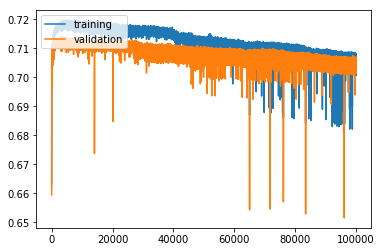

25840/25840 [==============================] - 1s 23us/step
Test accuracy:  0.7025541795665635


In [200]:
#X_test = X_val
#y_test = y_val
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.legend(['training', 'validation'], loc = 'upper left')
plt.show()

results = model.evaluate(X_test, y_test)

print('Test accuracy: ', results[1])

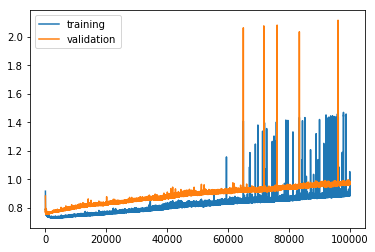

In [201]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['training', 'validation'], loc = 'upper left')
plt.show()

In [202]:
if(reDirect):
    sys.stdout = old_stdout
print('Test accuracy: ', results[1])

Test accuracy:  0.7025541795665635


In [203]:
from sklearn.metrics import confusion_matrix
import itertools
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

model = load_model('model/model.h5')
yp = model.predict(x)
acc = model.evaluate(x, keras.utils.to_categorical(y, num_classes = 2))
print(acc)
print(yp)
print(np.argmax(yp, axis= 1))
print(y)

In [204]:
model = load_model(MODEL_PATH)
y_pred = model.predict(X_test)

In [205]:
#print(y_pred)
a= np.shape(y_test)[0]
y_m = np.where(y_test==1)
m = np.shape(y_m)[1]
print(m/a)

results = model.evaluate(X_test, y_test)

print('Test accuracy: ', results[1])

1.0
25840/25840 [==============================] - 1s 32us/step
Test accuracy:  0.711687306501548


Confusion matrix, without normalization
[[  402   756     1    25     4     0]
 [   15 16902     2   118    33     4]
 [    1    60    86     6     7     0]
 [    7    92     1   598    19     0]
 [    8  5426     1   124   350     5]
 [  221   492     1     8    13    52]]
Normalized confusion matrix
[[3.38e-01 6.36e-01 8.42e-04 2.10e-02 3.37e-03 0.00e+00]
 [8.79e-04 9.90e-01 1.17e-04 6.91e-03 1.93e-03 2.34e-04]
 [6.25e-03 3.75e-01 5.37e-01 3.75e-02 4.37e-02 0.00e+00]
 [9.76e-03 1.28e-01 1.39e-03 8.34e-01 2.65e-02 0.00e+00]
 [1.35e-03 9.17e-01 1.69e-04 2.10e-02 5.92e-02 8.45e-04]
 [2.81e-01 6.25e-01 1.27e-03 1.02e-02 1.65e-02 6.61e-02]]


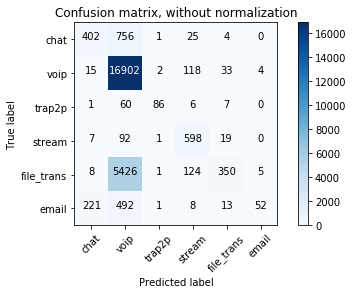

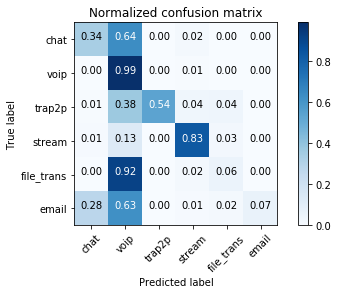

In [206]:
y_p = y_pred.argmax(axis = -1)
y_t = y_test.argmax(axis = -1)
#print(y_p)
#print(y_t)
class_names = [DIG2LABEL[i] for i in range(6)]
cnf_matrix = confusion_matrix(y_t, y_p)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=class_names,title='Confusion matrix, without normalization')
plt.savefig(FIG_PATH)

plt.figure()
plot_confusion_matrix(cnf_matrix, classes=class_names, normalize=True,title='Normalized confusion matrix')
plt.savefig(FIG_PATH_N)

plt.show()

In [207]:
print(LABEL2DIG)

{'chat': 0, 'voip': 1, 'stream': 3, 'file_trans': 4, 'trap2p': 2, 'email': 5}


In [208]:
df = pd.DataFrame(cnf_matrix)

In [209]:
df.to_csv('cm.csv', index = False)

In [210]:
df = pd.read_csv('data/Table_nobrowsing.csv')
df = df[df.file_name!='skype_audio1a_test']
df['app'] = df.file_name.apply(lambda x :dict_name2app[x].lower())
#df.to_csv('data/Table_app.csv', index = False)

NameError: name 'dict_name2app' is not defined

In [ ]:
df = pd.read_csv('data/Table_nobrowsing.csv')

In [ ]:
dfc = df.groupby(['file_name']).agg(['count'])
dfc.to_csv('Test.csv')

In [ ]:
ind =dfc.index.str.find('audio').bool()

In [ ]:
dfcaudio = dfc[dfc.index.str.find('audio')]

In [ ]:
#df = df[df.file_name!='skype_audio1a_test']
#df.to_csv('data/Table_nobrowsing.csv', index = False)

In [ ]:
pd.unique(df.file_name)

In [ ]:
np.shape(pd.unique(df.file_name))

for flow in df:
    t = flow.file_name.lower()
    if(t.find('email')!=-1):
        flow.type = 'email'
    elif(t.find('chat')!=-1):
        flow.type = 'chat'
    elif(t.find('youtube')!=-1 or t.find('vimeo')!=-1 or t.find('netflix')!=-1 or t.find('spotify')!=-1):
        flow.type = 'stream'
    elif(t.find('ftp')!=-1 or t.find('scp')!=-1 or t.find('file')!=-1):
        flow.type = 'file_trans'
        

In [ ]:
import pickle as pk

In [ ]:

with open('objs/fileName2Characterization.pickle', 'rb') as f:
    dict_name2class = pk.load(f)
dict_name2class

In [ ]:
import pickle as pk
with open('objs/fileName2Application.pickle', 'rb') as f:
    dict_name2label = pk.load(f)
dict_name2label

In [ ]:
dict_name2app = {}
for key in dict_name2label:
    newkey = key.split('.')[0]
    dict_name2app[newkey] = dict_name2label[key]

In [ ]:
dict_name2app

In [ ]:
with open('objs/dict_name2app.pickle', 'wb') as handle:
    pk.dump(dict_name2app, handle, protocol=pk.HIGHEST_PROTOCOL)